In [2]:
import os, sys
sys.path.append(os.path.dirname(os.path.dirname(os.path.abspath("./notebooks"))))

In [3]:
from tensorflow.keras import layers;
from tensorflow.keras import losses;
from tensorflow.keras import optimizers;
from dataset import Dataset;
from hyperparameter import HyperParameter;
from hyperparameter_search import HyperParameterSearch;
    
dataset_vector_25 = Dataset("../../preprocessed/row_size25_vector_size2000.csv")
dataset_vector_100 = Dataset("../../preprocessed/row_size100_vector_size2000.csv")

dataset_lambda_pair_set = [
    # 2 Layer Dense tanh
    (
        dataset_vector_25,
        lambda: (
            [
                layers.Dense(100, input_dim=dataset_vector_25.getInDimension(), activation="tanh"),
                layers.Dense(32, activation="tanh"),
                layers.Dense(dataset_vector_25.getOutDimension())
            ]
        ),
        '[Dense(100, activation="tanh"), Dense(32, activation="tanh")]',
    ),
    (
        dataset_vector_100,
        lambda: (
            [
                layers.Dense(100, input_dim=dataset_vector_100.getInDimension(), activation="tanh"),
                layers.Dense(32, activation="tanh"),
                layers.Dense(dataset_vector_100.getOutDimension())
            ]
        ),
        '[Dense(100, activation="tanh"), Dense(32, activation="tanh")]',
    ),
];
loss_set = [
    losses.mean_squared_error,
    # losses.mean_absolute_error,
    # losses.mean_absolute_percentage_error,
    # losses.mean_squared_logarithmic_error,
    # losses.cosine_similarity,
    # losses.huber,
    # losses.log_cosh
]
optimizer_set = [
    optimizers.SGD,
    optimizers.RMSprop,
    optimizers.Adam,
    optimizers.Adadelta,
    optimizers.Adagrad,
    optimizers.Adamax,
    optimizers.Nadam,
    optimizers.Ftrl
]
epoch_set = [
    30, 
    50, 
    75, 
    100
]
batch_size_set = [
    12, 
    18, 
    24, 
    32, 
    40
]
search = HyperParameterSearch();
parameters = search.createParameterSet(dataset_lambda_pair_set, loss_set, optimizer_set, epoch_set, batch_size_set)

print(str(parameters[0]))

search.run(parameters);

print(search.results)

Progress: [####################] 100.0%
{'Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8490>, epochs=30, batch_size=12': {'estimator': <state_estimator.StateEstimator object at 0x7fb253f3f220>, 'metrics': [[-1.523787366222158, 0.6725732227294658, 0.06995816095613704, 16638.327618946525, 0.010332986563056172, 0.0001067706113122994], [-1.5852181889371986, 0.5511959574857965, 0.06737508203400835, 581.6167058114945, 0.009912480818954987, 9.825727598615052e-05], [-0.18768511854628844, 2.1840505170083118, 0.11941333857089967, 873.0054601541752, 0.0989552551656757, 0.009792142524903987], [-19702.596949763592, 0.6346899382909491, 0.043347525416436695, 6167235.629114364, 0.007133760893494193, 5.0890544485547065e-05], [-23114.511552273976, 0.6347149067793275, 

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8490>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.52e+00	6.73e-01	7.00e-02	1.66e+04	1.03e-02	1.07e-04
y		-1.59e+00	5.51e-01	6.74e-02	5.82e+02	9.91e-03	9.83e-05
z		-1.88e-01	2.18e+00	1.19e-01	8.73e+02	9.90e-02	9.79e-03
phi		-1.97e+04	6.35e-01	4.33e-02	6.17e+06	7.13e-03	5.09e-05
theta		-2.31e+04	6.35e-01	4.34e-02	5.43e+05	7.14e-03	5.10e-05
psi		-9.53e+03	6.35e-01	4.34e-02	2.04e+06	7.15e-03	5.11e-05


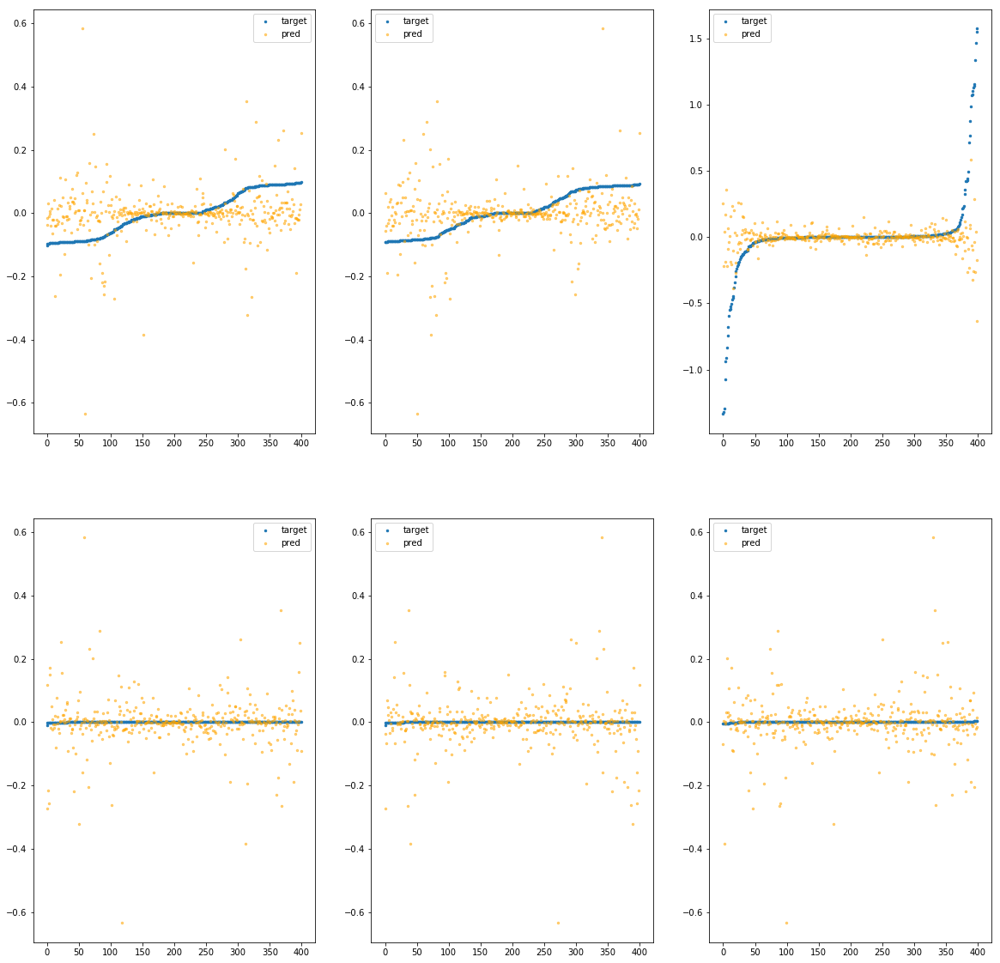

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca84f0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.99e+00	7.83e-01	8.21e-02	3.46e+04	1.63e-02	2.67e-04
y		-3.13e+00	6.52e-01	7.66e-02	6.12e+02	1.58e-02	2.50e-04
z		-1.89e-01	2.03e+00	1.24e-01	9.62e+02	9.91e-02	9.82e-03
phi		-3.35e+04	7.30e-01	5.56e-02	9.07e+06	1.21e-02	1.47e-04
theta		-3.92e+04	7.30e-01	5.56e-02	6.26e+05	1.21e-02	1.47e-04
psi		-1.62e+04	7.31e-01	5.56e-02	3.78e+06	1.21e-02	1.47e-04


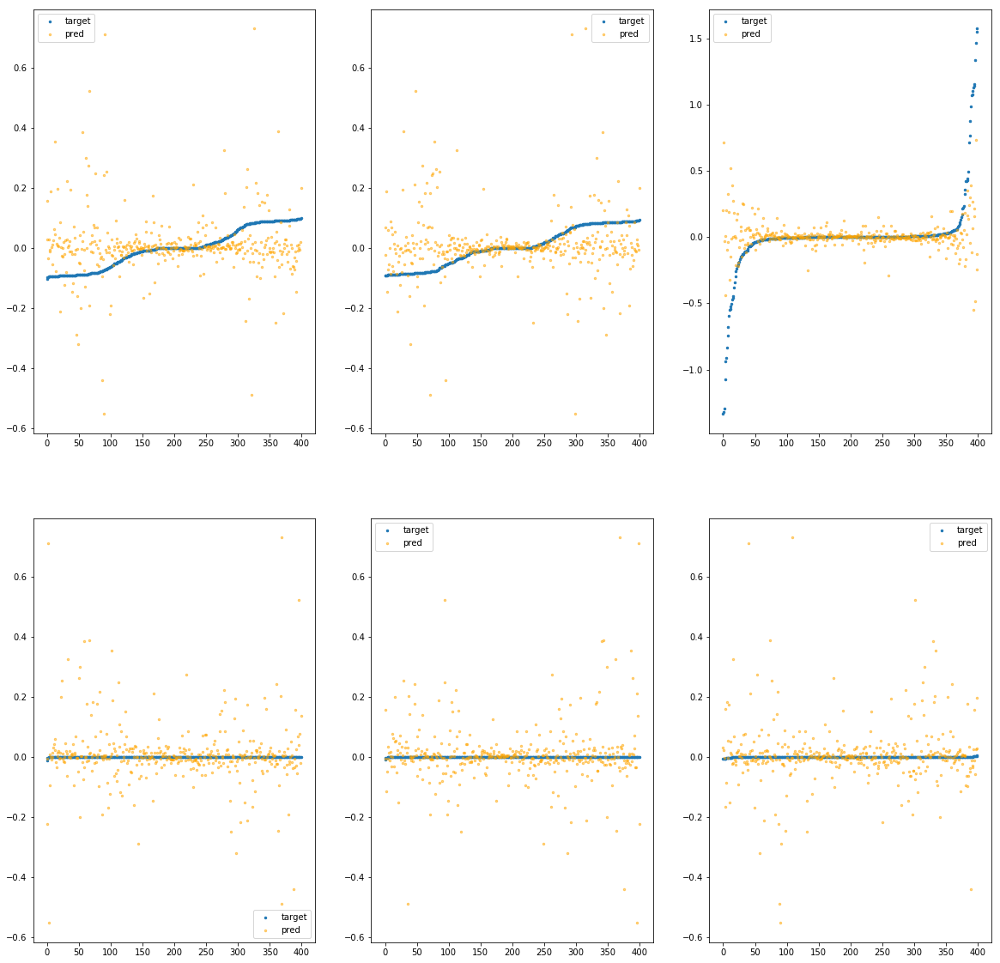

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8550>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.05e+00	7.89e-01	7.98e-02	2.12e+04	1.66e-02	2.74e-04
y		-2.82e+00	7.35e-01	7.63e-02	2.47e+03	1.47e-02	2.15e-04
z		-8.12e-02	1.86e+00	1.22e-01	9.76e+02	9.01e-02	8.12e-03
phi		-3.32e+04	7.04e-01	5.74e-02	5.76e+06	1.20e-02	1.45e-04
theta		-3.89e+04	7.04e-01	5.74e-02	1.99e+06	1.20e-02	1.44e-04
psi		-1.60e+04	7.04e-01	5.74e-02	3.68e+06	1.20e-02	1.44e-04


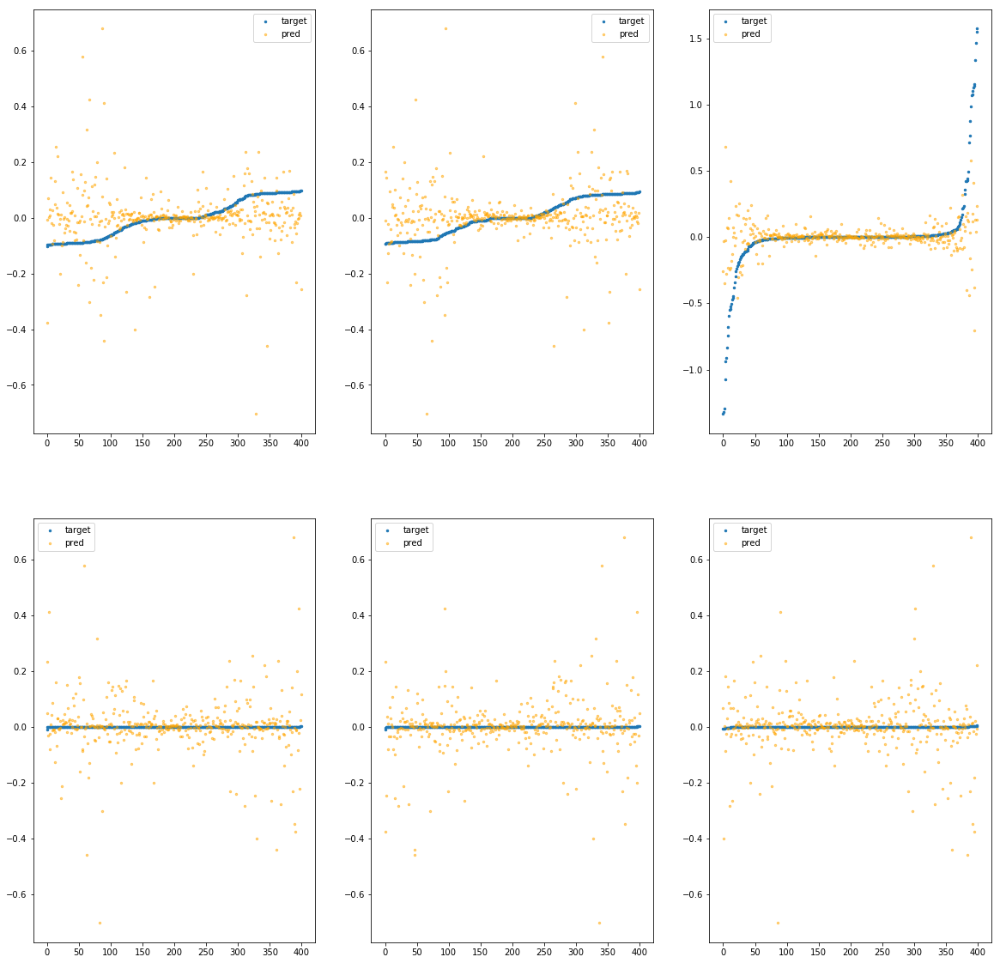

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca85b0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.87e+00	7.32e-01	7.13e-02	1.56e+04	1.17e-02	1.38e-04
y		-2.16e+00	7.36e-01	7.53e-02	1.87e+03	1.21e-02	1.47e-04
z		-7.45e-02	1.62e+00	1.22e-01	1.38e+03	8.95e-02	8.02e-03
phi		-2.26e+04	8.21e-01	4.69e-02	3.62e+06	8.17e-03	6.67e-05
theta		-2.64e+04	8.21e-01	4.69e-02	1.98e+06	8.17e-03	6.67e-05
psi		-1.09e+04	8.21e-01	4.69e-02	4.31e+06	8.18e-03	6.68e-05


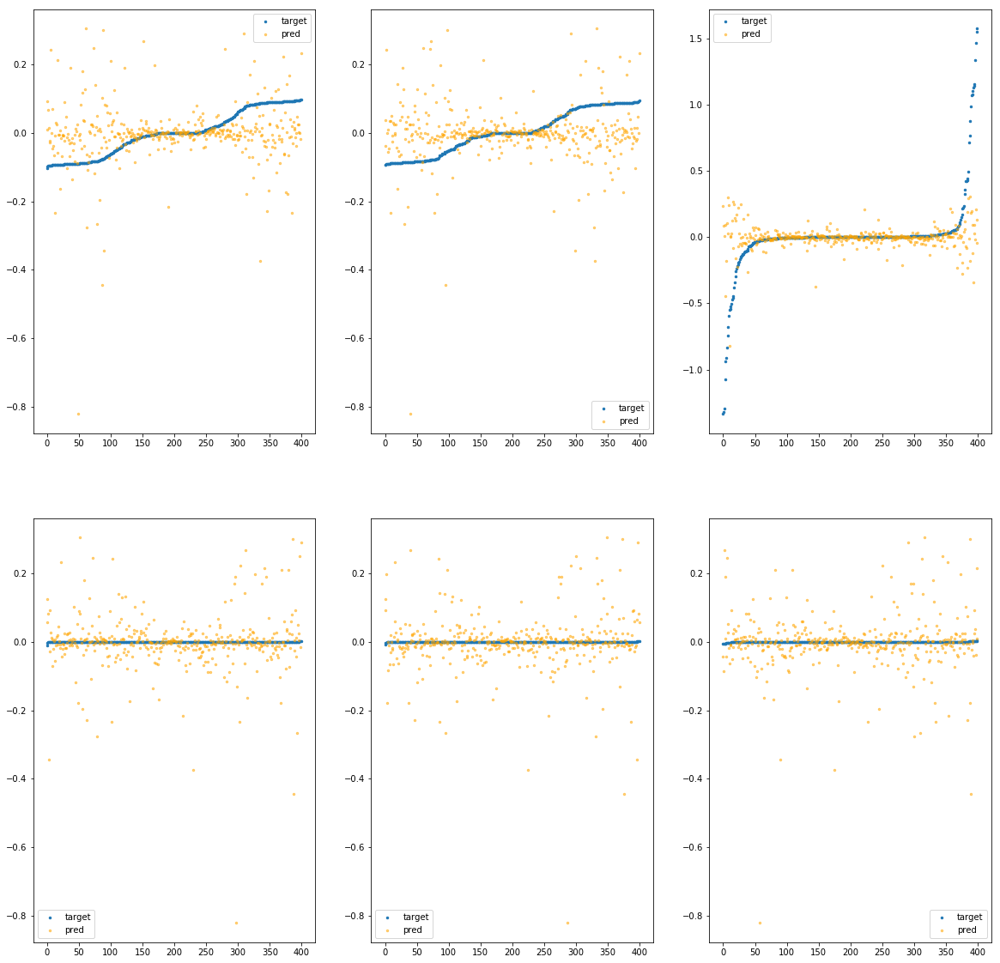

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8610>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.73e+00	8.48e-01	8.26e-02	3.93e+04	1.53e-02	2.33e-04
y		-2.95e+00	8.26e-01	8.33e-02	7.61e+02	1.51e-02	2.29e-04
z		-1.87e-01	1.88e+00	1.28e-01	1.08e+03	9.89e-02	9.77e-03
phi		-2.85e+04	7.70e-01	5.68e-02	8.38e+06	1.03e-02	1.07e-04
theta		-3.34e+04	7.70e-01	5.68e-02	8.29e+05	1.03e-02	1.07e-04
psi		-1.37e+04	7.69e-01	5.67e-02	4.33e+06	1.03e-02	1.06e-04


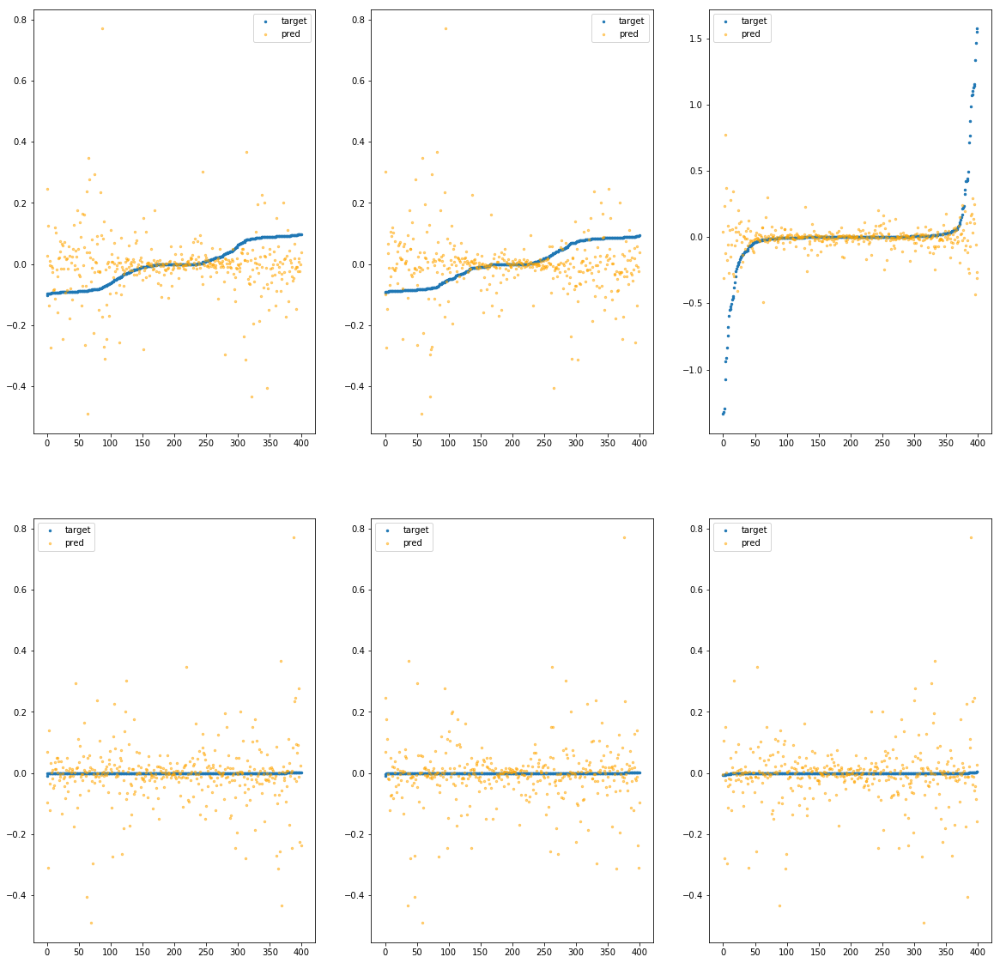

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8670>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.82e+00	7.46e-01	8.04e-02	1.88e+04	1.56e-02	2.44e-04
y		-2.48e+00	5.85e-01	7.58e-02	7.20e+02	1.33e-02	1.78e-04
z		-3.25e-01	2.00e+00	1.25e-01	7.16e+02	1.10e-01	1.22e-02
phi		-2.83e+04	6.64e-01	5.22e-02	3.69e+06	1.02e-02	1.05e-04
theta		-3.31e+04	6.63e-01	5.22e-02	5.65e+05	1.02e-02	1.05e-04
psi		-1.36e+04	6.63e-01	5.22e-02	2.07e+06	1.02e-02	1.05e-04


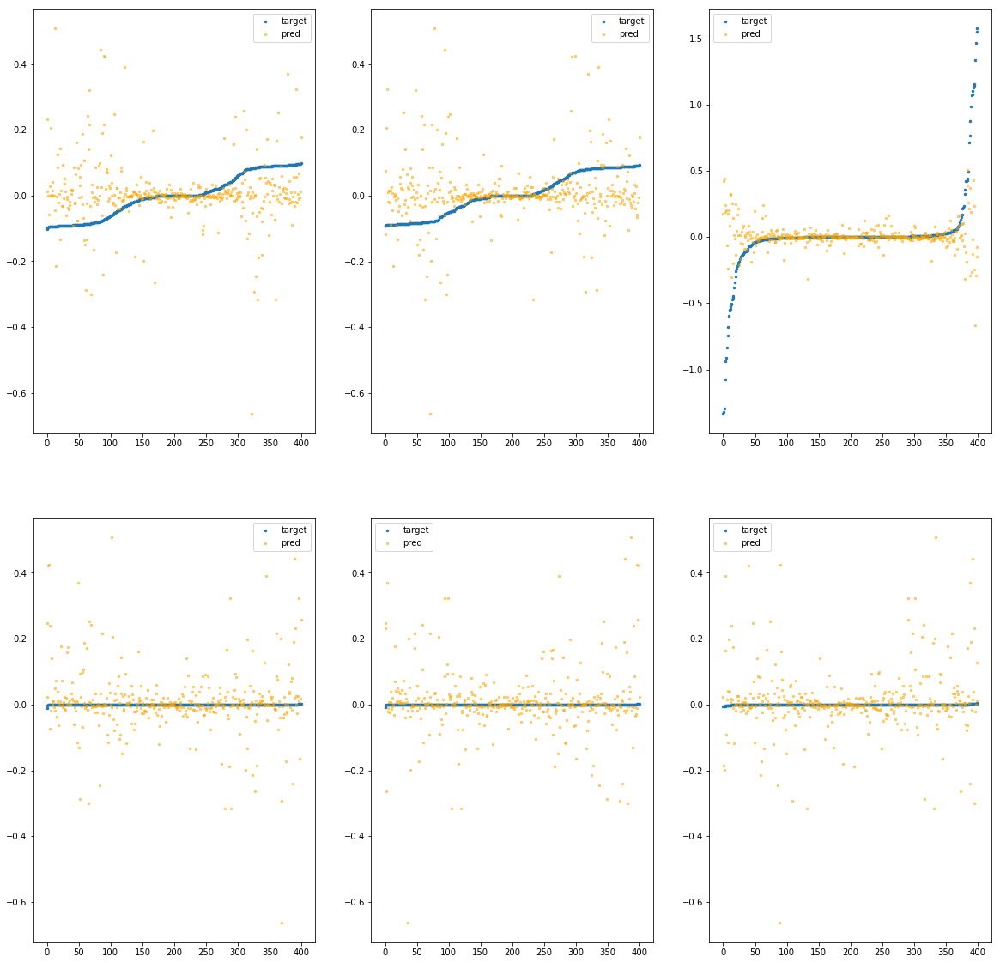

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca86d0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.10e+00	7.73e-01	7.19e-02	1.96e+04	1.27e-02	1.61e-04
y		-2.48e+00	7.50e-01	7.30e-02	7.68e+02	1.33e-02	1.78e-04
z		-2.47e-01	1.71e+00	1.25e-01	1.03e+03	1.04e-01	1.08e-02
phi		-2.37e+04	6.95e-01	4.58e-02	5.05e+06	8.57e-03	7.34e-05
theta		-2.77e+04	6.95e-01	4.58e-02	1.11e+06	8.56e-03	7.32e-05
psi		-1.14e+04	6.94e-01	4.58e-02	3.21e+06	8.57e-03	7.35e-05


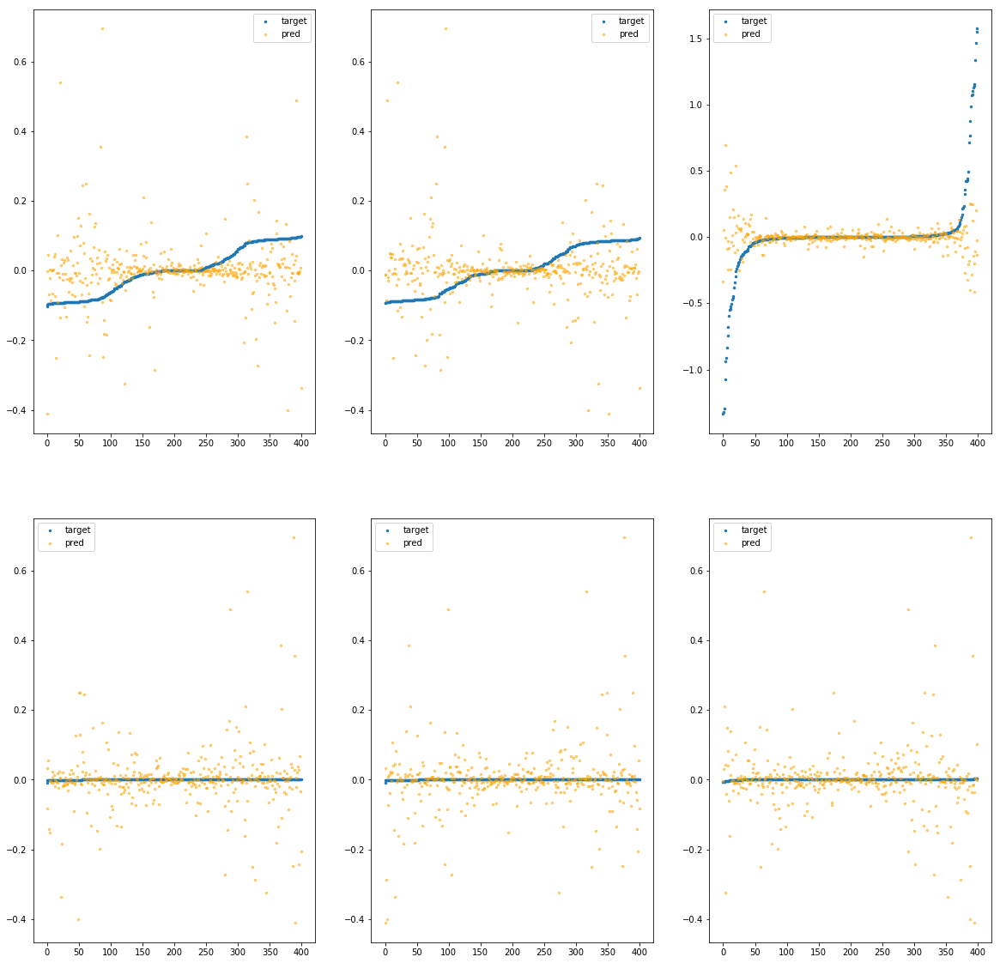

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8730>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.40e+00	5.71e-01	7.57e-02	3.03e+04	1.39e-02	1.93e-04
y		-2.10e+00	5.67e-01	7.32e-02	7.59e+02	1.19e-02	1.41e-04
z		-3.97e-02	1.64e+00	1.21e-01	1.07e+03	8.66e-02	7.50e-03
phi		-2.67e+04	6.46e-01	5.18e-02	6.45e+06	9.67e-03	9.36e-05
theta		-3.13e+04	6.45e-01	5.17e-02	8.64e+05	9.67e-03	9.34e-05
psi		-1.29e+04	6.45e-01	5.18e-02	2.65e+06	9.68e-03	9.37e-05


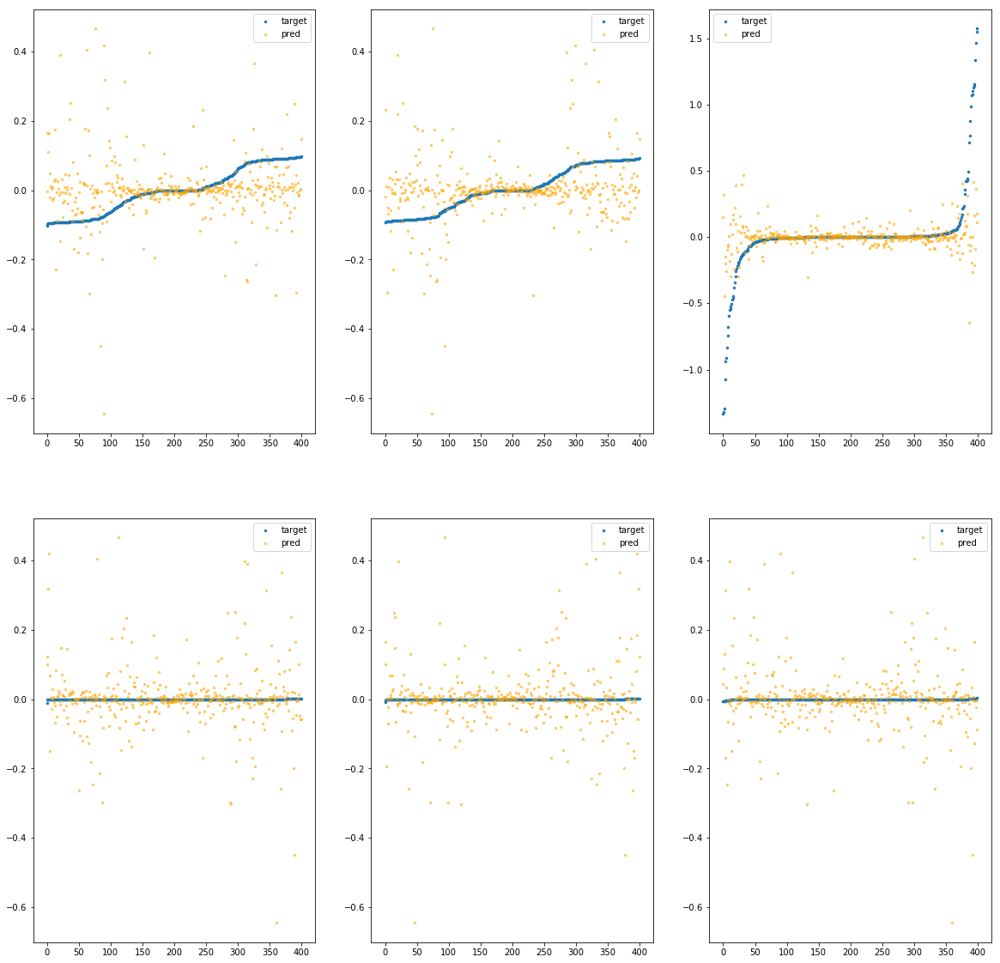

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8790>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.85e+00	9.08e-01	7.87e-02	2.39e+04	1.58e-02	2.48e-04
y		-3.36e+00	7.90e-01	8.16e-02	1.31e+03	1.67e-02	2.80e-04
z		-1.90e-01	2.03e+00	1.28e-01	8.99e+02	9.92e-02	9.83e-03
phi		-3.26e+04	8.29e-01	5.36e-02	3.04e+06	1.18e-02	1.40e-04
theta		-3.83e+04	8.28e-01	5.36e-02	1.37e+06	1.18e-02	1.40e-04
psi		-1.57e+04	8.28e-01	5.36e-02	1.80e+06	1.18e-02	1.39e-04


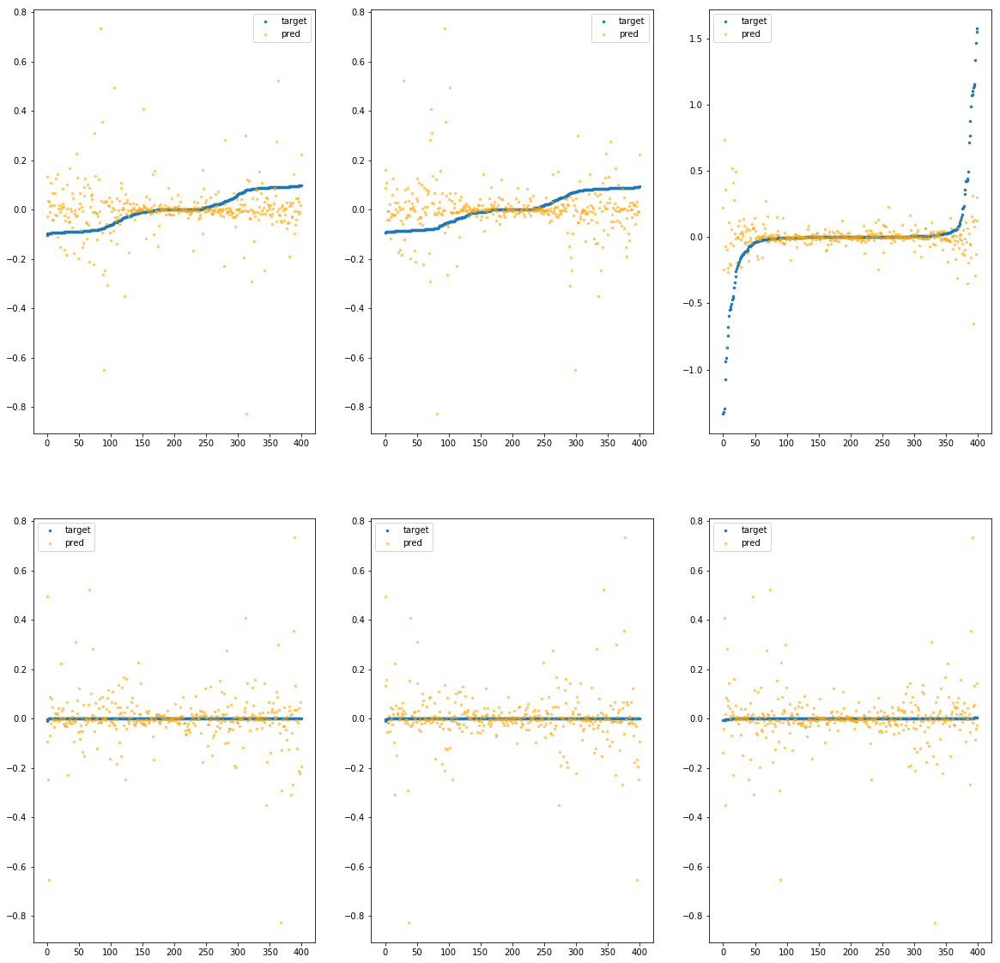

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca87f0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.89e+00	7.85e-01	9.71e-02	3.54e+04	2.41e-02	5.81e-04
y		-5.20e+00	7.63e-01	9.47e-02	1.04e+03	2.38e-02	5.65e-04
z		-3.31e-01	1.95e+00	1.32e-01	1.29e+03	1.11e-01	1.23e-02
phi		-5.38e+04	7.10e-01	7.05e-02	7.92e+06	1.95e-02	3.79e-04
theta		-6.30e+04	7.10e-01	7.05e-02	9.26e+05	1.95e-02	3.79e-04
psi		-2.60e+04	7.09e-01	7.06e-02	4.41e+06	1.95e-02	3.81e-04


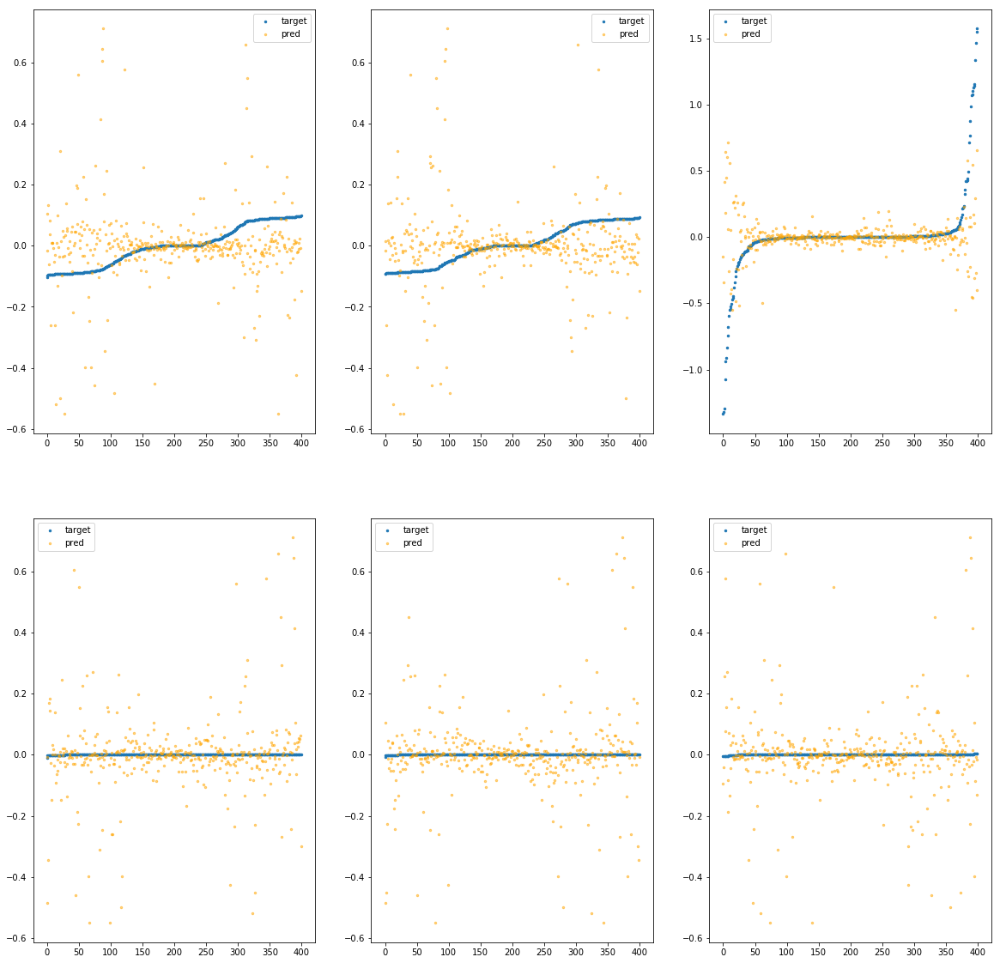

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8850>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.58e+00	4.87e-01	6.96e-02	1.64e+04	1.06e-02	1.12e-04
y		-1.66e+00	6.00e-01	6.65e-02	9.09e+02	1.02e-02	1.04e-04
z		-7.37e-02	1.78e+00	1.14e-01	1.07e+03	8.95e-02	8.00e-03
phi		-1.98e+04	5.24e-01	4.38e-02	4.08e+06	7.15e-03	5.12e-05
theta		-2.32e+04	5.25e-01	4.38e-02	8.51e+05	7.15e-03	5.12e-05
psi		-9.56e+03	5.25e-01	4.38e-02	2.99e+06	7.17e-03	5.14e-05


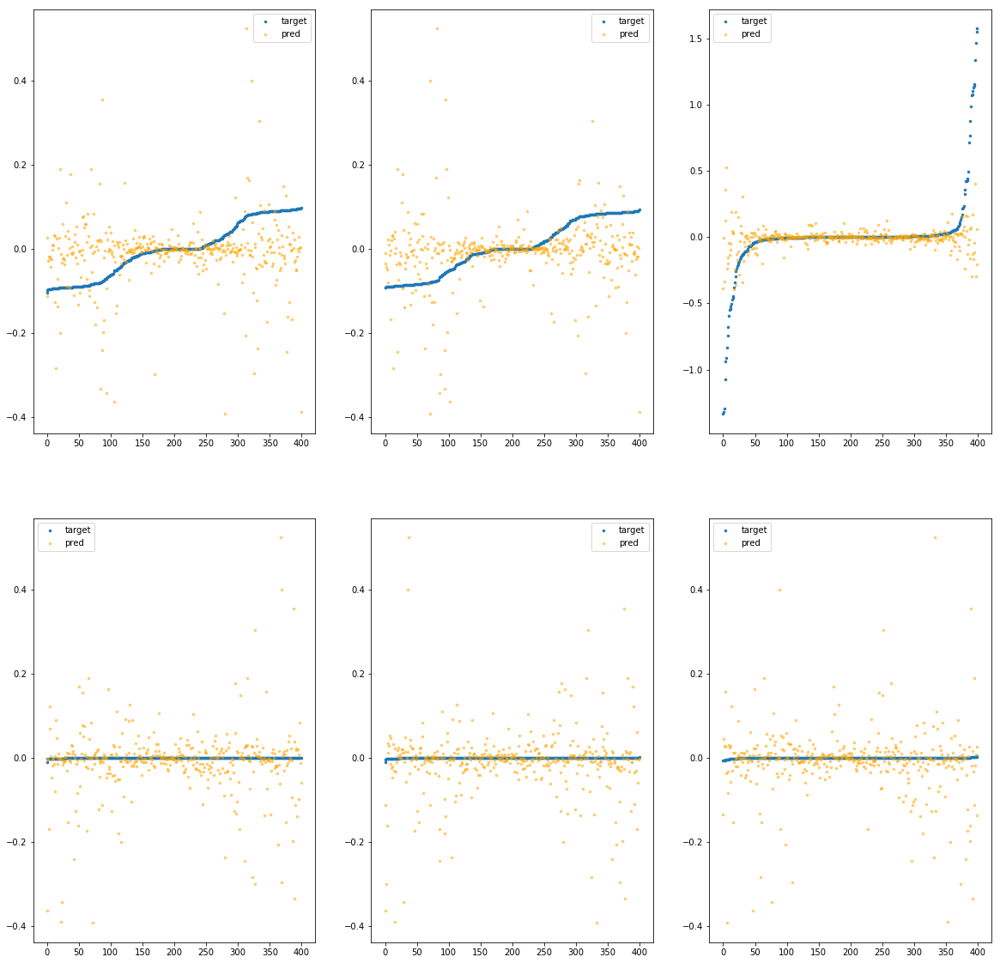

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca88b0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.49e+00	4.82e-01	6.93e-02	2.24e+04	1.02e-02	1.04e-04
y		-1.30e+00	4.29e-01	6.72e-02	1.46e+03	8.83e-03	7.80e-05
z		-1.69e-01	1.86e+00	1.20e-01	9.03e+02	9.74e-02	9.48e-03
phi		-1.44e+04	3.91e-01	3.77e-02	6.34e+06	5.23e-03	2.73e-05
theta		-1.69e+04	3.92e-01	3.77e-02	1.26e+06	5.22e-03	2.73e-05
psi		-6.94e+03	3.92e-01	3.77e-02	2.22e+06	5.21e-03	2.71e-05


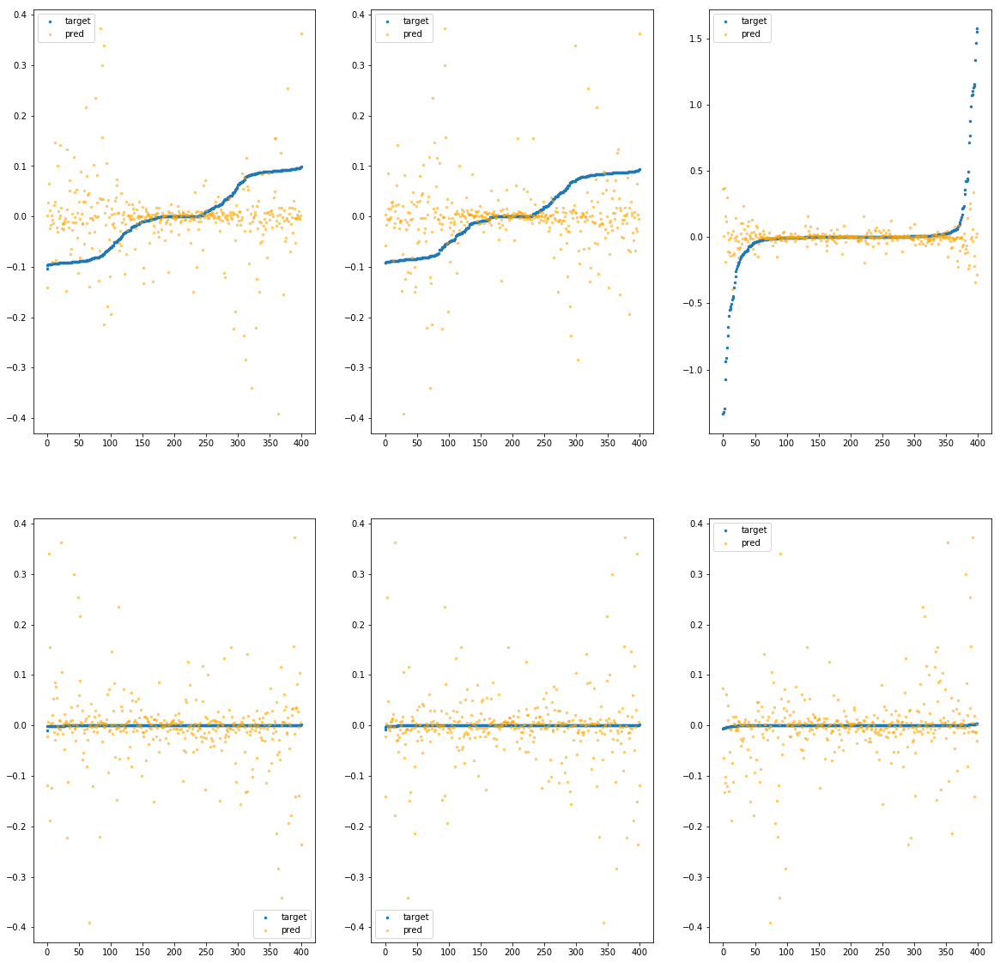

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8910>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.47e+00	6.20e-01	7.61e-02	1.65e+04	1.42e-02	2.02e-04
y		-2.80e+00	5.97e-01	7.78e-02	7.16e+02	1.46e-02	2.12e-04
z		5.99e-05	1.83e+00	1.18e-01	8.74e+02	8.33e-02	6.94e-03
phi		-2.94e+04	5.40e-01	5.26e-02	5.13e+06	1.06e-02	1.13e-04
theta		-3.45e+04	5.41e-01	5.27e-02	7.43e+05	1.07e-02	1.14e-04
psi		-1.42e+04	5.40e-01	5.27e-02	2.00e+06	1.07e-02	1.14e-04


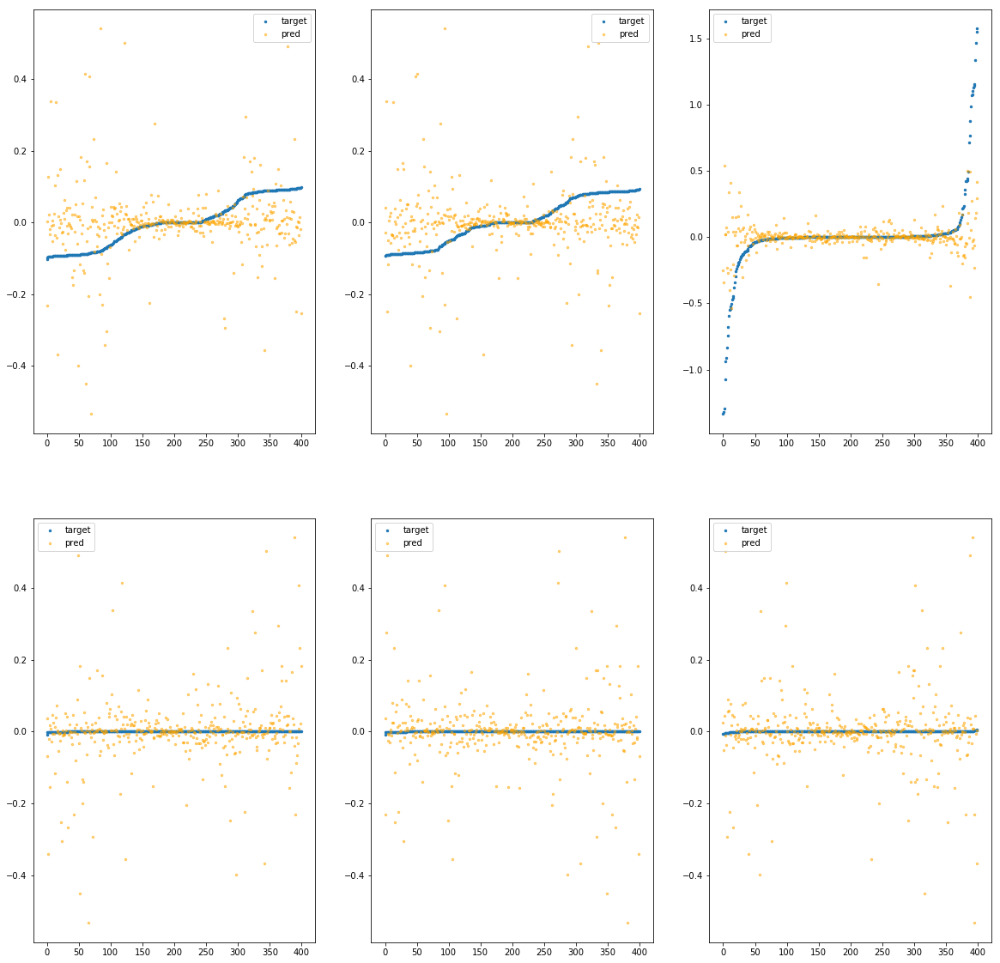

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8970>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.98e+00	1.04e+00	7.63e-02	1.87e+04	1.63e-02	2.66e-04
y		-3.55e+00	1.03e+00	7.97e-02	1.13e+03	1.74e-02	3.04e-04
z		3.31e-02	1.69e+00	1.14e-01	7.92e+02	8.06e-02	6.49e-03
phi		-3.66e+04	9.49e-01	5.52e-02	5.60e+06	1.33e-02	1.76e-04
theta		-4.29e+04	9.49e-01	5.52e-02	1.32e+06	1.32e-02	1.75e-04
psi		-1.76e+04	9.49e-01	5.51e-02	4.08e+06	1.32e-02	1.75e-04


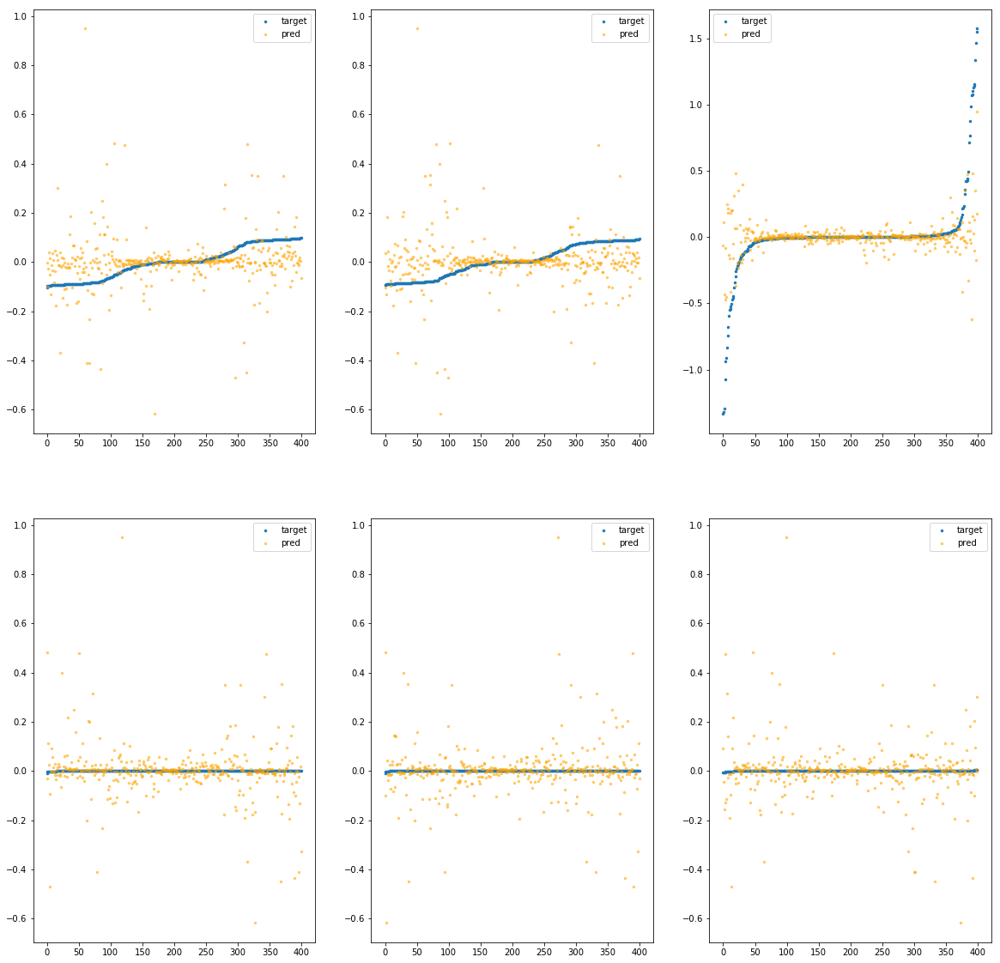

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca89d0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.26e+00	8.49e-01	9.12e-02	1.86e+04	2.15e-02	4.64e-04
y		-4.73e+00	8.45e-01	8.92e-02	1.17e+03	2.20e-02	4.83e-04
z		-3.69e-01	1.89e+00	1.41e-01	1.26e+03	1.14e-01	1.30e-02
phi		-4.50e+04	7.61e-01	6.51e-02	7.32e+06	1.63e-02	2.65e-04
theta		-5.27e+04	7.61e-01	6.51e-02	1.02e+06	1.63e-02	2.65e-04
psi		-2.17e+04	7.61e-01	6.51e-02	2.72e+06	1.63e-02	2.66e-04


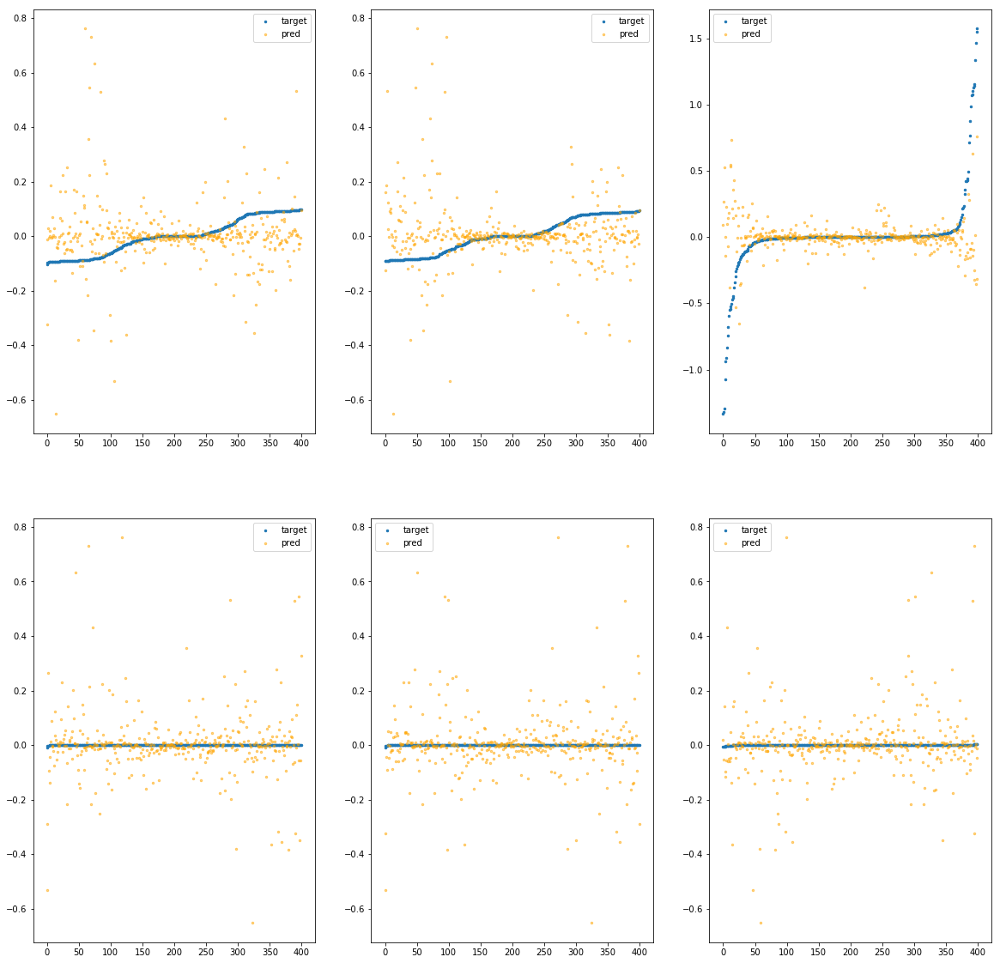

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8a30>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.11e+00	4.94e-01	6.52e-02	1.45e+04	8.65e-03	7.49e-05
y		-1.14e+00	4.93e-01	6.52e-02	7.93e+02	8.20e-03	6.72e-05
z		2.00e-02	1.62e+00	1.07e-01	6.19e+02	8.17e-02	6.67e-03
phi		-1.28e+04	4.10e-01	3.45e-02	3.70e+06	4.65e-03	2.16e-05
theta		-1.50e+04	4.11e-01	3.45e-02	7.51e+05	4.65e-03	2.16e-05
psi		-6.20e+03	4.11e-01	3.45e-02	3.38e+06	4.65e-03	2.16e-05


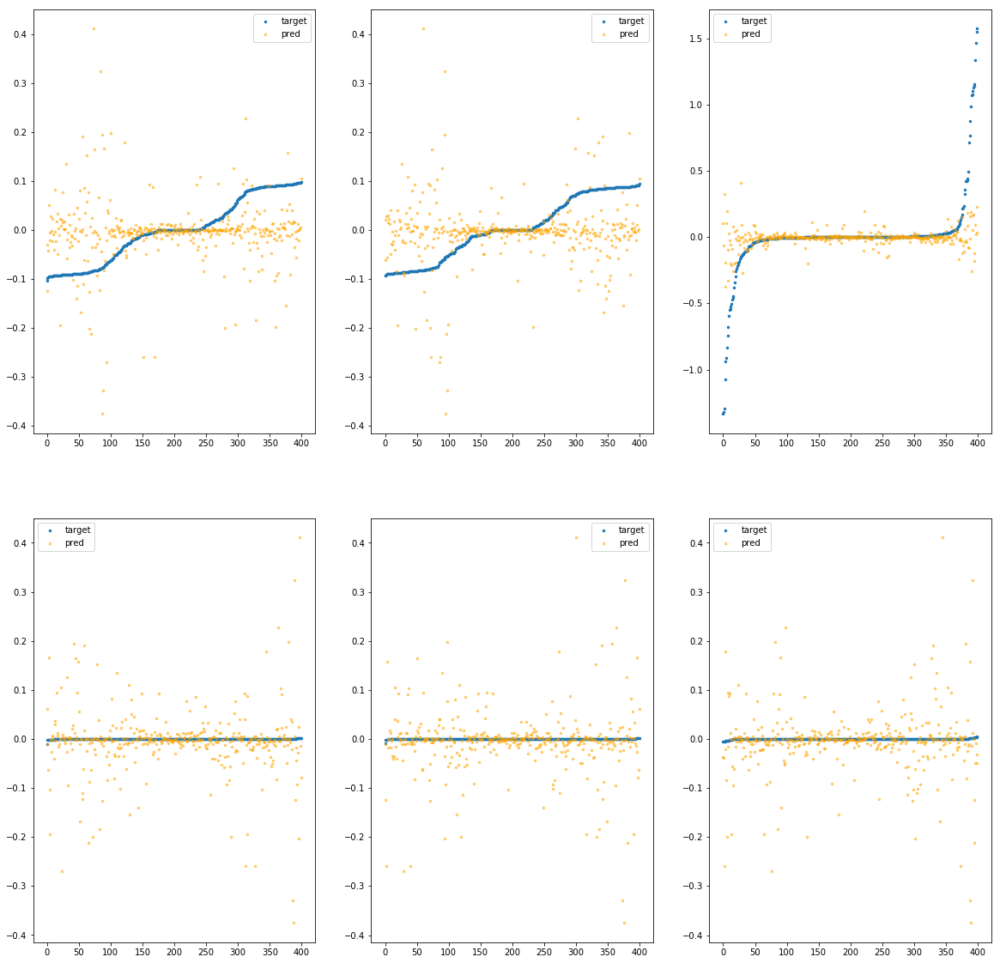

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8a90>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.73e+00	4.72e-01	7.38e-02	2.89e+04	1.12e-02	1.25e-04
y		-2.06e+00	6.49e-01	7.26e-02	1.52e+03	1.17e-02	1.38e-04
z		-2.07e-01	1.83e+00	1.22e-01	8.06e+02	1.01e-01	1.01e-02
phi		-1.92e+04	5.63e-01	4.27e-02	7.52e+06	6.94e-03	4.82e-05
theta		-2.25e+04	5.63e-01	4.27e-02	9.66e+05	6.94e-03	4.82e-05
psi		-9.22e+03	5.63e-01	4.26e-02	2.62e+06	6.92e-03	4.78e-05


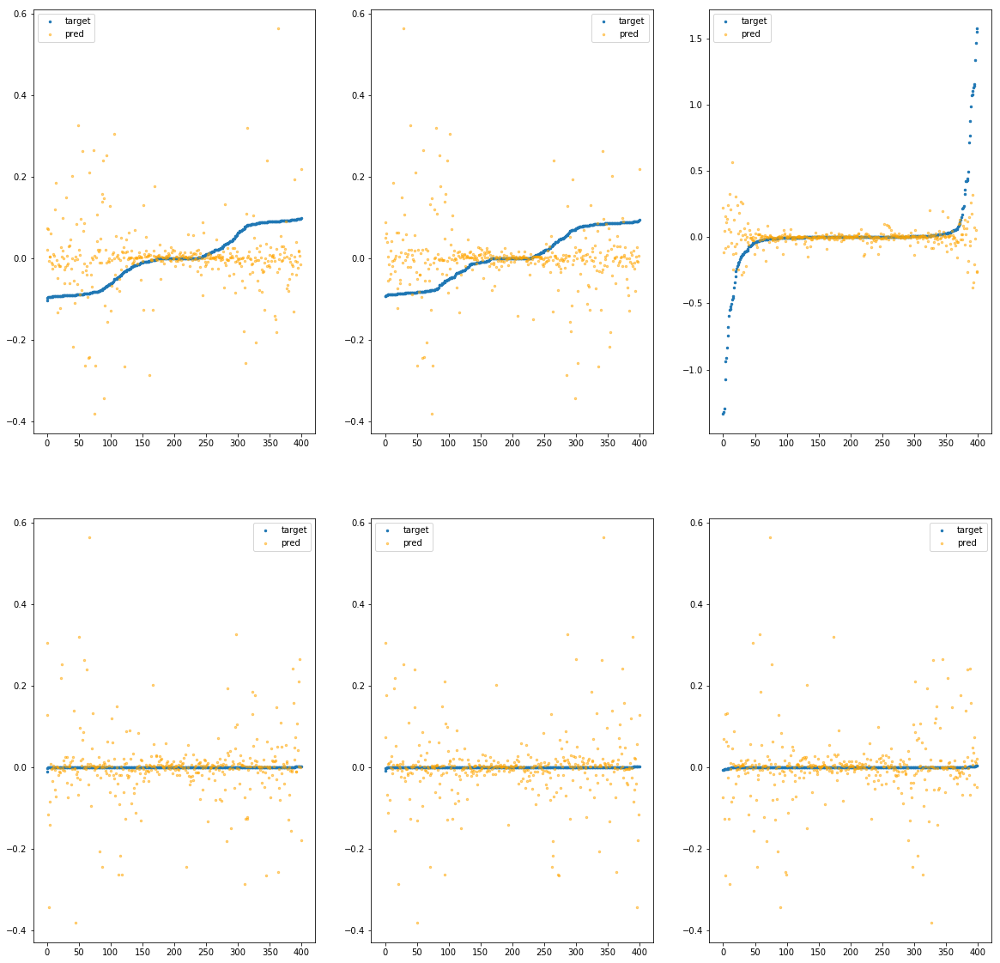

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8af0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.52e+00	4.84e-01	7.06e-02	1.67e+04	1.03e-02	1.07e-04
y		-1.74e+00	5.00e-01	7.16e-02	8.66e+02	1.05e-02	1.10e-04
z		-1.65e-01	1.78e+00	1.21e-01	7.00e+02	9.71e-02	9.43e-03
phi		-1.74e+04	4.16e-01	4.16e-02	4.98e+06	6.29e-03	3.95e-05
theta		-2.03e+04	4.16e-01	4.16e-02	1.17e+06	6.28e-03	3.94e-05
psi		-8.38e+03	4.16e-01	4.16e-02	3.32e+06	6.29e-03	3.95e-05


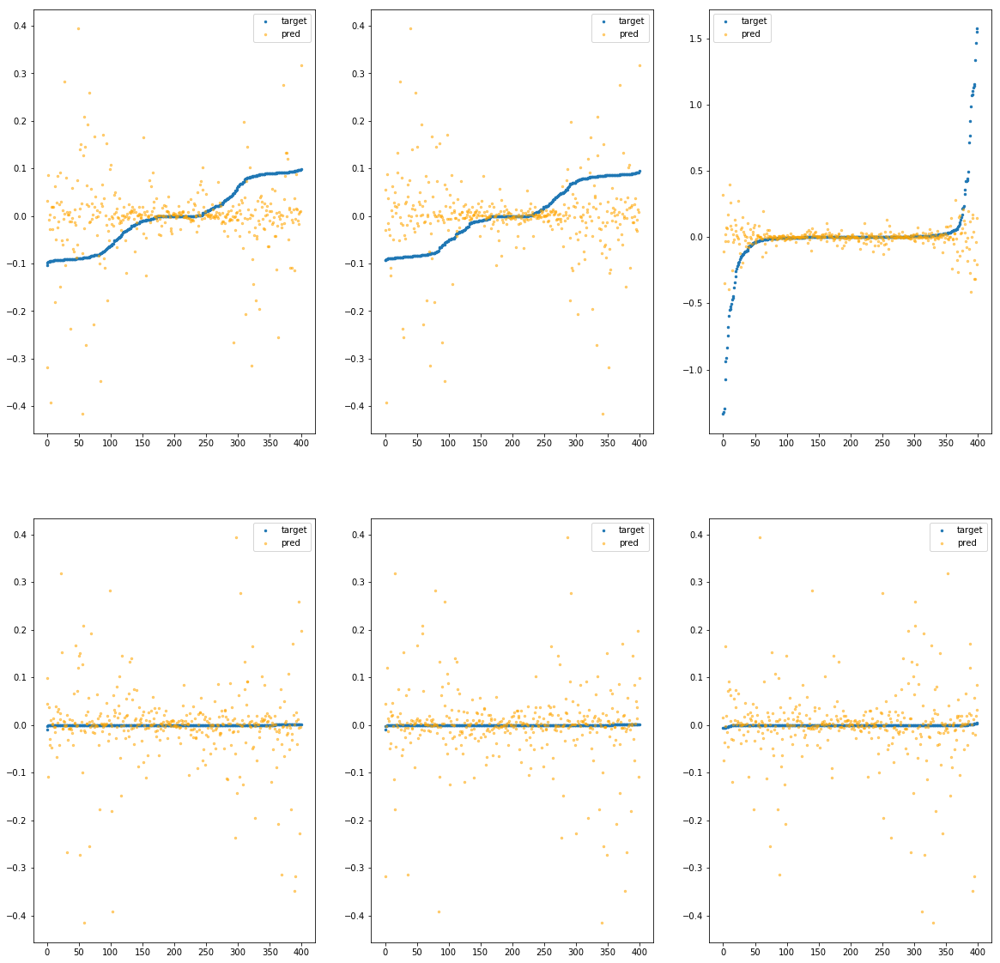

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8b50>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.38e+00	6.98e-01	8.60e-02	2.73e+04	1.79e-02	3.21e-04
y		-3.26e+00	6.13e-01	8.23e-02	2.31e+03	1.63e-02	2.67e-04
z		-1.08e-01	1.72e+00	1.22e-01	9.01e+02	9.23e-02	8.52e-03
phi		-3.60e+04	6.41e-01	5.92e-02	4.98e+06	1.30e-02	1.69e-04
theta		-4.22e+04	6.43e-01	5.92e-02	2.15e+06	1.30e-02	1.70e-04
psi		-1.73e+04	6.41e-01	5.91e-02	5.31e+06	1.30e-02	1.68e-04


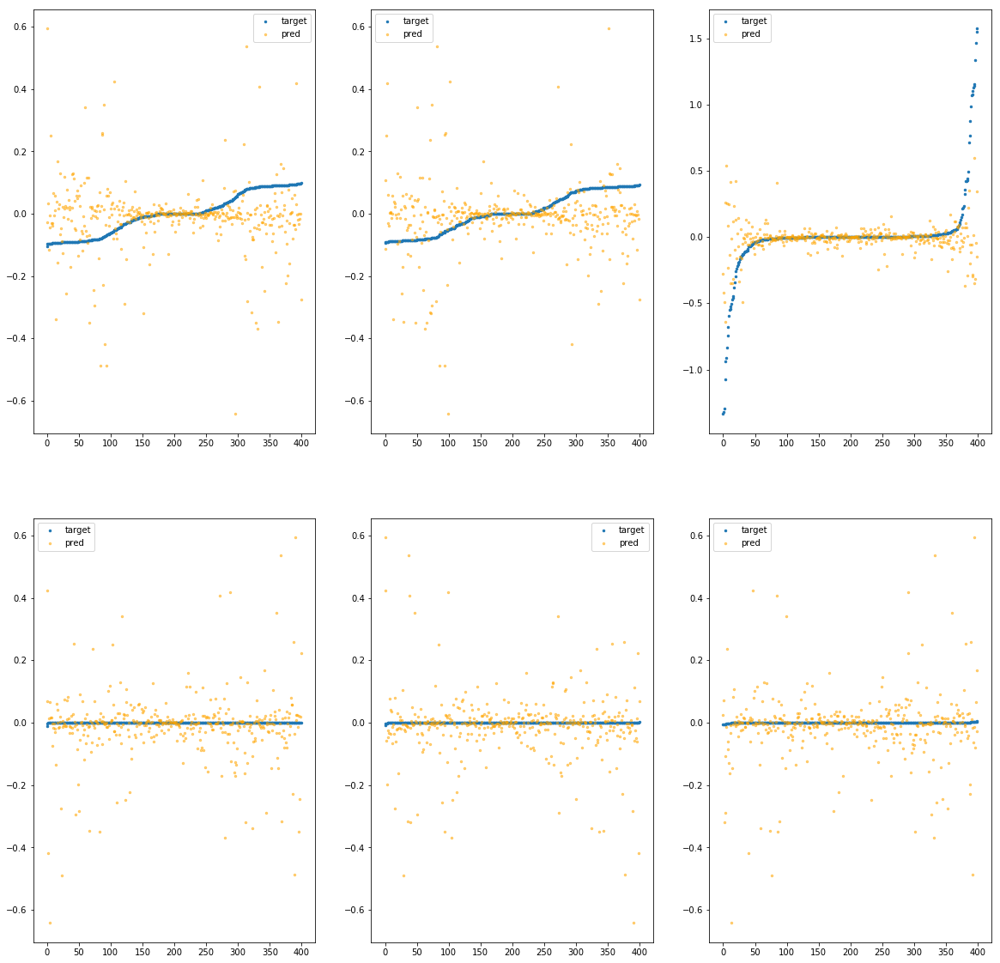

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb270ca8bb0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.09e+00	7.84e-01	8.55e-02	1.66e+04	1.67e-02	2.80e-04
y		-3.27e+00	7.80e-01	8.33e-02	1.14e+03	1.64e-02	2.68e-04
z		-5.00e-02	1.71e+00	1.20e-01	1.06e+03	8.75e-02	7.65e-03
phi		-3.24e+04	6.96e-01	5.68e-02	3.80e+06	1.17e-02	1.37e-04
theta		-3.80e+04	6.96e-01	5.68e-02	9.89e+05	1.17e-02	1.38e-04
psi		-1.56e+04	6.96e-01	5.68e-02	2.50e+06	1.17e-02	1.37e-04


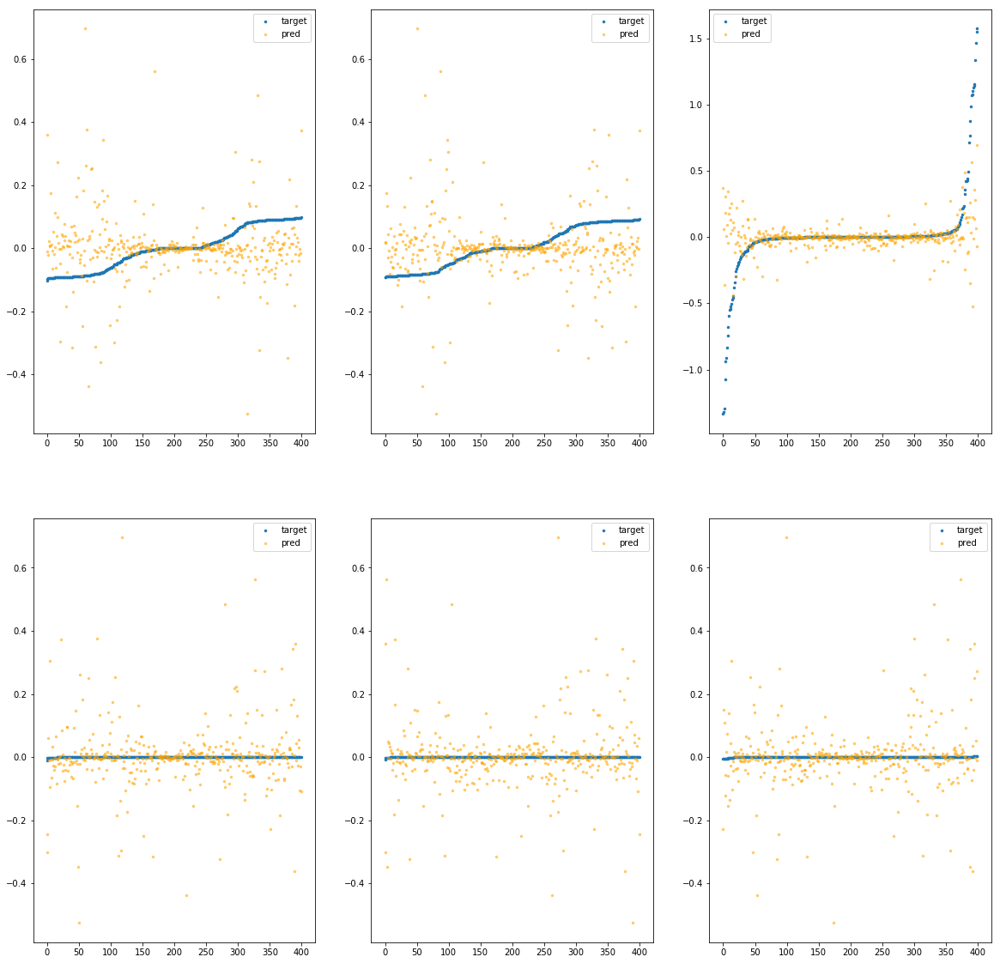

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8c10>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.69e-04	1.09e-01	5.17e-02	1.97e+03	4.10e-03	1.68e-05
y		1.52e-03	9.29e-02	5.12e-02	7.97e+01	3.83e-03	1.47e-05
z		-2.04e-03	1.57e+00	1.02e-01	6.67e+01	8.35e-02	6.97e-03
phi		-1.36e+01	1.04e-02	1.54e-03	3.08e+05	5.29e-06	2.80e-11
theta		-1.57e+01	9.22e-03	1.55e-03	7.95e+04	5.17e-06	2.68e-11
psi		-6.64e+00	1.07e-02	1.62e-03	1.52e+05	5.73e-06	3.28e-11


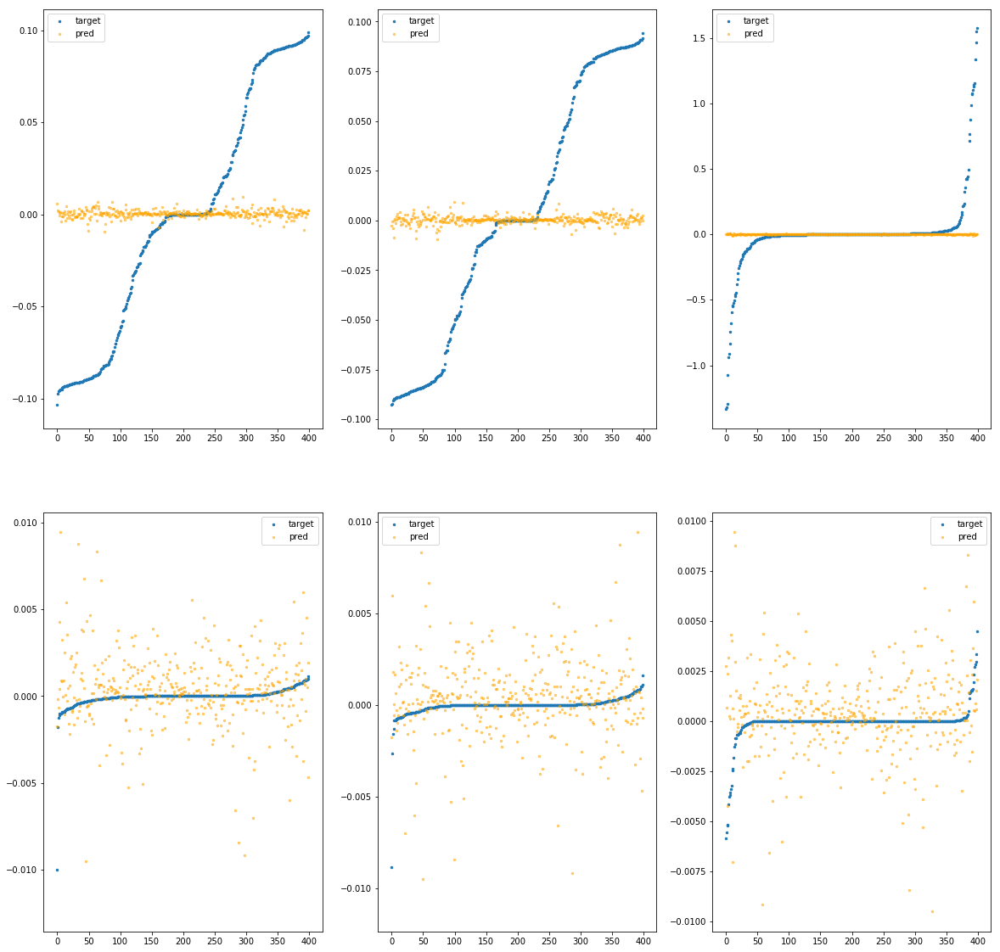

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8c70>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.19e-01	1.88e-01	5.35e-02	8.41e+03	4.58e-03	2.10e-05
y		-8.54e-02	1.79e-01	5.20e-02	2.53e+02	4.16e-03	1.73e-05
z		2.88e-03	1.61e+00	1.03e-01	2.43e+02	8.31e-02	6.90e-03
phi		-8.94e+02	1.08e-01	9.01e-03	1.77e+06	3.24e-04	1.05e-07
theta		-1.05e+03	1.10e-01	9.02e-03	1.86e+05	3.24e-04	1.05e-07
psi		-4.34e+02	1.09e-01	9.01e-03	5.97e+05	3.27e-04	1.07e-07


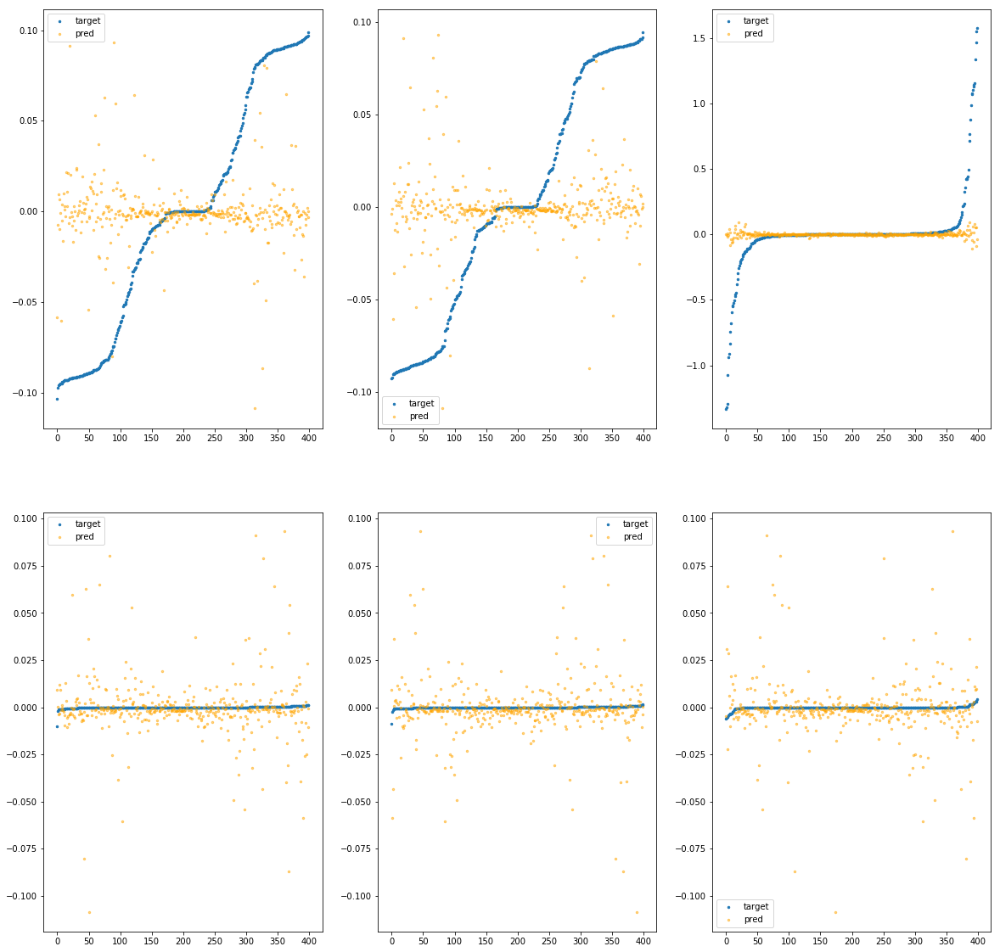

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8cd0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.46e-01	2.91e-01	5.37e-02	2.60e+03	4.69e-03	2.20e-05
y		-3.92e-02	1.63e-01	5.09e-02	6.16e+02	3.98e-03	1.59e-05
z		2.82e-02	1.60e+00	1.02e-01	3.71e+02	8.10e-02	6.56e-03
phi		-1.55e+03	1.96e-01	1.28e-02	5.41e+05	5.63e-04	3.17e-07
theta		-1.82e+03	1.96e-01	1.28e-02	3.70e+05	5.63e-04	3.17e-07
psi		-7.44e+02	1.96e-01	1.27e-02	7.18e+05	5.59e-04	3.12e-07


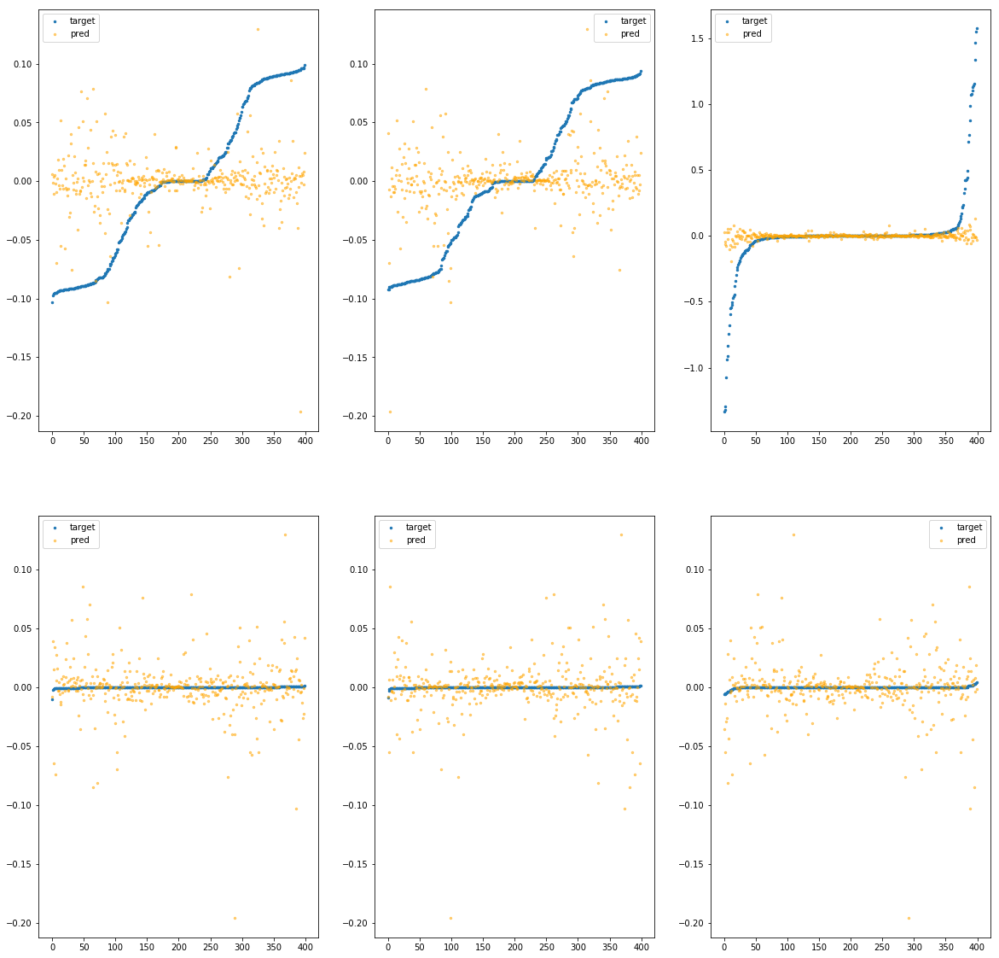

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8d30>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.27e-01	2.57e-01	5.33e-02	5.03e+03	4.61e-03	2.13e-05
y		-1.99e-01	2.52e-01	5.29e-02	5.22e+02	4.60e-03	2.11e-05
z		-8.06e-03	1.59e+00	1.05e-01	3.39e+02	8.40e-02	7.05e-03
phi		-2.41e+03	2.20e-01	1.47e-02	1.31e+06	8.74e-04	7.64e-07
theta		-2.84e+03	2.20e-01	1.47e-02	4.15e+05	8.77e-04	7.69e-07
psi		-1.17e+03	2.21e-01	1.48e-02	1.11e+06	8.81e-04	7.77e-07


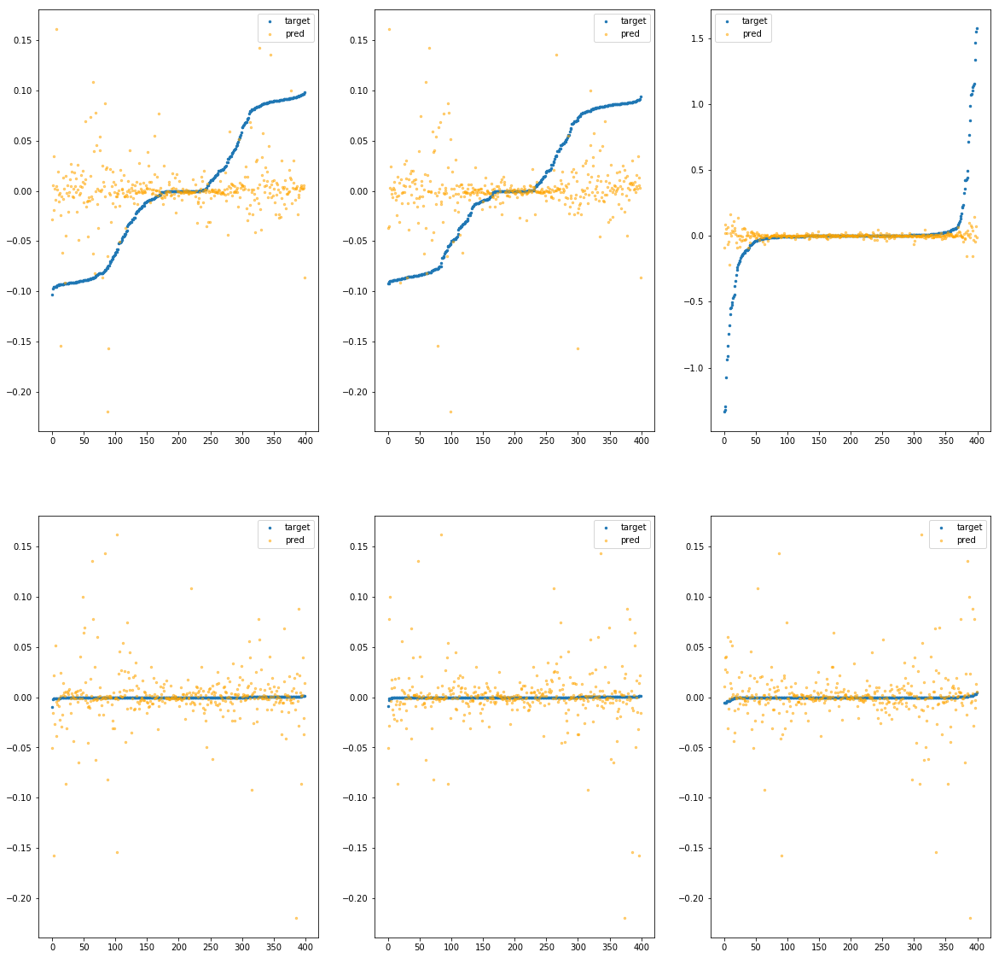

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8d90>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.73e-01	4.58e-01	6.03e-02	1.54e+04	6.85e-03	4.69e-05
y		-5.83e-01	3.42e-01	5.93e-02	1.03e+03	6.07e-03	3.68e-05
z		3.49e-02	1.54e+00	1.06e-01	4.72e+02	8.04e-02	6.47e-03
phi		-6.63e+03	4.25e-01	2.45e-02	2.86e+06	2.40e-03	5.77e-06
theta		-7.77e+03	4.25e-01	2.44e-02	8.55e+05	2.40e-03	5.76e-06
psi		-3.20e+03	4.31e-01	2.45e-02	1.71e+06	2.40e-03	5.77e-06


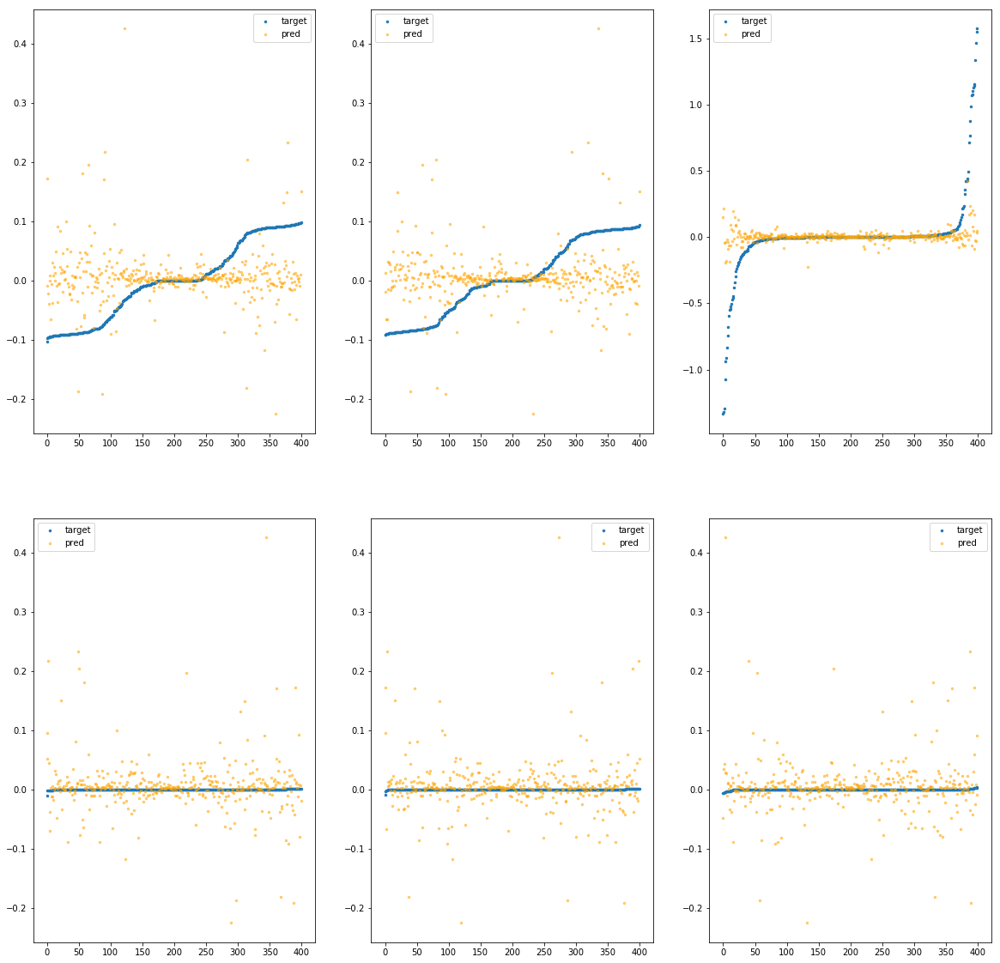

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8df0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.50e-04	1.03e-01	5.18e-02	4.91e+03	4.09e-03	1.68e-05
y		2.58e-04	9.86e-02	5.12e-02	2.31e+02	3.83e-03	1.47e-05
z		-1.56e-03	1.58e+00	1.02e-01	1.23e+02	8.34e-02	6.96e-03
phi		-1.33e+01	1.28e-02	1.55e-03	8.20e+05	5.19e-06	2.70e-11
theta		-1.55e+01	1.18e-02	1.52e-03	1.93e+05	5.09e-06	2.59e-11
psi		-6.29e+00	1.10e-02	1.58e-03	1.29e+05	5.47e-06	2.99e-11


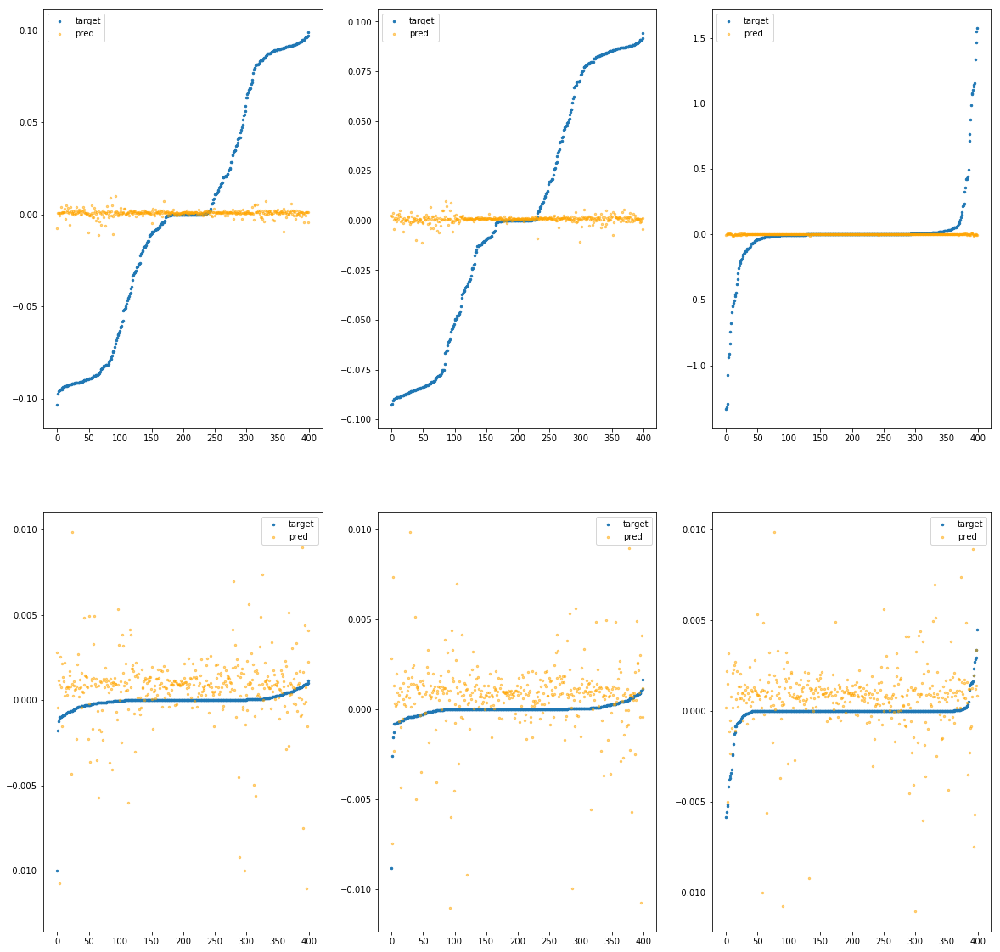

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8e50>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.69e-03	1.03e-01	5.17e-02	6.80e+02	4.09e-03	1.67e-05
y		1.32e-03	9.47e-02	5.11e-02	5.34e+01	3.83e-03	1.47e-05
z		-2.12e-03	1.57e+00	1.02e-01	4.38e+01	8.35e-02	6.97e-03
phi		-1.14e+01	1.45e-02	1.32e-03	1.24e+05	4.50e-06	2.03e-11
theta		-1.27e+01	1.48e-02	1.26e-03	5.61e+04	4.24e-06	1.80e-11
psi		-5.30e+00	1.38e-02	1.34e-03	9.16e+04	4.72e-06	2.23e-11


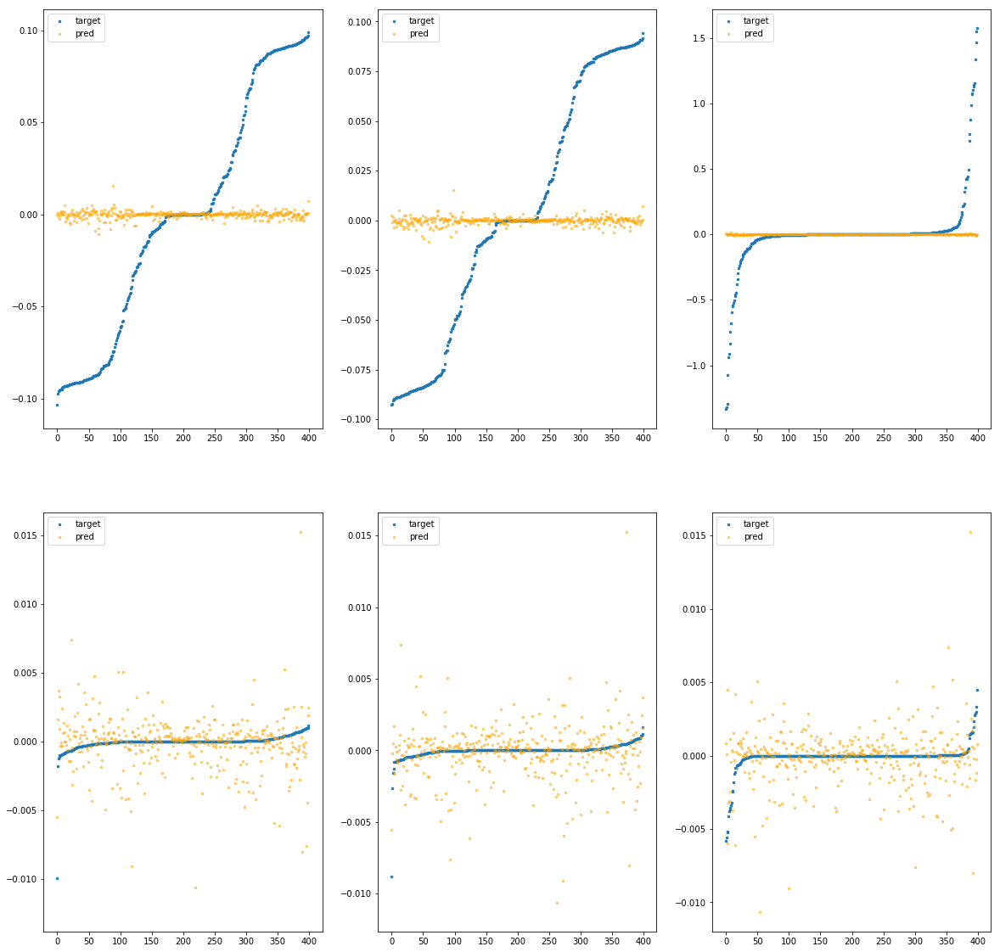

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8eb0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		6.22e-04	1.17e-01	5.18e-02	8.48e+03	4.09e-03	1.67e-05
y		-3.71e-03	1.12e-01	5.13e-02	3.56e+02	3.85e-03	1.48e-05
z		1.74e-03	1.58e+00	1.02e-01	1.98e+02	8.32e-02	6.92e-03
phi		-5.14e+01	2.23e-02	2.84e-03	1.45e+06	1.90e-05	3.59e-10
theta		-6.05e+01	2.16e-02	2.84e-03	3.69e+05	1.90e-05	3.61e-10
psi		-2.42e+01	2.17e-02	2.88e-03	1.81e+05	1.89e-05	3.58e-10


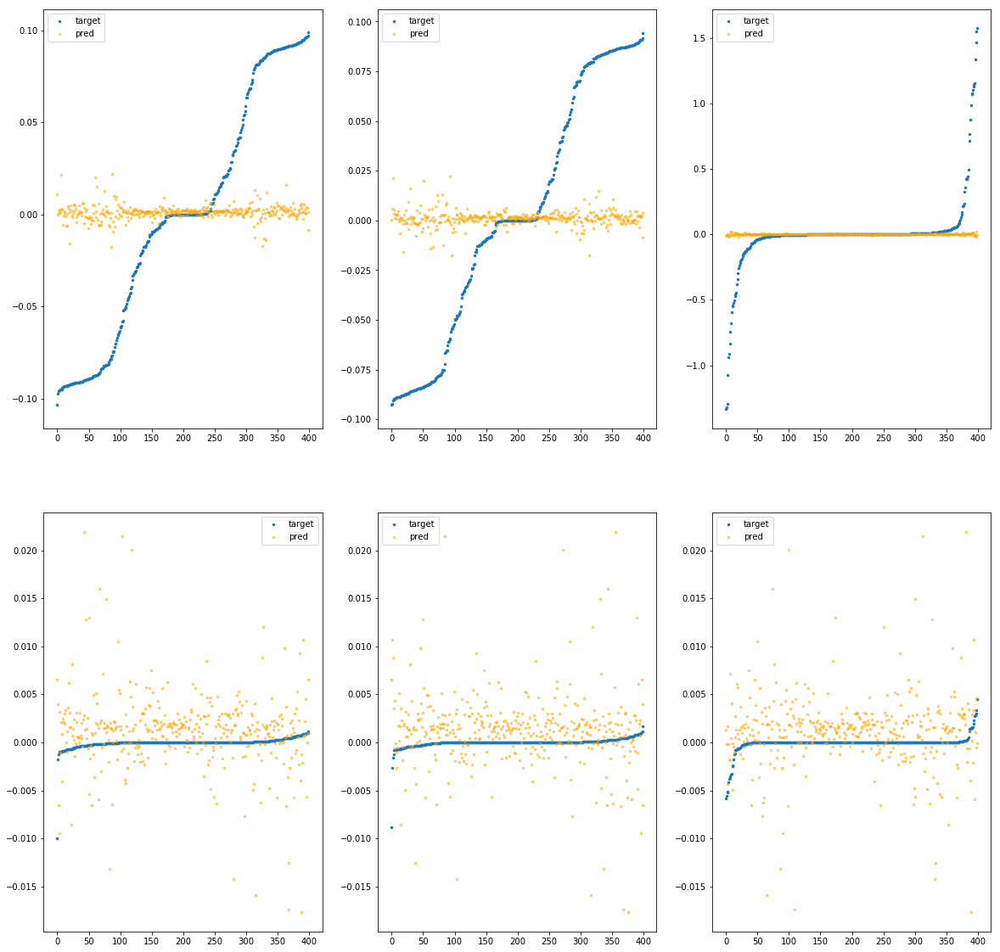

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8f10>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.99e-01	2.74e-01	5.55e-02	6.46e+03	5.32e-03	2.83e-05
y		-2.40e-01	2.33e-01	5.40e-02	3.02e+02	4.75e-03	2.26e-05
z		1.52e-02	1.60e+00	1.03e-01	2.73e+02	8.20e-02	6.73e-03
phi		-3.41e+03	1.97e-01	1.67e-02	1.33e+06	1.24e-03	1.53e-06
theta		-3.98e+03	1.98e-01	1.66e-02	3.19e+05	1.23e-03	1.51e-06
psi		-1.64e+03	1.94e-01	1.67e-02	1.27e+06	1.23e-03	1.52e-06


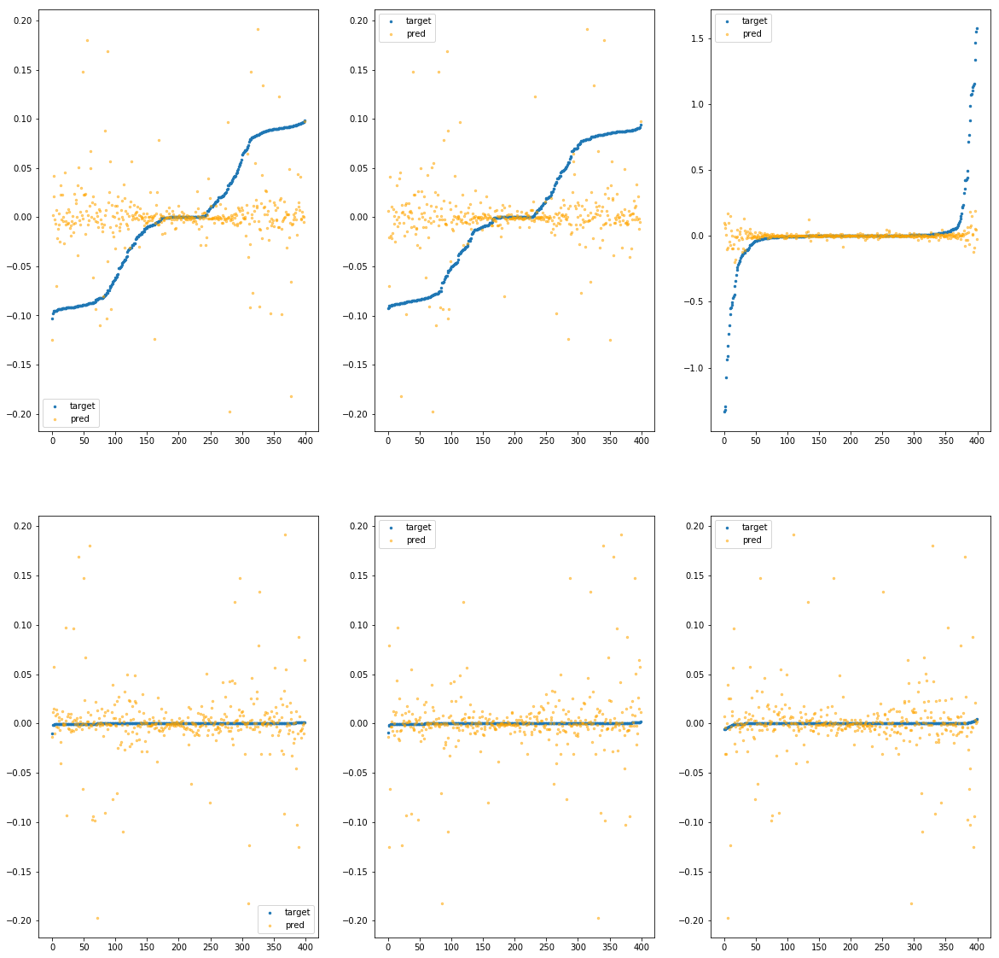

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8f70>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.93e-01	2.28e-01	5.46e-02	1.33e+04	4.88e-03	2.39e-05
y		-2.42e-01	2.24e-01	5.43e-02	2.75e+02	4.76e-03	2.27e-05
z		1.54e-02	1.60e+00	1.05e-01	3.20e+02	8.20e-02	6.73e-03
phi		-2.21e+03	1.42e-01	1.59e-02	2.31e+06	7.99e-04	6.39e-07
theta		-2.60e+03	1.43e-01	1.59e-02	3.88e+05	8.03e-04	6.45e-07
psi		-1.07e+03	1.42e-01	1.60e-02	1.69e+06	8.03e-04	6.44e-07


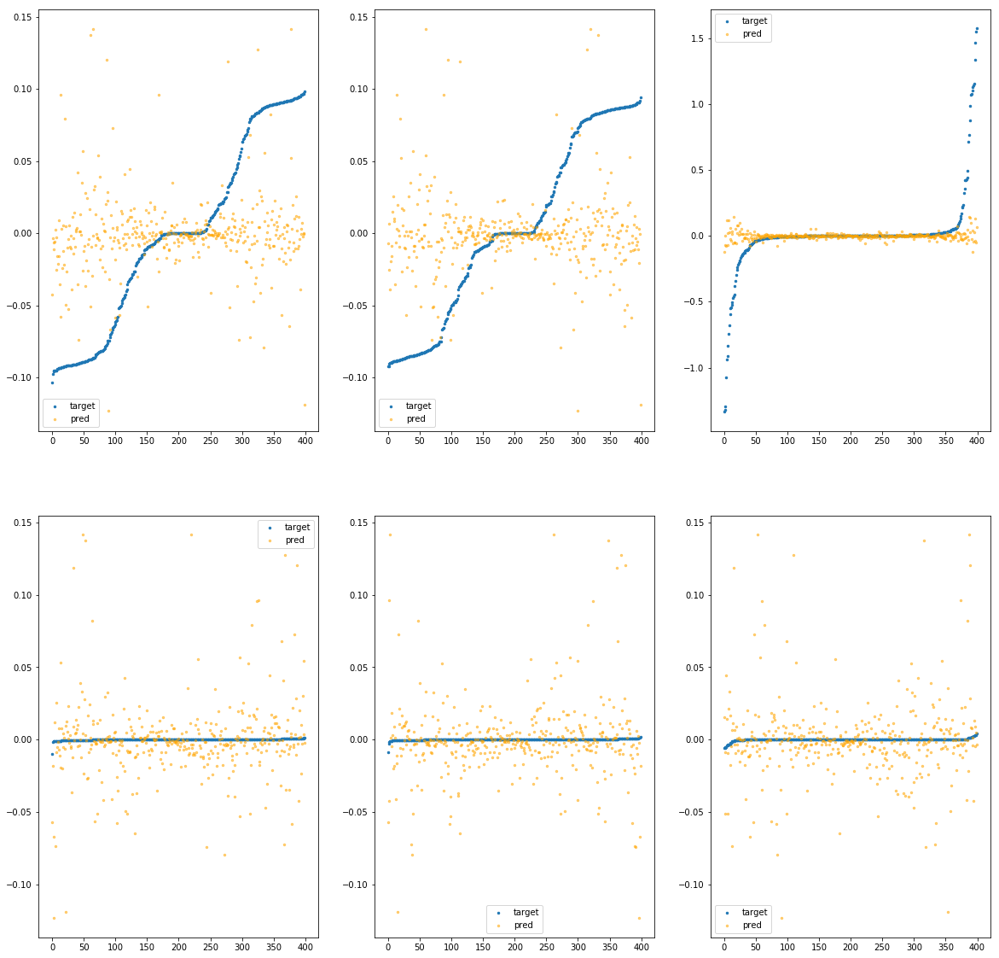

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270ca8fd0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.52e-03	1.07e-01	5.17e-02	6.38e+03	4.09e-03	1.67e-05
y		-6.04e-03	9.49e-02	5.13e-02	3.48e+02	3.86e-03	1.49e-05
z		-2.49e-05	1.57e+00	1.02e-01	1.48e+02	8.33e-02	6.94e-03
phi		-1.14e+01	1.06e-02	1.65e-03	1.06e+06	4.51e-06	2.03e-11
theta		-1.38e+01	1.04e-02	1.67e-03	2.71e+05	4.57e-06	2.09e-11
psi		-4.75e+00	8.07e-03	1.64e-03	2.00e+05	4.31e-06	1.86e-11


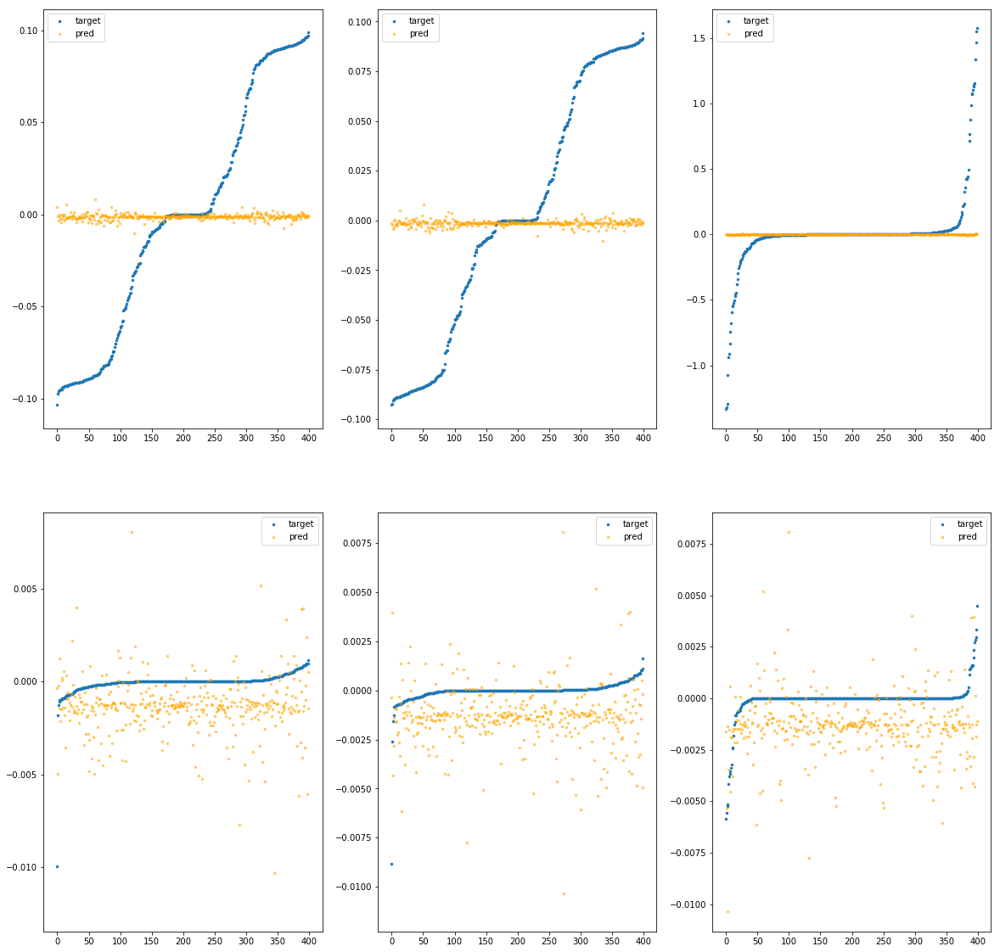

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d070>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.99e-04	1.03e-01	5.18e-02	3.99e+03	4.10e-03	1.68e-05
y		-2.36e-04	9.38e-02	5.12e-02	2.21e+02	3.84e-03	1.47e-05
z		-8.01e-04	1.58e+00	1.02e-01	1.07e+02	8.34e-02	6.95e-03
phi		-5.14e+00	1.03e-02	1.13e-03	6.94e+05	2.22e-06	4.95e-12
theta		-5.74e+00	1.03e-02	1.10e-03	1.88e+05	2.08e-06	4.33e-12
psi		-2.73e+00	9.90e-03	1.19e-03	7.78e+04	2.80e-06	7.81e-12


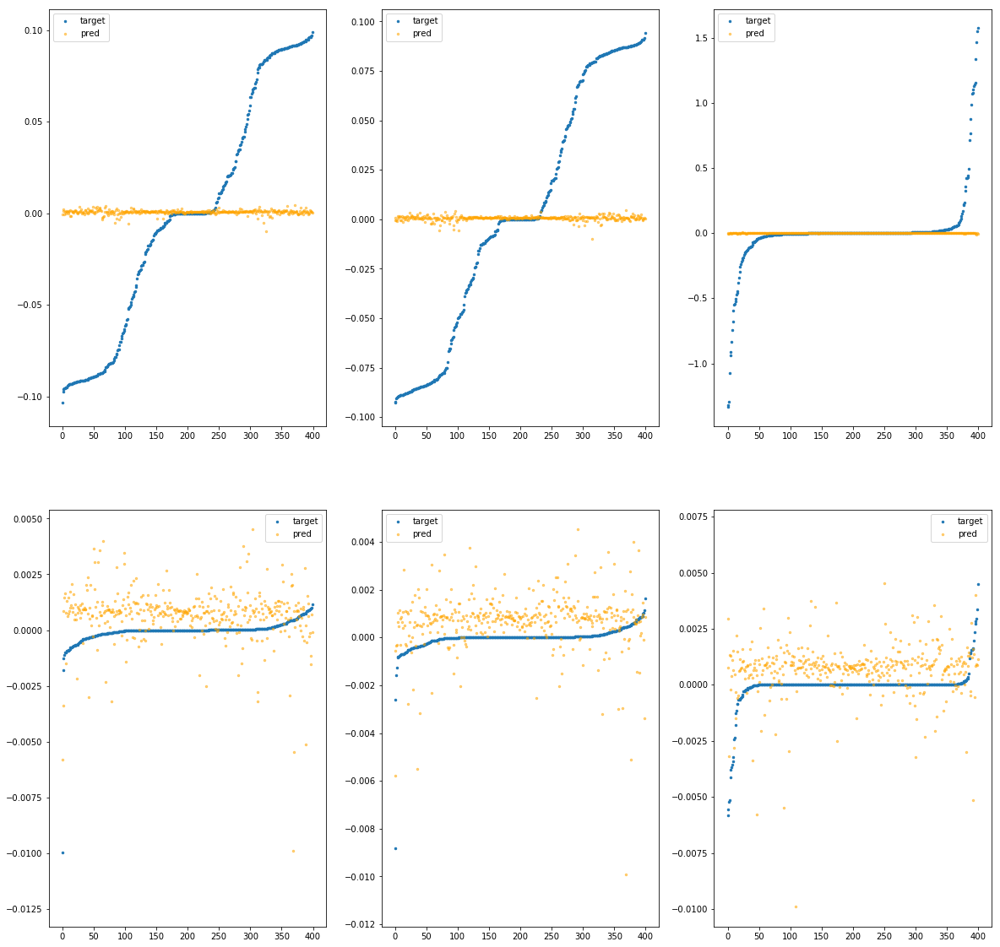

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d0d0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.95e-04	1.04e-01	5.17e-02	1.22e+03	4.09e-03	1.67e-05
y		2.93e-03	9.91e-02	5.10e-02	6.30e+01	3.82e-03	1.46e-05
z		-1.58e-03	1.57e+00	1.02e-01	3.43e+01	8.34e-02	6.96e-03
phi		-6.51e+00	8.91e-03	9.66e-04	2.25e+05	2.72e-06	7.39e-12
theta		-7.73e+00	7.89e-03	9.88e-04	4.25e+04	2.70e-06	7.28e-12
psi		-3.98e+00	1.30e-02	1.08e-03	5.48e+04	3.74e-06	1.40e-11


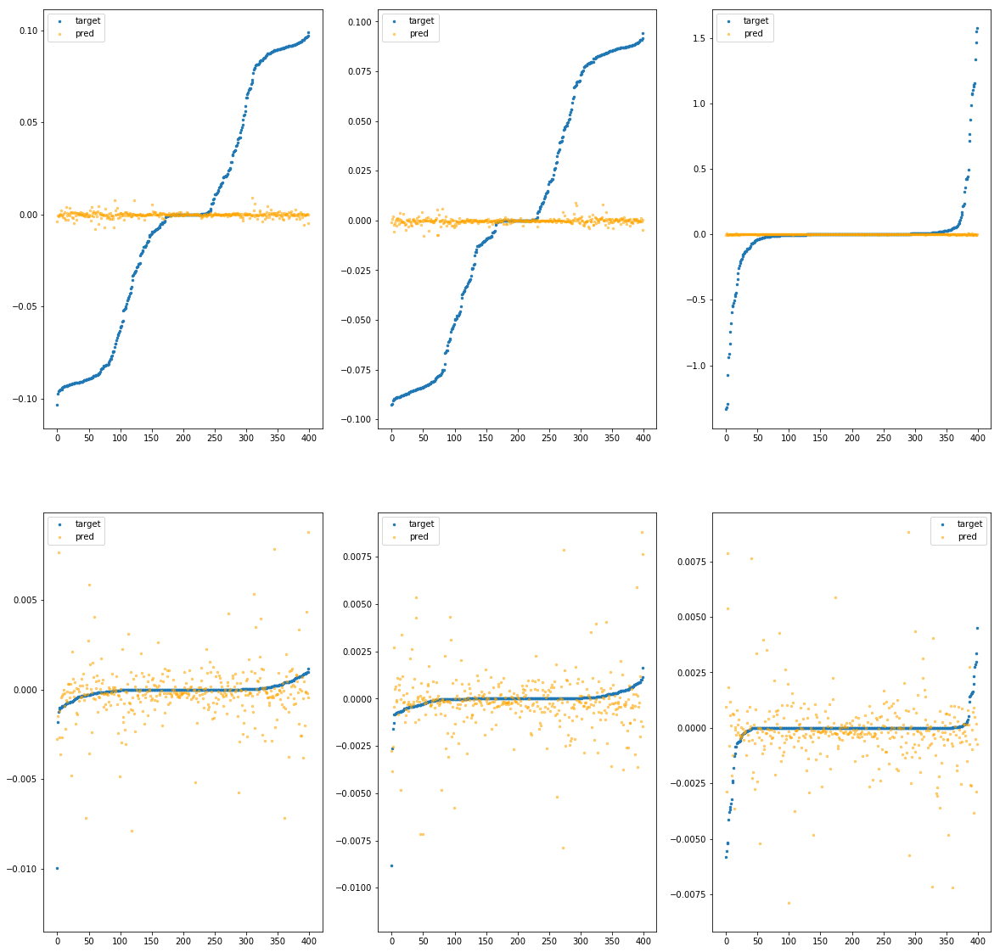

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d130>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.15e-03	1.03e-01	5.17e-02	2.43e+03	4.09e-03	1.67e-05
y		-2.03e-03	9.40e-02	5.12e-02	9.48e+01	3.84e-03	1.48e-05
z		4.23e-04	1.57e+00	1.02e-01	5.19e+01	8.33e-02	6.94e-03
phi		-3.87e+00	6.65e-03	9.03e-04	4.00e+05	1.76e-06	3.11e-12
theta		-4.54e+00	6.88e-03	8.89e-04	9.93e+04	1.71e-06	2.93e-12
psi		-1.98e+00	7.15e-03	9.74e-04	9.64e+04	2.23e-06	4.99e-12


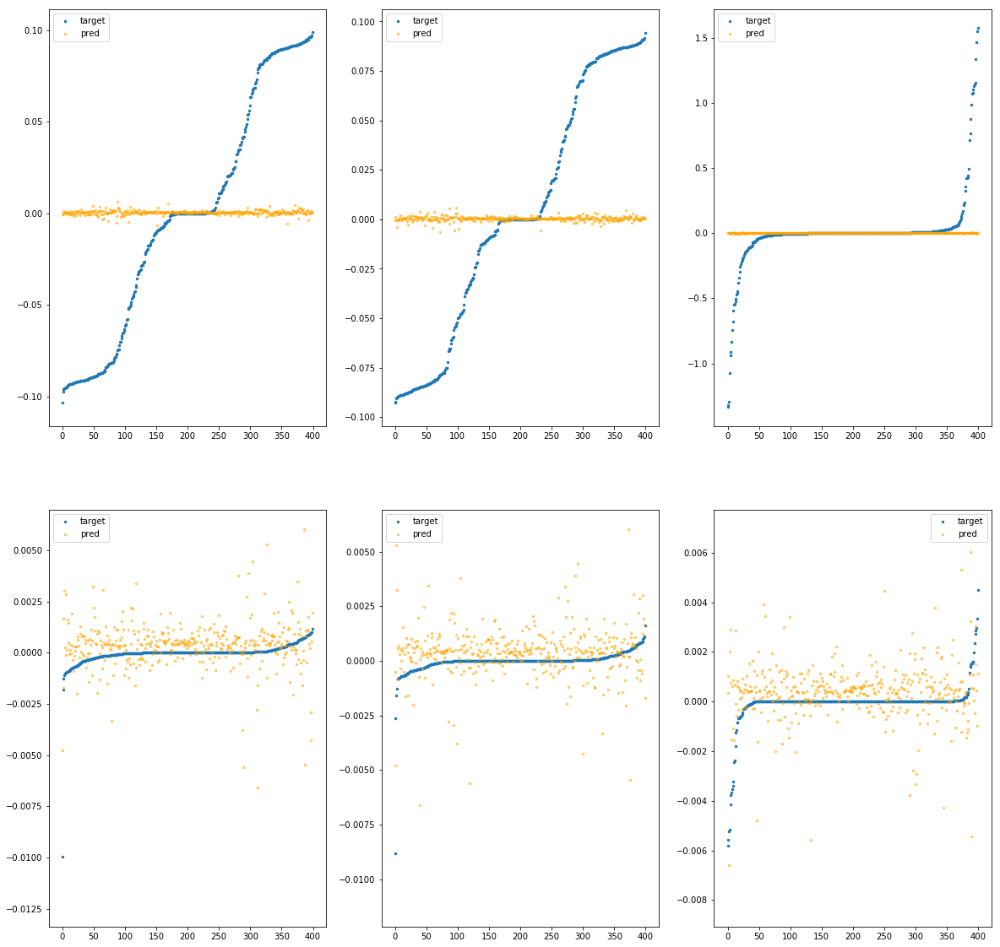

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d190>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.35e-01	2.26e-01	5.35e-02	2.10e+04	4.65e-03	2.16e-05
y		-1.05e-01	2.21e-01	5.22e-02	9.49e+02	4.24e-03	1.80e-05
z		2.01e-02	1.60e+00	1.03e-01	4.68e+02	8.16e-02	6.67e-03
phi		-1.73e+03	1.33e-01	1.28e-02	3.19e+06	6.26e-04	3.92e-07
theta		-2.02e+03	1.33e-01	1.28e-02	8.30e+05	6.24e-04	3.90e-07
psi		-8.38e+02	1.34e-01	1.28e-02	7.04e+05	6.29e-04	3.96e-07


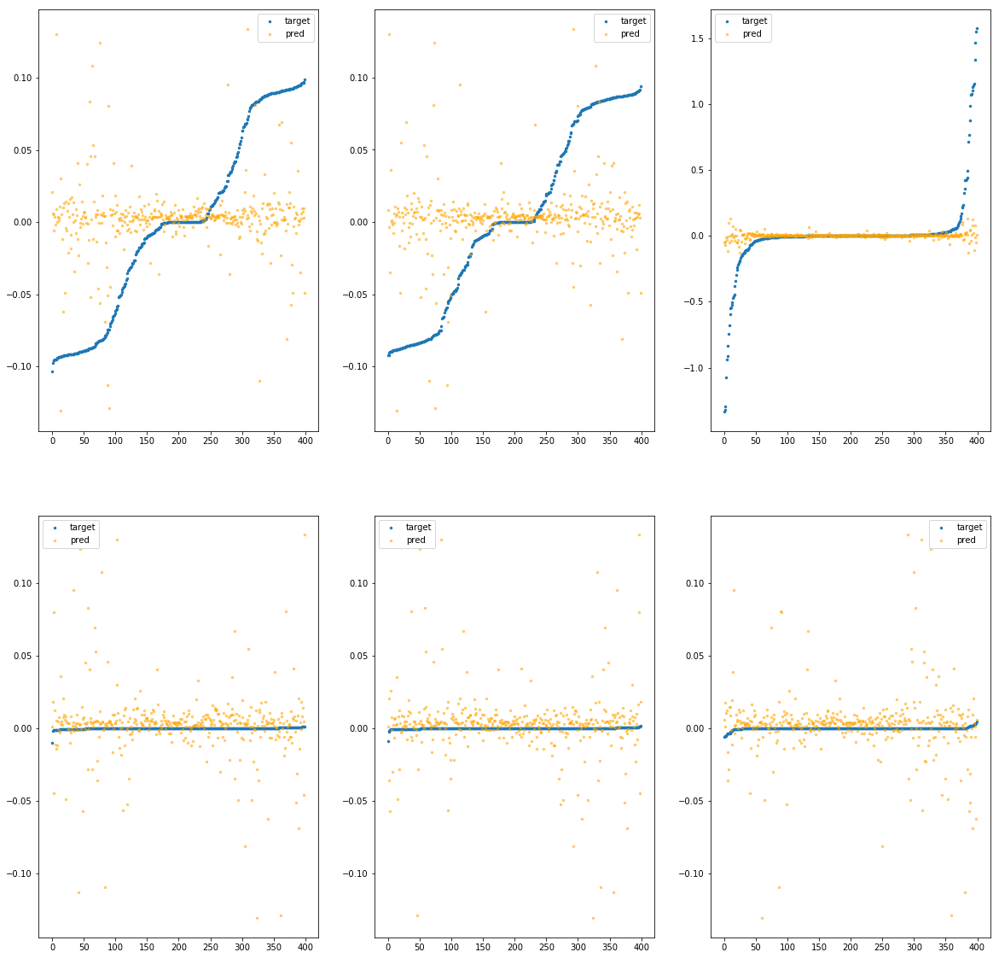

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d1f0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.13e-03	1.05e-01	5.19e-02	5.97e+03	4.10e-03	1.68e-05
y		5.58e-04	9.96e-02	5.12e-02	2.82e+02	3.83e-03	1.47e-05
z		-2.04e-03	1.57e+00	1.02e-01	1.41e+02	8.35e-02	6.97e-03
phi		-1.07e+01	9.85e-03	1.57e-03	1.02e+06	4.24e-06	1.80e-11
theta		-1.19e+01	9.57e-03	1.53e-03	2.50e+05	3.97e-06	1.58e-11
psi		-5.71e+00	1.34e-02	1.66e-03	1.66e+05	5.04e-06	2.54e-11


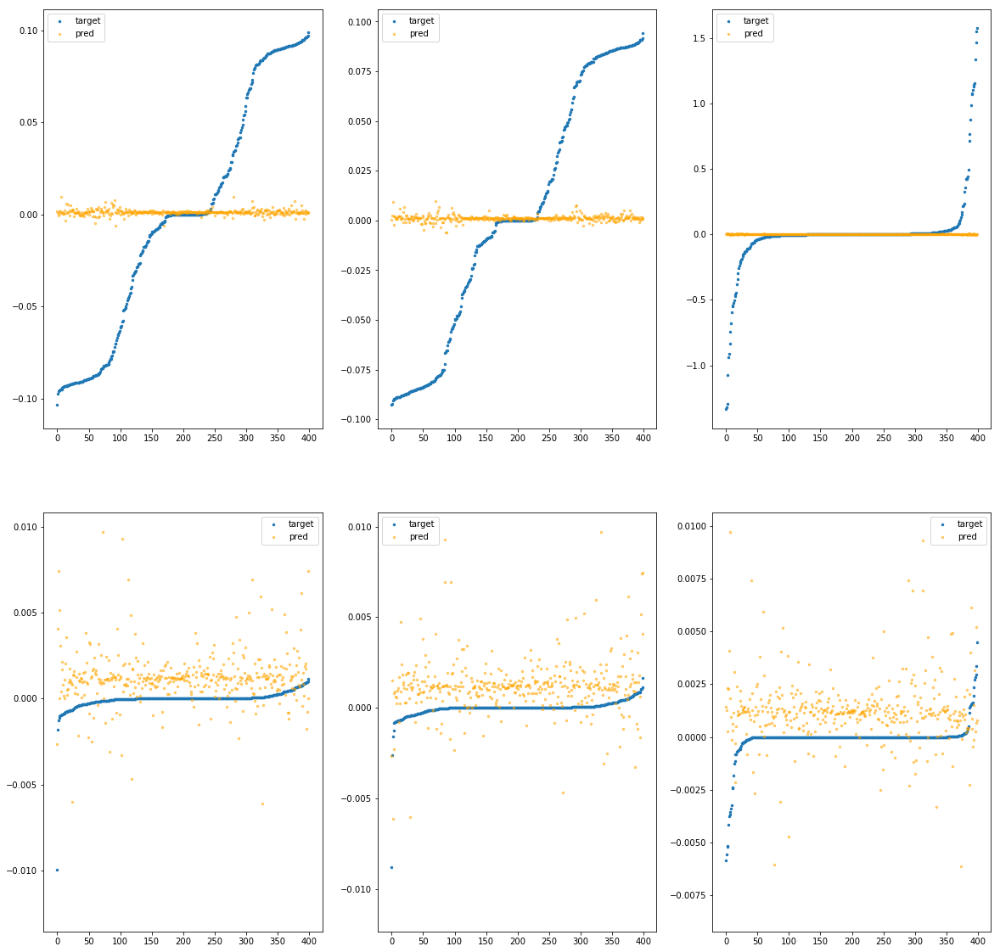

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d250>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.44e-03	1.03e-01	5.17e-02	5.22e+03	4.08e-03	1.66e-05
y		1.04e-03	9.86e-02	5.12e-02	2.51e+02	3.83e-03	1.47e-05
z		-1.08e-03	1.57e+00	1.02e-01	1.22e+02	8.34e-02	6.96e-03
phi		-9.25e+00	1.22e-02	1.36e-03	8.54e+05	3.71e-06	1.38e-11
theta		-9.76e+00	1.11e-02	1.30e-03	2.24e+05	3.32e-06	1.10e-11
psi		-4.84e+00	9.91e-03	1.47e-03	1.62e+05	4.38e-06	1.92e-11


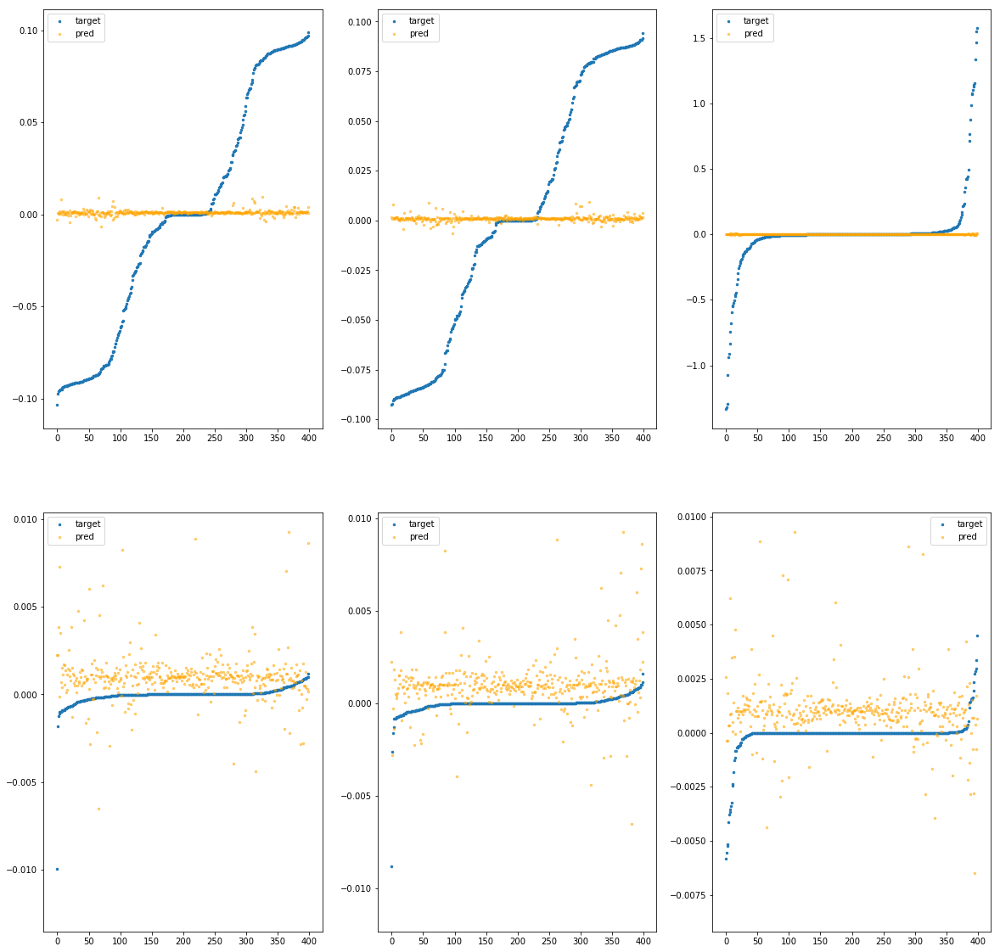

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d2b0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.41e-03	1.04e-01	5.17e-02	6.31e+03	4.08e-03	1.66e-05
y		-4.52e-03	9.91e-02	5.13e-02	3.55e+02	3.85e-03	1.48e-05
z		9.66e-04	1.57e+00	1.02e-01	1.55e+02	8.32e-02	6.93e-03
phi		-1.10e+01	1.11e-02	1.63e-03	1.08e+06	4.35e-06	1.89e-11
theta		-1.31e+01	1.12e-02	1.61e-03	2.81e+05	4.36e-06	1.90e-11
psi		-5.84e+00	1.31e-02	1.71e-03	1.79e+05	5.13e-06	2.63e-11


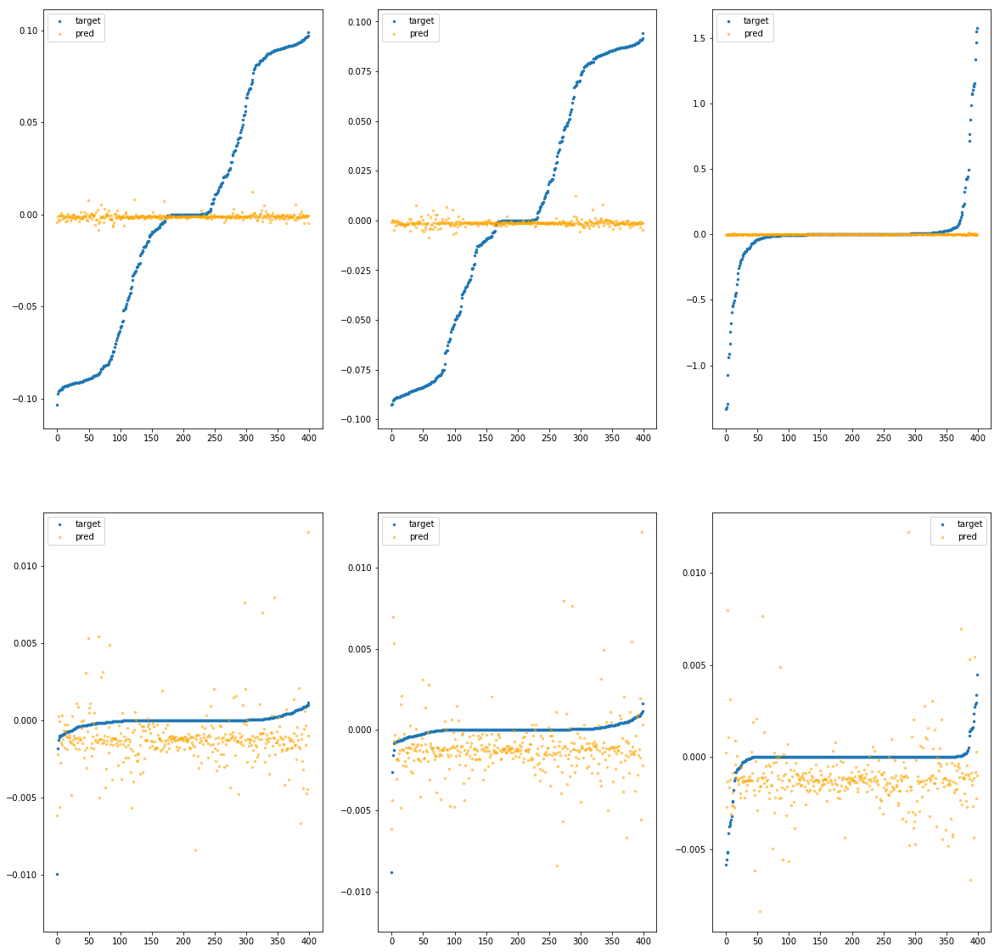

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d310>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		7.37e-03	9.88e-02	5.16e-02	3.46e+03	4.06e-03	1.65e-05
y		-3.27e-03	9.44e-02	5.12e-02	1.86e+02	3.85e-03	1.48e-05
z		-3.59e-03	1.57e+00	1.02e-01	9.02e+01	8.36e-02	6.99e-03
phi		-7.30e+00	9.87e-03	1.22e-03	6.10e+05	3.00e-06	9.03e-12
theta		-8.30e+00	8.72e-03	1.21e-03	1.41e+05	2.87e-06	8.26e-12
psi		-3.68e+00	8.44e-03	1.31e-03	9.07e+04	3.51e-06	1.23e-11


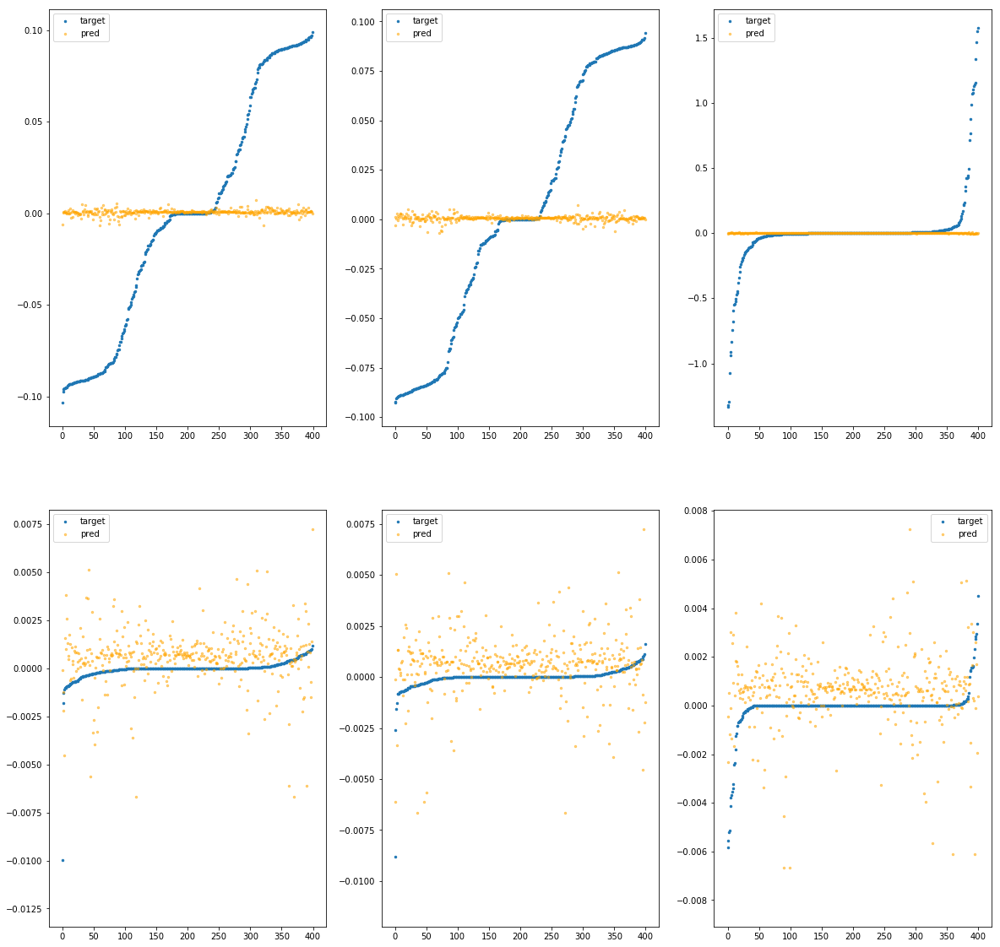

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d370>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.98e-03	1.05e-01	5.15e-02	6.42e+02	4.07e-03	1.66e-05
y		-1.25e-02	9.68e-02	5.14e-02	4.07e+01	3.88e-03	1.51e-05
z		-1.51e-03	1.57e+00	1.02e-01	2.92e+01	8.34e-02	6.96e-03
phi		-1.59e+01	1.42e-02	1.43e-03	1.43e+05	6.12e-06	3.74e-11
theta		-1.92e+01	1.52e-02	1.43e-03	6.06e+04	6.23e-06	3.89e-11
psi		-7.02e+00	1.25e-02	1.43e-03	1.02e+05	6.01e-06	3.62e-11


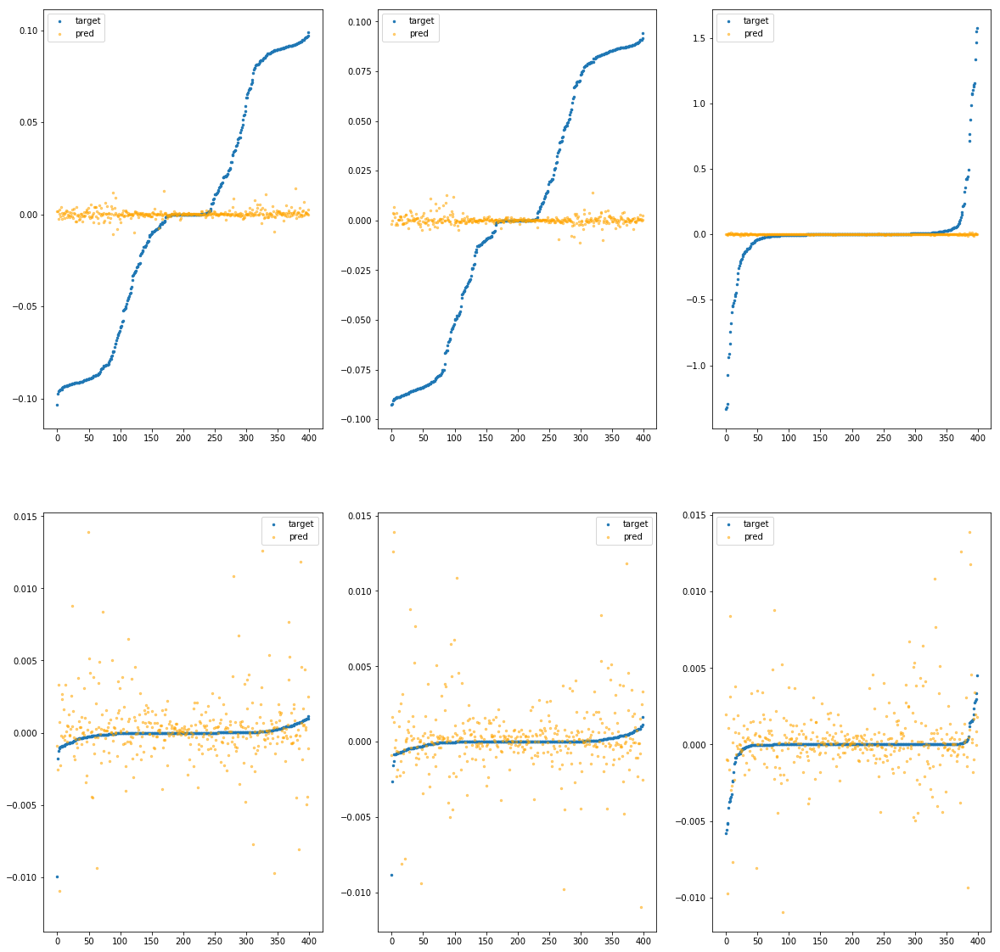

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d3d0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.23e-01	3.38e-01	5.80e-02	9.09e+03	5.83e-03	3.39e-05
y		-3.34e-01	2.58e-01	5.49e-02	7.63e+02	5.12e-03	2.62e-05
z		3.56e-02	1.60e+00	1.04e-01	4.17e+02	8.04e-02	6.46e-03
phi		-4.06e+03	2.47e-01	1.91e-02	1.56e+06	1.47e-03	2.16e-06
theta		-4.78e+03	2.47e-01	1.91e-02	5.83e+05	1.48e-03	2.18e-06
psi		-1.97e+03	2.47e-01	1.91e-02	9.44e+05	1.48e-03	2.18e-06


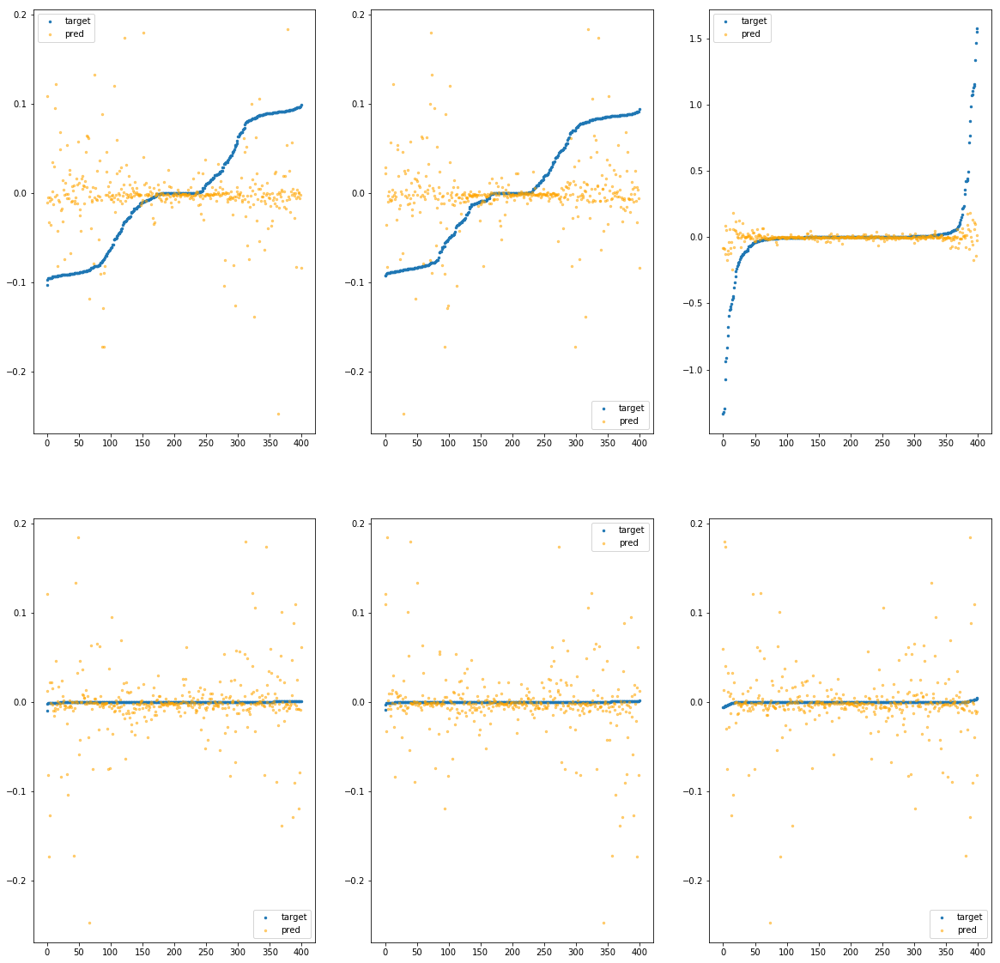

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d430>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.46e-01	3.93e-01	6.01e-02	7.56e+03	6.74e-03	4.54e-05
y		-9.40e-01	4.07e-01	6.01e-02	3.51e+02	7.44e-03	5.53e-05
z		-8.94e-02	1.62e+00	1.14e-01	6.81e+02	9.08e-02	8.24e-03
phi		-9.28e+03	3.28e-01	2.81e-02	1.68e+06	3.36e-03	1.13e-05
theta		-1.09e+04	3.28e-01	2.82e-02	3.77e+05	3.36e-03	1.13e-05
psi		-4.49e+03	3.33e-01	2.82e-02	1.14e+06	3.36e-03	1.13e-05


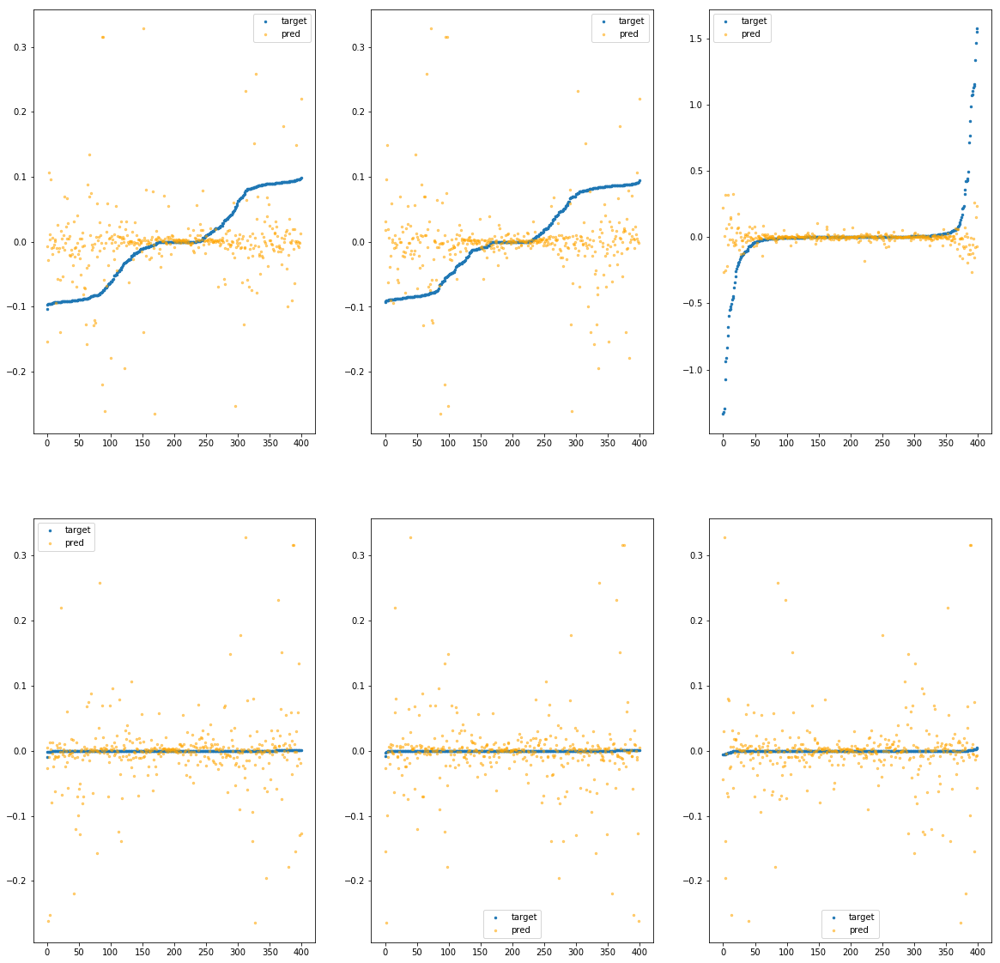

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d490>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.43e+00	3.98e-01	7.01e-02	8.46e+03	9.94e-03	9.89e-05
y		-1.61e+00	4.38e-01	6.85e-02	4.74e+02	1.00e-02	1.00e-04
z		-7.65e-02	1.71e+00	1.20e-01	5.91e+02	8.97e-02	8.05e-03
phi		-1.70e+04	3.54e-01	4.25e-02	1.71e+06	6.17e-03	3.81e-05
theta		-2.00e+04	3.54e-01	4.25e-02	6.48e+05	6.18e-03	3.82e-05
psi		-8.24e+03	3.54e-01	4.25e-02	3.84e+06	6.18e-03	3.82e-05


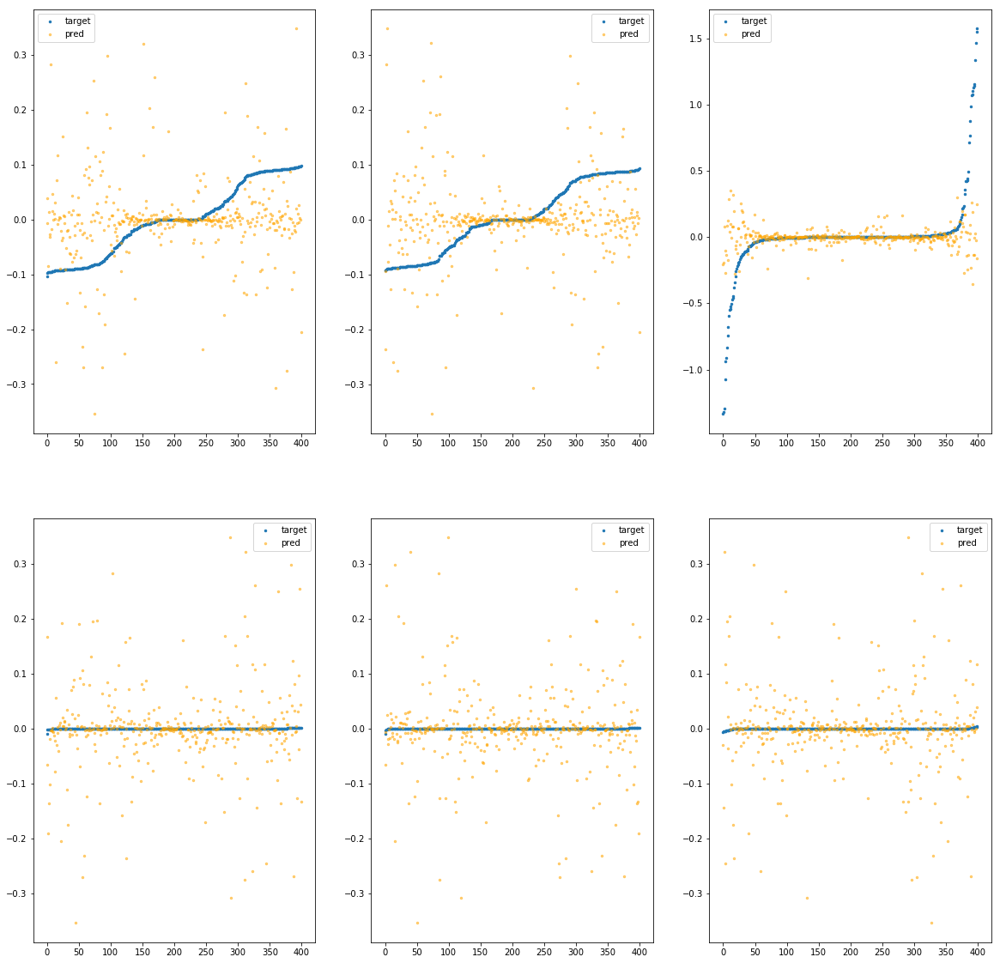

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d4f0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.45e-01	4.85e-01	5.93e-02	1.34e+04	6.73e-03	4.53e-05
y		-6.85e-01	4.72e-01	5.81e-02	3.74e+02	6.46e-03	4.18e-05
z		-5.81e-02	1.60e+00	1.11e-01	4.69e+02	8.82e-02	7.77e-03
phi		-8.02e+03	3.92e-01	2.90e-02	2.87e+06	2.90e-03	8.43e-06
theta		-9.39e+03	3.91e-01	2.90e-02	4.43e+05	2.90e-03	8.41e-06
psi		-3.88e+03	3.94e-01	2.90e-02	1.55e+06	2.91e-03	8.49e-06


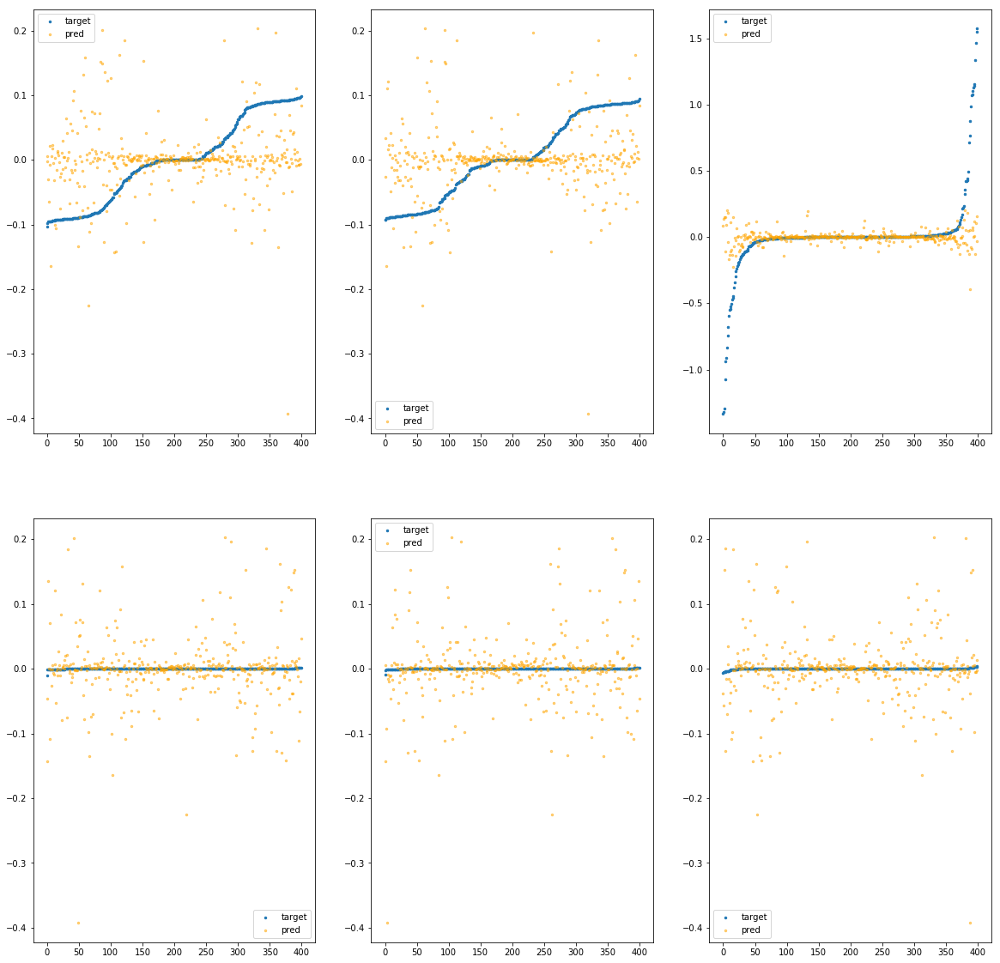

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d550>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.32e+00	5.30e-01	6.74e-02	1.08e+04	9.52e-03	9.06e-05
y		-1.59e+00	5.47e-01	6.53e-02	2.58e+02	9.93e-03	9.86e-05
z		-1.18e-01	1.71e+00	1.18e-01	5.09e+02	9.31e-02	8.68e-03
phi		-1.53e+04	4.63e-01	3.60e-02	3.01e+06	5.54e-03	3.07e-05
theta		-1.79e+04	4.60e-01	3.60e-02	3.38e+05	5.54e-03	3.07e-05
psi		-7.40e+03	4.64e-01	3.60e-02	1.93e+06	5.55e-03	3.08e-05


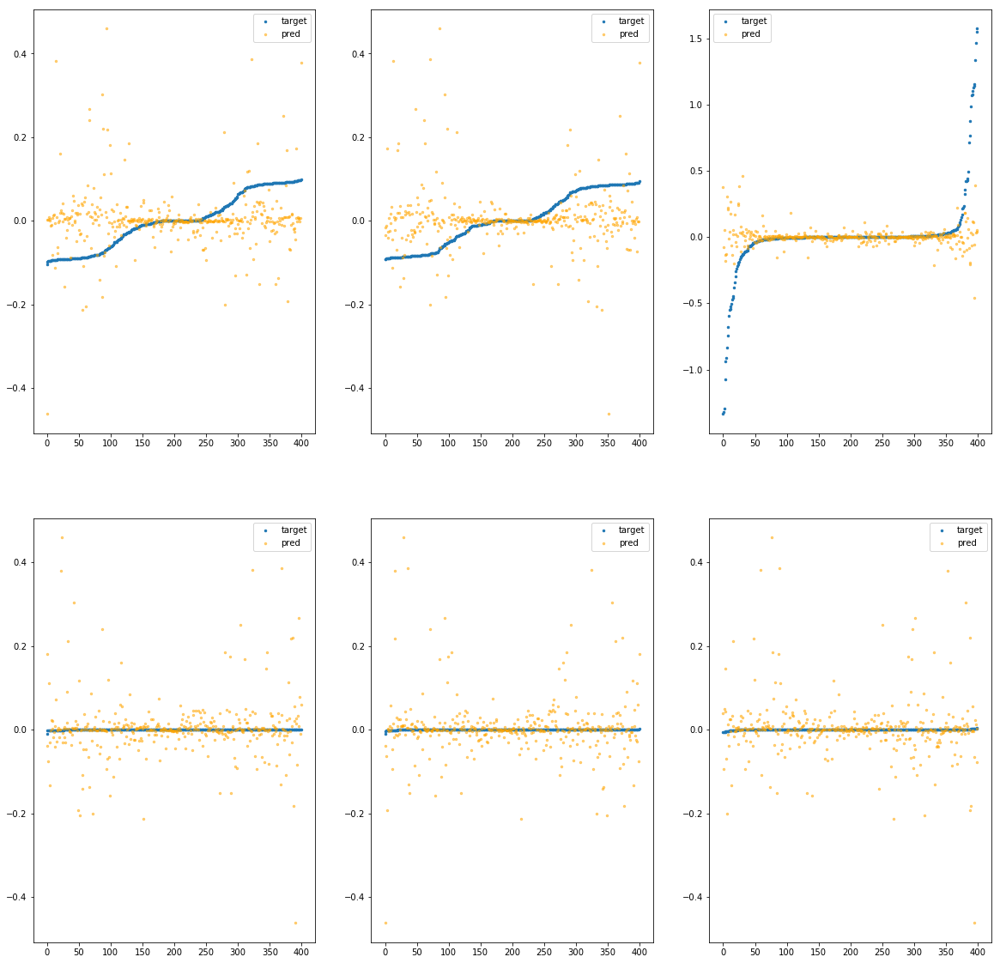

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d5b0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.22e-02	2.41e-01	5.25e-02	5.07e+03	4.47e-03	2.00e-05
y		-1.63e-01	1.96e-01	5.35e-02	3.53e+02	4.46e-03	1.99e-05
z		-2.50e-02	1.54e+00	1.06e-01	2.74e+02	8.54e-02	7.29e-03
phi		-1.55e+03	1.47e-01	1.24e-02	1.04e+06	5.61e-04	3.15e-07
theta		-1.82e+03	1.47e-01	1.24e-02	2.66e+05	5.61e-04	3.15e-07
psi		-7.43e+02	1.47e-01	1.23e-02	9.00e+05	5.58e-04	3.12e-07


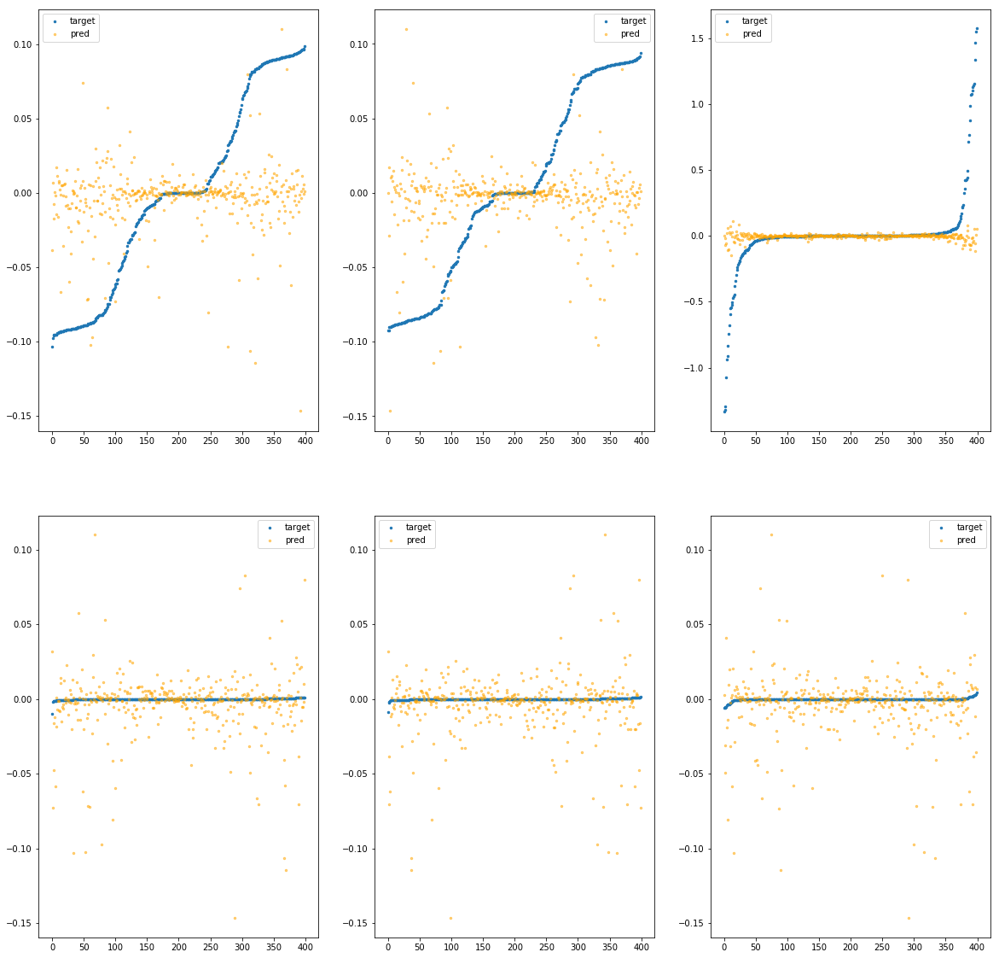

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d610>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.45e-01	4.33e-01	6.00e-02	6.89e+03	6.74e-03	4.54e-05
y		-6.04e-01	4.37e-01	5.70e-02	4.72e+02	6.15e-03	3.78e-05
z		-2.45e-02	1.52e+00	1.07e-01	4.22e+02	8.54e-02	7.29e-03
phi		-5.34e+03	3.58e-01	2.10e-02	1.40e+06	1.93e-03	3.74e-06
theta		-6.27e+03	3.59e-01	2.10e-02	5.87e+05	1.94e-03	3.75e-06
psi		-2.58e+03	3.59e-01	2.10e-02	9.86e+05	1.93e-03	3.73e-06


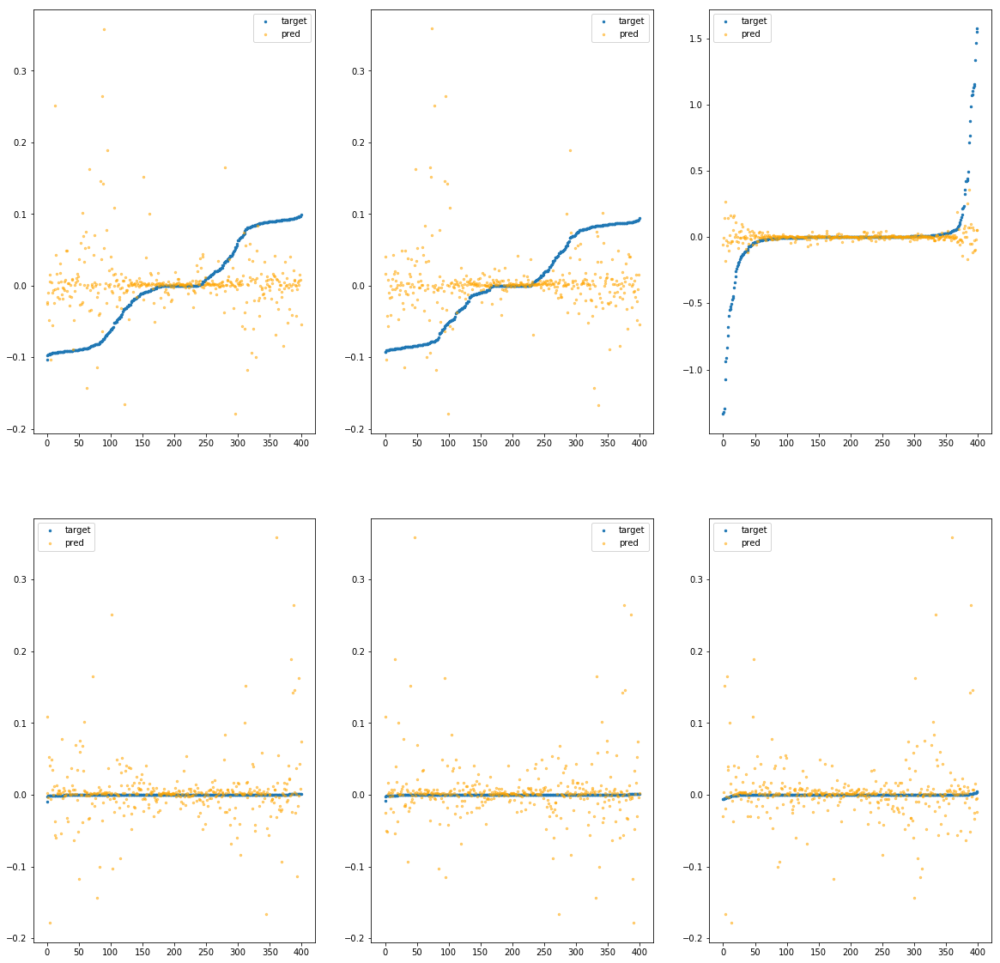

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d670>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.18e-01	3.75e-01	5.82e-02	9.58e+03	6.21e-03	3.86e-05
y		-4.82e-01	3.53e-01	5.67e-02	8.21e+02	5.68e-03	3.23e-05
z		-6.42e-02	1.66e+00	1.10e-01	4.73e+02	8.87e-02	7.86e-03
phi		-5.87e+03	3.00e-01	2.31e-02	2.94e+06	2.12e-03	4.51e-06
theta		-6.86e+03	3.00e-01	2.31e-02	8.04e+05	2.12e-03	4.49e-06
psi		-2.83e+03	2.99e-01	2.31e-02	1.52e+06	2.12e-03	4.50e-06


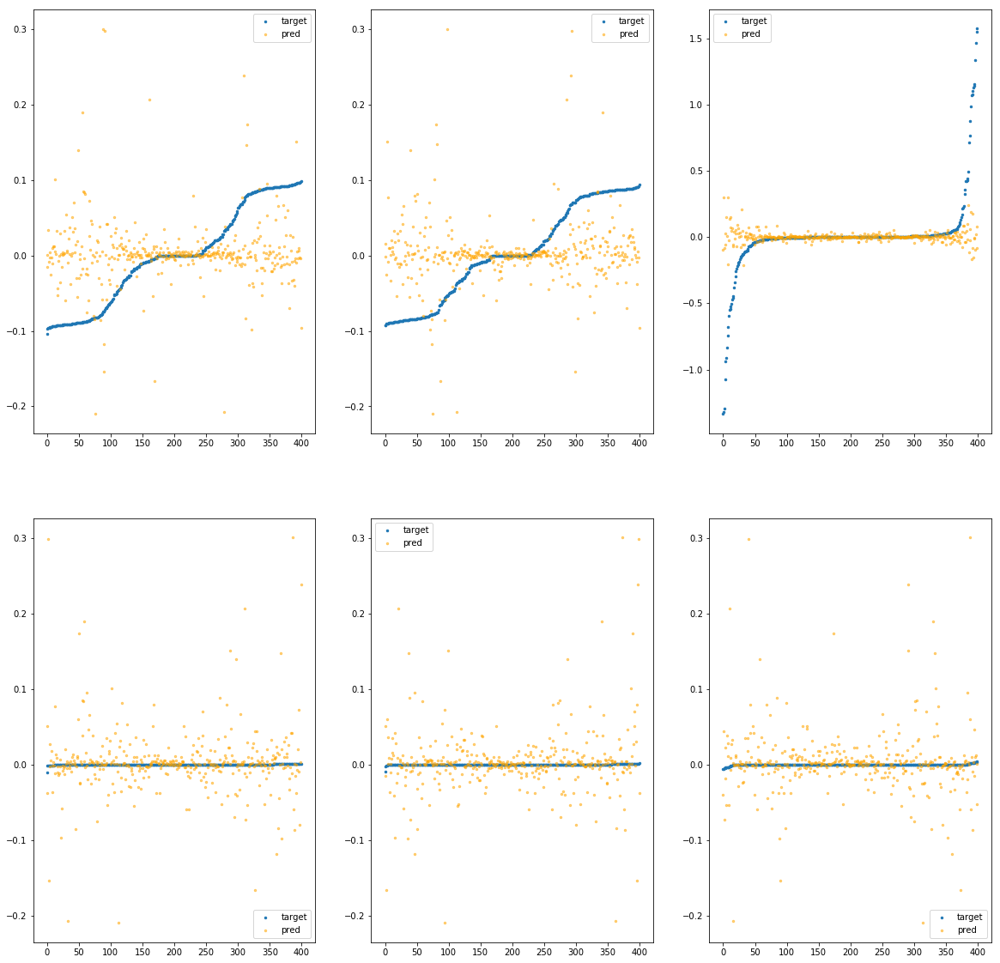

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d6d0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.74e-01	2.98e-01	6.01e-02	1.21e+04	6.44e-03	4.15e-05
y		-5.40e-01	3.30e-01	5.79e-02	4.48e+02	5.91e-03	3.49e-05
z		3.10e-02	1.55e+00	1.05e-01	3.30e+02	8.07e-02	6.52e-03
phi		-6.03e+03	2.54e-01	2.34e-02	2.01e+06	2.18e-03	4.77e-06
theta		-7.08e+03	2.55e-01	2.34e-02	4.02e+05	2.19e-03	4.78e-06
psi		-2.90e+03	2.54e-01	2.34e-02	1.79e+06	2.18e-03	4.73e-06


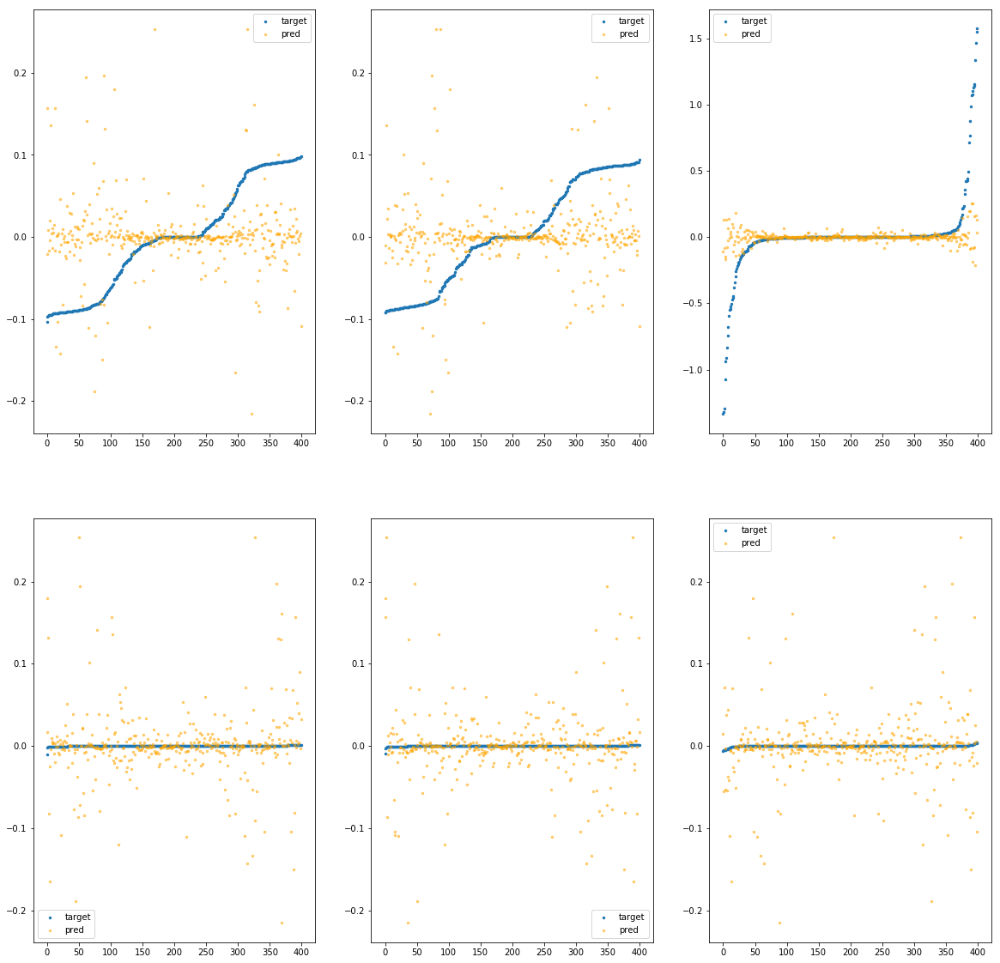

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d730>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.09e+00	4.78e-01	6.47e-02	5.90e+03	8.56e-03	7.34e-05
y		-1.05e+00	4.56e-01	6.24e-02	4.35e+02	7.87e-03	6.20e-05
z		-1.44e-02	1.69e+00	1.08e-01	2.84e+02	8.45e-02	7.14e-03
phi		-1.08e+04	3.99e-01	2.91e-02	9.89e+05	3.91e-03	1.53e-05
theta		-1.27e+04	3.99e-01	2.91e-02	4.26e+05	3.91e-03	1.53e-05
psi		-5.18e+03	3.98e-01	2.90e-02	1.91e+06	3.88e-03	1.51e-05


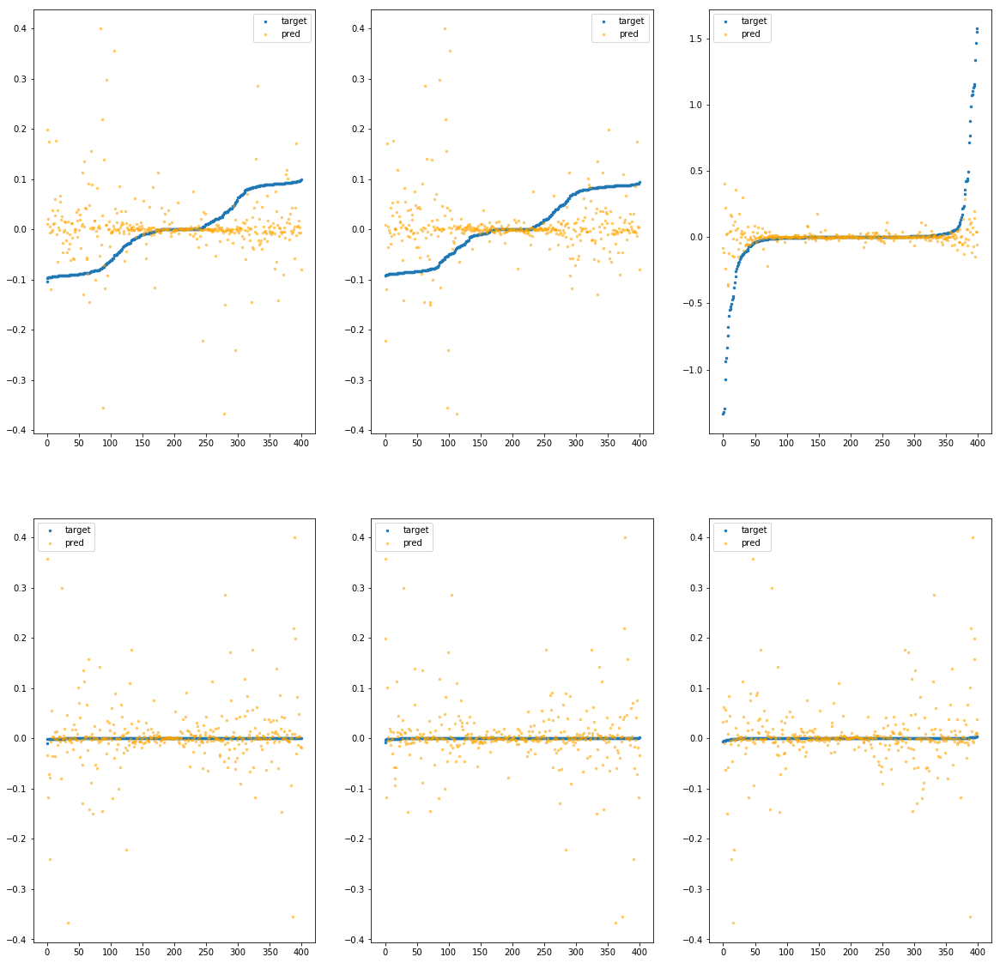

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d790>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.88e-02	1.53e-01	5.31e-02	4.52e+03	4.34e-03	1.88e-05
y		-1.67e-02	1.31e-01	5.09e-02	4.98e+01	3.90e-03	1.52e-05
z		-2.75e-03	1.55e+00	1.03e-01	1.03e+02	8.35e-02	6.98e-03
phi		-3.99e+02	7.31e-02	6.68e-03	6.69e+05	1.45e-04	2.09e-08
theta		-4.73e+02	7.41e-02	6.67e-03	6.42e+04	1.47e-04	2.15e-08
psi		-1.95e+02	7.33e-02	6.68e-03	4.81e+05	1.47e-04	2.17e-08


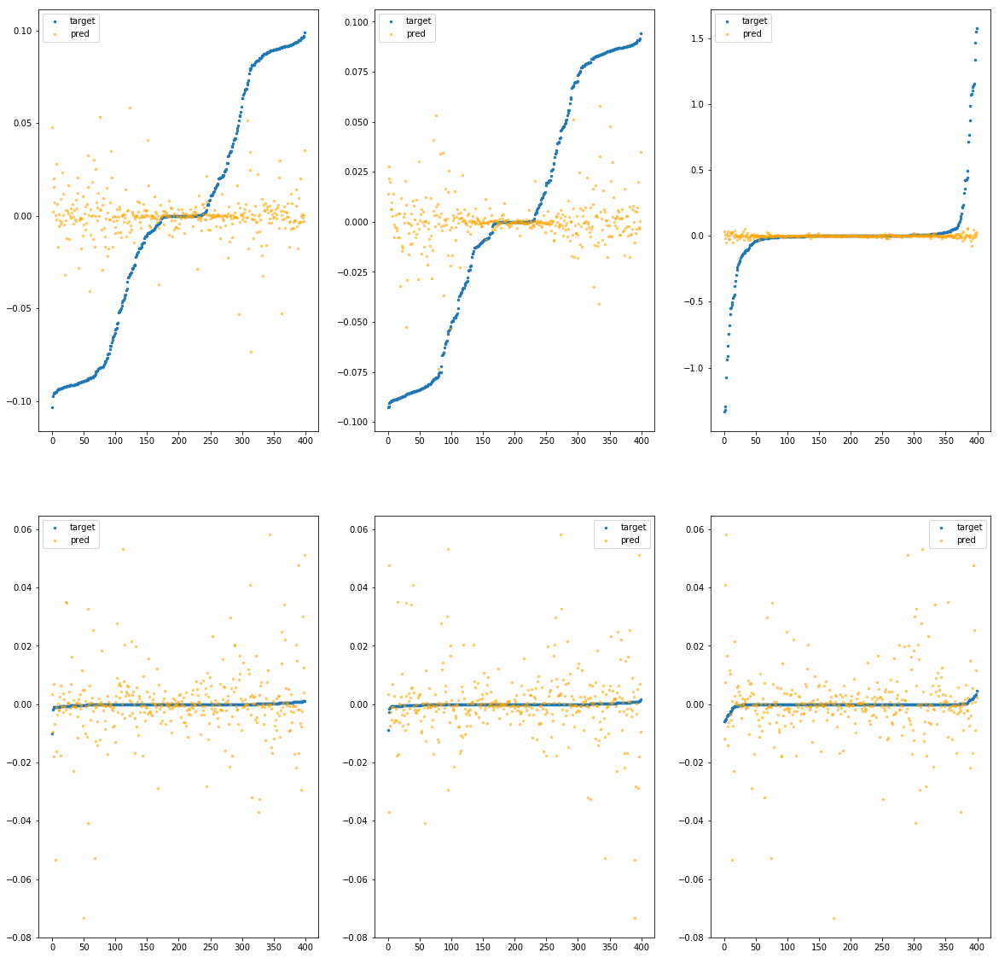

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d7f0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.22e-01	2.11e-01	5.33e-02	3.53e+03	4.59e-03	2.11e-05
y		-1.09e-01	1.84e-01	5.20e-02	1.42e+02	4.25e-03	1.81e-05
z		-1.59e-02	1.58e+00	1.04e-01	1.73e+02	8.46e-02	7.16e-03
phi		-1.20e+03	1.31e-01	1.03e-02	8.84e+05	4.34e-04	1.88e-07
theta		-1.41e+03	1.31e-01	1.04e-02	1.40e+05	4.35e-04	1.89e-07
psi		-5.78e+02	1.30e-01	1.04e-02	5.79e+05	4.34e-04	1.88e-07


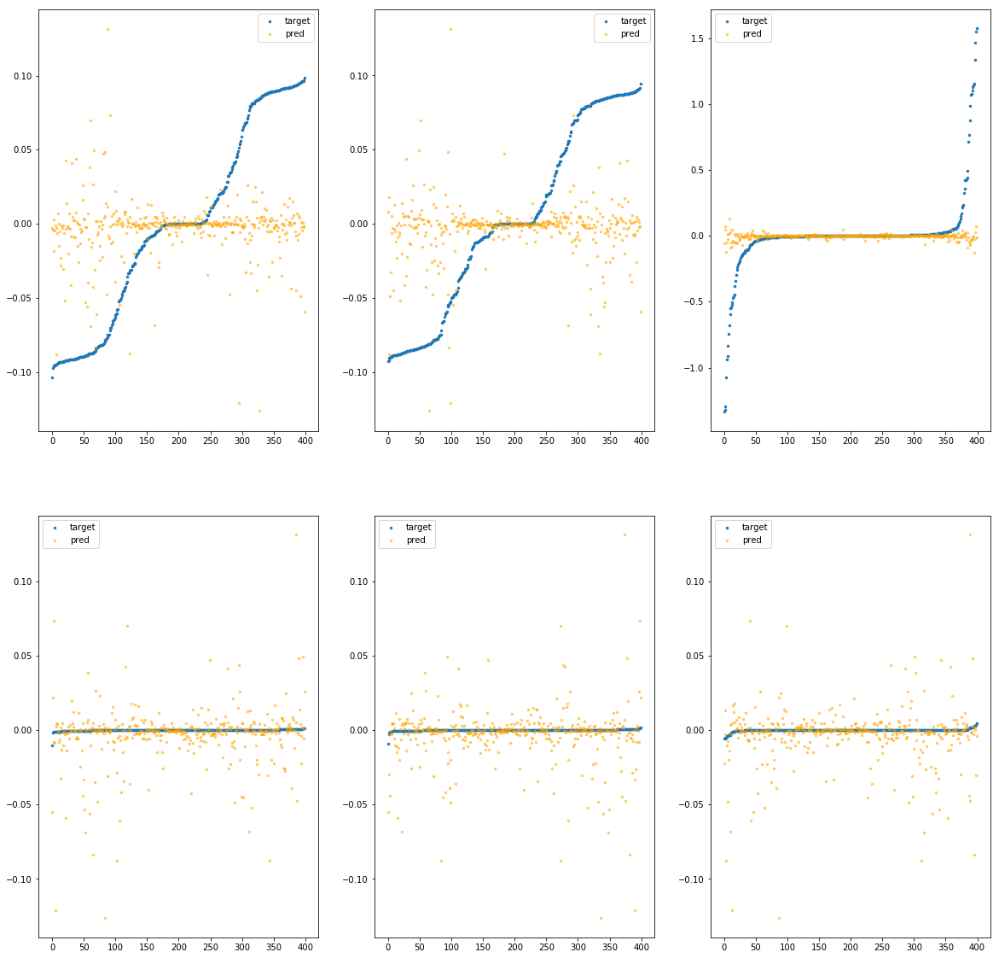

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d850>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.81e-01	2.61e-01	5.60e-02	5.77e+03	5.25e-03	2.75e-05
y		-3.21e-01	2.56e-01	5.57e-02	3.64e+02	5.06e-03	2.57e-05
z		-3.76e-02	1.69e+00	1.06e-01	3.01e+02	8.65e-02	7.47e-03
phi		-3.05e+03	2.30e-01	1.59e-02	8.31e+05	1.11e-03	1.22e-06
theta		-3.57e+03	2.30e-01	1.59e-02	3.70e+05	1.10e-03	1.22e-06
psi		-1.46e+03	2.26e-01	1.59e-02	8.28e+05	1.10e-03	1.21e-06


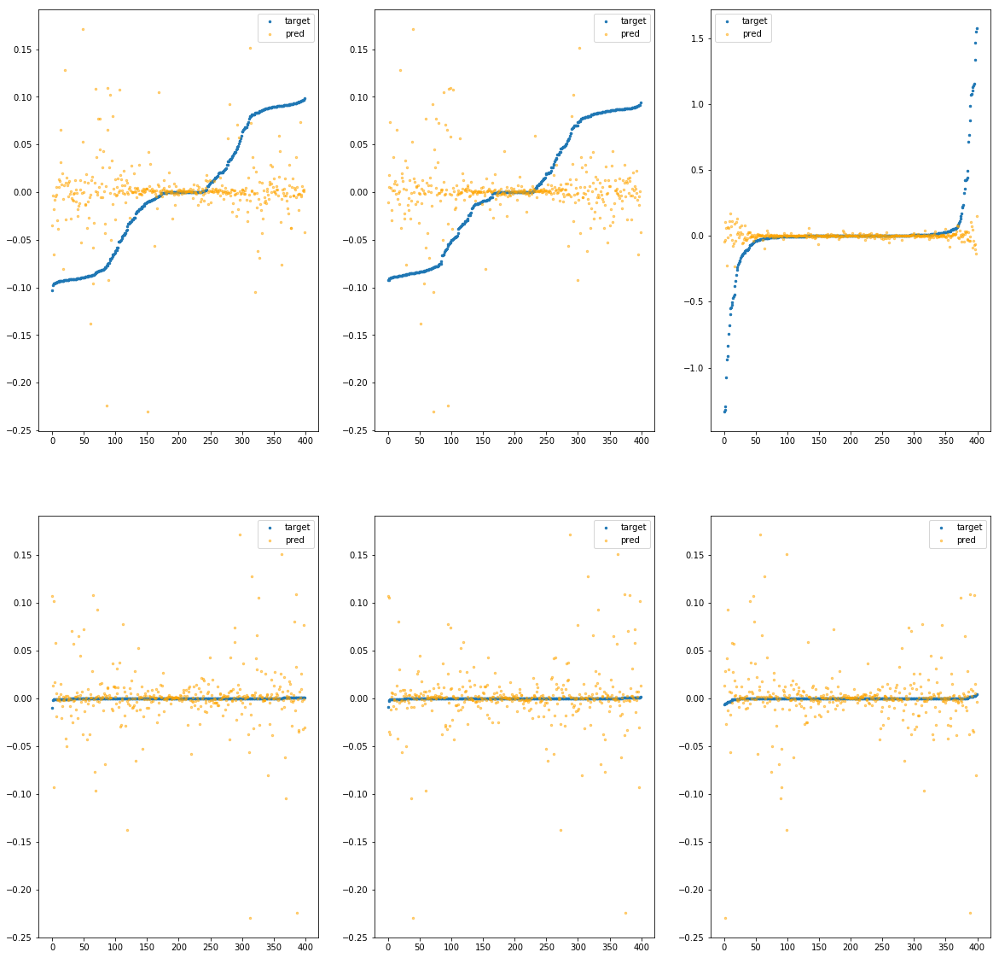

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d8b0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.03e-01	2.90e-01	5.71e-02	5.01e+03	5.74e-03	3.30e-05
y		-5.46e-01	2.83e-01	5.78e-02	2.20e+02	5.93e-03	3.51e-05
z		-3.74e-03	1.66e+00	1.08e-01	2.90e+02	8.36e-02	6.99e-03
phi		-4.91e+03	2.20e-01	2.20e-02	1.49e+06	1.78e-03	3.16e-06
theta		-5.75e+03	2.20e-01	2.20e-02	3.04e+05	1.78e-03	3.15e-06
psi		-2.37e+03	2.20e-01	2.19e-02	1.65e+06	1.77e-03	3.15e-06


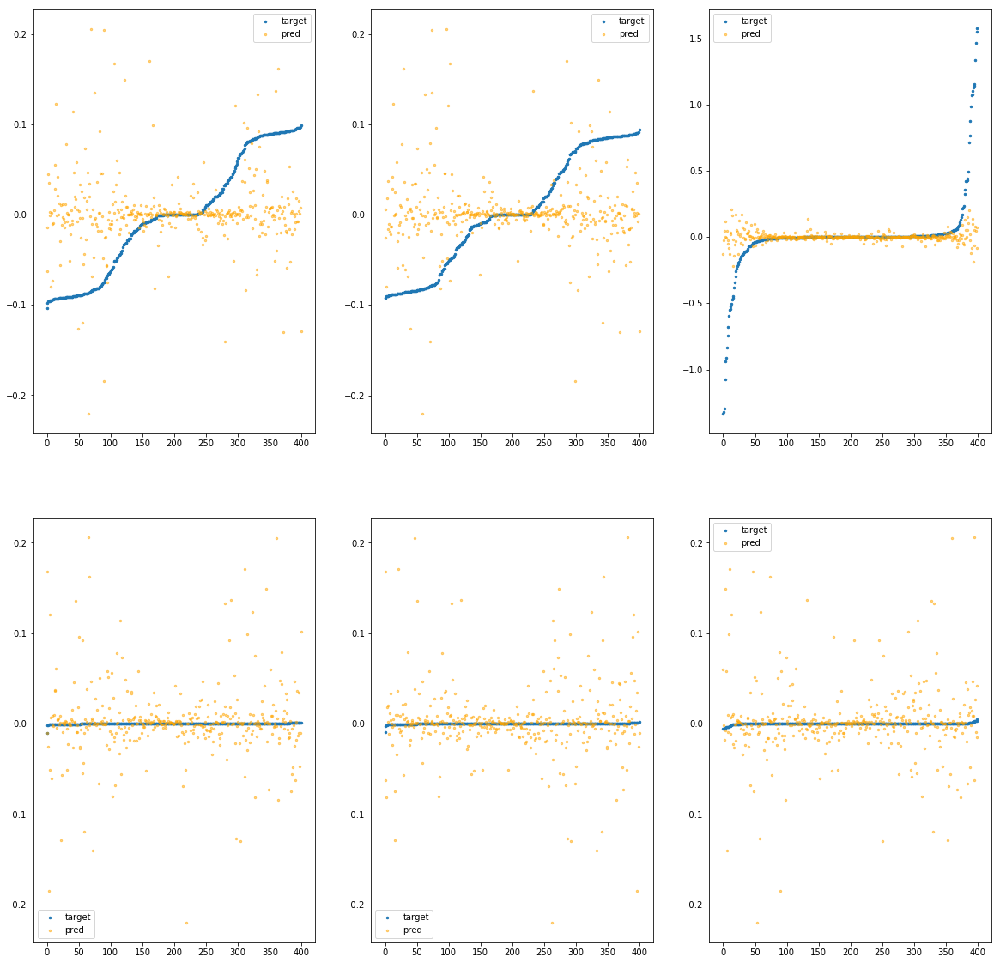

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d910>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.69e-01	3.79e-01	5.63e-02	1.09e+04	6.01e-03	3.62e-05
y		-5.69e-01	3.74e-01	5.73e-02	3.94e+02	6.02e-03	3.62e-05
z		-2.46e-02	1.52e+00	1.10e-01	4.65e+02	8.54e-02	7.29e-03
phi		-6.21e+03	2.84e-01	2.59e-02	2.56e+06	2.25e-03	5.06e-06
theta		-7.27e+03	2.84e-01	2.59e-02	6.23e+05	2.25e-03	5.04e-06
psi		-2.99e+03	2.84e-01	2.59e-02	1.28e+06	2.24e-03	5.02e-06


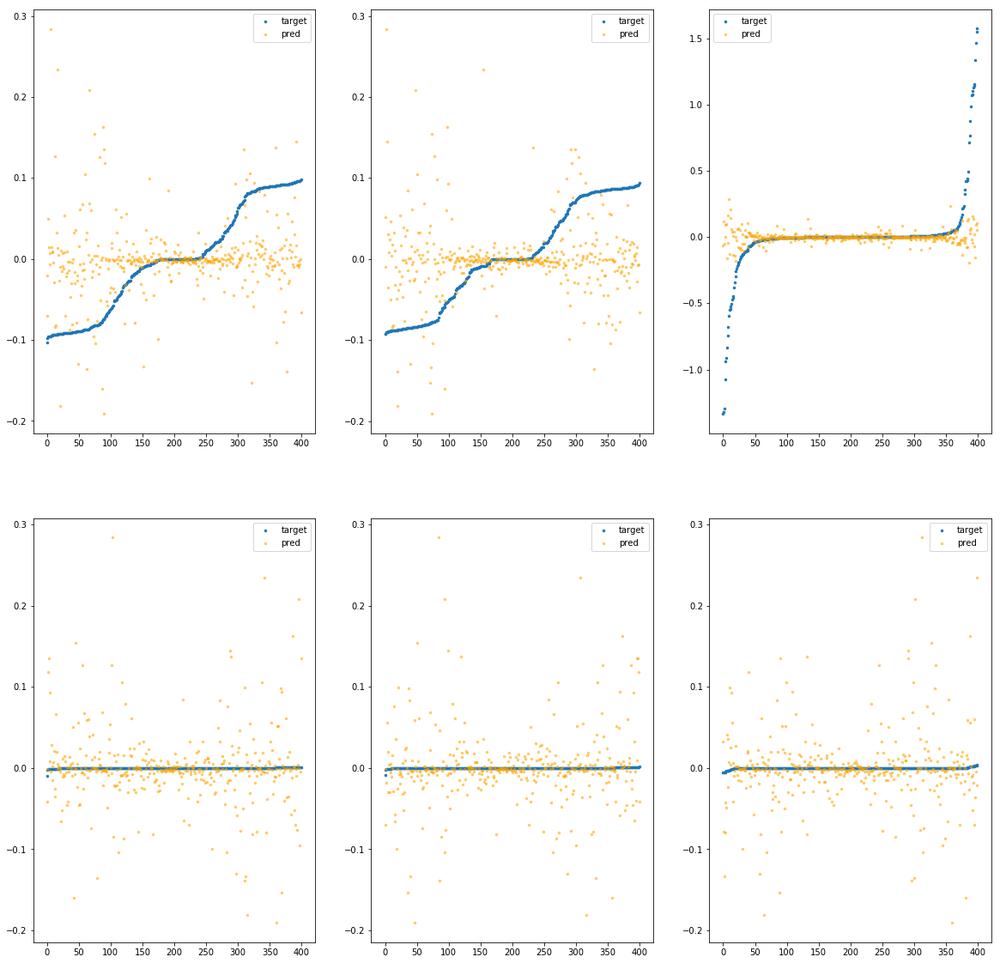

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d970>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.17e-03	1.07e-01	5.19e-02	7.16e+03	4.10e-03	1.68e-05
y		-7.25e-03	9.92e-02	5.14e-02	2.89e+02	3.86e-03	1.49e-05
z		-2.72e-04	1.58e+00	1.02e-01	1.55e+02	8.33e-02	6.95e-03
phi		-2.23e+01	1.27e-02	2.13e-03	1.34e+06	8.42e-06	7.09e-11
theta		-2.72e+01	1.31e-02	2.17e-03	2.69e+05	8.70e-06	7.57e-11
psi		-1.15e+01	1.32e-02	2.26e-03	1.65e+05	9.38e-06	8.80e-11


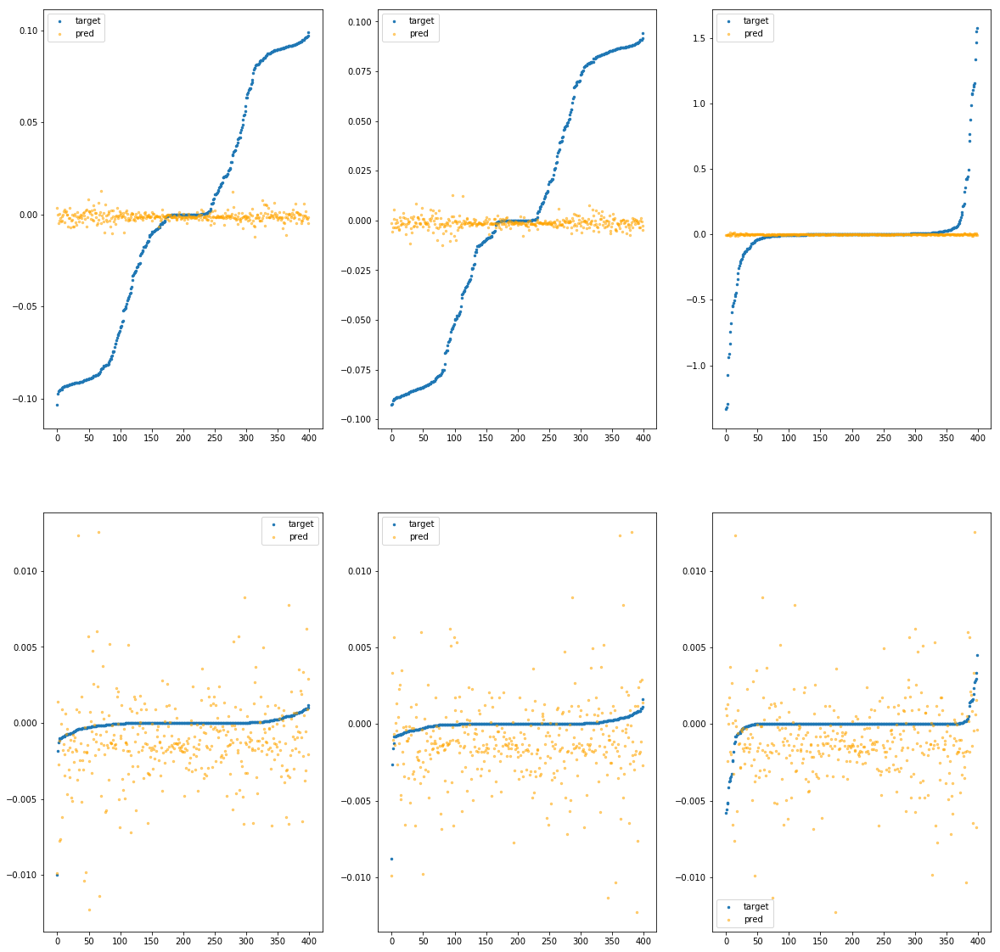

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9d9d0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.62e-02	1.73e-01	5.28e-02	3.21e+03	4.37e-03	1.91e-05
y		-3.15e-02	1.60e-01	5.13e-02	1.65e+02	3.96e-03	1.56e-05
z		-3.31e-02	1.61e+00	1.03e-01	8.26e+01	8.61e-02	7.41e-03
phi		-4.74e+02	8.02e-02	6.50e-03	5.10e+05	1.72e-04	2.96e-08
theta		-5.51e+02	7.92e-02	6.46e-03	1.16e+05	1.70e-04	2.91e-08
psi		-2.28e+02	8.19e-02	6.48e-03	2.27e+05	1.72e-04	2.96e-08


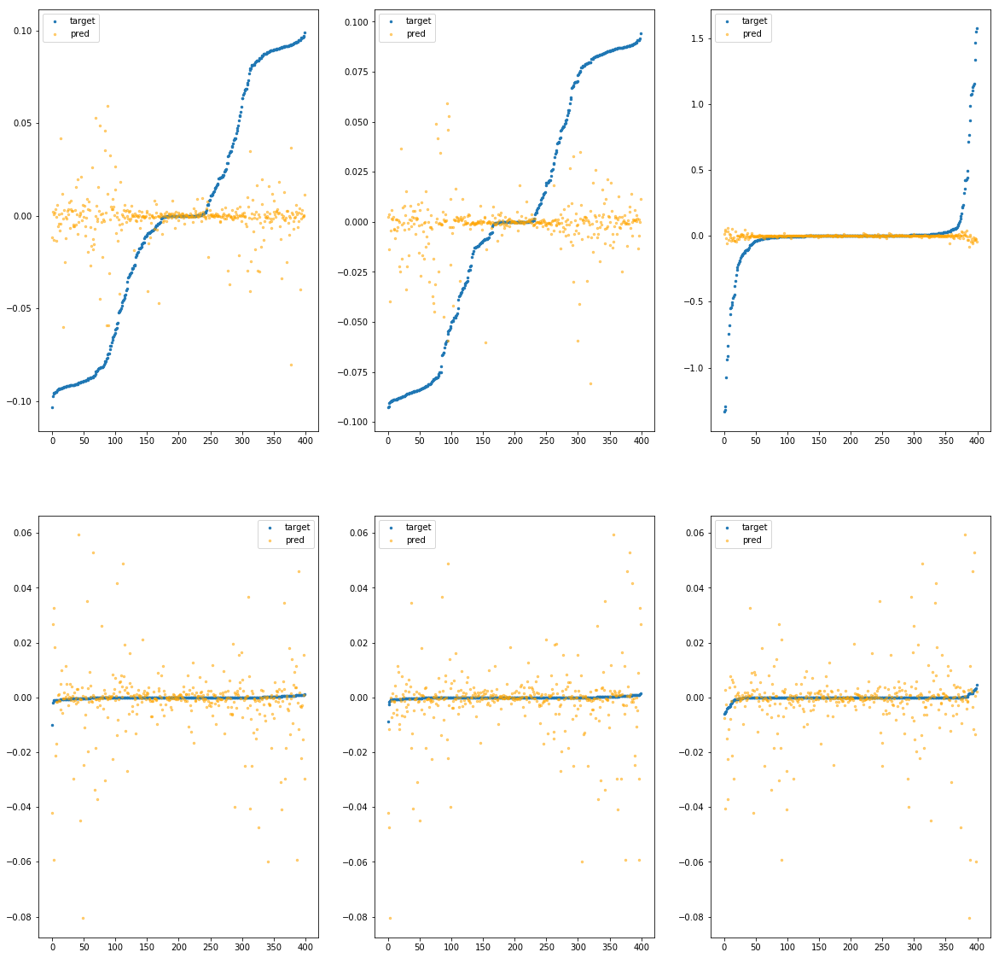

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9da30>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.29e-02	2.65e-01	5.13e-02	4.91e+03	4.39e-03	1.93e-05
y		-2.16e-01	2.61e-01	5.28e-02	2.93e+02	4.66e-03	2.18e-05
z		-4.09e-02	1.65e+00	1.04e-01	2.01e+02	8.67e-02	7.52e-03
phi		-2.07e+03	1.82e-01	1.28e-02	9.74e+05	7.49e-04	5.60e-07
theta		-2.42e+03	1.82e-01	1.28e-02	2.89e+05	7.48e-04	5.60e-07
psi		-9.99e+02	1.81e-01	1.27e-02	9.00e+05	7.50e-04	5.63e-07


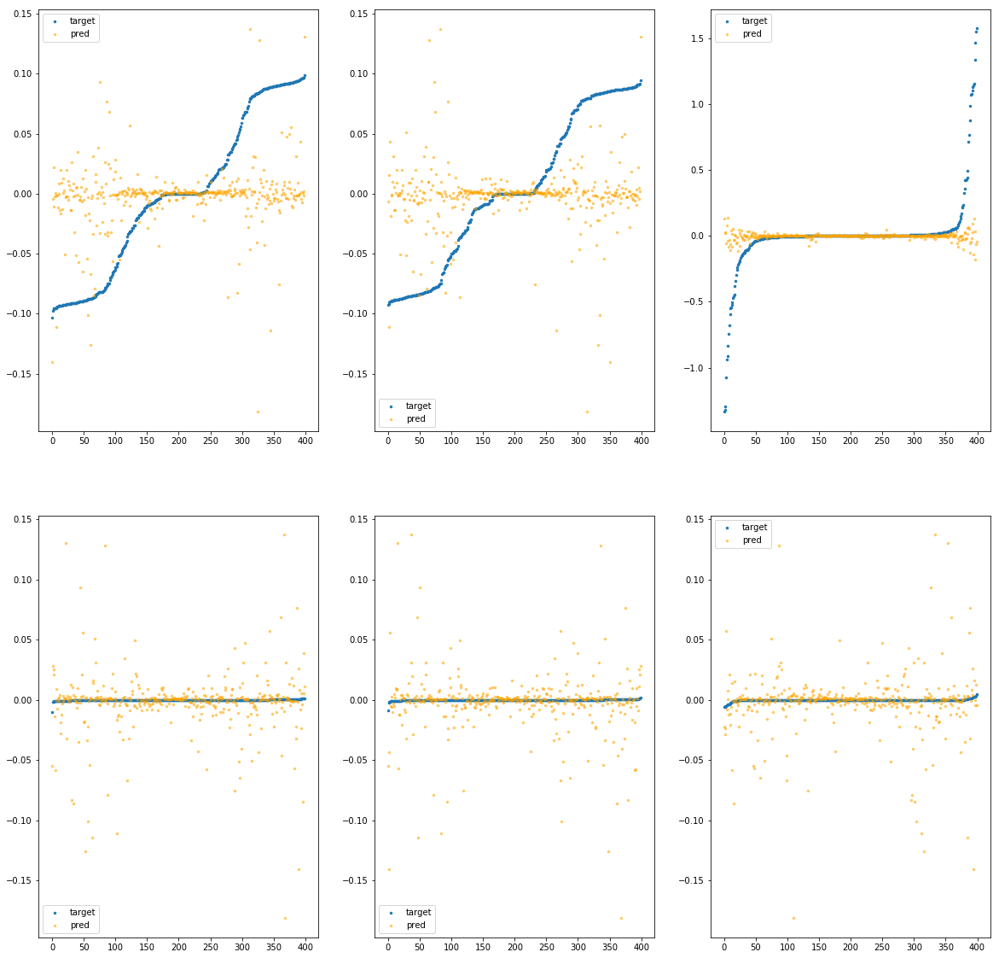

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9da90>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.33e-01	2.49e-01	5.51e-02	2.26e+03	5.05e-03	2.55e-05
y		-2.59e-01	2.42e-01	5.49e-02	2.15e+02	4.83e-03	2.33e-05
z		-3.62e-02	1.50e+00	1.07e-01	2.41e+02	8.63e-02	7.45e-03
phi		-2.22e+03	2.03e-01	1.24e-02	5.59e+05	8.05e-04	6.48e-07
theta		-2.59e+03	2.01e-01	1.24e-02	2.56e+05	8.01e-04	6.42e-07
psi		-1.06e+03	1.93e-01	1.24e-02	5.01e+05	7.97e-04	6.36e-07


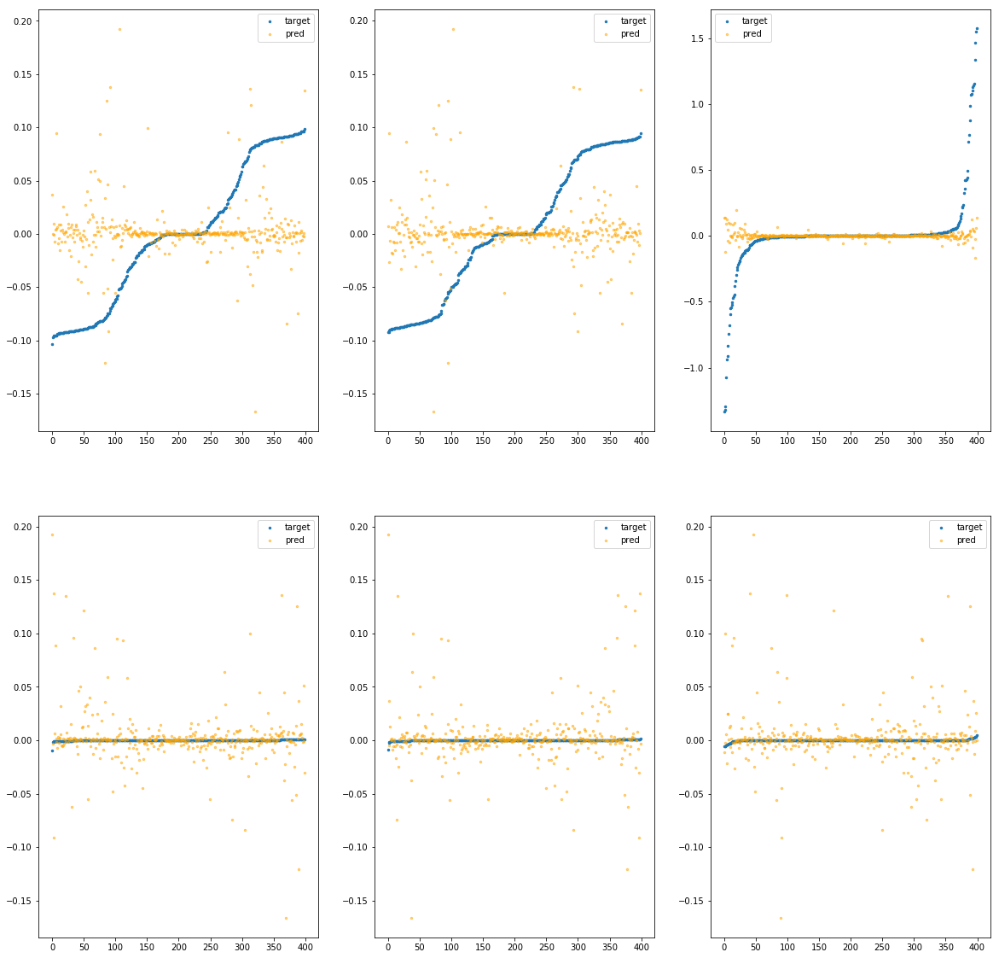

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb270c9daf0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.63e-01	2.71e-01	5.54e-02	5.00e+03	5.17e-03	2.67e-05
y		-2.39e-01	2.67e-01	5.30e-02	1.98e+02	4.75e-03	2.26e-05
z		-4.73e-02	1.64e+00	1.07e-01	2.13e+02	8.73e-02	7.61e-03
phi		-3.86e+03	3.46e-01	1.65e-02	9.80e+05	1.40e-03	1.96e-06
theta		-4.51e+03	3.45e-01	1.65e-02	2.08e+05	1.39e-03	1.94e-06
psi		-1.85e+03	3.45e-01	1.65e-02	7.92e+05	1.39e-03	1.93e-06


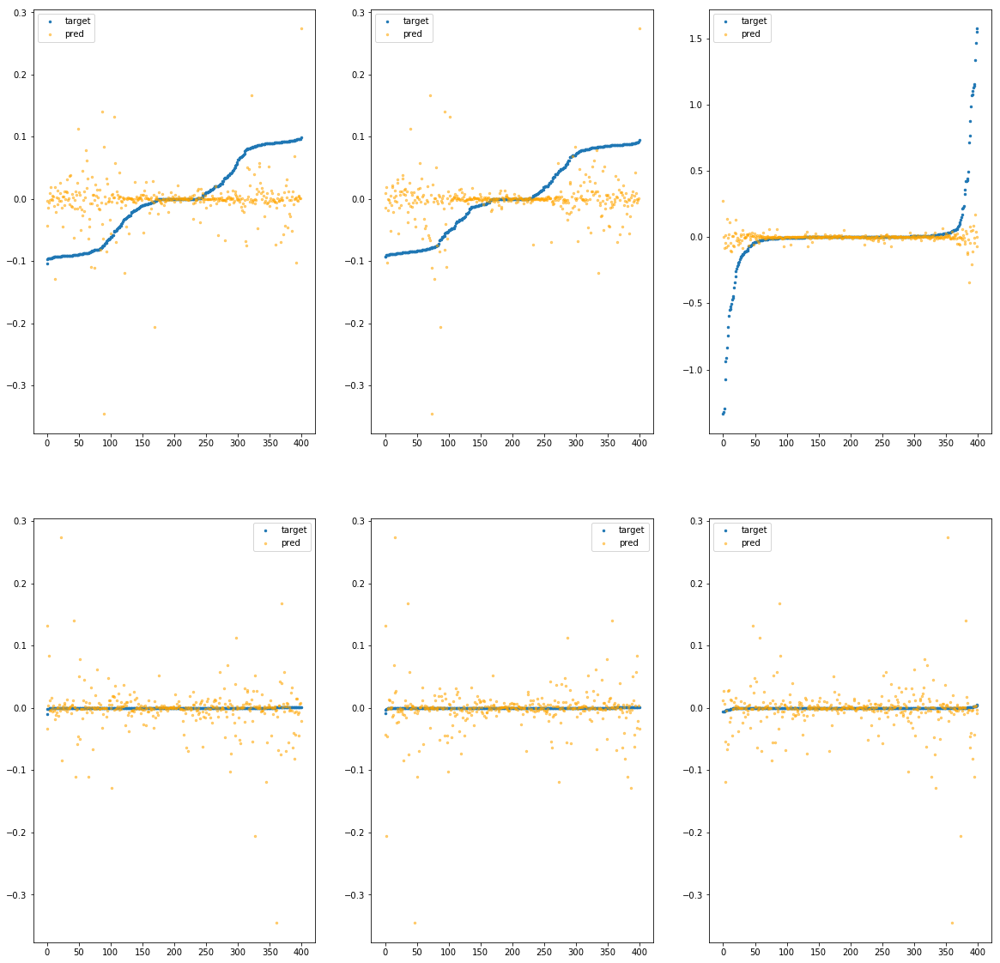

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9db50>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.61e+01	1.79e+00	2.62e-01	1.52e+05	1.52e-01	2.31e-02
y		-3.89e+01	1.94e+00	2.65e-01	1.78e+04	1.53e-01	2.34e-02
z		-1.89e+00	2.78e+00	2.95e-01	9.28e+03	2.41e-01	5.79e-02
phi		-4.17e+05	1.87e+00	2.59e-01	4.49e+07	1.51e-01	2.28e-02
theta		-4.88e+05	1.87e+00	2.59e-01	1.38e+07	1.51e-01	2.27e-02
psi		-2.01e+05	1.87e+00	2.59e-01	2.22e+07	1.51e-01	2.28e-02


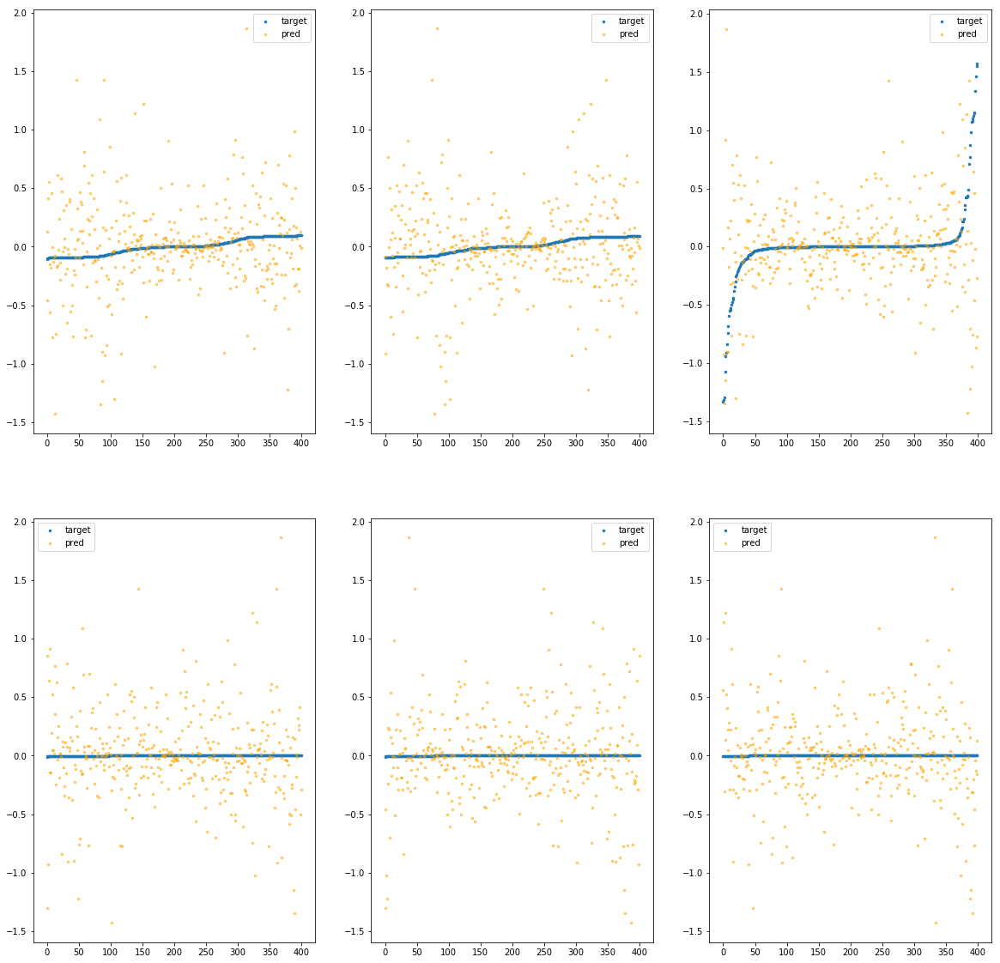

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9dbb0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.37e+01	2.41e+00	3.49e-01	1.75e+05	2.65e-01	7.01e-02
y		-7.08e+01	2.58e+00	3.54e-01	2.62e+04	2.75e-01	7.57e-02
z		-3.39e+00	3.48e+00	3.83e-01	1.39e+04	3.66e-01	1.34e-01
phi		-7.26e+05	2.49e+00	3.45e-01	3.96e+07	2.63e-01	6.92e-02
theta		-8.51e+05	2.49e+00	3.45e-01	2.93e+07	2.63e-01	6.91e-02
psi		-3.51e+05	2.49e+00	3.45e-01	3.80e+07	2.63e-01	6.92e-02


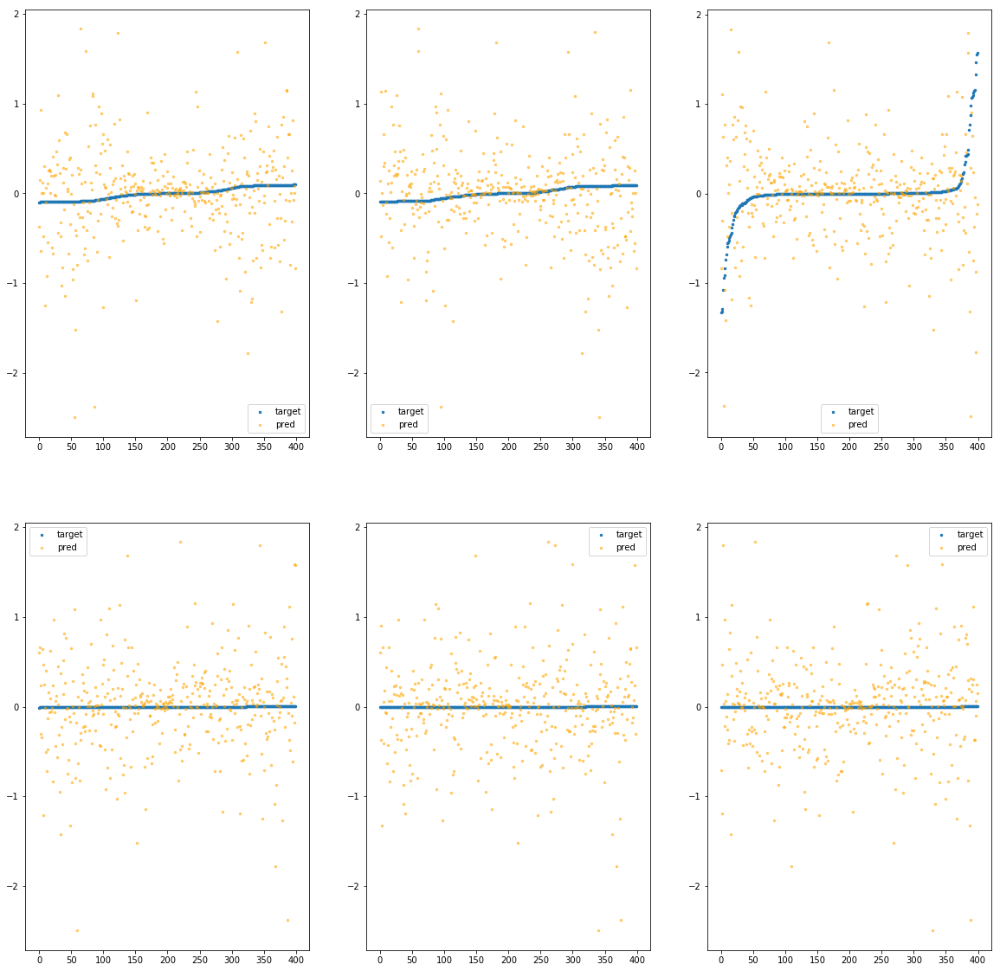

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9dc10>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.27e+01	3.19e+00	4.10e-01	4.05e+05	3.84e-01	1.47e-01
y		-9.84e+01	3.30e+00	4.07e-01	1.55e+04	3.81e-01	1.45e-01
z		-4.07e+00	3.61e+00	4.17e-01	1.43e+04	4.23e-01	1.79e-01
phi		-1.05e+06	3.23e+00	4.10e-01	9.19e+07	3.80e-01	1.44e-01
theta		-1.23e+06	3.22e+00	4.10e-01	1.66e+07	3.80e-01	1.44e-01
psi		-5.06e+05	3.23e+00	4.10e-01	4.27e+07	3.80e-01	1.44e-01


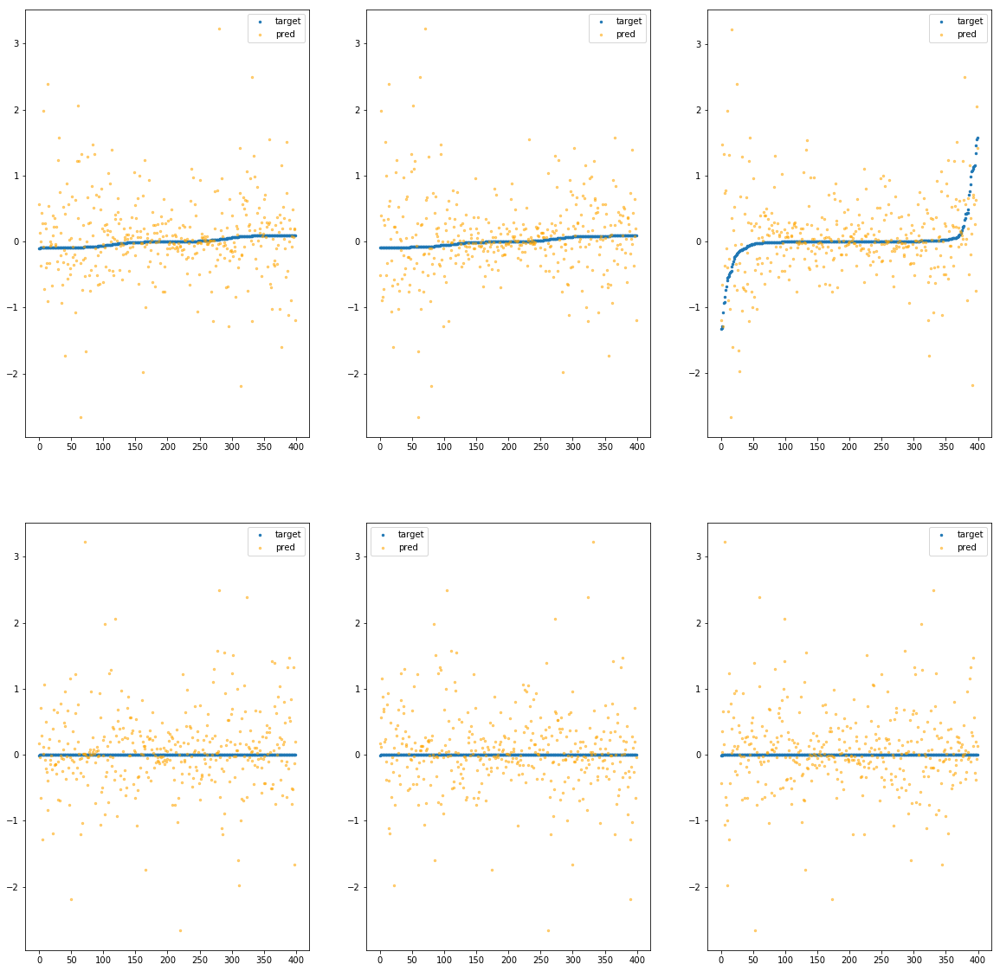

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9dc70>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.77e+01	1.41e+00	2.90e-01	2.50e+05	1.58e-01	2.51e-02
y		-3.98e+01	1.40e+00	2.92e-01	1.74e+04	1.57e-01	2.45e-02
z		-2.06e+00	2.63e+00	3.33e-01	8.51e+03	2.55e-01	6.51e-02
phi		-4.26e+05	1.36e+00	2.89e-01	7.10e+07	1.54e-01	2.38e-02
theta		-4.99e+05	1.36e+00	2.89e-01	2.25e+07	1.54e-01	2.38e-02
psi		-2.05e+05	1.35e+00	2.89e-01	2.55e+07	1.54e-01	2.37e-02


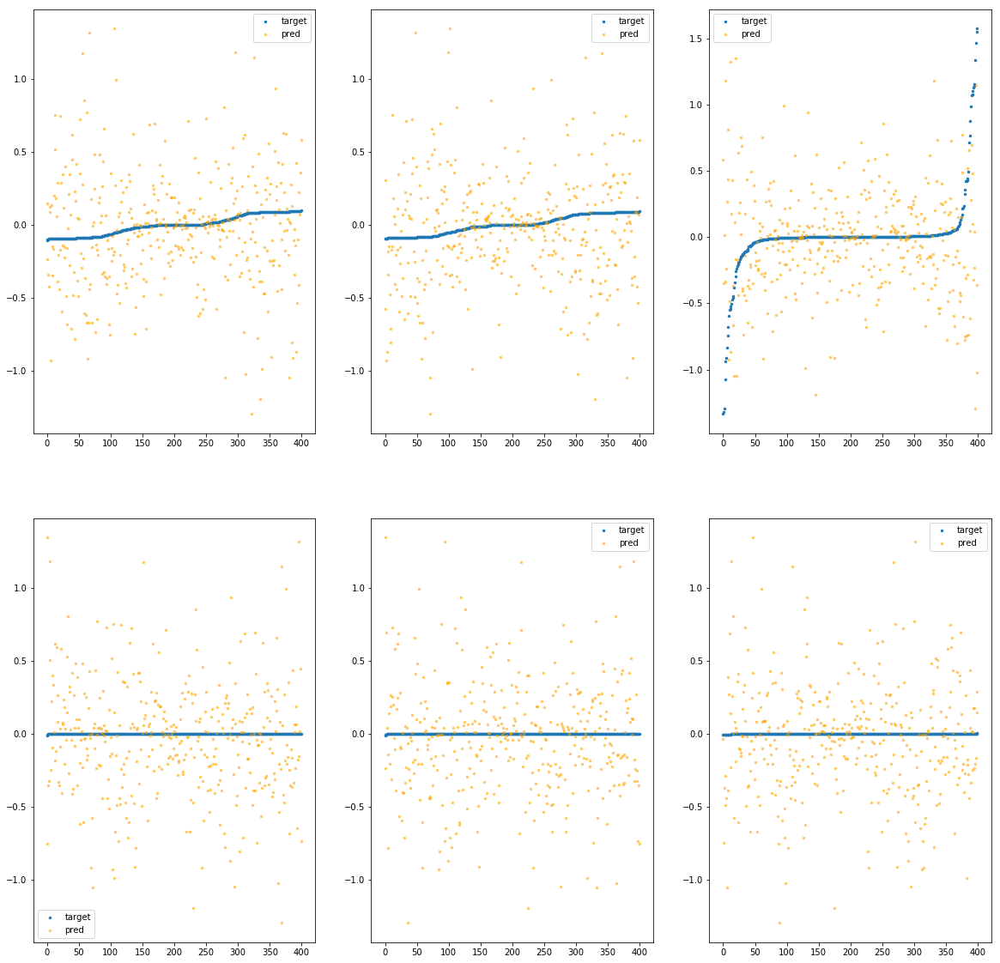

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9dcd0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.21e+01	2.20e+00	3.23e-01	1.65e+05	2.17e-01	4.72e-02
y		-5.55e+01	2.21e+00	3.22e-01	1.79e+04	2.17e-01	4.70e-02
z		-2.69e+00	2.57e+00	3.57e-01	1.60e+04	3.08e-01	9.48e-02
phi		-5.82e+05	2.13e+00	3.17e-01	4.19e+07	2.11e-01	4.44e-02
theta		-6.82e+05	2.13e+00	3.17e-01	1.39e+07	2.11e-01	4.44e-02
psi		-2.81e+05	2.13e+00	3.17e-01	2.78e+07	2.11e-01	4.44e-02


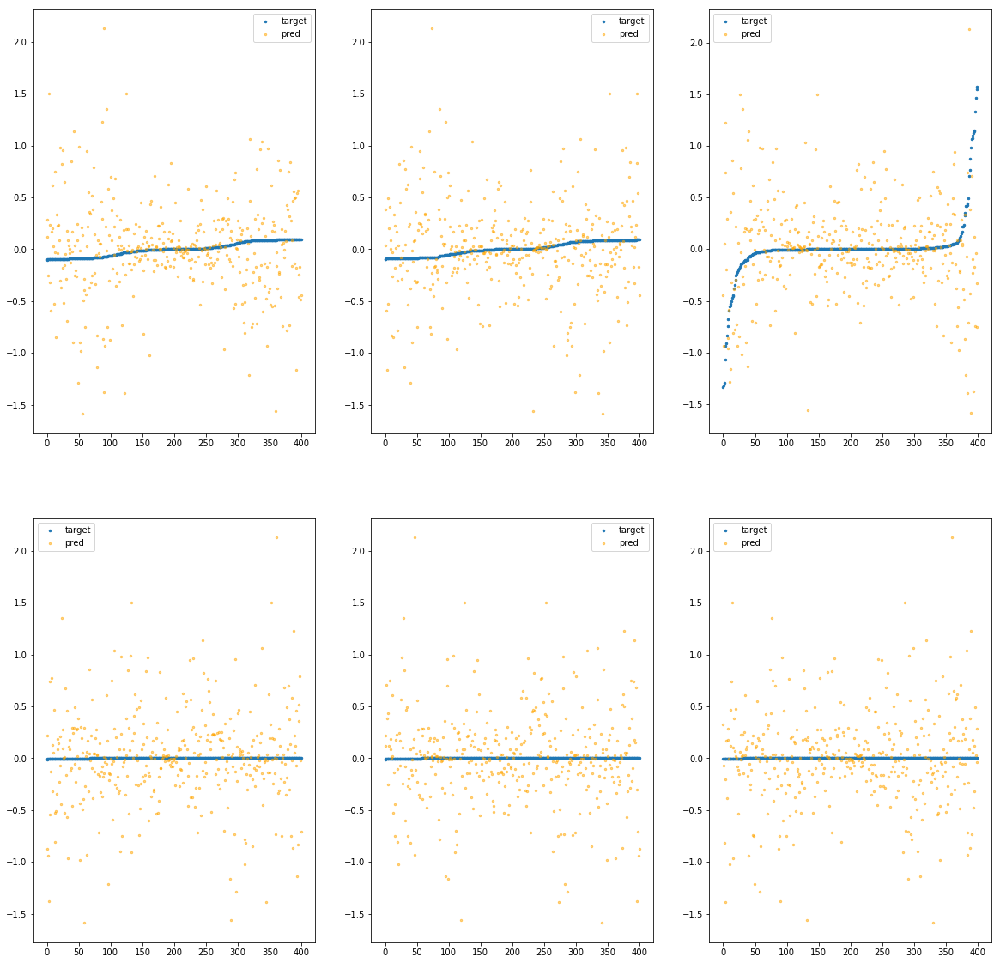

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9dd30>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.61e+01	1.94e+00	3.37e-01	4.40e+05	2.34e-01	5.46e-02
y		-6.05e+01	1.85e+00	3.39e-01	2.15e+04	2.36e-01	5.56e-02
z		-2.71e+00	2.47e+00	3.59e-01	1.26e+04	3.09e-01	9.55e-02
phi		-6.38e+05	1.85e+00	3.34e-01	4.13e+07	2.31e-01	5.34e-02
theta		-7.48e+05	1.85e+00	3.34e-01	1.92e+07	2.31e-01	5.34e-02
psi		-3.08e+05	1.85e+00	3.35e-01	2.75e+07	2.31e-01	5.35e-02


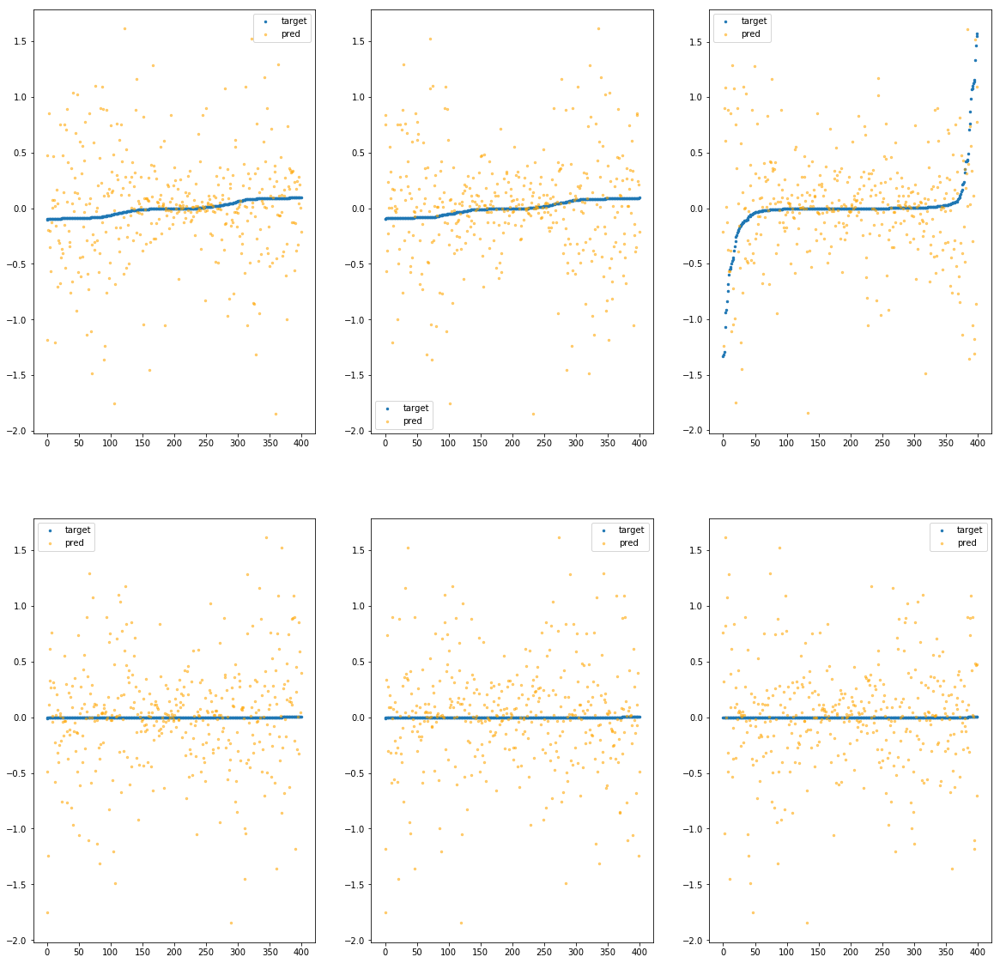

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9dd90>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.37e+01	1.42e+00	2.24e-01	2.36e+05	1.01e-01	1.02e-02
y		-2.57e+01	1.42e+00	2.20e-01	5.59e+03	1.02e-01	1.05e-02
z		-1.10e+00	1.85e+00	2.62e-01	6.56e+03	1.75e-01	3.07e-02
phi		-2.68e+05	1.35e+00	2.16e-01	4.86e+07	9.69e-02	9.38e-03
theta		-3.14e+05	1.35e+00	2.16e-01	5.25e+06	9.69e-02	9.38e-03
psi		-1.29e+05	1.35e+00	2.16e-01	3.12e+07	9.69e-02	9.39e-03


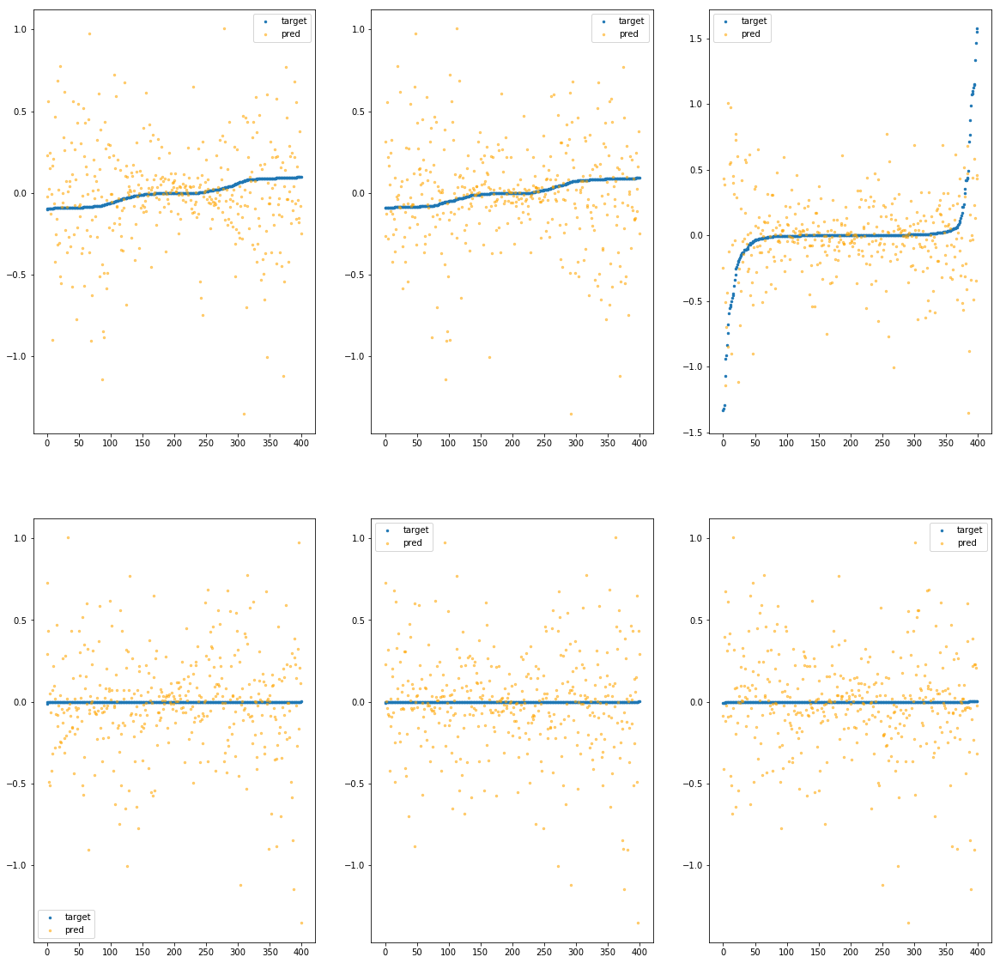

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9ddf0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.19e+01	1.95e+00	3.45e-01	2.84e+05	2.57e-01	6.62e-02
y		-6.86e+01	2.10e+00	3.49e-01	1.29e+04	2.67e-01	7.11e-02
z		-3.63e+00	3.06e+00	3.94e-01	1.18e+04	3.86e-01	1.49e-01
phi		-7.20e+05	2.01e+00	3.44e-01	4.55e+07	2.61e-01	6.80e-02
theta		-8.44e+05	2.01e+00	3.44e-01	1.57e+07	2.61e-01	6.80e-02
psi		-3.48e+05	2.01e+00	3.44e-01	2.48e+07	2.61e-01	6.80e-02


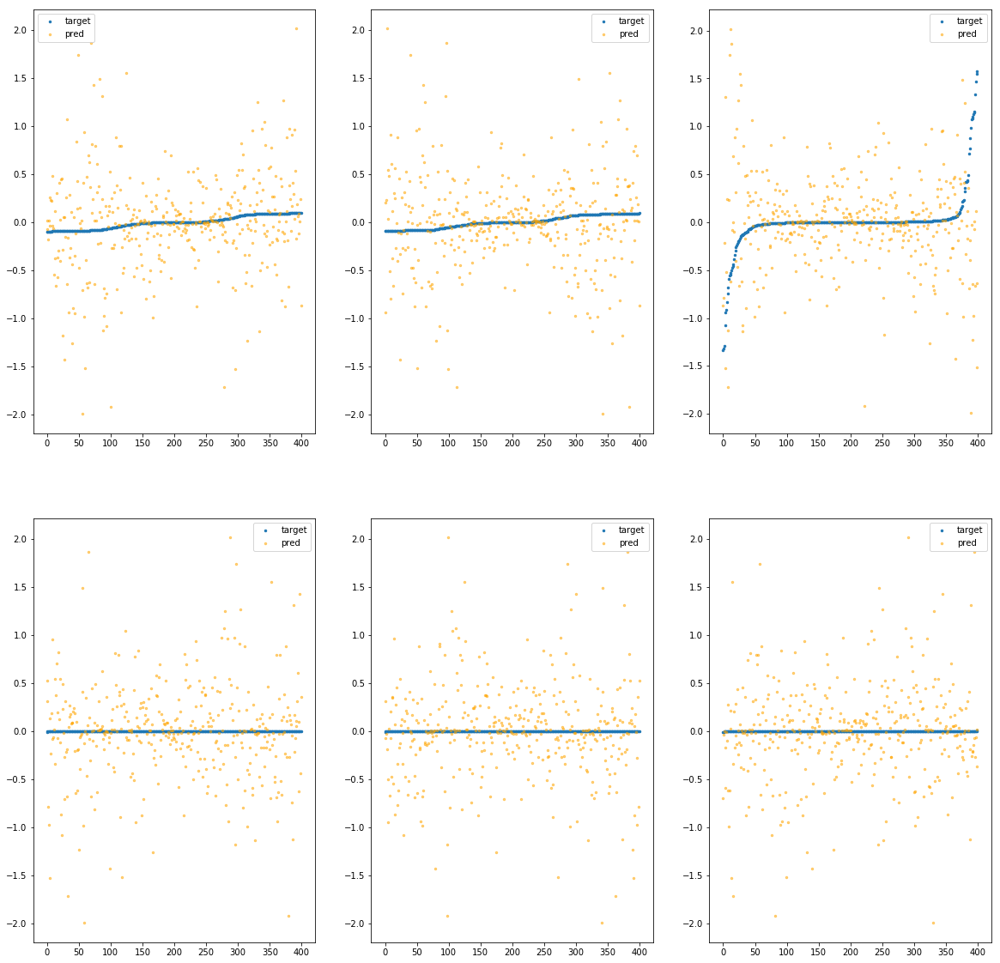

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9de50>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.77e+01	2.44e+00	3.81e-01	2.69e+05	3.22e-01	1.04e-01
y		-8.34e+01	2.45e+00	3.80e-01	1.78e+04	3.24e-01	1.05e-01
z		-3.91e+00	3.39e+00	4.10e-01	1.09e+04	4.09e-01	1.67e-01
phi		-8.78e+05	2.54e+00	3.78e-01	5.62e+07	3.18e-01	1.01e-01
theta		-1.03e+06	2.54e+00	3.78e-01	1.65e+07	3.18e-01	1.01e-01
psi		-4.24e+05	2.54e+00	3.78e-01	2.70e+07	3.18e-01	1.01e-01


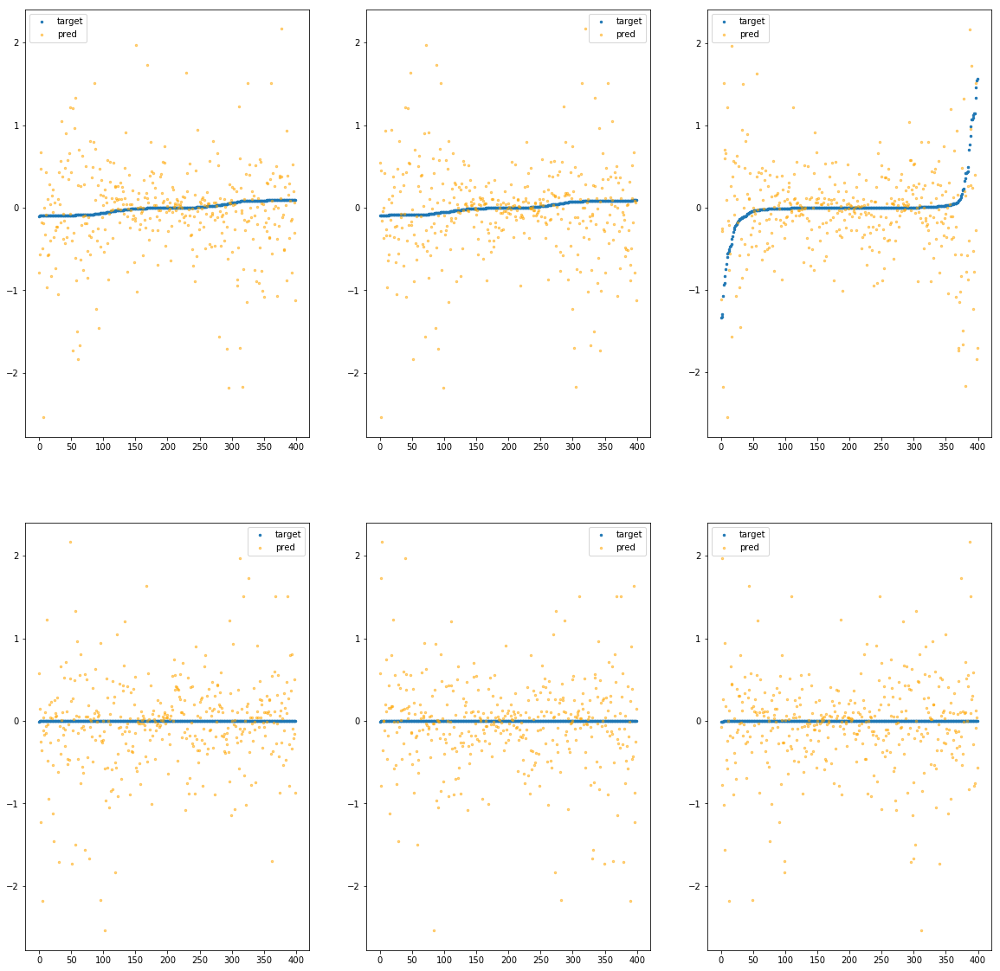

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9deb0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.70e+01	1.79e+00	3.20e-01	2.86e+05	1.96e-01	3.86e-02
y		-5.09e+01	1.90e+00	3.19e-01	7.10e+03	1.99e-01	3.97e-02
z		-2.33e+00	2.92e+00	3.47e-01	9.74e+03	2.78e-01	7.70e-02
phi		-5.34e+05	1.85e+00	3.14e-01	4.52e+07	1.93e-01	3.74e-02
theta		-6.26e+05	1.84e+00	3.14e-01	1.31e+07	1.93e-01	3.74e-02
psi		-2.58e+05	1.85e+00	3.14e-01	3.51e+07	1.93e-01	3.74e-02


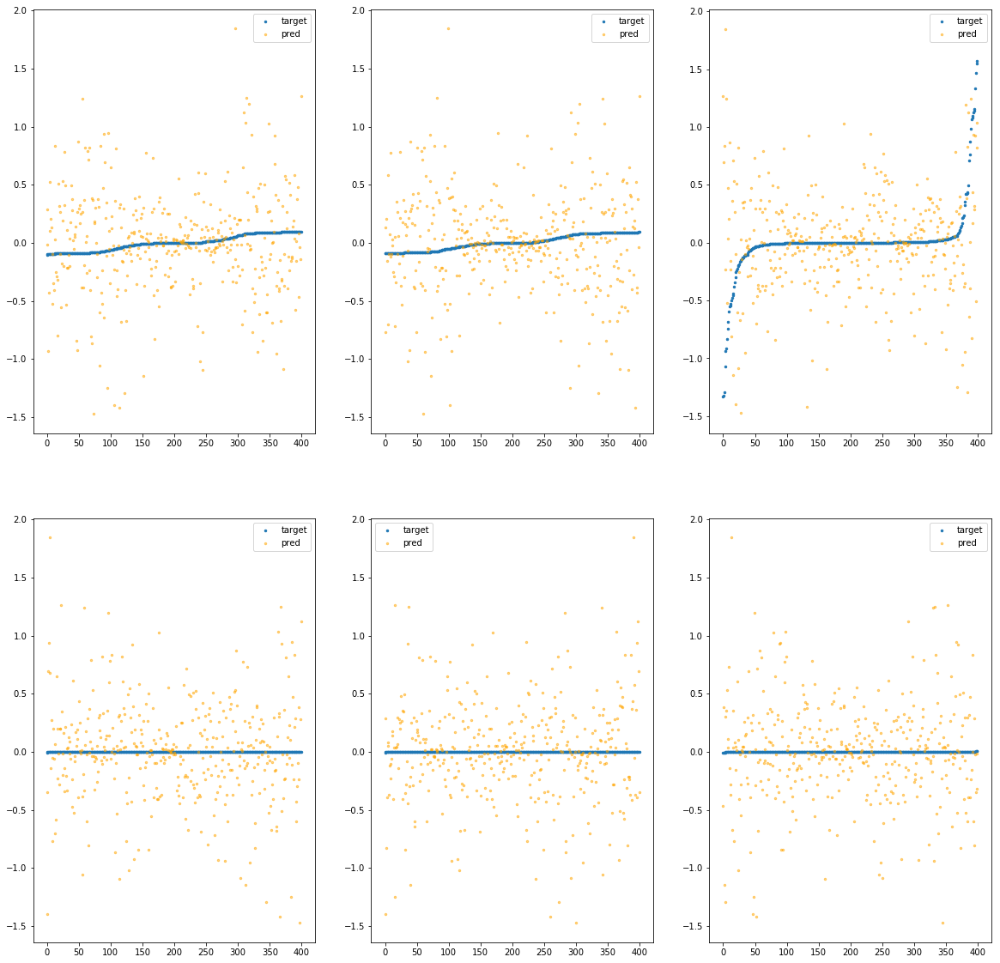

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9df10>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.14e+01	1.68e+00	2.83e-01	2.25e+05	1.74e-01	3.02e-02
y		-4.39e+01	1.65e+00	2.80e-01	1.60e+04	1.72e-01	2.97e-02
z		-1.62e+00	2.49e+00	2.98e-01	8.71e+03	2.18e-01	4.76e-02
phi		-4.63e+05	1.60e+00	2.73e-01	3.53e+07	1.68e-01	2.81e-02
theta		-5.43e+05	1.60e+00	2.73e-01	1.60e+07	1.68e-01	2.81e-02
psi		-2.24e+05	1.60e+00	2.73e-01	2.81e+07	1.68e-01	2.81e-02


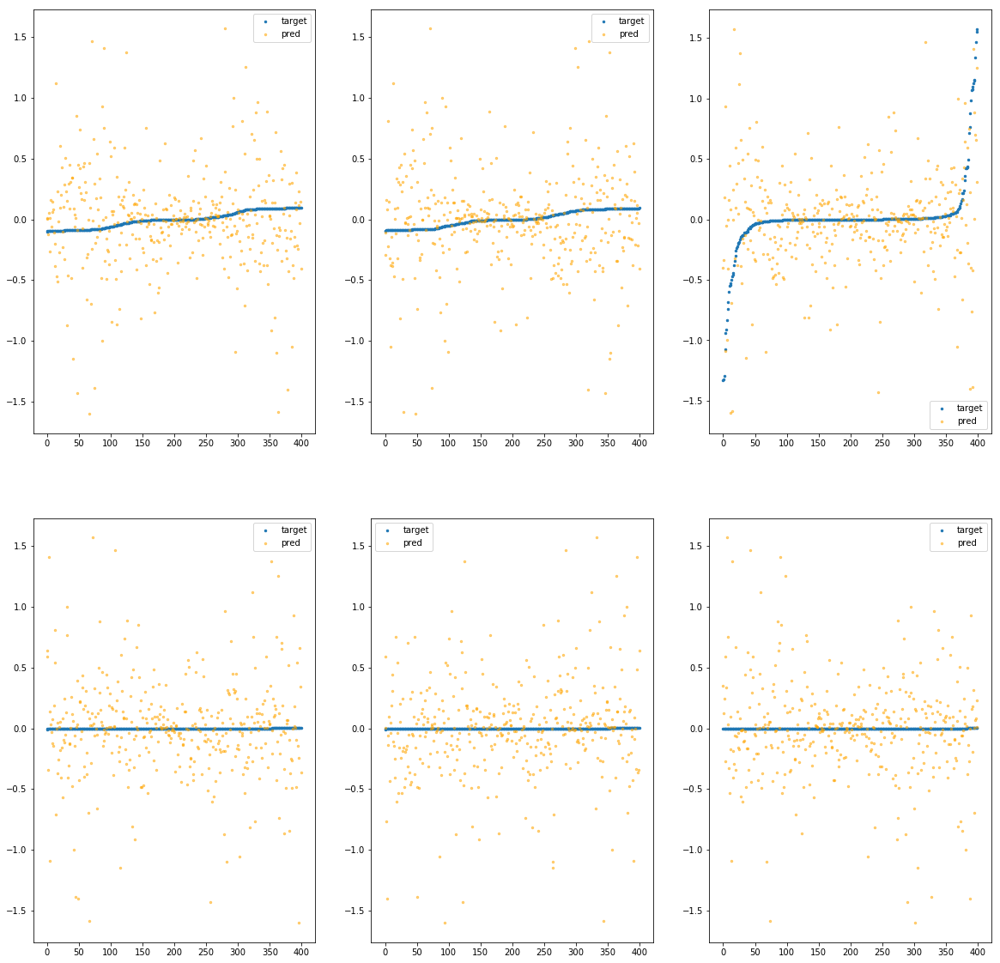

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9df70>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.36e+01	2.02e+00	2.53e-01	2.02e+05	1.42e-01	2.01e-02
y		-3.71e+01	2.03e+00	2.59e-01	8.67e+03	1.46e-01	2.13e-02
z		-2.39e+00	3.66e+00	3.07e-01	8.69e+03	2.83e-01	7.99e-02
phi		-3.87e+05	2.11e+00	2.50e-01	3.74e+07	1.40e-01	1.97e-02
theta		-4.54e+05	2.11e+00	2.50e-01	1.53e+07	1.40e-01	1.97e-02
psi		-1.87e+05	2.11e+00	2.50e-01	1.68e+07	1.40e-01	1.97e-02


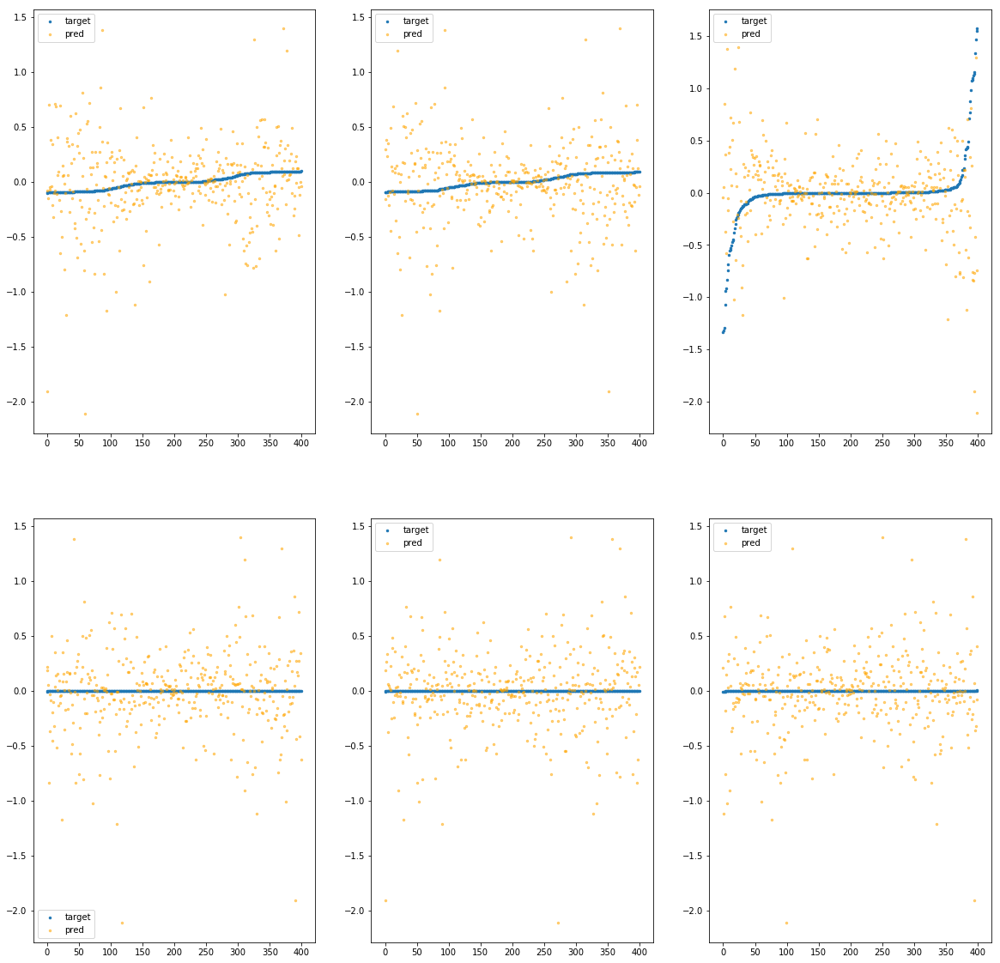

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb270c9dfd0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.36e+01	1.52e+00	2.59e-01	2.04e+05	1.42e-01	2.01e-02
y		-3.54e+01	1.42e+00	2.59e-01	8.78e+03	1.39e-01	1.94e-02
z		-1.49e+00	2.64e+00	2.81e-01	1.09e+04	2.07e-01	4.29e-02
phi		-3.66e+05	1.44e+00	2.51e-01	4.53e+07	1.33e-01	1.76e-02
theta		-4.29e+05	1.44e+00	2.51e-01	8.62e+06	1.33e-01	1.76e-02
psi		-1.77e+05	1.44e+00	2.51e-01	2.60e+07	1.33e-01	1.76e-02


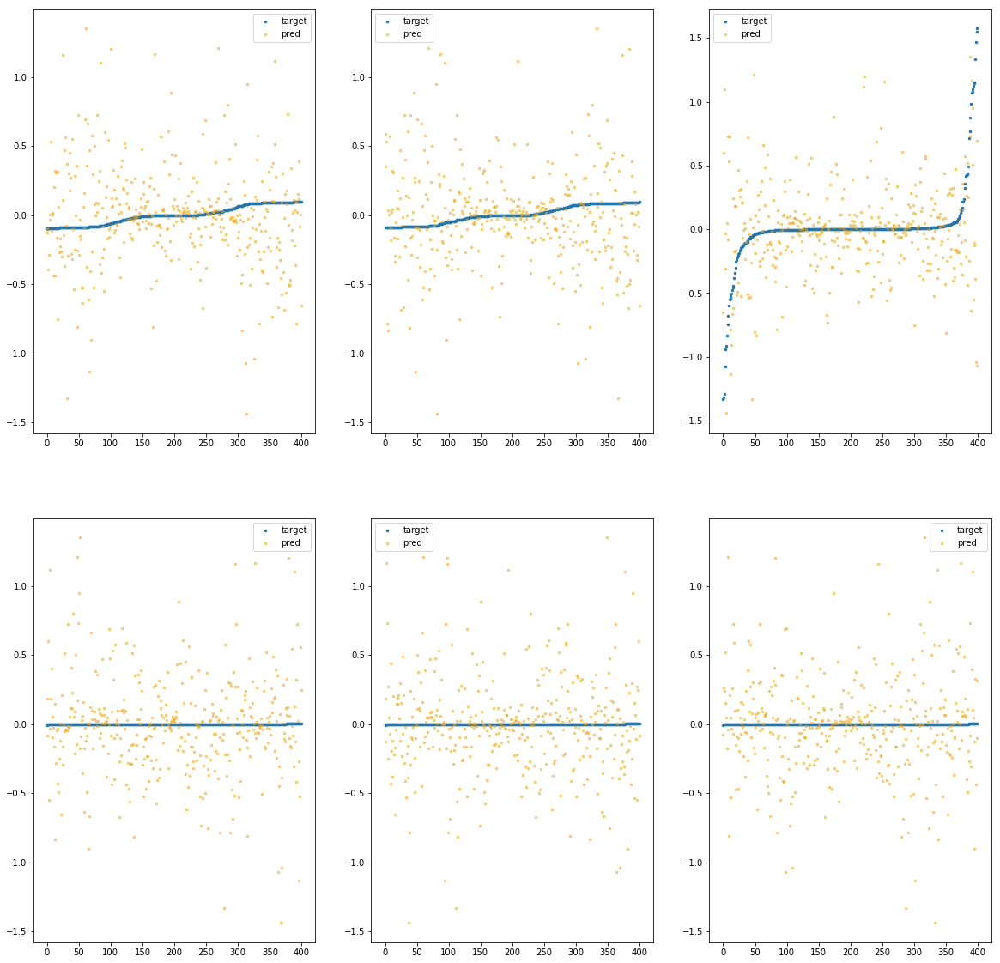

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f010a0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.70e+01	1.78e+00	2.25e-01	1.86e+05	1.14e-01	1.31e-02
y		-3.07e+01	1.79e+00	2.32e-01	8.23e+03	1.22e-01	1.48e-02
z		-1.48e+00	2.76e+00	2.69e-01	8.28e+03	2.06e-01	4.25e-02
phi		-3.19e+05	1.87e+00	2.22e-01	4.49e+07	1.16e-01	1.33e-02
theta		-3.74e+05	1.87e+00	2.22e-01	1.02e+07	1.16e-01	1.34e-02
psi		-1.54e+05	1.87e+00	2.22e-01	1.14e+07	1.15e-01	1.33e-02


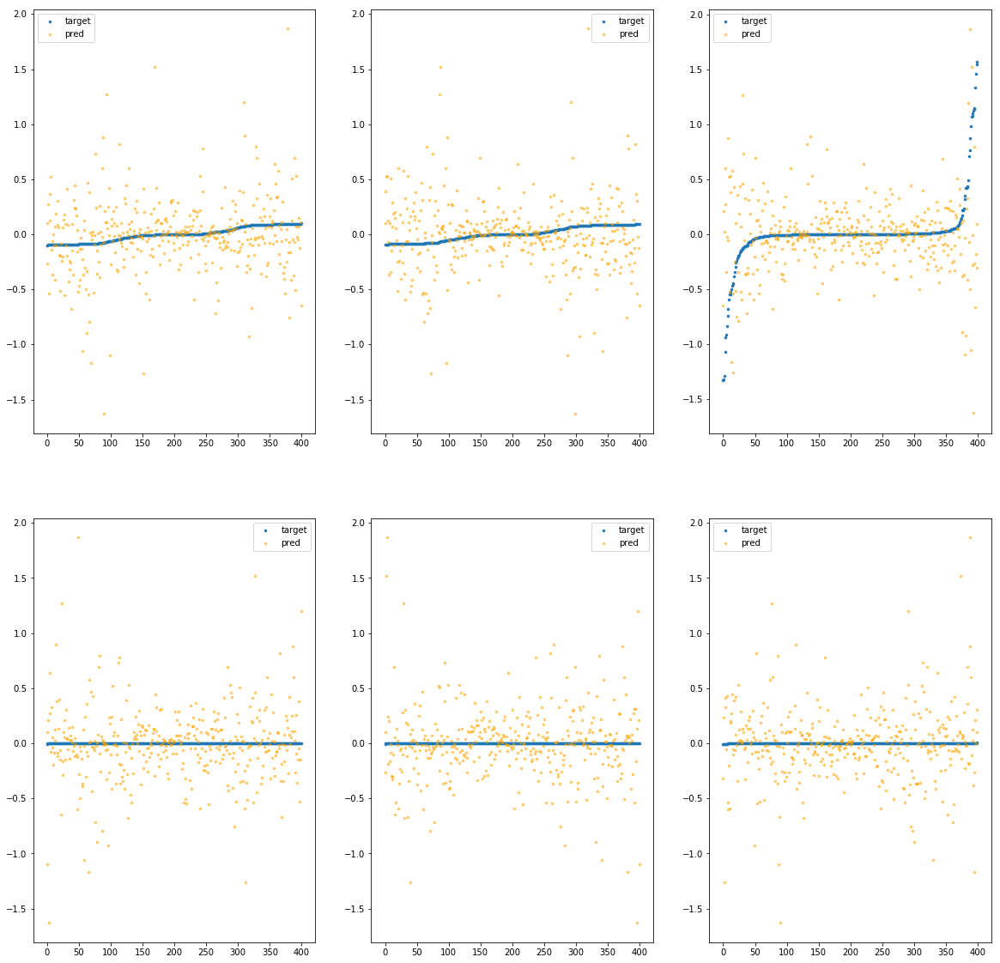

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f01100>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.87e+01	1.90e+00	3.14e-01	1.88e+05	2.03e-01	4.13e-02
y		-4.94e+01	1.72e+00	3.12e-01	1.46e+04	1.93e-01	3.73e-02
z		-2.16e+00	2.86e+00	3.43e-01	1.29e+04	2.63e-01	6.92e-02
phi		-5.33e+05	1.81e+00	3.06e-01	3.35e+07	1.93e-01	3.72e-02
theta		-6.24e+05	1.81e+00	3.06e-01	1.15e+07	1.93e-01	3.72e-02
psi		-2.57e+05	1.81e+00	3.06e-01	4.01e+07	1.93e-01	3.72e-02


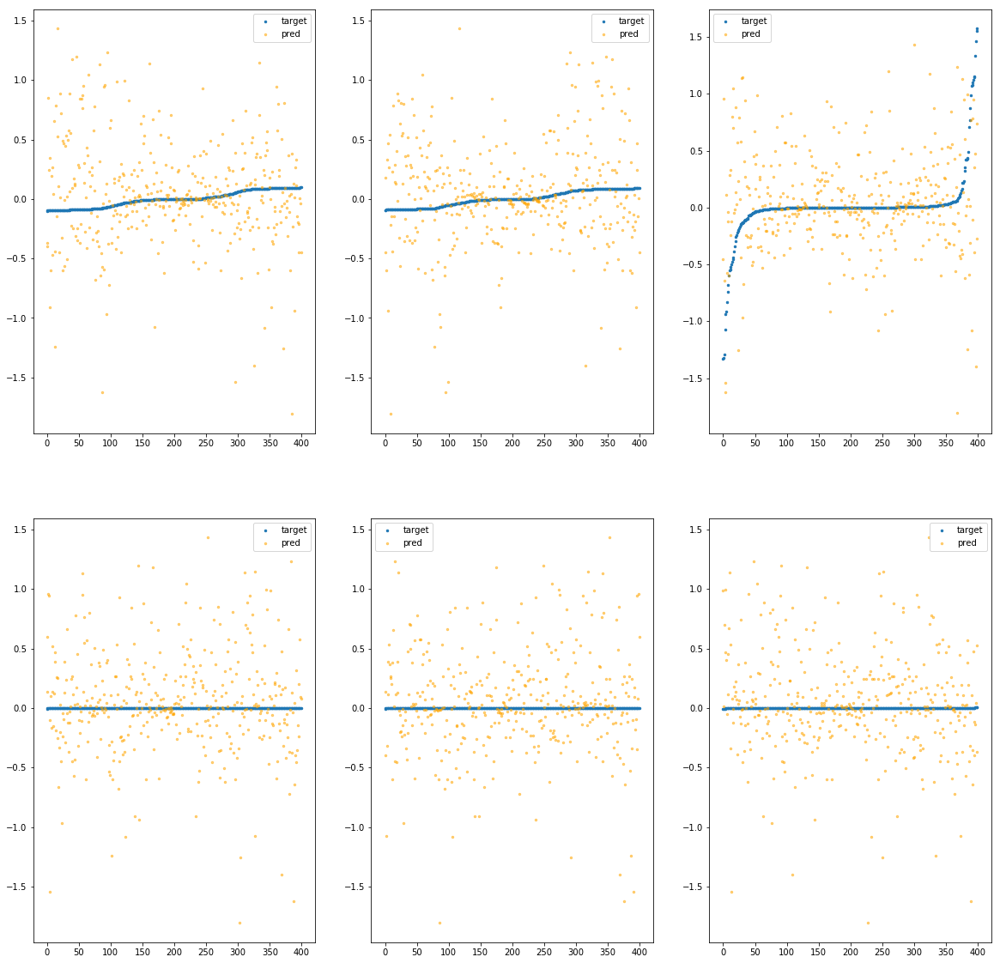

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f01160>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.13e+01	1.64e+00	1.95e-01	1.61e+05	9.14e-02	8.35e-03
y		-2.45e+01	1.62e+00	1.99e-01	8.53e+03	9.77e-02	9.54e-03
z		-8.84e-01	2.51e+00	2.26e-01	6.90e+03	1.57e-01	2.46e-02
phi		-2.49e+05	1.57e+00	1.88e-01	4.26e+07	9.01e-02	8.12e-03
theta		-2.92e+05	1.57e+00	1.88e-01	8.87e+06	9.01e-02	8.11e-03
psi		-1.20e+05	1.57e+00	1.88e-01	2.79e+07	9.01e-02	8.11e-03


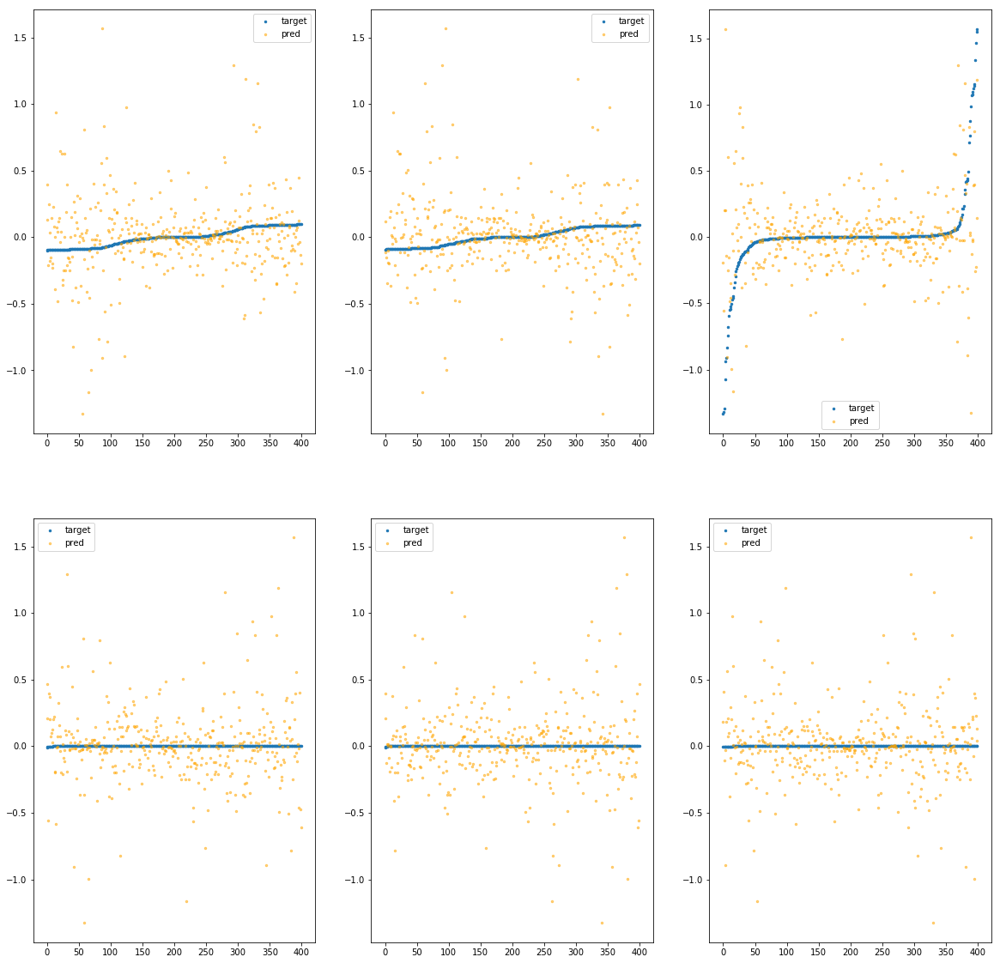

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f011c0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.60e+01	1.49e+00	1.75e-01	1.75e+05	6.96e-02	4.84e-03
y		-1.81e+01	1.50e+00	1.78e-01	6.84e+03	7.33e-02	5.37e-03
z		-1.16e+00	2.70e+00	2.25e-01	6.33e+03	1.80e-01	3.24e-02
phi		-1.87e+05	1.41e+00	1.71e-01	2.57e+07	6.78e-02	4.59e-03
theta		-2.19e+05	1.41e+00	1.71e-01	5.80e+06	6.78e-02	4.60e-03
psi		-9.03e+04	1.41e+00	1.71e-01	1.39e+07	6.77e-02	4.59e-03


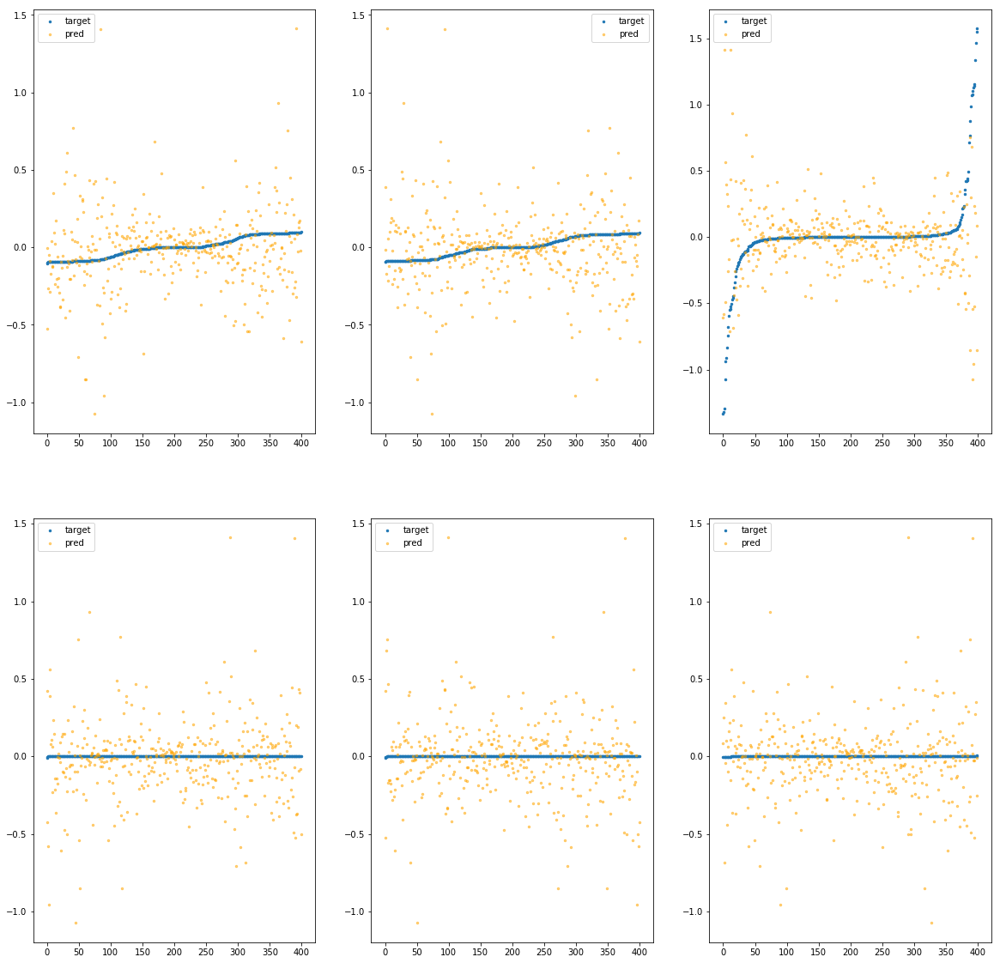

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f01220>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.48e+01	1.55e+00	2.16e-01	1.60e+05	1.06e-01	1.11e-02
y		-2.66e+01	1.54e+00	2.14e-01	9.01e+03	1.06e-01	1.12e-02
z		-1.32e+00	3.04e+00	2.57e-01	8.26e+03	1.93e-01	3.72e-02
phi		-2.76e+05	1.47e+00	2.10e-01	2.89e+07	9.98e-02	9.96e-03
theta		-3.23e+05	1.47e+00	2.10e-01	1.30e+07	9.99e-02	9.97e-03
psi		-1.33e+05	1.47e+00	2.10e-01	1.85e+07	9.98e-02	9.96e-03


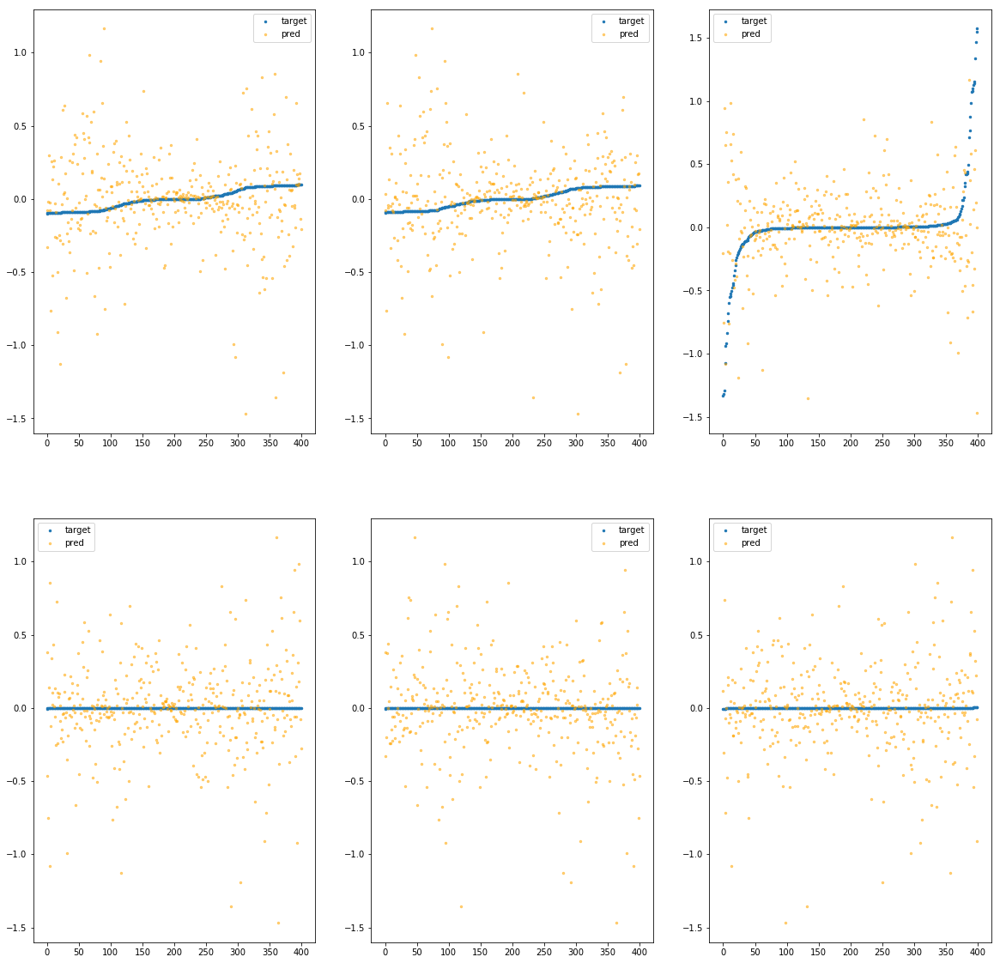

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f01280>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.24e+01	1.67e+00	2.57e-01	1.51e+05	1.37e-01	1.87e-02
y		-3.36e+01	1.50e+00	2.54e-01	9.45e+03	1.33e-01	1.76e-02
z		-1.68e+00	2.25e+00	2.93e-01	9.07e+03	2.23e-01	4.99e-02
phi		-3.57e+05	1.58e+00	2.51e-01	3.25e+07	1.29e-01	1.67e-02
theta		-4.19e+05	1.58e+00	2.51e-01	1.83e+07	1.29e-01	1.67e-02
psi		-1.72e+05	1.58e+00	2.51e-01	2.57e+07	1.29e-01	1.67e-02


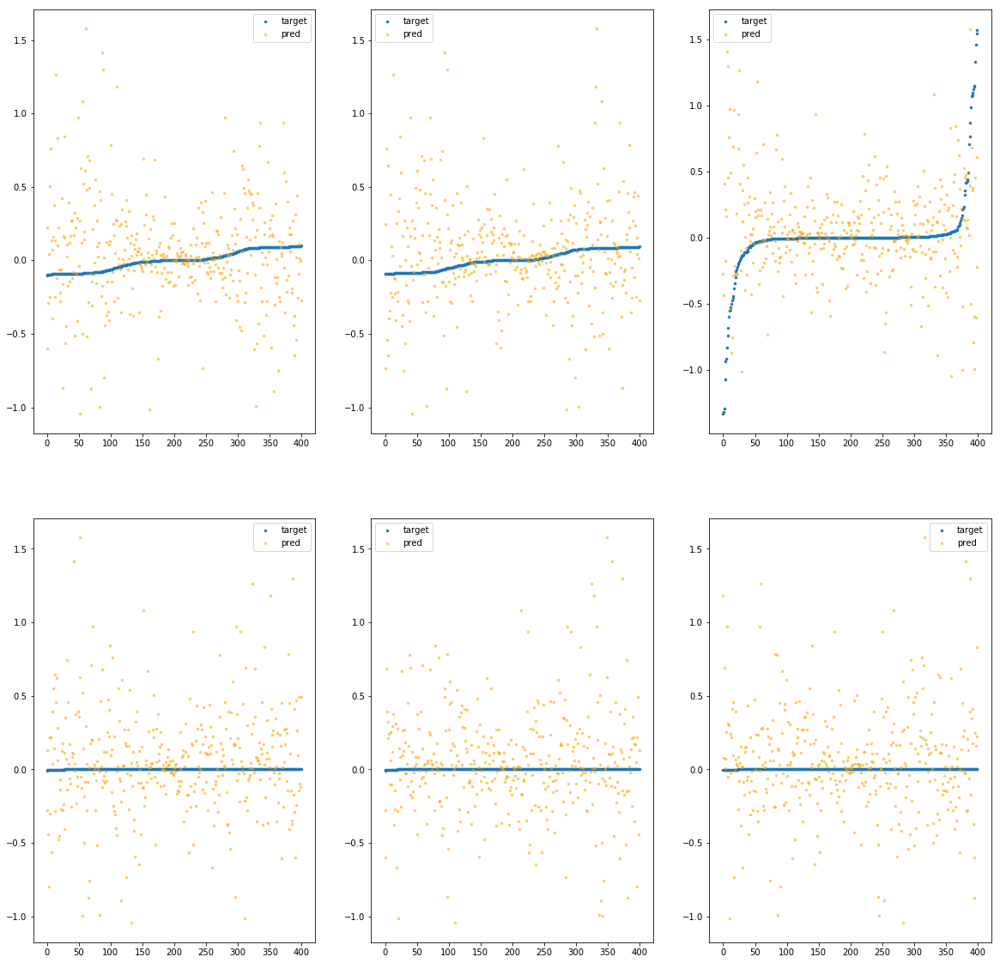

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f012e0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.68e+01	1.66e+00	2.72e-01	3.27e+05	1.55e-01	2.39e-02
y		-3.93e+01	1.57e+00	2.69e-01	1.46e+04	1.54e-01	2.38e-02
z		-1.72e+00	2.26e+00	3.05e-01	1.13e+04	2.27e-01	5.14e-02
phi		-4.11e+05	1.57e+00	2.66e-01	4.57e+07	1.49e-01	2.22e-02
theta		-4.82e+05	1.57e+00	2.66e-01	1.46e+07	1.49e-01	2.22e-02
psi		-1.99e+05	1.57e+00	2.66e-01	2.23e+07	1.49e-01	2.22e-02


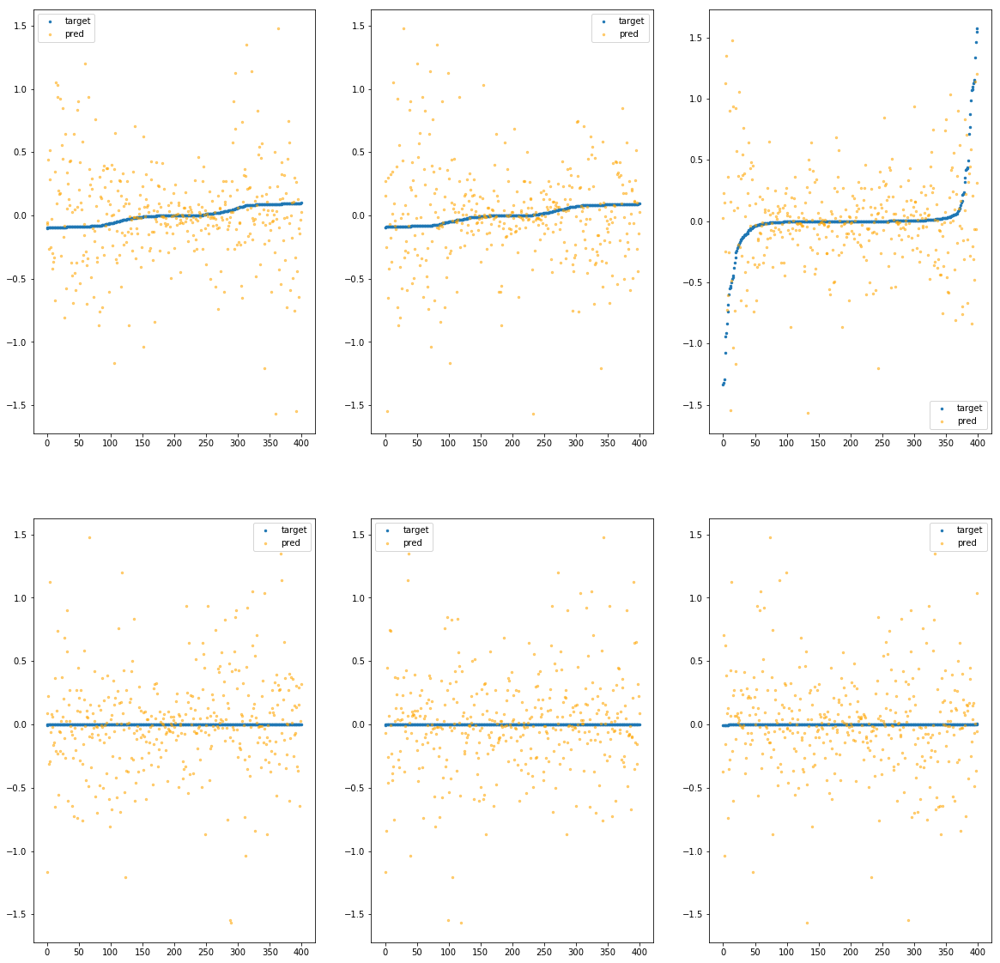

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01340>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.00e+00	1.56e+00	9.88e-02	5.24e+04	3.28e-02	1.07e-03
y		-7.04e+00	1.39e+00	1.01e-01	1.30e+03	3.08e-02	9.51e-04
z		-4.10e-01	2.30e+00	1.38e-01	1.57e+03	1.18e-01	1.38e-02
phi		-7.67e+04	1.47e+00	8.30e-02	1.19e+07	2.78e-02	7.70e-04
theta		-8.98e+04	1.47e+00	8.30e-02	1.22e+06	2.77e-02	7.70e-04
psi		-3.70e+04	1.47e+00	8.30e-02	5.84e+06	2.77e-02	7.69e-04


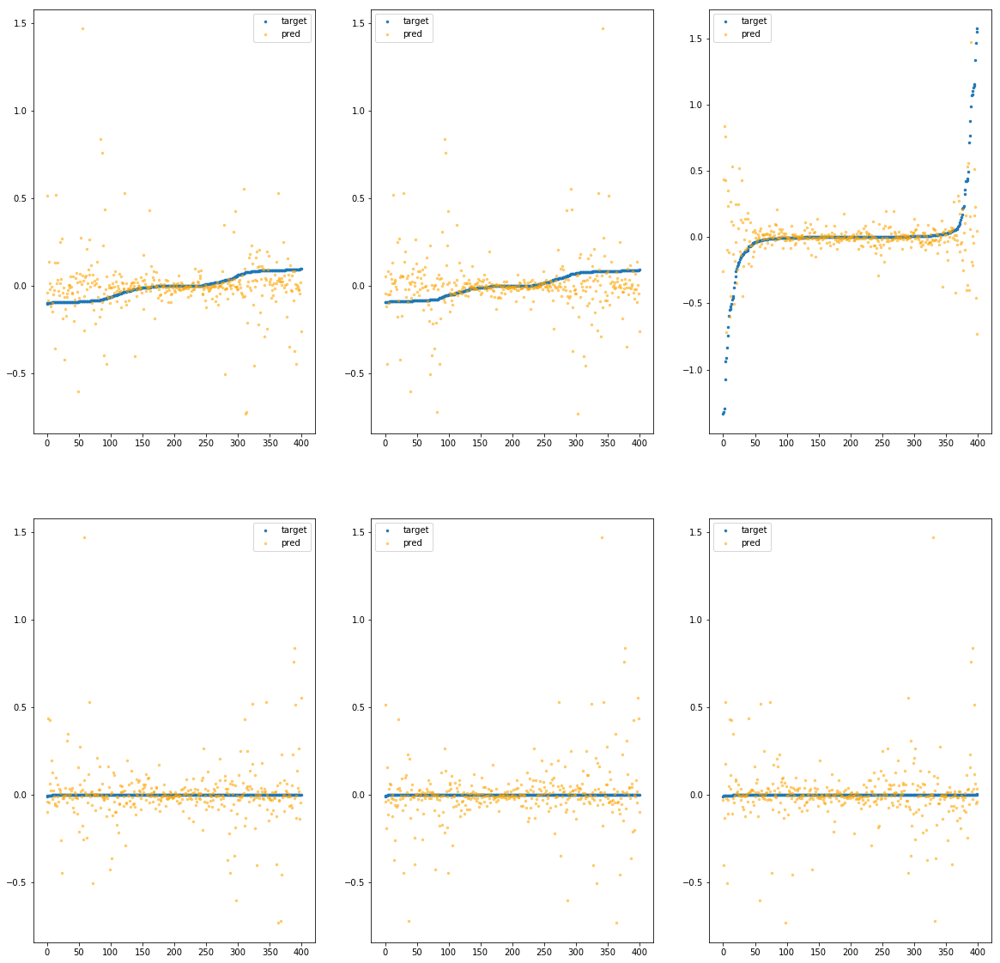

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f013a0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.50e+00	9.27e-01	9.97e-02	4.48e+04	2.66e-02	7.07e-04
y		-5.18e+00	9.05e-01	9.50e-02	1.78e+03	2.37e-02	5.62e-04
z		-1.69e-01	1.82e+00	1.34e-01	2.42e+03	9.74e-02	9.49e-03
phi		-5.72e+04	9.02e-01	7.78e-02	7.98e+06	2.07e-02	4.29e-04
theta		-6.71e+04	9.03e-01	7.79e-02	3.11e+06	2.07e-02	4.30e-04
psi		-2.76e+04	9.01e-01	7.78e-02	4.68e+06	2.07e-02	4.29e-04


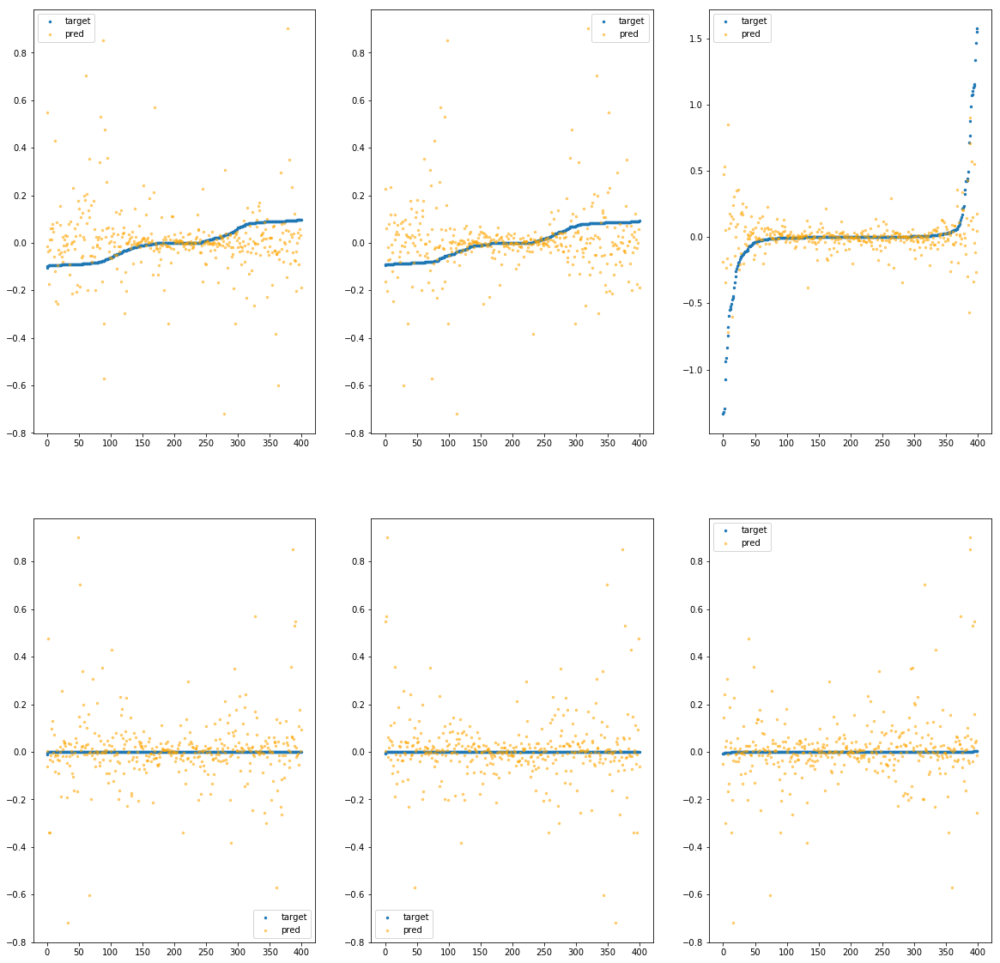

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01400>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.37e+00	1.24e+00	1.16e-01	5.06e+04	3.84e-02	1.47e-03
y		-8.73e+00	1.23e+00	1.09e-01	2.67e+03	3.73e-02	1.39e-03
z		-5.41e-01	2.62e+00	1.52e-01	2.67e+03	1.28e-01	1.65e-02
phi		-9.71e+04	1.16e+00	9.86e-02	6.73e+06	3.51e-02	1.24e-03
theta		-1.14e+05	1.16e+00	9.86e-02	2.82e+06	3.51e-02	1.23e-03
psi		-4.68e+04	1.16e+00	9.85e-02	5.57e+06	3.51e-02	1.23e-03


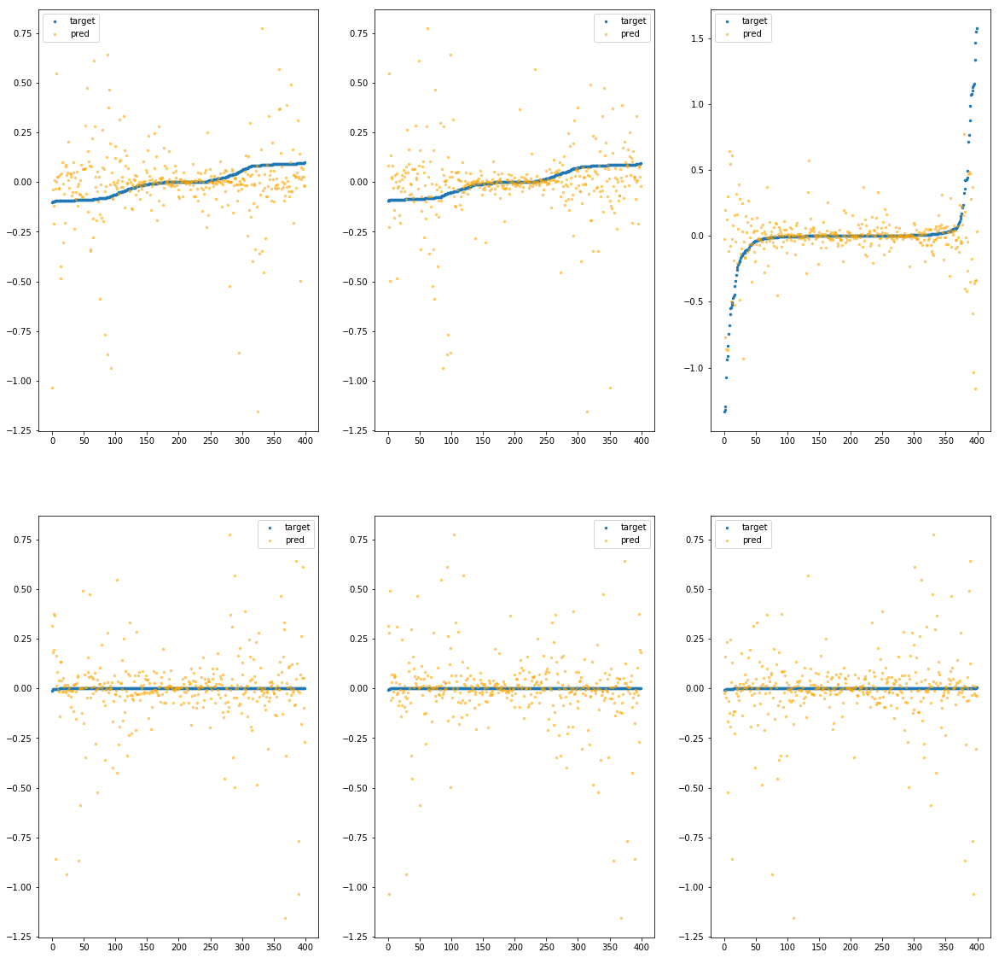

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01460>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.76e+00	8.16e-01	1.17e-01	4.64e+04	3.58e-02	1.29e-03
y		-7.74e+00	8.12e-01	1.16e-01	3.58e+03	3.35e-02	1.12e-03
z		-2.58e-01	2.03e+00	1.49e-01	2.38e+03	1.05e-01	1.10e-02
phi		-8.16e+04	7.24e-01	9.77e-02	1.28e+07	2.96e-02	8.74e-04
theta		-9.57e+04	7.26e-01	9.77e-02	5.26e+06	2.95e-02	8.73e-04
psi		-3.94e+04	7.23e-01	9.76e-02	5.25e+06	2.95e-02	8.72e-04


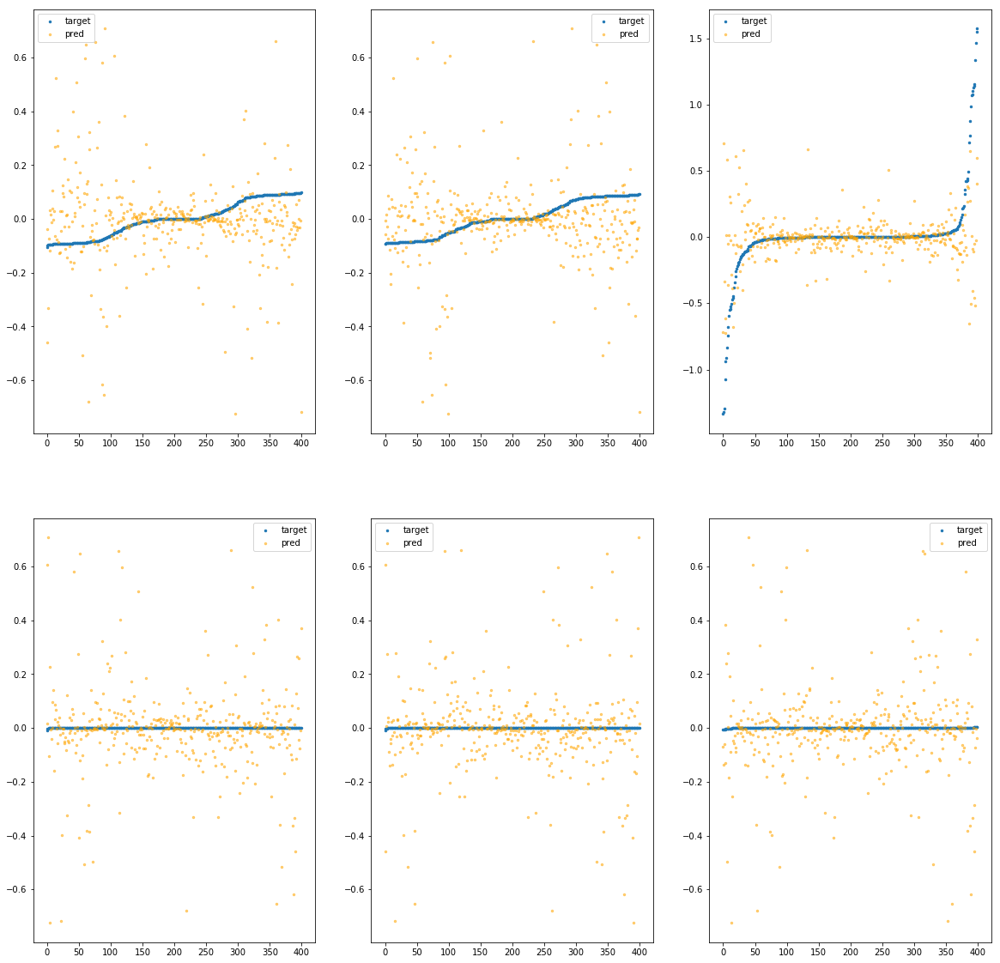

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f014c0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.63e+00	9.06e-01	1.11e-01	3.02e+04	3.12e-02	9.76e-04
y		-7.52e+00	9.02e-01	1.10e-01	2.14e+03	3.27e-02	1.07e-03
z		-8.47e-02	1.97e+00	1.47e-01	1.88e+03	9.04e-02	8.17e-03
phi		-7.90e+04	9.04e-01	9.66e-02	1.23e+07	2.86e-02	8.17e-04
theta		-9.26e+04	9.04e-01	9.67e-02	1.59e+06	2.86e-02	8.18e-04
psi		-3.81e+04	9.04e-01	9.67e-02	5.28e+06	2.86e-02	8.18e-04


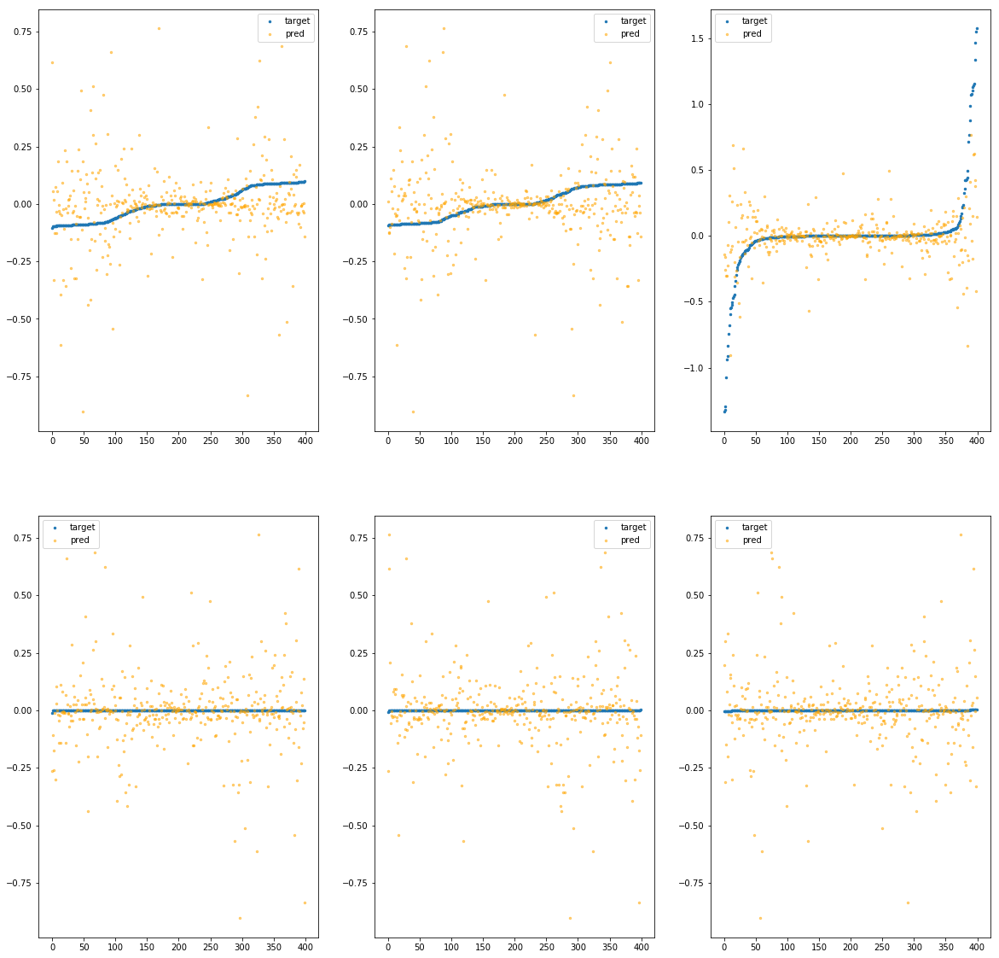

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01520>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.52e+00	1.15e+00	9.79e-02	3.59e+04	2.67e-02	7.12e-04
y		-5.37e+00	1.15e+00	9.67e-02	1.43e+03	2.44e-02	5.97e-04
z		-2.79e-01	1.99e+00	1.38e-01	1.13e+03	1.07e-01	1.13e-02
phi		-5.88e+04	1.06e+00	7.68e-02	1.01e+07	2.13e-02	4.52e-04
theta		-6.88e+04	1.06e+00	7.68e-02	1.62e+06	2.13e-02	4.52e-04
psi		-2.83e+04	1.06e+00	7.67e-02	3.44e+06	2.12e-02	4.51e-04


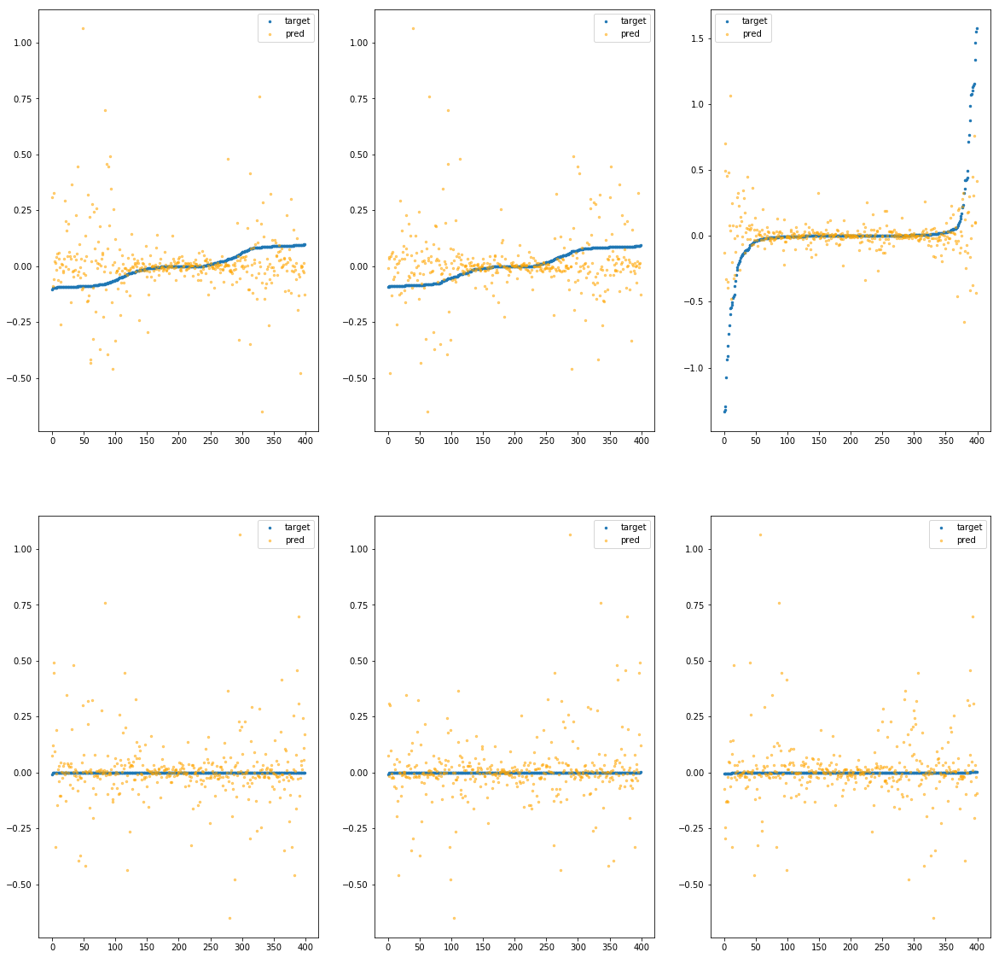

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01580>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.84e+00	7.42e-01	1.09e-01	5.55e+04	2.80e-02	7.83e-04
y		-7.14e+00	9.15e-01	1.06e-01	1.68e+03	3.12e-02	9.73e-04
z		-4.27e-01	2.10e+00	1.49e-01	2.18e+03	1.19e-01	1.41e-02
phi		-7.19e+04	8.30e-01	9.07e-02	1.33e+07	2.60e-02	6.77e-04
theta		-8.43e+04	8.31e-01	9.07e-02	1.59e+06	2.60e-02	6.77e-04
psi		-3.47e+04	8.31e-01	9.07e-02	5.39e+06	2.60e-02	6.78e-04


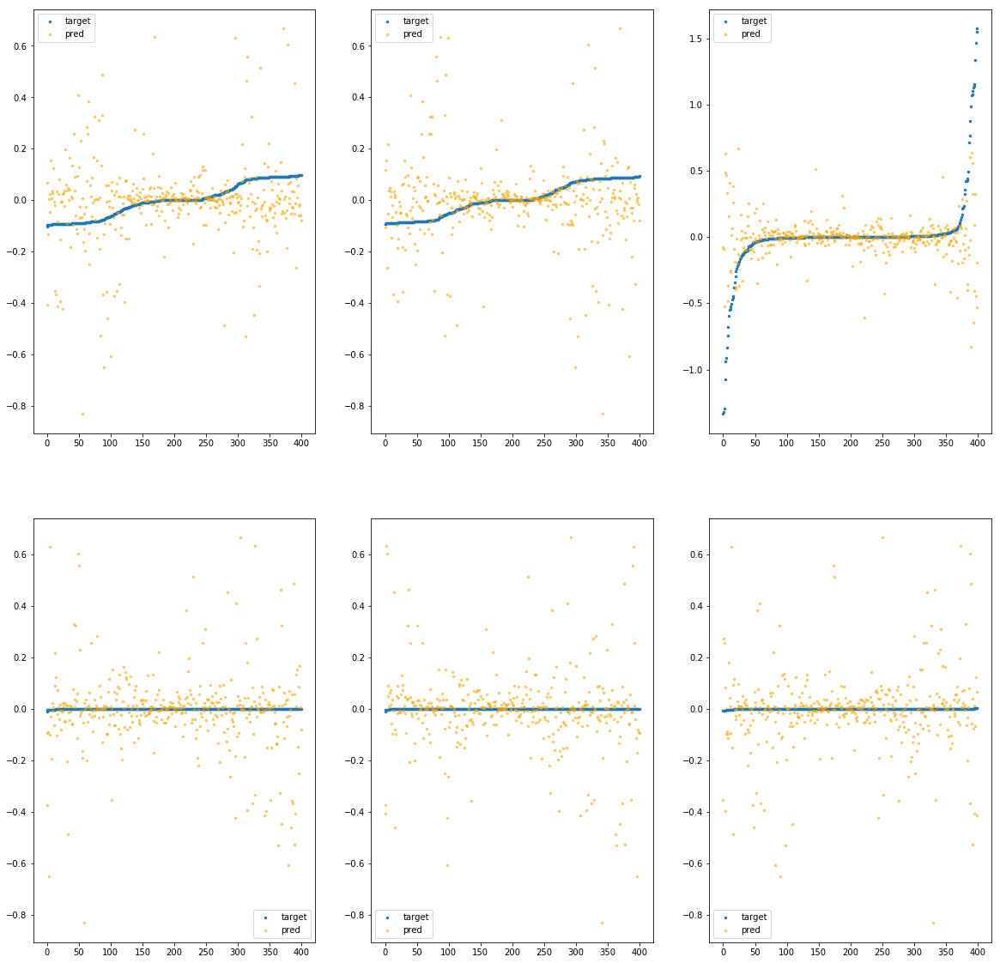

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f015e0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.29e+00	9.40e-01	9.62e-02	3.30e+04	2.16e-02	4.68e-04
y		-4.53e+00	9.36e-01	9.43e-02	1.92e+03	2.12e-02	4.50e-04
z		-3.31e-01	2.32e+00	1.41e-01	1.57e+03	1.11e-01	1.23e-02
phi		-4.64e+04	8.57e-01	7.43e-02	6.45e+06	1.68e-02	2.83e-04
theta		-5.44e+04	8.57e-01	7.43e-02	1.94e+06	1.68e-02	2.83e-04
psi		-2.24e+04	8.57e-01	7.42e-02	5.69e+06	1.68e-02	2.83e-04


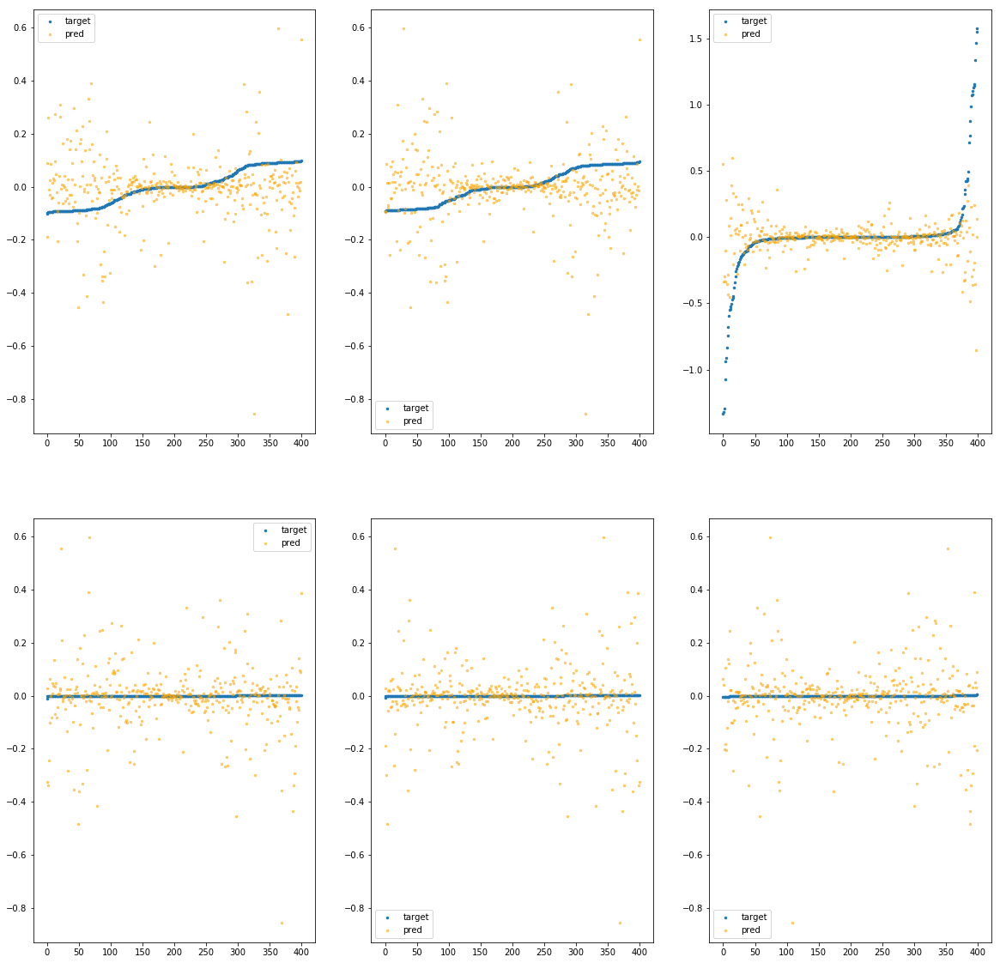

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01640>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.75e+00	1.10e+00	9.10e-02	4.24e+04	2.35e-02	5.54e-04
y		-4.87e+00	9.46e-01	8.70e-02	2.74e+03	2.25e-02	5.07e-04
z		-3.56e-01	2.10e+00	1.41e-01	1.49e+03	1.13e-01	1.28e-02
phi		-5.23e+04	1.02e+00	7.19e-02	1.25e+07	1.89e-02	3.58e-04
theta		-6.13e+04	1.02e+00	7.19e-02	2.84e+06	1.89e-02	3.59e-04
psi		-2.52e+04	1.02e+00	7.18e-02	6.96e+06	1.89e-02	3.56e-04


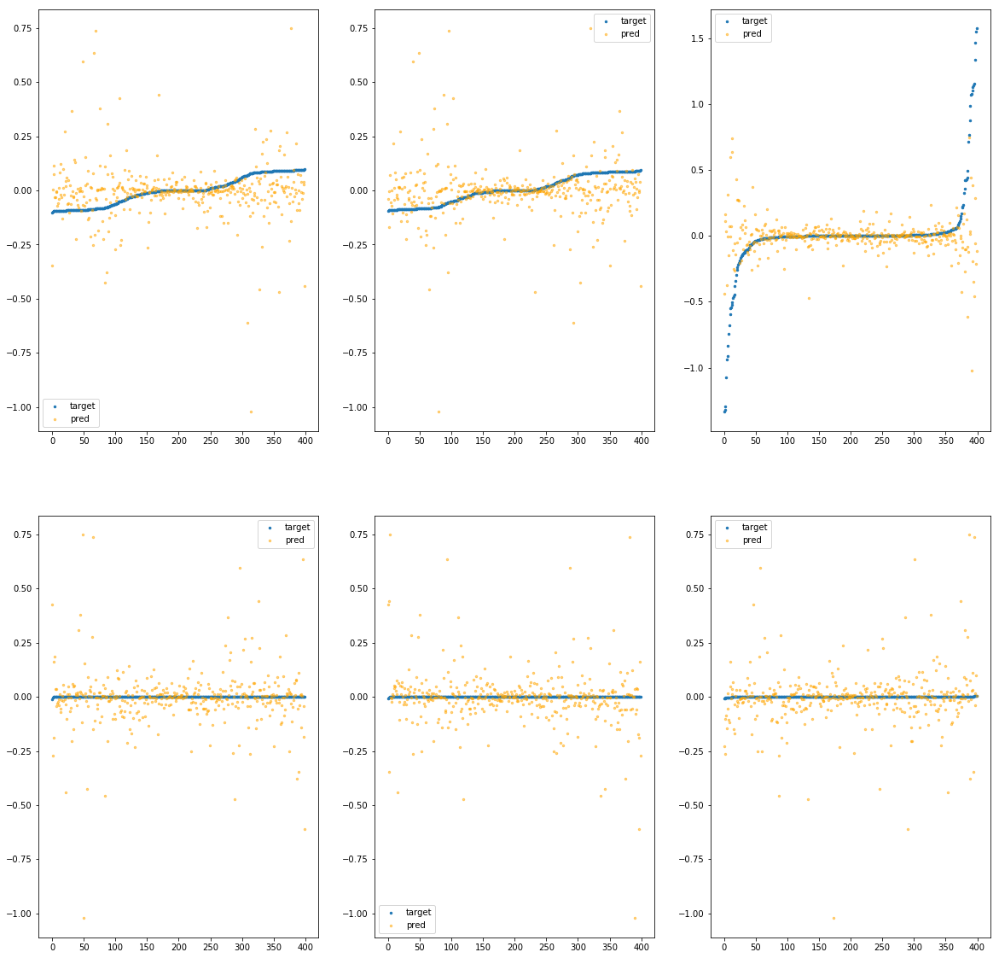

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f016a0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.72e+00	1.14e+00	1.07e-01	7.31e+04	3.16e-02	9.98e-04
y		-7.22e+00	1.00e+00	1.08e-01	1.35e+03	3.15e-02	9.94e-04
z		-4.04e-01	2.39e+00	1.47e-01	1.43e+03	1.17e-01	1.37e-02
phi		-7.56e+04	1.07e+00	8.64e-02	1.49e+07	2.74e-02	7.49e-04
theta		-8.85e+04	1.07e+00	8.65e-02	1.35e+06	2.73e-02	7.48e-04
psi		-3.65e+04	1.07e+00	8.66e-02	4.57e+06	2.74e-02	7.50e-04


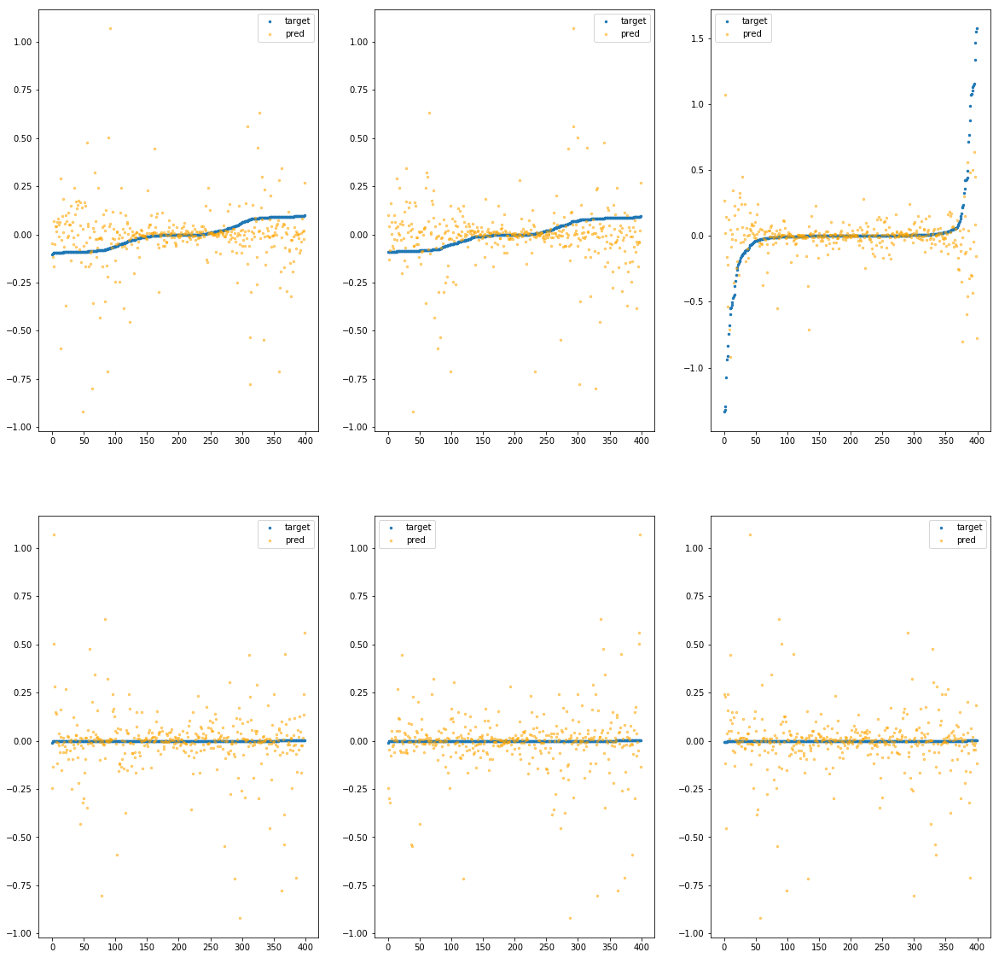

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01700>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.36e+00	7.91e-01	9.83e-02	2.38e+04	2.60e-02	6.78e-04
y		-6.19e+00	8.21e-01	1.05e-01	3.00e+03	2.76e-02	7.61e-04
z		-4.69e-01	1.93e+00	1.50e-01	1.49e+03	1.22e-01	1.50e-02
phi		-6.30e+04	8.75e-01	8.21e-02	7.35e+06	2.28e-02	5.20e-04
theta		-7.39e+04	8.76e-01	8.21e-02	2.17e+06	2.28e-02	5.21e-04
psi		-3.05e+04	8.78e-01	8.21e-02	5.80e+06	2.28e-02	5.22e-04


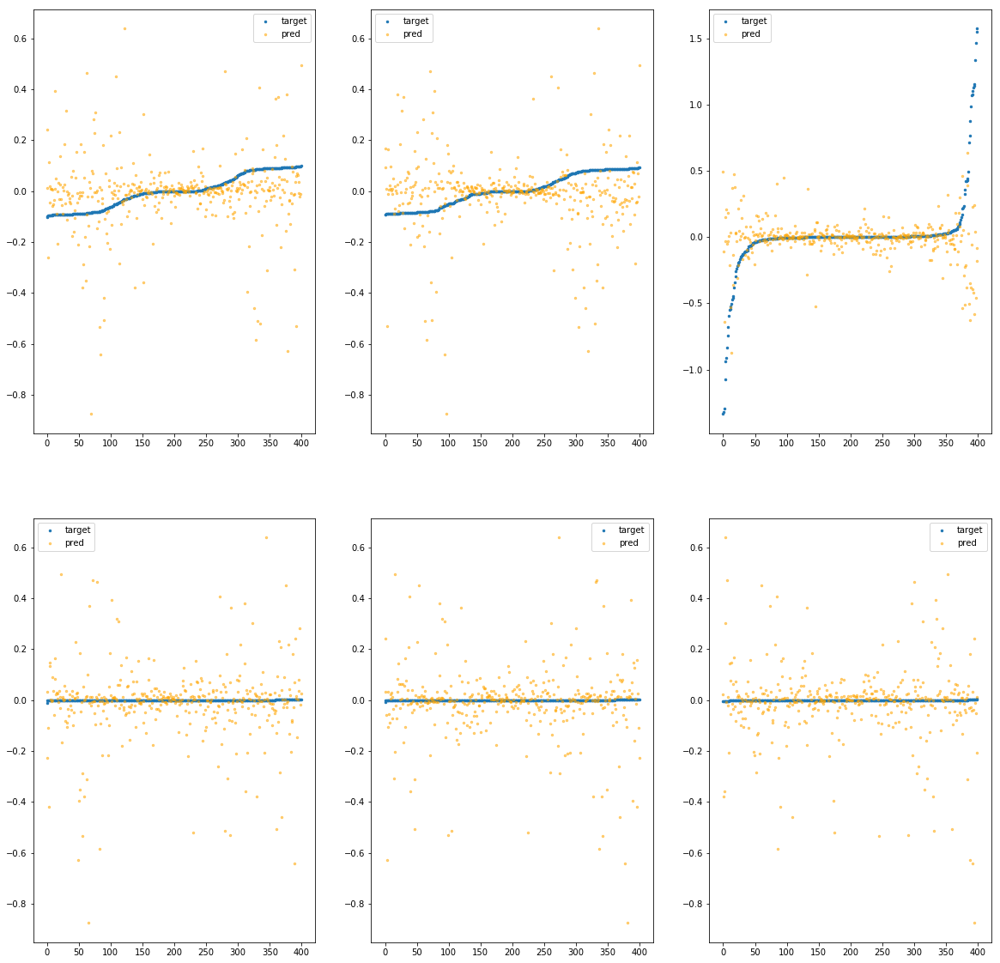

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01760>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.43e+00	8.60e-01	9.85e-02	3.37e+04	2.63e-02	6.94e-04
y		-5.26e+00	8.08e-01	9.71e-02	1.30e+03	2.40e-02	5.76e-04
z		-2.46e-01	2.09e+00	1.31e-01	1.42e+03	1.04e-01	1.08e-02
phi		-6.26e+04	8.91e-01	7.74e-02	5.85e+06	2.27e-02	5.13e-04
theta		-7.33e+04	8.91e-01	7.74e-02	1.67e+06	2.27e-02	5.13e-04
psi		-3.02e+04	8.91e-01	7.74e-02	6.73e+06	2.27e-02	5.14e-04


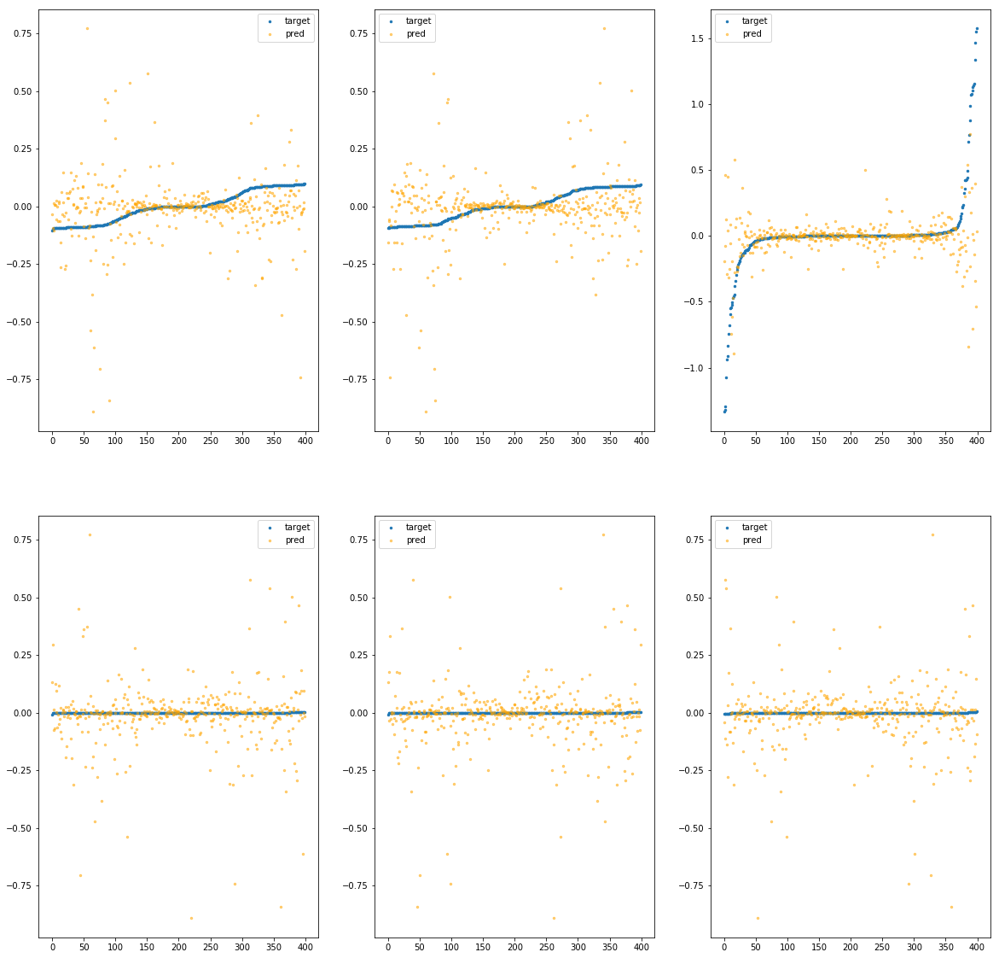

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f017c0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.34e+00	1.00e+00	9.72e-02	3.03e+04	2.59e-02	6.73e-04
y		-6.41e+00	1.02e+00	9.95e-02	1.82e+03	2.84e-02	8.08e-04
z		-1.97e-01	1.93e+00	1.33e-01	1.64e+03	9.97e-02	9.95e-03
phi		-6.33e+04	1.08e+00	7.59e-02	1.01e+07	2.29e-02	5.26e-04
theta		-7.43e+04	1.08e+00	7.59e-02	1.44e+06	2.29e-02	5.26e-04
psi		-3.06e+04	1.08e+00	7.59e-02	6.60e+06	2.29e-02	5.26e-04


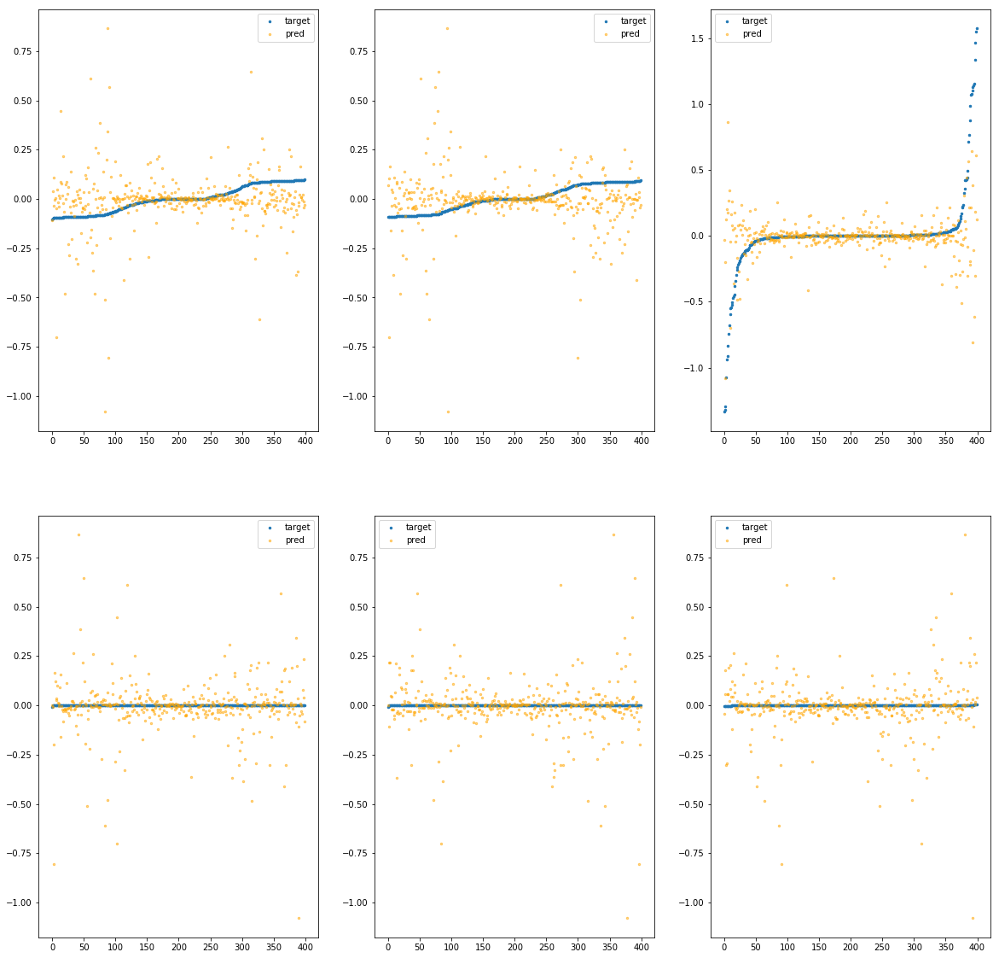

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01820>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.55e+00	1.12e+00	1.05e-01	4.51e+04	3.09e-02	9.55e-04
y		-7.25e+00	1.12e+00	1.06e-01	3.33e+03	3.16e-02	1.00e-03
z		-3.88e-01	2.30e+00	1.47e-01	2.25e+03	1.16e-01	1.34e-02
phi		-7.74e+04	1.20e+00	8.83e-02	1.22e+07	2.80e-02	7.85e-04
theta		-9.07e+04	1.20e+00	8.83e-02	2.33e+06	2.80e-02	7.86e-04
psi		-3.74e+04	1.20e+00	8.83e-02	4.74e+06	2.80e-02	7.86e-04


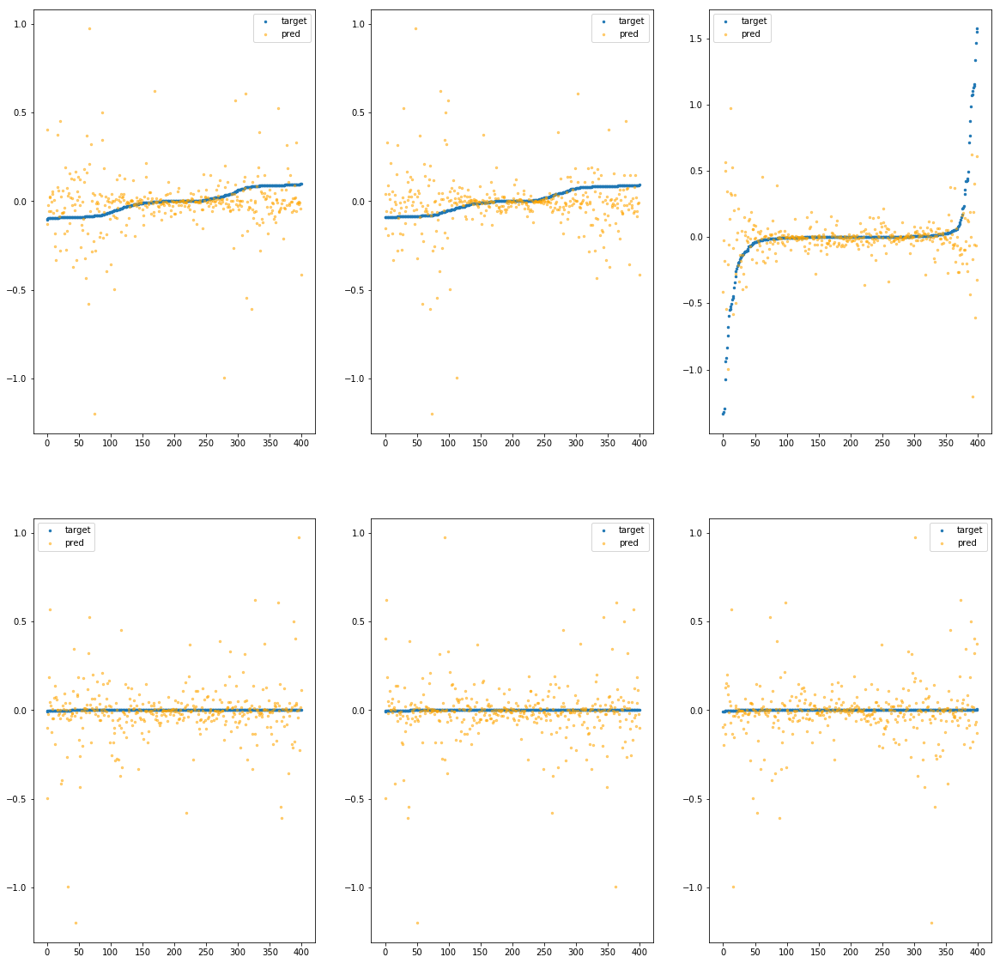

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01880>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.05e+00	8.79e-01	1.10e-01	3.71e+04	3.30e-02	1.09e-03
y		-7.26e+00	9.32e-01	1.08e-01	2.01e+03	3.17e-02	1.00e-03
z		-2.24e-01	1.90e+00	1.41e-01	1.75e+03	1.02e-01	1.04e-02
phi		-7.77e+04	9.64e-01	9.00e-02	8.60e+06	2.81e-02	7.91e-04
theta		-9.12e+04	9.64e-01	9.00e-02	1.78e+06	2.82e-02	7.93e-04
psi		-3.76e+04	9.64e-01	9.00e-02	4.38e+06	2.82e-02	7.95e-04


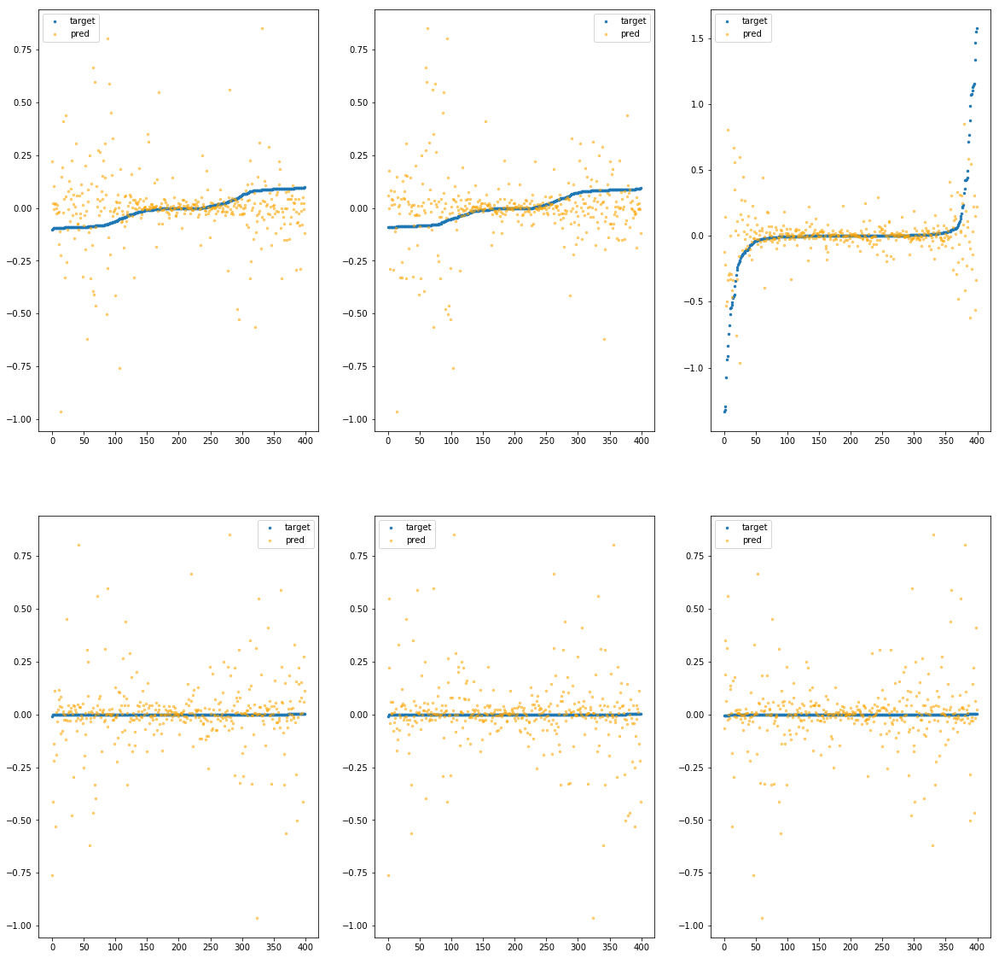

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f018e0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.67e+00	6.96e-01	8.96e-02	3.97e+04	1.91e-02	3.66e-04
y		-3.70e+00	7.57e-01	8.60e-02	2.27e+03	1.80e-02	3.25e-04
z		-2.45e-01	1.92e+00	1.33e-01	1.21e+03	1.04e-01	1.08e-02
phi		-3.77e+04	6.91e-01	6.56e-02	9.72e+06	1.36e-02	1.86e-04
theta		-4.42e+04	6.93e-01	6.56e-02	2.05e+06	1.37e-02	1.86e-04
psi		-1.82e+04	6.91e-01	6.56e-02	5.00e+06	1.36e-02	1.86e-04


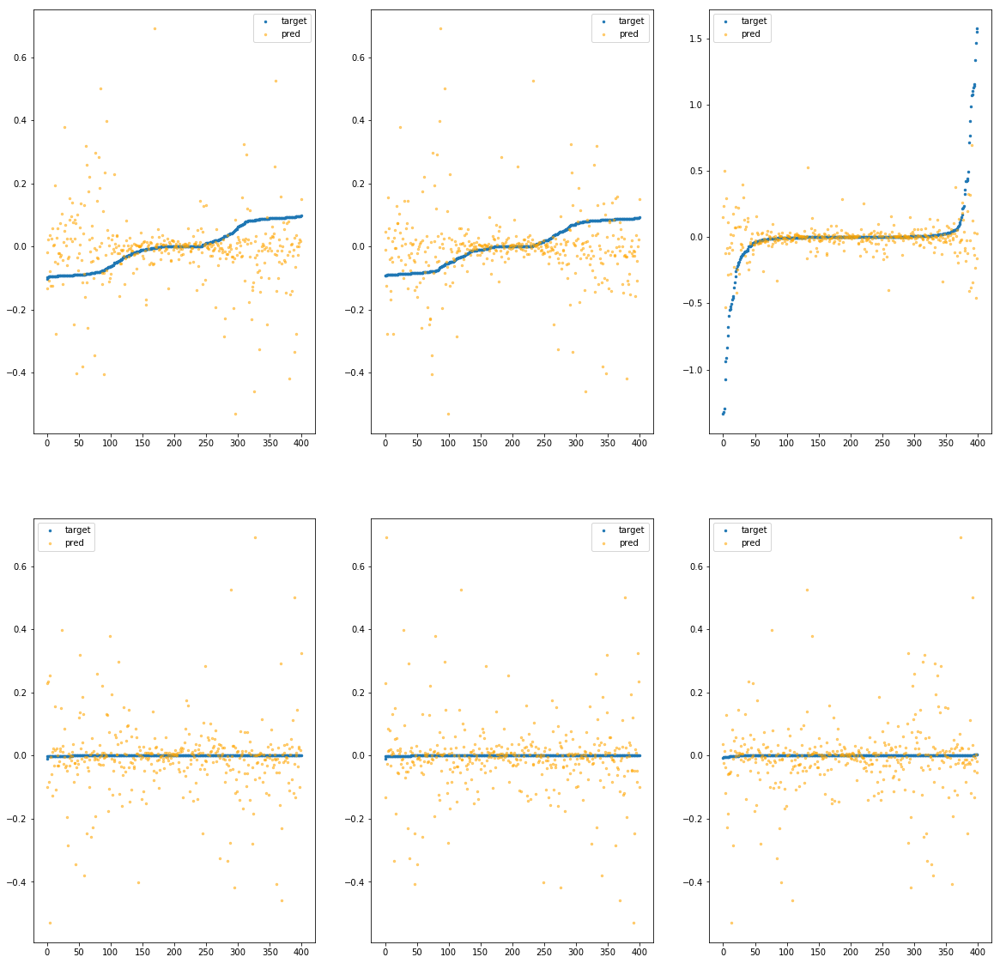

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01940>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.68e+00	1.18e+00	1.08e-01	3.86e+04	3.55e-02	1.26e-03
y		-7.69e+00	1.18e+00	1.04e-01	2.51e+03	3.33e-02	1.11e-03
z		2.03e-02	1.77e+00	1.24e-01	2.13e+03	8.16e-02	6.66e-03
phi		-8.00e+04	1.10e+00	8.30e-02	6.20e+06	2.90e-02	8.39e-04
theta		-9.38e+04	1.11e+00	8.30e-02	1.54e+06	2.90e-02	8.40e-04
psi		-3.86e+04	1.10e+00	8.29e-02	3.69e+06	2.89e-02	8.37e-04


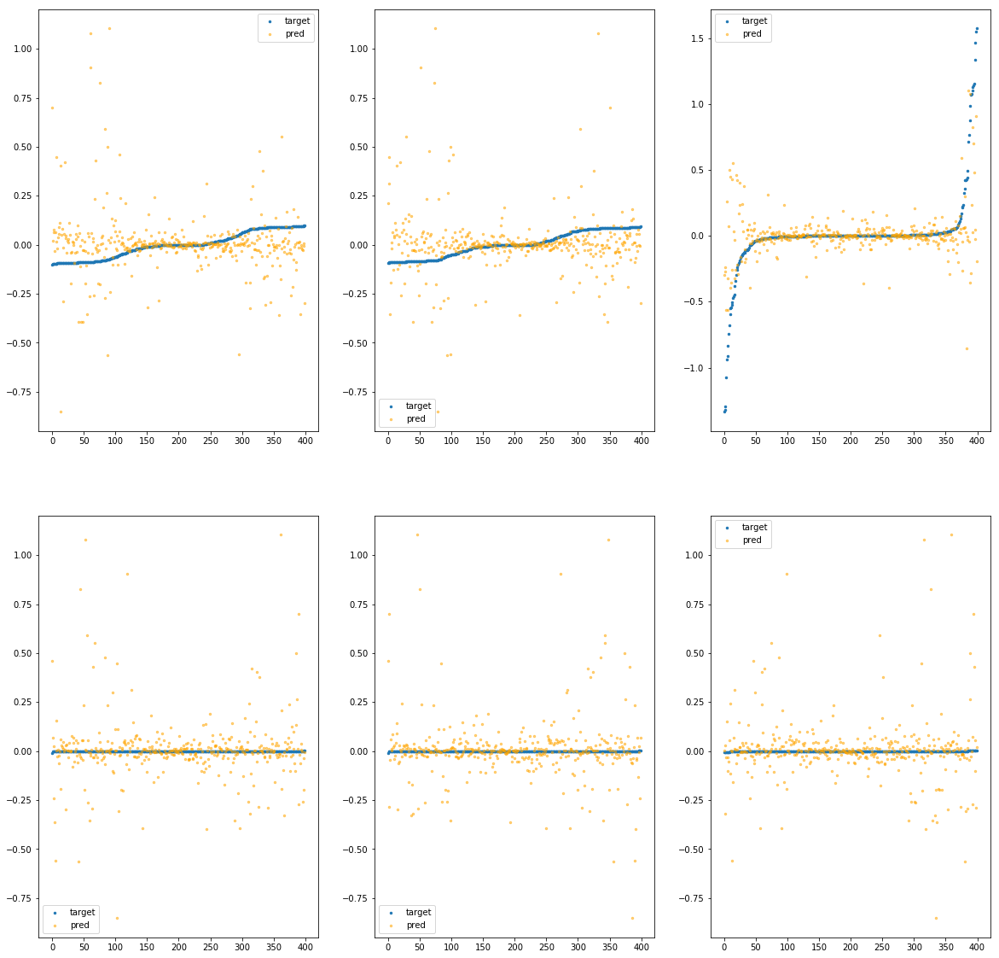

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f019a0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.36e+00	1.42e+00	9.22e-02	4.42e+04	2.61e-02	6.79e-04
y		-6.90e+00	1.43e+00	1.02e-01	2.31e+03	3.03e-02	9.17e-04
z		-4.16e-01	2.02e+00	1.43e-01	1.83e+03	1.18e-01	1.39e-02
phi		-7.34e+04	1.49e+00	8.06e-02	1.13e+07	2.66e-02	7.07e-04
theta		-8.61e+04	1.49e+00	8.06e-02	2.40e+06	2.66e-02	7.07e-04
psi		-3.55e+04	1.50e+00	8.07e-02	4.87e+06	2.66e-02	7.09e-04


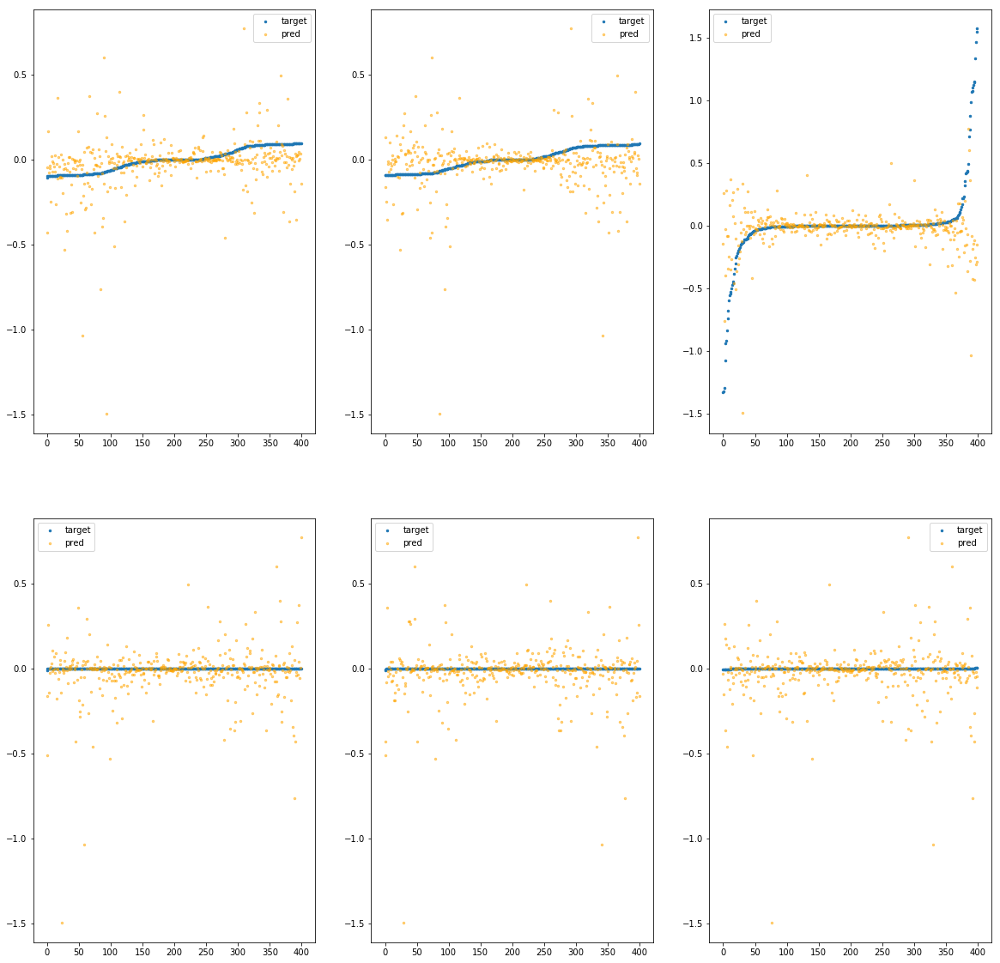

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01a00>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.18e+00	6.77e-01	8.43e-02	2.63e+04	1.71e-02	2.93e-04
y		-4.33e+00	7.92e-01	8.99e-02	1.26e+03	2.05e-02	4.18e-04
z		-1.88e-01	2.01e+00	1.34e-01	1.13e+03	9.89e-02	9.79e-03
phi		-3.79e+04	7.09e-01	6.47e-02	7.10e+06	1.37e-02	1.88e-04
theta		-4.44e+04	7.09e-01	6.47e-02	1.90e+06	1.37e-02	1.88e-04
psi		-1.83e+04	7.04e-01	6.47e-02	3.43e+06	1.37e-02	1.88e-04


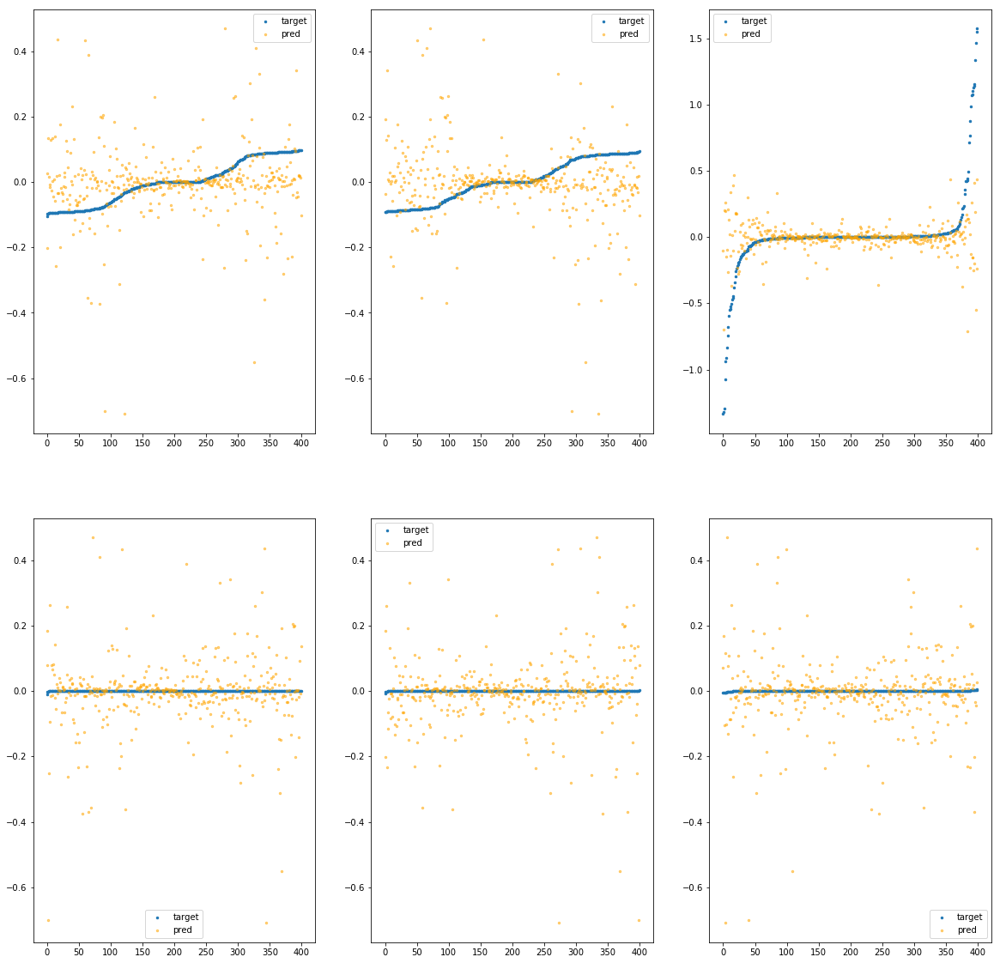

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f01a60>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.72e+00	1.65e+00	1.01e-01	3.15e+04	3.16e-02	1.00e-03
y		-6.68e+00	1.64e+00	9.84e-02	2.46e+03	2.95e-02	8.68e-04
z		-4.05e-01	3.03e+00	1.38e-01	1.67e+03	1.17e-01	1.37e-02
phi		-7.07e+04	1.56e+00	7.84e-02	1.10e+07	2.56e-02	6.56e-04
theta		-8.29e+04	1.56e+00	7.84e-02	1.99e+06	2.56e-02	6.55e-04
psi		-3.41e+04	1.56e+00	7.84e-02	5.22e+06	2.56e-02	6.56e-04


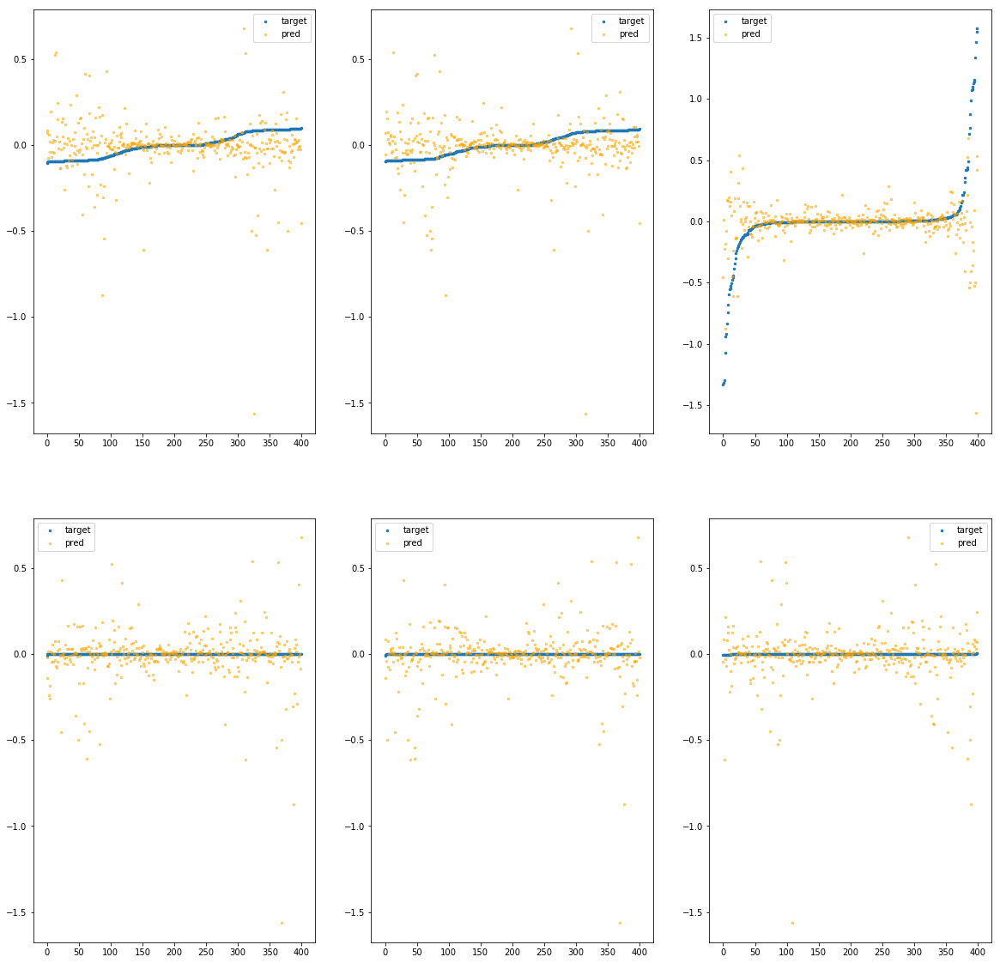

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01ac0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.82e+00	7.88e-01	8.27e-02	1.46e+04	1.57e-02	2.45e-04
y		-2.55e+00	7.83e-01	7.61e-02	1.17e+03	1.36e-02	1.85e-04
z		-2.89e-01	1.79e+00	1.28e-01	9.49e+02	1.07e-01	1.15e-02
phi		-2.79e+04	6.98e-01	5.02e-02	4.12e+06	1.01e-02	1.02e-04
theta		-3.27e+04	6.98e-01	5.03e-02	1.80e+06	1.01e-02	1.02e-04
psi		-1.35e+04	6.98e-01	5.03e-02	3.05e+06	1.01e-02	1.02e-04


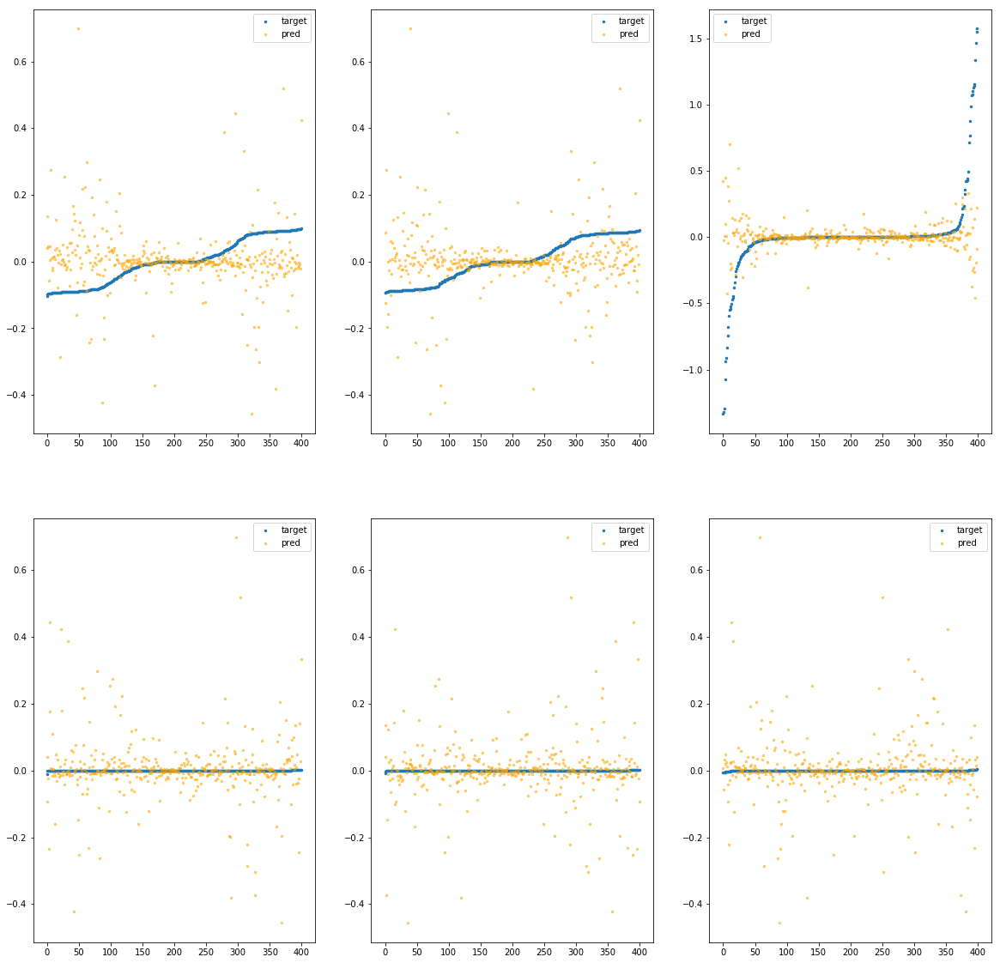

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01b20>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.04e+00	6.84e-01	8.07e-02	1.36e+04	1.66e-02	2.74e-04
y		-3.41e+00	6.82e-01	8.04e-02	7.69e+02	1.69e-02	2.85e-04
z		-2.01e-01	1.63e+00	1.26e-01	9.70e+02	1.00e-01	1.00e-02
phi		-3.68e+04	5.97e-01	5.91e-02	2.76e+06	1.33e-02	1.78e-04
theta		-4.32e+04	5.98e-01	5.91e-02	9.51e+05	1.33e-02	1.78e-04
psi		-1.78e+04	5.98e-01	5.92e-02	5.57e+06	1.34e-02	1.79e-04


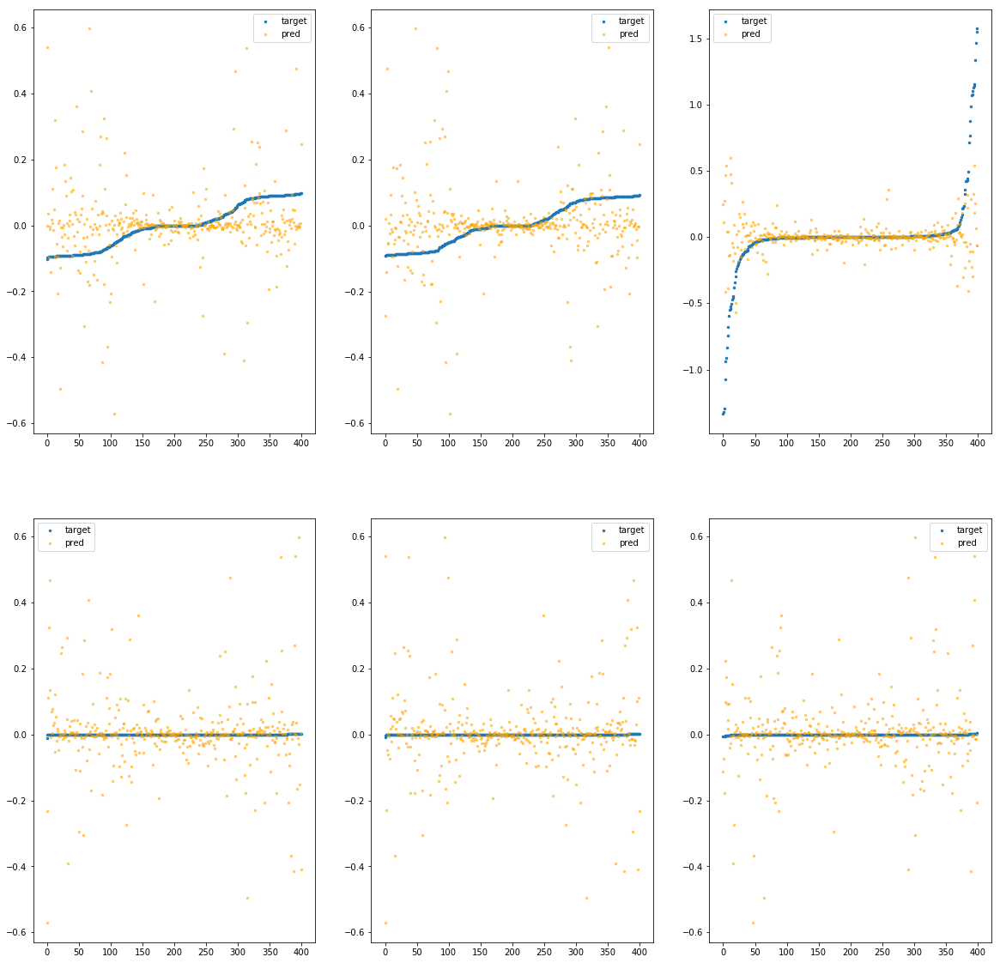

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01b80>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.79e+00	7.38e-01	8.79e-02	3.90e+04	1.96e-02	3.84e-04
y		-4.39e+00	7.34e-01	8.80e-02	2.27e+03	2.07e-02	4.26e-04
z		-2.05e-01	2.23e+00	1.30e-01	1.61e+03	1.00e-01	1.01e-02
phi		-4.33e+04	6.60e-01	6.51e-02	5.79e+06	1.57e-02	2.46e-04
theta		-5.08e+04	6.60e-01	6.51e-02	2.22e+06	1.57e-02	2.46e-04
psi		-2.09e+04	6.60e-01	6.52e-02	2.97e+06	1.57e-02	2.46e-04


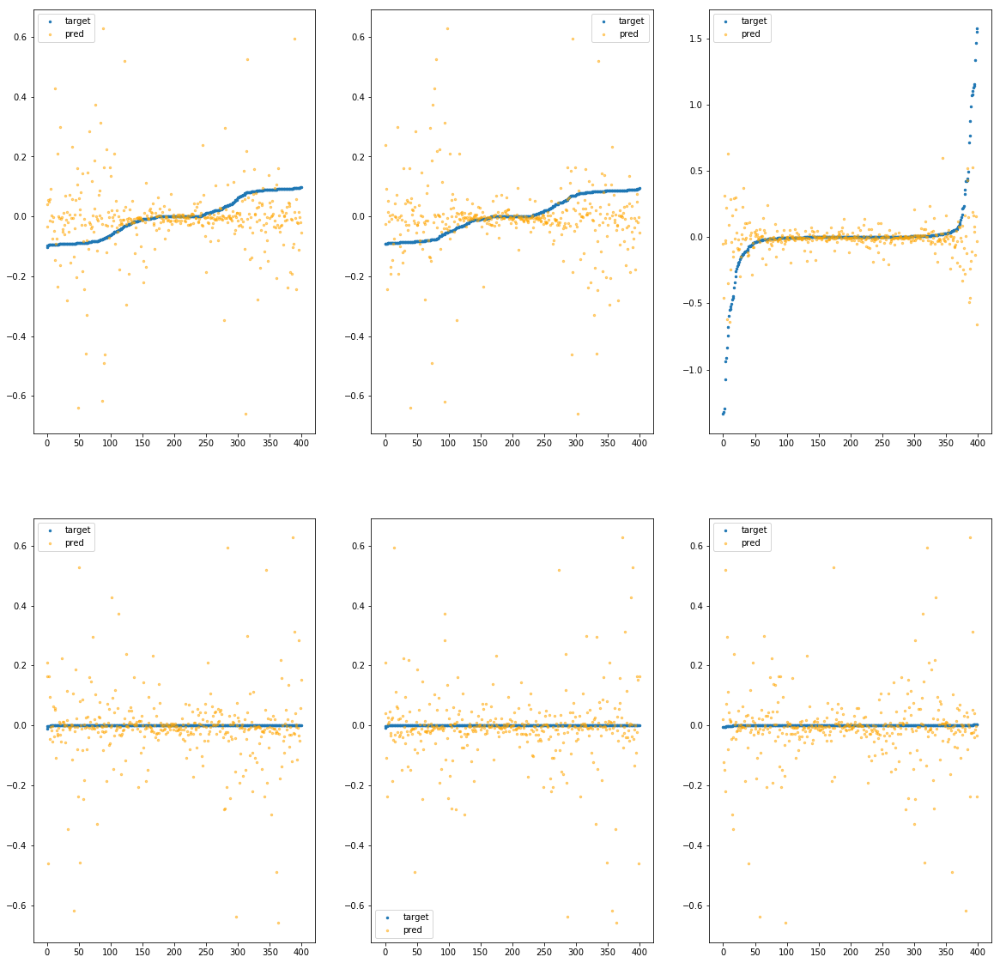

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01be0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.00e+00	1.37e+00	1.04e-01	4.28e+04	3.27e-02	1.07e-03
y		-6.70e+00	1.23e+00	9.84e-02	8.20e+02	2.95e-02	8.72e-04
z		-1.87e-01	2.23e+00	1.29e-01	1.31e+03	9.89e-02	9.79e-03
phi		-7.37e+04	1.30e+00	7.59e-02	8.67e+06	2.67e-02	7.13e-04
theta		-8.64e+04	1.30e+00	7.59e-02	8.44e+05	2.67e-02	7.13e-04
psi		-3.55e+04	1.30e+00	7.59e-02	4.55e+06	2.67e-02	7.11e-04


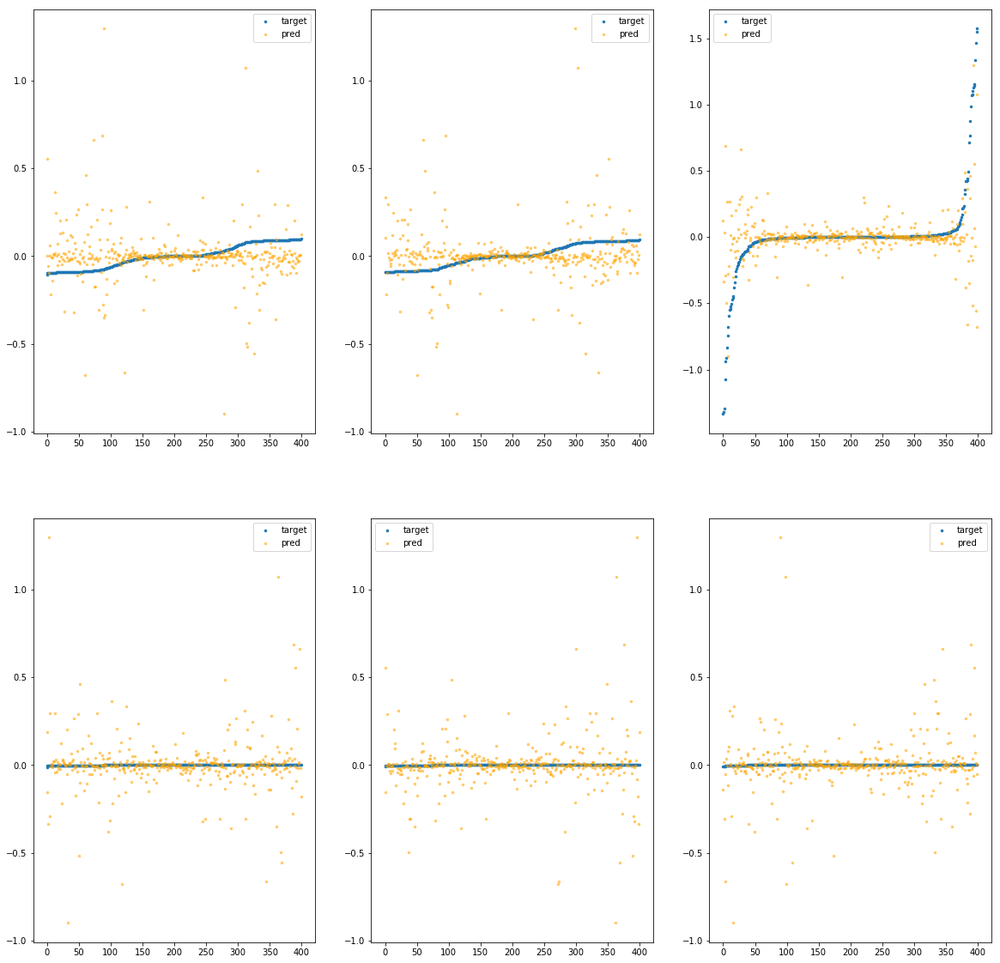

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01c40>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.93e+00	8.01e-01	1.13e-01	4.58e+04	3.25e-02	1.06e-03
y		-7.53e+00	8.63e-01	1.10e-01	6.91e+02	3.27e-02	1.07e-03
z		-1.30e-01	1.67e+00	1.39e-01	1.25e+03	9.41e-02	8.86e-03
phi		-7.87e+04	7.82e-01	9.19e-02	1.13e+07	2.85e-02	8.12e-04
theta		-9.22e+04	7.82e-01	9.19e-02	1.17e+06	2.85e-02	8.12e-04
psi		-3.79e+04	7.82e-01	9.19e-02	4.59e+06	2.84e-02	8.09e-04


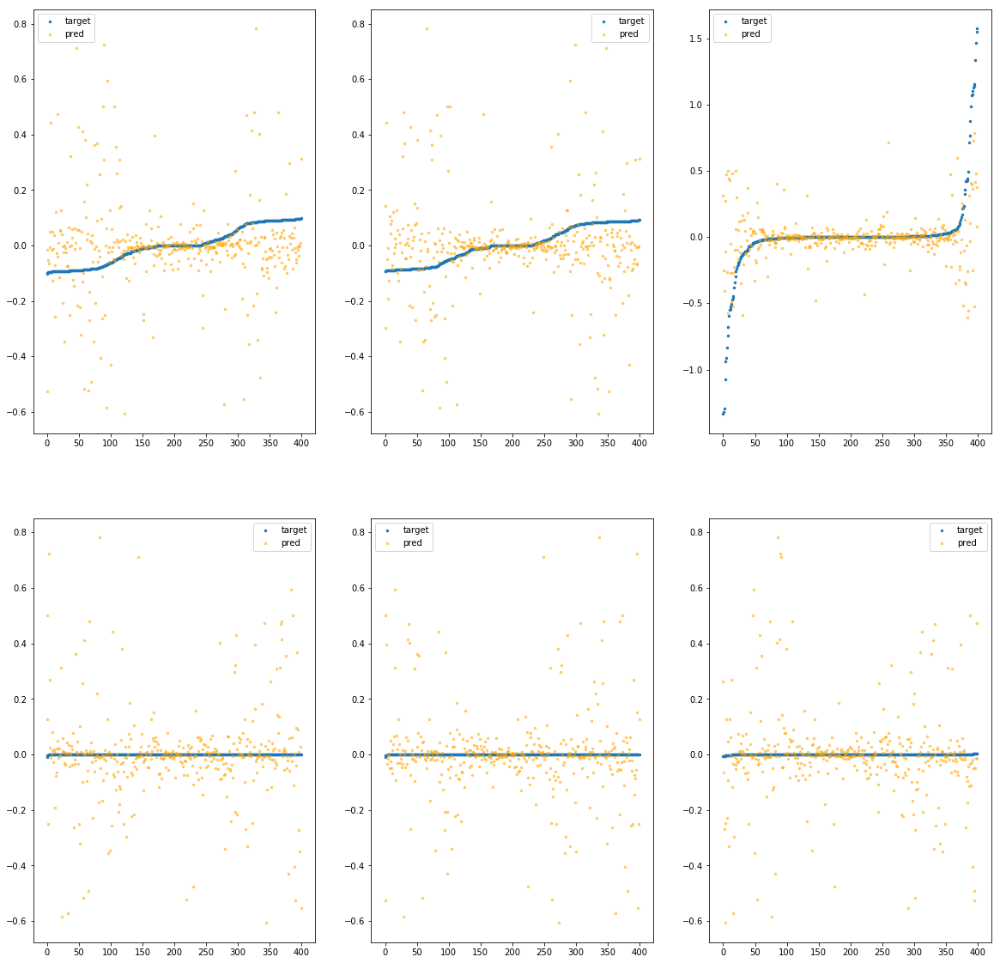

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01ca0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.37e-01	3.97e-01	6.35e-02	1.26e+04	7.52e-03	5.66e-05
y		-1.30e+00	4.19e-01	6.53e-02	2.66e+02	8.80e-03	7.74e-05
z		-7.42e-02	1.81e+00	1.14e-01	5.47e+02	8.95e-02	8.01e-03
phi		-1.27e+04	3.38e-01	3.49e-02	3.33e+06	4.59e-03	2.11e-05
theta		-1.49e+04	3.38e-01	3.49e-02	3.78e+05	4.59e-03	2.11e-05
psi		-6.12e+03	3.38e-01	3.49e-02	2.34e+06	4.59e-03	2.11e-05


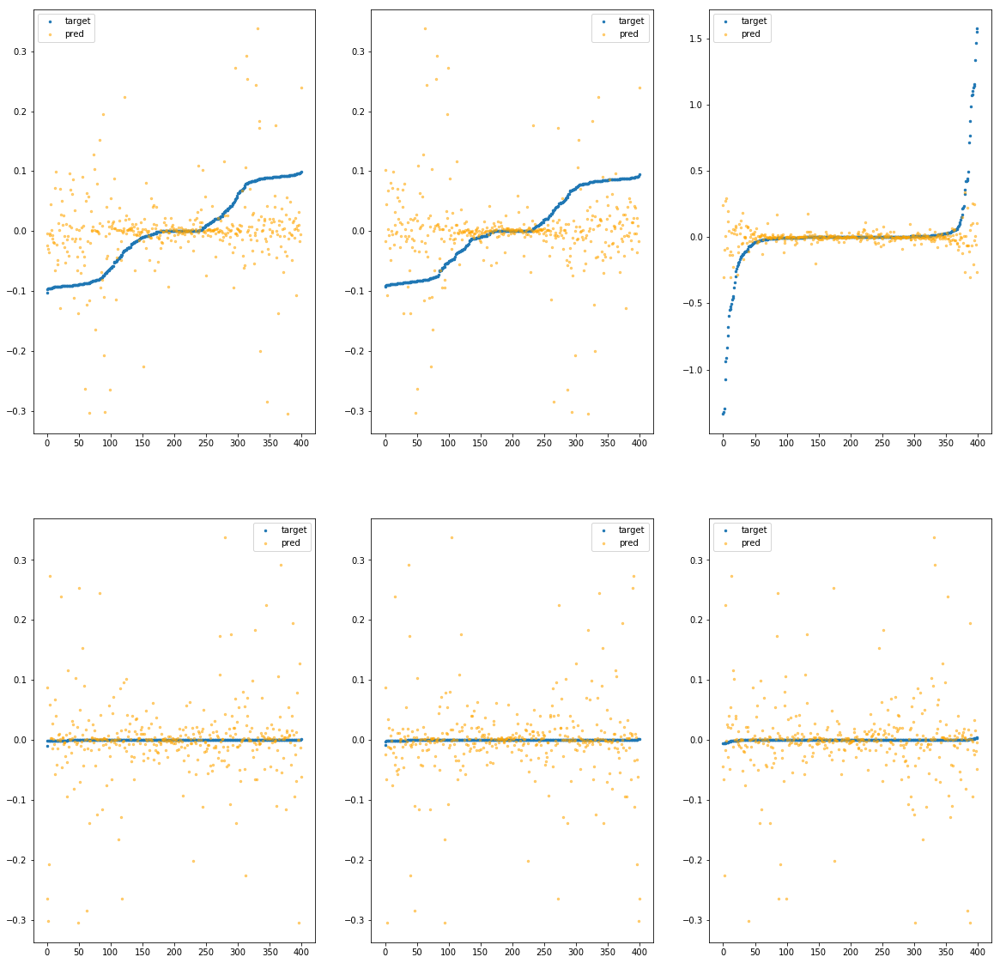

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01d00>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.54e+00	5.99e-01	7.00e-02	2.23e+04	1.04e-02	1.09e-04
y		-1.73e+00	5.77e-01	6.95e-02	1.40e+03	1.05e-02	1.10e-04
z		-2.45e-01	1.82e+00	1.20e-01	1.11e+03	1.04e-01	1.08e-02
phi		-1.86e+04	5.20e-01	4.05e-02	4.36e+06	6.72e-03	4.52e-05
theta		-2.18e+04	5.20e-01	4.05e-02	9.42e+05	6.72e-03	4.52e-05
psi		-8.98e+03	5.19e-01	4.05e-02	1.42e+06	6.73e-03	4.54e-05


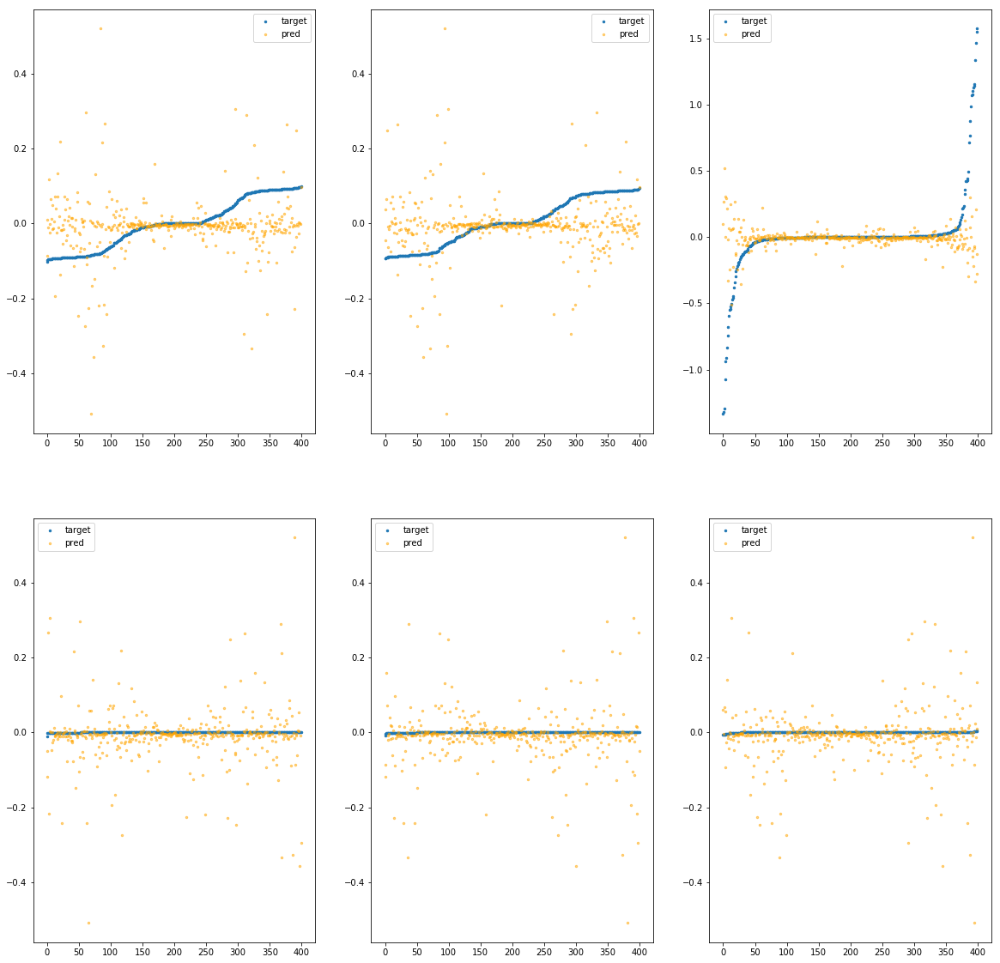

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01d60>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.22e+00	7.53e-01	8.03e-02	1.20e+04	1.73e-02	2.98e-04
y		-3.76e+00	9.00e-01	8.10e-02	6.43e+02	1.82e-02	3.33e-04
z		-1.11e-01	1.62e+00	1.22e-01	7.72e+02	9.26e-02	8.57e-03
phi		-3.63e+04	8.24e-01	5.63e-02	3.03e+06	1.31e-02	1.72e-04
theta		-4.25e+04	8.23e-01	5.64e-02	4.72e+05	1.31e-02	1.73e-04
psi		-1.75e+04	8.24e-01	5.64e-02	3.66e+06	1.31e-02	1.73e-04


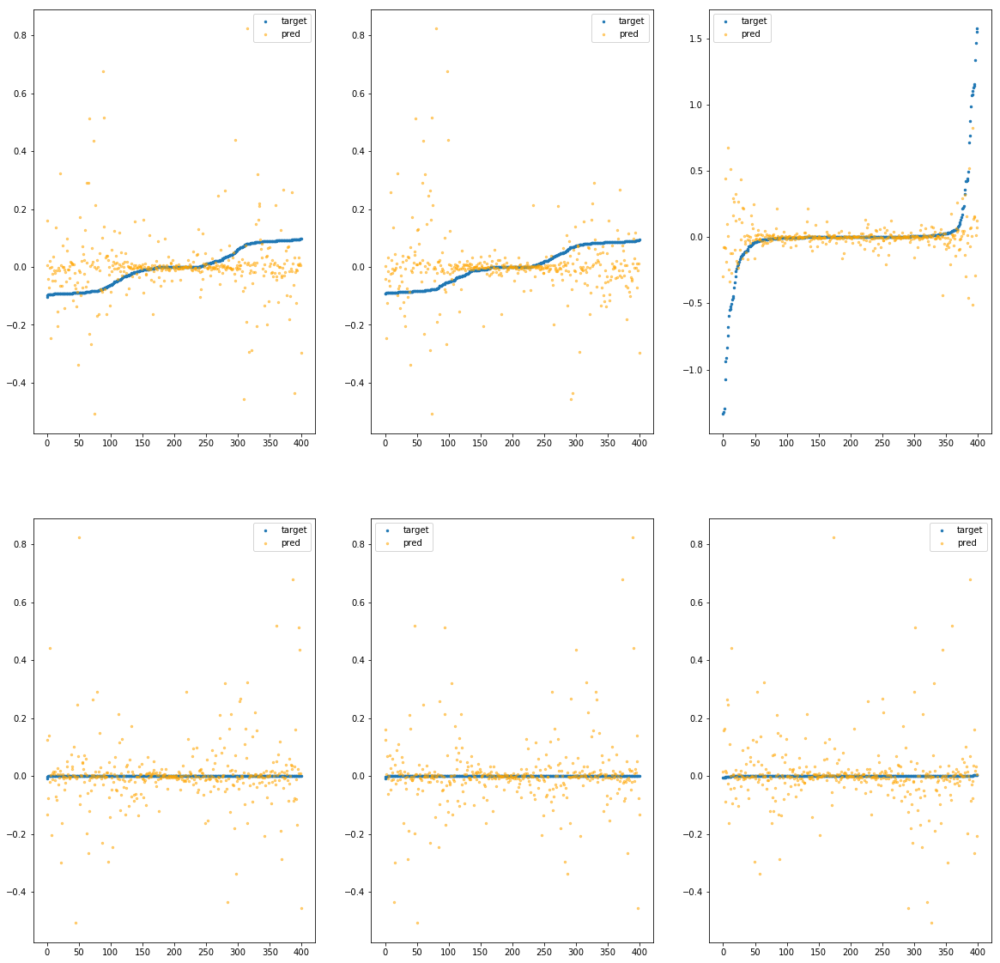

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01dc0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.56e+00	9.61e-01	8.26e-02	1.93e+04	1.87e-02	3.49e-04
y		-3.39e+00	8.05e-01	8.02e-02	5.35e+02	1.68e-02	2.83e-04
z		-2.20e-01	1.96e+00	1.24e-01	9.97e+02	1.02e-01	1.03e-02
phi		-3.84e+04	8.81e-01	5.47e-02	3.91e+06	1.39e-02	1.93e-04
theta		-4.50e+04	8.82e-01	5.47e-02	4.85e+05	1.39e-02	1.94e-04
psi		-1.86e+04	8.81e-01	5.47e-02	3.64e+06	1.39e-02	1.94e-04


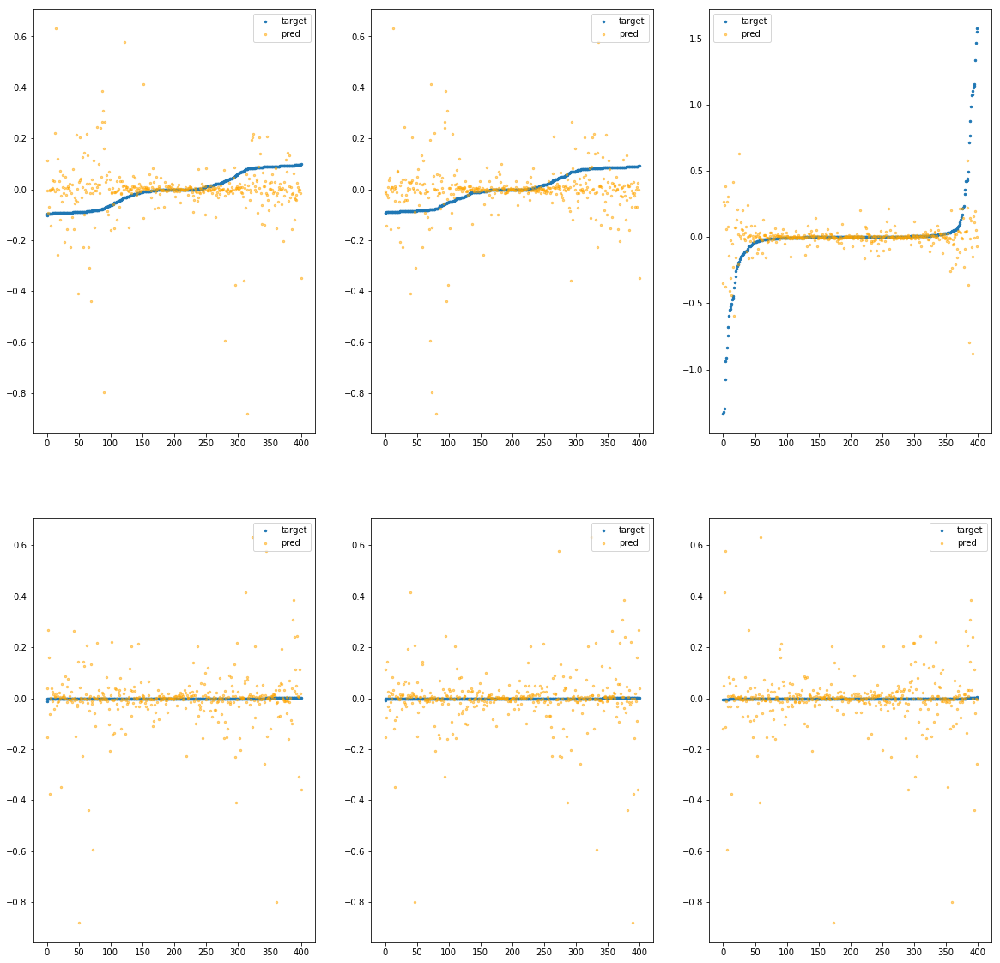

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01e20>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.27e+00	7.77e-01	8.46e-02	2.01e+04	1.75e-02	3.05e-04
y		-3.06e+00	7.99e-01	7.91e-02	8.22e+02	1.56e-02	2.43e-04
z		-1.18e-01	2.01e+00	1.22e-01	9.51e+02	9.32e-02	8.68e-03
phi		-3.36e+04	8.55e-01	5.57e-02	4.58e+06	1.22e-02	1.48e-04
theta		-3.94e+04	8.54e-01	5.56e-02	9.45e+05	1.22e-02	1.48e-04
psi		-1.62e+04	8.55e-01	5.56e-02	3.24e+06	1.22e-02	1.48e-04


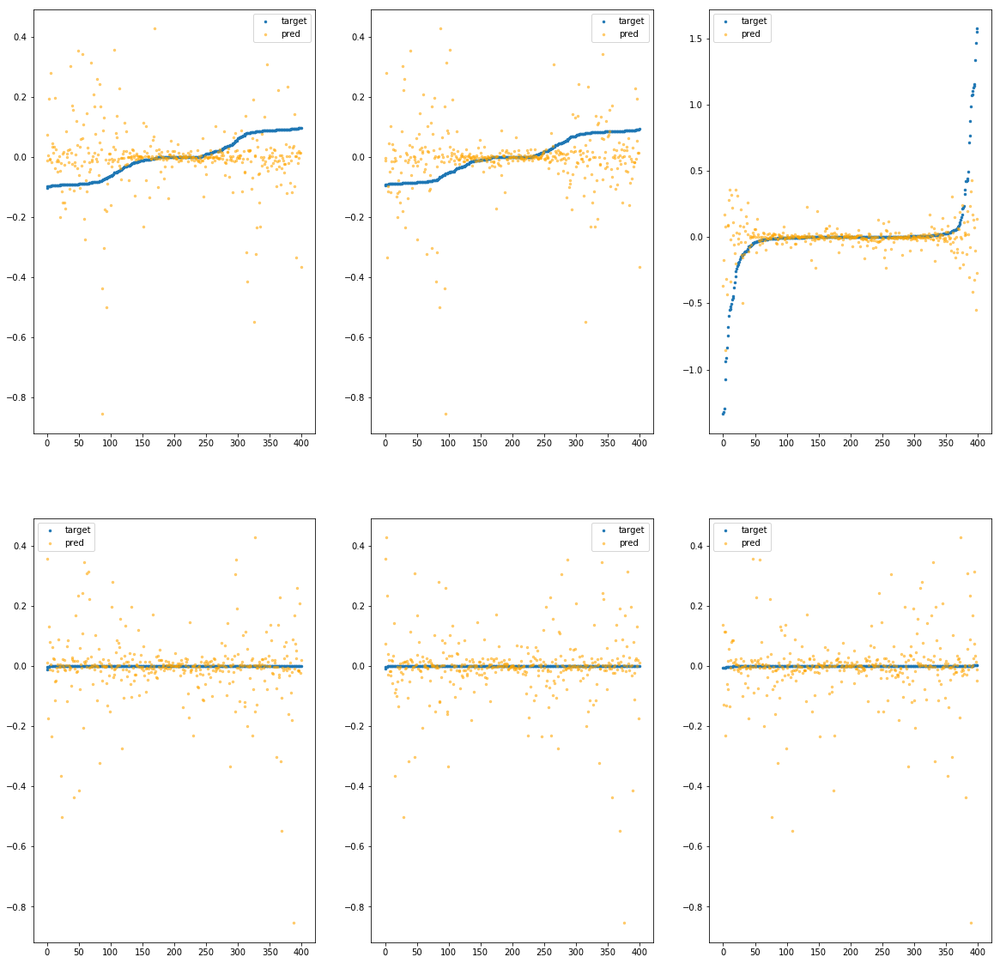

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01e80>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.04e+00	5.72e-01	6.40e-02	9.61e+03	8.34e-03	6.95e-05
y		-1.08e+00	5.68e-01	6.06e-02	3.27e+02	7.99e-03	6.39e-05
z		-4.09e-03	1.47e+00	1.10e-01	3.46e+02	8.37e-02	7.00e-03
phi		-1.14e+04	4.85e-01	2.94e-02	2.19e+06	4.14e-03	1.72e-05
theta		-1.34e+04	4.85e-01	2.94e-02	2.86e+05	4.15e-03	1.72e-05
psi		-5.49e+03	4.85e-01	2.94e-02	1.19e+06	4.12e-03	1.69e-05


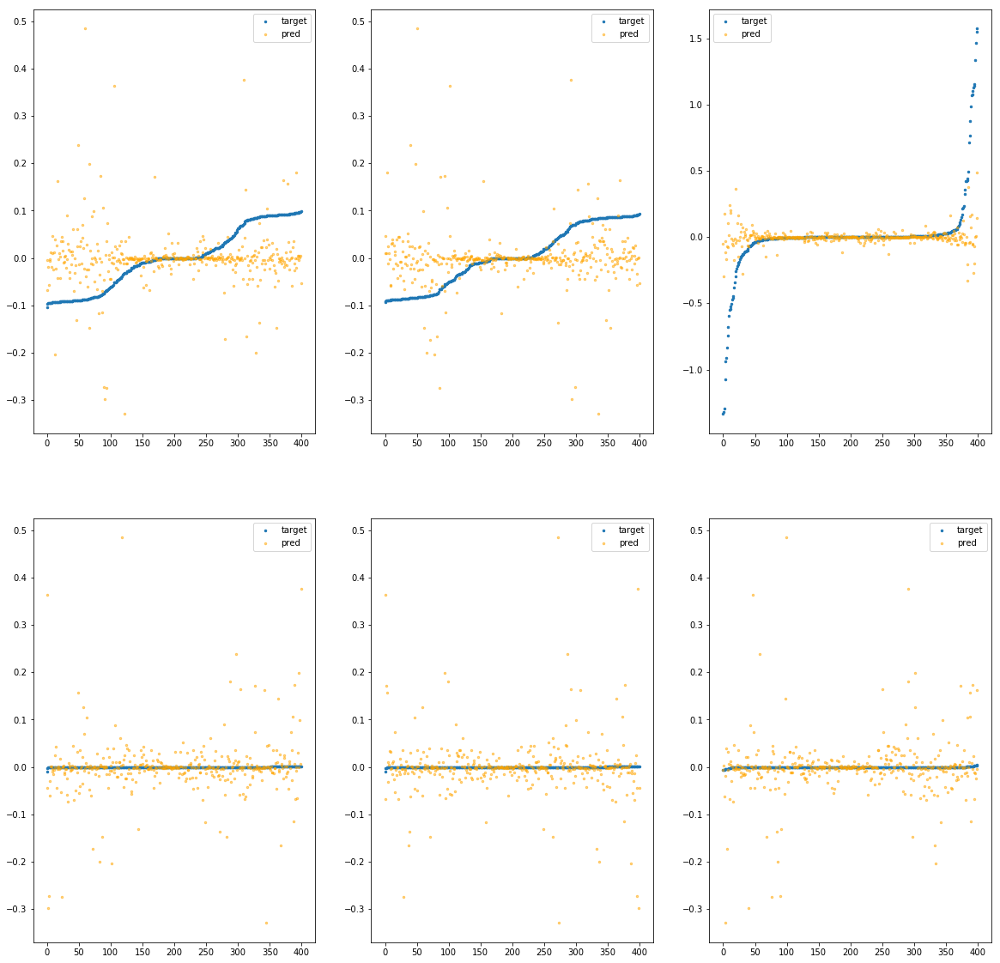

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01ee0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.54e+00	7.22e-01	7.41e-02	1.81e+04	1.45e-02	2.10e-04
y		-2.44e+00	7.04e-01	7.20e-02	3.12e+02	1.32e-02	1.74e-04
z		-6.77e-02	1.76e+00	1.15e-01	5.13e+02	8.90e-02	7.91e-03
phi		-2.49e+04	6.45e-01	4.30e-02	2.73e+06	9.02e-03	8.14e-05
theta		-2.93e+04	6.45e-01	4.30e-02	5.26e+05	9.04e-03	8.16e-05
psi		-1.20e+04	6.45e-01	4.31e-02	1.74e+06	9.03e-03	8.15e-05


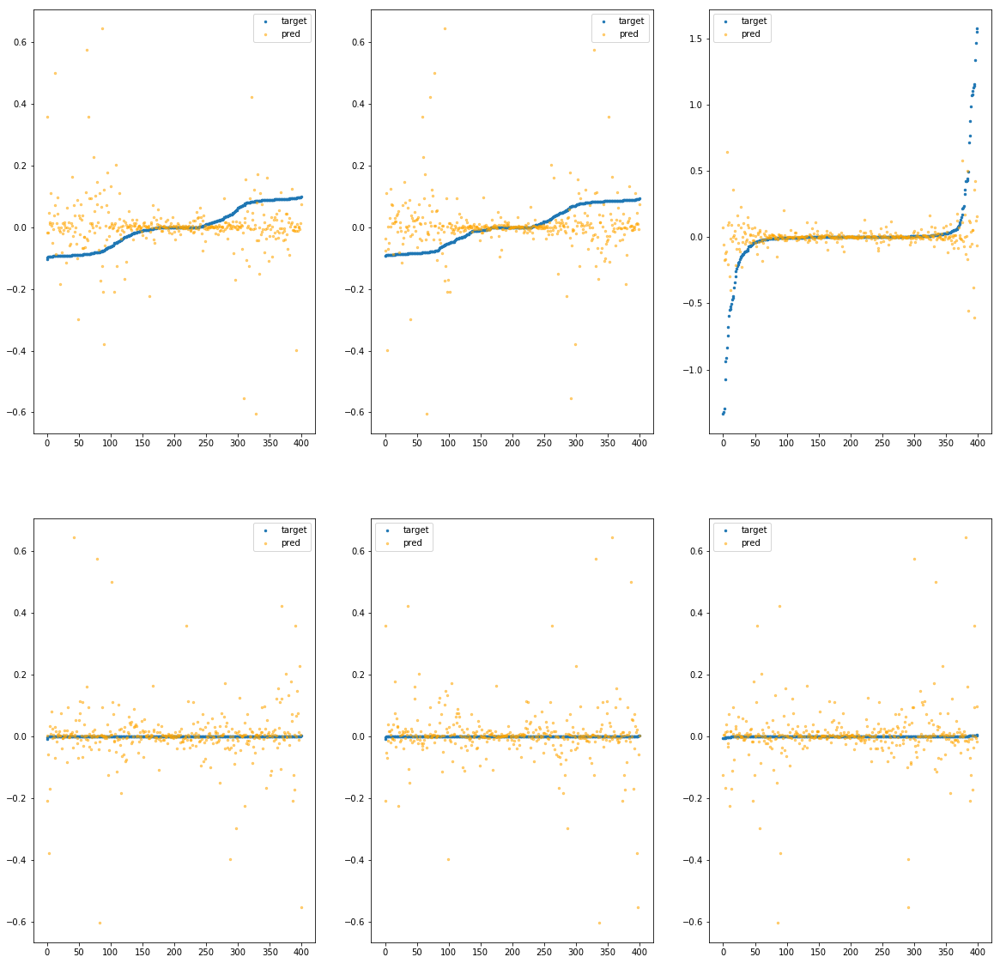

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01f40>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.09e+00	6.15e-01	7.55e-02	1.60e+04	1.27e-02	1.60e-04
y		-2.08e+00	6.11e-01	7.13e-02	1.08e+03	1.18e-02	1.39e-04
z		-9.62e-02	1.87e+00	1.13e-01	8.52e+02	9.13e-02	8.34e-03
phi		-2.10e+04	5.33e-01	4.33e-02	3.56e+06	7.59e-03	5.76e-05
theta		-2.46e+04	5.33e-01	4.33e-02	1.12e+06	7.59e-03	5.77e-05
psi		-1.01e+04	5.32e-01	4.34e-02	1.56e+06	7.61e-03	5.79e-05


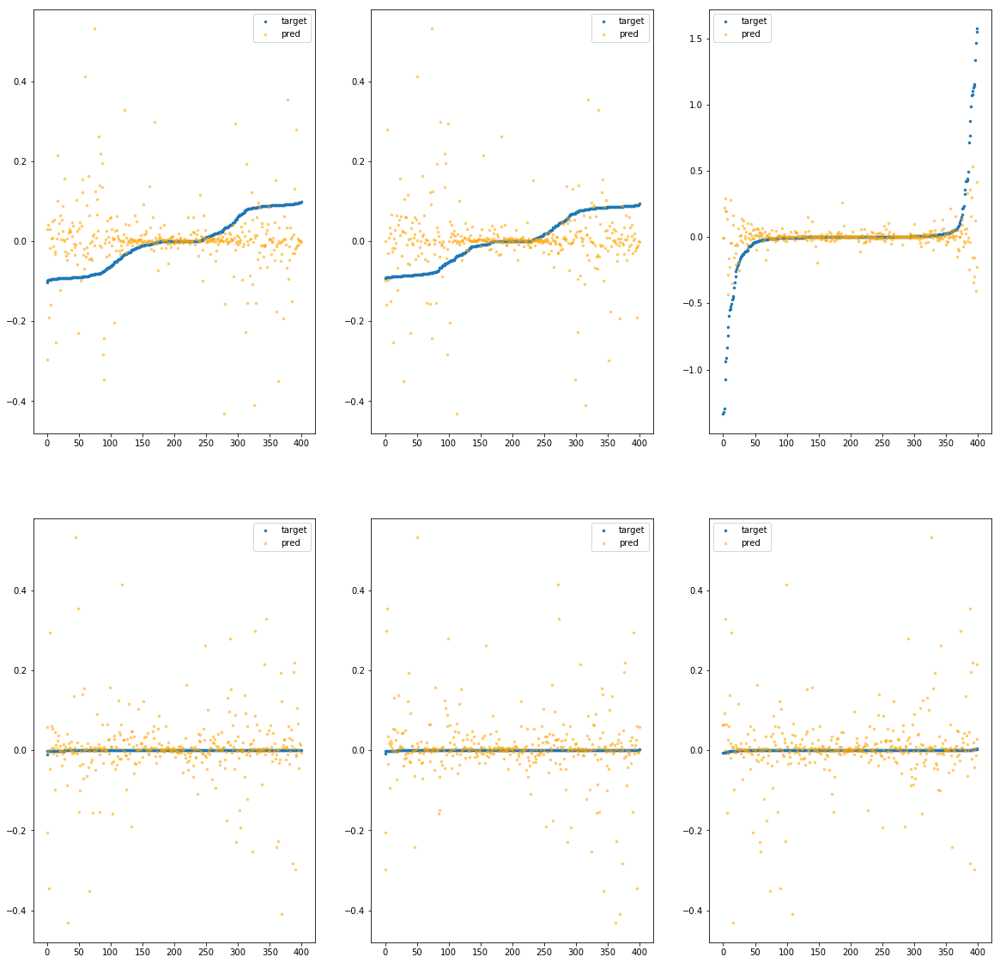

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f01fa0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.90e+00	5.75e-01	7.29e-02	1.04e+04	1.19e-02	1.41e-04
y		-2.28e+00	5.71e-01	7.19e-02	8.05e+02	1.26e-02	1.58e-04
z		-1.35e-01	1.76e+00	1.16e-01	5.98e+02	9.46e-02	8.94e-03
phi		-1.99e+04	4.87e-01	4.01e-02	3.13e+06	7.20e-03	5.19e-05
theta		-2.33e+04	4.87e-01	4.01e-02	7.99e+05	7.21e-03	5.20e-05
psi		-9.60e+03	4.87e-01	4.01e-02	2.86e+06	7.20e-03	5.18e-05


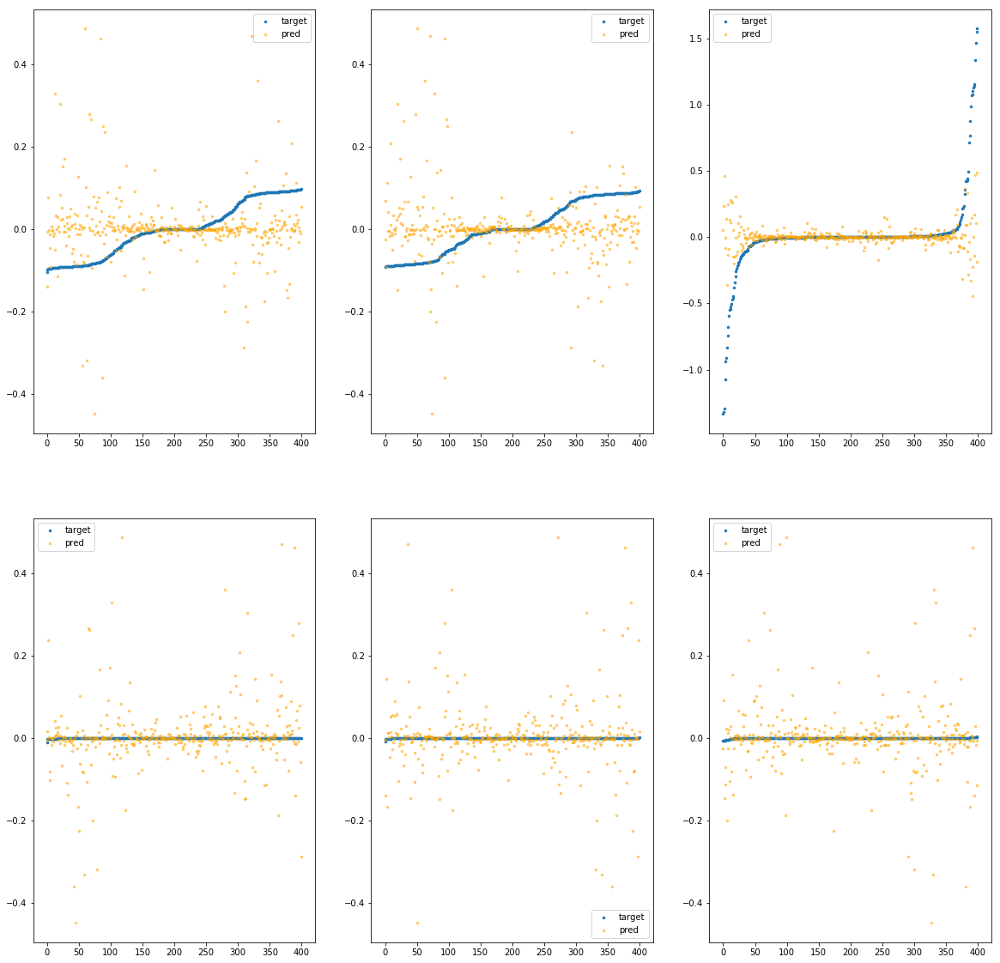

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f0c040>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.97e+00	4.54e-01	7.59e-02	1.67e+04	1.22e-02	1.48e-04
y		-2.11e+00	4.60e-01	7.31e-02	5.60e+02	1.19e-02	1.42e-04
z		-1.25e-01	1.70e+00	1.22e-01	8.26e+02	9.37e-02	8.78e-03
phi		-2.46e+04	4.36e-01	4.94e-02	3.86e+06	8.90e-03	7.93e-05
theta		-2.88e+04	4.36e-01	4.94e-02	9.60e+05	8.90e-03	7.93e-05
psi		-1.19e+04	4.37e-01	4.94e-02	3.40e+06	8.92e-03	7.96e-05


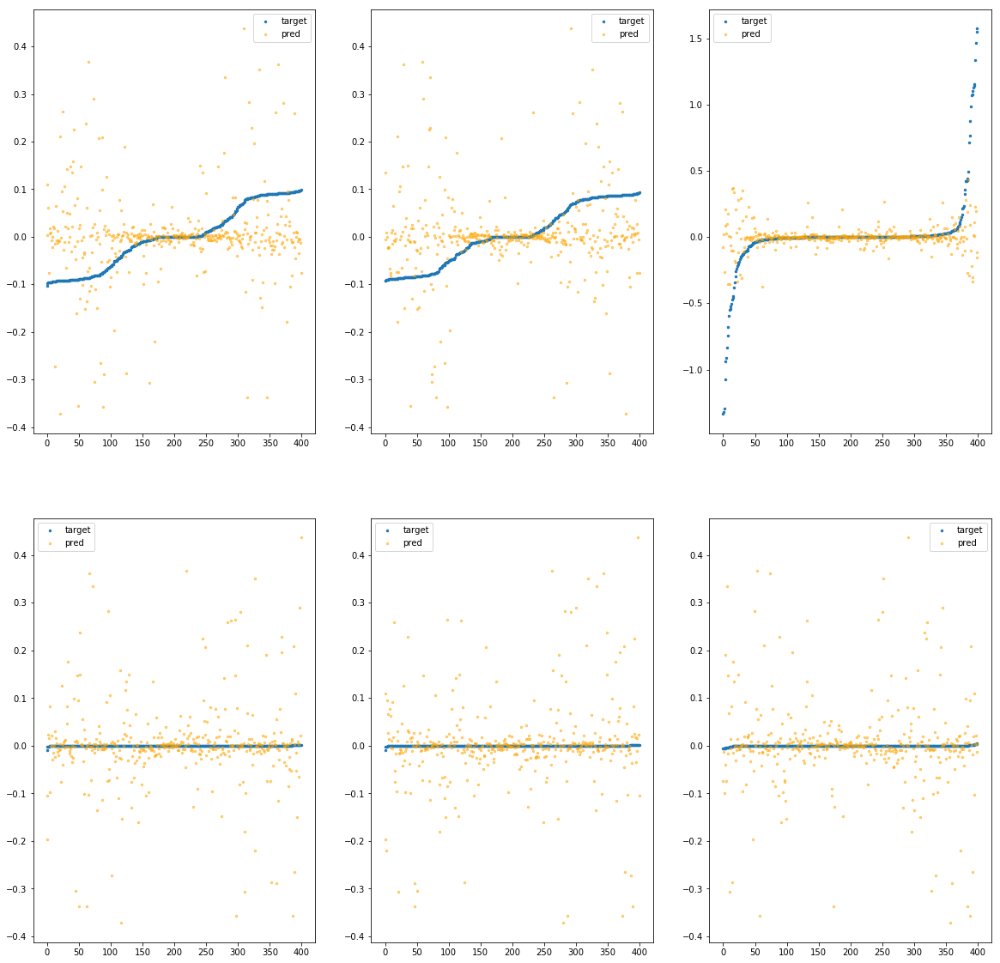

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f0c0a0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e+00	4.66e-01	6.44e-02	7.36e+03	8.41e-03	7.07e-05
y		-1.24e+00	4.73e-01	6.19e-02	6.75e+02	8.60e-03	7.40e-05
z		-1.96e-02	1.87e+00	1.09e-01	4.25e+02	8.50e-02	7.22e-03
phi		-1.22e+04	4.22e-01	3.22e-02	2.11e+06	4.41e-03	1.94e-05
theta		-1.43e+04	4.20e-01	3.21e-02	5.04e+05	4.41e-03	1.94e-05
psi		-5.88e+03	4.22e-01	3.22e-02	1.88e+06	4.41e-03	1.95e-05


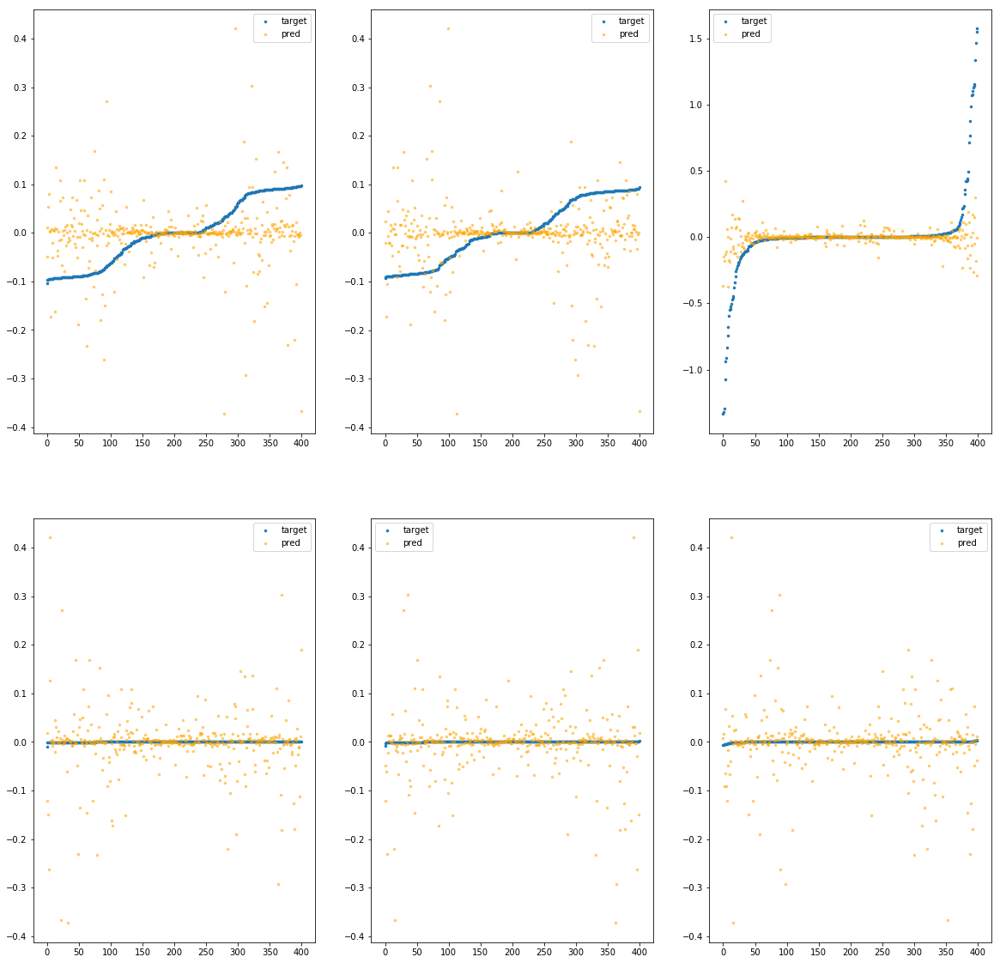

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f0c100>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.00e+00	4.05e-01	6.43e-02	1.03e+04	8.20e-03	6.73e-05
y		-1.16e+00	3.90e-01	6.49e-02	3.79e+02	8.30e-03	6.88e-05
z		-1.13e-01	1.65e+00	1.13e-01	5.20e+02	9.28e-02	8.60e-03
phi		-1.22e+04	4.27e-01	3.30e-02	1.78e+06	4.42e-03	1.95e-05
theta		-1.43e+04	4.27e-01	3.30e-02	5.16e+05	4.43e-03	1.96e-05
psi		-5.88e+03	4.28e-01	3.30e-02	1.10e+06	4.41e-03	1.95e-05


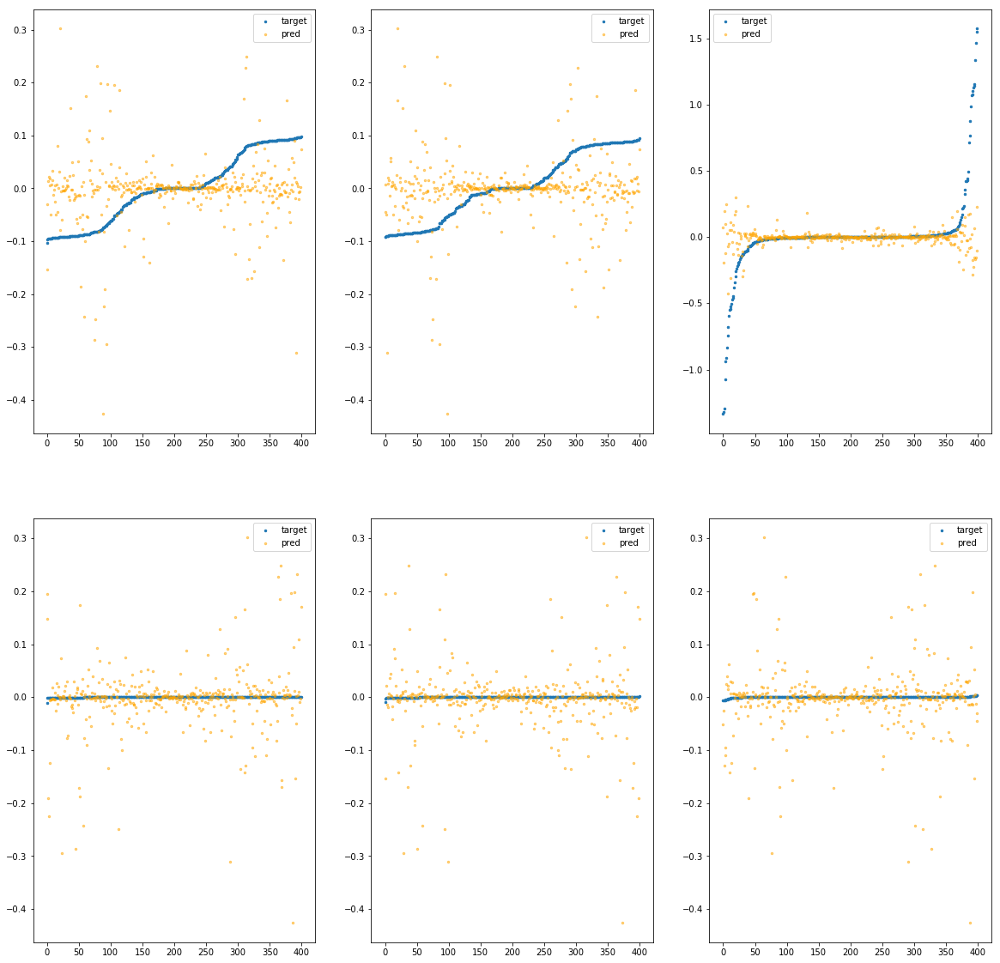

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f0c160>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.56e+00	5.40e-01	6.93e-02	1.39e+04	1.05e-02	1.10e-04
y		-1.32e+00	5.36e-01	6.51e-02	1.26e+03	8.89e-03	7.91e-05
z		-7.36e-03	1.66e+00	1.10e-01	6.89e+02	8.39e-02	7.04e-03
phi		-1.71e+04	5.33e-01	3.86e-02	3.57e+06	6.20e-03	3.84e-05
theta		-2.01e+04	5.33e-01	3.86e-02	8.92e+05	6.20e-03	3.84e-05
psi		-8.25e+03	5.33e-01	3.85e-02	2.12e+06	6.19e-03	3.83e-05


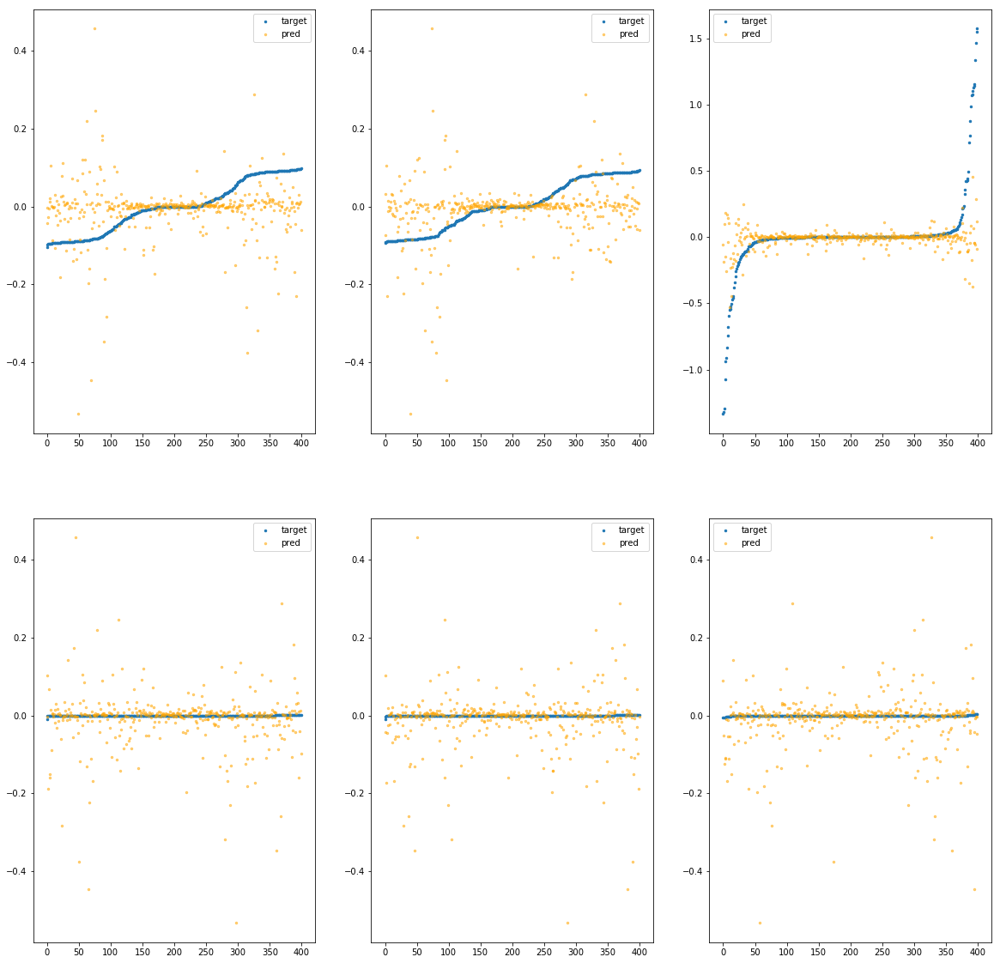

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f0c1c0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.00e+00	5.37e-01	7.20e-02	1.19e+04	1.23e-02	1.51e-04
y		-1.99e+00	5.87e-01	7.02e-02	4.09e+02	1.15e-02	1.32e-04
z		-3.67e-02	1.93e+00	1.13e-01	5.09e+02	8.64e-02	7.46e-03
phi		-1.98e+04	5.12e-01	3.91e-02	2.40e+06	7.17e-03	5.15e-05
theta		-2.32e+04	5.12e-01	3.91e-02	5.54e+05	7.18e-03	5.16e-05
psi		-9.56e+03	5.12e-01	3.91e-02	2.05e+06	7.17e-03	5.14e-05


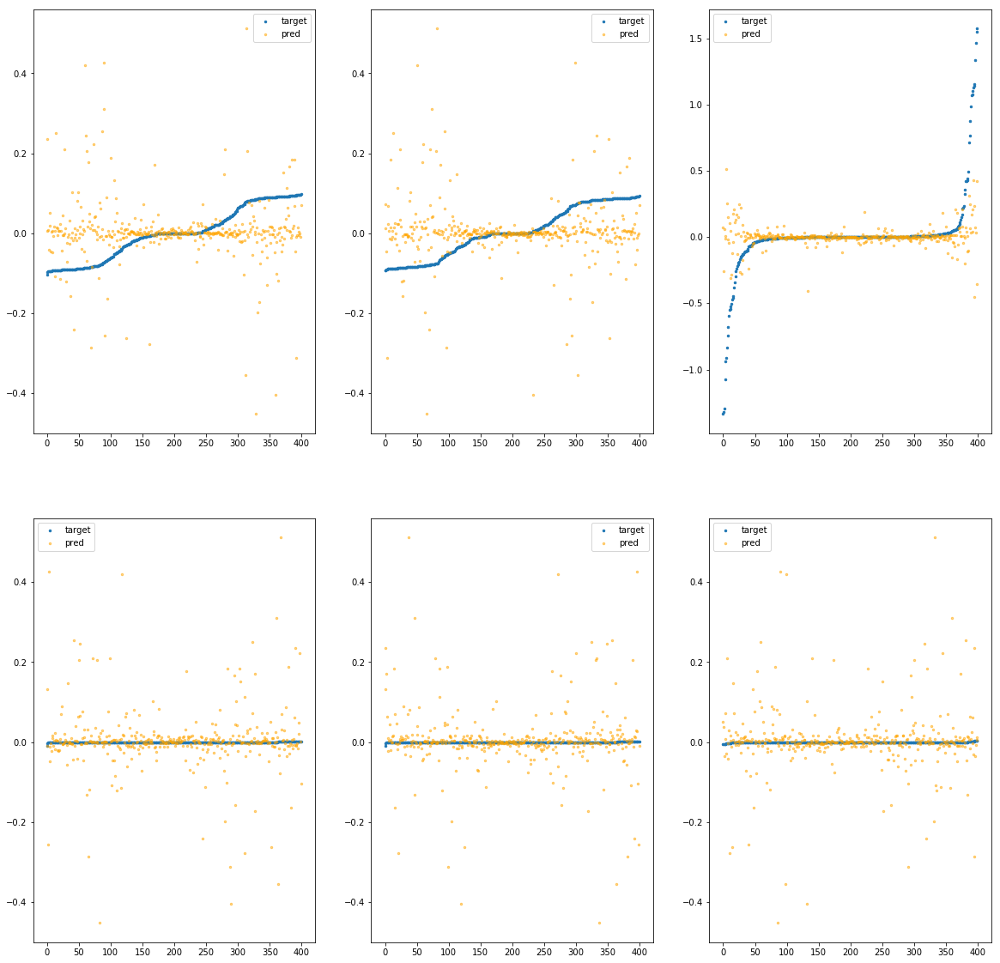

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f0c220>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.23e+00	1.01e+00	8.10e-02	1.02e+04	1.73e-02	3.00e-04
y		-2.85e+00	8.67e-01	7.43e-02	7.98e+02	1.48e-02	2.18e-04
z		-1.59e-01	2.00e+00	1.18e-01	8.26e+02	9.65e-02	9.32e-03
phi		-3.57e+04	9.38e-01	5.03e-02	2.52e+06	1.29e-02	1.67e-04
theta		-4.19e+04	9.36e-01	5.03e-02	7.47e+05	1.29e-02	1.67e-04
psi		-1.73e+04	9.37e-01	5.04e-02	1.66e+06	1.29e-02	1.67e-04


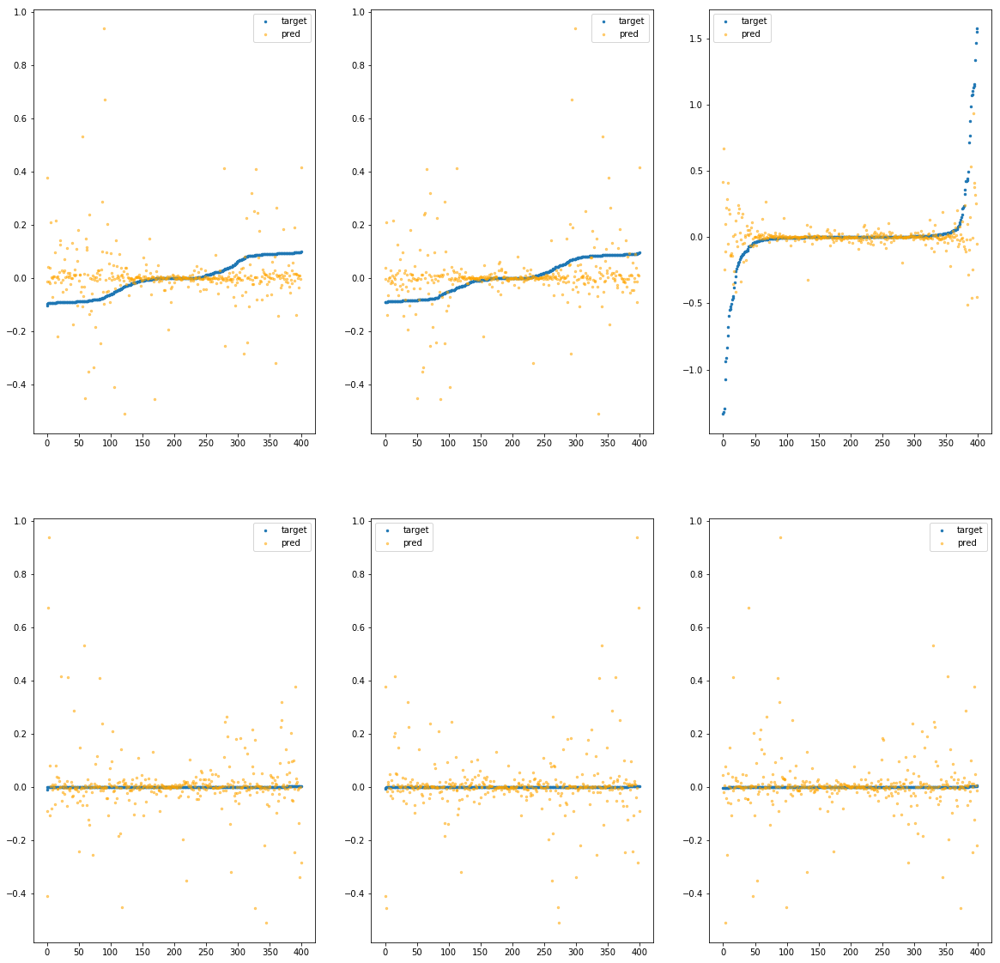

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c280>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.99e-01	4.23e-01	5.71e-02	9.24e+03	6.14e-03	3.77e-05
y		-4.61e-01	2.83e-01	5.67e-02	8.10e+02	5.60e-03	3.14e-05
z		-4.01e-02	1.67e+00	1.07e-01	5.46e+02	8.67e-02	7.51e-03
phi		-5.89e+03	3.49e-01	2.41e-02	9.69e+05	2.13e-03	4.55e-06
theta		-6.88e+03	3.47e-01	2.41e-02	1.08e+06	2.12e-03	4.51e-06
psi		-2.86e+03	3.48e-01	2.42e-02	2.32e+06	2.15e-03	4.60e-06


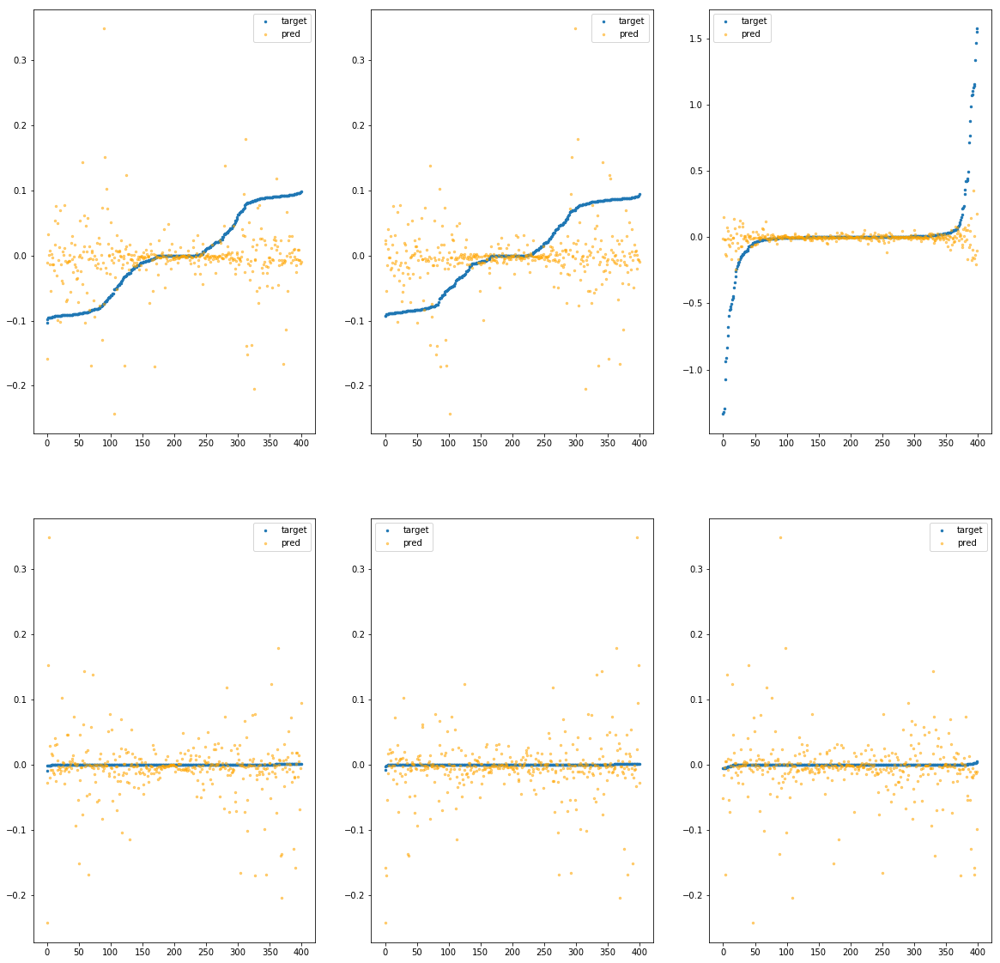

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c2e0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.69e-01	2.85e-01	5.45e-02	3.98e+03	5.20e-03	2.70e-05
y		-3.21e-01	2.44e-01	5.52e-02	5.14e+02	5.06e-03	2.56e-05
z		-1.46e-02	1.81e+00	1.08e-01	2.85e+02	8.45e-02	7.15e-03
phi		-4.38e+03	2.66e-01	1.97e-02	6.58e+05	1.59e-03	2.51e-06
theta		-5.14e+03	2.65e-01	1.97e-02	3.60e+05	1.59e-03	2.52e-06
psi		-2.11e+03	2.65e-01	1.97e-02	8.58e+05	1.58e-03	2.50e-06


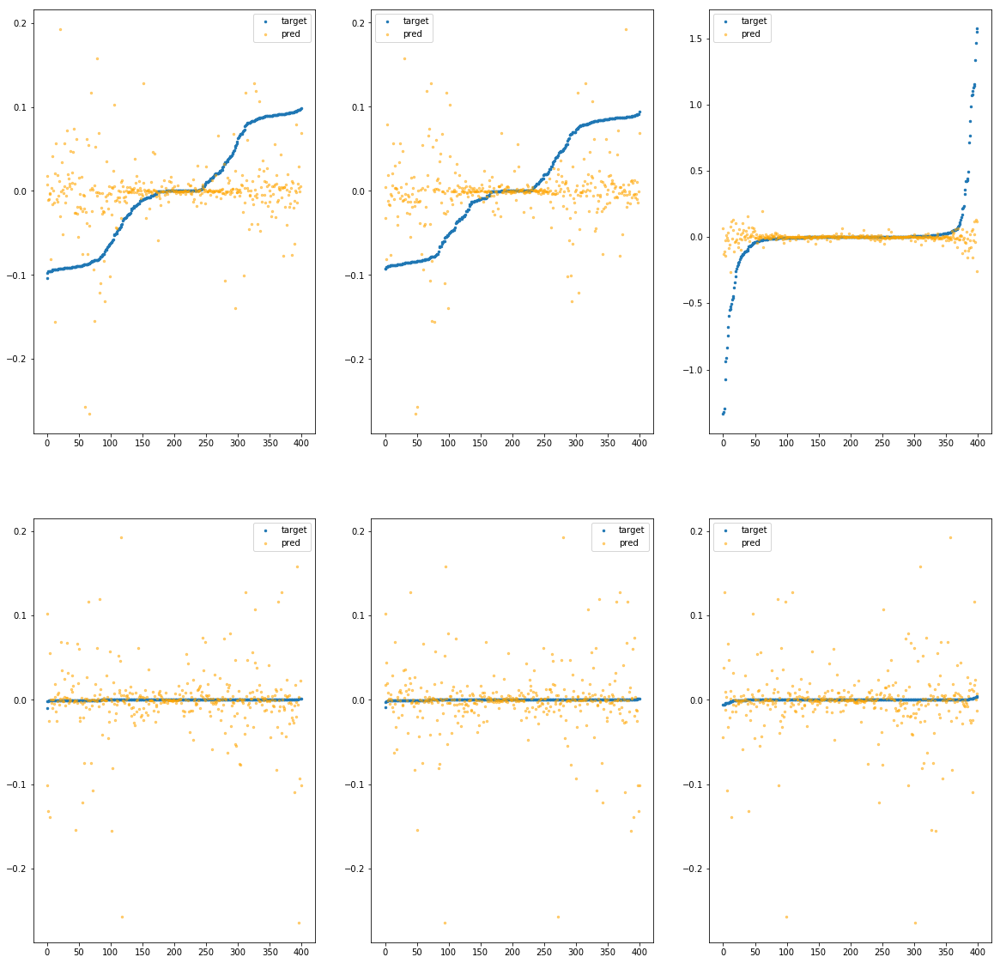

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c340>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.76e-01	3.78e-01	6.25e-02	5.40e+03	6.86e-03	4.71e-05
y		-4.80e-01	3.56e-01	5.57e-02	3.28e+02	5.67e-03	3.22e-05
z		9.87e-03	1.67e+00	1.05e-01	3.84e+02	8.25e-02	6.81e-03
phi		-7.52e+03	3.17e-01	2.66e-02	1.31e+06	2.72e-03	7.42e-06
theta		-8.84e+03	3.17e-01	2.66e-02	3.78e+05	2.73e-03	7.46e-06
psi		-3.65e+03	3.18e-01	2.67e-02	1.35e+06	2.74e-03	7.49e-06


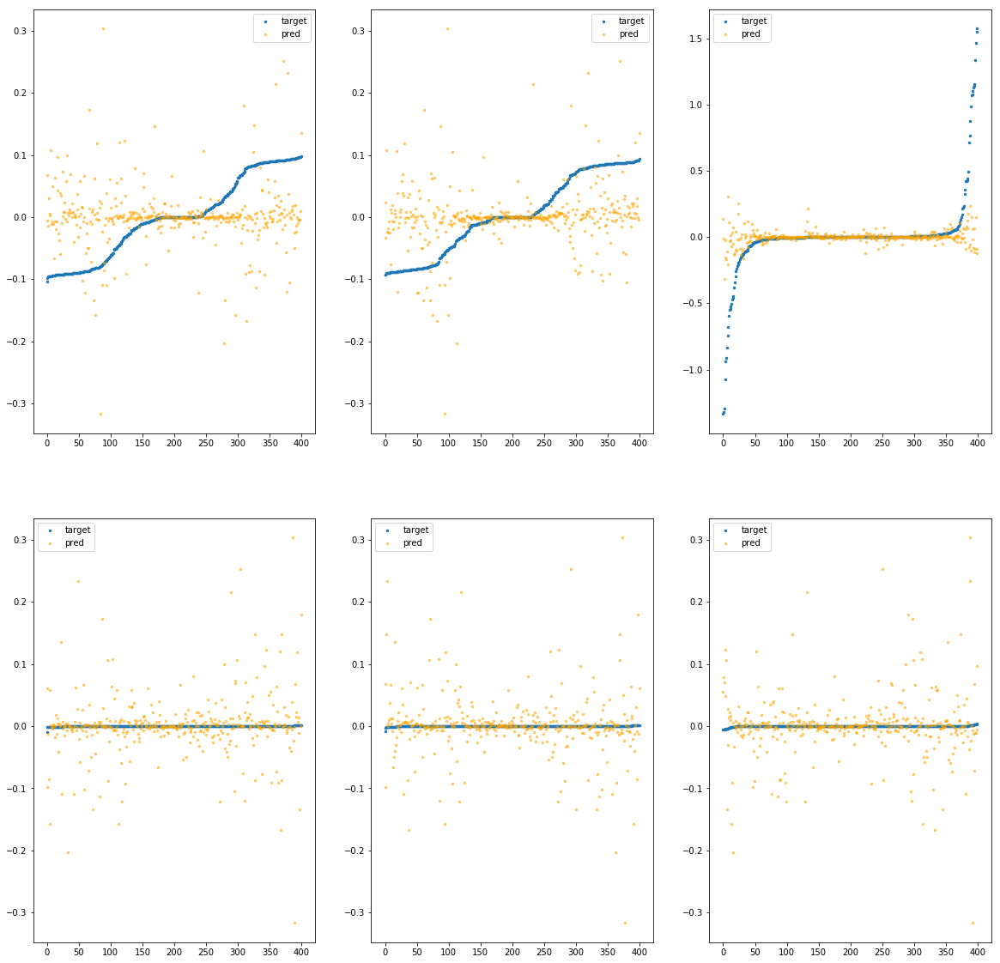

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c3a0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.29e+00	7.28e-01	6.57e-02	1.17e+04	9.36e-03	8.76e-05
y		-1.56e+00	7.24e-01	6.52e-02	7.57e+02	9.83e-03	9.66e-05
z		-9.50e-02	1.69e+00	1.17e-01	7.23e+02	9.12e-02	8.32e-03
phi		-1.57e+04	6.57e-01	3.77e-02	1.41e+06	5.69e-03	3.24e-05
theta		-1.85e+04	6.57e-01	3.78e-02	5.02e+05	5.70e-03	3.25e-05
psi		-7.58e+03	6.56e-01	3.78e-02	2.37e+06	5.69e-03	3.24e-05


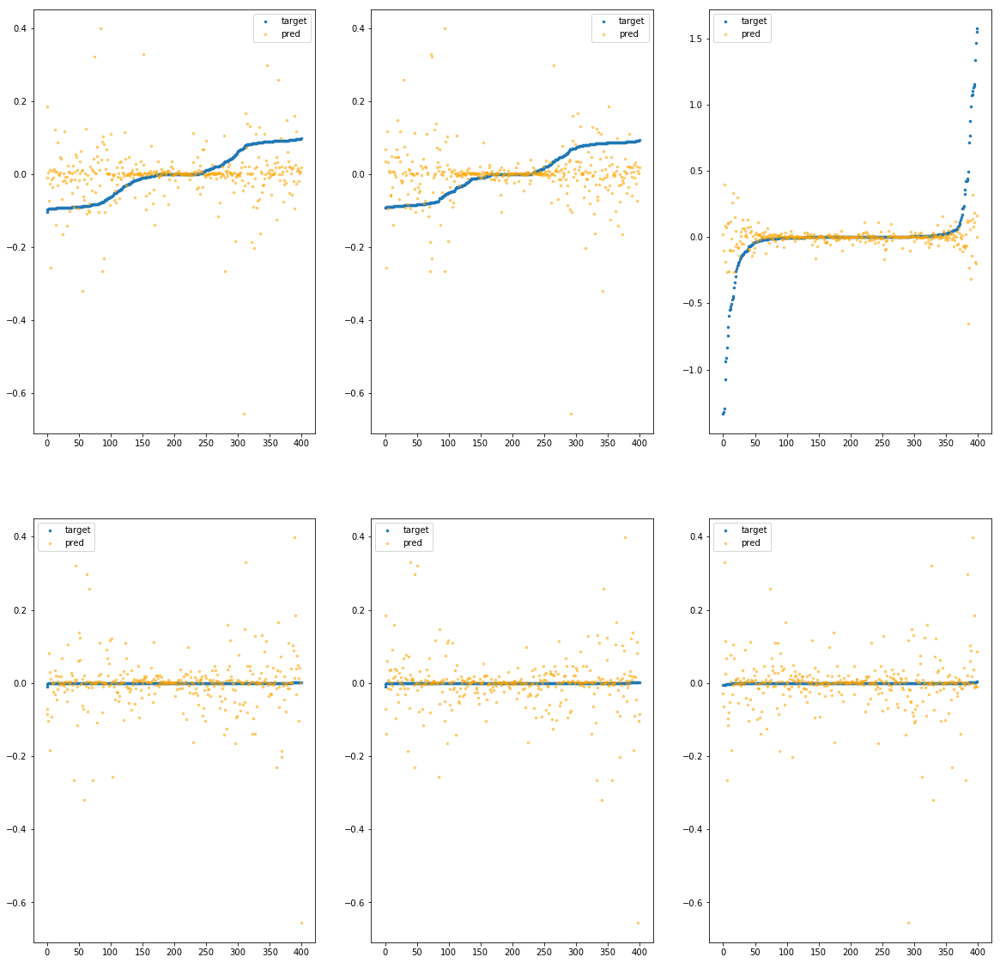

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c400>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.69e-01	5.34e-01	5.74e-02	6.81e+03	6.83e-03	4.67e-05
y		-9.03e-01	5.30e-01	6.04e-02	3.87e+02	7.30e-03	5.32e-05
z		-3.89e-02	1.62e+00	1.11e-01	4.14e+02	8.66e-02	7.49e-03
phi		-9.45e+03	4.47e-01	2.86e-02	1.78e+06	3.42e-03	1.17e-05
theta		-1.11e+04	4.47e-01	2.85e-02	4.87e+05	3.42e-03	1.17e-05
psi		-4.56e+03	4.47e-01	2.85e-02	2.38e+06	3.42e-03	1.17e-05


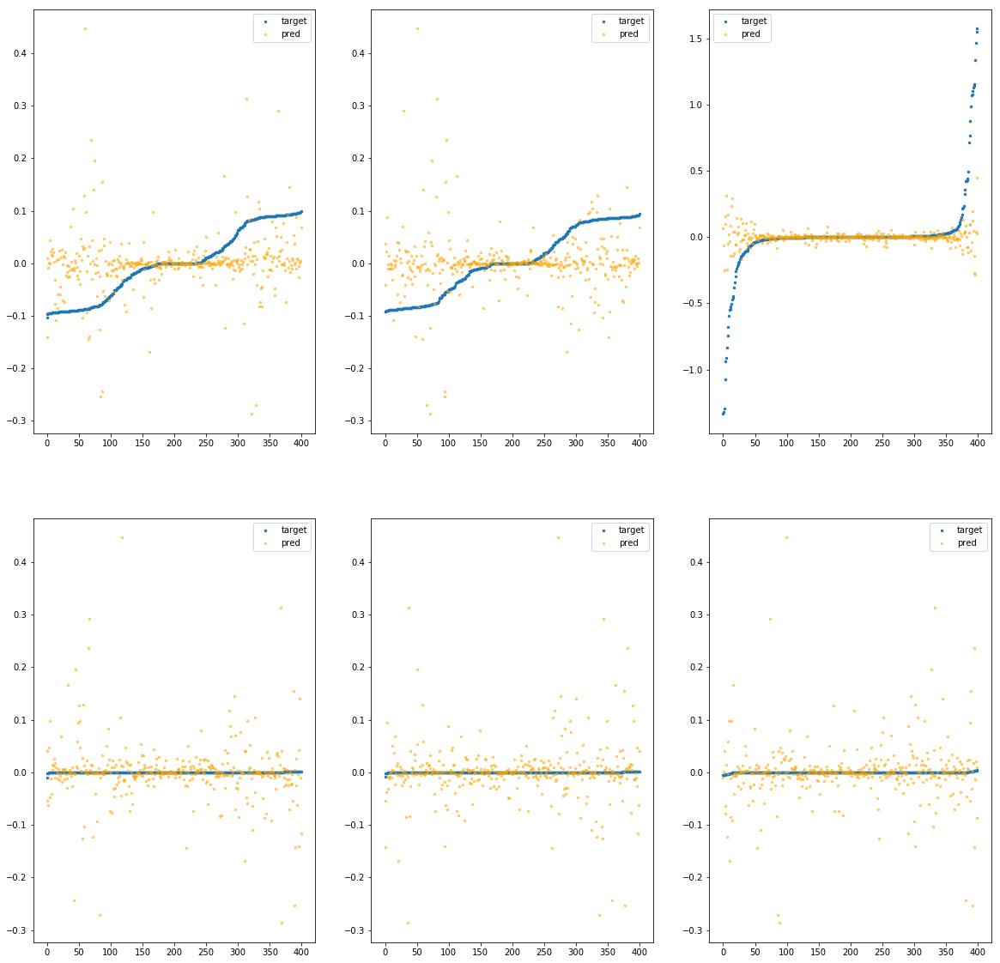

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c460>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.76e-02	1.69e-01	5.27e-02	3.63e+03	4.37e-03	1.91e-05
y		-1.40e-01	2.02e-01	5.32e-02	2.25e+02	4.37e-03	1.91e-05
z		4.55e-03	1.60e+00	1.04e-01	1.84e+02	8.29e-02	6.88e-03
phi		-9.95e+02	1.23e-01	9.74e-03	7.58e+05	3.60e-04	1.30e-07
theta		-1.17e+03	1.23e-01	9.73e-03	2.04e+05	3.61e-04	1.30e-07
psi		-4.79e+02	1.23e-01	9.71e-03	6.85e+05	3.60e-04	1.30e-07


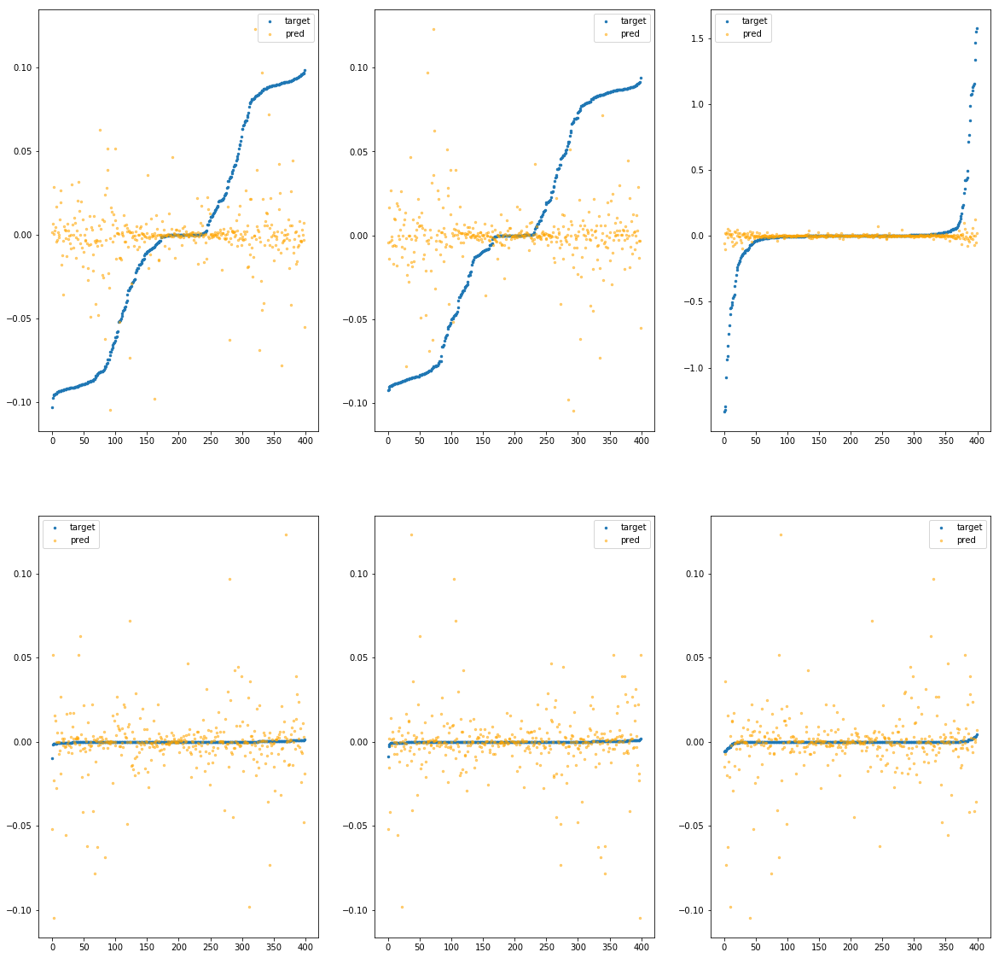

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c4c0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.70e-01	3.82e-01	5.58e-02	6.63e+03	5.61e-03	3.14e-05
y		-3.77e-01	2.94e-01	5.51e-02	5.54e+02	5.28e-03	2.79e-05
z		-6.87e-02	1.65e+00	1.09e-01	3.76e+02	8.90e-02	7.93e-03
phi		-4.17e+03	2.91e-01	1.93e-02	1.53e+06	1.51e-03	2.28e-06
theta		-4.90e+03	2.91e-01	1.94e-02	4.24e+05	1.51e-03	2.29e-06
psi		-2.01e+03	2.91e-01	1.94e-02	6.13e+05	1.51e-03	2.28e-06


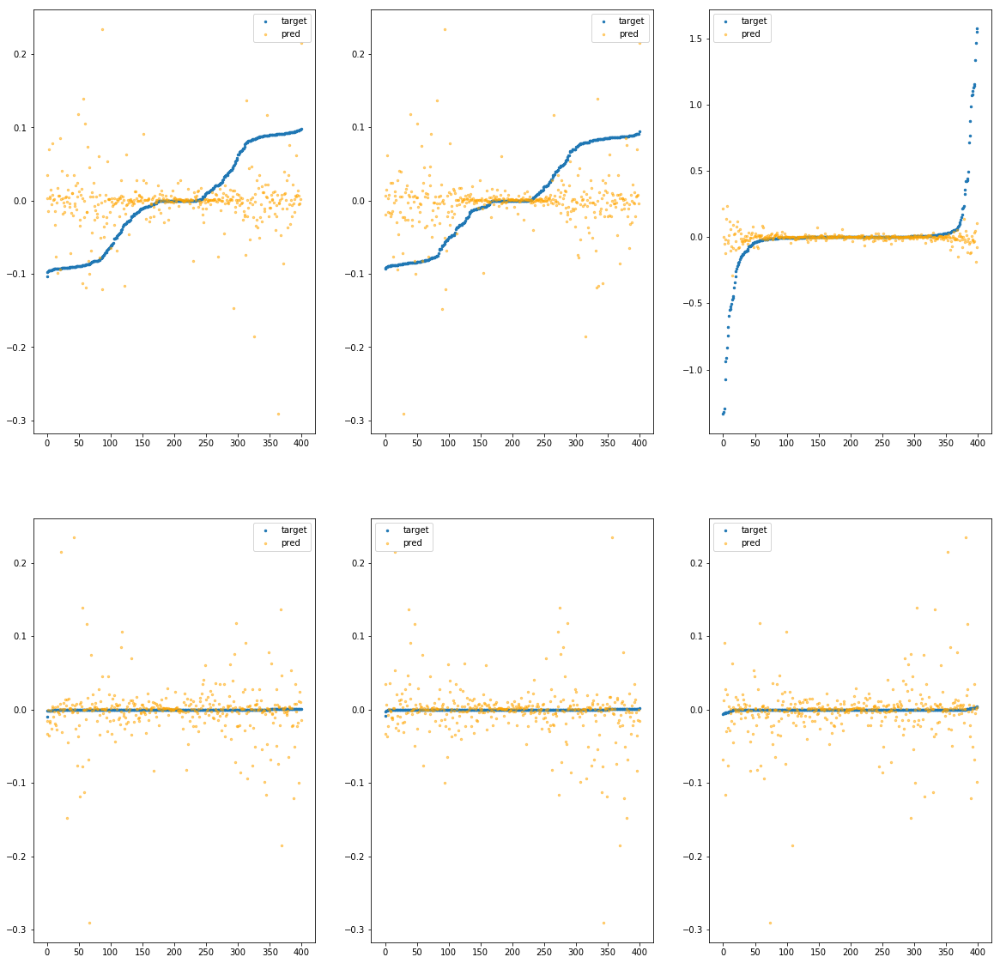

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c520>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.52e-01	2.94e-01	5.68e-02	1.13e+04	5.53e-03	3.06e-05
y		-4.68e-01	3.04e-01	5.73e-02	5.19e+02	5.63e-03	3.17e-05
z		-1.24e-02	1.70e+00	1.08e-01	2.93e+02	8.44e-02	7.12e-03
phi		-4.69e+03	2.36e-01	2.13e-02	2.31e+06	1.70e-03	2.88e-06
theta		-5.49e+03	2.36e-01	2.13e-02	5.54e+05	1.70e-03	2.87e-06
psi		-2.26e+03	2.36e-01	2.12e-02	1.25e+06	1.69e-03	2.87e-06


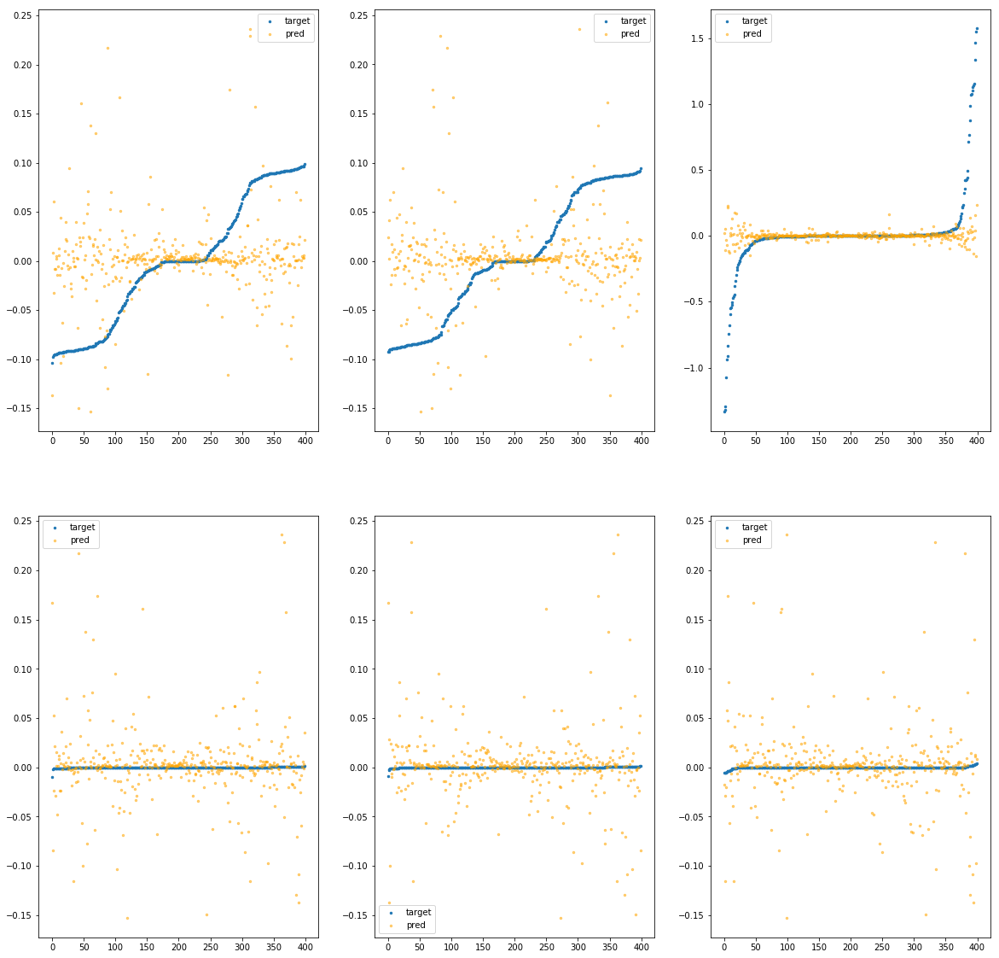

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c580>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.42e+00	5.74e-01	6.63e-02	1.07e+04	9.91e-03	9.81e-05
y		-1.51e+00	5.72e-01	6.52e-02	9.60e+02	9.63e-03	9.27e-05
z		3.53e-02	1.67e+00	1.10e-01	5.64e+02	8.04e-02	6.46e-03
phi		-1.75e+04	5.33e-01	3.75e-02	1.71e+06	6.33e-03	4.00e-05
theta		-2.05e+04	5.31e-01	3.75e-02	1.04e+06	6.32e-03	4.00e-05
psi		-8.39e+03	5.23e-01	3.74e-02	2.24e+06	6.30e-03	3.96e-05


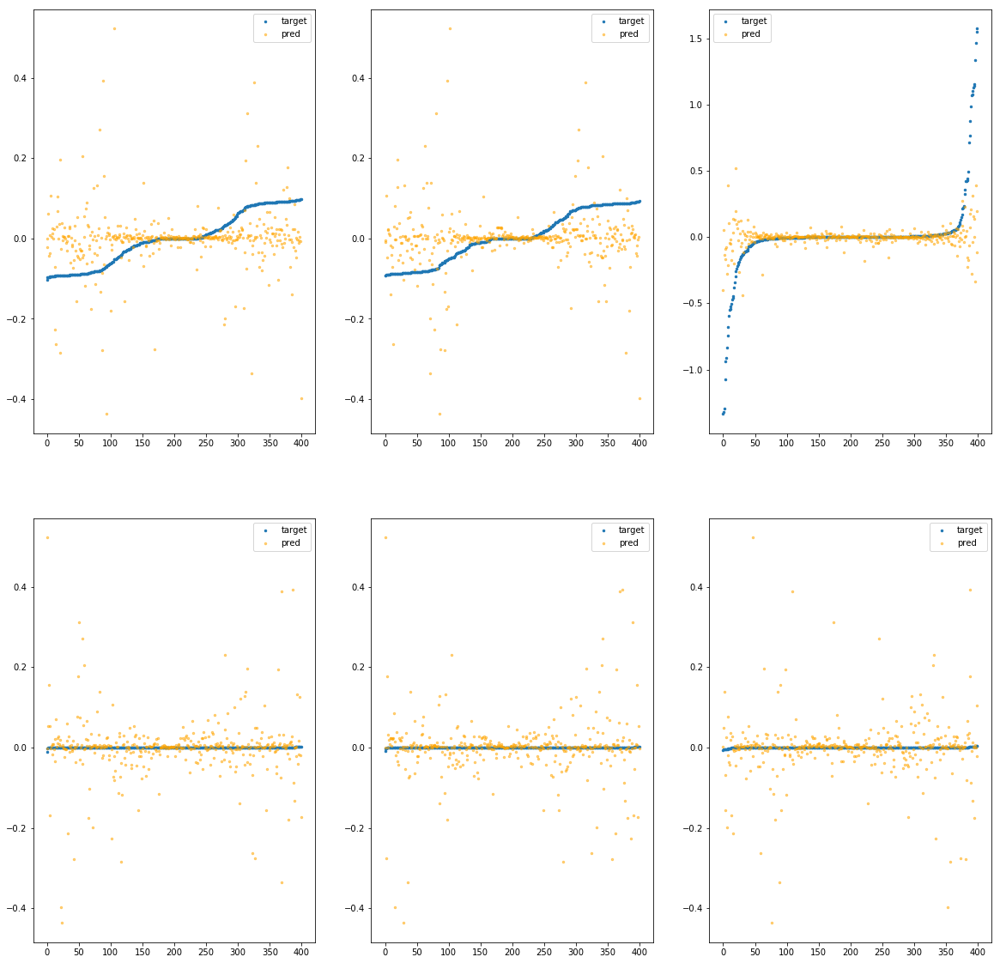

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c5e0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.34e-01	4.83e-01	6.35e-02	8.29e+03	7.92e-03	6.27e-05
y		-1.08e+00	5.62e-01	6.11e-02	2.44e+02	7.98e-03	6.38e-05
z		-5.63e-02	1.70e+00	1.08e-01	4.04e+02	8.80e-02	7.75e-03
phi		-9.91e+03	4.78e-01	2.78e-02	1.83e+06	3.59e-03	1.29e-05
theta		-1.16e+04	4.74e-01	2.78e-02	4.12e+05	3.58e-03	1.28e-05
psi		-4.80e+03	4.79e-01	2.79e-02	2.12e+06	3.60e-03	1.29e-05


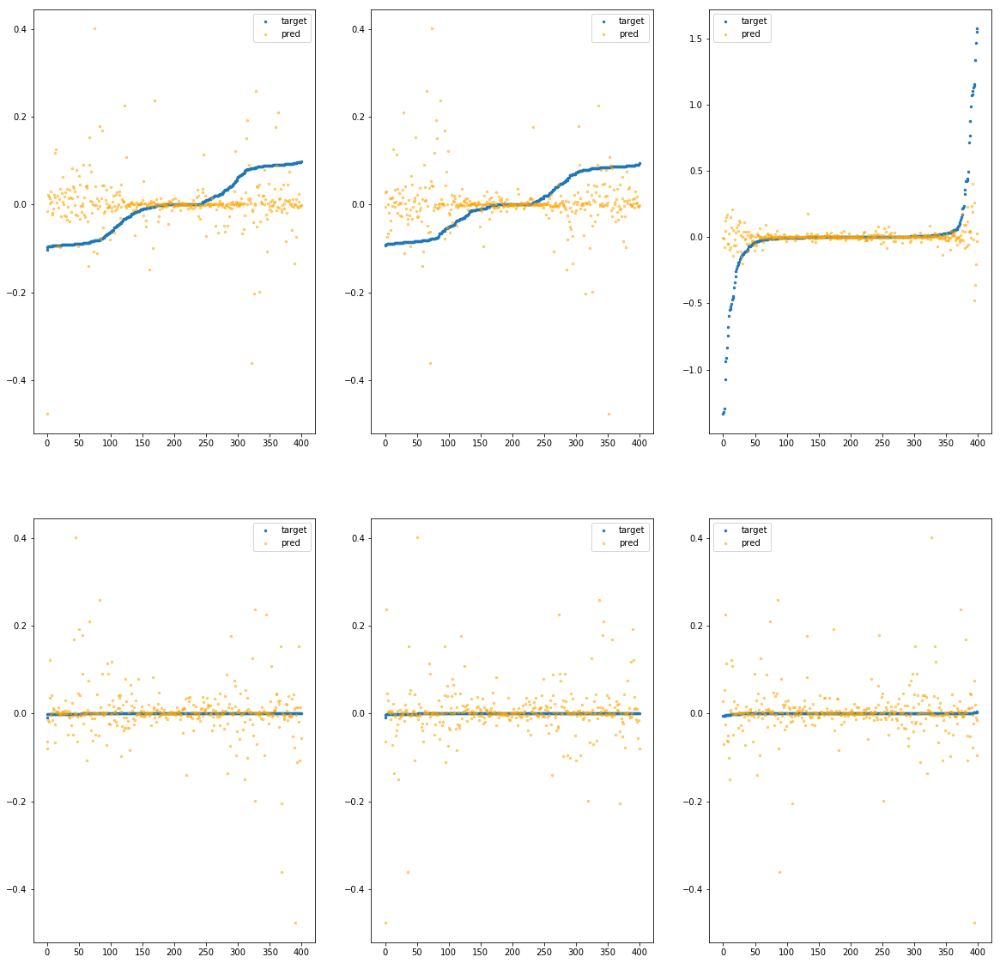

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c640>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.57e-02	1.37e-01	5.22e-02	5.46e+02	4.20e-03	1.76e-05
y		-2.52e-02	1.30e-01	5.16e-02	3.93e+01	3.93e-03	1.55e-05
z		-5.25e-03	1.59e+00	1.02e-01	4.40e+01	8.38e-02	7.01e-03
phi		-1.40e+02	5.16e-02	3.35e-03	1.98e+05	5.10e-05	2.60e-09
theta		-1.67e+02	5.20e-02	3.37e-03	3.70e+04	5.18e-05	2.69e-09
psi		-7.06e+01	5.68e-02	3.42e-03	2.20e+05	5.37e-05	2.89e-09


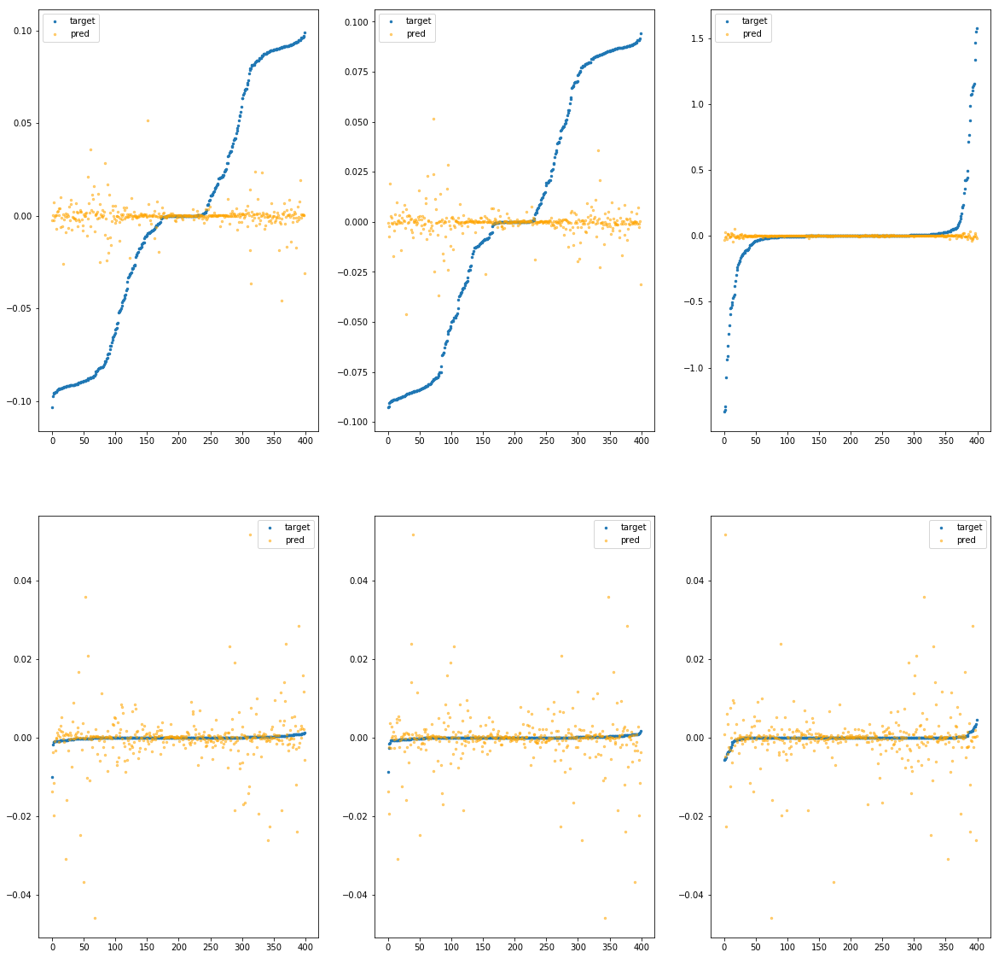

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c6a0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.15e-01	2.10e-01	5.32e-02	7.02e+03	4.57e-03	2.08e-05
y		-1.62e-01	2.02e-01	5.31e-02	5.19e+02	4.46e-03	1.99e-05
z		1.21e-02	1.60e+00	1.03e-01	2.39e+02	8.23e-02	6.78e-03
phi		-1.26e+03	1.37e-01	1.06e-02	1.32e+06	4.55e-04	2.07e-07
theta		-1.47e+03	1.35e-01	1.06e-02	4.53e+05	4.56e-04	2.08e-07
psi		-6.03e+02	1.36e-01	1.06e-02	5.80e+05	4.53e-04	2.05e-07


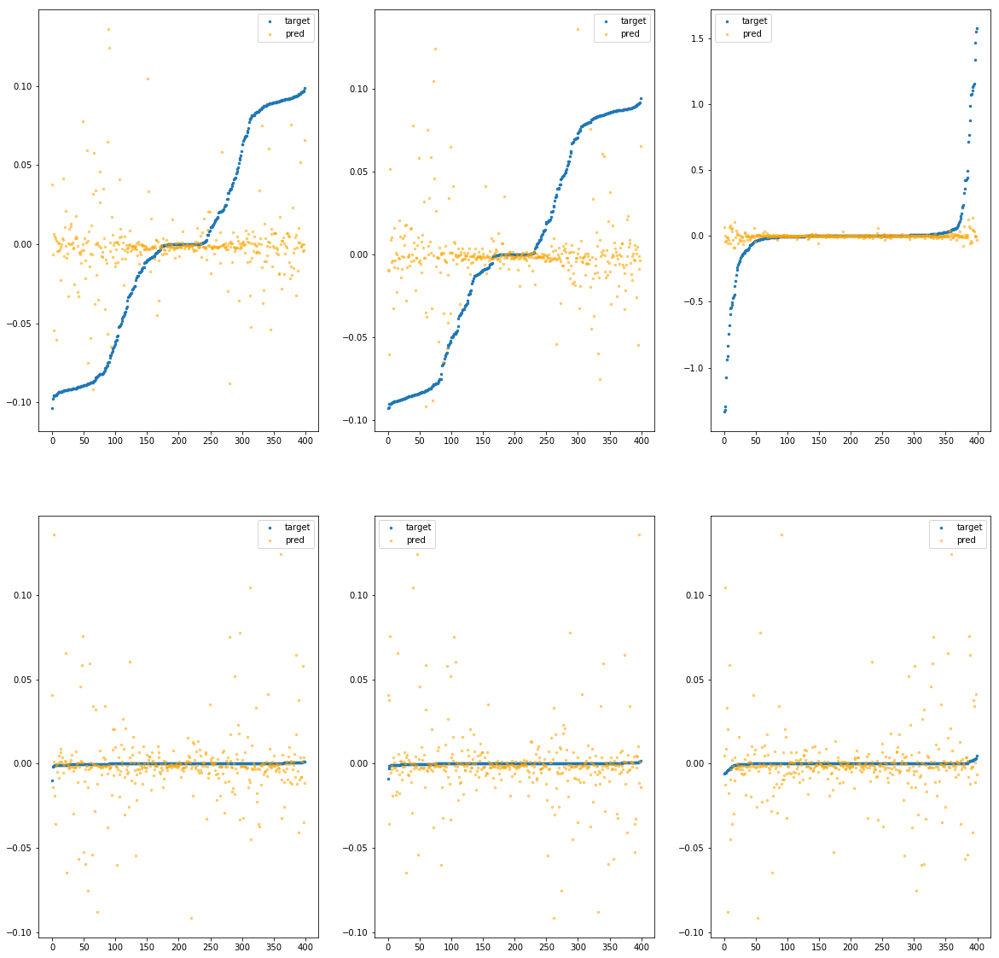

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c700>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.25e-01	2.48e-01	5.67e-02	4.61e+03	5.42e-03	2.94e-05
y		-4.06e-01	2.95e-01	5.67e-02	3.13e+02	5.39e-03	2.91e-05
z		-2.36e-02	1.66e+00	1.05e-01	2.94e+02	8.53e-02	7.27e-03
phi		-2.99e+03	2.11e-01	1.68e-02	9.87e+05	1.08e-03	1.17e-06
theta		-3.52e+03	2.12e-01	1.69e-02	3.61e+05	1.09e-03	1.18e-06
psi		-1.44e+03	2.11e-01	1.69e-02	9.49e+05	1.08e-03	1.16e-06


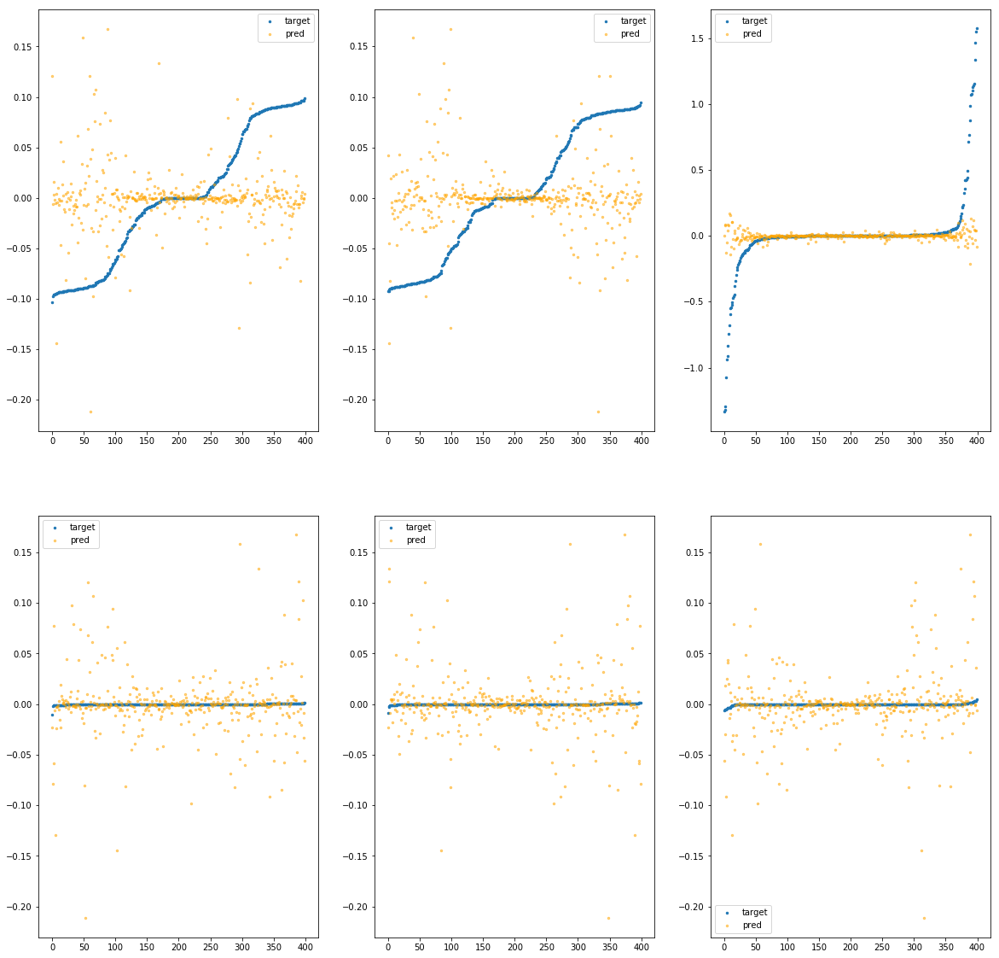

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c760>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.20e-01	3.98e-01	5.76e-02	6.24e+03	6.22e-03	3.87e-05
y		-6.17e-01	3.94e-01	5.87e-02	3.02e+02	6.20e-03	3.84e-05
z		-1.86e-02	1.78e+00	1.06e-01	2.58e+02	8.49e-02	7.20e-03
phi		-5.99e+03	3.15e-01	2.24e-02	1.31e+06	2.17e-03	4.70e-06
theta		-7.03e+03	3.15e-01	2.24e-02	3.90e+05	2.17e-03	4.71e-06
psi		-2.88e+03	3.14e-01	2.24e-02	1.51e+06	2.16e-03	4.67e-06


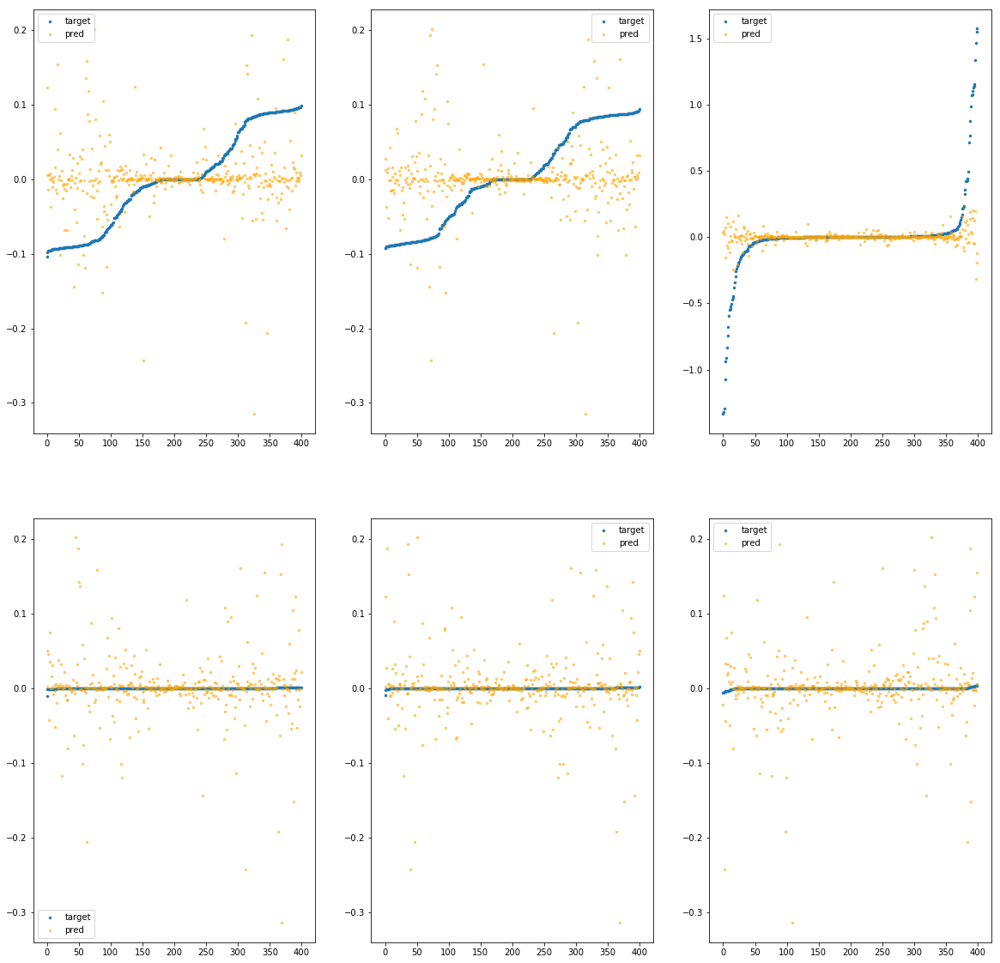

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c7c0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.40e-01	4.53e-01	6.09e-02	4.85e+03	7.12e-03	5.07e-05
y		-7.01e-01	4.49e-01	5.89e-02	5.30e+02	6.52e-03	4.26e-05
z		-6.63e-02	1.66e+00	1.07e-01	3.32e+02	8.88e-02	7.89e-03
phi		-7.41e+03	3.82e-01	2.40e-02	1.16e+06	2.68e-03	7.20e-06
theta		-8.66e+03	3.82e-01	2.40e-02	4.17e+05	2.68e-03	7.16e-06
psi		-3.57e+03	3.81e-01	2.40e-02	1.72e+06	2.68e-03	7.18e-06


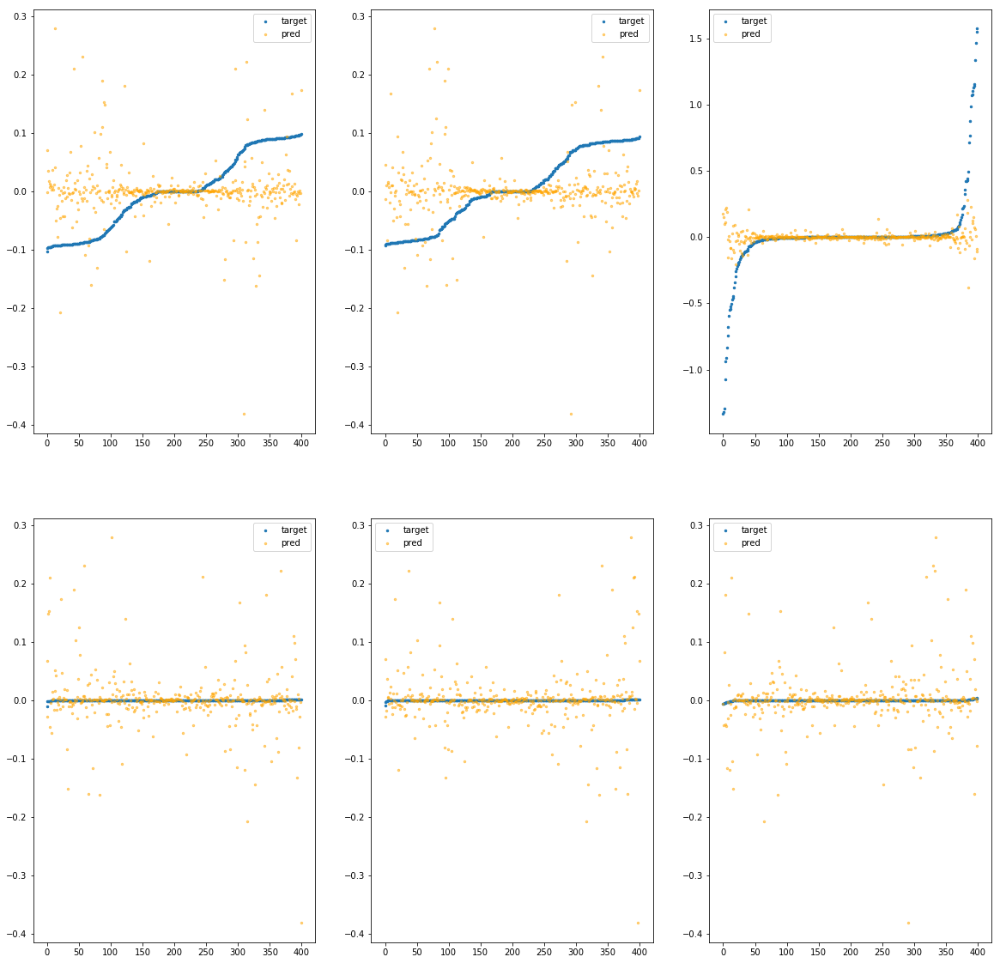

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c820>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.32e-03	1.05e-01	5.16e-02	1.19e+03	4.08e-03	1.66e-05
y		-2.15e-03	9.51e-02	5.11e-02	5.72e+01	3.84e-03	1.48e-05
z		-8.84e-04	1.58e+00	1.02e-01	3.62e+01	8.34e-02	6.95e-03
phi		-1.82e+01	1.85e-02	1.41e-03	1.96e+05	6.93e-06	4.81e-11
theta		-2.19e+01	1.85e-02	1.42e-03	5.23e+04	7.09e-06	5.02e-11
psi		-9.65e+00	1.86e-02	1.48e-03	7.72e+04	7.99e-06	6.39e-11


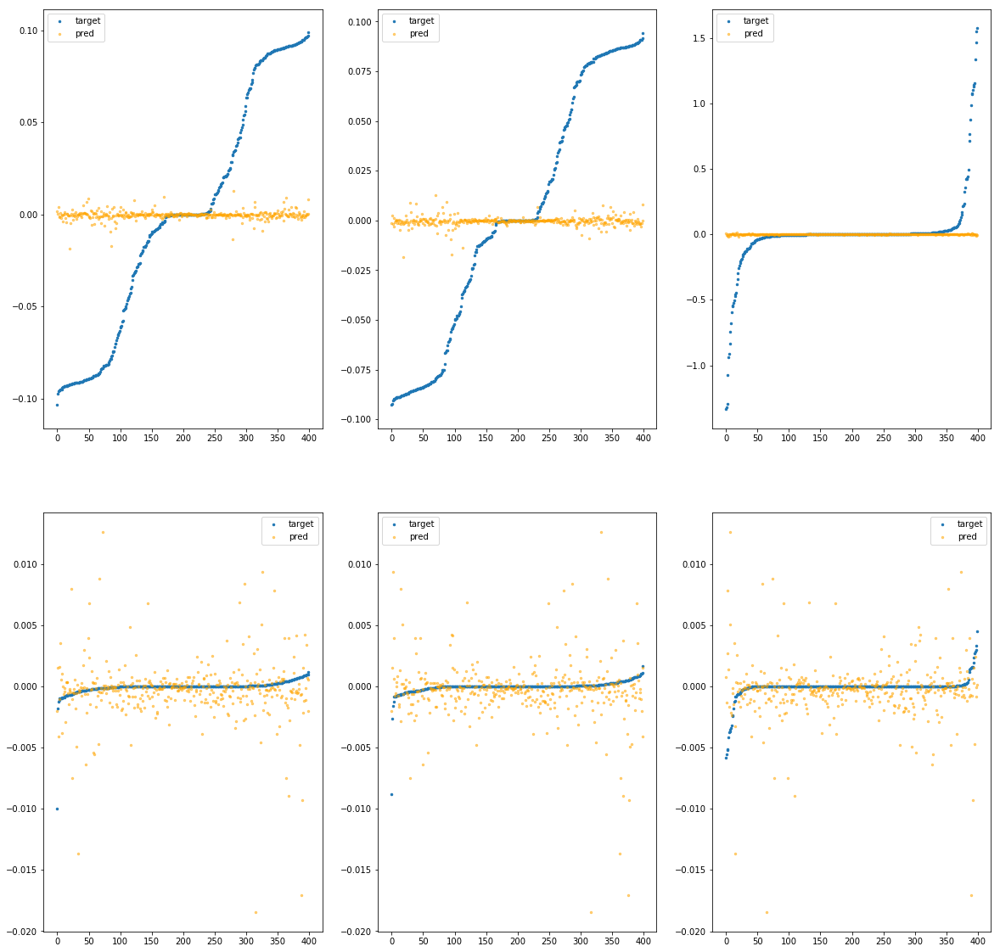

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c880>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.22e-02	2.08e-01	5.24e-02	3.00e+03	4.31e-03	1.86e-05
y		9.65e-04	1.71e-01	5.05e-02	2.06e+02	3.83e-03	1.47e-05
z		2.35e-02	1.59e+00	1.01e-01	1.18e+02	8.14e-02	6.62e-03
phi		-3.92e+02	1.04e-01	5.61e-03	5.49e+05	1.42e-04	2.03e-08
theta		-4.66e+02	1.08e-01	5.61e-03	1.55e+05	1.44e-04	2.08e-08
psi		-1.90e+02	1.03e-01	5.68e-03	4.02e+05	1.43e-04	2.06e-08


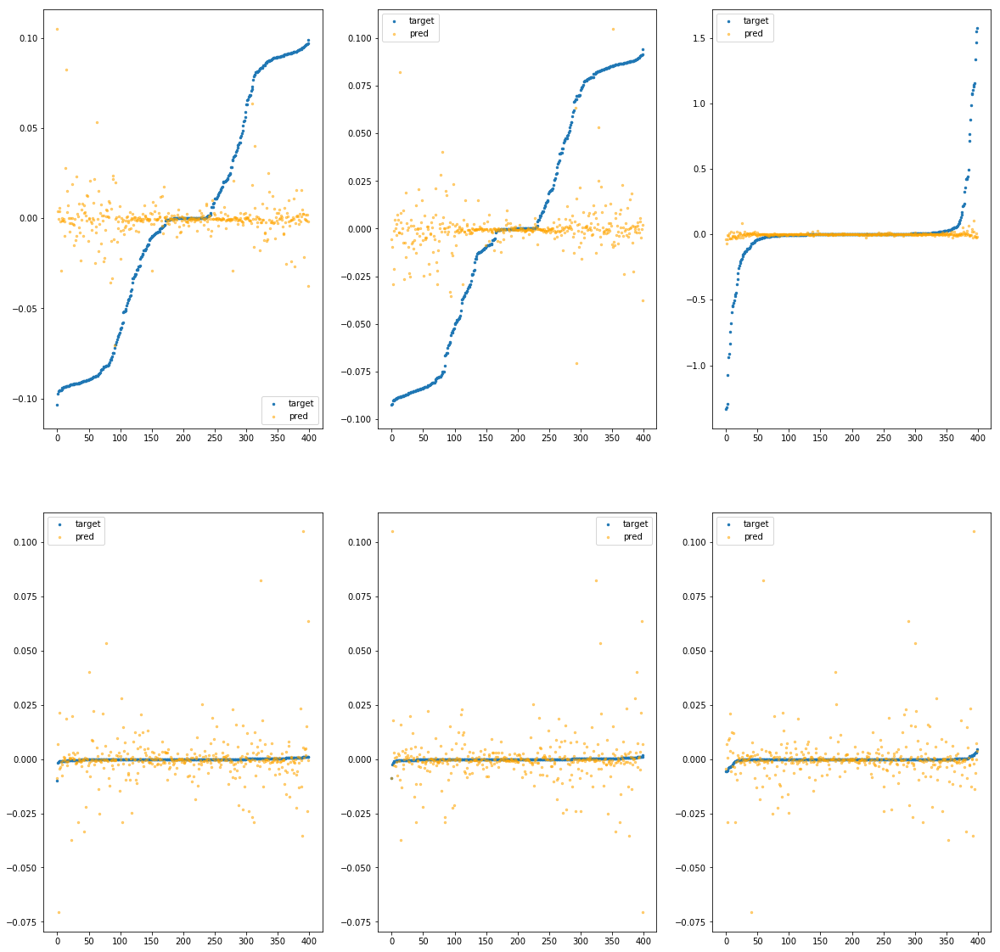

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c8e0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.46e-02	1.93e-01	5.22e-02	2.83e+03	4.44e-03	1.97e-05
y		-2.11e-01	2.15e-01	5.33e-02	1.63e+02	4.64e-03	2.16e-05
z		-9.92e-03	1.54e+00	1.05e-01	1.51e+02	8.41e-02	7.08e-03
phi		-1.79e+03	1.36e-01	1.26e-02	8.35e+05	6.49e-04	4.21e-07
theta		-2.10e+03	1.35e-01	1.26e-02	1.30e+05	6.50e-04	4.22e-07
psi		-8.71e+02	1.39e-01	1.27e-02	4.54e+05	6.54e-04	4.27e-07


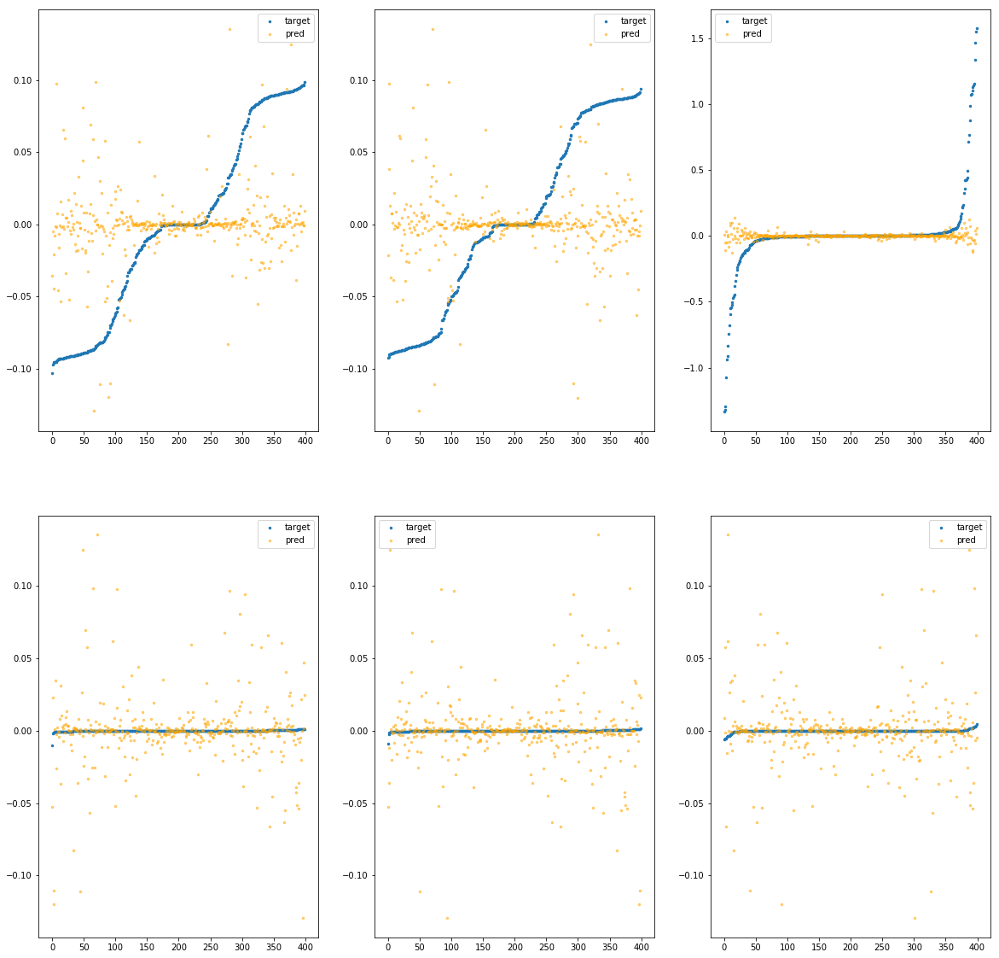

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c940>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.95e-01	2.37e-01	5.60e-02	3.09e+03	5.30e-03	2.81e-05
y		-3.59e-01	2.93e-01	5.49e-02	2.18e+02	5.21e-03	2.72e-05
z		-1.02e-02	1.62e+00	1.05e-01	2.51e+02	8.42e-02	7.08e-03
phi		-3.68e+03	2.35e-01	1.73e-02	7.53e+05	1.33e-03	1.78e-06
theta		-4.30e+03	2.35e-01	1.73e-02	1.85e+05	1.33e-03	1.76e-06
psi		-1.76e+03	2.35e-01	1.72e-02	8.25e+05	1.32e-03	1.75e-06


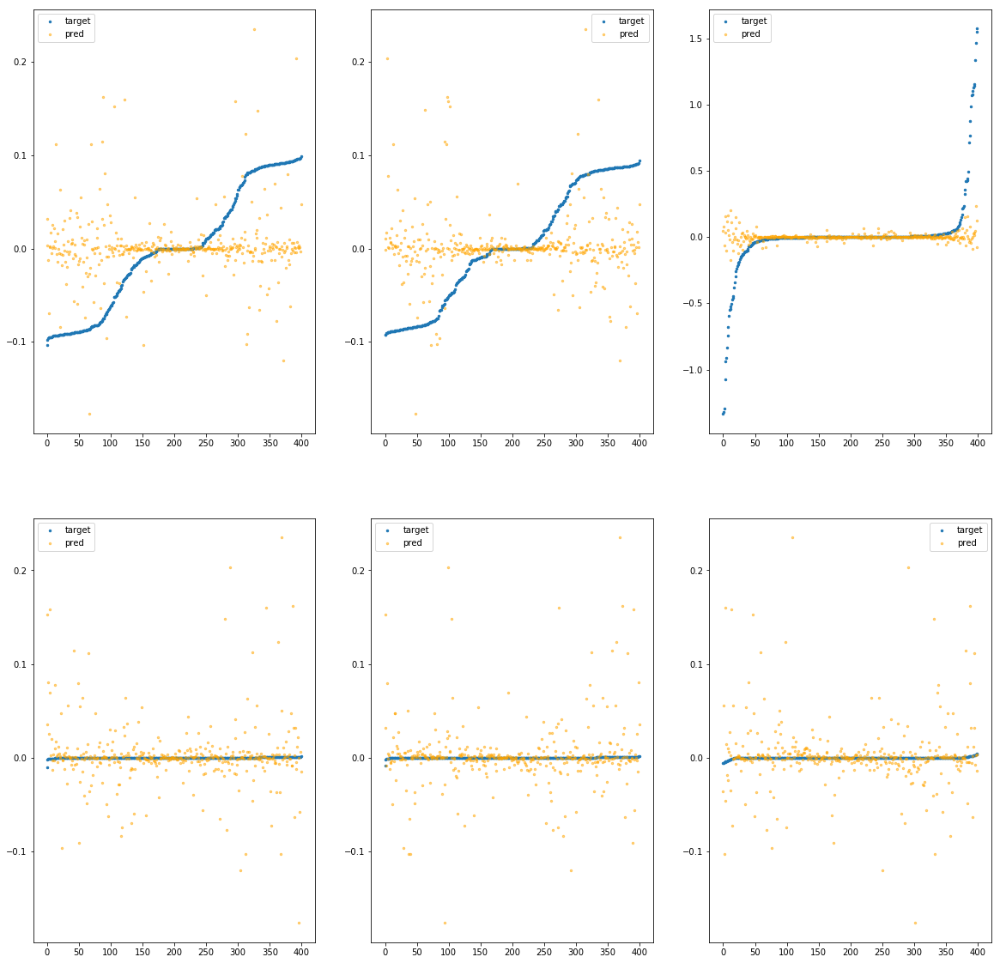

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c9a0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.83e-01	4.13e-01	5.70e-02	3.24e+03	6.07e-03	3.69e-05
y		-6.01e-01	4.09e-01	5.88e-02	3.01e+02	6.14e-03	3.77e-05
z		4.19e-02	1.66e+00	1.06e-01	3.36e+02	7.98e-02	6.37e-03
phi		-6.24e+03	3.24e-01	2.27e-02	8.48e+05	2.26e-03	5.10e-06
theta		-7.32e+03	3.24e-01	2.27e-02	3.03e+05	2.26e-03	5.12e-06
psi		-3.01e+03	3.24e-01	2.27e-02	1.23e+06	2.26e-03	5.09e-06


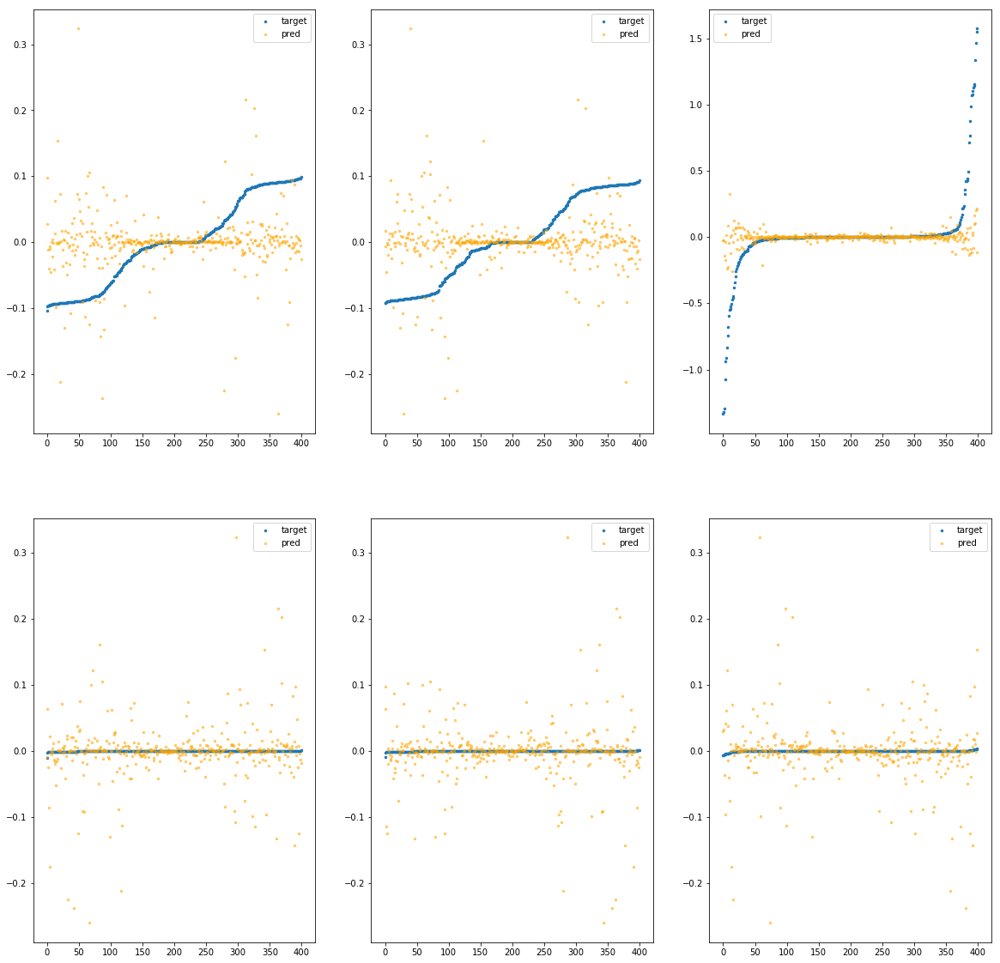

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0ca00>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.85e-06	1.03e-01	5.17e-02	2.03e+02	4.09e-03	1.68e-05
y		-3.09e-03	9.45e-02	5.11e-02	1.14e+01	3.85e-03	1.48e-05
z		-7.59e-04	1.57e+00	1.02e-01	5.72e+00	8.34e-02	6.95e-03
phi		1.18e-02	9.92e-03	2.23e-04	3.36e+04	3.58e-07	1.28e-13
theta		-2.14e-02	8.77e-03	2.18e-04	8.81e+03	3.15e-07	9.95e-14
psi		-6.74e-03	5.80e-03	2.76e-04	5.29e+03	7.55e-07	5.70e-13


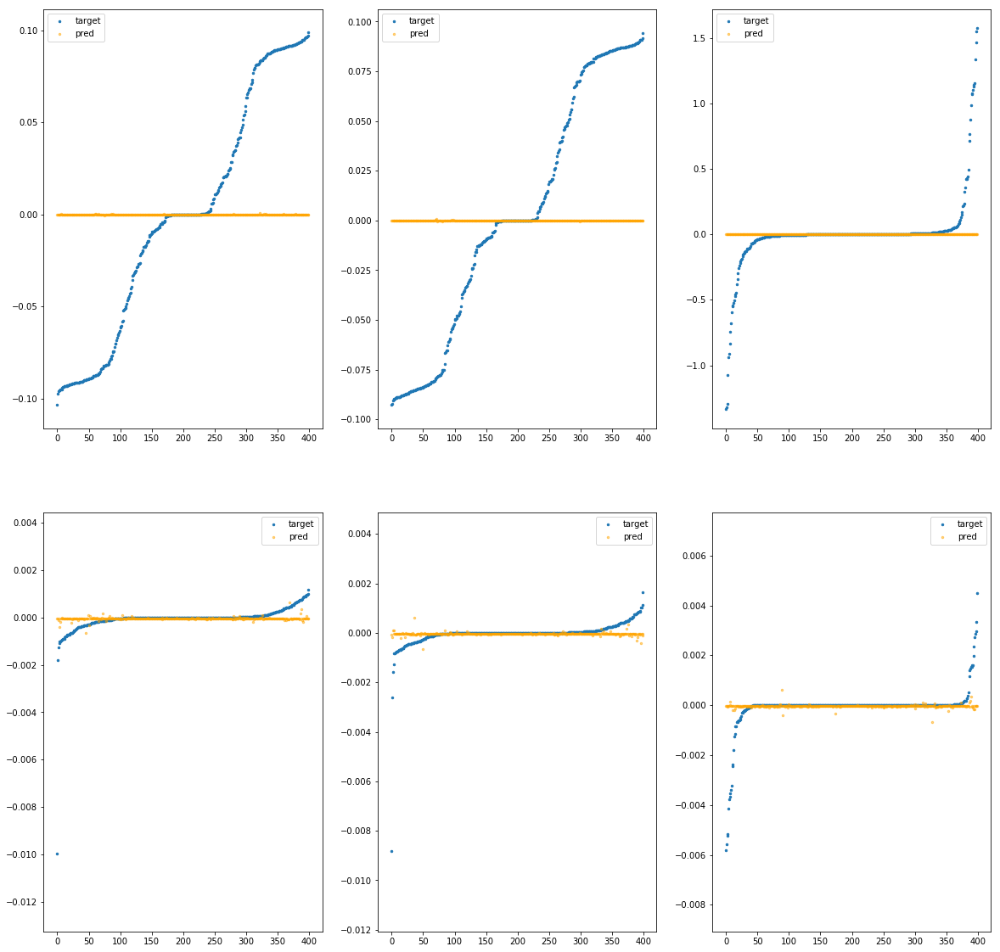

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0ca60>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.47e-04	1.03e-01	5.17e-02	2.28e+02	4.09e-03	1.68e-05
y		-3.01e-03	9.44e-02	5.11e-02	1.26e+01	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	6.15e+00	8.34e-02	6.95e-03
phi		7.57e-03	9.91e-03	2.26e-04	3.81e+04	3.59e-07	1.29e-13
theta		-6.05e-03	8.76e-03	2.19e-04	9.82e+03	3.11e-07	9.66e-14
psi		-4.68e-03	5.80e-03	2.77e-04	5.77e+03	7.54e-07	5.68e-13


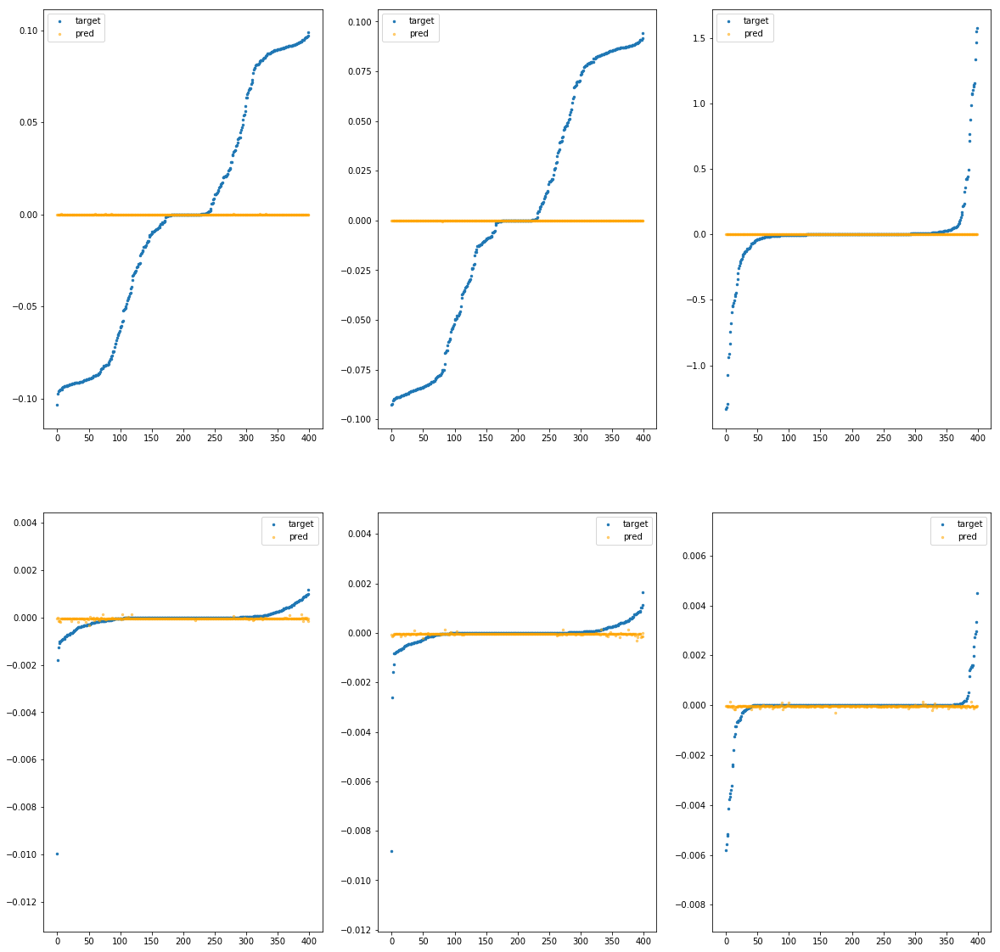

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cac0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		8.38e-06	1.04e-01	5.17e-02	2.12e+02	4.09e-03	1.68e-05
y		-2.66e-03	9.31e-02	5.11e-02	1.26e+01	3.84e-03	1.48e-05
z		-7.23e-04	1.57e+00	1.02e-01	6.81e+00	8.34e-02	6.95e-03
phi		-1.99e-01	1.01e-02	2.75e-04	3.50e+04	4.34e-07	1.89e-13
theta		-2.20e-01	8.96e-03	2.63e-04	1.03e+04	3.77e-07	1.42e-13
psi		-6.13e-02	5.55e-03	3.33e-04	7.19e+03	7.96e-07	6.34e-13


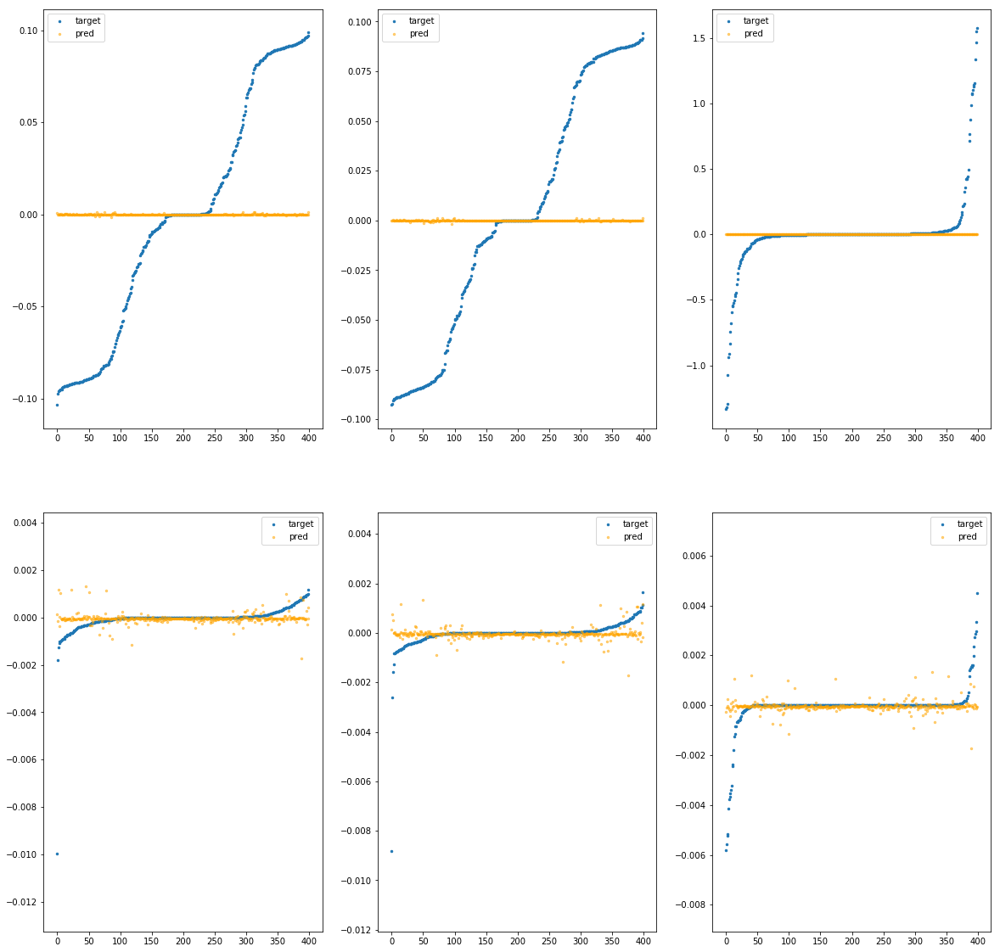

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cb20>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.32e-05	1.04e-01	5.17e-02	2.25e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.42e-02	5.11e-02	1.22e+01	3.85e-03	1.48e-05
z		-5.74e-04	1.57e+00	1.02e-01	6.01e+00	8.34e-02	6.95e-03
phi		-1.54e-03	9.91e-03	2.29e-04	3.72e+04	3.63e-07	1.31e-13
theta		-3.19e-02	8.76e-03	2.22e-04	9.42e+03	3.19e-07	1.02e-13
psi		7.32e-03	5.77e-03	2.82e-04	5.90e+03	7.45e-07	5.54e-13


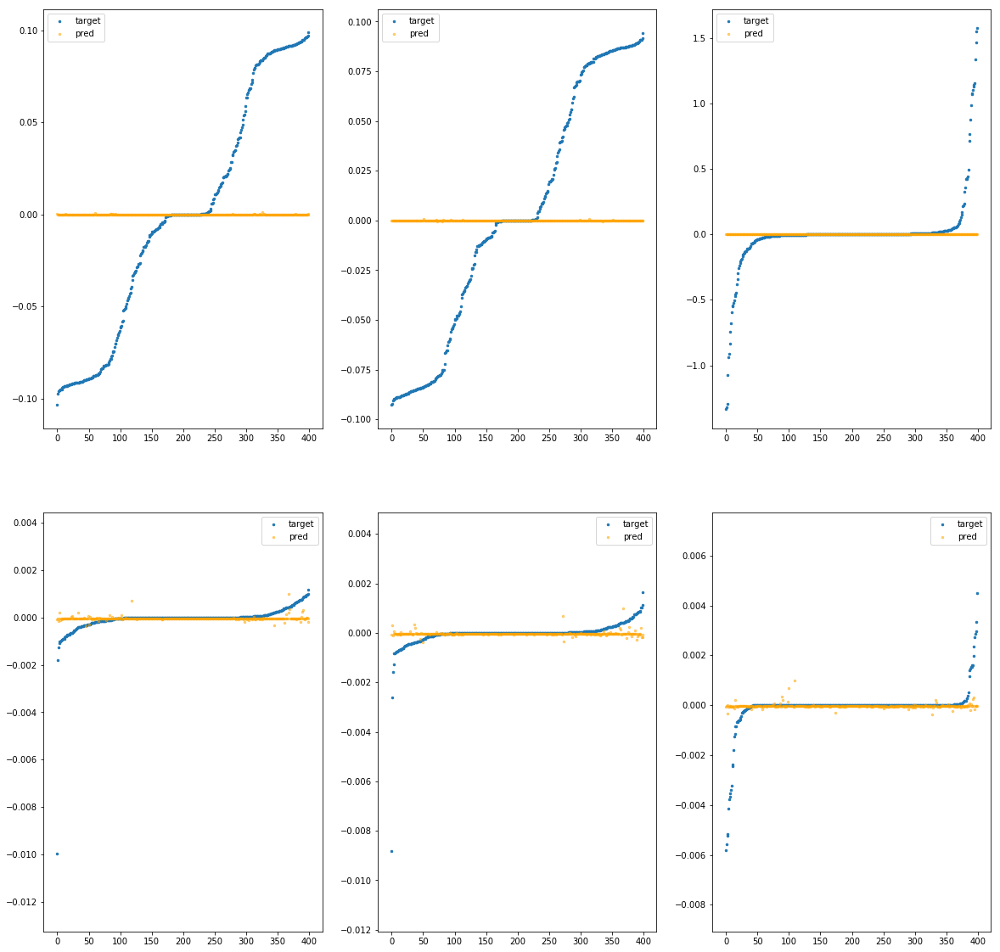

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cb80>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.55e-05	1.03e-01	5.17e-02	2.19e+02	4.09e-03	1.68e-05
y		-2.84e-03	9.42e-02	5.11e-02	1.20e+01	3.85e-03	1.48e-05
z		-7.41e-04	1.57e+00	1.02e-01	5.88e+00	8.34e-02	6.95e-03
phi		-7.81e-03	9.95e-03	2.28e-04	3.65e+04	3.65e-07	1.33e-13
theta		-4.11e-03	8.80e-03	2.17e-04	9.28e+03	3.10e-07	9.62e-14
psi		-4.64e-03	5.80e-03	2.76e-04	5.41e+03	7.53e-07	5.68e-13


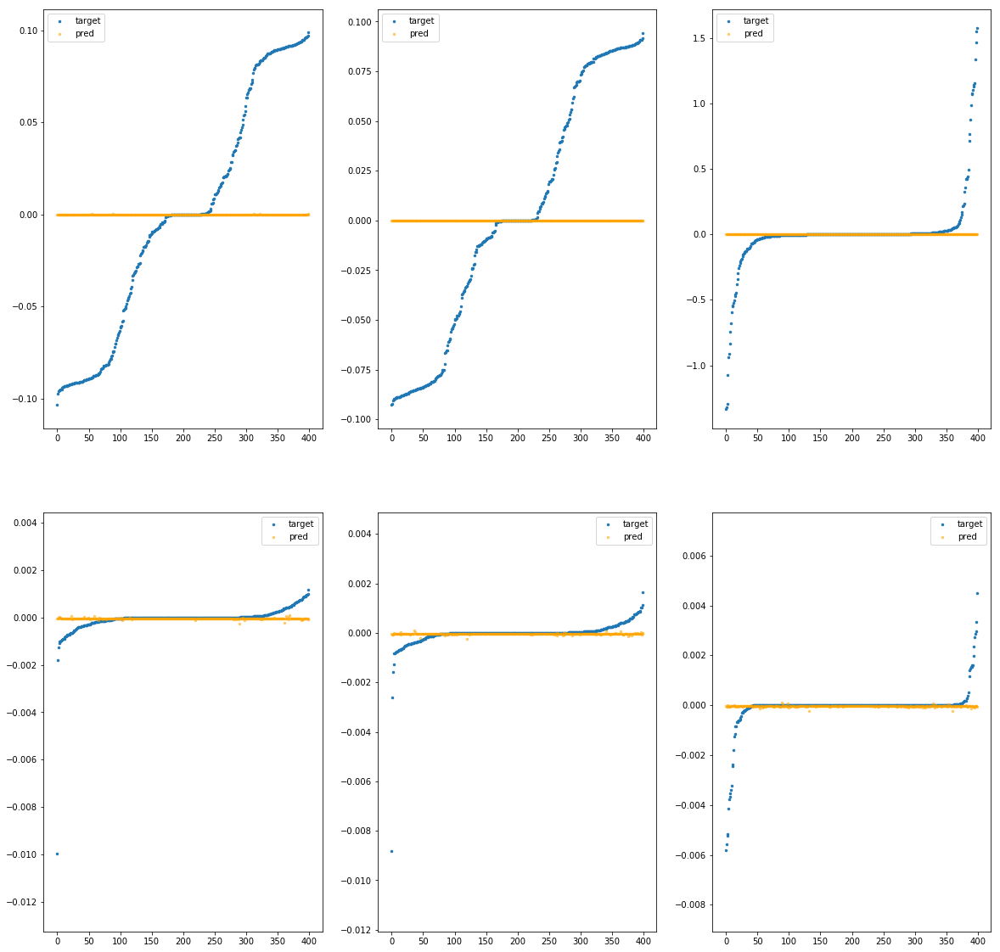

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cbe0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.09e-04	1.03e-01	5.17e-02	1.87e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	1.04e+01	3.85e-03	1.48e-05
z		-7.47e-04	1.57e+00	1.02e-01	5.14e+00	8.34e-02	6.95e-03
phi		-3.41e-04	9.94e-03	2.23e-04	3.12e+04	3.62e-07	1.31e-13
theta		-1.29e-03	8.79e-03	2.12e-04	7.96e+03	3.09e-07	9.56e-14
psi		-1.54e-03	5.79e-03	2.68e-04	4.47e+03	7.51e-07	5.64e-13


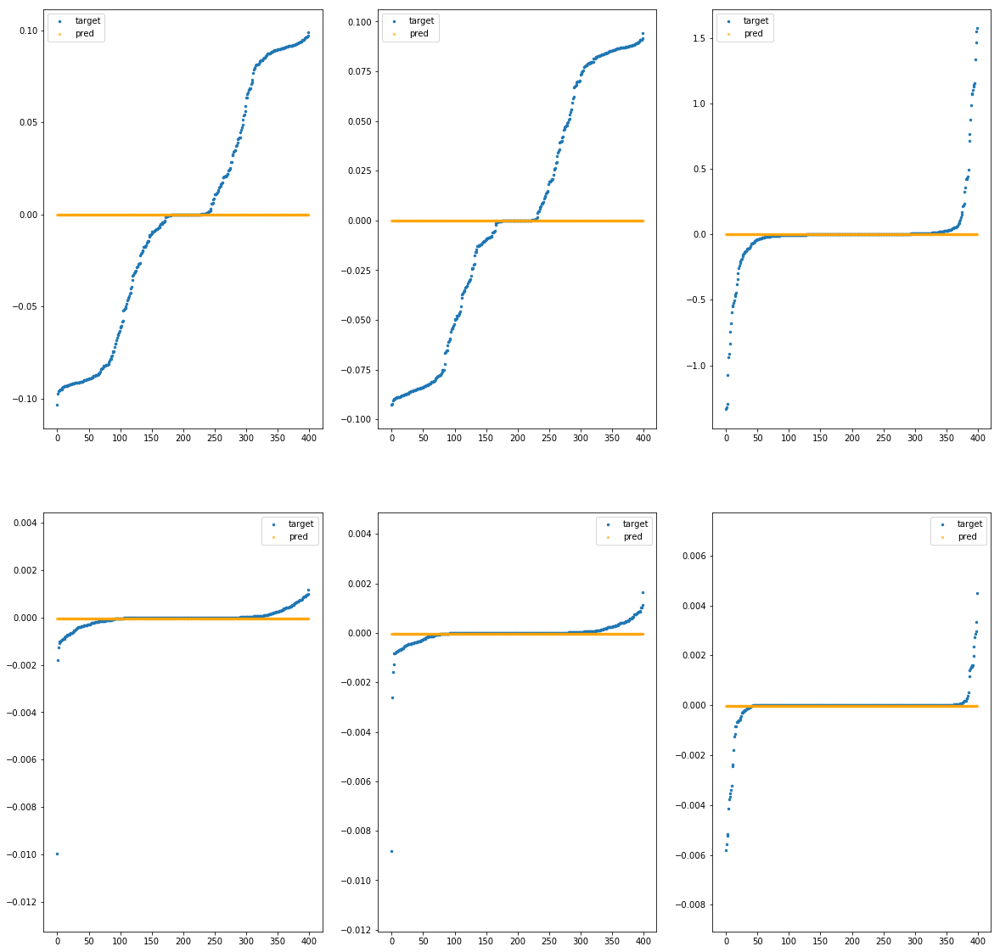

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cc40>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.08e-04	1.03e-01	5.17e-02	2.38e+02	4.09e-03	1.68e-05
y		-2.90e-03	9.43e-02	5.11e-02	1.31e+01	3.85e-03	1.48e-05
z		-7.35e-04	1.57e+00	1.02e-01	6.35e+00	8.34e-02	6.95e-03
phi		2.16e-03	9.90e-03	2.29e-04	3.99e+04	3.61e-07	1.31e-13
theta		4.24e-03	8.75e-03	2.18e-04	1.02e+04	3.08e-07	9.46e-14
psi		-4.17e-03	5.78e-03	2.77e-04	5.80e+03	7.53e-07	5.67e-13


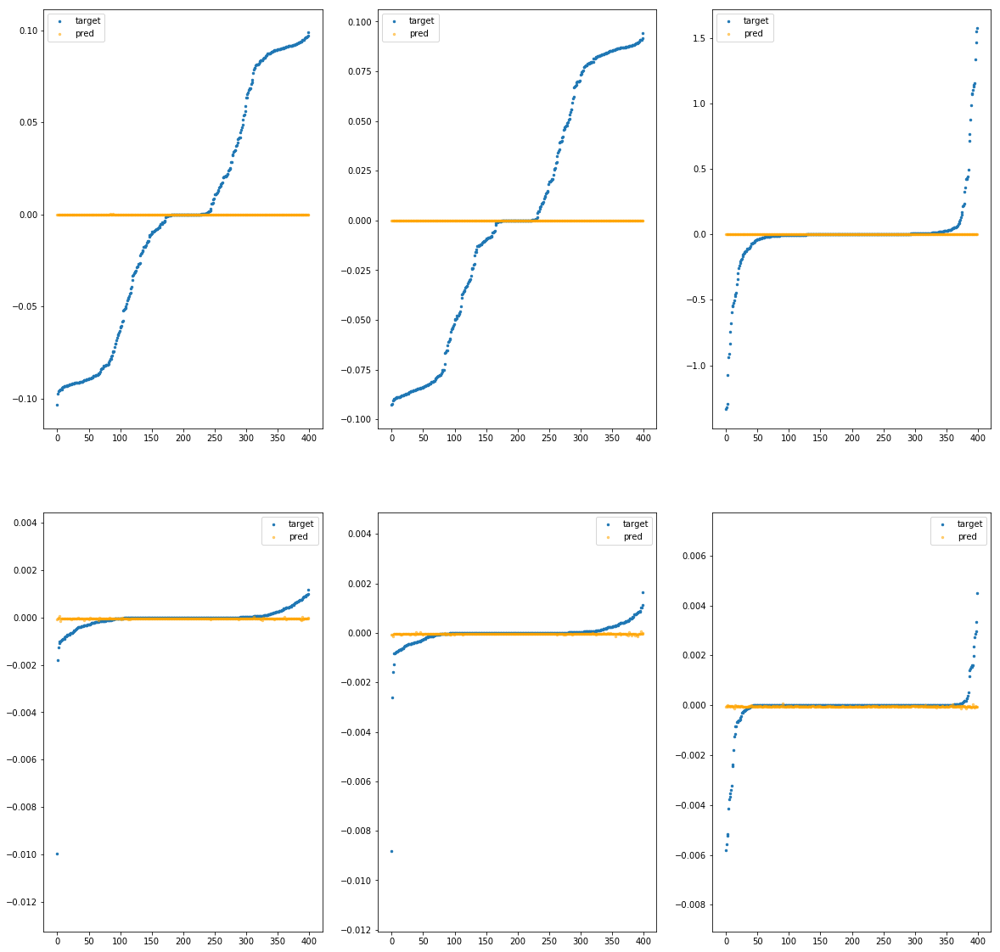

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cca0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.45e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.33e+01	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	6.49e+00	8.34e-02	6.95e-03
phi		-1.09e-03	9.93e-03	2.29e-04	4.10e+04	3.62e-07	1.31e-13
theta		-3.35e-03	8.78e-03	2.19e-04	1.04e+04	3.10e-07	9.60e-14
psi		-8.67e-04	5.78e-03	2.77e-04	5.82e+03	7.51e-07	5.63e-13


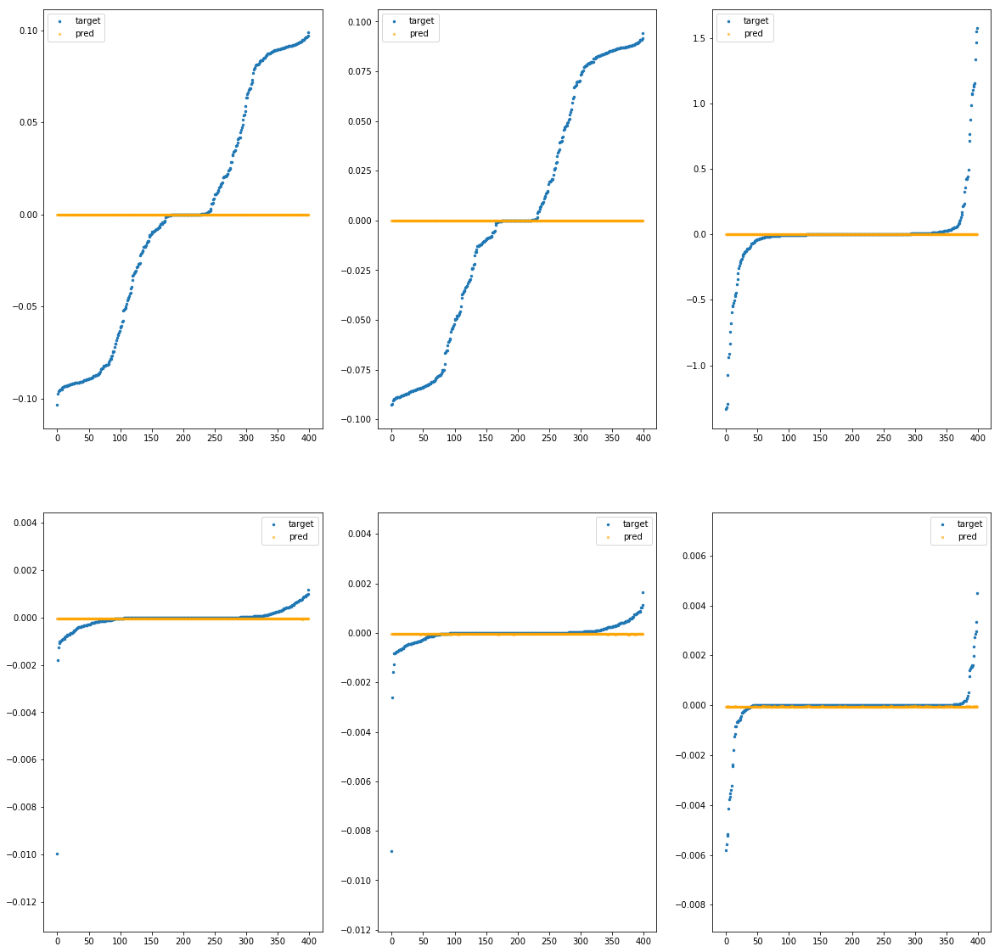

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cd00>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e-04	1.03e-01	5.17e-02	2.24e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.23e+01	3.85e-03	1.48e-05
z		-7.52e-04	1.57e+00	1.02e-01	6.01e+00	8.34e-02	6.95e-03
phi		-8.17e-05	9.93e-03	2.27e-04	3.74e+04	3.62e-07	1.31e-13
theta		-1.92e-03	8.78e-03	2.17e-04	9.55e+03	3.09e-07	9.58e-14
psi		-2.74e-04	5.78e-03	2.74e-04	5.35e+03	7.50e-07	5.63e-13


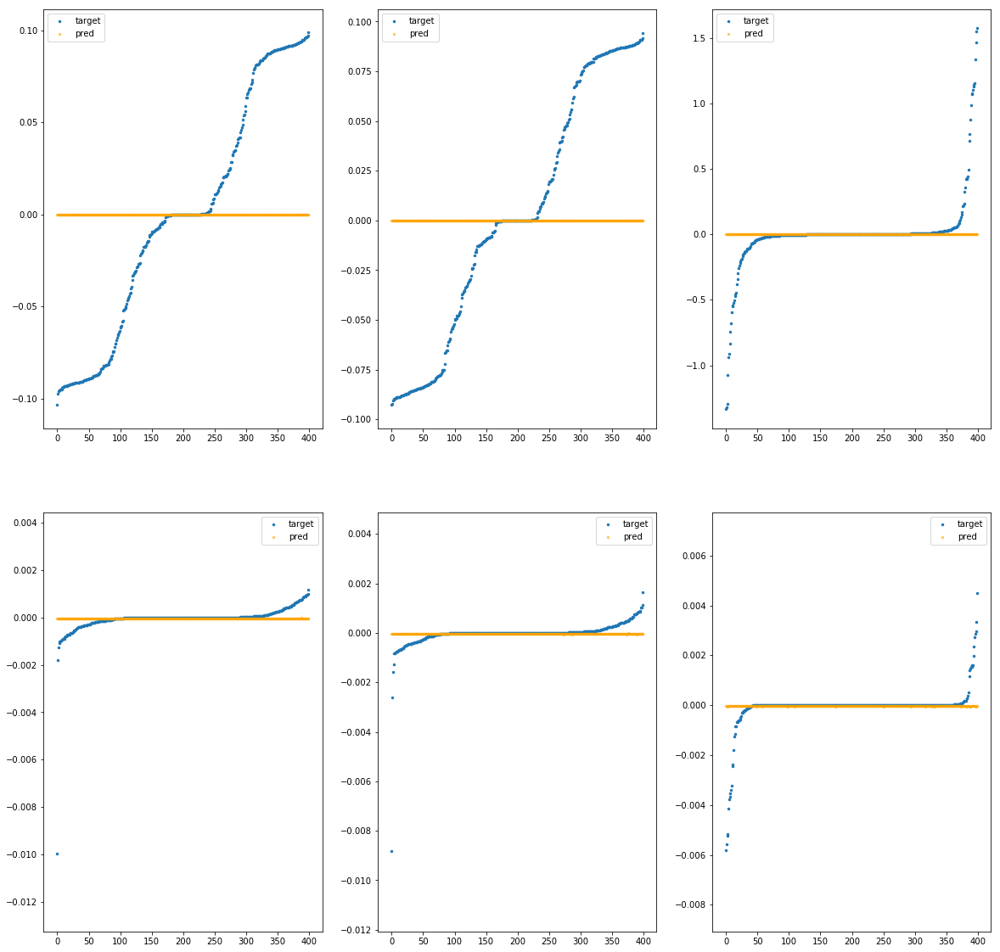

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cd60>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.17e-04	1.03e-01	5.17e-02	2.12e+02	4.09e-03	1.68e-05
y		-2.55e-03	9.51e-02	5.11e-02	1.16e+01	3.84e-03	1.48e-05
z		-1.14e-03	1.57e+00	1.02e-01	5.73e+00	8.34e-02	6.96e-03
phi		-1.20e-01	7.76e-03	2.89e-04	3.56e+04	4.06e-07	1.64e-13
theta		-1.83e-01	6.61e-03	2.73e-04	8.87e+03	3.66e-07	1.34e-13
psi		-2.32e-01	6.61e-03	3.48e-04	5.82e+03	9.24e-07	8.53e-13


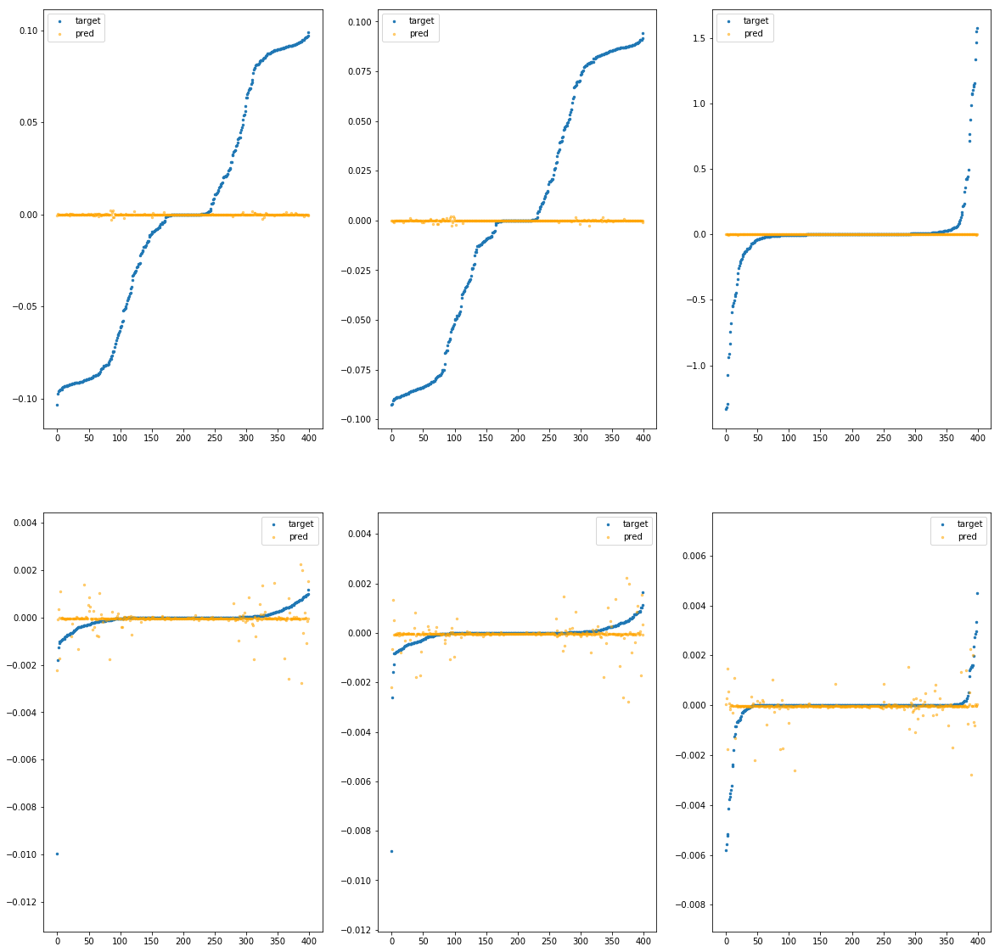

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cdc0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e-04	1.03e-01	5.17e-02	2.54e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.38e+01	3.85e-03	1.48e-05
z		-7.54e-04	1.57e+00	1.02e-01	6.70e+00	8.34e-02	6.95e-03
phi		2.73e-03	9.89e-03	2.30e-04	4.24e+04	3.61e-07	1.30e-13
theta		3.46e-03	8.74e-03	2.20e-04	1.08e+04	3.08e-07	9.47e-14
psi		-8.72e-04	5.78e-03	2.79e-04	6.10e+03	7.51e-07	5.63e-13


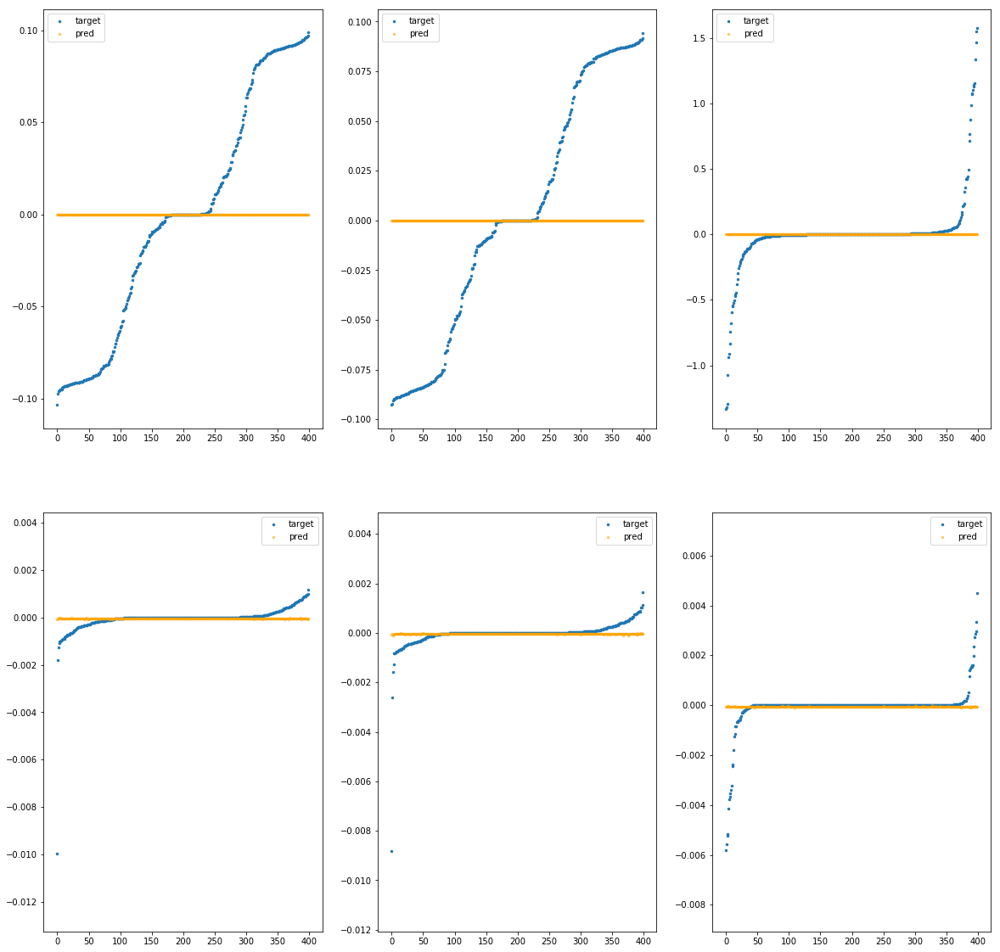

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0ce20>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.95e-05	1.03e-01	5.17e-02	2.24e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.23e+01	3.85e-03	1.48e-05
z		-7.53e-04	1.57e+00	1.02e-01	6.01e+00	8.34e-02	6.95e-03
phi		-8.91e-04	9.93e-03	2.27e-04	3.75e+04	3.62e-07	1.31e-13
theta		-1.61e-03	8.78e-03	2.17e-04	9.55e+03	3.09e-07	9.57e-14
psi		-2.65e-03	5.78e-03	2.74e-04	5.39e+03	7.52e-07	5.65e-13


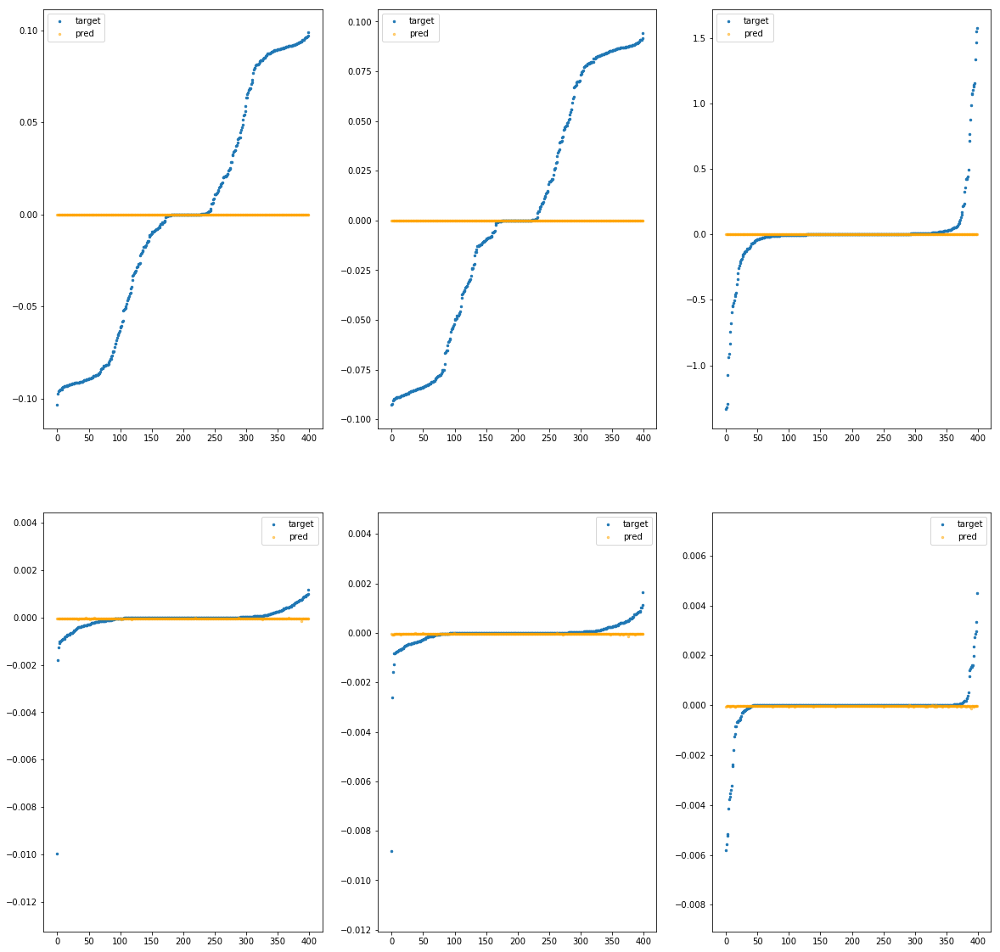

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0ce80>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.00e-04	1.03e-01	5.17e-02	2.15e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.18e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	5.80e+00	8.34e-02	6.95e-03
phi		8.50e-04	9.93e-03	2.26e-04	3.59e+04	3.62e-07	1.31e-13
theta		-1.15e-03	8.78e-03	2.15e-04	9.16e+03	3.09e-07	9.56e-14
psi		-7.40e-04	5.79e-03	2.73e-04	5.16e+03	7.51e-07	5.63e-13


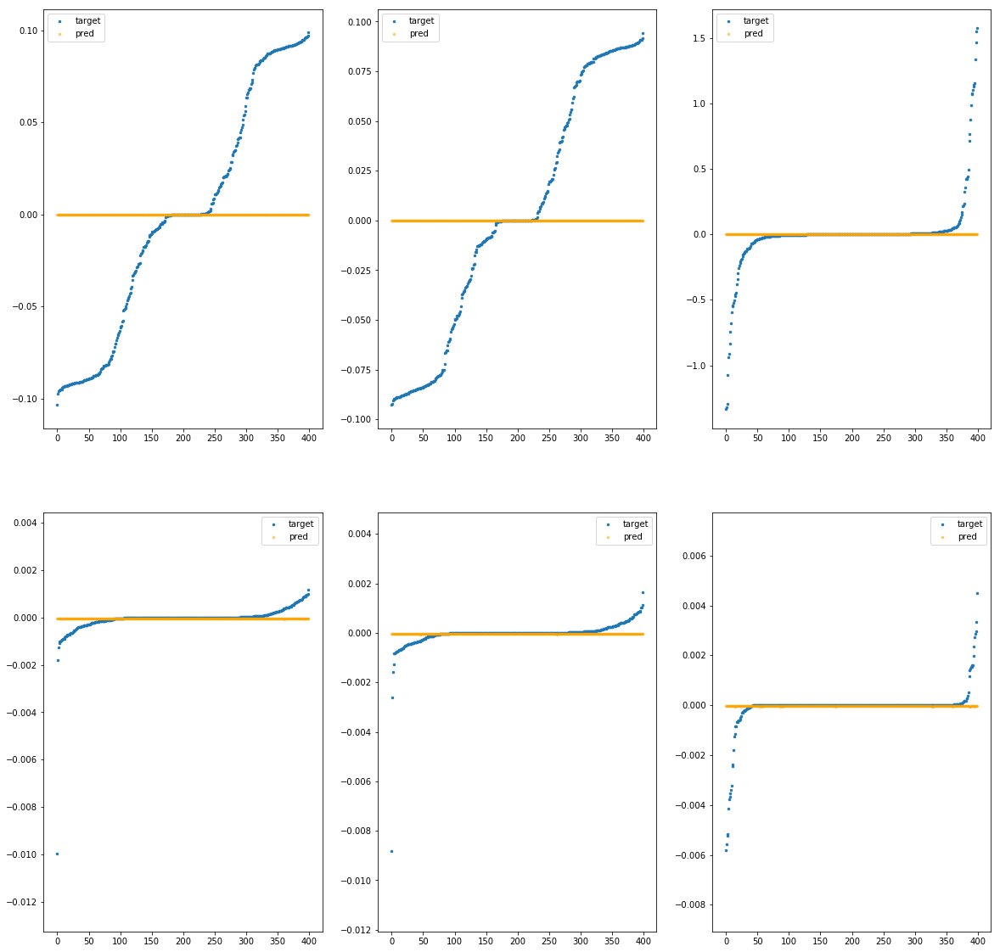

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cee0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.32e-04	1.03e-01	5.17e-02	2.40e+02	4.09e-03	1.68e-05
y		-2.94e-03	9.43e-02	5.11e-02	1.31e+01	3.85e-03	1.48e-05
z		-7.44e-04	1.57e+00	1.02e-01	6.38e+00	8.34e-02	6.95e-03
phi		1.18e-03	9.92e-03	2.28e-04	4.01e+04	3.62e-07	1.31e-13
theta		-1.72e-03	8.77e-03	2.19e-04	1.02e+04	3.09e-07	9.57e-14
psi		7.10e-04	5.78e-03	2.76e-04	5.77e+03	7.49e-07	5.62e-13


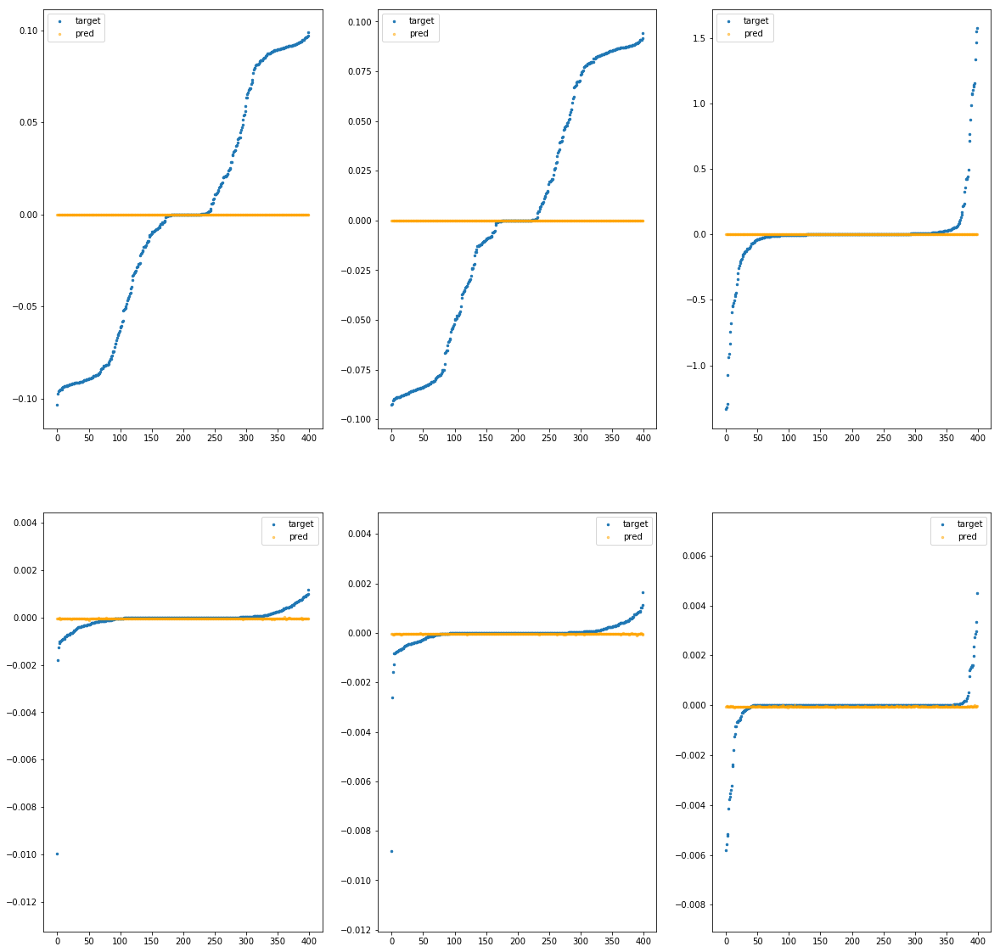

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cf40>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.73e-05	1.03e-01	5.17e-02	2.15e+02	4.09e-03	1.68e-05
y		-2.84e-03	9.42e-02	5.11e-02	1.18e+01	3.85e-03	1.48e-05
z		-7.01e-04	1.57e+00	1.02e-01	5.87e+00	8.34e-02	6.95e-03
phi		-3.15e-02	1.01e-02	2.31e-04	3.58e+04	3.73e-07	1.39e-13
theta		-2.18e-02	8.93e-03	2.18e-04	9.32e+03	3.16e-07	9.96e-14
psi		-1.04e-02	5.77e-03	2.79e-04	4.79e+03	7.58e-07	5.74e-13


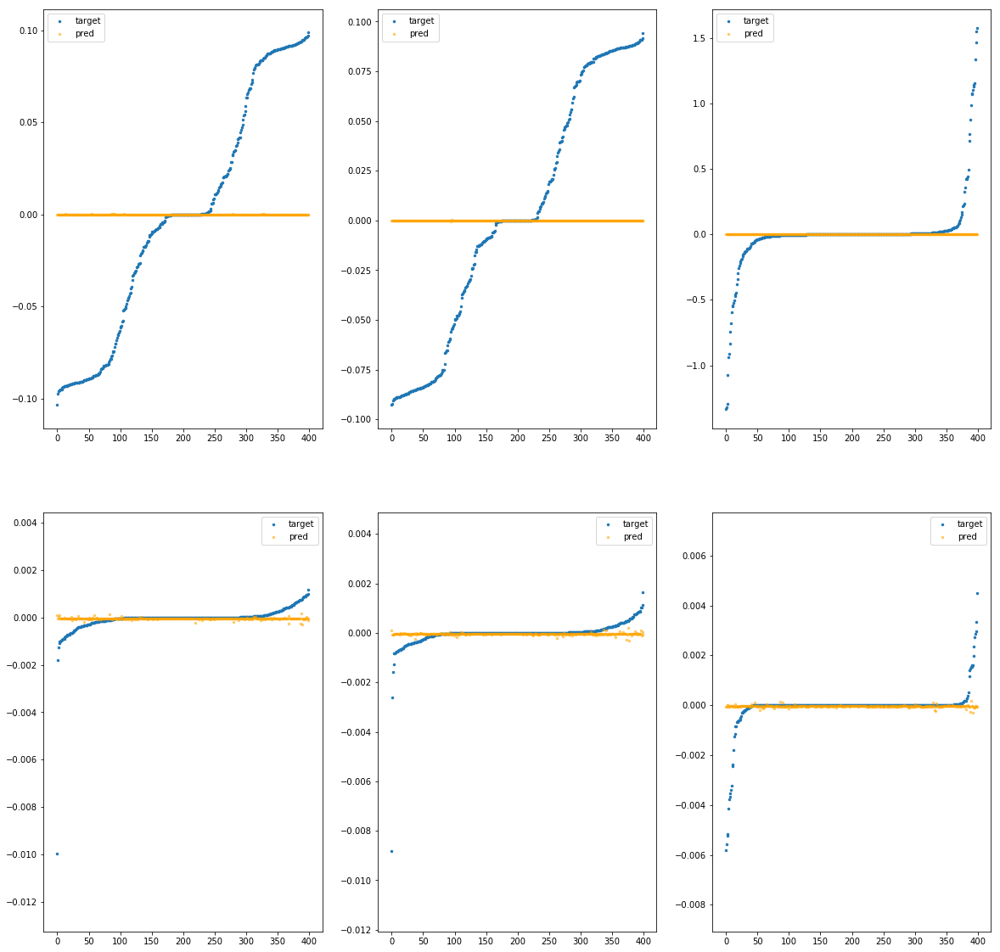

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f0cfa0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.57e-04	1.03e-01	5.17e-02	2.28e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.42e-02	5.11e-02	1.23e+01	3.85e-03	1.48e-05
z		-7.29e-04	1.57e+00	1.02e-01	6.04e+00	8.34e-02	6.95e-03
phi		5.88e-03	9.86e-03	2.29e-04	3.78e+04	3.60e-07	1.30e-13
theta		1.37e-02	8.71e-03	2.16e-04	9.61e+03	3.05e-07	9.28e-14
psi		-1.33e-04	5.76e-03	2.76e-04	5.37e+03	7.50e-07	5.63e-13


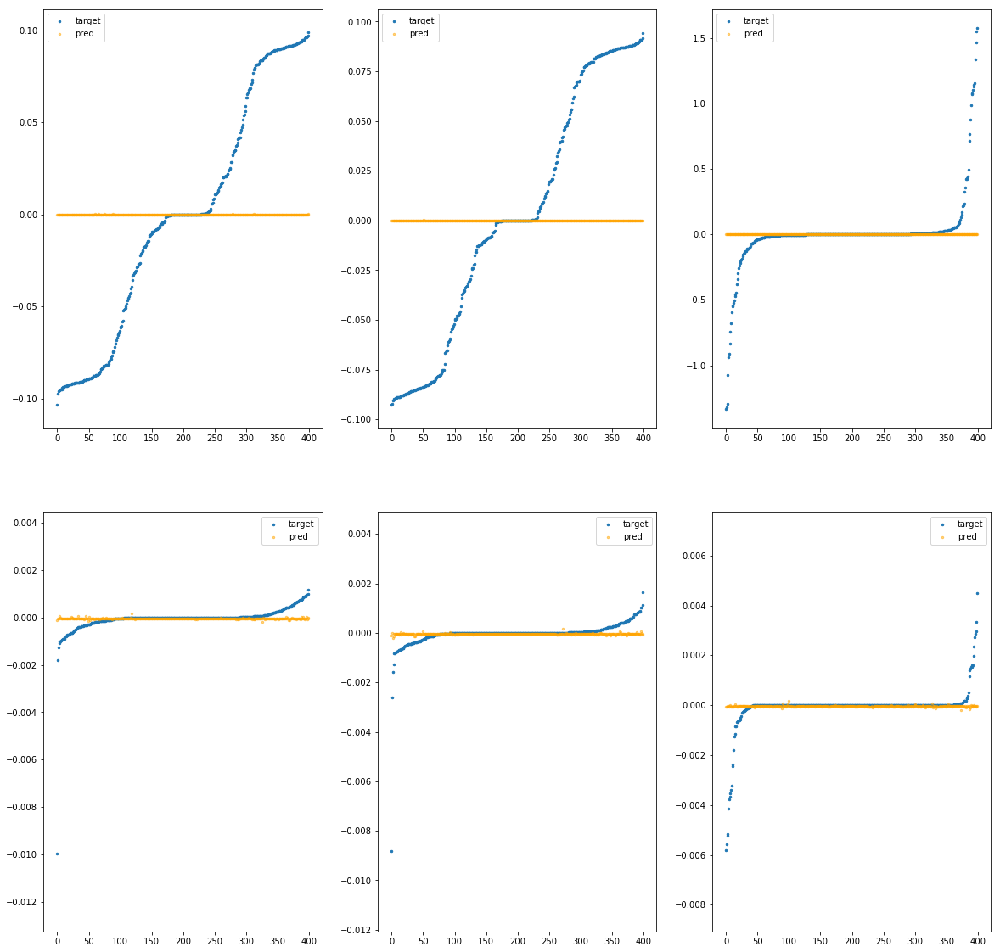

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f16040>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.59e-04	1.03e-01	5.17e-02	2.25e+02	4.10e-03	1.68e-05
y		-3.26e-03	9.43e-02	5.11e-02	1.07e+01	3.85e-03	1.48e-05
z		-7.07e-04	1.57e+00	1.02e-01	5.83e+00	8.34e-02	6.95e-03
phi		-5.38e-02	9.88e-03	2.64e-04	3.94e+04	3.82e-07	1.46e-13
theta		-1.12e-01	8.73e-03	2.61e-04	7.93e+03	3.43e-07	1.18e-13
psi		-6.58e-02	5.74e-03	3.25e-04	9.19e+03	7.99e-07	6.39e-13


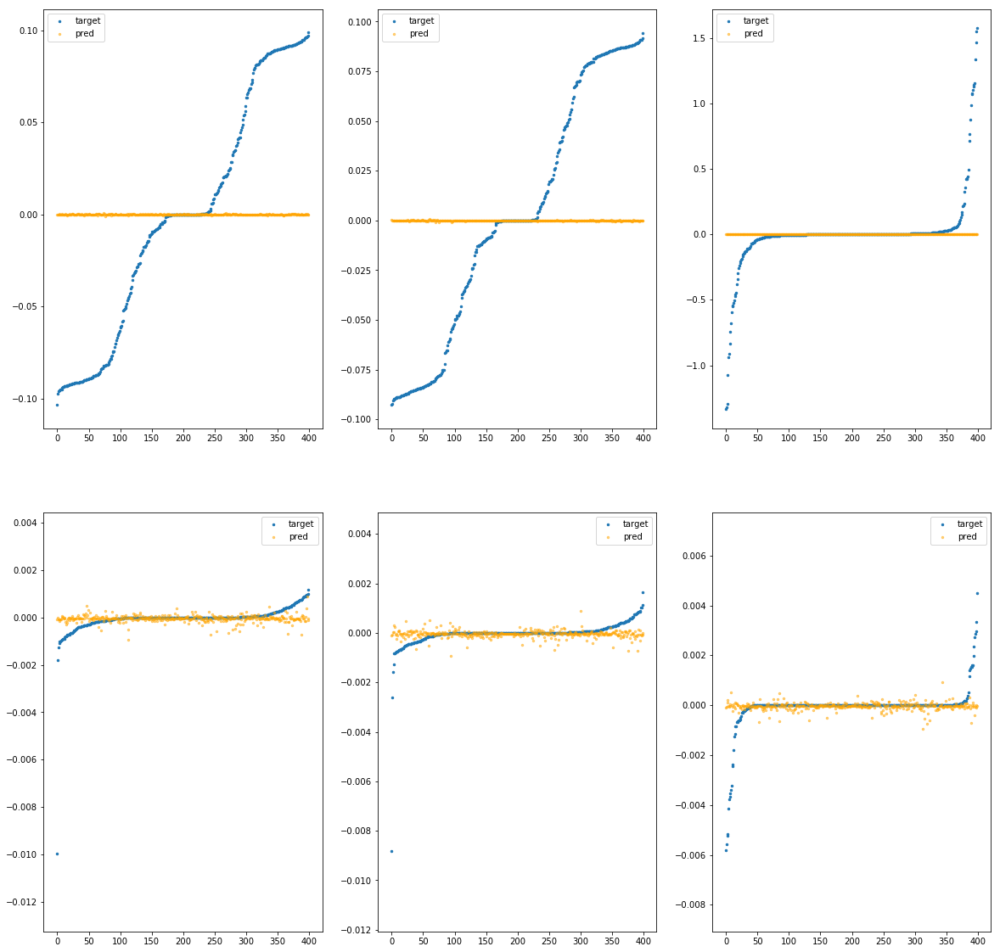

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f160a0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.25e-04	1.03e-01	5.17e-02	2.31e+02	4.09e-03	1.68e-05
y		-2.94e-03	9.43e-02	5.11e-02	1.27e+01	3.85e-03	1.48e-05
z		-7.49e-04	1.57e+00	1.02e-01	6.18e+00	8.34e-02	6.95e-03
phi		-4.23e-04	9.93e-03	2.27e-04	3.87e+04	3.62e-07	1.31e-13
theta		-1.34e-03	8.78e-03	2.17e-04	9.85e+03	3.09e-07	9.57e-14
psi		3.65e-04	5.78e-03	2.75e-04	5.46e+03	7.50e-07	5.62e-13


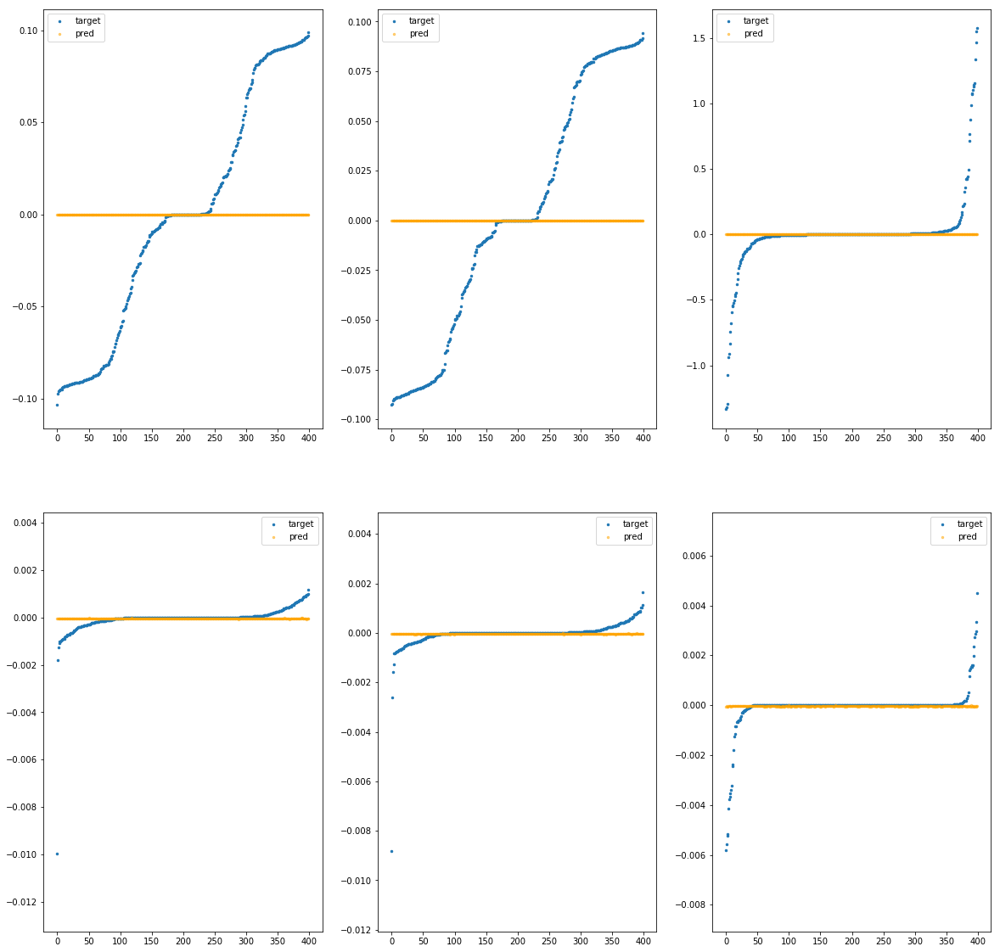

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f16100>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.02e-04	1.03e-01	5.17e-02	2.27e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.25e+01	3.85e-03	1.48e-05
z		-7.49e-04	1.57e+00	1.02e-01	6.09e+00	8.34e-02	6.95e-03
phi		1.59e-04	9.93e-03	2.27e-04	3.81e+04	3.62e-07	1.31e-13
theta		-1.97e-03	8.78e-03	2.17e-04	9.71e+03	3.09e-07	9.58e-14
psi		-1.17e-03	5.79e-03	2.75e-04	5.40e+03	7.51e-07	5.64e-13


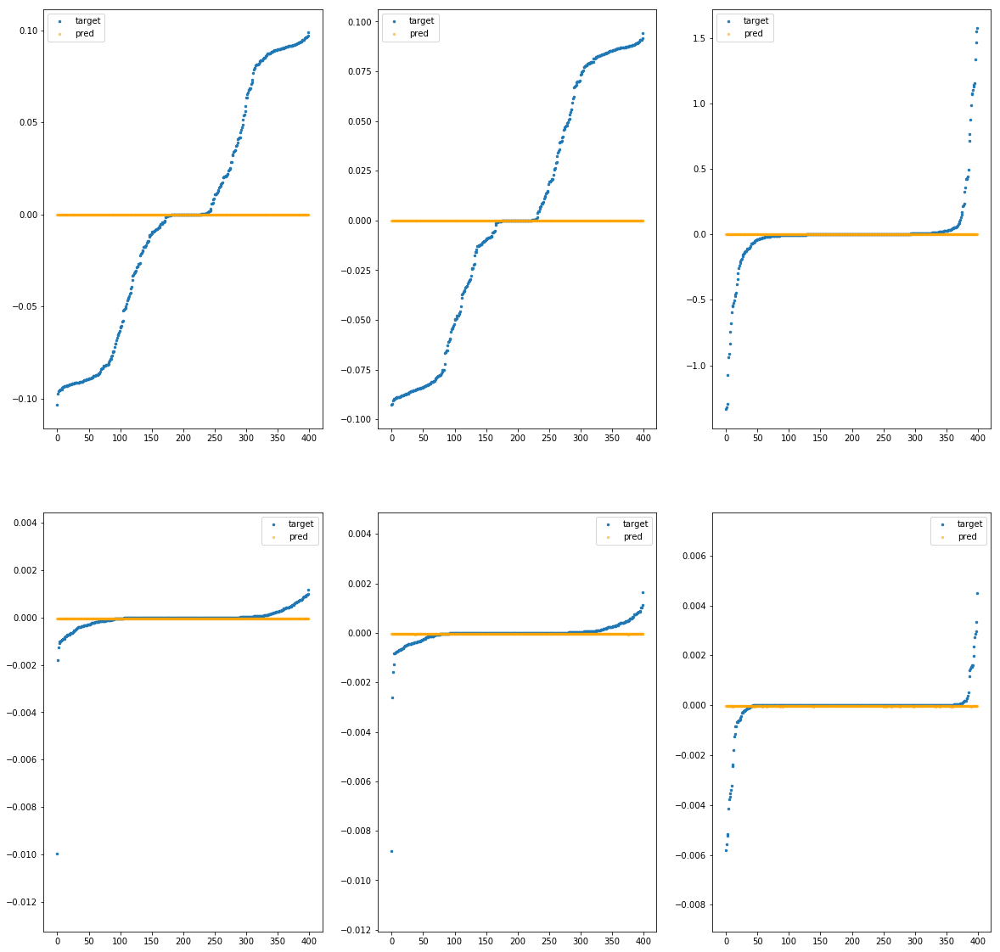

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f16160>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.17e-05	1.03e-01	5.17e-02	2.20e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	1.20e+01	3.85e-03	1.48e-05
z		-7.58e-04	1.57e+00	1.02e-01	5.97e+00	8.34e-02	6.95e-03
phi		-2.31e-03	9.94e-03	2.27e-04	3.63e+04	3.63e-07	1.32e-13
theta		-4.27e-03	8.79e-03	2.16e-04	9.40e+03	3.10e-07	9.62e-14
psi		-9.16e-04	5.78e-03	2.74e-04	5.36e+03	7.51e-07	5.64e-13


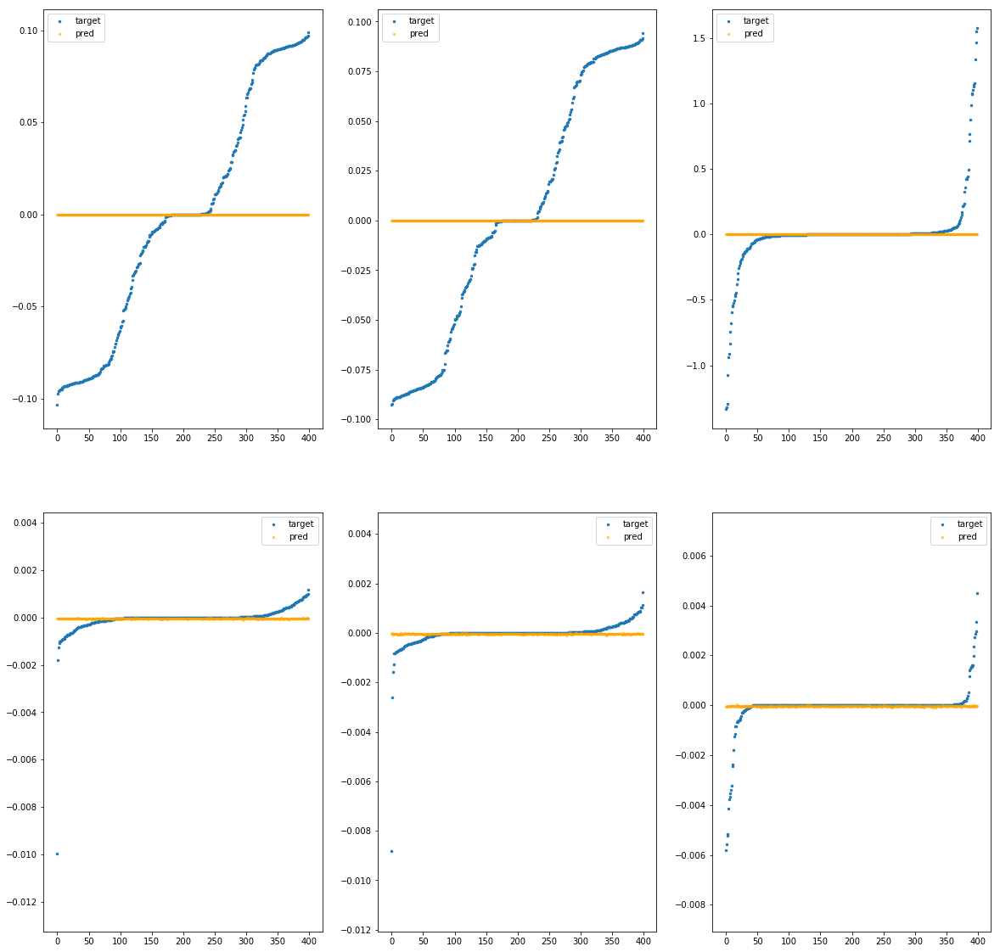

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f161c0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.66e-01	9.51e-01	2.27e-01	6.42e+03	8.11e-02	6.58e-03
y		-2.17e-01	9.33e-01	1.99e-01	7.85e+02	6.67e-02	4.45e-03
z		4.24e-02	6.42e+00	2.98e-01	4.68e+02	8.38e-01	7.02e-01
phi		-6.63e+03	5.99e-01	6.68e-02	2.52e+06	1.23e-02	1.52e-04
theta		-9.72e+03	5.99e-01	6.69e-02	4.07e+05	1.23e-02	1.52e-04
psi		-5.06e+02	5.99e-01	6.71e-02	1.16e+06	1.24e-02	1.54e-04


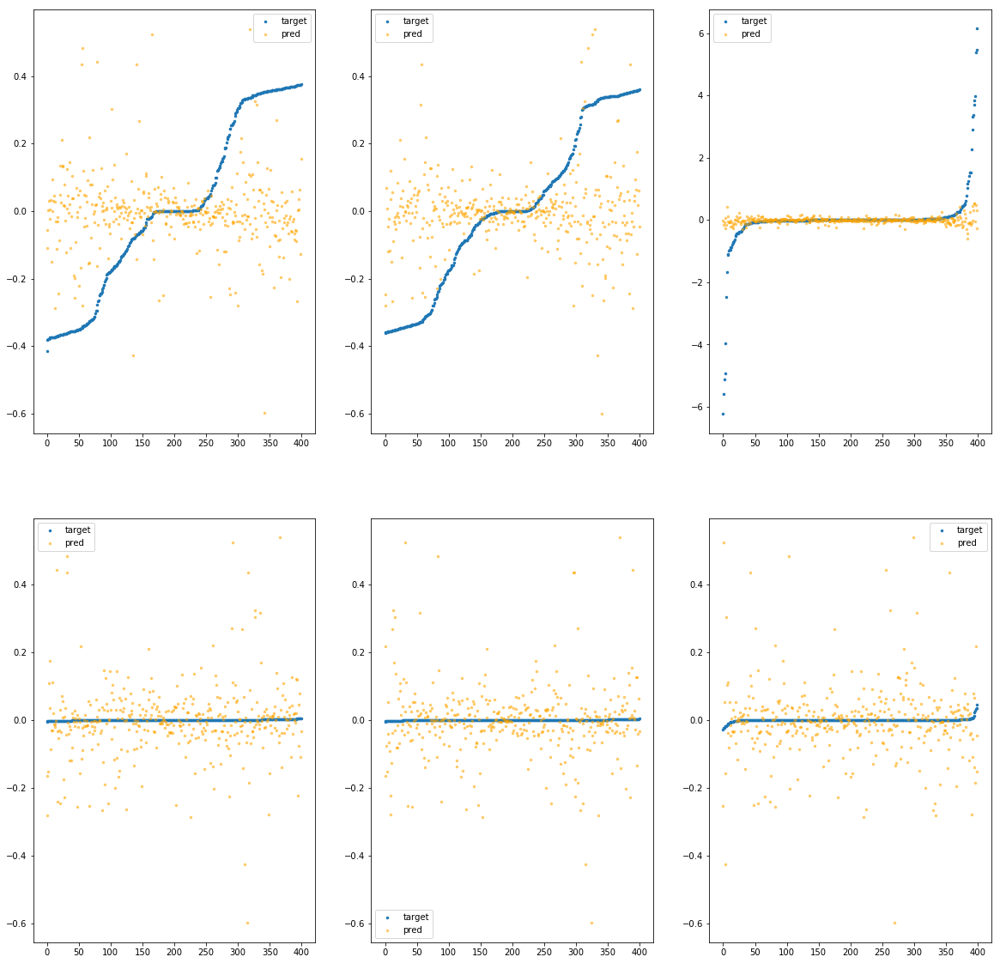

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16220>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.88e-01	1.03e+00	2.23e-01	5.85e+03	8.26e-02	6.82e-03
y		-2.53e-01	9.59e-01	2.01e-01	1.17e+03	6.87e-02	4.72e-03
z		-3.01e-04	6.22e+00	3.07e-01	6.27e+02	8.75e-01	7.66e-01
phi		-9.38e+03	6.87e-01	8.10e-02	2.14e+06	1.75e-02	3.05e-04
theta		-1.37e+04	6.85e-01	8.09e-02	7.04e+05	1.74e-02	3.03e-04
psi		-7.09e+02	6.84e-01	8.10e-02	1.17e+06	1.74e-02	3.03e-04


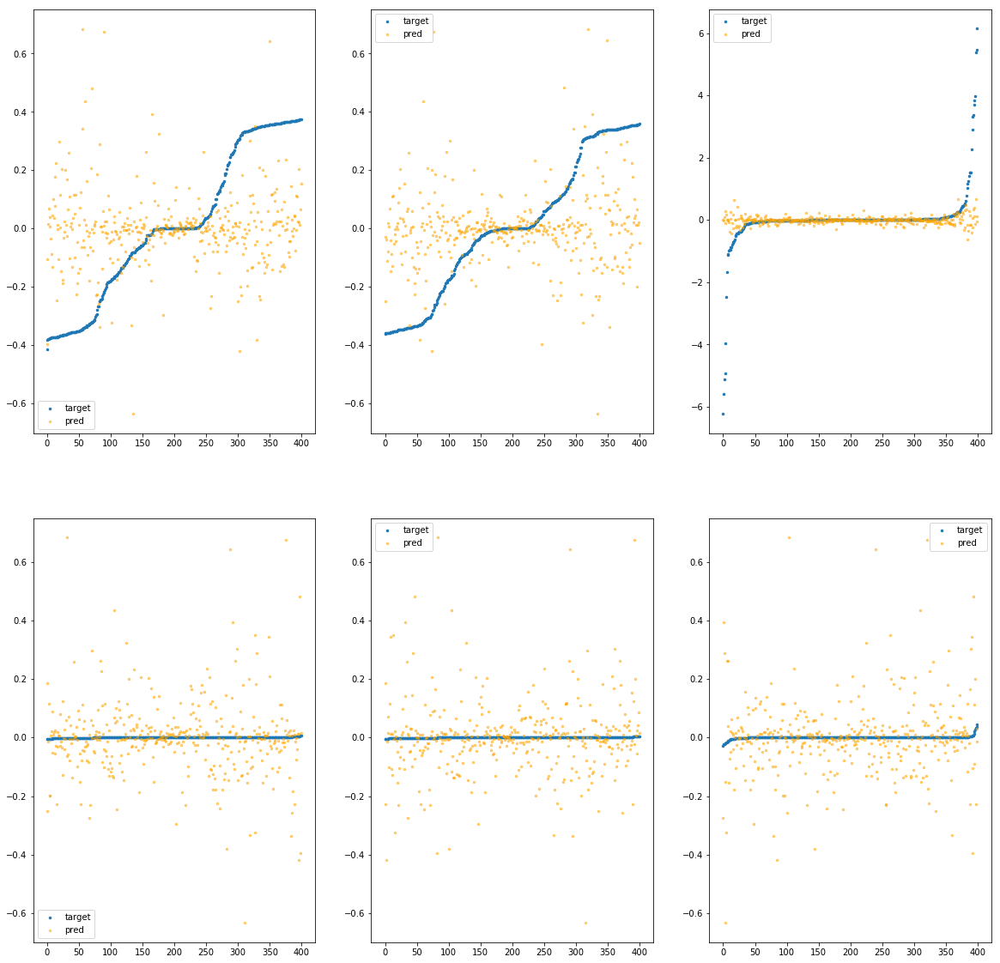

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16280>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.43e-01	9.48e-01	2.11e-01	7.33e+03	7.33e-02	5.37e-03
y		-1.57e-01	8.02e-01	1.96e-01	7.20e+02	6.34e-02	4.02e-03
z		1.33e-02	6.13e+00	3.04e-01	6.96e+02	8.63e-01	7.45e-01
phi		-6.77e+03	6.64e-01	6.93e-02	3.08e+06	1.26e-02	1.59e-04
theta		-9.91e+03	6.66e-01	6.92e-02	3.25e+05	1.26e-02	1.58e-04
psi		-5.11e+02	6.66e-01	6.92e-02	9.18e+05	1.26e-02	1.58e-04


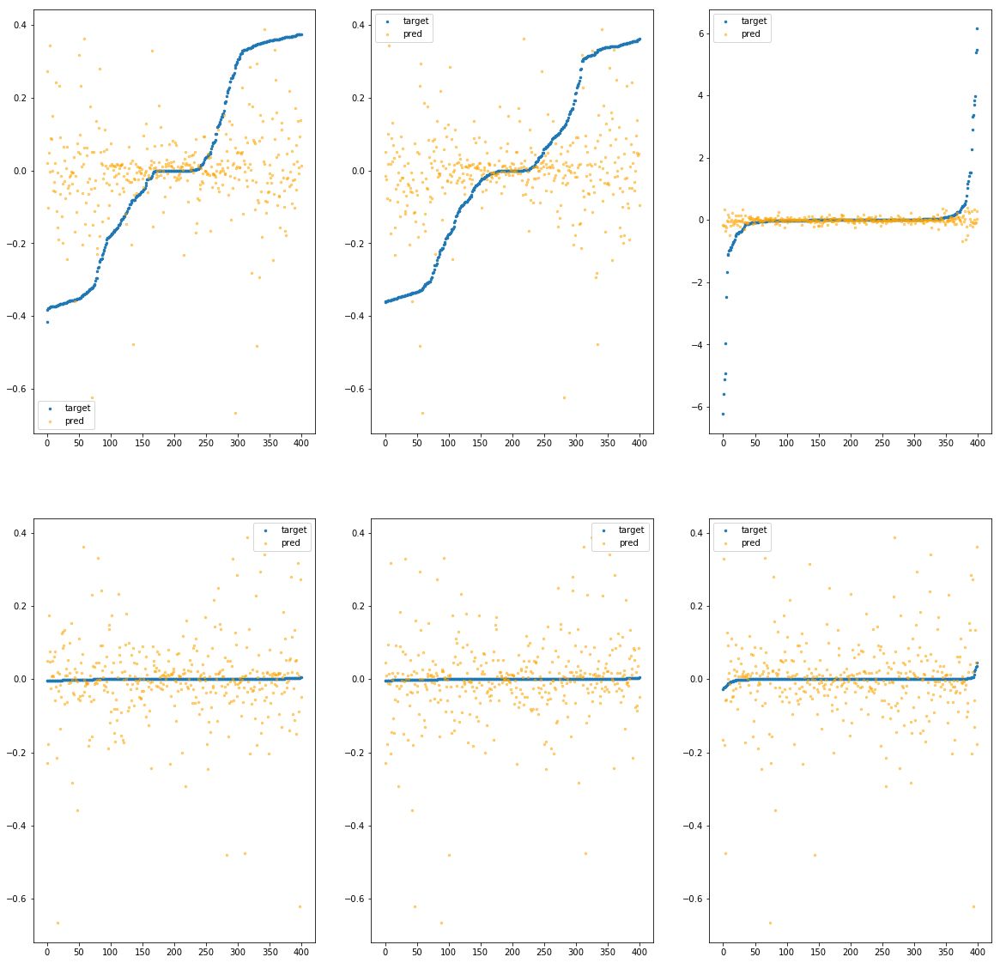

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f162e0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.33e-01	7.88e-01	2.20e-01	4.69e+03	7.90e-02	6.25e-03
y		-3.15e-01	8.57e-01	2.08e-01	1.35e+03	7.21e-02	5.20e-03
z		3.24e-02	6.24e+00	3.04e-01	5.98e+02	8.46e-01	7.17e-01
phi		-9.32e+03	9.39e-01	7.89e-02	1.71e+06	1.74e-02	3.01e-04
theta		-1.37e+04	9.40e-01	7.89e-02	1.34e+06	1.74e-02	3.02e-04
psi		-7.09e+02	9.41e-01	7.88e-02	1.25e+06	1.74e-02	3.03e-04


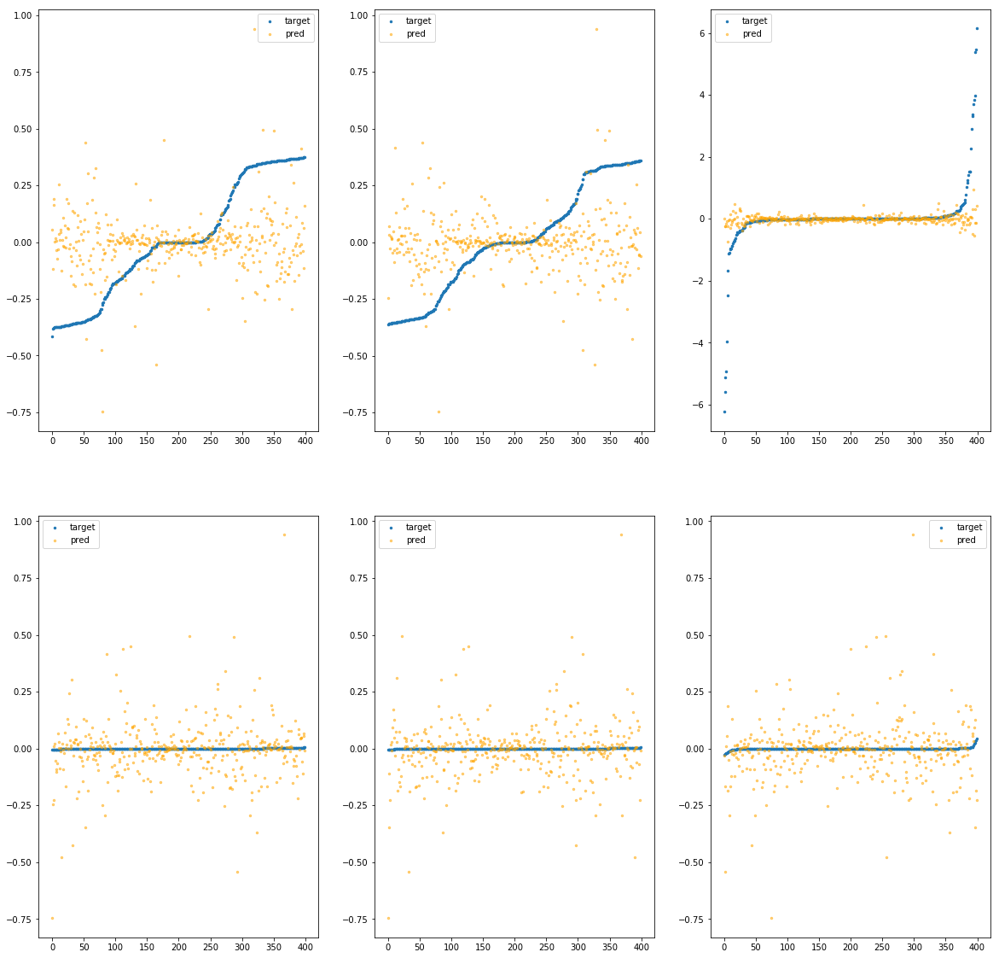

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16340>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.84e-01	1.28e+00	2.31e-01	7.11e+03	8.87e-02	7.88e-03
y		-3.34e-01	1.32e+00	2.00e-01	6.79e+02	7.31e-02	5.35e-03
z		-2.38e-02	6.11e+00	3.33e-01	1.18e+03	8.96e-01	8.02e-01
phi		-1.53e+04	9.68e-01	1.01e-01	3.46e+06	2.85e-02	8.13e-04
theta		-2.25e+04	9.67e-01	1.01e-01	7.05e+05	2.85e-02	8.14e-04
psi		-1.16e+03	9.68e-01	1.01e-01	1.53e+06	2.85e-02	8.14e-04


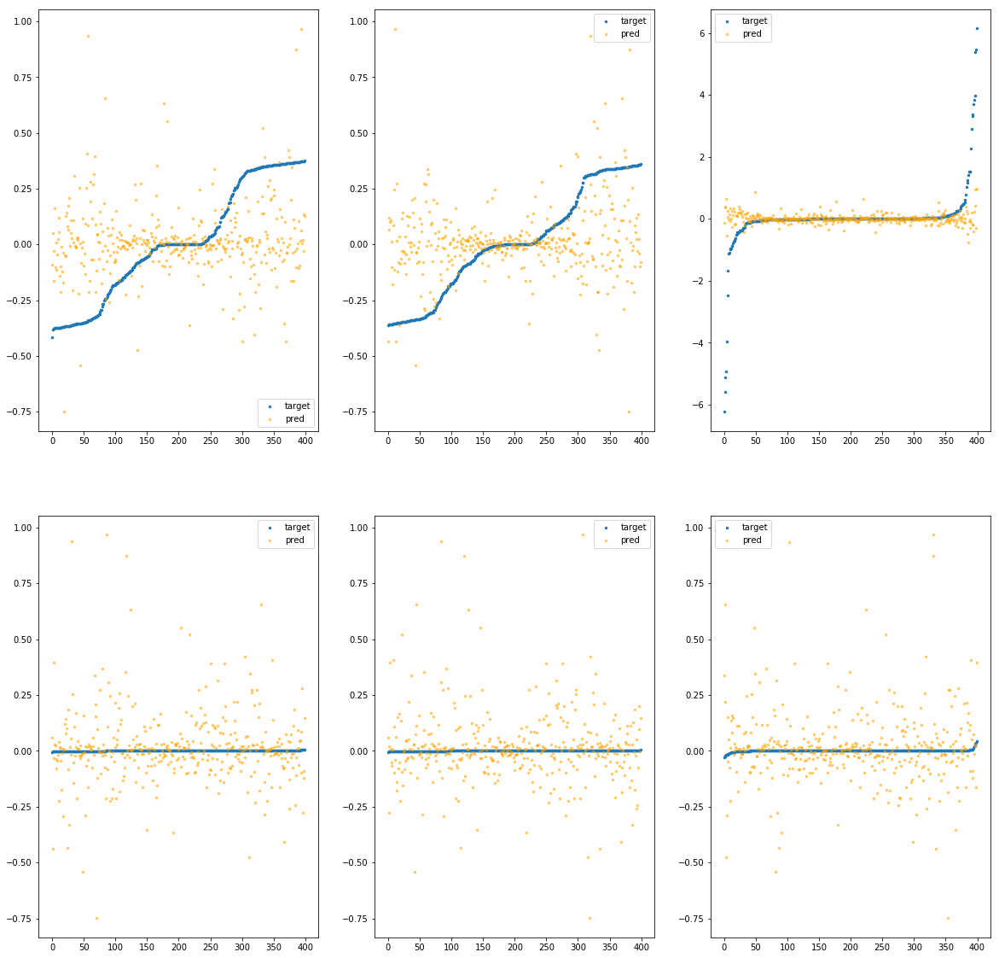

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f163a0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.46e-01	8.22e-01	2.13e-01	5.45e+03	7.35e-02	5.40e-03
y		-2.38e-01	8.05e-01	2.03e-01	9.09e+02	6.79e-02	4.61e-03
z		1.56e-02	6.25e+00	2.93e-01	4.26e+02	8.61e-01	7.42e-01
phi		-5.24e+03	7.27e-01	5.48e-02	1.96e+06	9.75e-03	9.51e-05
theta		-7.69e+03	7.27e-01	5.48e-02	3.93e+05	9.76e-03	9.53e-05
psi		-3.96e+02	7.29e-01	5.48e-02	1.36e+06	9.74e-03	9.50e-05


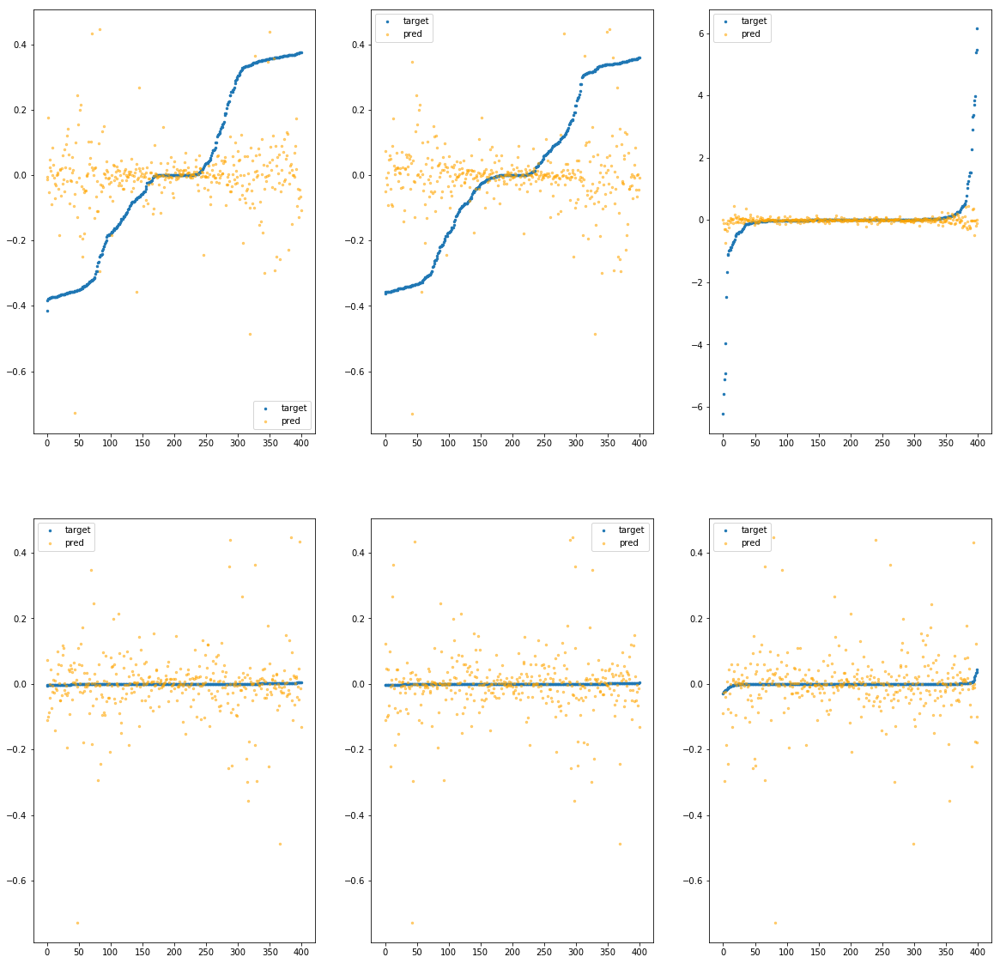

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16400>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.53e-01	8.90e-01	2.16e-01	4.52e+03	7.39e-02	5.46e-03
y		-1.17e-01	8.72e-01	1.94e-01	6.27e+02	6.13e-02	3.75e-03
z		1.04e-02	6.02e+00	3.05e-01	5.72e+02	8.66e-01	7.50e-01
phi		-5.39e+03	5.38e-01	6.38e-02	1.94e+06	1.00e-02	1.01e-04
theta		-7.91e+03	5.38e-01	6.37e-02	9.58e+05	1.01e-02	1.01e-04
psi		-4.06e+02	5.37e-01	6.37e-02	1.17e+06	9.98e-03	9.95e-05


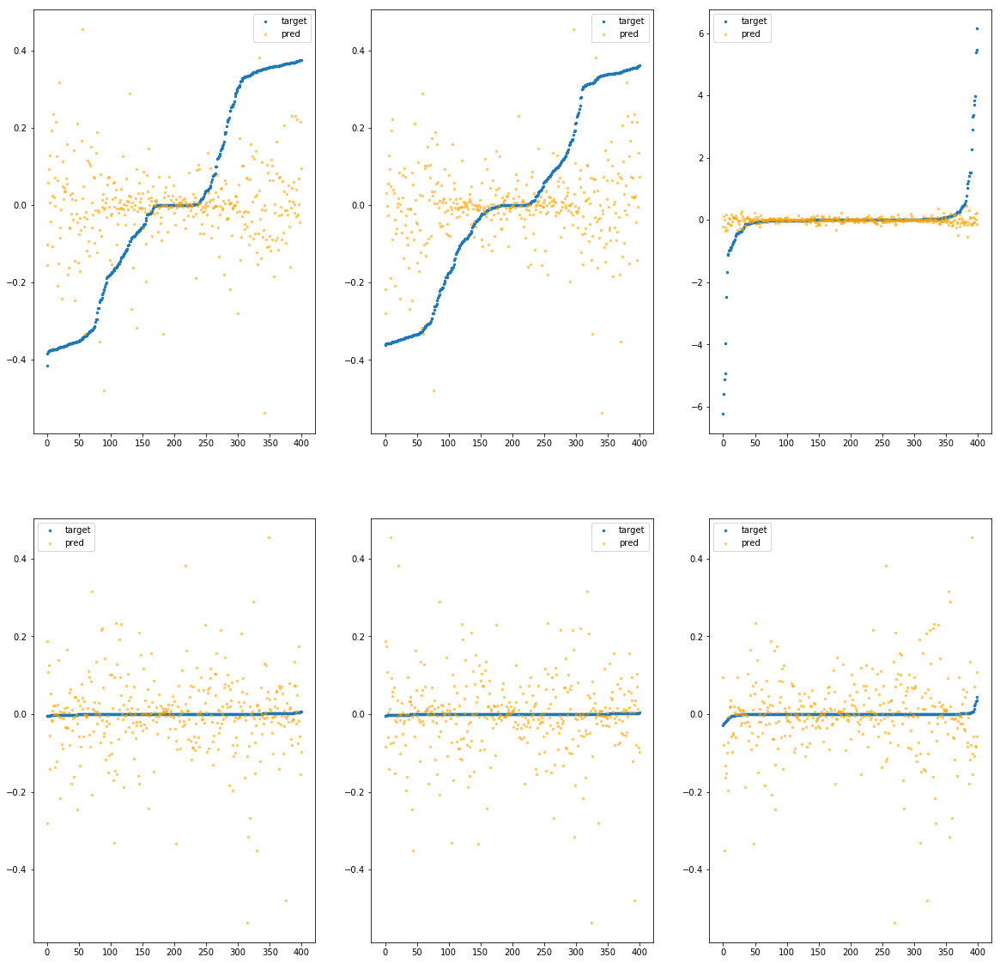

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16460>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.23e-01	8.57e-01	2.20e-01	4.22e+03	7.84e-02	6.14e-03
y		-3.17e-01	8.52e-01	2.05e-01	7.85e+02	7.22e-02	5.21e-03
z		-7.02e-03	6.09e+00	3.12e-01	9.01e+02	8.81e-01	7.76e-01
phi		-8.61e+03	5.09e-01	7.68e-02	1.68e+06	1.60e-02	2.57e-04
theta		-1.26e+04	5.07e-01	7.67e-02	1.13e+06	1.60e-02	2.56e-04
psi		-6.56e+02	5.09e-01	7.68e-02	9.40e+05	1.61e-02	2.60e-04


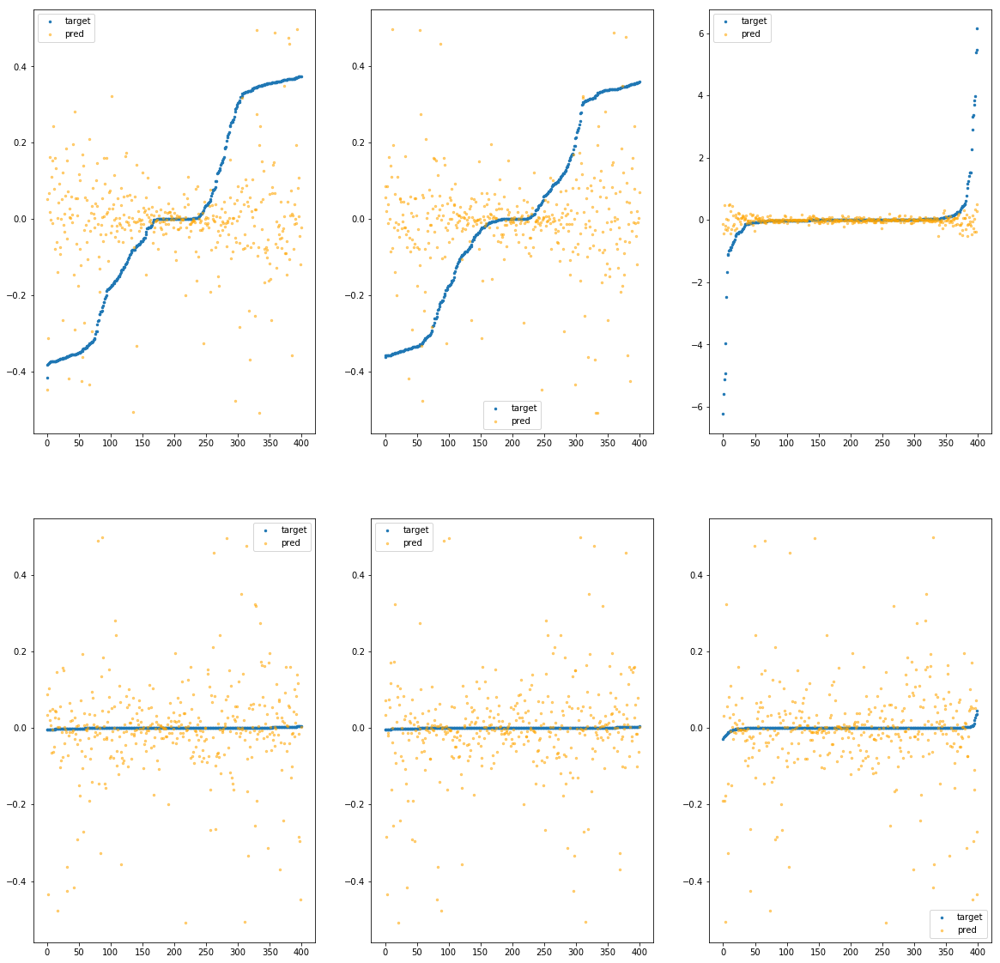

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f164c0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.55e-01	8.45e-01	2.23e-01	6.06e+03	8.05e-02	6.47e-03
y		-2.89e-01	7.22e-01	2.01e-01	1.66e+03	7.06e-02	4.99e-03
z		3.96e-03	6.26e+00	3.08e-01	1.13e+03	8.71e-01	7.59e-01
phi		-7.76e+03	4.90e-01	7.93e-02	2.41e+06	1.44e-02	2.09e-04
theta		-1.14e+04	4.90e-01	7.94e-02	1.26e+06	1.45e-02	2.09e-04
psi		-5.84e+02	4.91e-01	7.90e-02	1.71e+06	1.43e-02	2.06e-04


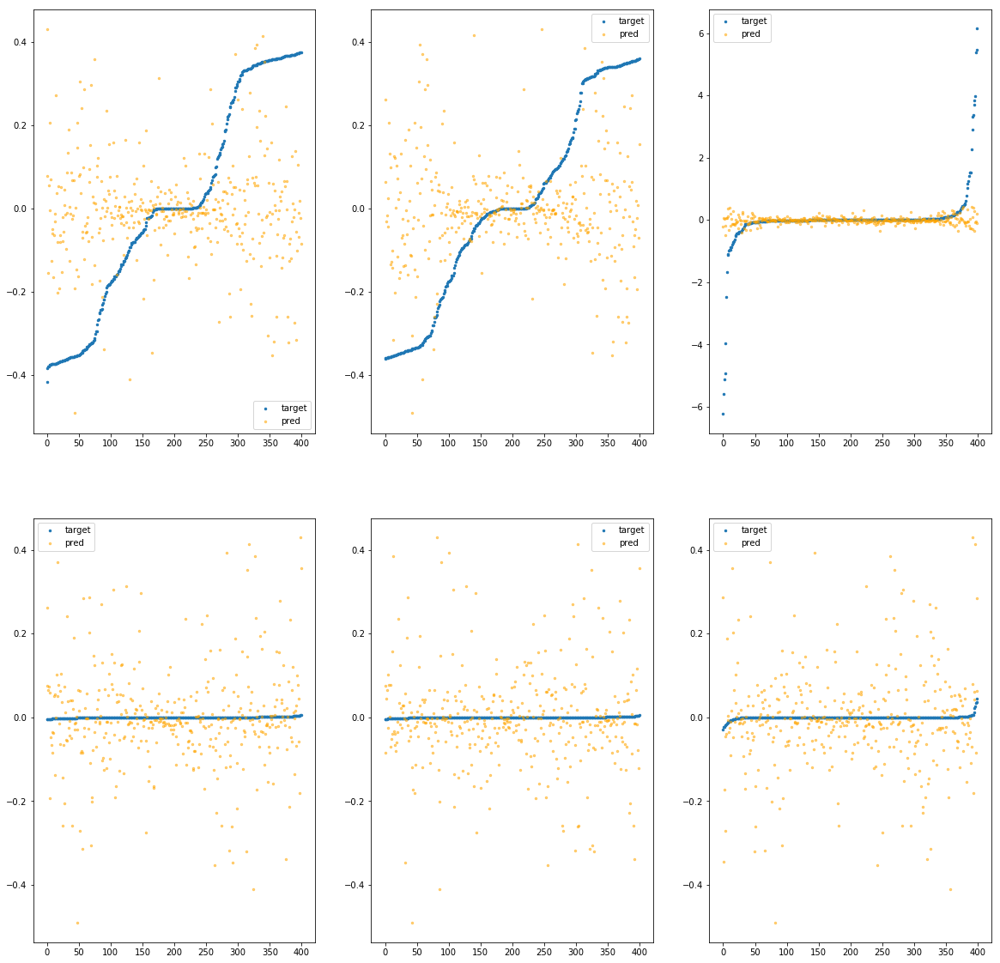

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16520>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.03e-01	8.16e-01	2.26e-01	7.54e+03	8.35e-02	6.98e-03
y		-4.00e-01	9.61e-01	2.11e-01	2.05e+03	7.67e-02	5.89e-03
z		-4.63e-03	6.10e+00	3.06e-01	6.77e+02	8.79e-01	7.72e-01
phi		-7.71e+03	6.37e-01	7.27e-02	2.90e+06	1.43e-02	2.06e-04
theta		-1.13e+04	6.35e-01	7.27e-02	9.99e+05	1.43e-02	2.06e-04
psi		-5.91e+02	6.34e-01	7.30e-02	1.26e+06	1.45e-02	2.11e-04


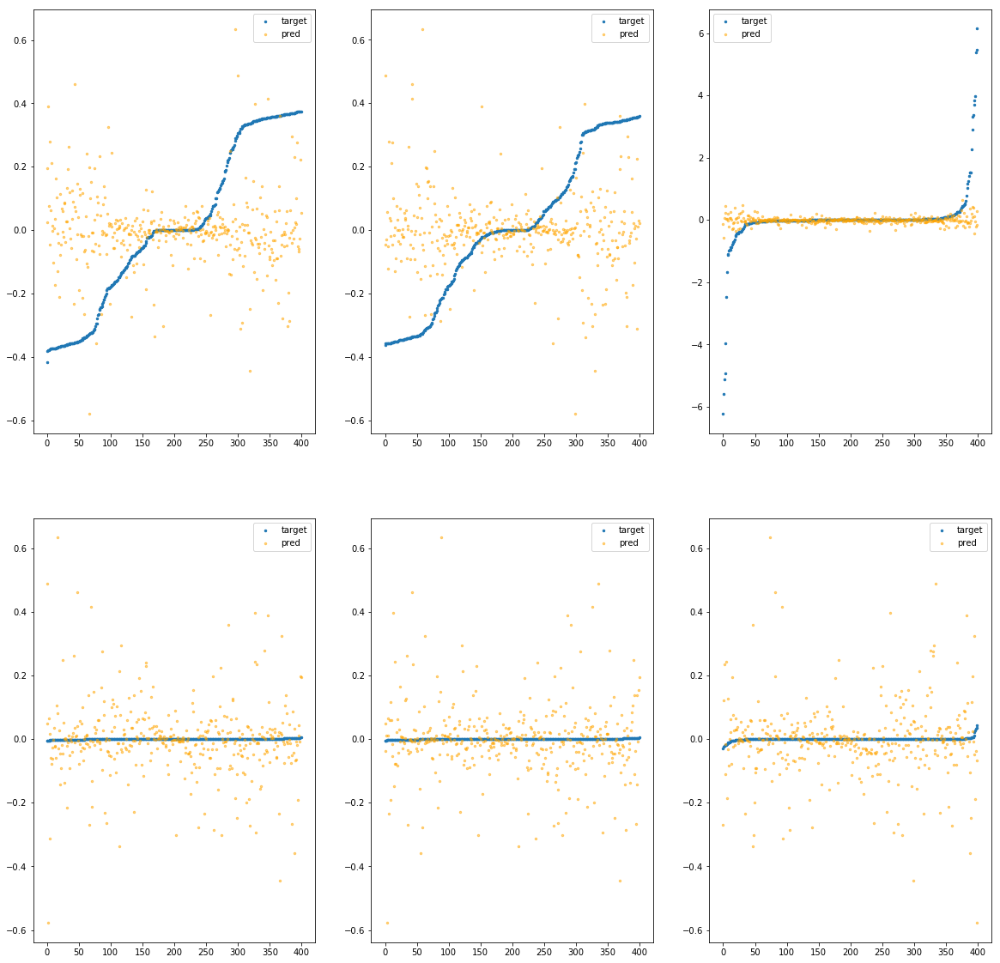

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16580>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.04e-01	8.72e-01	2.20e-01	4.21e+03	7.72e-02	5.96e-03
y		-2.95e-01	8.56e-01	2.05e-01	1.11e+03	7.10e-02	5.04e-03
z		8.36e-03	6.40e+00	2.99e-01	5.18e+02	8.68e-01	7.53e-01
phi		-6.55e+03	6.41e-01	6.45e-02	1.63e+06	1.22e-02	1.49e-04
theta		-9.60e+03	6.41e-01	6.45e-02	5.63e+05	1.22e-02	1.49e-04
psi		-5.02e+02	6.89e-01	6.45e-02	1.69e+06	1.24e-02	1.53e-04


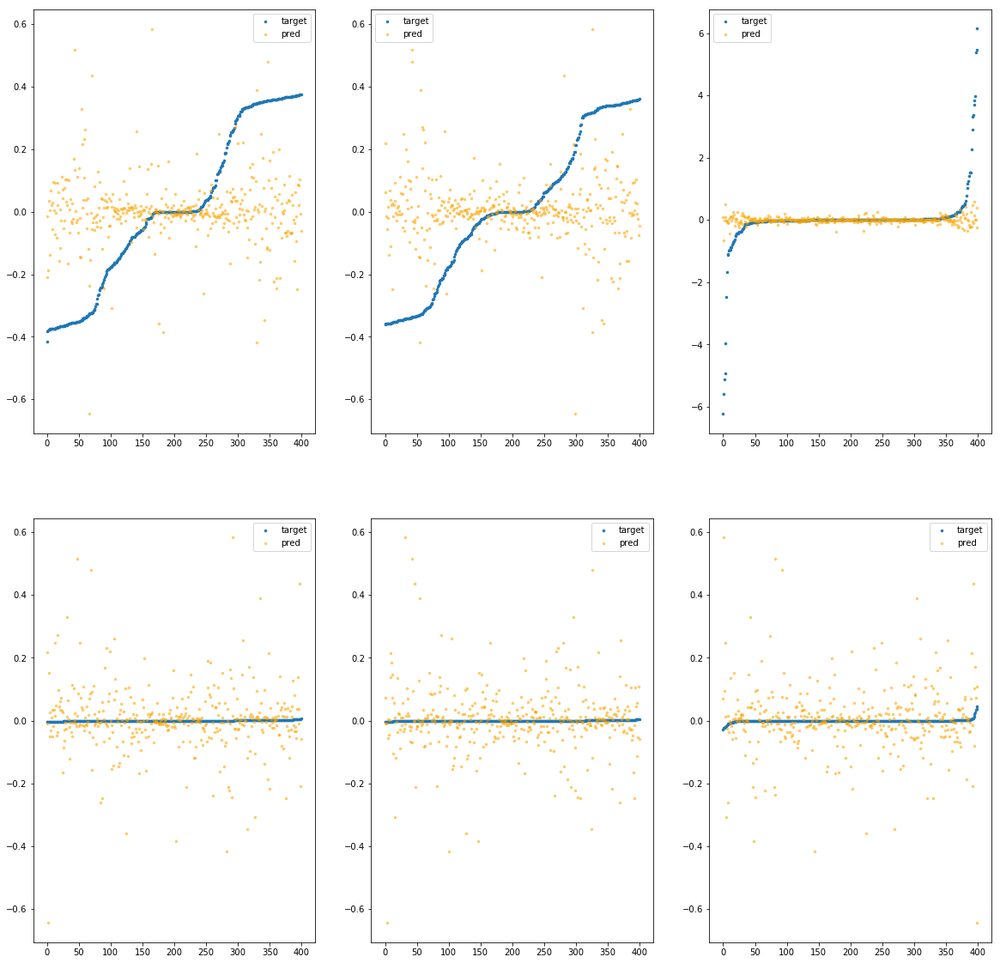

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f165e0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.36e-01	8.83e-01	2.15e-01	3.80e+03	7.28e-02	5.31e-03
y		-1.84e-01	7.07e-01	2.00e-01	8.07e+02	6.49e-02	4.21e-03
z		-4.25e-02	6.17e+00	2.98e-01	5.28e+02	9.12e-01	8.32e-01
phi		-4.32e+03	6.68e-01	5.22e-02	1.78e+06	8.04e-03	6.46e-05
theta		-6.31e+03	6.68e-01	5.22e-02	7.05e+05	8.01e-03	6.42e-05
psi		-3.28e+02	6.68e-01	5.23e-02	1.08e+06	8.08e-03	6.52e-05


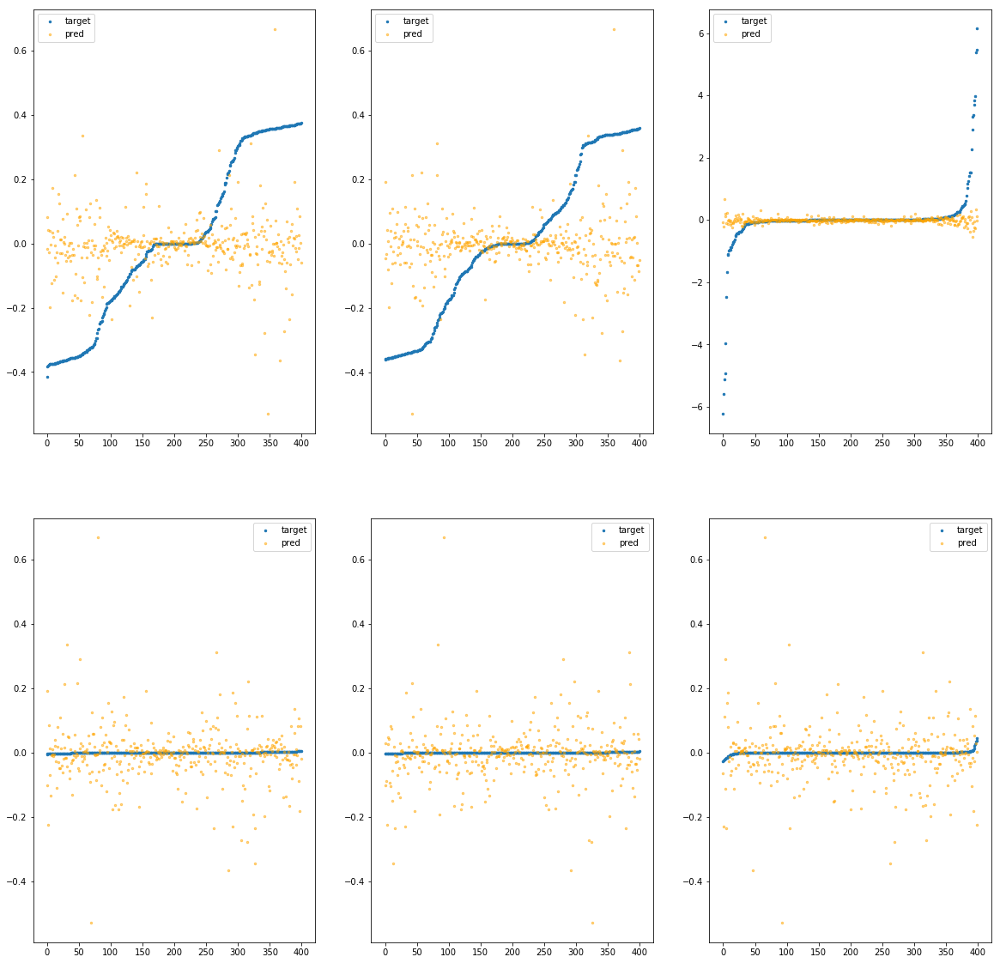

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16640>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.98e-01	1.01e+00	2.21e-01	3.59e+03	7.68e-02	5.90e-03
y		-1.93e-01	9.89e-01	1.99e-01	1.12e+03	6.54e-02	4.28e-03
z		-5.51e-02	6.52e+00	3.02e-01	5.96e+02	9.23e-01	8.52e-01
phi		-4.67e+03	6.54e-01	5.59e-02	1.41e+06	8.69e-03	7.55e-05
theta		-6.88e+03	6.54e-01	5.62e-02	1.19e+06	8.73e-03	7.63e-05
psi		-3.49e+02	6.53e-01	5.59e-02	7.24e+05	8.59e-03	7.38e-05


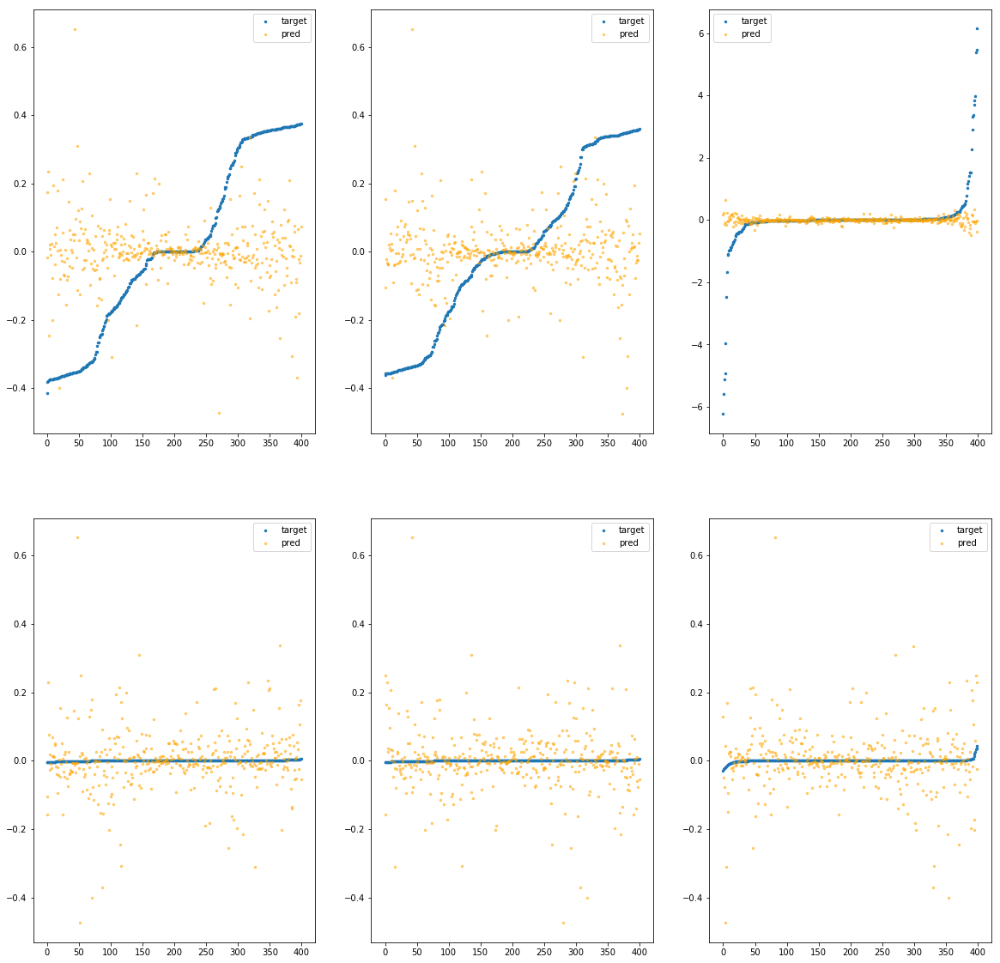

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f166a0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.82e-01	1.17e+00	2.29e-01	4.36e+03	8.86e-02	7.85e-03
y		-2.36e-01	1.14e+00	1.99e-01	1.15e+03	6.77e-02	4.59e-03
z		-1.11e-01	6.73e+00	3.13e-01	5.56e+02	9.72e-01	9.45e-01
phi		-7.70e+03	9.16e-01	6.58e-02	1.75e+06	1.43e-02	2.06e-04
theta		-1.13e+04	9.18e-01	6.58e-02	1.00e+06	1.43e-02	2.05e-04
psi		-5.82e+02	9.39e-01	6.57e-02	1.12e+06	1.43e-02	2.04e-04


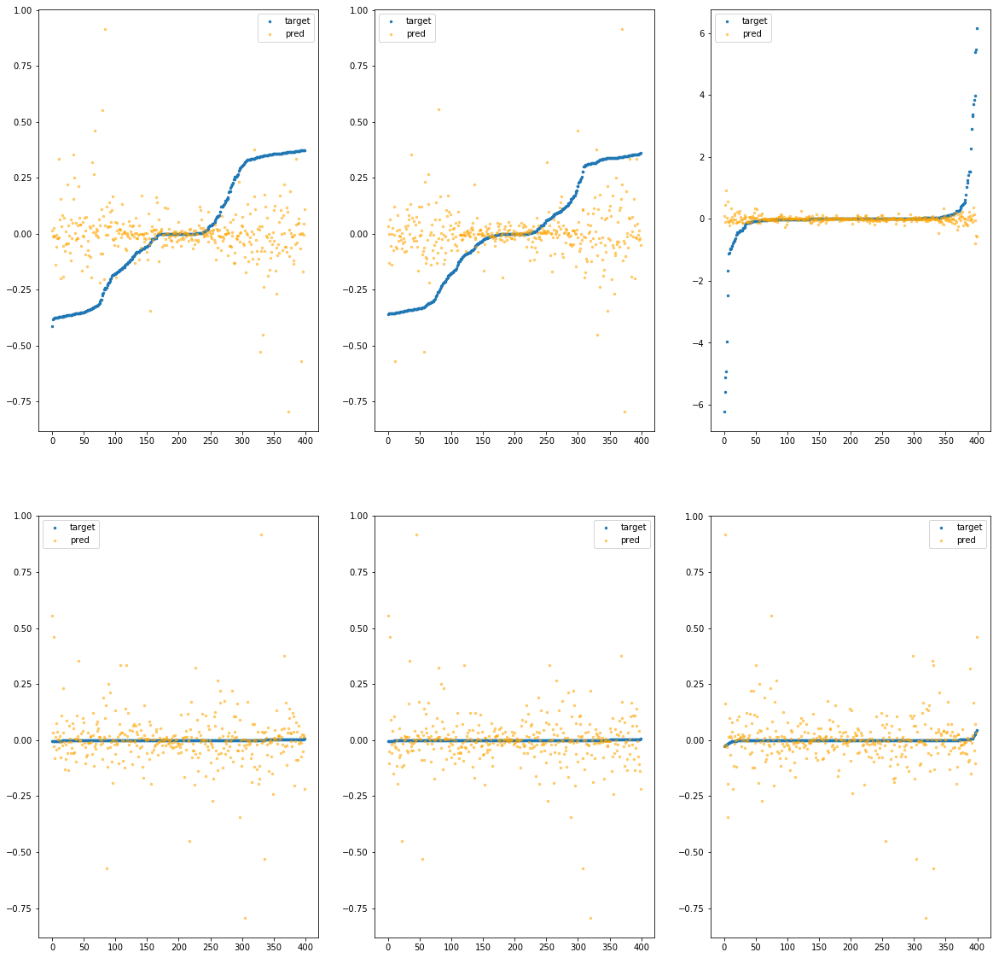

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16700>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.05e-01	9.12e-01	2.17e-01	4.85e+03	7.73e-02	5.97e-03
y		-2.76e-01	8.93e-01	2.02e-01	7.72e+02	7.00e-02	4.90e-03
z		-1.73e-02	6.42e+00	3.06e-01	9.90e+02	8.90e-01	7.92e-01
phi		-6.80e+03	5.52e-01	7.43e-02	1.54e+06	1.27e-02	1.60e-04
theta		-9.97e+03	5.52e-01	7.43e-02	5.58e+05	1.27e-02	1.60e-04
psi		-5.20e+02	5.52e-01	7.47e-02	1.57e+06	1.28e-02	1.63e-04


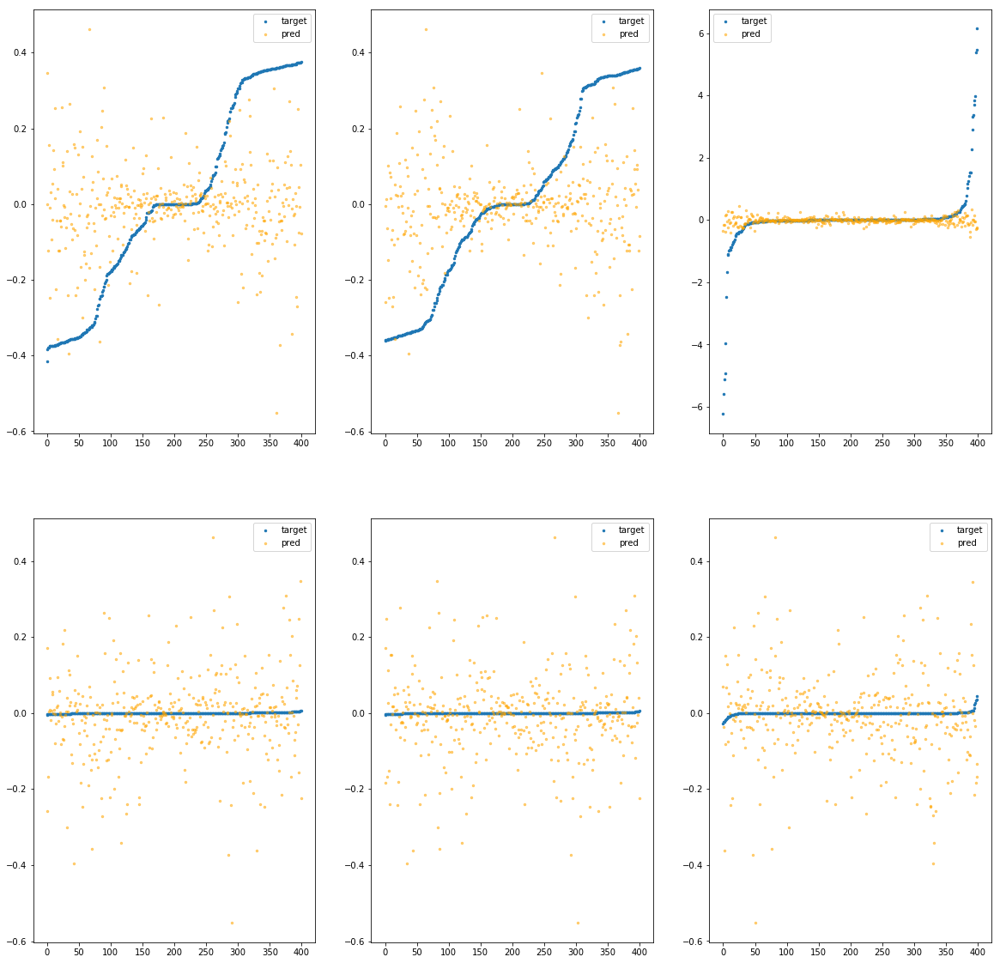

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16760>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.62e-01	7.06e-01	2.17e-01	4.08e+03	7.45e-02	5.55e-03
y		-1.78e-01	6.88e-01	1.96e-01	8.37e+02	6.46e-02	4.17e-03
z		2.19e-02	5.95e+00	2.96e-01	6.32e+02	8.56e-01	7.32e-01
phi		-5.00e+03	5.35e-01	6.08e-02	1.48e+06	9.32e-03	8.68e-05
theta		-7.33e+03	5.35e-01	6.08e-02	5.65e+05	9.31e-03	8.67e-05
psi		-3.80e+02	5.35e-01	6.07e-02	9.48e+05	9.36e-03	8.75e-05


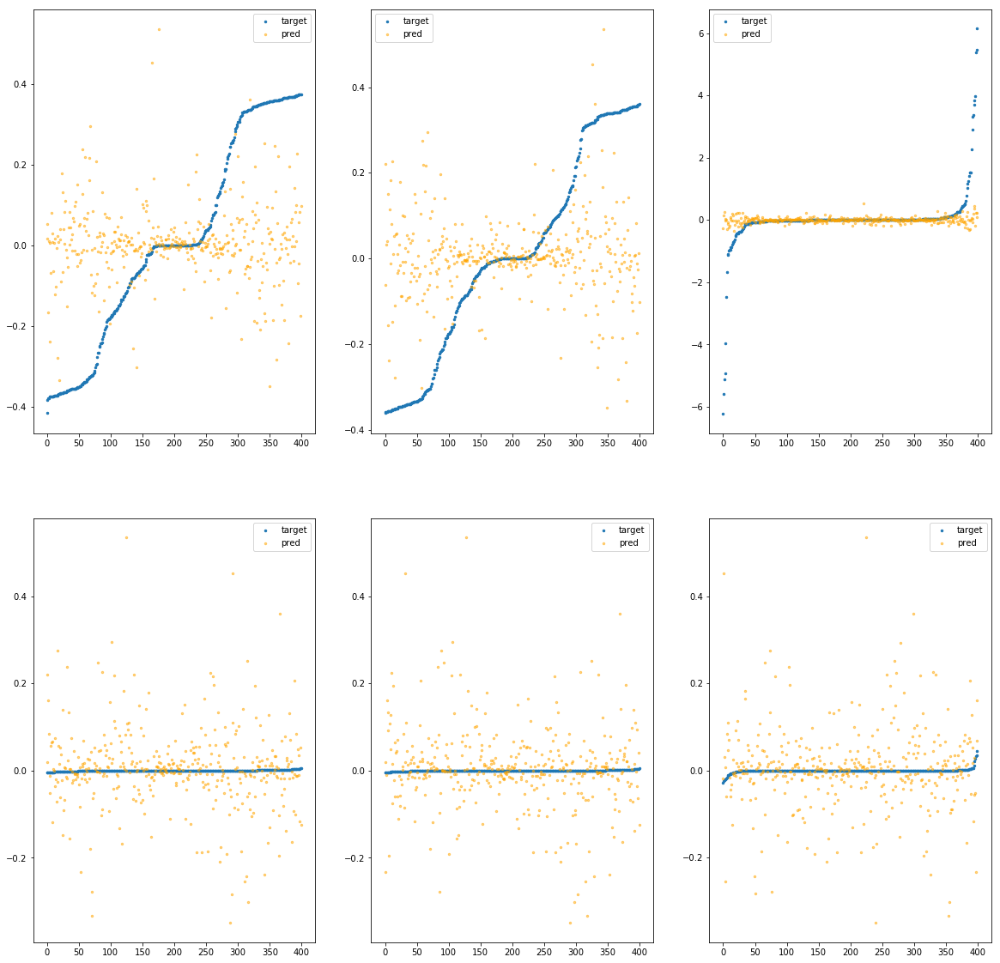

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f167c0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.06e-03	7.38e-01	2.03e-01	5.21e+03	6.46e-02	4.17e-03
y		-6.92e-02	7.38e-01	1.90e-01	7.65e+02	5.86e-02	3.44e-03
z		1.11e-02	6.17e+00	2.94e-01	5.62e+02	8.65e-01	7.48e-01
phi		-3.29e+03	3.83e-01	4.80e-02	1.71e+06	6.13e-03	3.76e-05
theta		-4.81e+03	3.83e-01	4.79e-02	5.80e+05	6.11e-03	3.74e-05
psi		-2.51e+02	3.83e-01	4.82e-02	5.78e+05	6.18e-03	3.82e-05


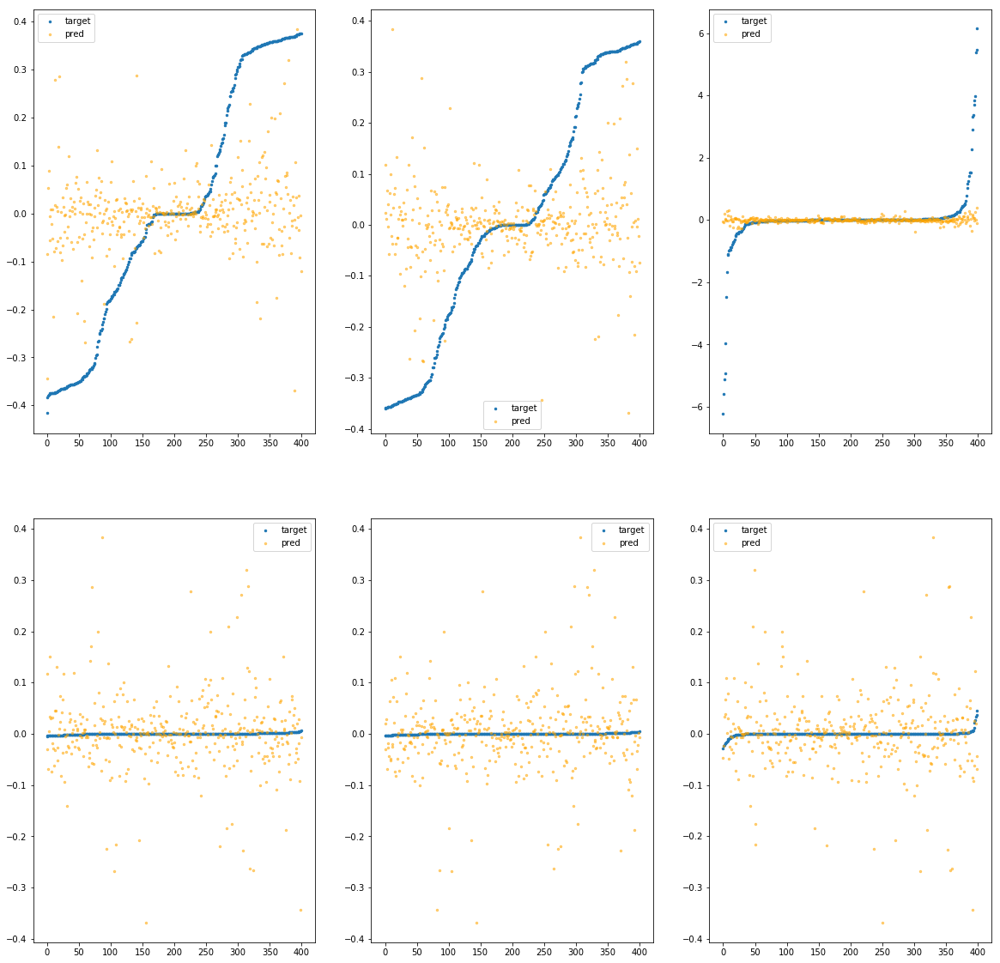

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16820>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.17e-02	8.14e-01	2.08e-01	6.66e+03	6.94e-02	4.81e-03
y		-2.04e-01	8.40e-01	1.97e-01	6.11e+02	6.60e-02	4.36e-03
z		2.02e-02	6.20e+00	3.03e-01	7.76e+02	8.57e-01	7.35e-01
phi		-6.74e+03	6.06e-01	6.83e-02	2.06e+06	1.26e-02	1.58e-04
theta		-9.86e+03	6.08e-01	6.83e-02	6.11e+05	1.25e-02	1.57e-04
psi		-5.18e+02	6.30e-01	6.87e-02	1.28e+06	1.27e-02	1.62e-04


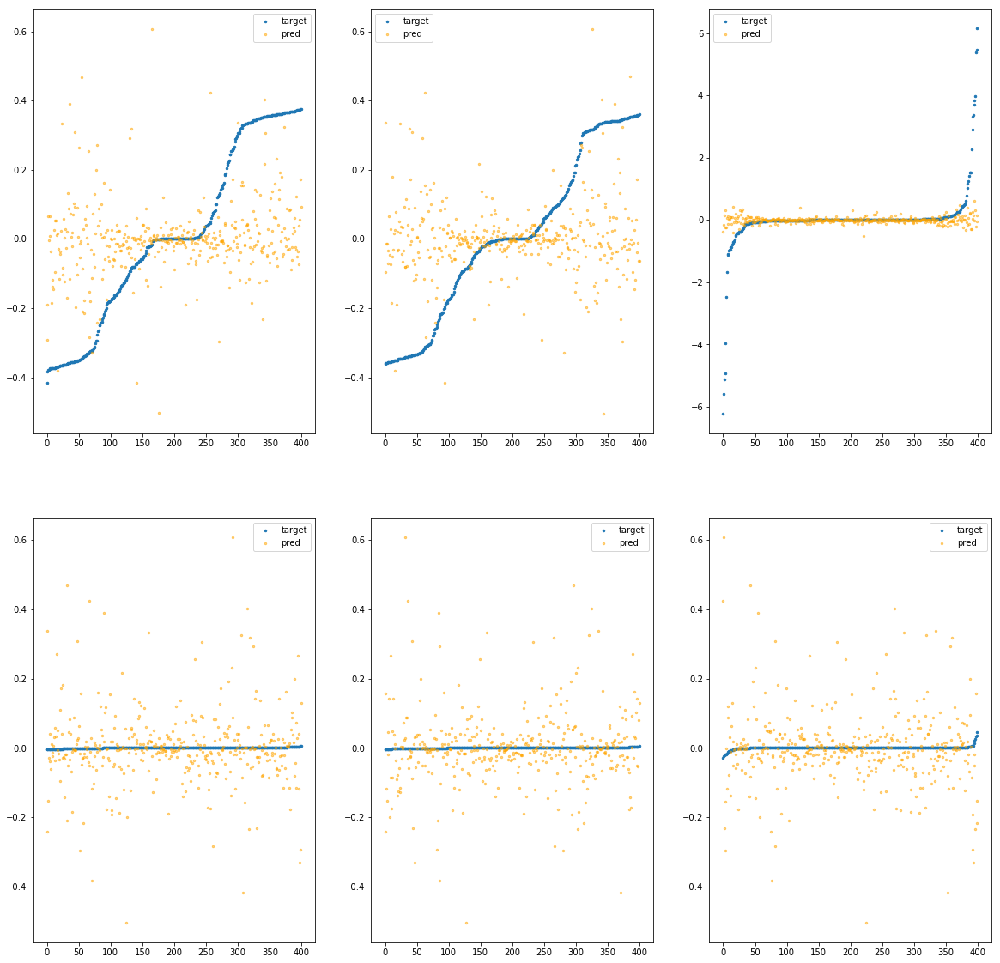

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f16880>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.81e-01	9.97e-01	2.23e-01	4.27e+03	8.21e-02	6.74e-03
y		-1.98e-01	9.72e-01	1.94e-01	5.05e+02	6.57e-02	4.31e-03
z		7.59e-02	6.35e+00	2.99e-01	6.83e+02	8.08e-01	6.54e-01
phi		-8.82e+03	6.49e-01	7.51e-02	1.51e+06	1.64e-02	2.70e-04
theta		-1.29e+04	6.47e-01	7.52e-02	4.84e+05	1.64e-02	2.70e-04
psi		-6.74e+02	6.49e-01	7.54e-02	1.29e+06	1.66e-02	2.74e-04


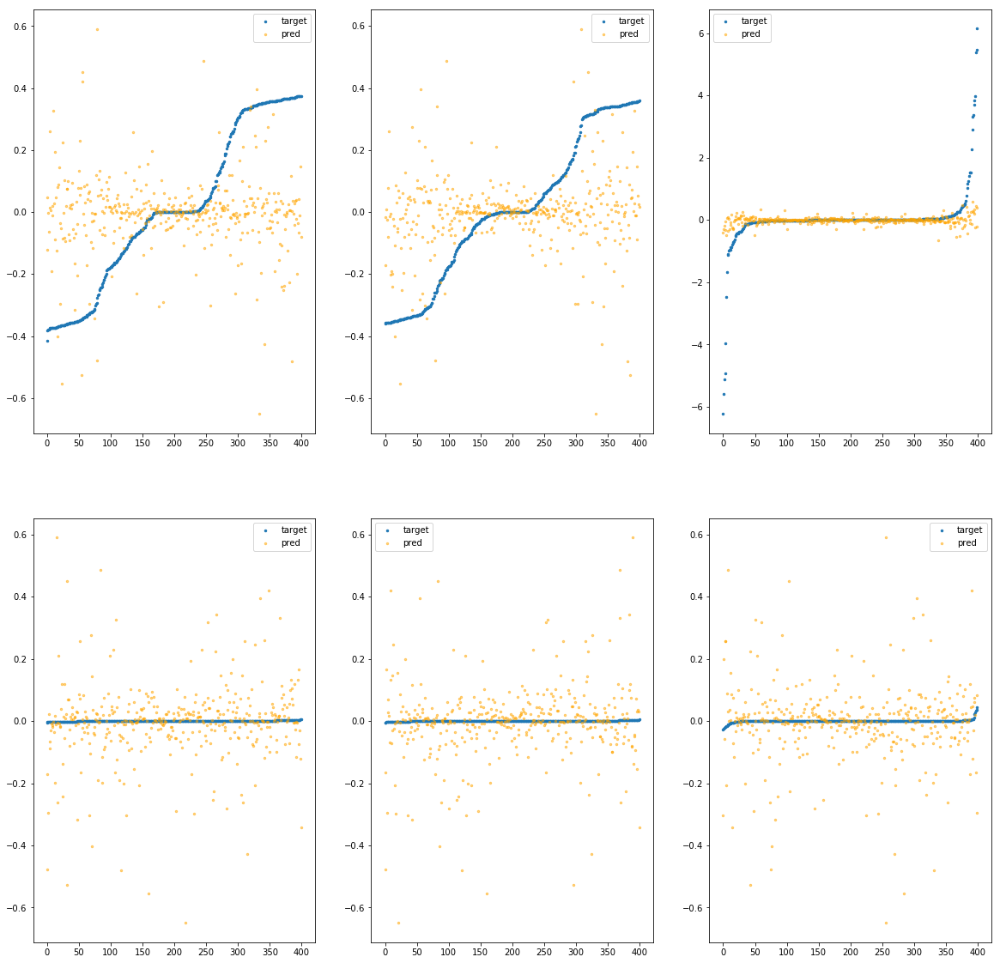

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fb253f168e0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.82e-01	9.68e-01	2.25e-01	5.89e+03	8.22e-02	6.76e-03
y		-3.02e-01	9.49e-01	2.03e-01	6.02e+02	7.14e-02	5.09e-03
z		-3.12e-02	6.82e+00	3.10e-01	5.76e+02	9.02e-01	8.14e-01
phi		-7.08e+03	5.97e-01	6.99e-02	2.45e+06	1.32e-02	1.74e-04
theta		-1.04e+04	5.97e-01	6.98e-02	7.20e+05	1.32e-02	1.73e-04
psi		-5.44e+02	5.96e-01	6.99e-02	8.25e+05	1.34e-02	1.79e-04


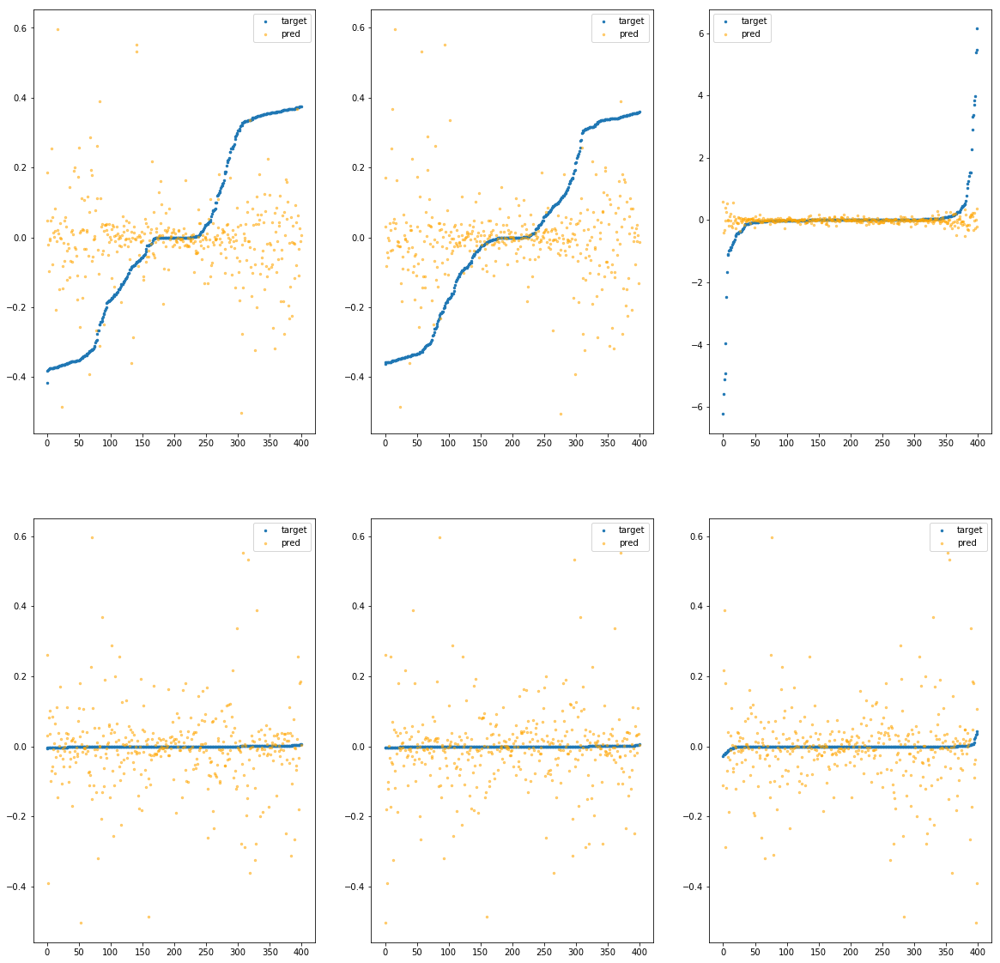

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16940>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.35e-03	4.14e-01	2.05e-01	1.17e+03	6.40e-02	4.10e-03
y		-1.38e-03	3.69e-01	1.88e-01	1.70e+02	5.49e-02	3.01e-03
z		-9.79e-04	6.24e+00	2.78e-01	1.16e+02	8.76e-01	7.67e-01
phi		-1.08e+01	1.72e-02	3.65e-03	4.88e+05	2.20e-05	4.85e-10
theta		-1.55e+01	1.89e-02	3.54e-03	1.70e+05	2.09e-05	4.38e-10
psi		-8.75e-01	4.12e-02	4.29e-03	5.13e+04	4.60e-05	2.12e-09


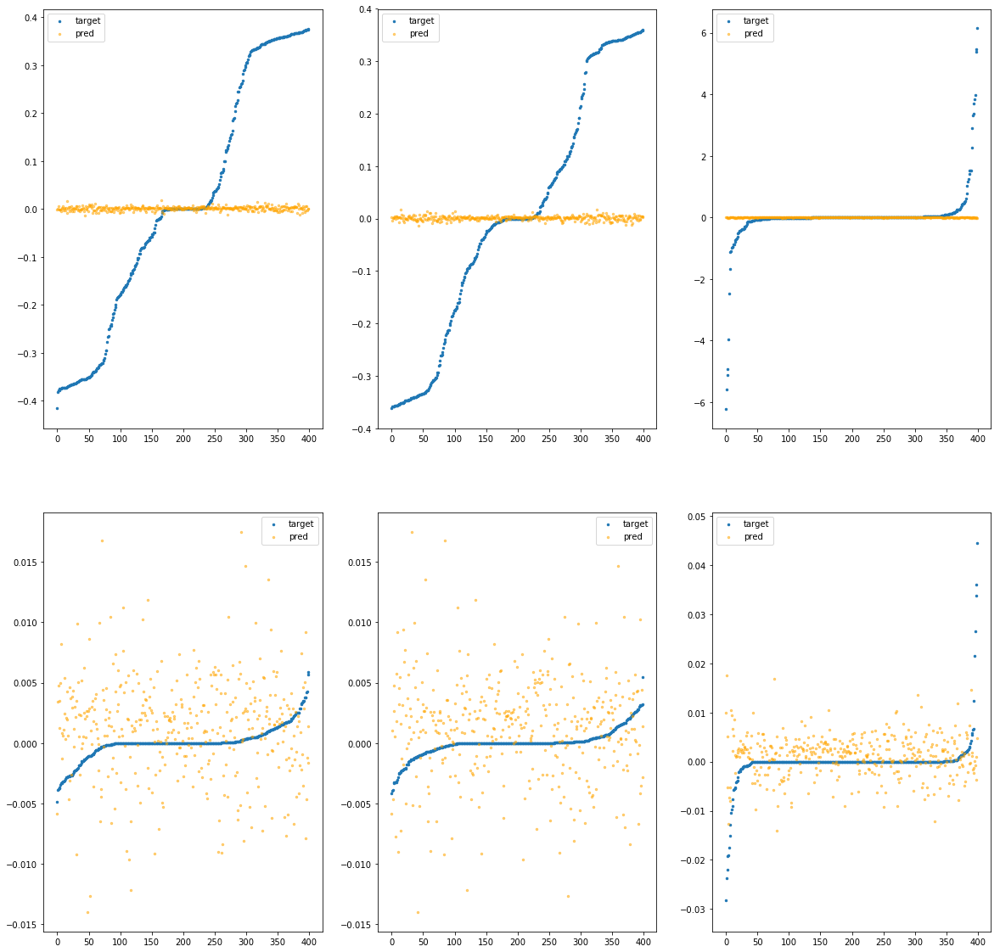

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f169a0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.53e-03	4.18e-01	2.06e-01	7.10e+02	6.43e-02	4.13e-03
y		-5.24e-03	3.71e-01	1.88e-01	1.49e+02	5.51e-02	3.04e-03
z		-1.84e-03	6.23e+00	2.78e-01	8.89e+01	8.76e-01	7.68e-01
phi		-1.08e+01	2.52e-02	3.31e-03	3.03e+05	2.20e-05	4.85e-10
theta		-1.57e+01	2.53e-02	3.20e-03	1.41e+05	2.13e-05	4.52e-10
psi		-8.69e-01	4.99e-02	3.97e-03	6.95e+04	4.58e-05	2.10e-09


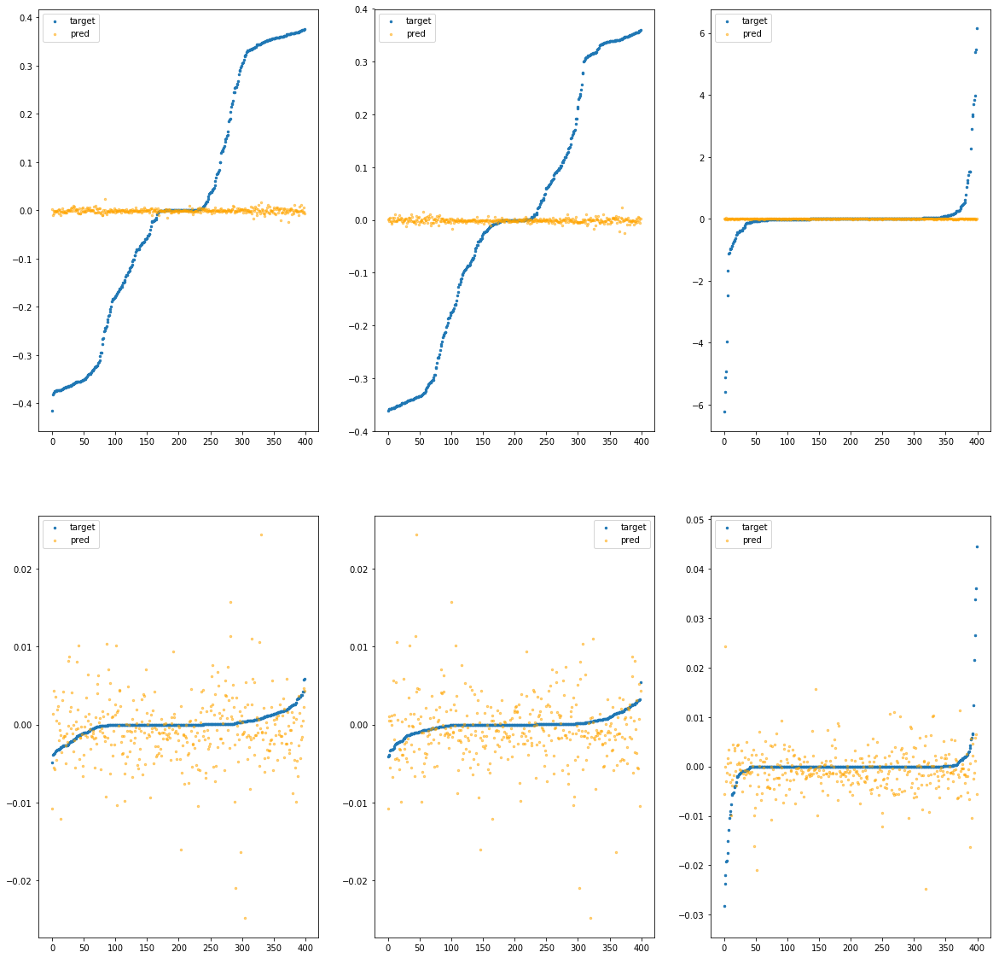

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16a00>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.26e-03	4.20e-01	2.06e-01	2.07e+03	6.43e-02	4.13e-03
y		-4.99e-03	4.12e-01	1.88e-01	3.45e+02	5.51e-02	3.04e-03
z		2.51e-03	6.25e+00	2.80e-01	1.63e+02	8.73e-01	7.62e-01
phi		-7.52e+01	6.96e-02	8.10e-03	7.44e+05	1.42e-04	2.01e-08
theta		-1.12e+02	6.77e-02	8.09e-03	2.26e+05	1.44e-04	2.07e-08
psi		-5.62e+00	6.81e-02	8.39e-03	1.42e+05	1.62e-04	2.64e-08


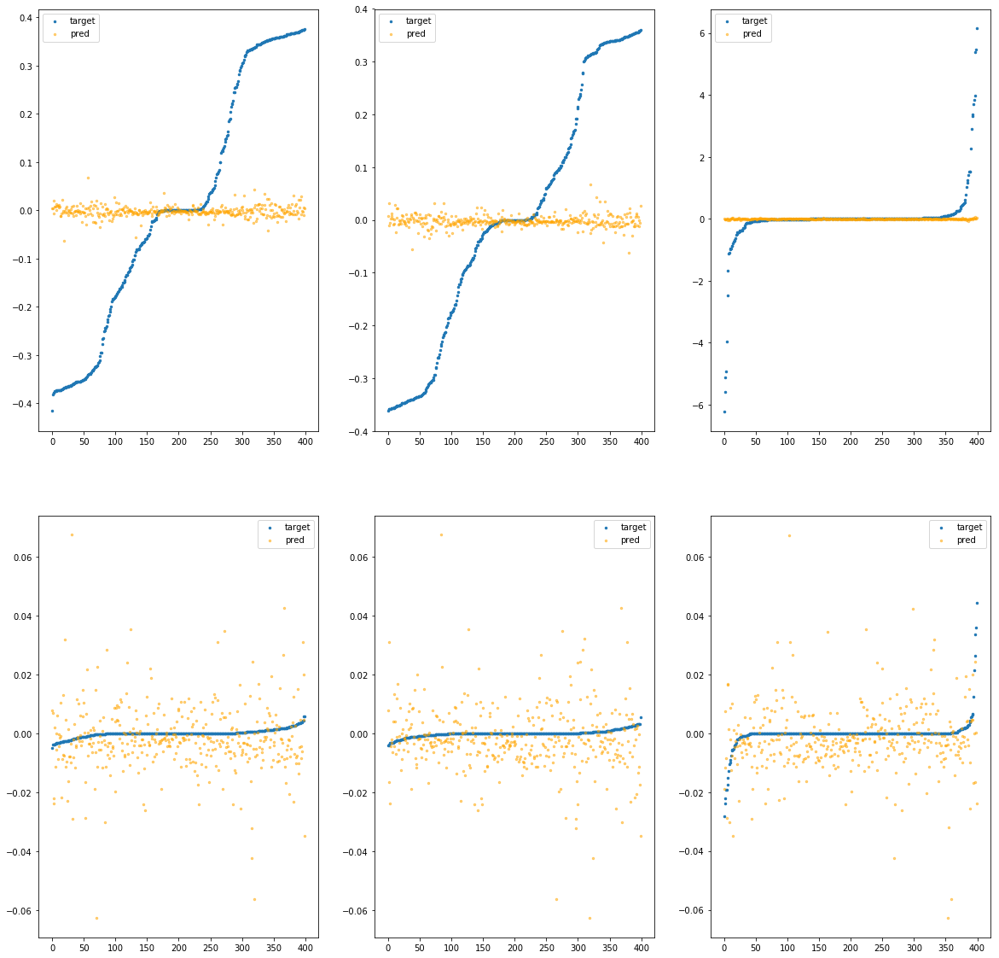

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16a60>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.17e-02	4.90e-01	2.07e-01	2.13e+03	6.49e-02	4.21e-03
y		1.11e-02	4.52e-01	1.86e-01	5.05e+02	5.42e-02	2.94e-03
z		6.78e-04	6.30e+00	2.80e-01	2.13e+02	8.74e-01	7.64e-01
phi		-4.69e+02	1.49e-01	1.83e-02	9.19e+05	8.74e-04	7.65e-07
theta		-6.91e+02	1.49e-01	1.84e-02	3.93e+05	8.79e-04	7.73e-07
psi		-3.46e+01	1.46e-01	1.85e-02	2.64e+05	8.72e-04	7.61e-07


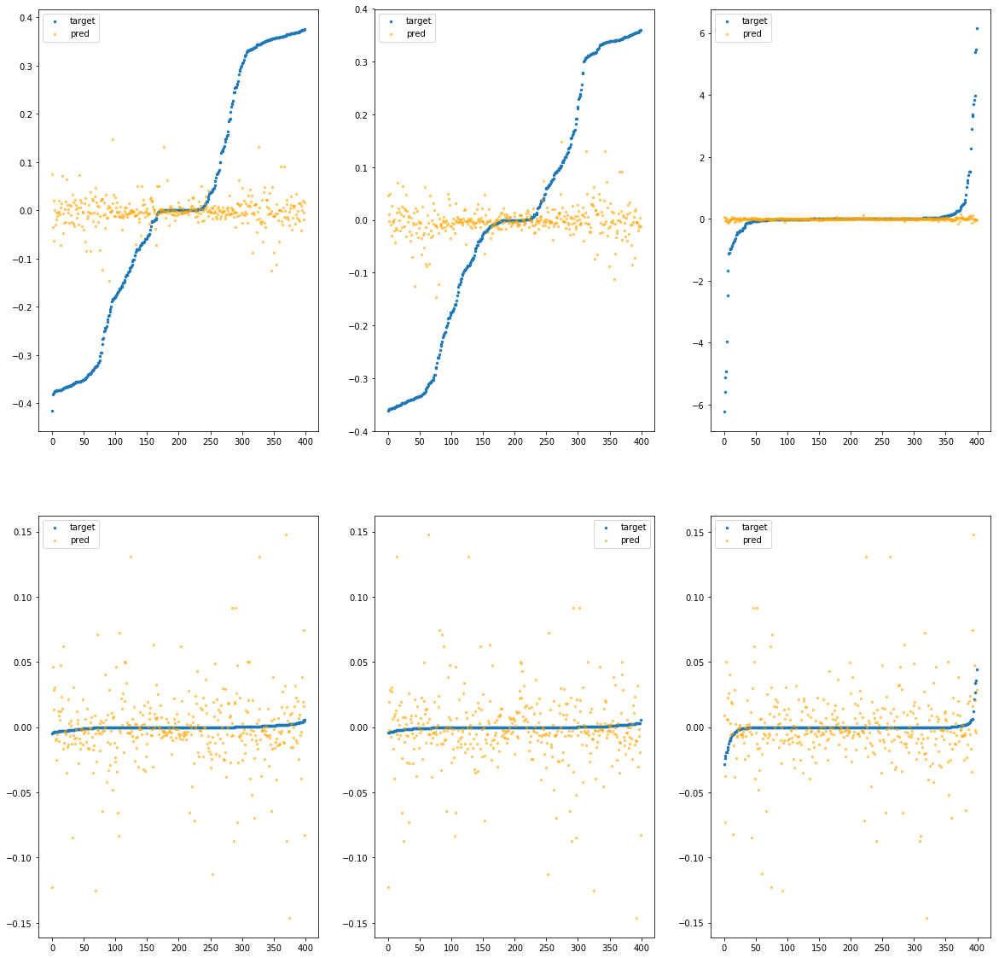

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16ac0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.74e-02	5.16e-01	2.12e-01	4.24e+03	6.72e-02	4.51e-03
y		1.55e-03	4.93e-01	1.88e-01	6.42e+02	5.47e-02	3.00e-03
z		3.89e-03	6.32e+00	2.82e-01	2.64e+02	8.71e-01	7.59e-01
phi		-9.67e+02	3.50e-01	2.56e-02	1.53e+06	1.80e-03	3.24e-06
theta		-1.41e+03	3.50e-01	2.55e-02	3.32e+05	1.79e-03	3.20e-06
psi		-7.55e+01	3.69e-01	2.59e-02	6.44e+05	1.88e-03	3.52e-06


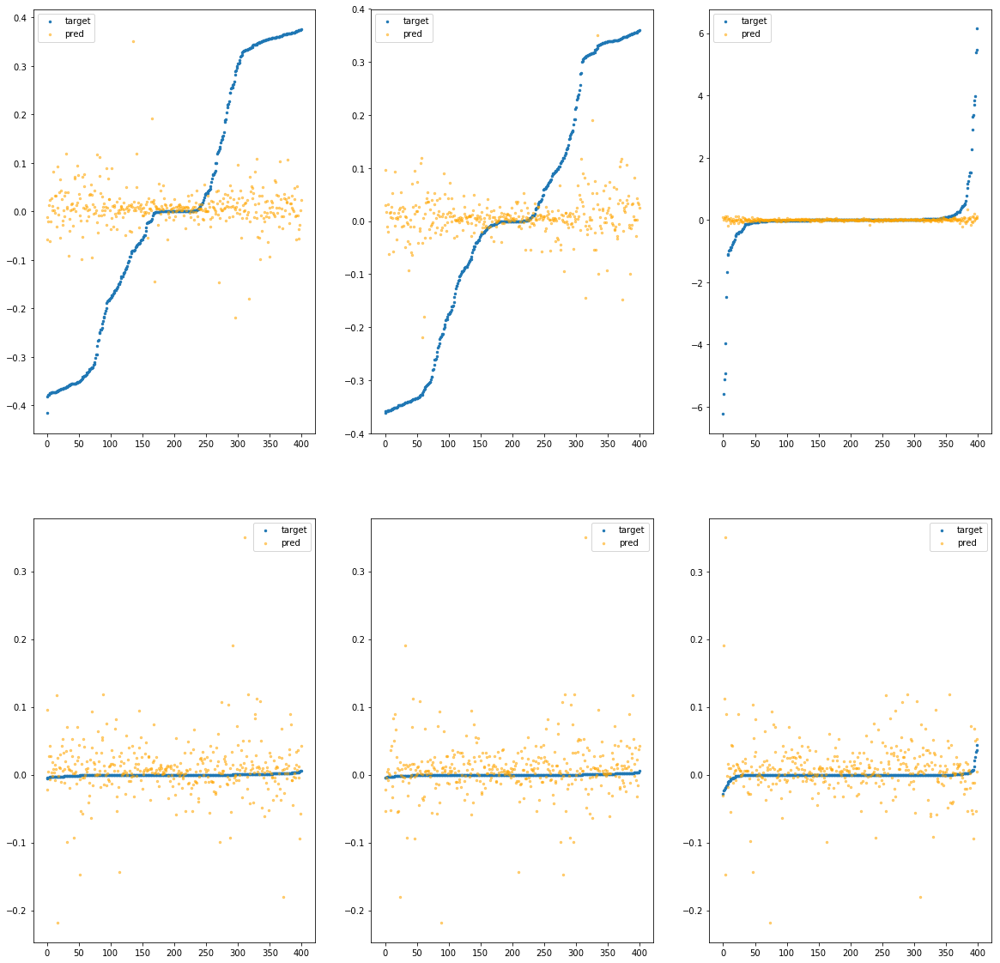

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16b20>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.28e-03	4.20e-01	2.06e-01	1.15e+03	6.44e-02	4.15e-03
y		-3.94e-03	3.64e-01	1.88e-01	1.70e+02	5.50e-02	3.03e-03
z		-7.24e-04	6.23e+00	2.78e-01	8.70e+01	8.75e-01	7.66e-01
phi		-6.86e+00	1.78e-02	2.89e-03	4.37e+05	1.46e-05	2.14e-10
theta		-1.04e+01	1.86e-02	2.82e-03	1.57e+05	1.44e-05	2.08e-10
psi		-6.02e-01	4.55e-02	3.62e-03	1.02e+05	3.93e-05	1.55e-09


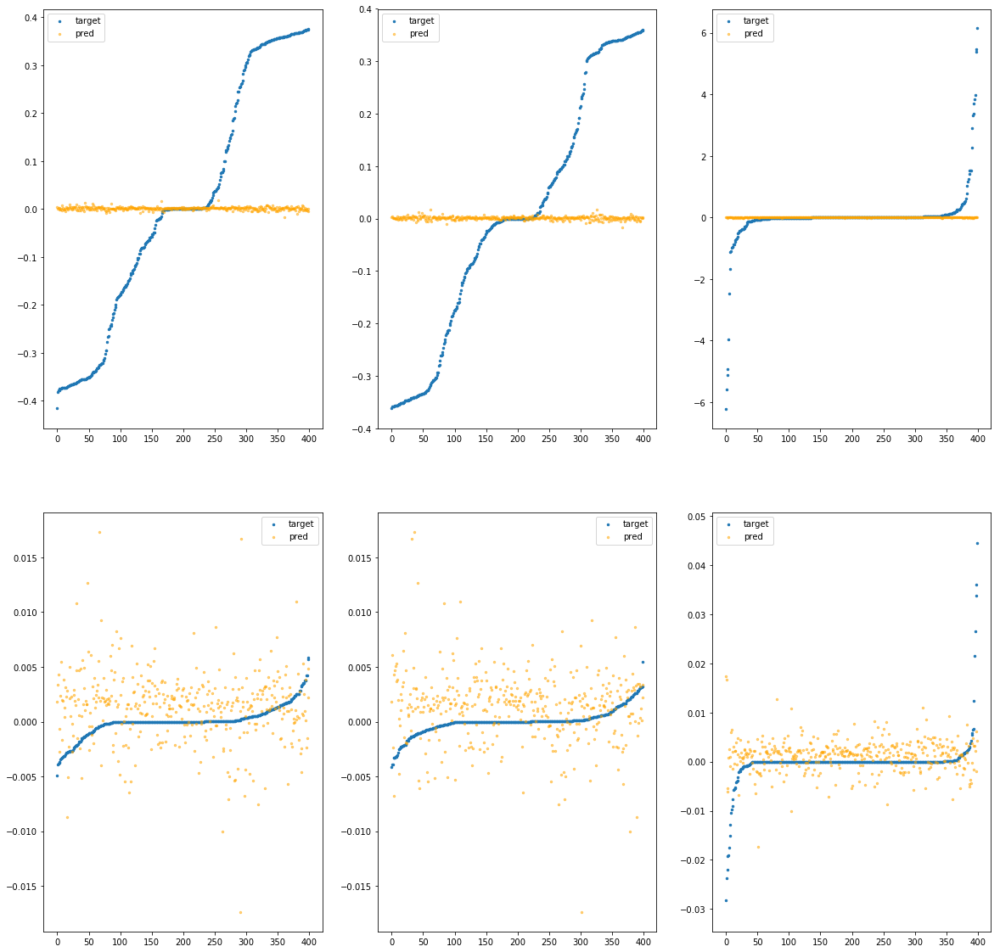

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16b80>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.38e-03	4.09e-01	2.05e-01	2.60e+02	6.42e-02	4.12e-03
y		2.03e-03	3.61e-01	1.88e-01	4.90e+01	5.47e-02	2.99e-03
z		-5.13e-04	6.22e+00	2.77e-01	2.49e+01	8.75e-01	7.66e-01
phi		-2.81e+00	1.15e-02	1.87e-03	1.11e+05	7.09e-06	5.03e-11
theta		-4.13e+00	9.98e-03	1.78e-03	4.26e+04	6.52e-06	4.25e-11
psi		-1.98e-01	4.05e-02	2.50e-03	2.65e+04	2.94e-05	8.64e-10


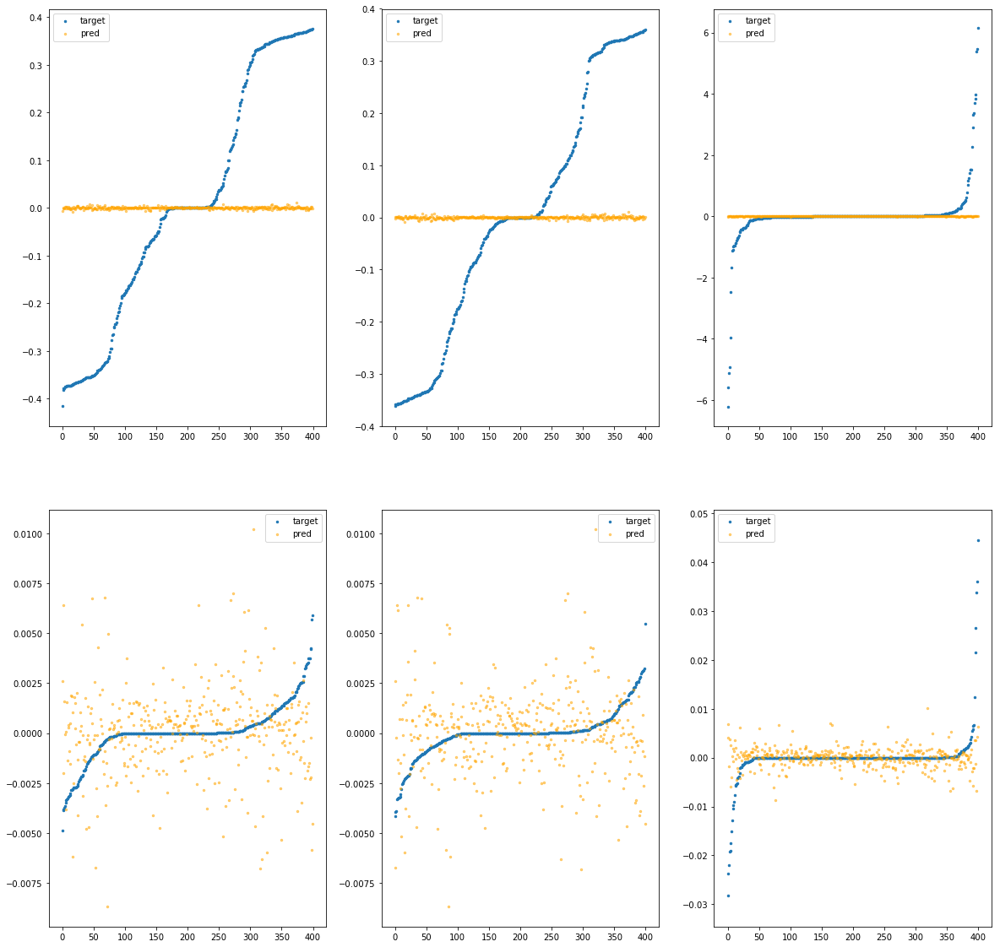

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16be0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.24e-04	4.05e-01	2.05e-01	3.38e+02	6.41e-02	4.11e-03
y		-3.09e-04	3.64e-01	1.88e-01	4.14e+01	5.48e-02	3.01e-03
z		2.53e-04	6.22e+00	2.77e-01	5.19e+01	8.75e-01	7.65e-01
phi		-5.66e+00	1.76e-02	2.54e-03	1.64e+05	1.24e-05	1.54e-10
theta		-7.43e+00	1.70e-02	2.31e-03	3.99e+04	1.07e-05	1.15e-10
psi		-4.33e-01	4.44e-02	3.09e-03	4.82e+04	3.52e-05	1.24e-09


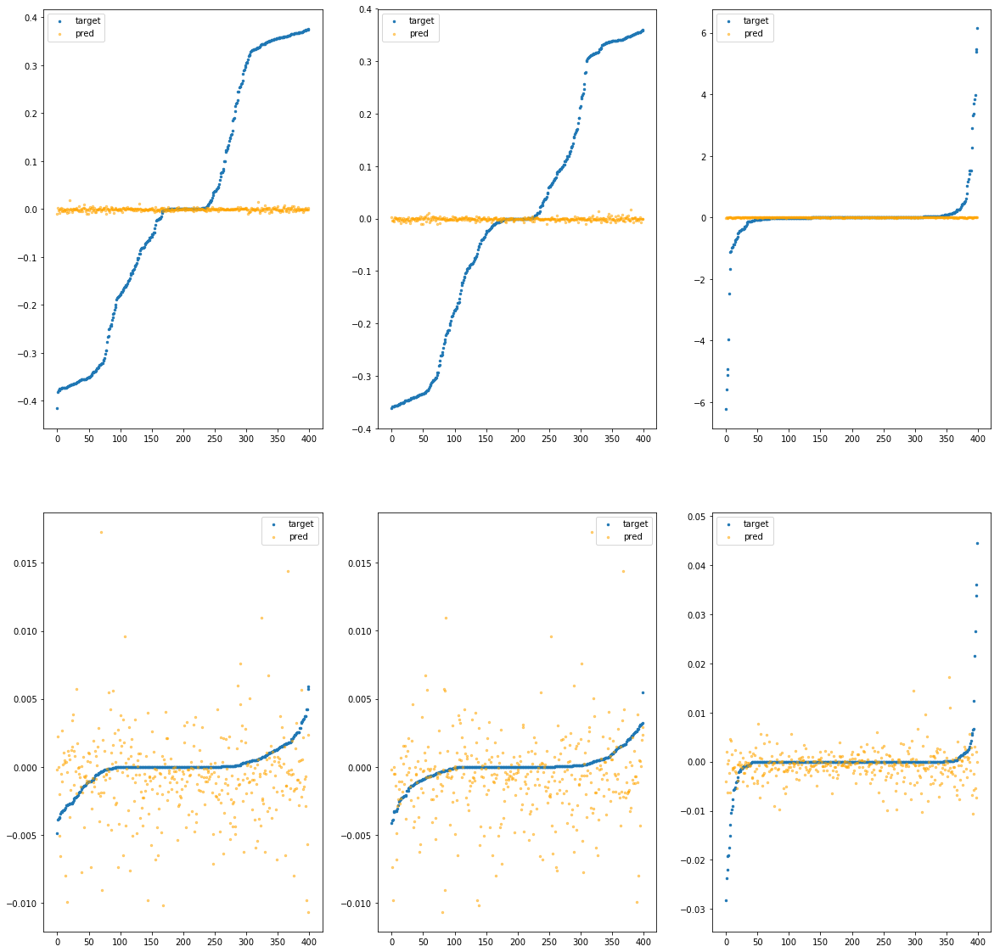

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16c40>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.09e-03	4.12e-01	2.06e-01	6.51e+02	6.42e-02	4.12e-03
y		1.94e-03	3.69e-01	1.88e-01	2.00e+02	5.47e-02	2.99e-03
z		-4.66e-03	6.24e+00	2.79e-01	8.85e+01	8.79e-01	7.73e-01
phi		-2.97e+01	3.42e-02	5.28e-03	2.39e+05	5.72e-05	3.27e-09
theta		-4.29e+01	3.36e-02	5.19e-03	1.04e+05	5.58e-05	3.11e-09
psi		-2.39e+00	5.55e-02	5.85e-03	1.15e+05	8.32e-05	6.93e-09


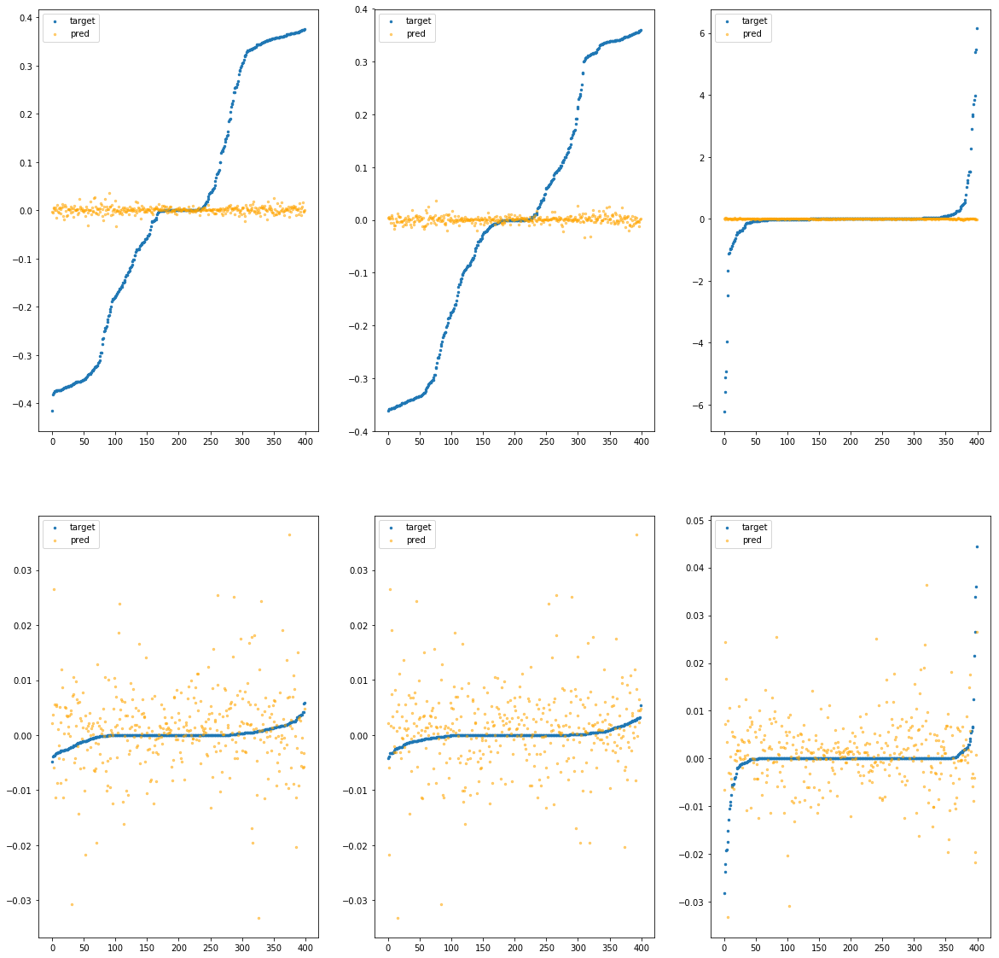

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16ca0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.87e-03	4.06e-01	2.06e-01	6.47e+02	6.42e-02	4.13e-03
y		-6.54e-03	3.96e-01	1.89e-01	1.46e+02	5.52e-02	3.04e-03
z		3.09e-03	6.24e+00	2.78e-01	9.12e+01	8.72e-01	7.61e-01
phi		-8.72e+01	7.69e-02	8.10e-03	2.22e+05	1.64e-04	2.70e-08
theta		-1.25e+02	8.23e-02	7.94e-03	1.90e+05	1.60e-04	2.55e-08
psi		-6.31e+00	7.97e-02	8.15e-03	1.07e+05	1.79e-04	3.22e-08


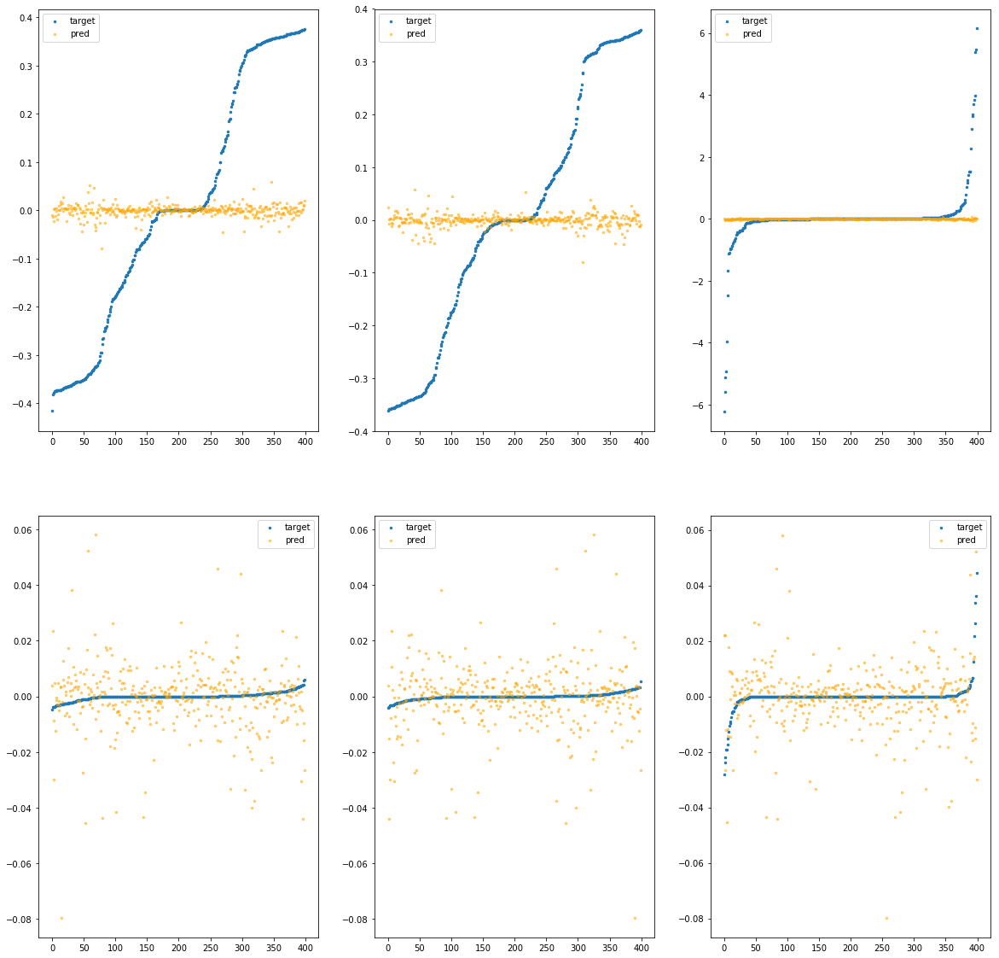

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16d00>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.12e-03	4.01e-01	2.06e-01	8.73e+02	6.43e-02	4.14e-03
y		-9.58e-04	3.62e-01	1.88e-01	1.21e+02	5.49e-02	3.01e-03
z		-2.22e-03	6.23e+00	2.78e-01	6.36e+01	8.77e-01	7.69e-01
phi		-9.77e+00	2.65e-02	3.15e-03	3.32e+05	2.00e-05	4.02e-10
theta		-1.45e+01	2.64e-02	3.13e-03	1.24e+05	1.97e-05	3.87e-10
psi		-7.66e-01	5.28e-02	3.79e-03	8.83e+04	4.33e-05	1.88e-09


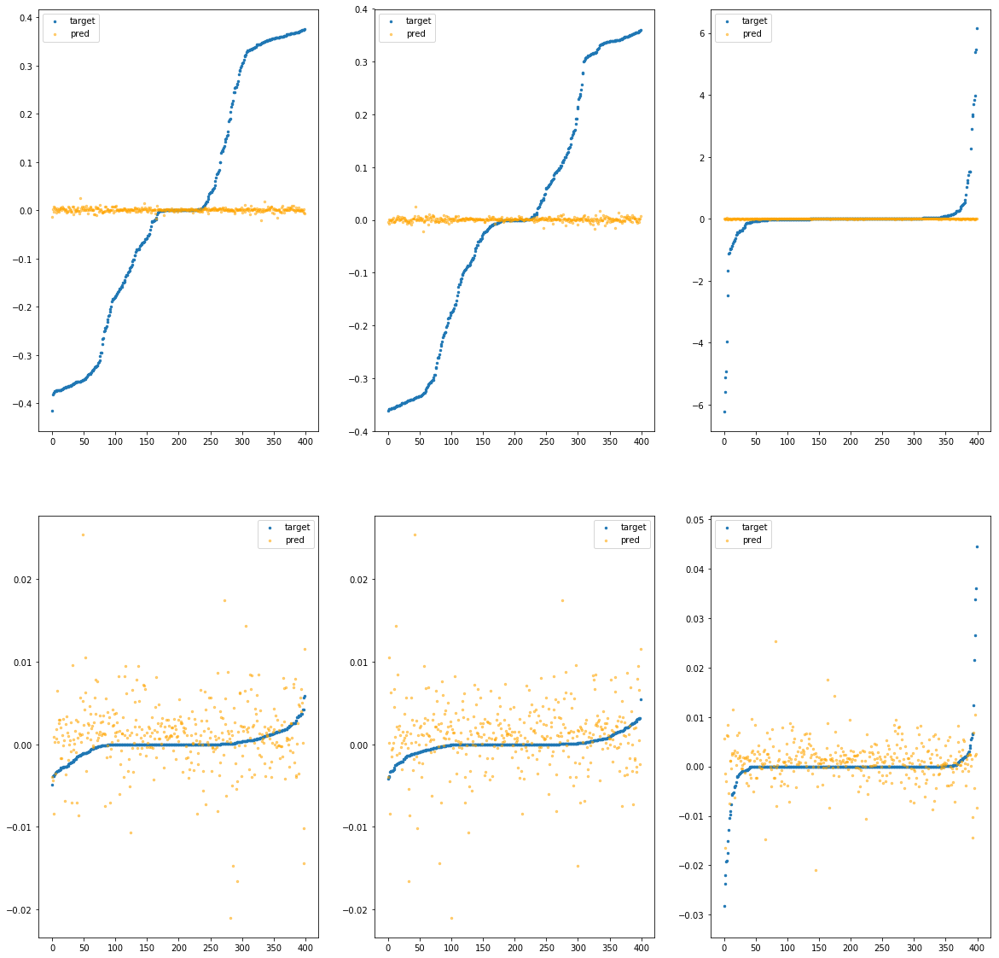

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16d60>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.71e-03	4.18e-01	2.06e-01	3.80e+02	6.43e-02	4.13e-03
y		-2.84e-04	3.61e-01	1.88e-01	4.59e+01	5.48e-02	3.01e-03
z		-1.49e-03	6.22e+00	2.78e-01	4.54e+01	8.76e-01	7.68e-01
phi		-4.33e+00	1.58e-02	2.30e-03	1.60e+05	9.92e-06	9.83e-11
theta		-7.03e+00	1.59e-02	2.28e-03	4.50e+04	1.02e-05	1.04e-10
psi		-4.47e-01	5.39e-02	2.99e-03	3.61e+04	3.55e-05	1.26e-09


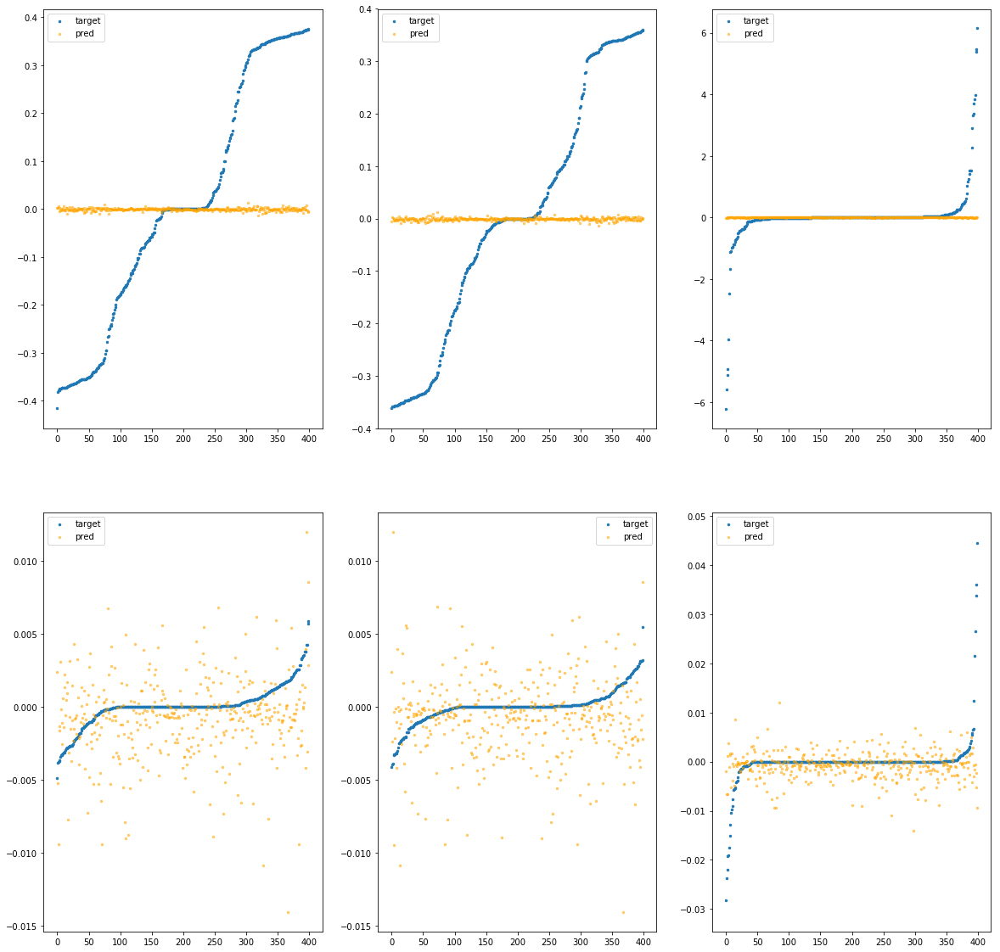

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16dc0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.25e-03	4.11e-01	2.06e-01	8.84e+02	6.43e-02	4.13e-03
y		-1.94e-03	3.61e-01	1.88e-01	1.44e+02	5.49e-02	3.02e-03
z		-7.19e-04	6.22e+00	2.78e-01	6.79e+01	8.75e-01	7.66e-01
phi		-4.93e+00	1.59e-02	2.48e-03	3.46e+05	1.10e-05	1.22e-10
theta		-7.06e+00	1.52e-02	2.39e-03	1.36e+05	1.02e-05	1.05e-10
psi		-3.14e-01	4.42e-02	3.12e-03	4.73e+04	3.22e-05	1.04e-09


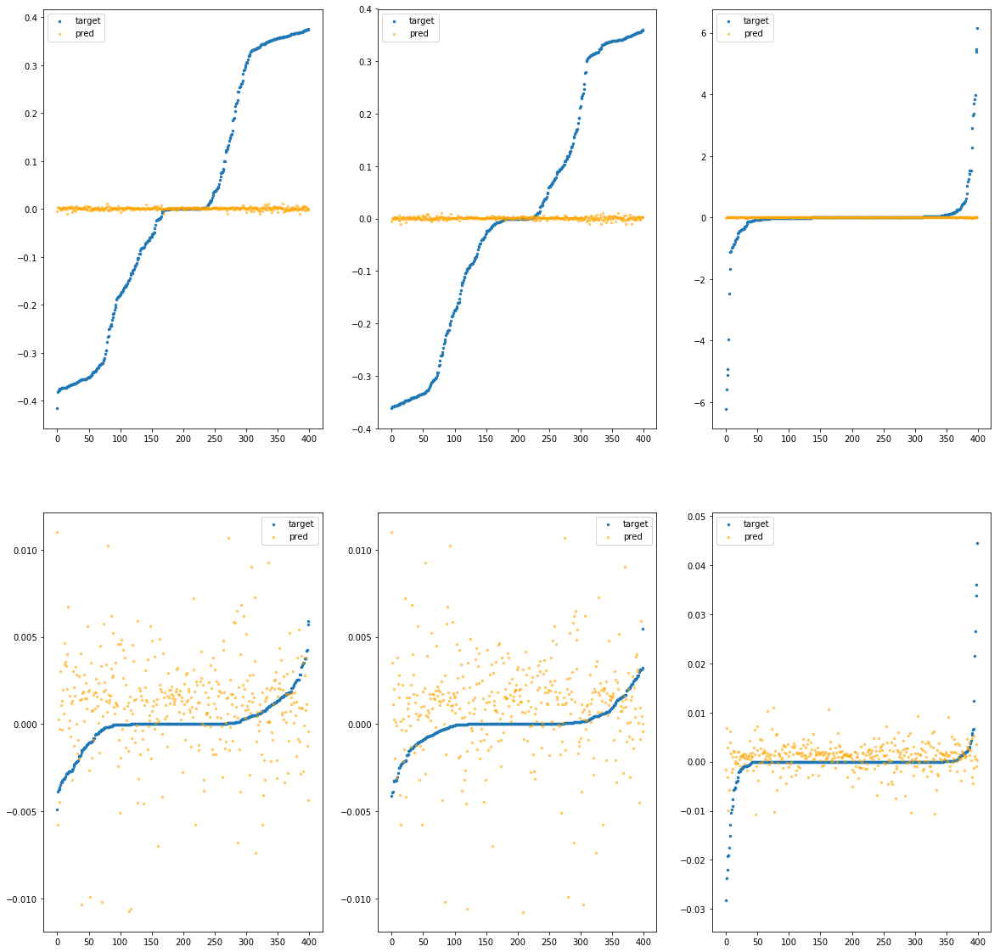

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16e20>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.66e-04	4.07e-01	2.05e-01	7.03e+02	6.42e-02	4.12e-03
y		-1.92e-03	3.61e-01	1.88e-01	1.11e+02	5.49e-02	3.02e-03
z		-9.01e-04	6.22e+00	2.78e-01	5.25e+01	8.76e-01	7.67e-01
phi		-3.52e+00	1.36e-02	2.17e-03	2.96e+05	8.40e-06	7.06e-11
theta		-5.14e+00	1.10e-02	2.08e-03	1.06e+05	7.79e-06	6.07e-11
psi		-2.92e-01	4.69e-02	2.86e-03	5.16e+04	3.17e-05	1.00e-09


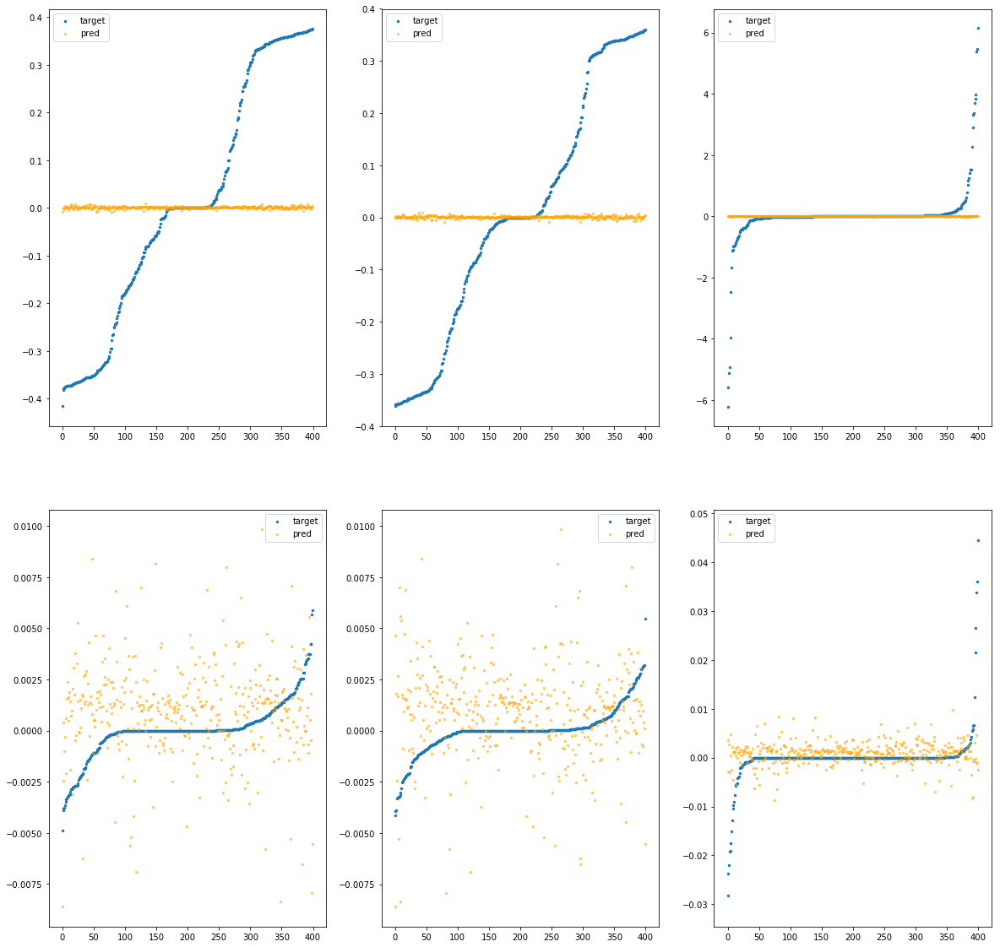

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16e80>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.49e-03	3.94e-01	2.06e-01	1.05e+03	6.43e-02	4.14e-03
y		-8.42e-04	3.62e-01	1.88e-01	1.20e+02	5.49e-02	3.01e-03
z		-1.59e-03	6.21e+00	2.78e-01	8.39e+01	8.76e-01	7.68e-01
phi		-1.02e+01	2.67e-02	3.20e-03	3.73e+05	2.09e-05	4.35e-10
theta		-1.35e+01	2.07e-02	3.08e-03	1.76e+05	1.85e-05	3.41e-10
psi		-5.21e-01	3.87e-02	3.66e-03	6.94e+04	3.73e-05	1.39e-09


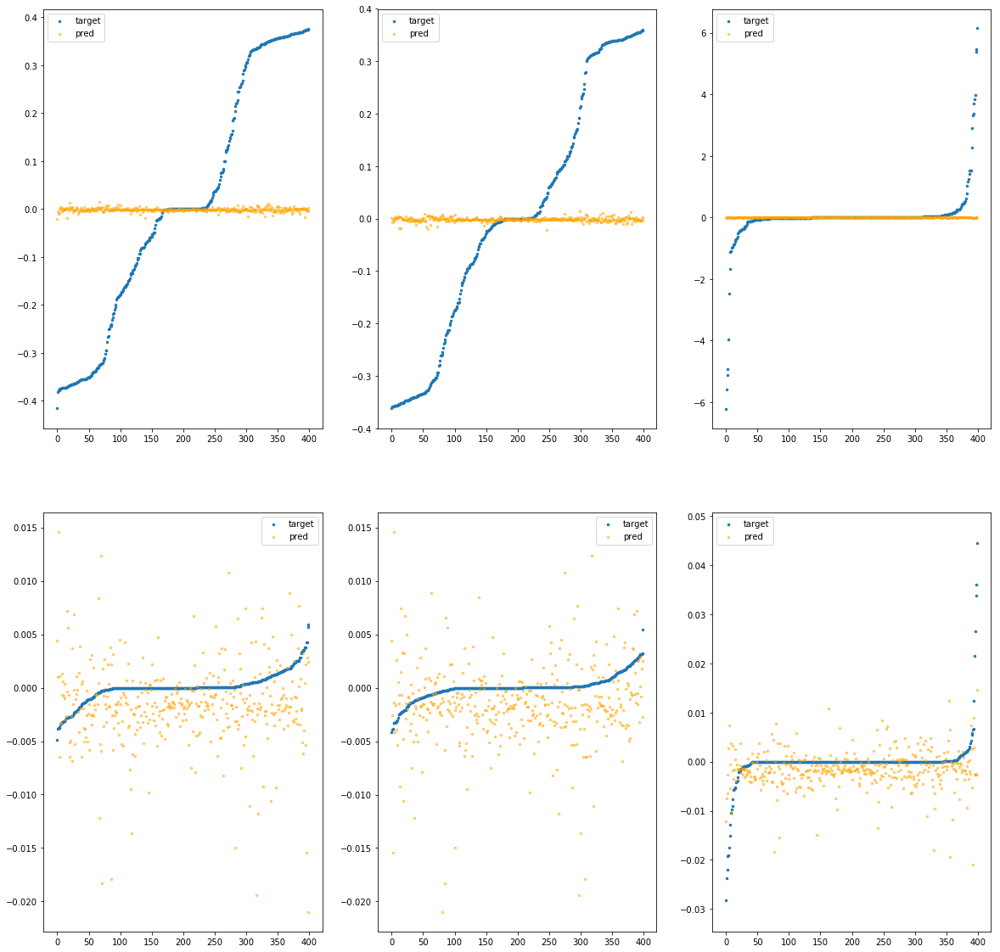

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16ee0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.56e-03	4.07e-01	2.06e-01	7.15e+02	6.43e-02	4.14e-03
y		-3.01e-03	3.61e-01	1.88e-01	1.21e+02	5.50e-02	3.02e-03
z		-1.26e-03	6.23e+00	2.78e-01	5.36e+01	8.76e-01	7.67e-01
phi		-4.77e+00	1.40e-02	2.35e-03	2.66e+05	1.07e-05	1.15e-10
theta		-6.48e+00	1.39e-02	2.19e-03	1.01e+05	9.50e-06	9.03e-11
psi		-3.36e-01	4.71e-02	3.04e-03	5.48e+04	3.28e-05	1.07e-09


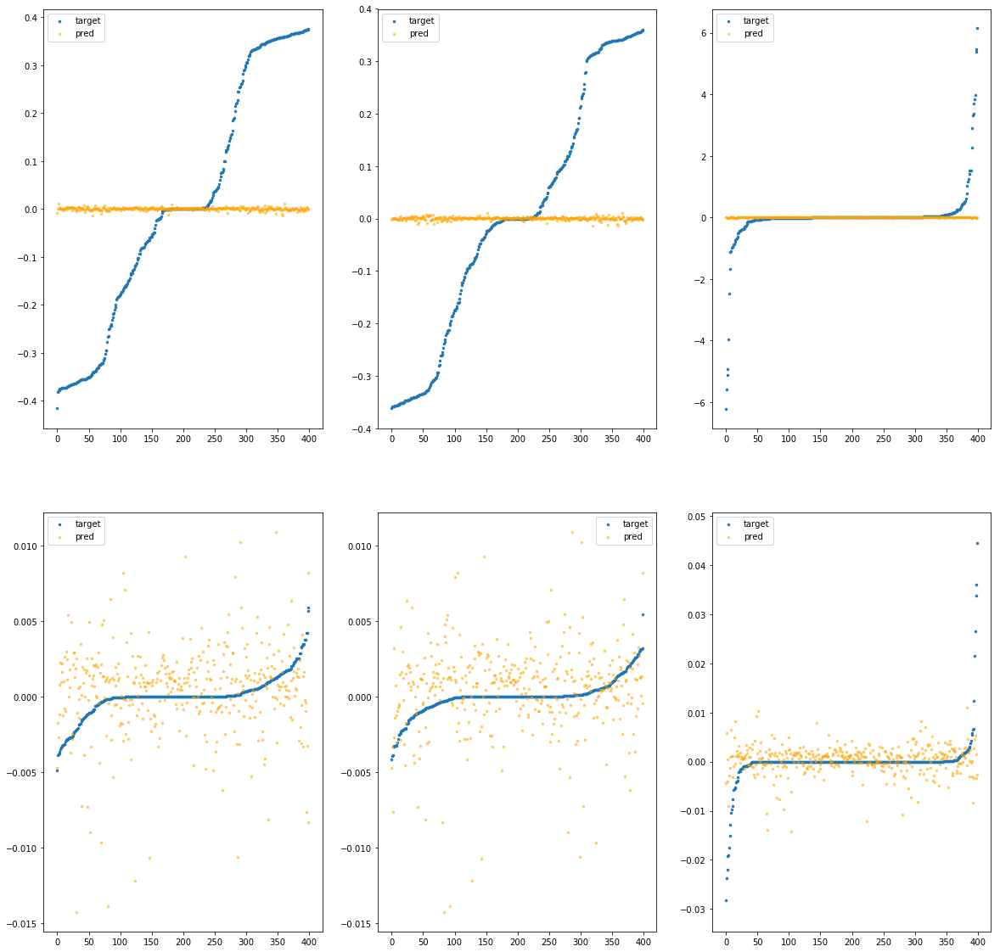

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16f40>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.81e-04	4.18e-01	2.06e-01	6.66e+02	6.41e-02	4.11e-03
y		-1.56e-03	3.63e-01	1.88e-01	1.29e+02	5.49e-02	3.01e-03
z		-9.32e-04	6.22e+00	2.78e-01	4.70e+01	8.76e-01	7.67e-01
phi		-7.36e+00	2.33e-02	2.78e-03	2.77e+05	1.56e-05	2.42e-10
theta		-1.13e+01	2.03e-02	2.82e-03	8.69e+04	1.56e-05	2.44e-10
psi		-7.42e-01	5.97e-02	3.58e-03	4.46e+04	4.27e-05	1.83e-09


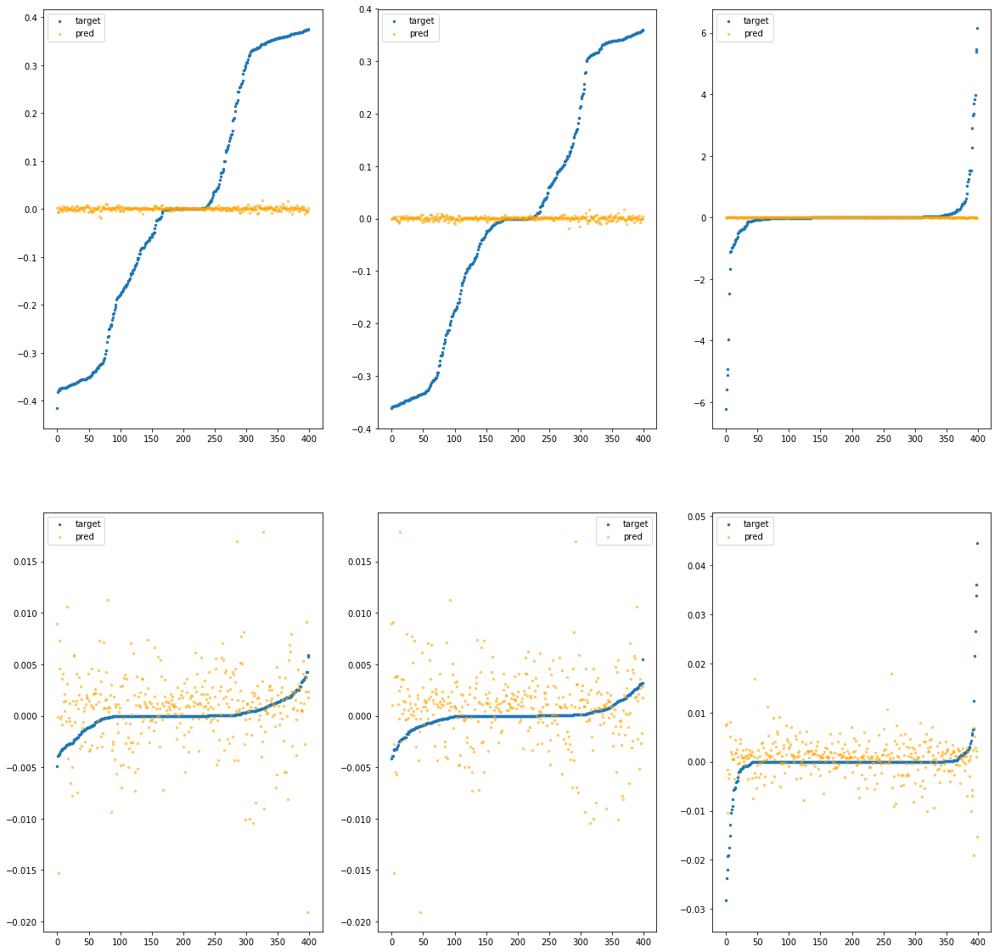

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f16fa0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.86e-03	4.16e-01	2.06e-01	7.11e+02	6.42e-02	4.13e-03
y		-2.42e-03	3.63e-01	1.88e-01	8.61e+01	5.50e-02	3.02e-03
z		-2.80e-03	6.22e+00	2.78e-01	6.07e+01	8.77e-01	7.70e-01
phi		-5.92e+00	1.93e-02	2.53e-03	2.60e+05	1.29e-05	1.66e-10
theta		-9.00e+00	2.12e-02	2.53e-03	8.52e+04	1.27e-05	1.61e-10
psi		-5.49e-01	4.32e-02	3.32e-03	3.55e+04	3.80e-05	1.44e-09


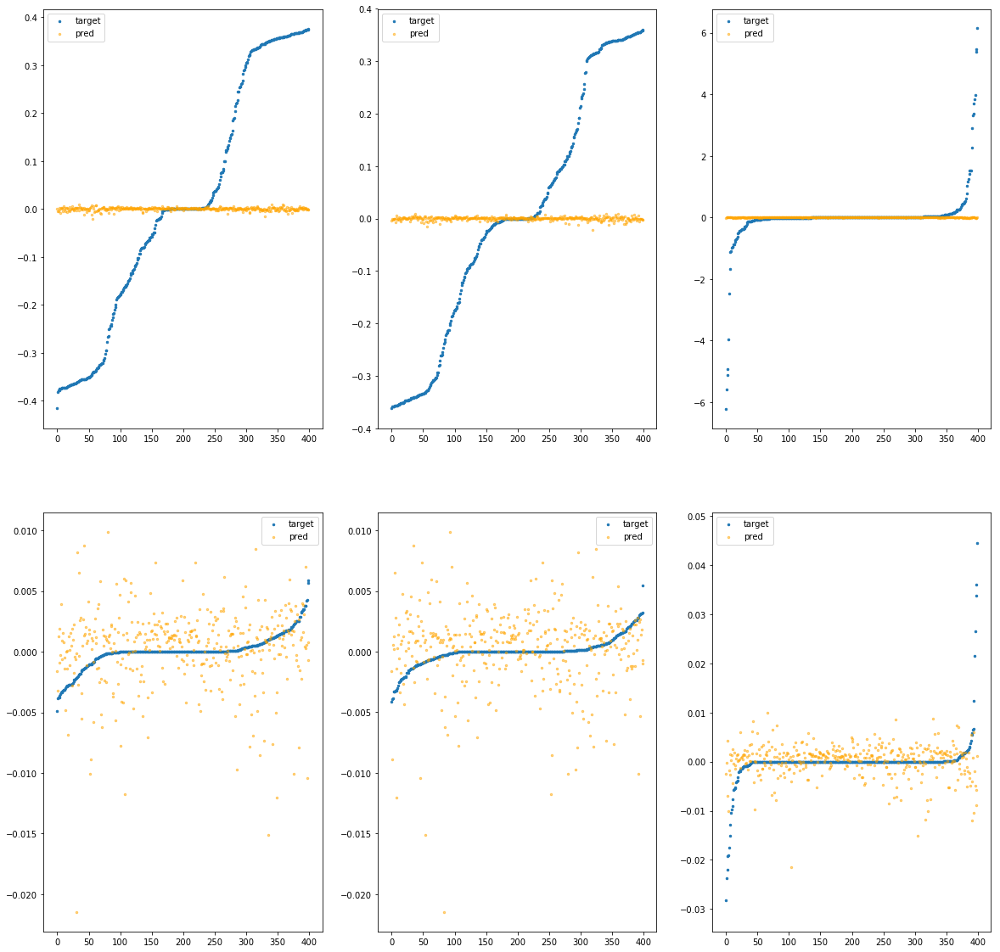

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f20040>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.58e-03	4.04e-01	2.06e-01	4.75e+02	6.43e-02	4.13e-03
y		-1.33e-03	3.64e-01	1.88e-01	5.69e+01	5.49e-02	3.01e-03
z		-1.06e-03	6.22e+00	2.77e-01	3.43e+01	8.76e-01	7.67e-01
phi		-6.22e+00	2.16e-02	2.39e-03	1.78e+05	1.34e-05	1.81e-10
theta		-9.01e+00	2.15e-02	2.34e-03	6.90e+04	1.27e-05	1.62e-10
psi		-4.87e-01	4.58e-02	3.05e-03	3.66e+04	3.65e-05	1.33e-09


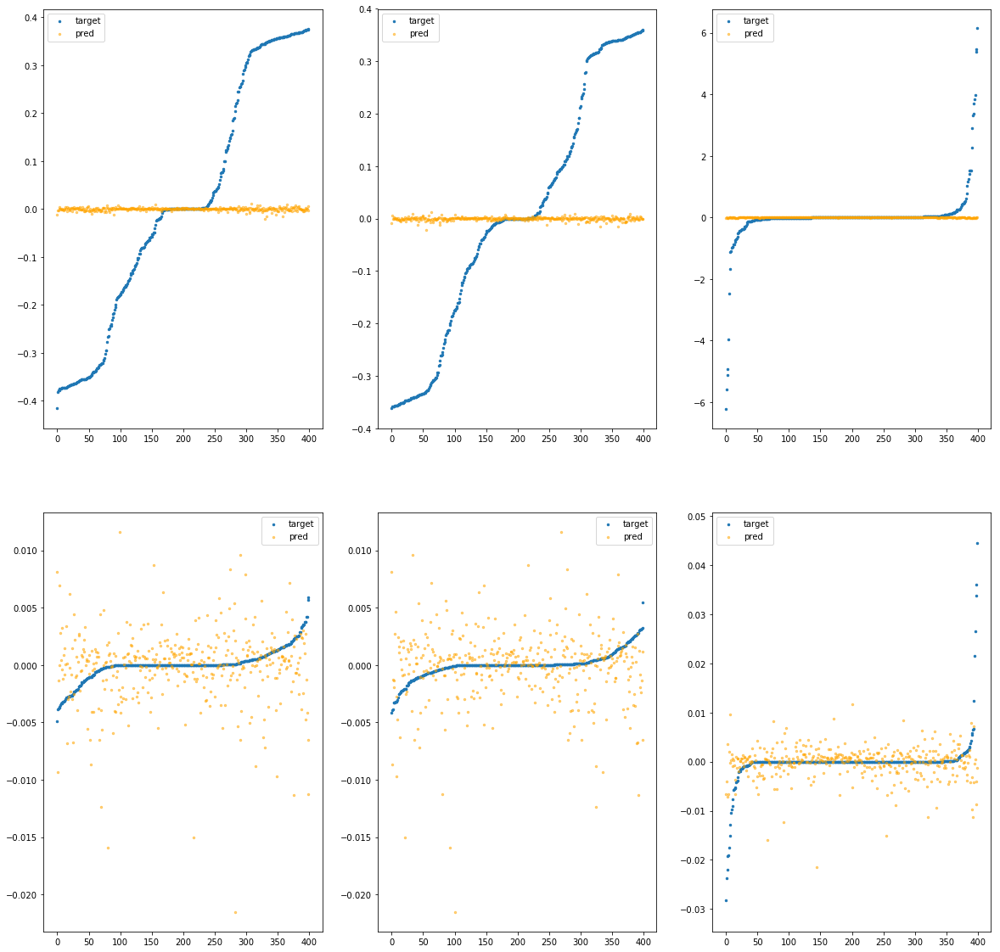

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb253f200a0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.95e-04	4.09e-01	2.06e-01	7.71e+02	6.41e-02	4.11e-03
y		-3.47e-04	3.67e-01	1.88e-01	1.19e+02	5.48e-02	3.01e-03
z		-1.33e-04	6.23e+00	2.78e-01	7.01e+01	8.75e-01	7.66e-01
phi		-9.33e+00	2.28e-02	3.10e-03	2.60e+05	1.92e-05	3.69e-10
theta		-1.41e+01	2.24e-02	3.12e-03	1.46e+05	1.92e-05	3.68e-10
psi		-7.78e-01	4.91e-02	3.73e-03	3.13e+04	4.36e-05	1.90e-09


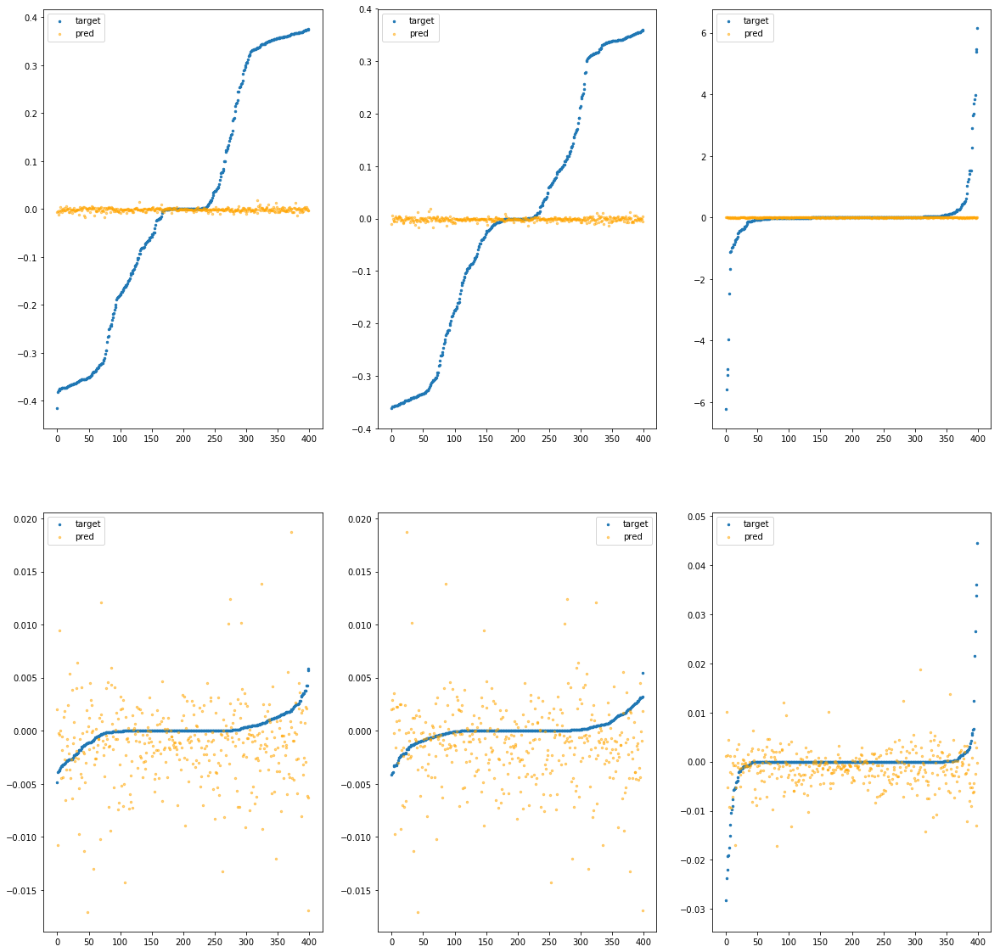

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20100>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.38e-02	5.39e-01	2.09e-01	1.52e+03	6.63e-02	4.39e-03
y		-7.78e-02	6.26e-01	1.93e-01	4.76e+02	5.91e-02	3.49e-03
z		1.17e-02	6.20e+00	2.85e-01	2.76e+02	8.65e-01	7.48e-01
phi		-1.26e+03	3.10e-01	3.10e-02	6.49e+05	2.34e-03	5.48e-06
theta		-1.85e+03	3.11e-01	3.10e-02	5.23e+05	2.35e-03	5.53e-06
psi		-9.69e+01	3.38e-01	3.13e-02	6.36e+05	2.40e-03	5.77e-06


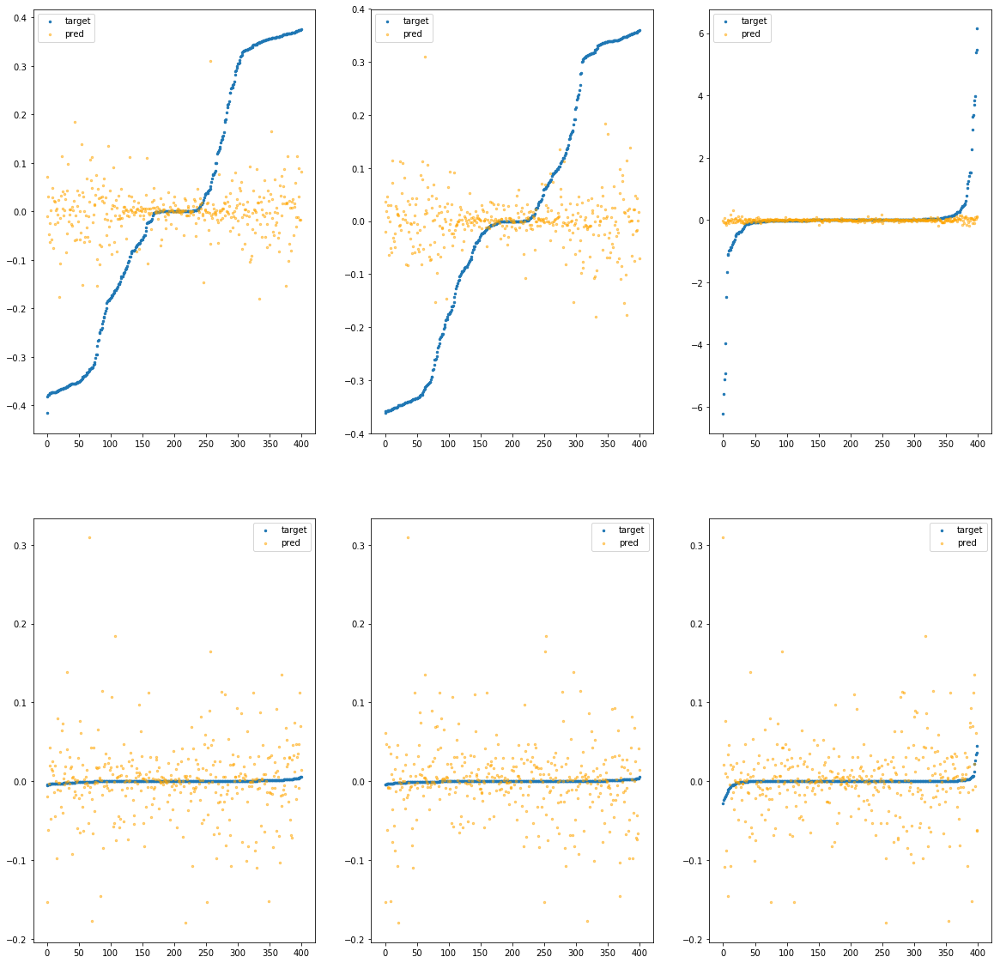

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20160>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.88e-02	6.05e-01	2.13e-01	2.55e+03	6.98e-02	4.87e-03
y		-1.29e-01	7.24e-01	1.98e-01	3.98e+02	6.19e-02	3.83e-03
z		4.99e-03	6.28e+00	2.99e-01	6.27e+02	8.70e-01	7.58e-01
phi		-2.80e+03	3.80e-01	4.82e-02	1.28e+06	5.21e-03	2.71e-05
theta		-4.09e+03	3.78e-01	4.82e-02	2.13e+05	5.20e-03	2.70e-05
psi		-2.10e+02	3.57e-01	4.81e-02	9.51e+05	5.18e-03	2.68e-05


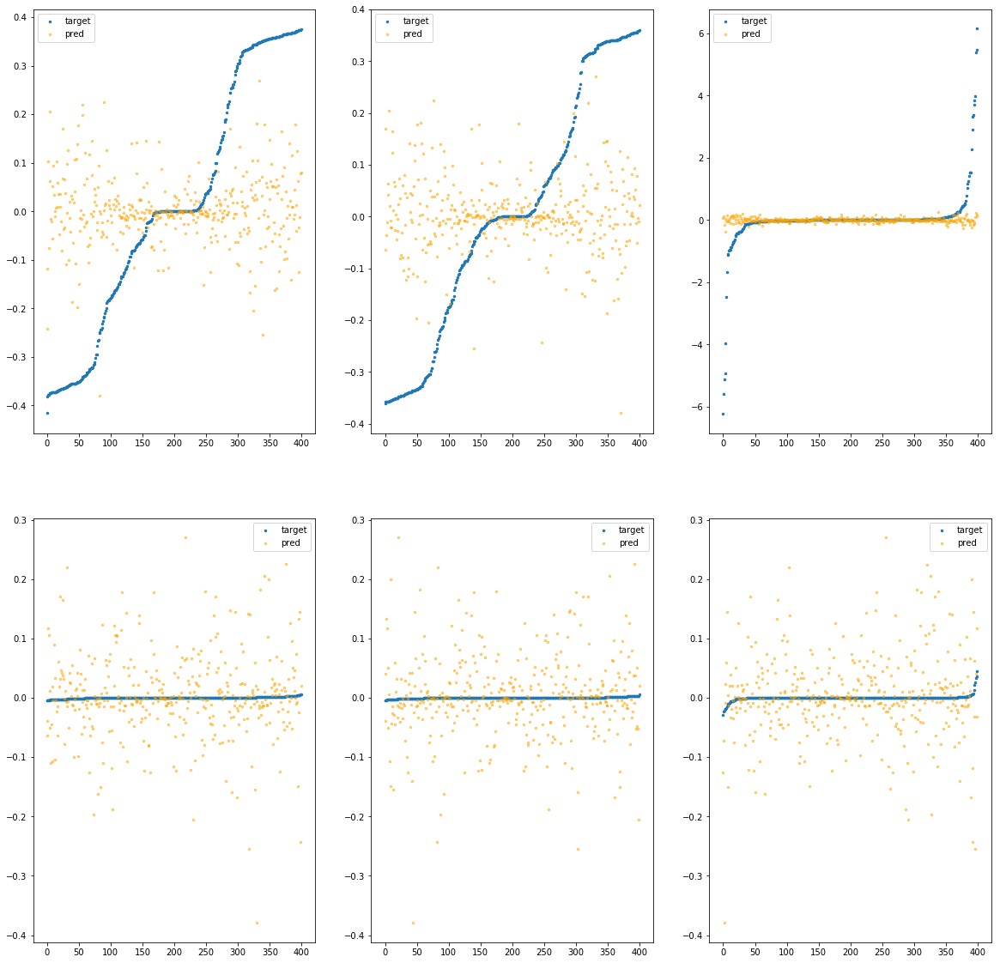

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f201c0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.15e-01	7.53e-01	2.13e-01	2.43e+03	7.15e-02	5.11e-03
y		-3.83e-02	5.76e-01	1.88e-01	7.94e+02	5.69e-02	3.24e-03
z		1.25e-02	6.19e+00	2.97e-01	5.20e+02	8.64e-01	7.46e-01
phi		-3.63e+03	4.07e-01	5.48e-02	8.20e+05	6.76e-03	4.57e-05
theta		-5.34e+03	4.11e-01	5.48e-02	4.35e+05	6.79e-03	4.61e-05
psi		-2.71e+02	4.03e-01	5.46e-02	7.00e+05	6.67e-03	4.44e-05


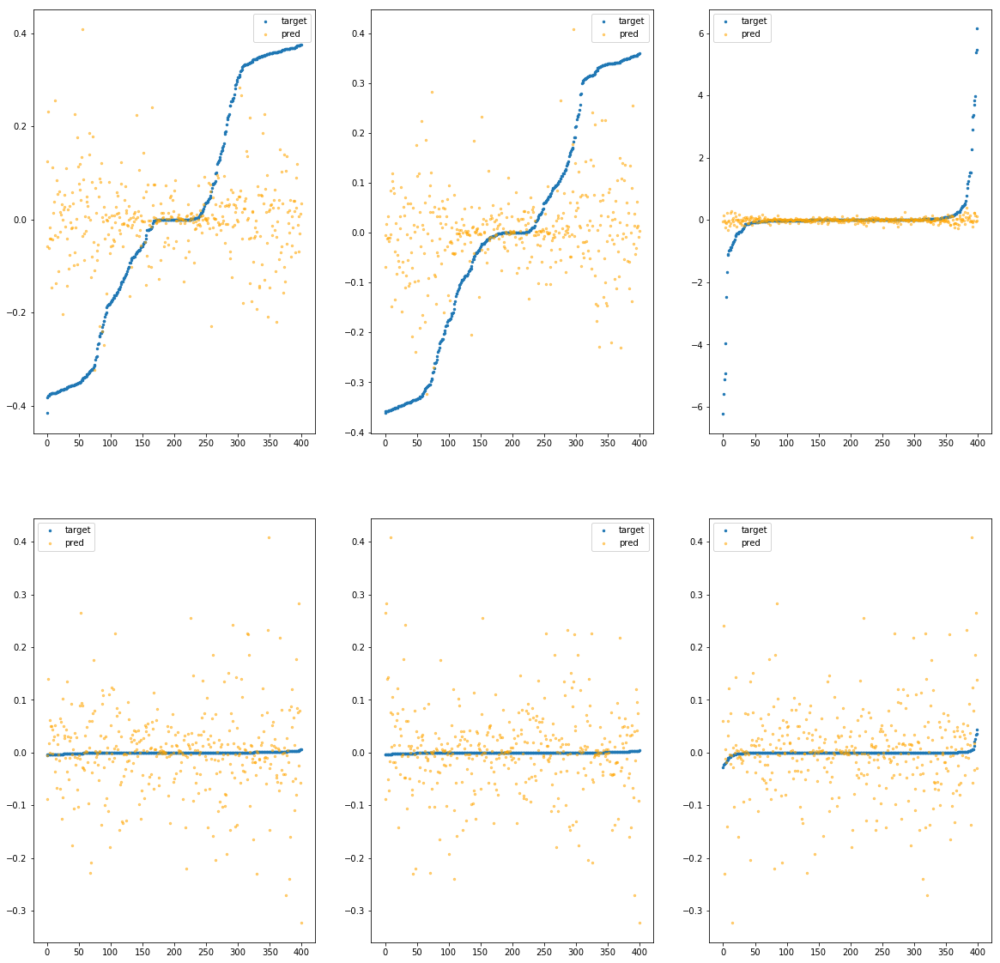

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20220>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.29e-02	8.12e-01	2.12e-01	2.14e+03	7.01e-02	4.91e-03
y		-9.42e-02	6.70e-01	1.94e-01	5.02e+02	6.00e-02	3.60e-03
z		-2.93e-03	6.27e+00	3.00e-01	7.50e+02	8.77e-01	7.70e-01
phi		-4.19e+03	4.85e-01	5.77e-02	9.13e+05	7.80e-03	6.09e-05
theta		-6.17e+03	4.90e-01	5.77e-02	4.27e+05	7.84e-03	6.15e-05
psi		-3.23e+02	4.82e-01	5.79e-02	6.81e+05	7.95e-03	6.33e-05


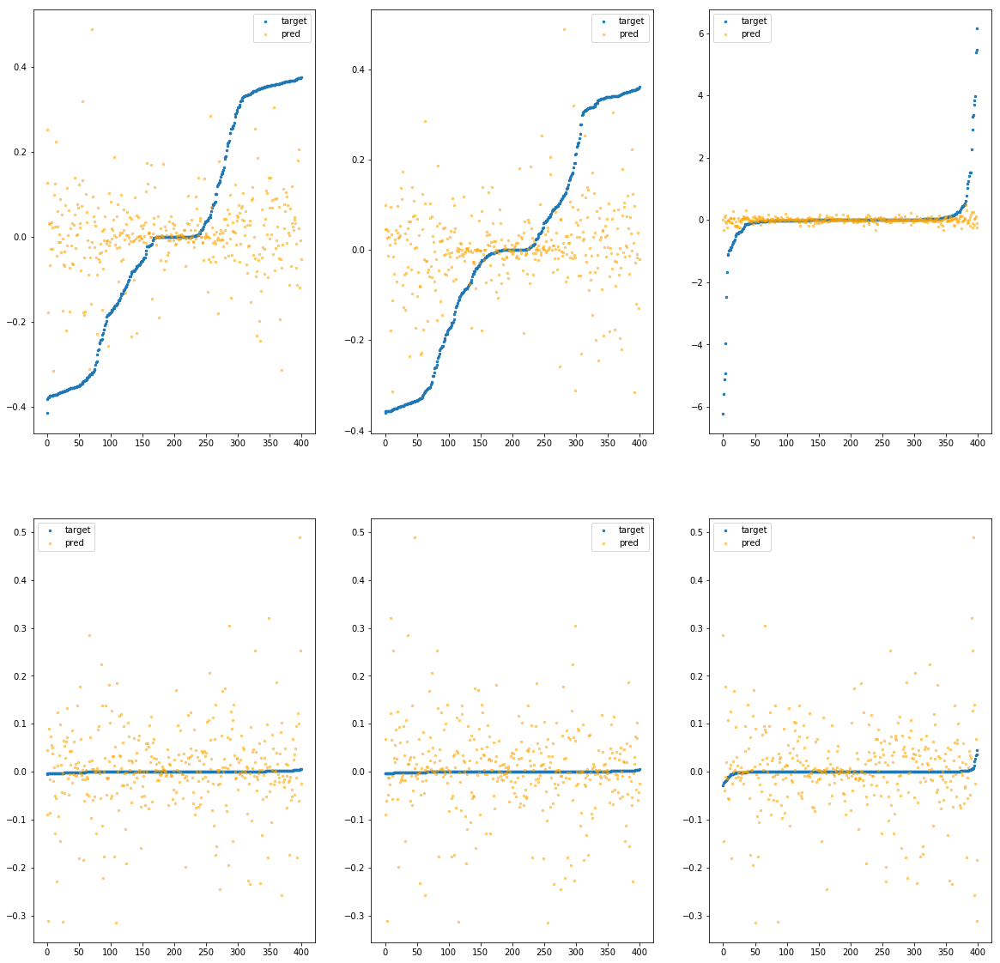

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20280>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.57e-02	5.44e-01	2.10e-01	2.70e+03	6.77e-02	4.58e-03
y		-7.60e-02	5.75e-01	1.94e-01	3.36e+02	5.90e-02	3.48e-03
z		-5.96e-03	6.38e+00	2.94e-01	4.52e+02	8.80e-01	7.75e-01
phi		-2.14e+03	2.69e-01	4.19e-02	1.26e+06	3.98e-03	1.59e-05
theta		-3.12e+03	2.69e-01	4.18e-02	4.28e+05	3.97e-03	1.58e-05
psi		-1.62e+02	2.84e-01	4.18e-02	6.86e+05	4.01e-03	1.61e-05


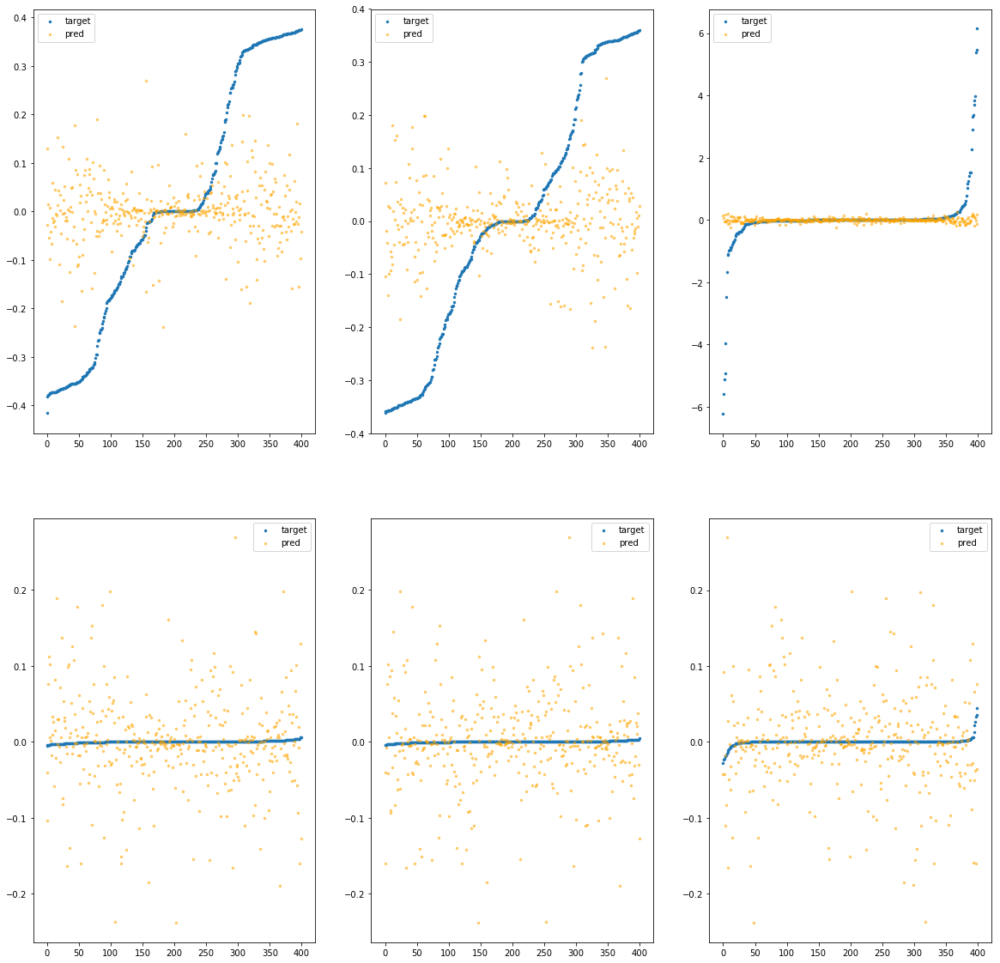

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f202e0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.21e-02	5.17e-01	2.09e-01	1.50e+03	6.62e-02	4.38e-03
y		-2.08e-02	4.99e-01	1.90e-01	3.32e+02	5.60e-02	3.13e-03
z		-1.22e-02	6.25e+00	2.86e-01	2.04e+02	8.85e-01	7.84e-01
phi		-4.66e+02	1.52e-01	1.91e-02	5.93e+05	8.70e-04	7.57e-07
theta		-6.91e+02	1.52e-01	1.92e-02	3.23e+05	8.79e-04	7.73e-07
psi		-3.56e+01	1.52e-01	1.95e-02	3.56e+05	8.98e-04	8.06e-07


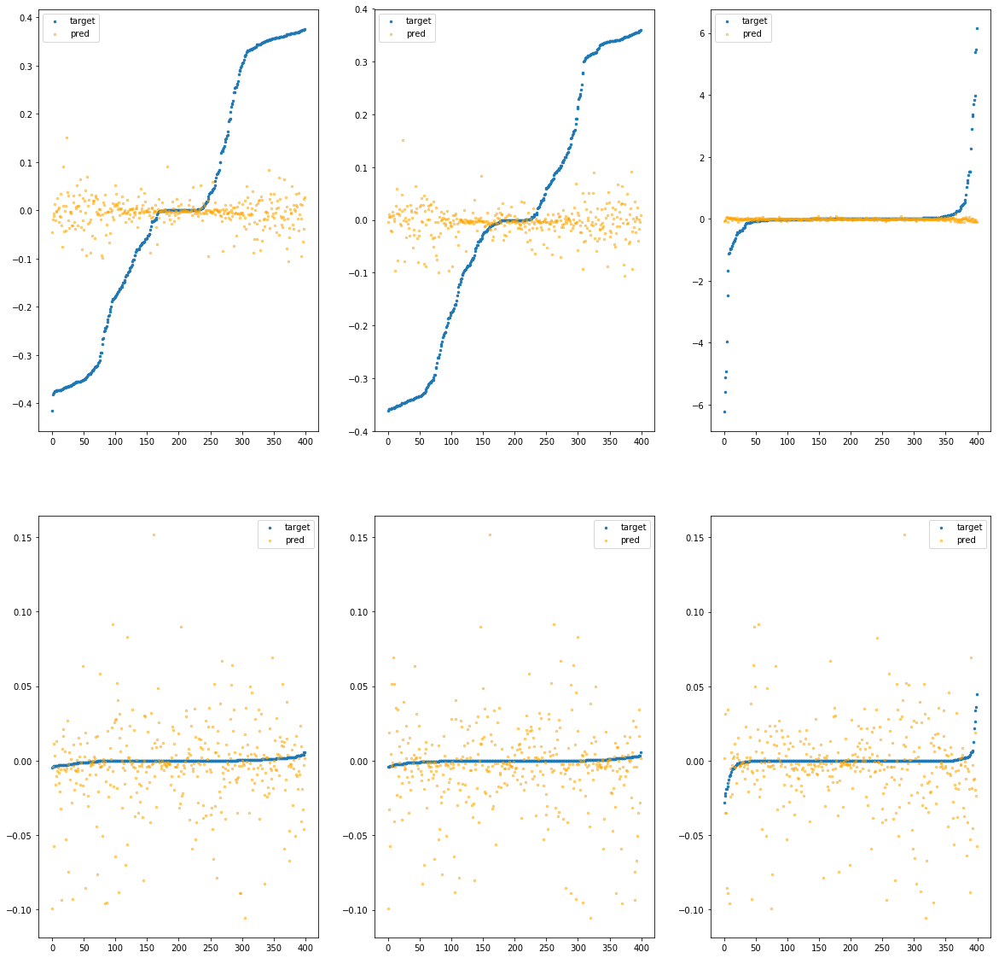

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20340>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.68e-02	5.91e-01	2.12e-01	2.11e+03	6.84e-02	4.68e-03
y		-2.62e-02	5.73e-01	1.89e-01	3.21e+02	5.63e-02	3.16e-03
z		-1.32e-02	6.25e+00	2.91e-01	3.85e+02	8.86e-01	7.86e-01
phi		-1.47e+03	2.31e-01	3.46e-02	8.19e+05	2.74e-03	7.52e-06
theta		-2.16e+03	2.31e-01	3.46e-02	3.39e+05	2.75e-03	7.54e-06
psi		-1.09e+02	2.31e-01	3.47e-02	5.63e+05	2.71e-03	7.33e-06


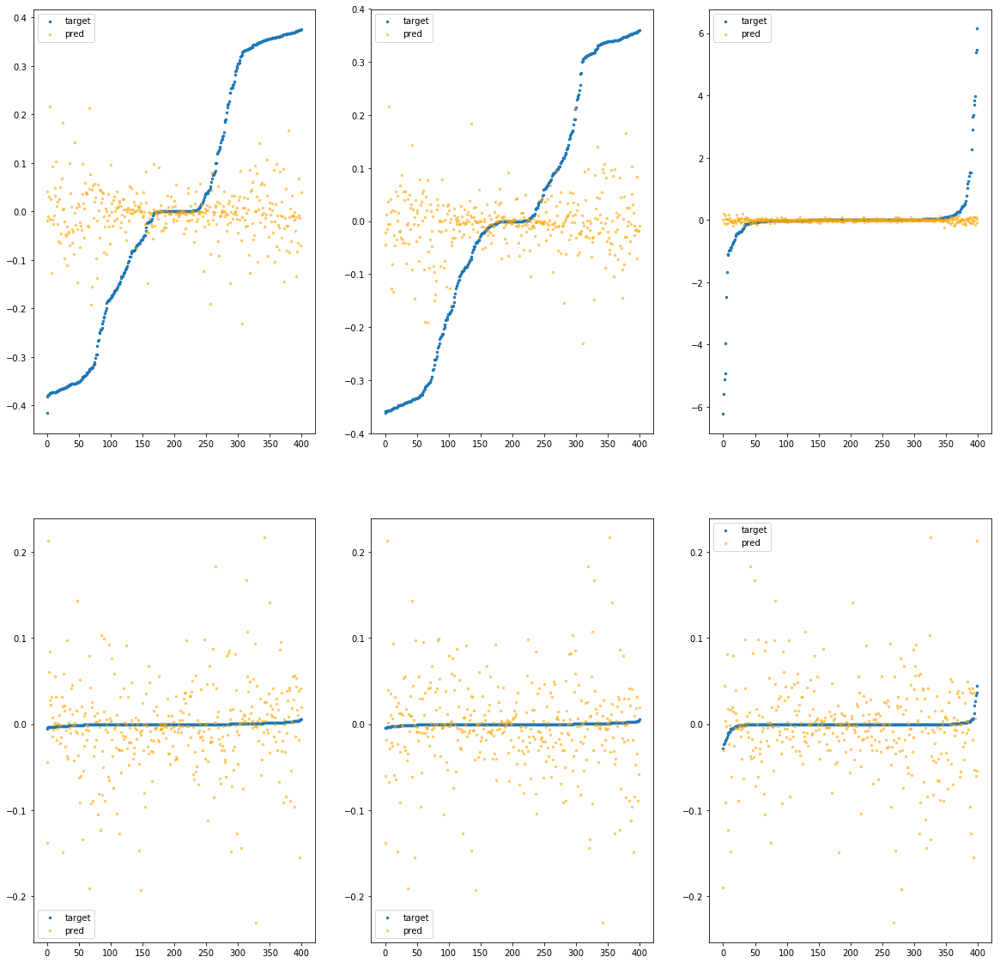

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f203a0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.26e-01	6.58e-01	2.15e-01	3.39e+03	7.22e-02	5.21e-03
y		-5.32e-02	6.39e-01	1.91e-01	4.75e+02	5.77e-02	3.33e-03
z		9.19e-03	6.29e+00	2.99e-01	4.53e+02	8.67e-01	7.51e-01
phi		-3.15e+03	3.95e-01	5.15e-02	1.51e+06	5.86e-03	3.43e-05
theta		-4.60e+03	3.97e-01	5.14e-02	4.48e+05	5.85e-03	3.42e-05
psi		-2.43e+02	4.18e-01	5.18e-02	9.27e+05	5.98e-03	3.58e-05


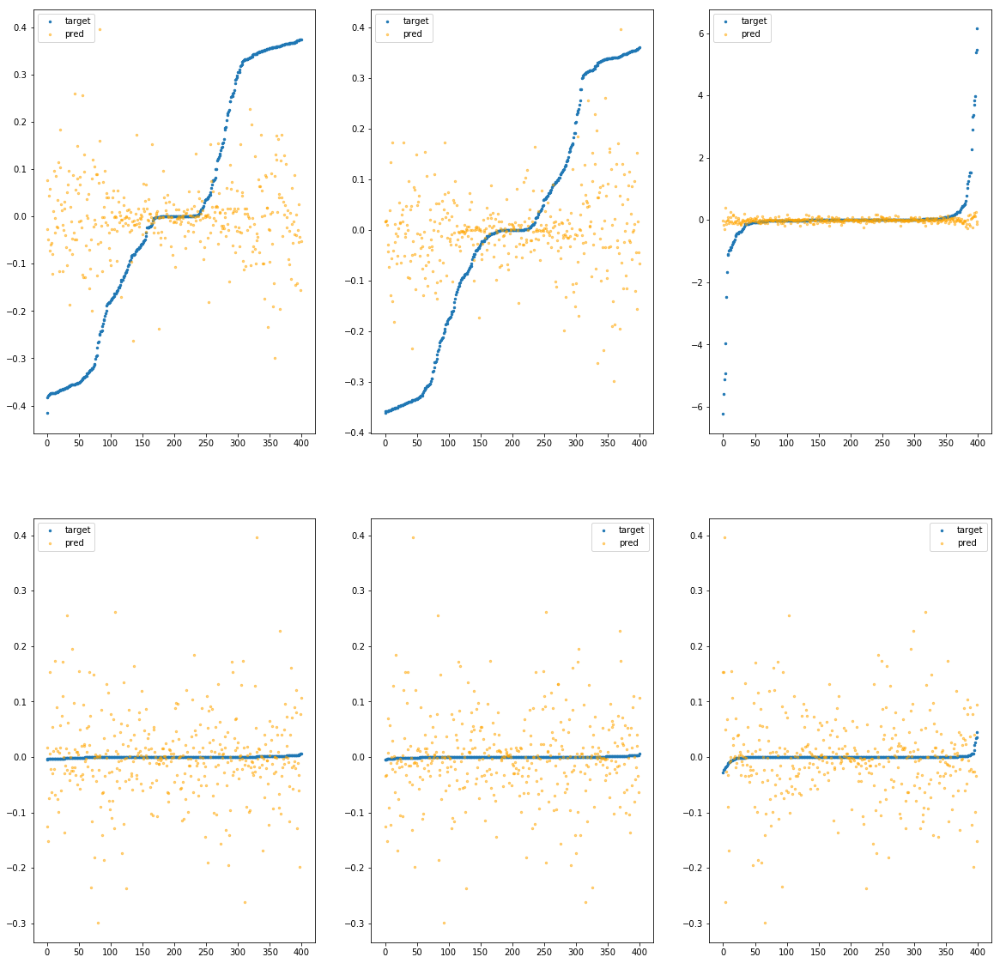

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20400>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.03e-01	6.50e-01	2.11e-01	2.03e+03	7.07e-02	5.00e-03
y		-2.55e-02	5.52e-01	1.90e-01	4.09e+02	5.62e-02	3.16e-03
z		9.05e-03	6.18e+00	2.94e-01	3.91e+02	8.67e-01	7.52e-01
phi		-2.77e+03	2.82e-01	4.61e-02	9.39e+05	5.15e-03	2.65e-05
theta		-4.07e+03	2.81e-01	4.62e-02	4.38e+05	5.16e-03	2.67e-05
psi		-2.15e+02	2.83e-01	4.67e-02	5.30e+05	5.30e-03	2.81e-05


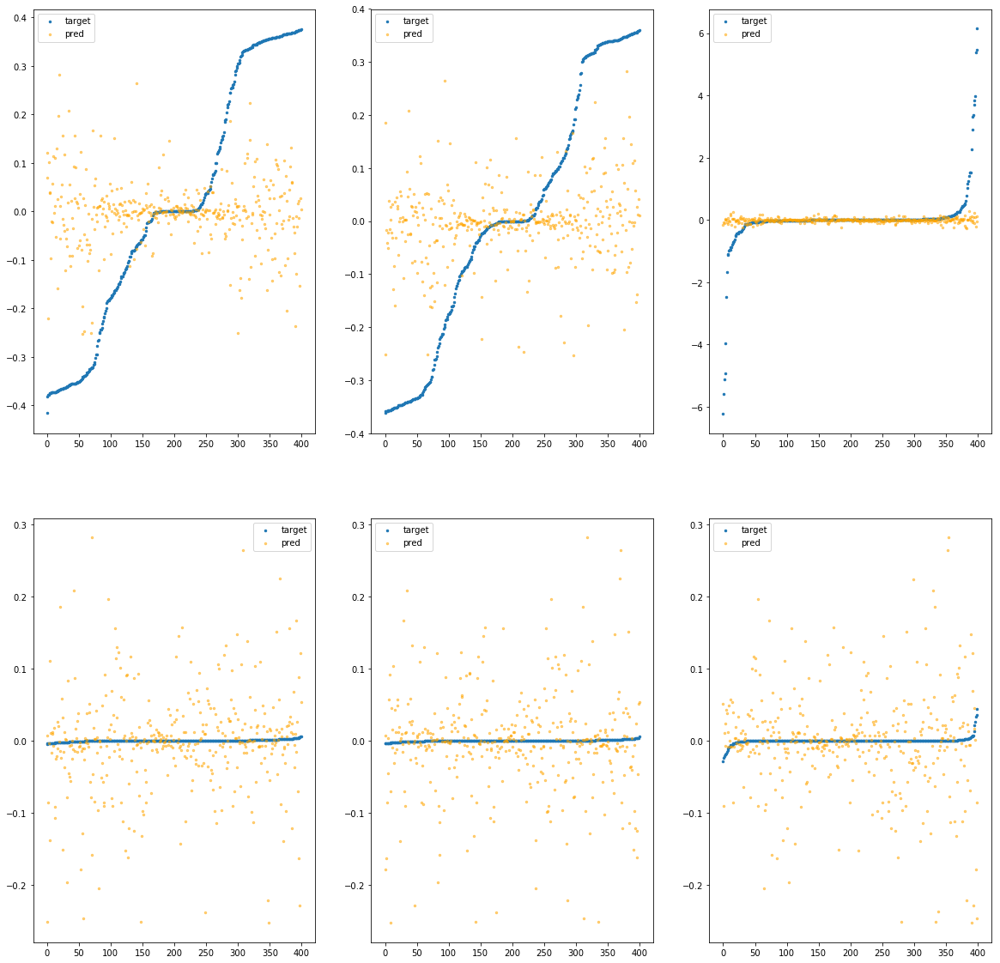

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20460>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.04e-01	6.47e-01	2.16e-01	3.27e+03	7.08e-02	5.01e-03
y		-1.13e-01	6.28e-01	1.97e-01	4.78e+02	6.10e-02	3.72e-03
z		-1.41e-02	6.50e+00	3.00e-01	4.62e+02	8.87e-01	7.87e-01
phi		-3.28e+03	4.65e-01	5.08e-02	1.17e+06	6.10e-03	3.73e-05
theta		-4.80e+03	4.65e-01	5.07e-02	7.01e+05	6.09e-03	3.71e-05
psi		-2.51e+02	4.66e-01	5.11e-02	1.00e+06	6.18e-03	3.82e-05


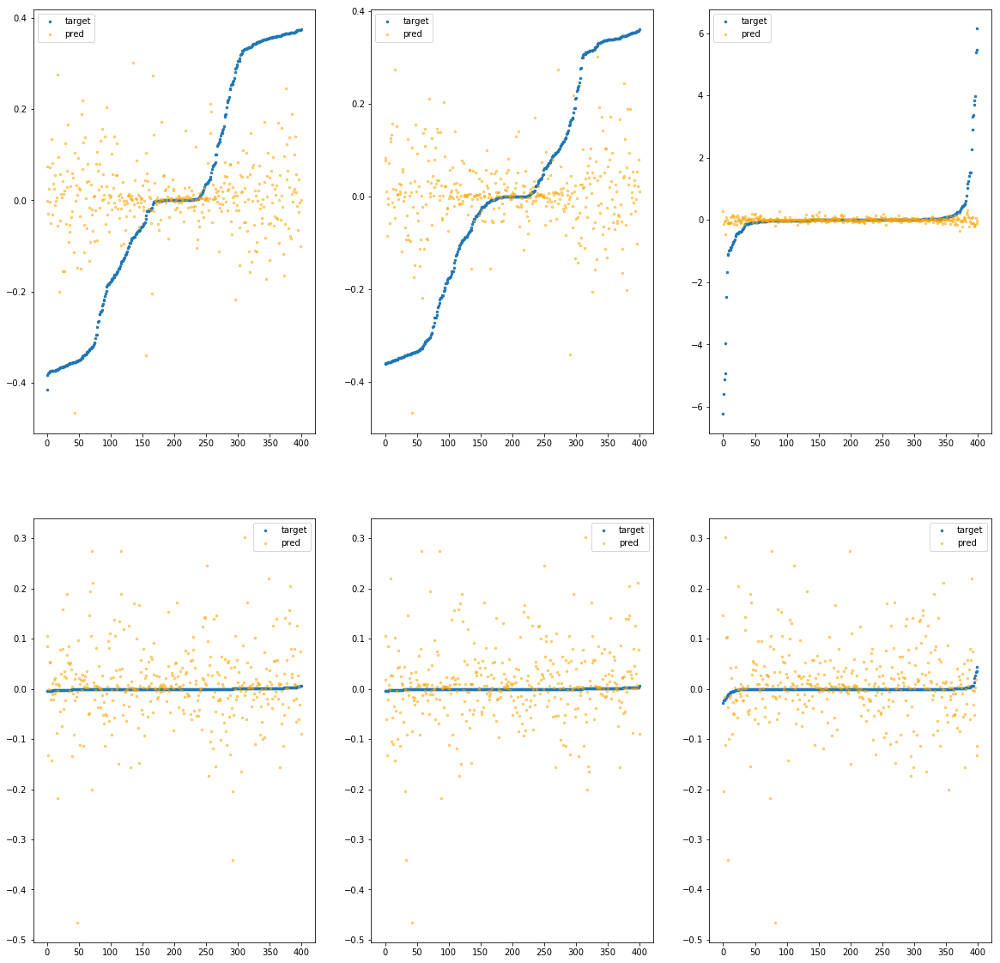

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f204c0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.40e-03	4.17e-01	2.06e-01	4.27e+02	6.45e-02	4.16e-03
y		-3.10e-05	3.73e-01	1.88e-01	8.01e+01	5.48e-02	3.01e-03
z		3.27e-03	6.19e+00	2.77e-01	4.74e+01	8.72e-01	7.60e-01
phi		-2.62e+01	3.59e-02	4.71e-03	1.32e+05	5.06e-05	2.56e-09
theta		-3.94e+01	3.59e-02	4.70e-03	8.67e+04	5.13e-05	2.64e-09
psi		-1.76e+00	4.95e-02	5.05e-03	8.34e+04	6.77e-05	4.59e-09


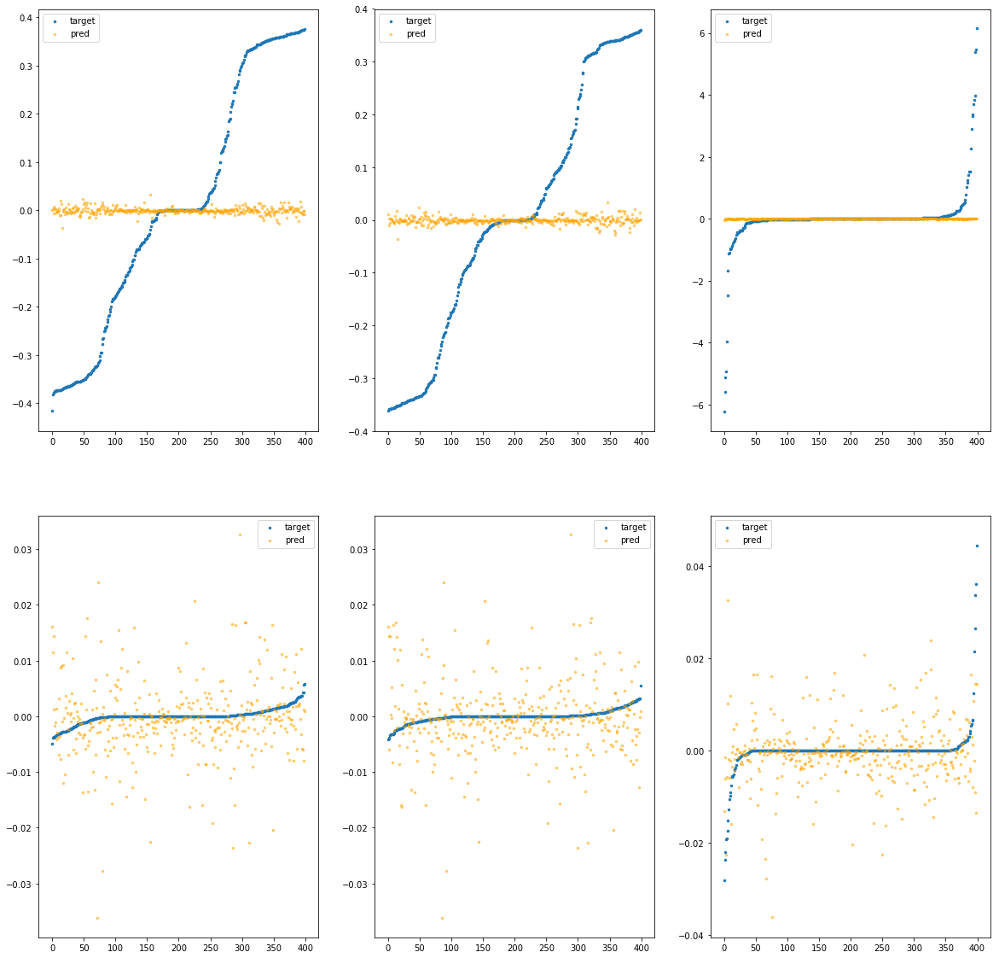

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20520>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.38e-03	4.62e-01	2.07e-01	1.74e+03	6.43e-02	4.13e-03
y		-1.40e-02	4.83e-01	1.90e-01	3.61e+02	5.56e-02	3.09e-03
z		-4.97e-03	6.26e+00	2.83e-01	2.41e+02	8.79e-01	7.73e-01
phi		-3.23e+02	1.36e-01	1.57e-02	6.01e+05	6.04e-04	3.65e-07
theta		-4.71e+02	1.37e-01	1.56e-02	3.11e+05	5.99e-04	3.59e-07
psi		-2.28e+01	1.18e-01	1.57e-02	1.78e+05	5.85e-04	3.42e-07


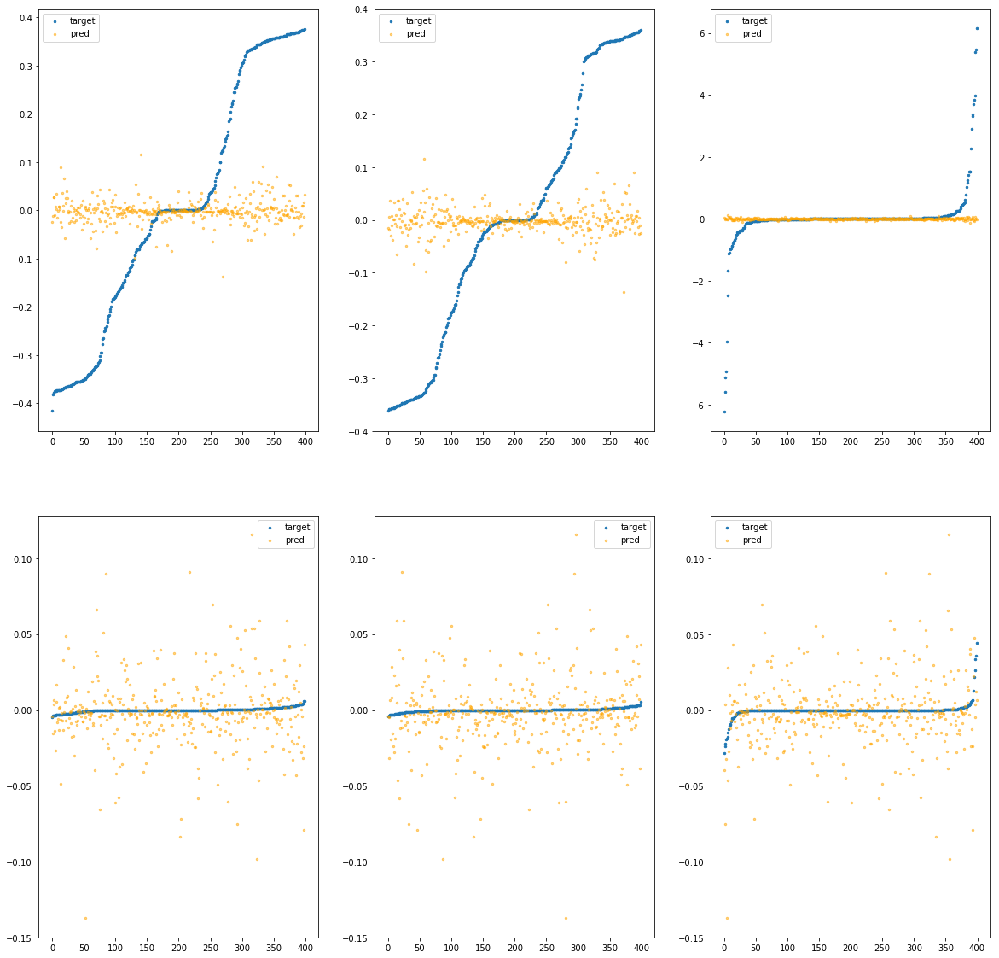

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20580>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.93e-03	5.23e-01	2.05e-01	1.66e+03	6.47e-02	4.18e-03
y		7.30e-04	4.88e-01	1.87e-01	1.93e+02	5.48e-02	3.00e-03
z		-9.12e-03	6.32e+00	2.92e-01	3.80e+02	8.83e-01	7.79e-01
phi		-1.18e+03	2.00e-01	3.07e-02	7.04e+05	2.21e-03	4.87e-06
theta		-1.73e+03	2.00e-01	3.05e-02	2.62e+05	2.20e-03	4.84e-06
psi		-8.58e+01	1.90e-01	3.03e-02	4.88e+05	2.13e-03	4.54e-06


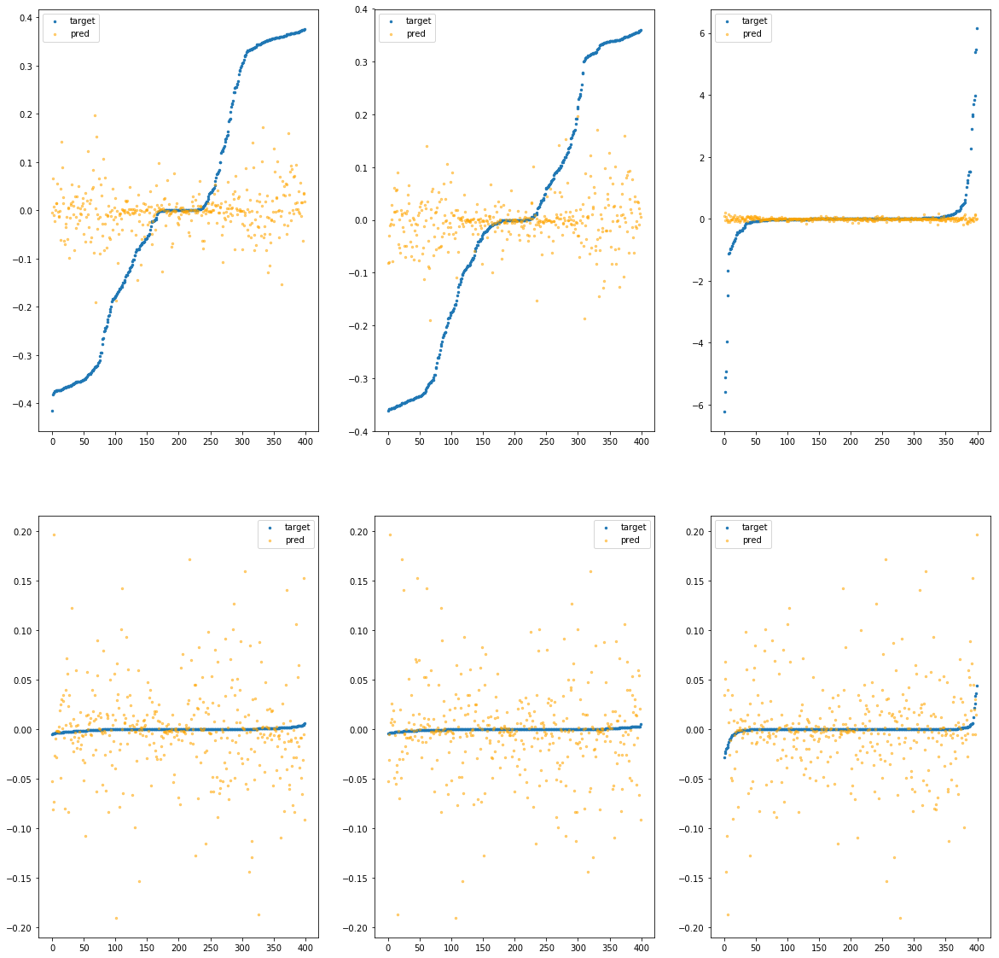

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f205e0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.63e-02	5.47e-01	2.08e-01	2.00e+03	6.71e-02	4.50e-03
y		-4.24e-02	5.41e-01	1.91e-01	3.55e+02	5.71e-02	3.27e-03
z		4.52e-03	6.14e+00	2.95e-01	4.62e+02	8.71e-01	7.58e-01
phi		-2.05e+03	2.63e-01	3.99e-02	6.50e+05	3.81e-03	1.45e-05
theta		-2.99e+03	2.65e-01	3.97e-02	3.64e+05	3.80e-03	1.44e-05
psi		-1.52e+02	2.66e-01	3.95e-02	6.05e+05	3.76e-03	1.42e-05


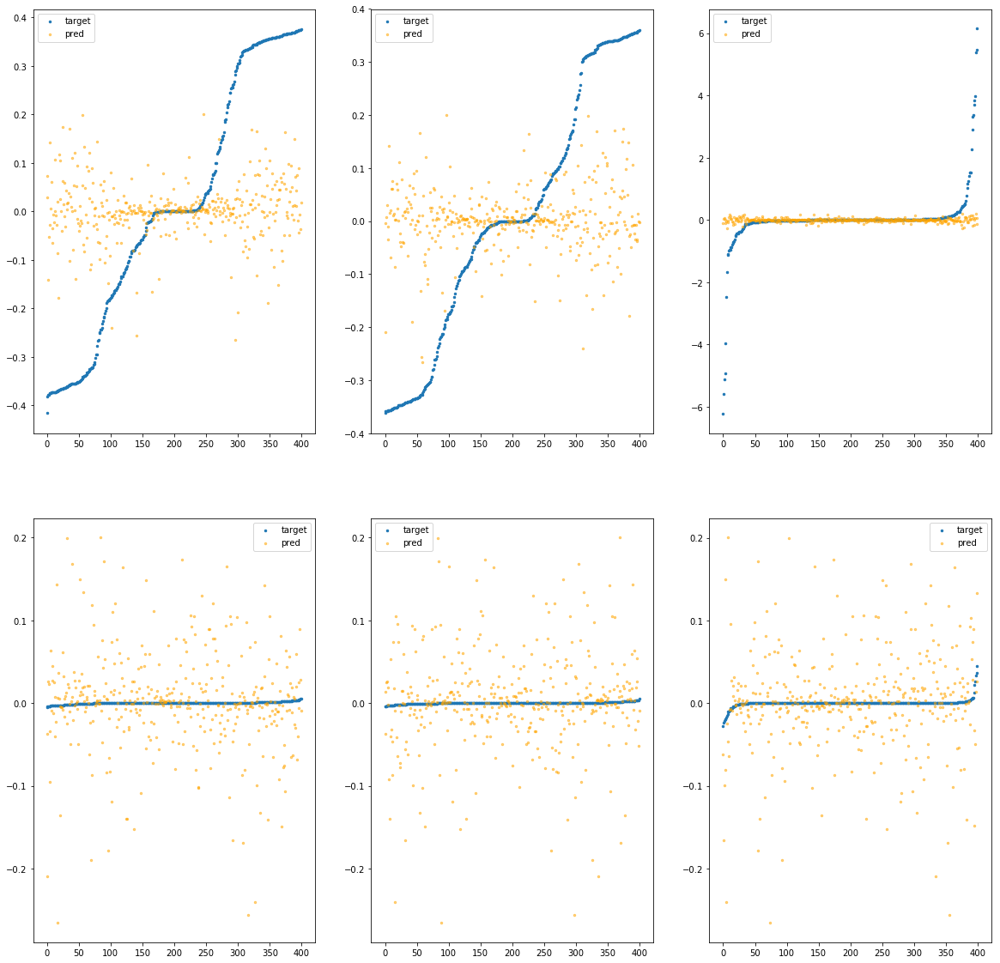

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20640>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.41e-01	6.82e-01	2.19e-01	2.73e+03	7.32e-02	5.35e-03
y		-1.53e-01	6.55e-01	2.00e-01	4.07e+02	6.32e-02	4.00e-03
z		-1.38e-02	6.25e+00	3.03e-01	4.77e+02	8.87e-01	7.87e-01
phi		-3.00e+03	3.51e-01	4.95e-02	8.36e+05	5.58e-03	3.12e-05
theta		-4.41e+03	3.48e-01	4.95e-02	5.46e+05	5.60e-03	3.14e-05
psi		-2.30e+02	3.51e-01	4.97e-02	8.68e+05	5.66e-03	3.20e-05


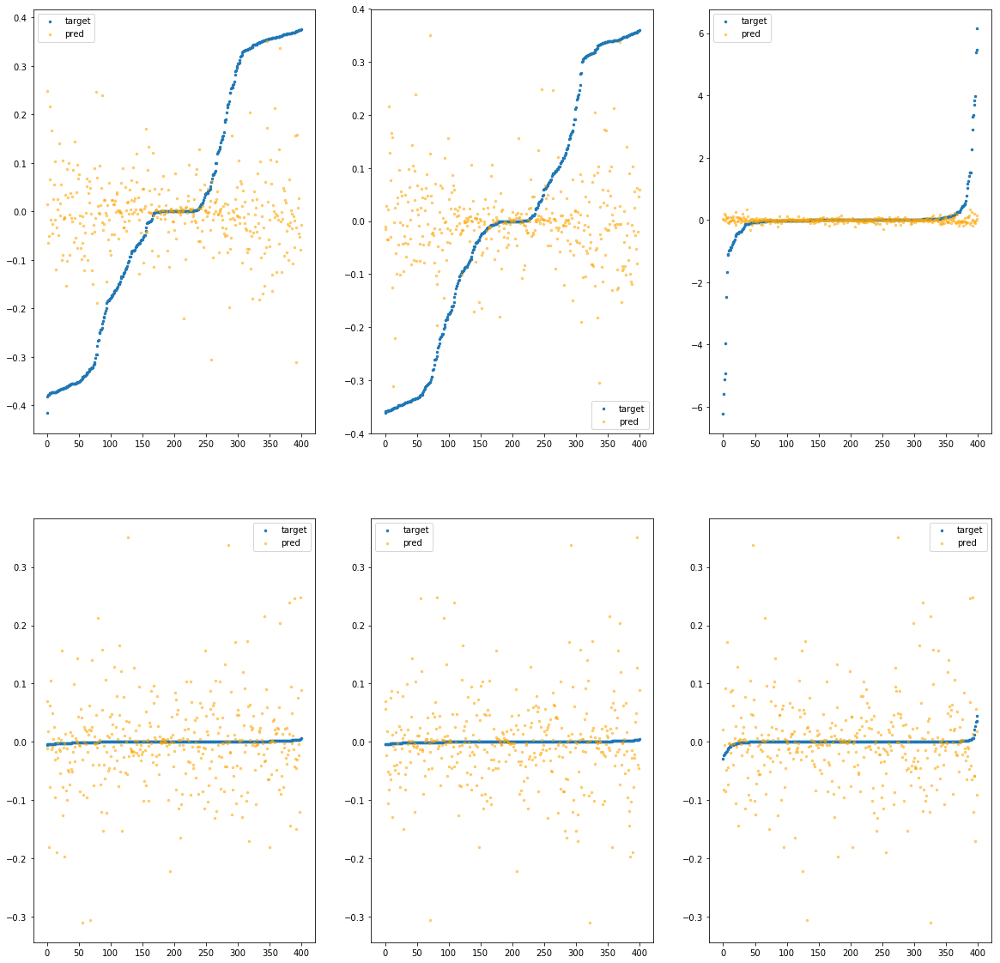

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f206a0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.04e-03	4.19e-01	2.05e-01	7.46e+02	6.40e-02	4.10e-03
y		-1.33e-03	3.66e-01	1.88e-01	1.20e+02	5.49e-02	3.01e-03
z		-7.26e-04	6.23e+00	2.78e-01	5.72e+01	8.75e-01	7.66e-01
phi		-1.42e+01	2.49e-02	3.81e-03	2.57e+05	2.82e-05	7.95e-10
theta		-1.90e+01	1.96e-02	3.63e-03	1.36e+05	2.54e-05	6.45e-10
psi		-8.74e-01	4.68e-02	4.18e-03	6.47e+04	4.60e-05	2.11e-09


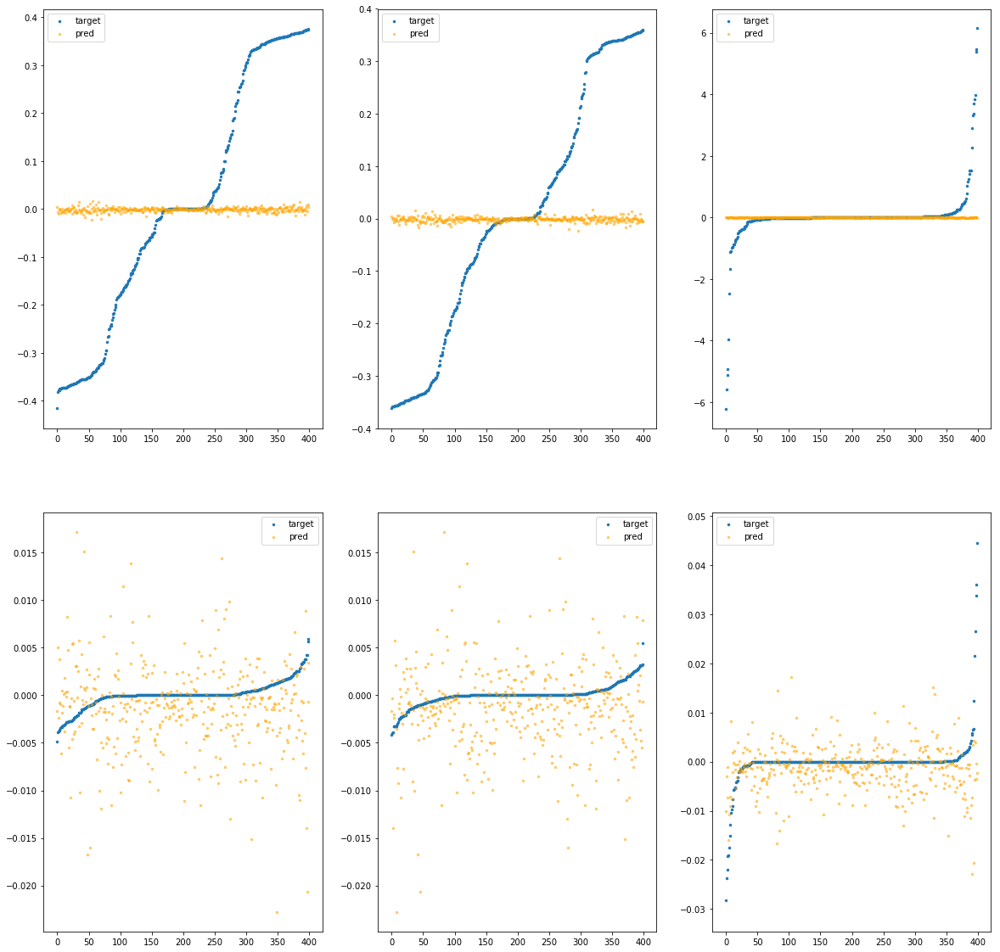

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20700>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.19e-02	4.70e-01	2.07e-01	8.21e+02	6.49e-02	4.21e-03
y		-2.60e-03	3.99e-01	1.89e-01	1.22e+02	5.50e-02	3.02e-03
z		7.85e-03	6.20e+00	2.79e-01	1.10e+02	8.68e-01	7.53e-01
phi		-1.41e+02	6.60e-02	1.06e-02	3.47e+05	2.65e-04	7.03e-08
theta		-2.08e+02	6.44e-02	1.05e-02	1.26e+05	2.65e-04	7.02e-08
psi		-1.16e+01	8.67e-02	1.11e-02	2.44e+05	3.10e-04	9.58e-08


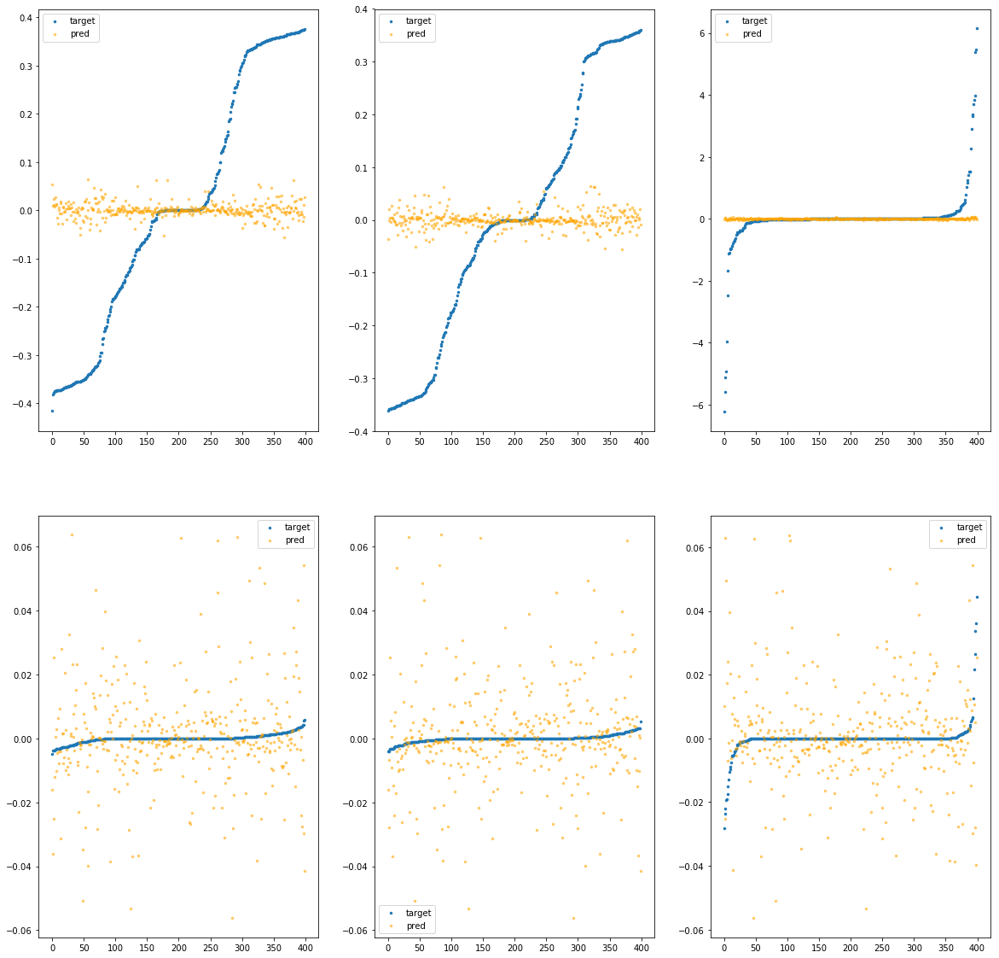

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20760>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.67e-02	5.10e-01	2.08e-01	9.91e+02	6.65e-02	4.42e-03
y		-1.40e-02	4.91e-01	1.89e-01	1.96e+02	5.56e-02	3.09e-03
z		-9.37e-03	6.20e+00	2.83e-01	1.53e+02	8.83e-01	7.80e-01
phi		-4.54e+02	1.62e-01	1.84e-02	3.58e+05	8.47e-04	7.18e-07
theta		-6.66e+02	1.62e-01	1.83e-02	1.64e+05	8.47e-04	7.17e-07
psi		-3.37e+01	1.61e-01	1.85e-02	3.25e+05	8.52e-04	7.26e-07


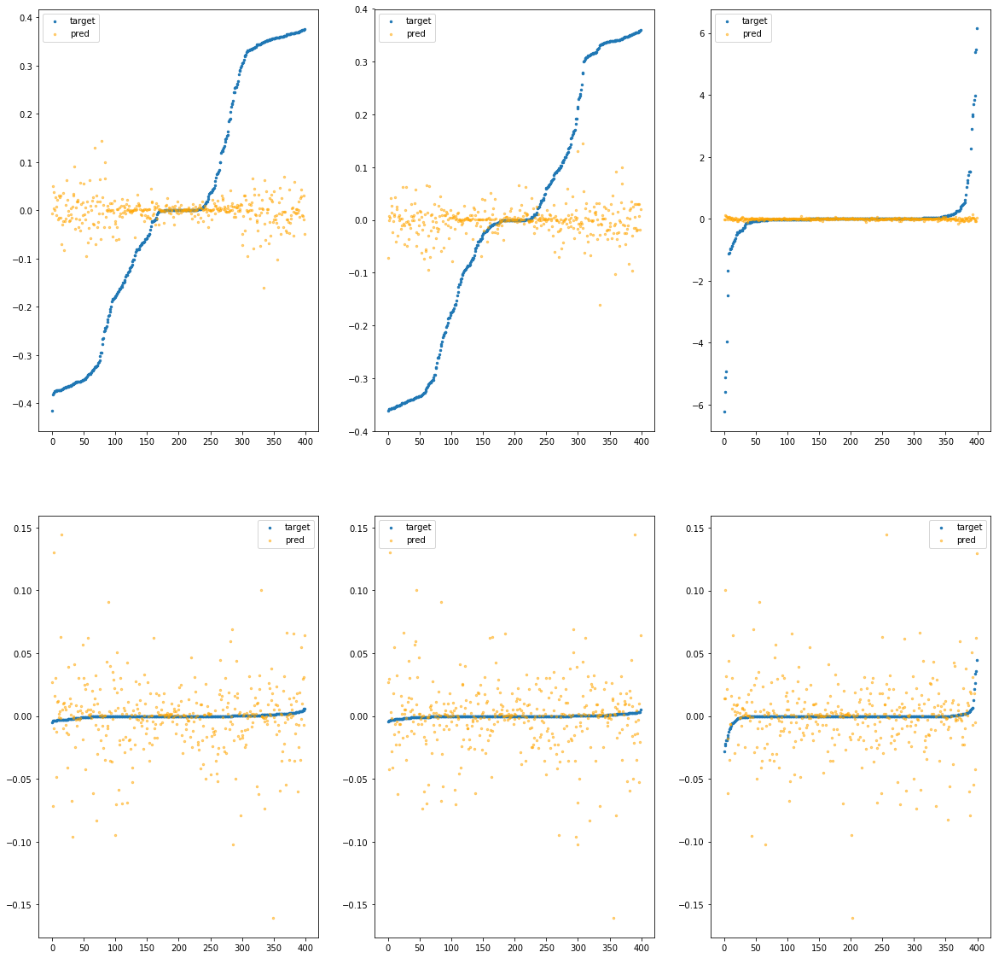

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f207c0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.06e-02	6.73e-01	2.08e-01	1.84e+03	6.67e-02	4.45e-03
y		-9.57e-02	6.54e-01	1.96e-01	3.63e+02	6.01e-02	3.61e-03
z		-1.28e-02	6.31e+00	2.95e-01	2.65e+02	8.86e-01	7.85e-01
phi		-2.05e+03	3.05e-01	3.86e-02	5.97e+05	3.82e-03	1.46e-05
theta		-3.04e+03	3.05e-01	3.87e-02	4.37e+05	3.86e-03	1.49e-05
psi		-1.57e+02	3.10e-01	3.87e-02	9.97e+05	3.87e-03	1.49e-05


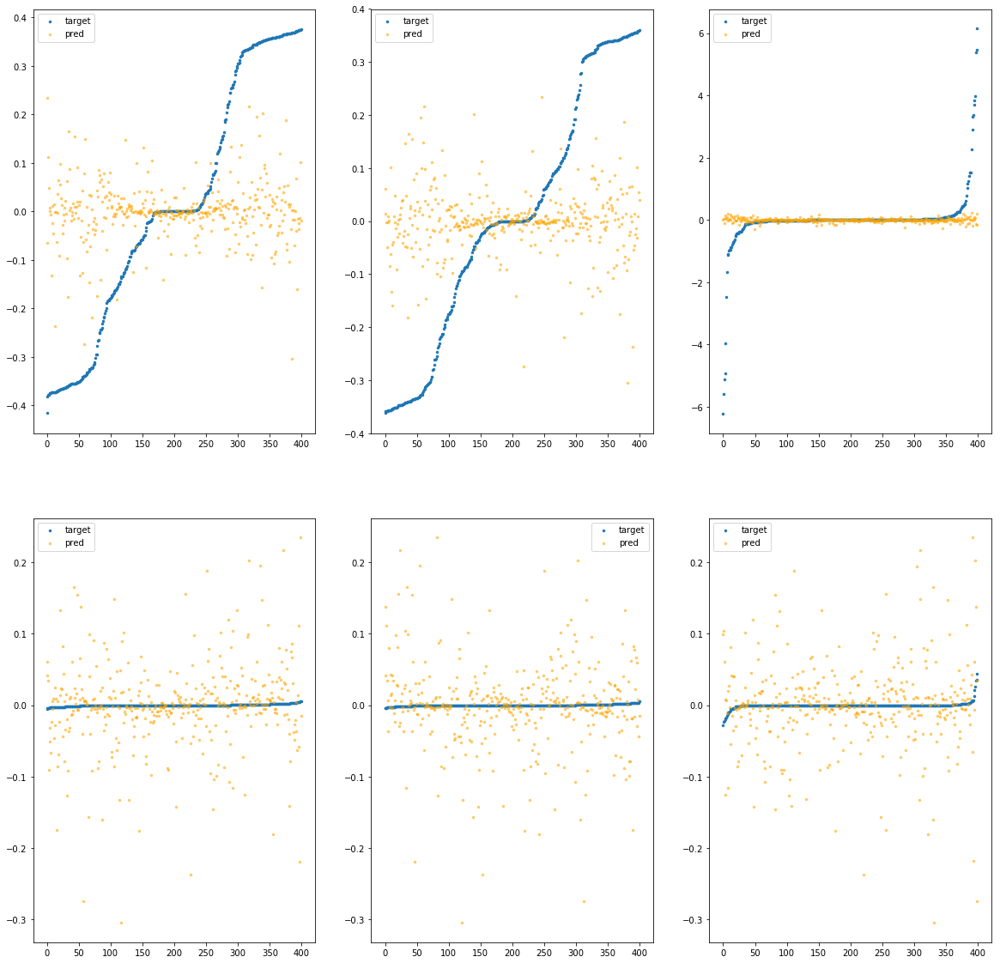

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fb253f20820>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.61e-02	7.22e-01	2.04e-01	1.46e+03	6.51e-02	4.24e-03
y		-3.80e-02	5.65e-01	1.88e-01	4.13e+02	5.69e-02	3.24e-03
z		2.48e-02	6.16e+00	2.90e-01	5.01e+02	8.53e-01	7.28e-01
phi		-2.97e+03	3.54e-01	4.75e-02	6.48e+05	5.52e-03	3.05e-05
theta		-4.35e+03	3.53e-01	4.76e-02	1.52e+05	5.52e-03	3.05e-05
psi		-2.25e+02	3.54e-01	4.76e-02	7.94e+05	5.53e-03	3.06e-05


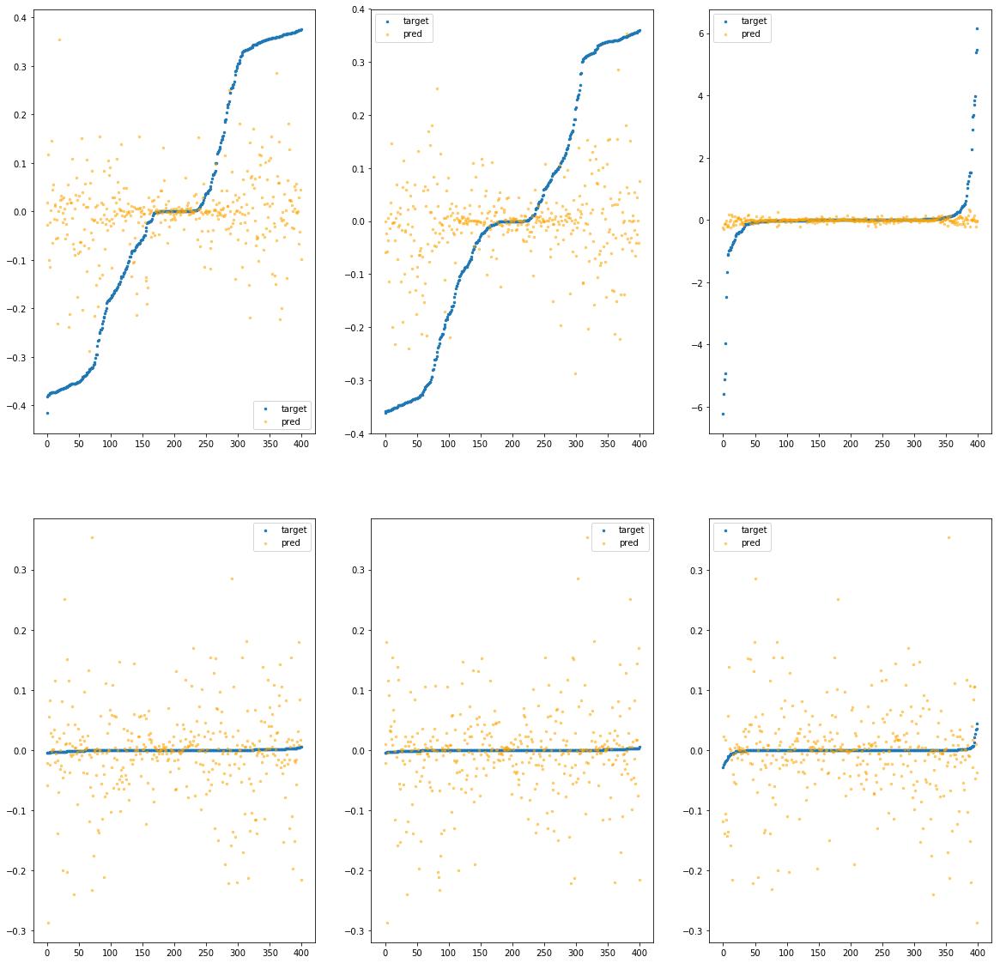

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20880>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.23e+00	1.68e+00	4.00e-01	3.43e+04	2.71e-01	7.36e-02
y		-3.56e+00	1.84e+00	3.75e-01	4.12e+03	2.50e-01	6.24e-02
z		-2.12e-01	6.33e+00	5.23e-01	5.07e+03	1.06e+00	1.12e+00
phi		-1.06e+05	1.94e+00	3.28e-01	1.05e+07	1.97e-01	3.87e-02
theta		-1.55e+05	1.94e+00	3.28e-01	7.50e+06	1.97e-01	3.87e-02
psi		-8.03e+03	1.95e+00	3.28e-01	8.65e+06	1.97e-01	3.88e-02


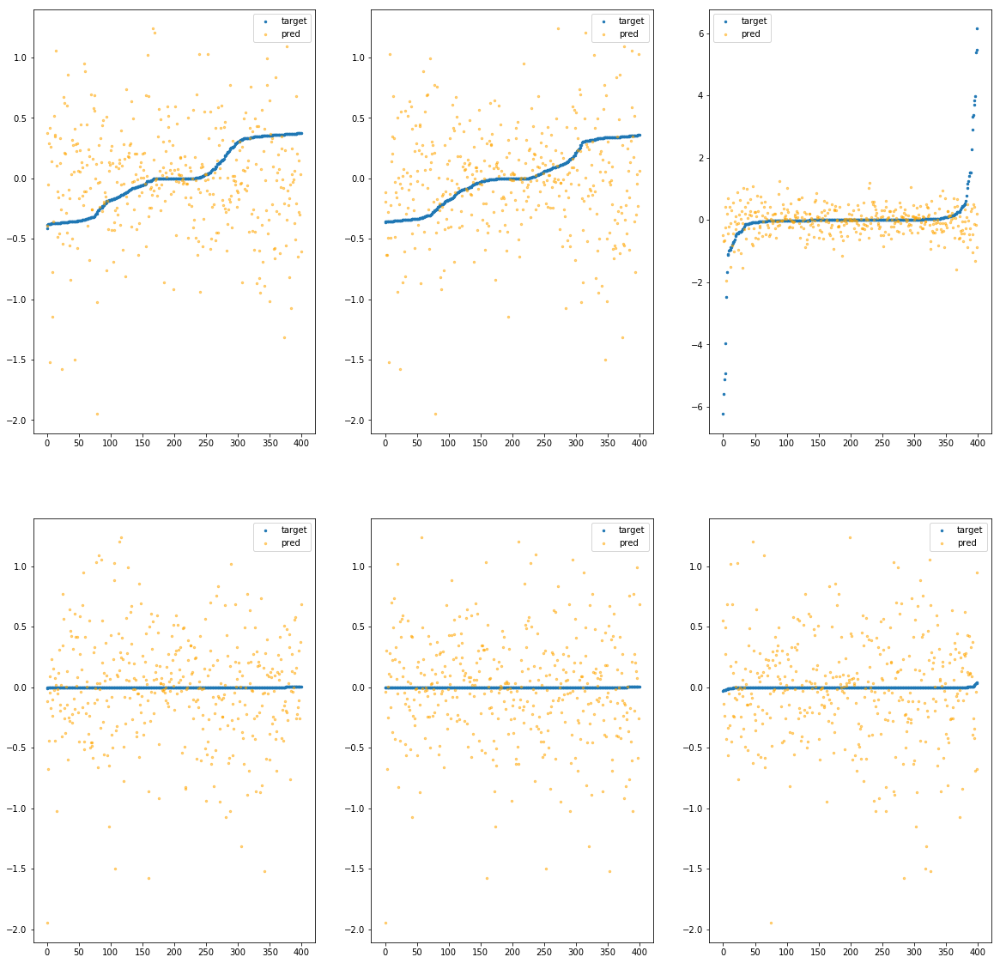

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f208e0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.14e+00	2.55e+00	5.10e-01	4.85e+04	4.58e-01	2.10e-01
y		-7.15e+00	3.28e+00	4.90e-01	7.93e+03	4.47e-01	2.00e-01
z		-3.06e-01	6.93e+00	6.09e-01	8.02e+03	1.14e+00	1.31e+00
phi		-2.15e+05	2.93e+00	4.65e-01	2.01e+07	4.00e-01	1.60e-01
theta		-3.15e+05	2.93e+00	4.65e-01	9.58e+06	4.00e-01	1.60e-01
psi		-1.63e+04	2.93e+00	4.65e-01	1.30e+07	4.01e-01	1.61e-01


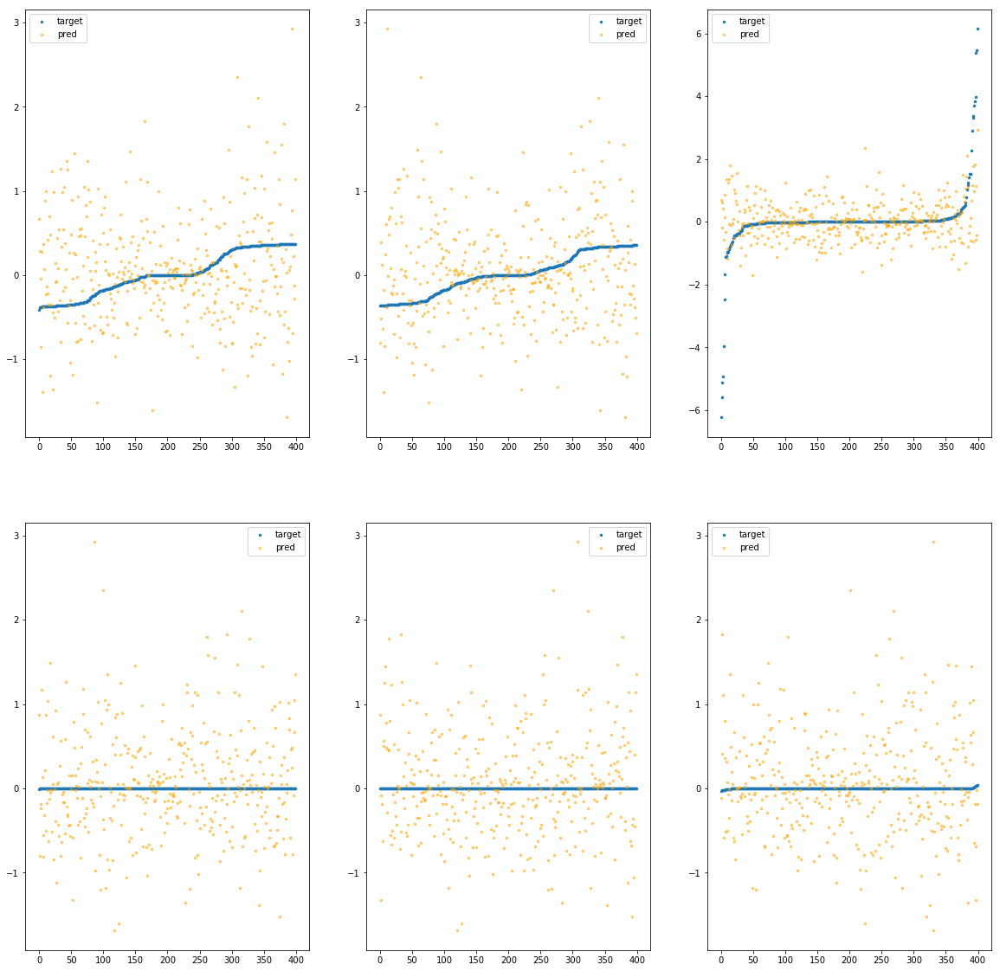

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20940>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.09e+00	2.08e+00	4.24e-01	6.21e+04	3.26e-01	1.06e-01
y		-4.40e+00	1.82e+00	4.05e-01	6.95e+03	2.96e-01	8.75e-02
z		-2.68e-01	7.52e+00	5.47e-01	8.95e+03	1.11e+00	1.23e+00
phi		-1.43e+05	1.74e+00	3.80e-01	2.87e+07	2.65e-01	7.04e-02
theta		-2.09e+05	1.74e+00	3.80e-01	4.68e+06	2.65e-01	7.05e-02
psi		-1.08e+04	1.73e+00	3.80e-01	1.10e+07	2.66e-01	7.05e-02


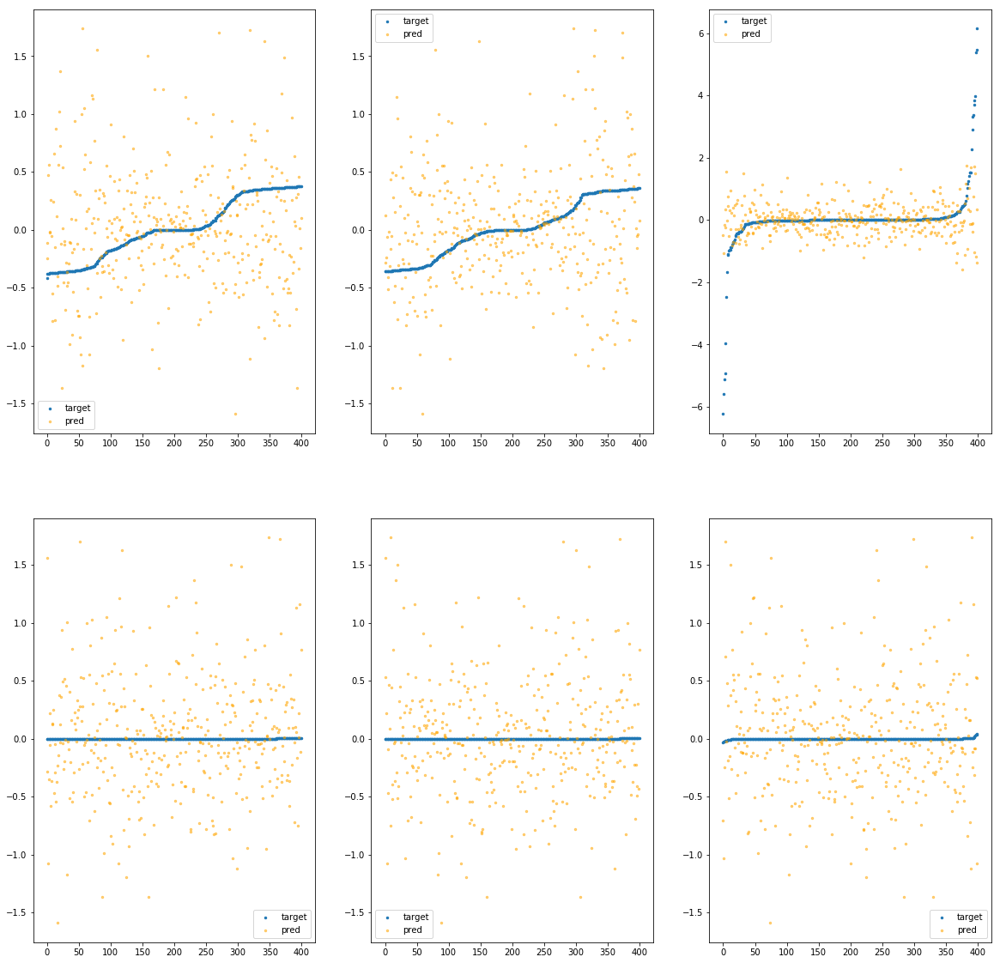

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f209a0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.46e+00	1.96e+00	4.81e-01	4.39e+04	4.14e-01	1.71e-01
y		-6.06e+00	2.27e+00	4.55e-01	3.72e+03	3.87e-01	1.50e-01
z		-5.34e-01	7.05e+00	6.31e-01	6.86e+03	1.34e+00	1.80e+00
phi		-1.91e+05	2.28e+00	4.44e-01	1.76e+07	3.56e-01	1.26e-01
theta		-2.80e+05	2.28e+00	4.44e-01	4.09e+06	3.55e-01	1.26e-01
psi		-1.45e+04	2.28e+00	4.44e-01	1.07e+07	3.56e-01	1.27e-01


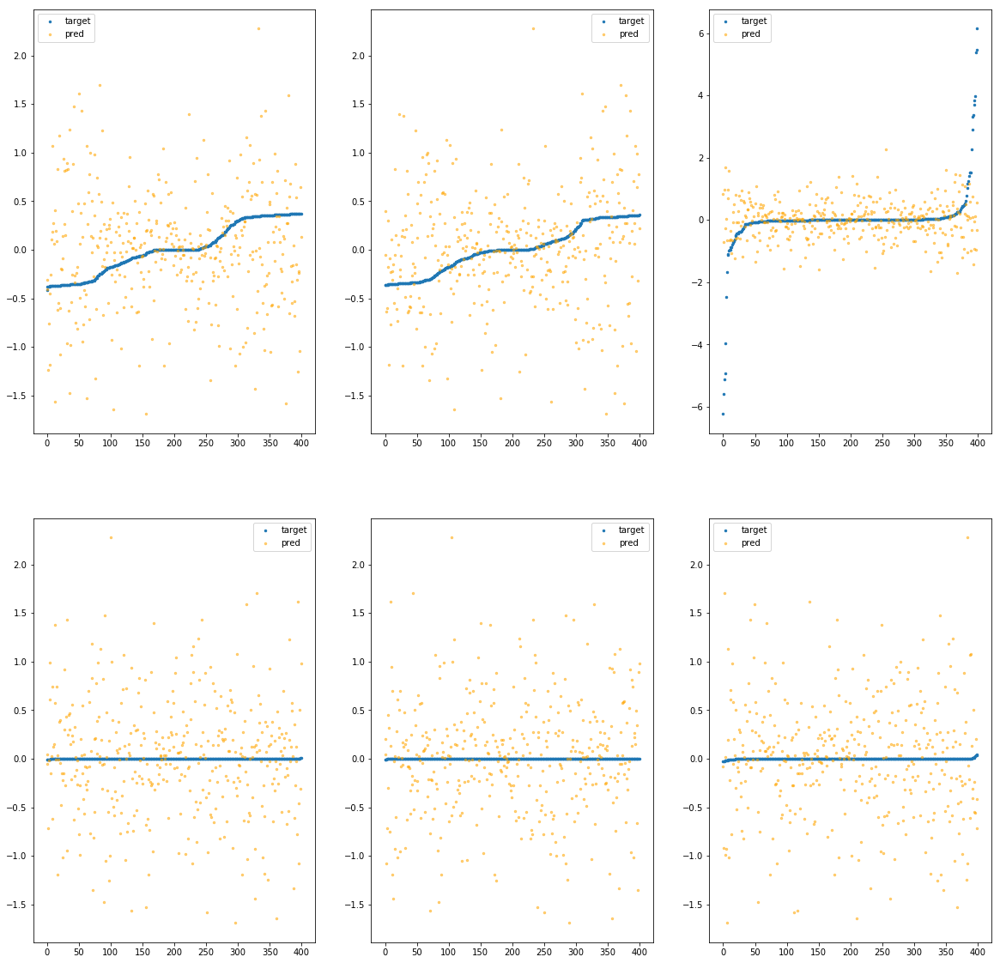

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20a00>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.55e+00	2.79e+00	5.32e-01	9.05e+04	5.48e-01	3.00e-01
y		-8.85e+00	3.12e+00	5.25e-01	1.33e+04	5.40e-01	2.91e-01
z		-4.85e-01	6.65e+00	6.69e-01	8.14e+03	1.30e+00	1.69e+00
phi		-2.62e+05	2.81e+00	5.01e-01	4.27e+07	4.87e-01	2.37e-01
theta		-3.84e+05	2.81e+00	5.01e-01	1.24e+07	4.87e-01	2.37e-01
psi		-1.98e+04	2.78e+00	5.01e-01	8.13e+06	4.86e-01	2.37e-01


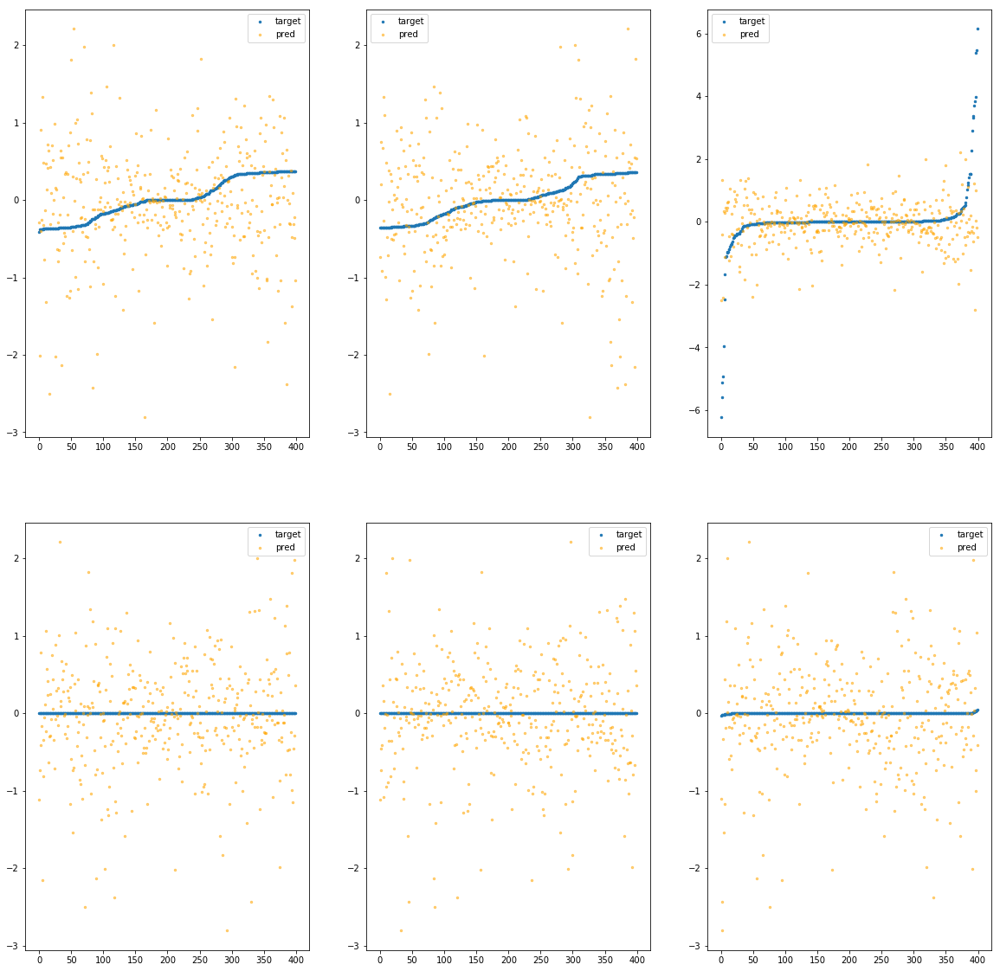

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20a60>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.56e+00	2.76e+00	4.39e-01	5.22e+04	3.57e-01	1.27e-01
y		-5.06e+00	2.75e+00	4.29e-01	5.30e+03	3.32e-01	1.10e-01
z		-4.99e-01	7.22e+00	5.79e-01	5.22e+03	1.31e+00	1.72e+00
phi		-1.51e+05	2.43e+00	3.88e-01	2.79e+07	2.80e-01	7.85e-02
theta		-2.21e+05	2.43e+00	3.88e-01	4.98e+06	2.80e-01	7.86e-02
psi		-1.14e+04	2.43e+00	3.88e-01	9.83e+06	2.81e-01	7.87e-02


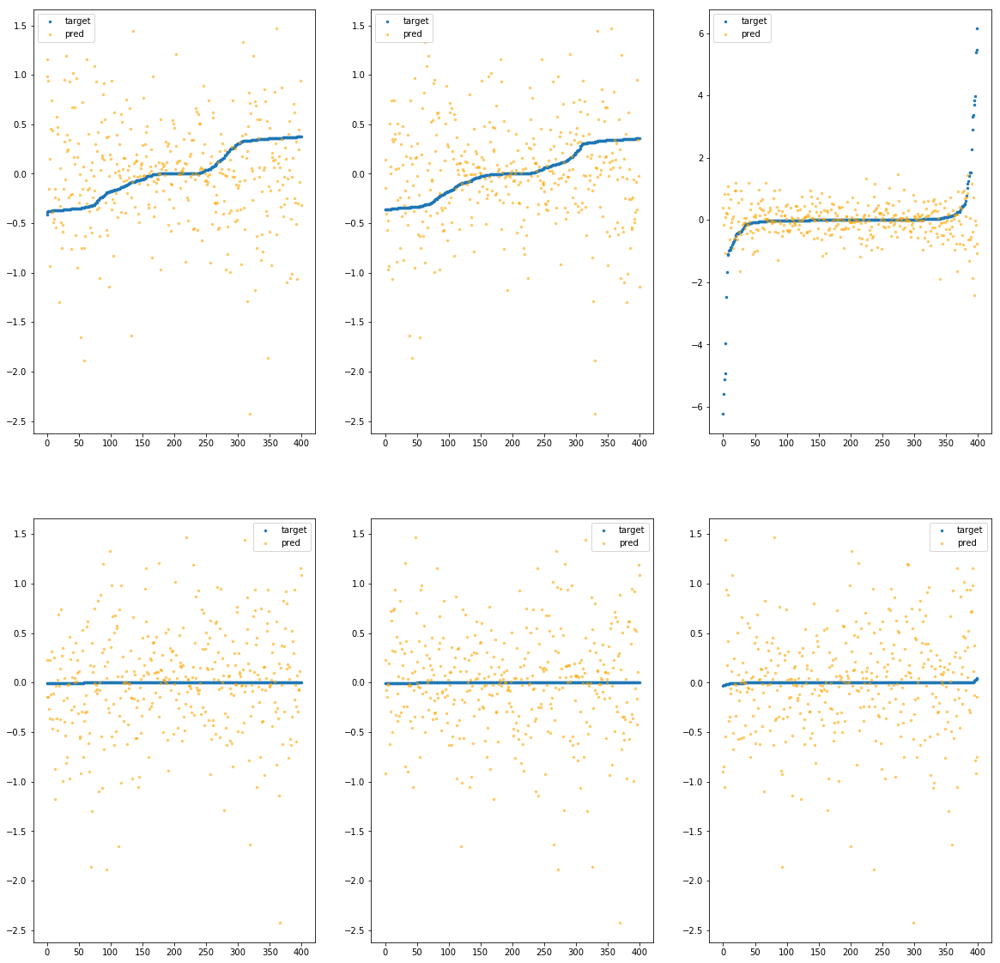

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20ac0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.63e+00	1.58e+00	3.58e-01	3.13e+04	2.33e-01	5.42e-02
y		-2.79e+00	1.56e+00	3.32e-01	7.05e+03	2.08e-01	4.33e-02
z		-1.92e-01	6.59e+00	4.83e-01	3.85e+03	1.04e+00	1.09e+00
phi		-8.71e+04	1.49e+00	2.95e-01	1.18e+07	1.62e-01	2.63e-02
theta		-1.28e+05	1.49e+00	2.95e-01	5.04e+06	1.62e-01	2.63e-02
psi		-6.62e+03	1.48e+00	2.95e-01	5.03e+06	1.62e-01	2.64e-02


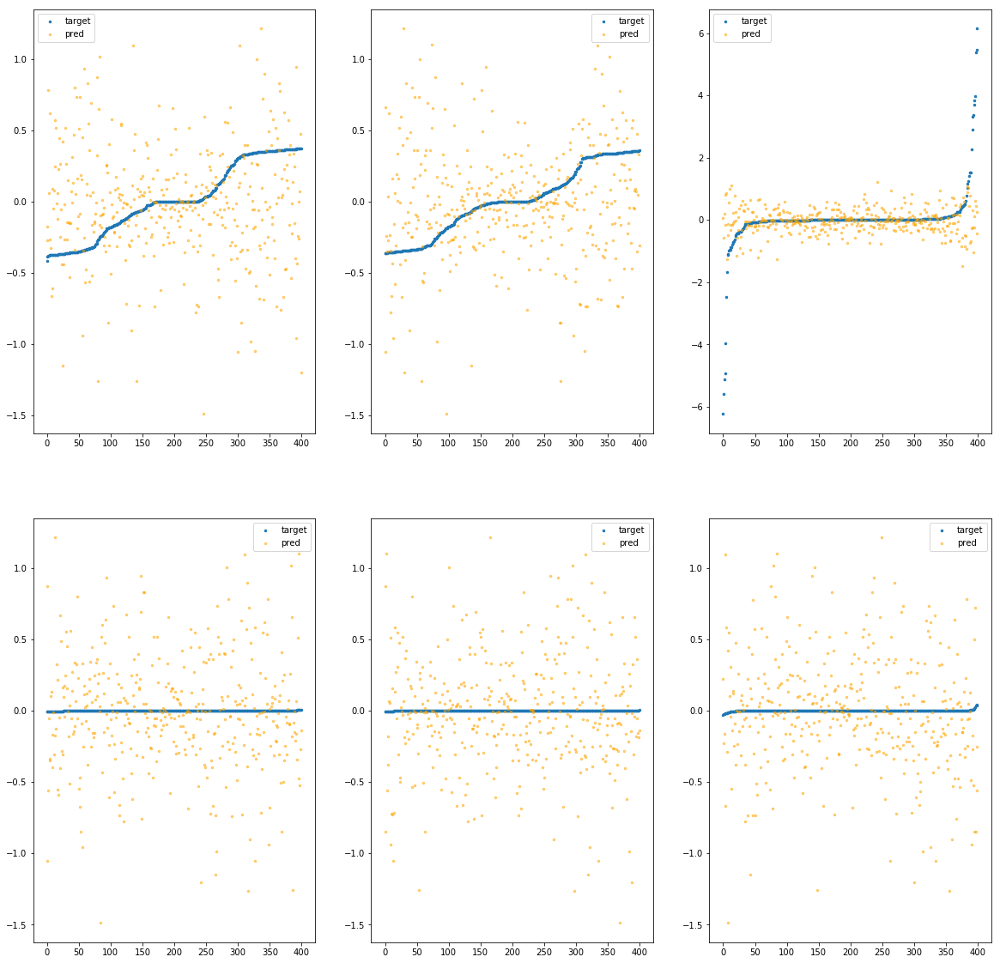

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20b20>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.36e+00	1.89e+00	4.41e-01	3.74e+04	3.43e-01	1.18e-01
y		-4.74e+00	1.72e+00	4.24e-01	1.03e+04	3.15e-01	9.92e-02
z		-2.38e-01	7.02e+00	5.71e-01	7.33e+03	1.08e+00	1.17e+00
phi		-1.47e+05	1.64e+00	4.04e-01	1.97e+07	2.73e-01	7.47e-02
theta		-2.15e+05	1.64e+00	4.04e-01	6.59e+06	2.73e-01	7.47e-02
psi		-1.11e+04	1.64e+00	4.04e-01	7.74e+06	2.73e-01	7.46e-02


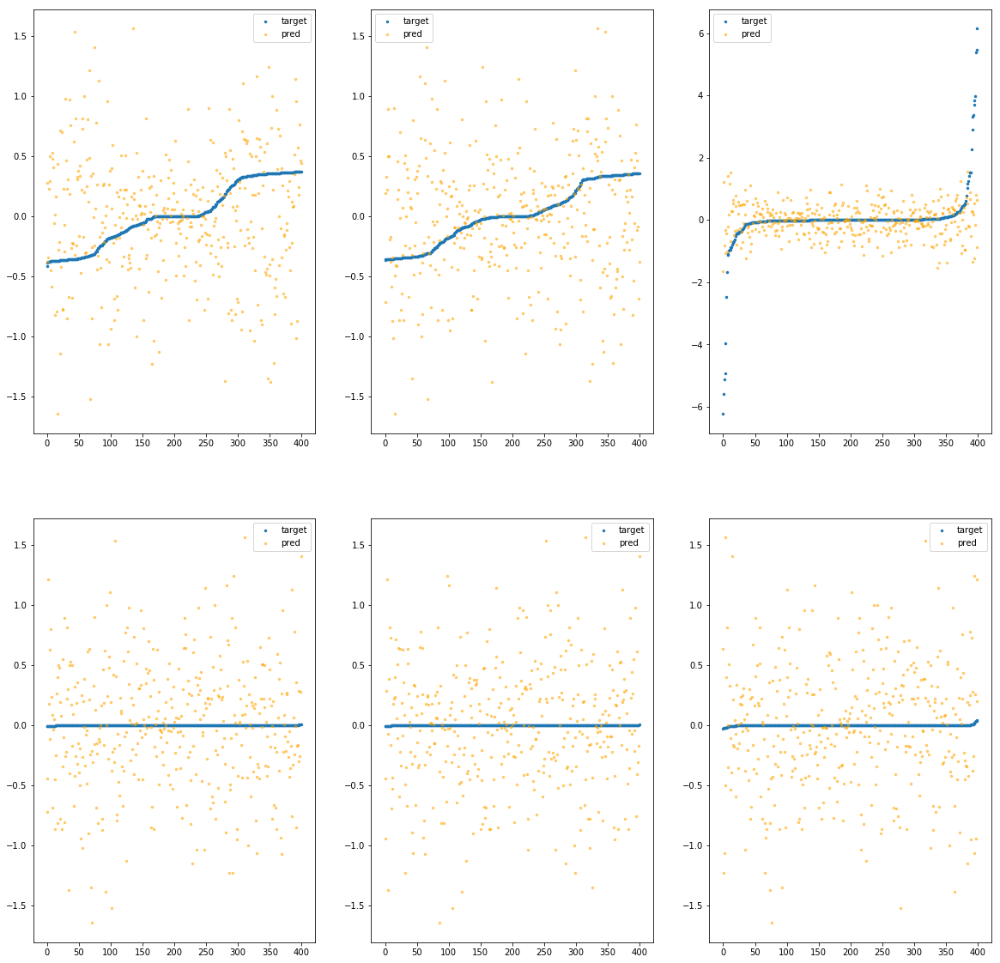

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20b80>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.28e+00	2.43e+00	4.38e-01	7.24e+04	3.39e-01	1.15e-01
y		-4.78e+00	2.42e+00	4.20e-01	9.85e+03	3.17e-01	1.00e-01
z		-1.33e-01	5.61e+00	5.35e-01	7.08e+03	9.92e-01	9.83e-01
phi		-1.46e+05	2.09e+00	3.89e-01	3.65e+07	2.71e-01	7.35e-02
theta		-2.13e+05	2.10e+00	3.89e-01	1.07e+07	2.71e-01	7.34e-02
psi		-1.11e+04	2.10e+00	3.89e-01	9.31e+06	2.72e-01	7.38e-02


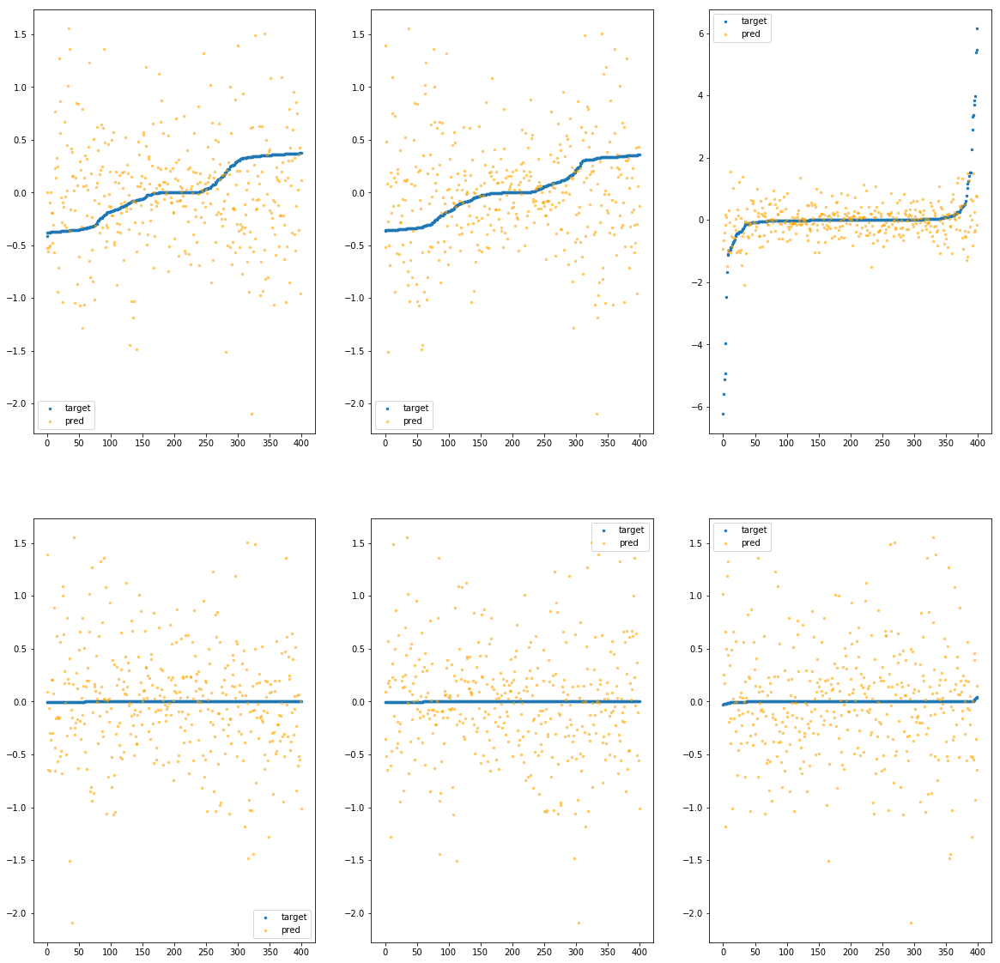

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20be0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.93e+00	2.39e+00	4.87e-01	5.76e+04	4.45e-01	1.98e-01
y		-6.76e+00	2.57e+00	4.89e-01	1.10e+04	4.25e-01	1.81e-01
z		-3.22e-01	6.24e+00	6.21e-01	7.88e+03	1.16e+00	1.34e+00
phi		-1.97e+05	2.24e+00	4.56e-01	2.33e+07	3.66e-01	1.34e-01
theta		-2.88e+05	2.24e+00	4.56e-01	1.38e+07	3.66e-01	1.34e-01
psi		-1.49e+04	2.22e+00	4.56e-01	8.72e+06	3.66e-01	1.34e-01


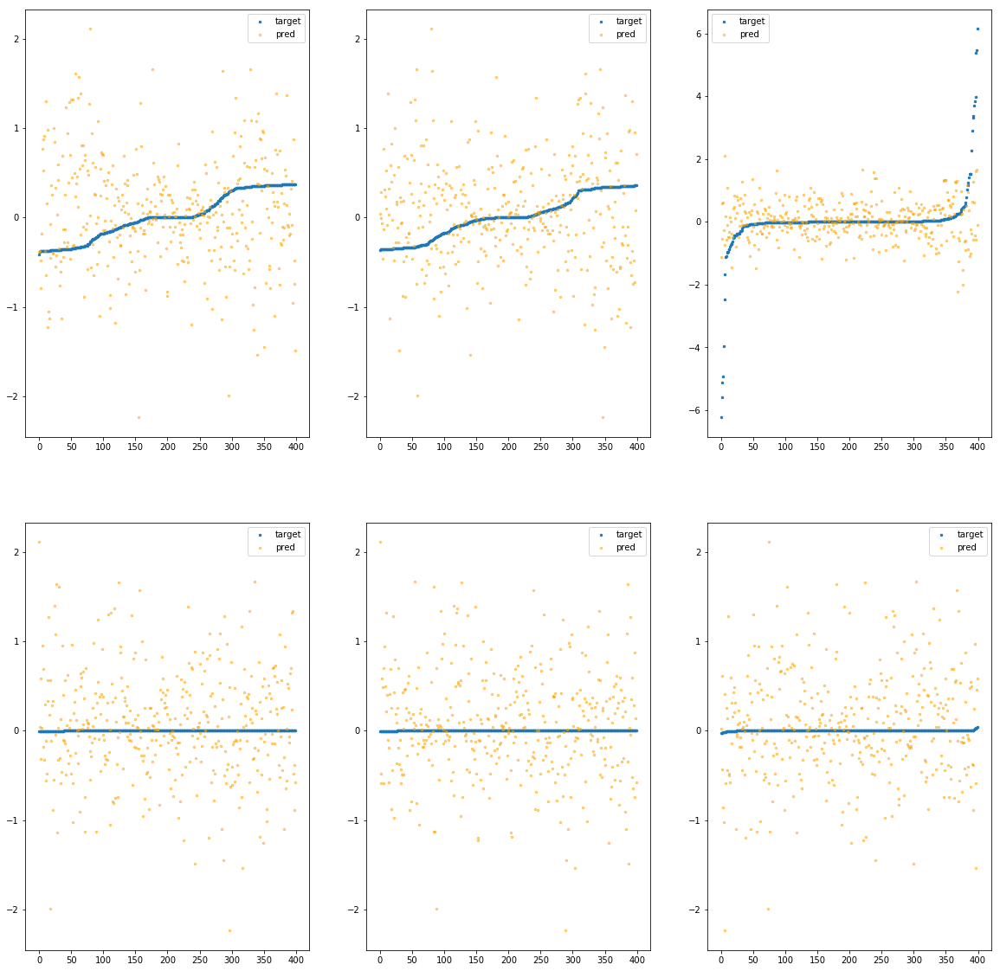

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20c40>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.67e+00	2.21e+00	3.62e-01	3.75e+04	2.35e-01	5.52e-02
y		-3.03e+00	1.63e+00	3.44e-01	2.01e+03	2.21e-01	4.89e-02
z		-2.09e-01	6.80e+00	4.89e-01	3.68e+03	1.06e+00	1.12e+00
phi		-9.58e+04	1.84e+00	3.02e-01	1.64e+07	1.78e-01	3.18e-02
theta		-1.40e+05	1.84e+00	3.01e-01	2.30e+06	1.78e-01	3.18e-02
psi		-7.25e+03	1.84e+00	3.01e-01	7.76e+06	1.78e-01	3.16e-02


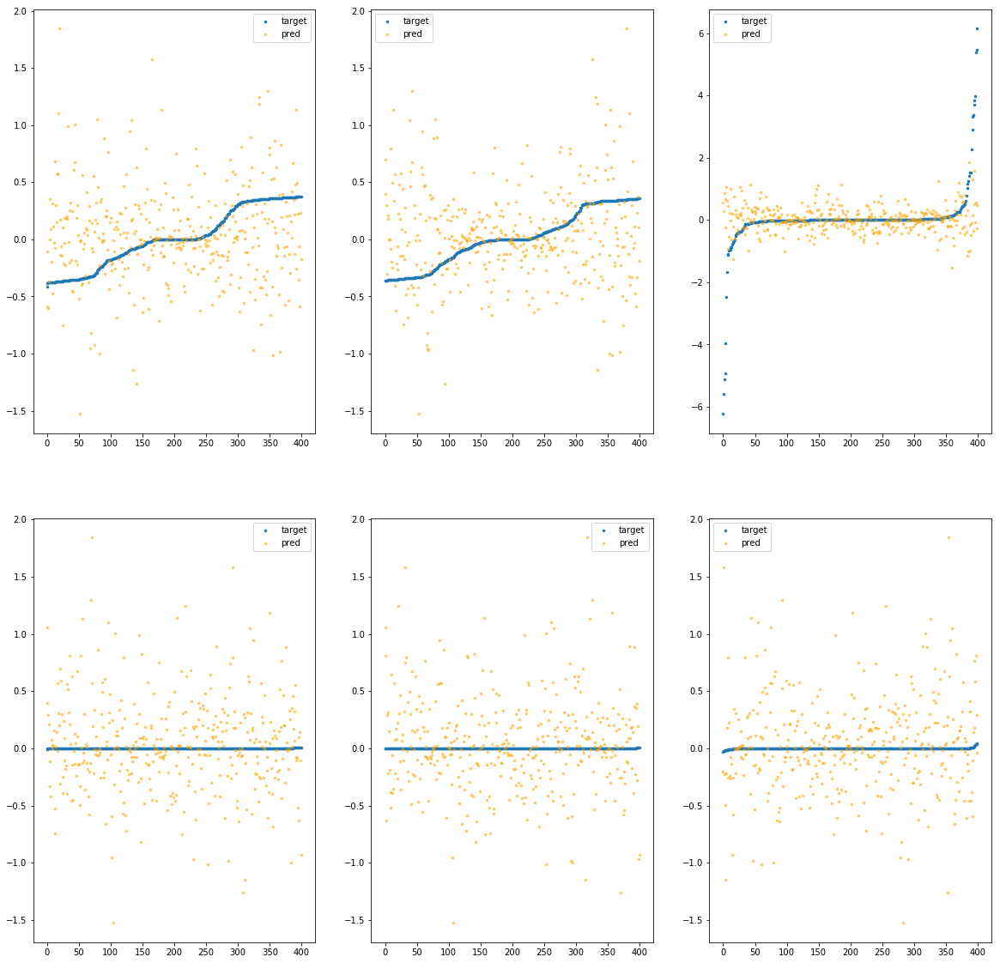

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20ca0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.51e+00	1.88e+00	3.55e-01	4.75e+04	2.25e-01	5.08e-02
y		-2.81e+00	1.90e+00	3.36e-01	7.32e+03	2.09e-01	4.37e-02
z		-2.73e-01	6.96e+00	4.79e-01	5.52e+03	1.11e+00	1.24e+00
phi		-8.85e+04	2.25e+00	2.86e-01	2.34e+07	1.65e-01	2.71e-02
theta		-1.30e+05	2.25e+00	2.86e-01	6.20e+06	1.65e-01	2.71e-02
psi		-6.70e+03	2.25e+00	2.86e-01	4.60e+06	1.64e-01	2.70e-02


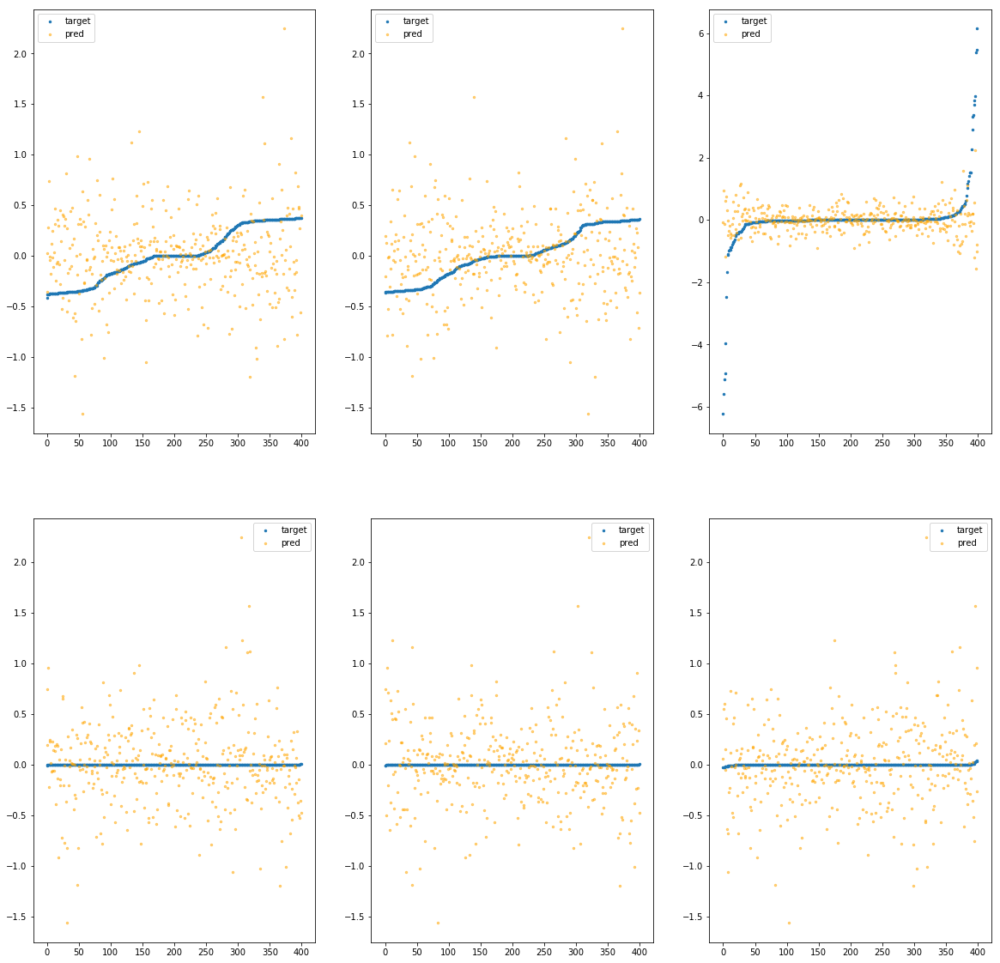

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20d00>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.85e+00	2.04e+00	4.11e-01	5.23e+04	3.11e-01	9.68e-02
y		-4.37e+00	1.80e+00	4.11e-01	5.89e+03	2.95e-01	8.68e-02
z		-2.56e-01	6.71e+00	5.39e-01	8.14e+03	1.10e+00	1.21e+00
phi		-1.46e+05	1.83e+00	3.78e-01	2.22e+07	2.73e-01	7.43e-02
theta		-2.14e+05	1.83e+00	3.78e-01	3.61e+06	2.72e-01	7.42e-02
psi		-1.11e+04	1.83e+00	3.78e-01	5.77e+06	2.73e-01	7.44e-02


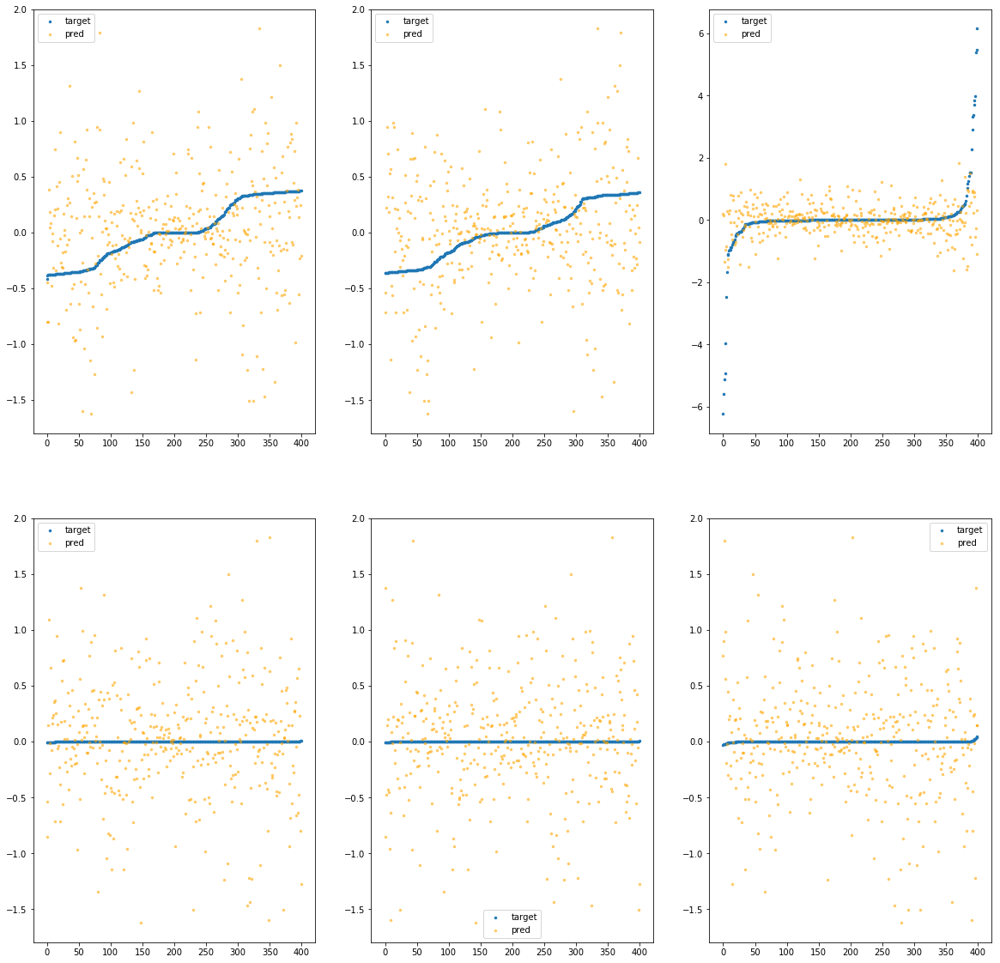

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20d60>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.06e+00	2.38e+00	4.10e-01	3.91e+04	3.25e-01	1.05e-01
y		-4.47e+00	2.36e+00	3.96e-01	1.43e+04	3.00e-01	8.98e-02
z		-1.49e-01	6.35e+00	5.18e-01	6.73e+03	1.01e+00	1.01e+00
phi		-1.41e+05	2.40e+00	3.69e-01	1.57e+07	2.62e-01	6.87e-02
theta		-2.07e+05	2.40e+00	3.69e-01	6.26e+06	2.62e-01	6.89e-02
psi		-1.07e+04	2.40e+00	3.69e-01	5.20e+06	2.62e-01	6.88e-02


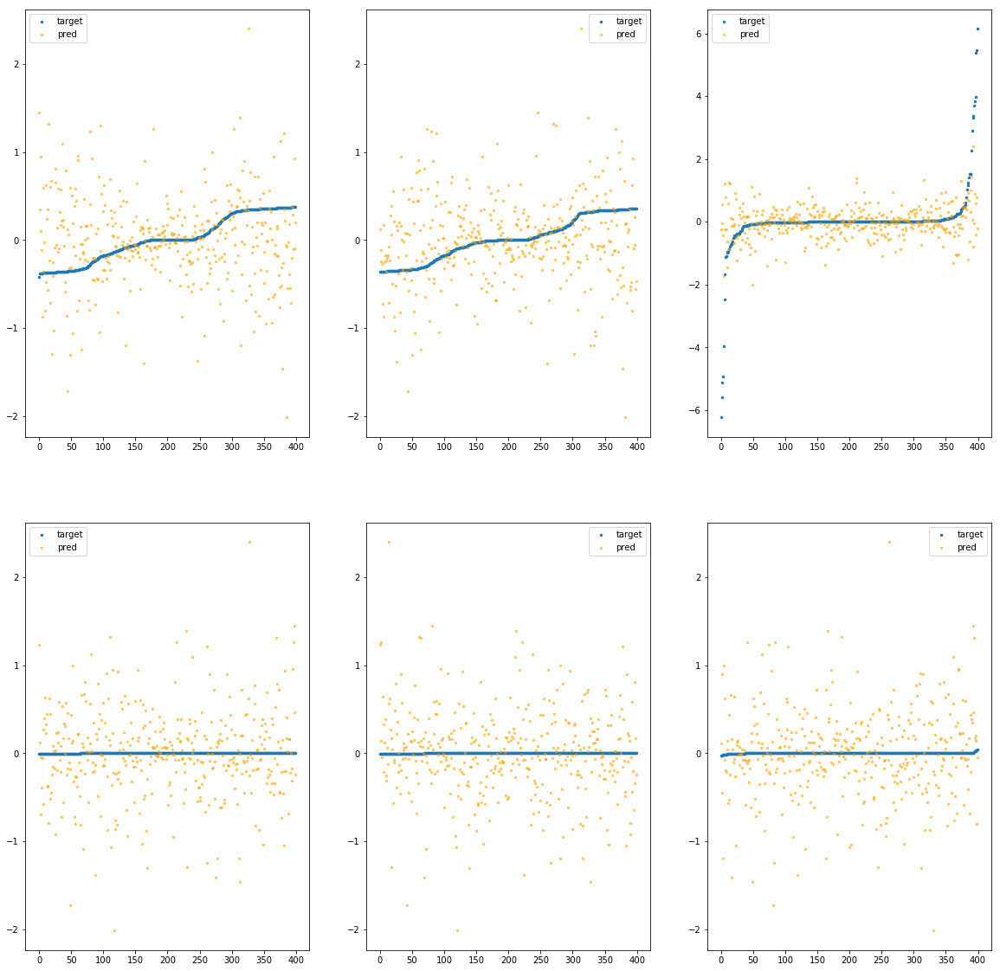

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20dc0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.94e+00	2.39e+00	4.17e-01	3.50e+04	3.16e-01	1.00e-01
y		-4.64e+00	2.70e+00	4.10e-01	4.55e+03	3.09e-01	9.55e-02
z		-2.42e-01	7.06e+00	5.34e-01	5.29e+03	1.09e+00	1.18e+00
phi		-1.35e+05	2.34e+00	3.64e-01	1.46e+07	2.51e-01	6.31e-02
theta		-1.98e+05	2.35e+00	3.64e-01	3.68e+06	2.51e-01	6.31e-02
psi		-1.02e+04	2.35e+00	3.64e-01	8.76e+06	2.51e-01	6.32e-02


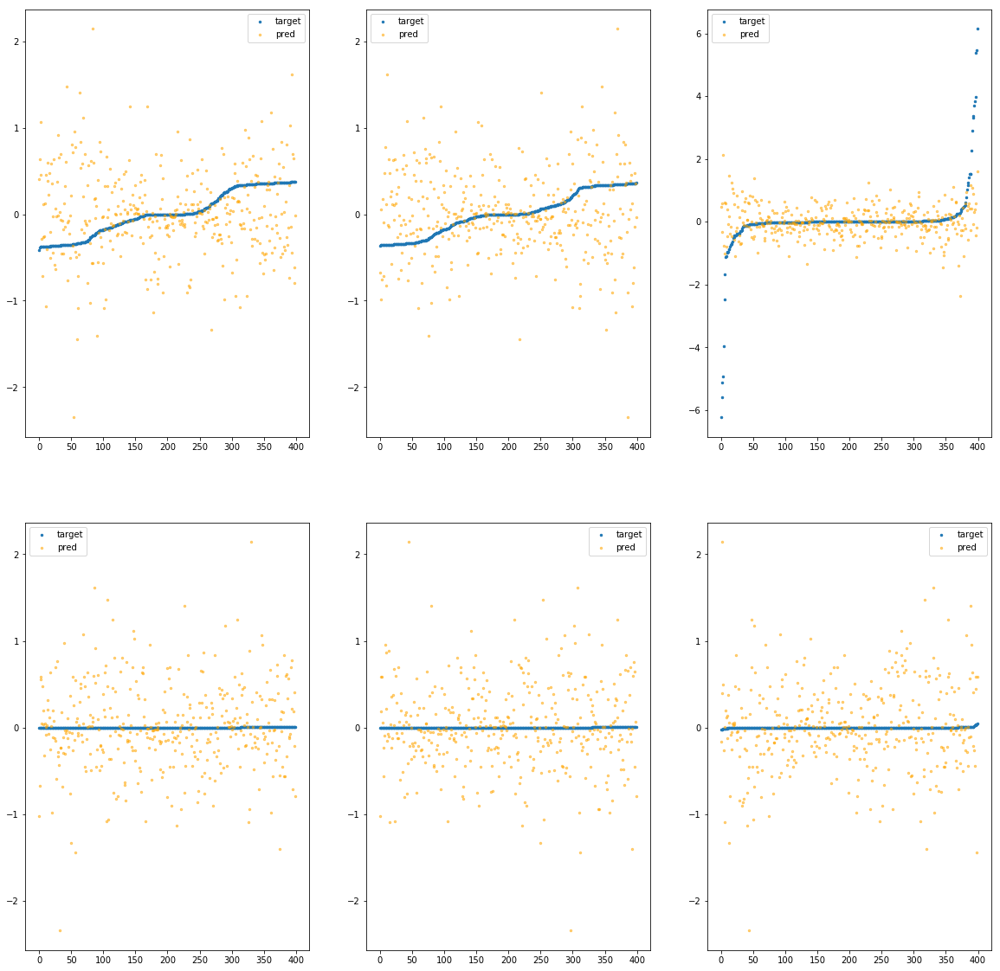

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20e20>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.97e+00	1.97e+00	3.68e-01	3.96e+04	2.55e-01	6.48e-02
y		-3.41e+00	1.98e+00	3.66e-01	1.19e+04	2.42e-01	5.84e-02
z		-1.81e-01	7.50e+00	5.07e-01	5.63e+03	1.03e+00	1.07e+00
phi		-1.05e+05	1.73e+00	3.19e-01	1.54e+07	1.96e-01	3.82e-02
theta		-1.54e+05	1.73e+00	3.19e-01	6.23e+06	1.96e-01	3.82e-02
psi		-7.98e+03	1.73e+00	3.19e-01	8.25e+06	1.96e-01	3.84e-02


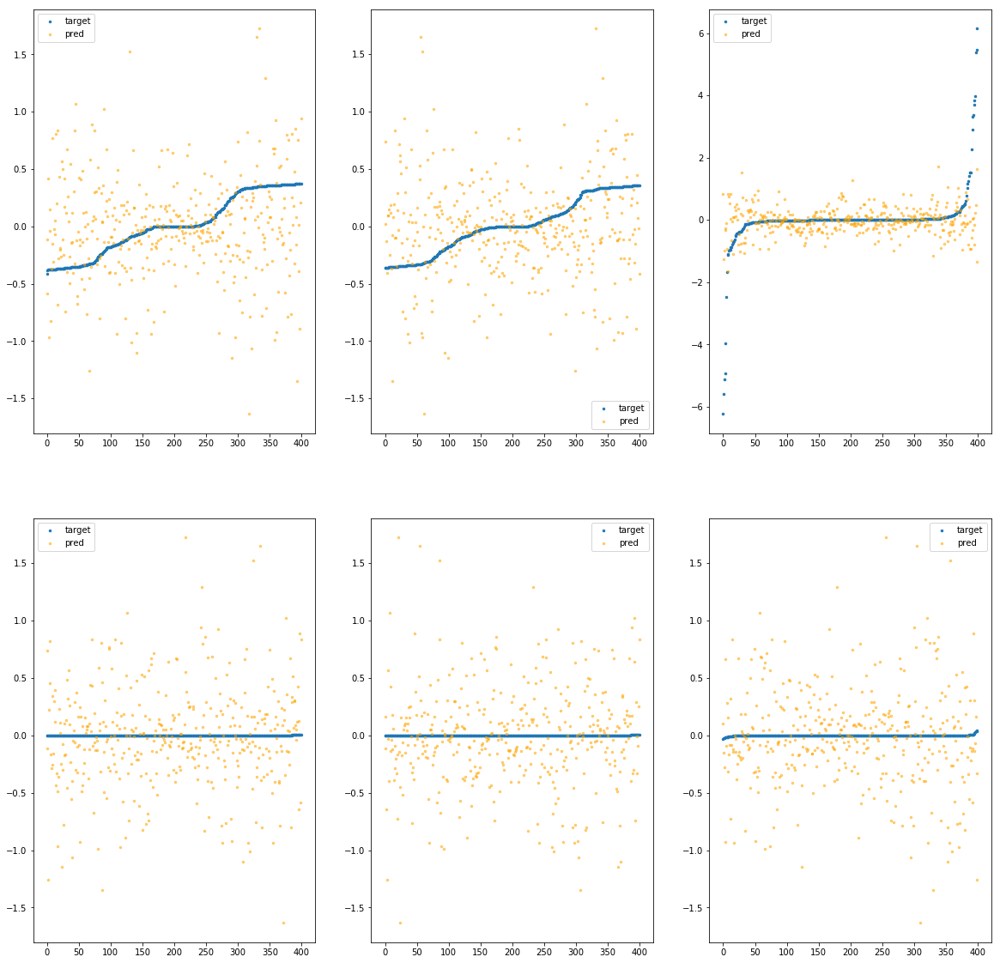

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20e80>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.74e+00	2.79e+00	3.93e-01	3.27e+04	3.04e-01	9.22e-02
y		-4.37e+00	2.44e+00	3.85e-01	8.37e+03	2.95e-01	8.68e-02
z		-1.40e-02	5.97e+00	4.72e-01	3.78e+03	8.87e-01	7.87e-01
phi		-1.27e+05	2.37e+00	3.35e-01	1.43e+07	2.37e-01	5.61e-02
theta		-1.86e+05	2.38e+00	3.35e-01	3.57e+06	2.37e-01	5.61e-02
psi		-9.68e+03	2.37e+00	3.35e-01	9.07e+06	2.37e-01	5.64e-02


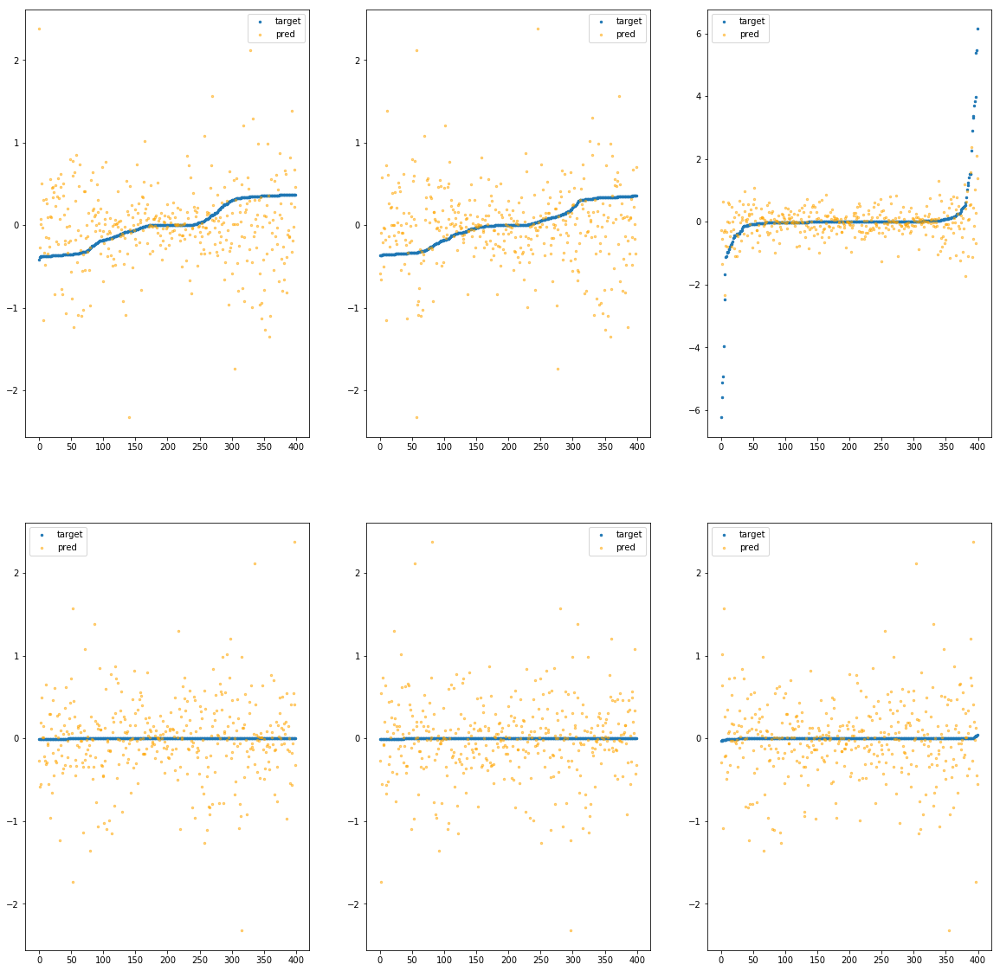

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20ee0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.12e+00	1.76e+00	3.36e-01	3.23e+04	2.00e-01	3.99e-02
y		-2.55e+00	1.70e+00	3.14e-01	5.13e+03	1.95e-01	3.79e-02
z		-2.58e-01	6.93e+00	4.72e-01	4.43e+03	1.10e+00	1.21e+00
phi		-7.77e+04	1.98e+00	2.71e-01	1.40e+07	1.45e-01	2.09e-02
theta		-1.14e+05	1.98e+00	2.71e-01	3.67e+06	1.44e-01	2.09e-02
psi		-5.90e+03	1.98e+00	2.71e-01	7.99e+06	1.45e-01	2.10e-02


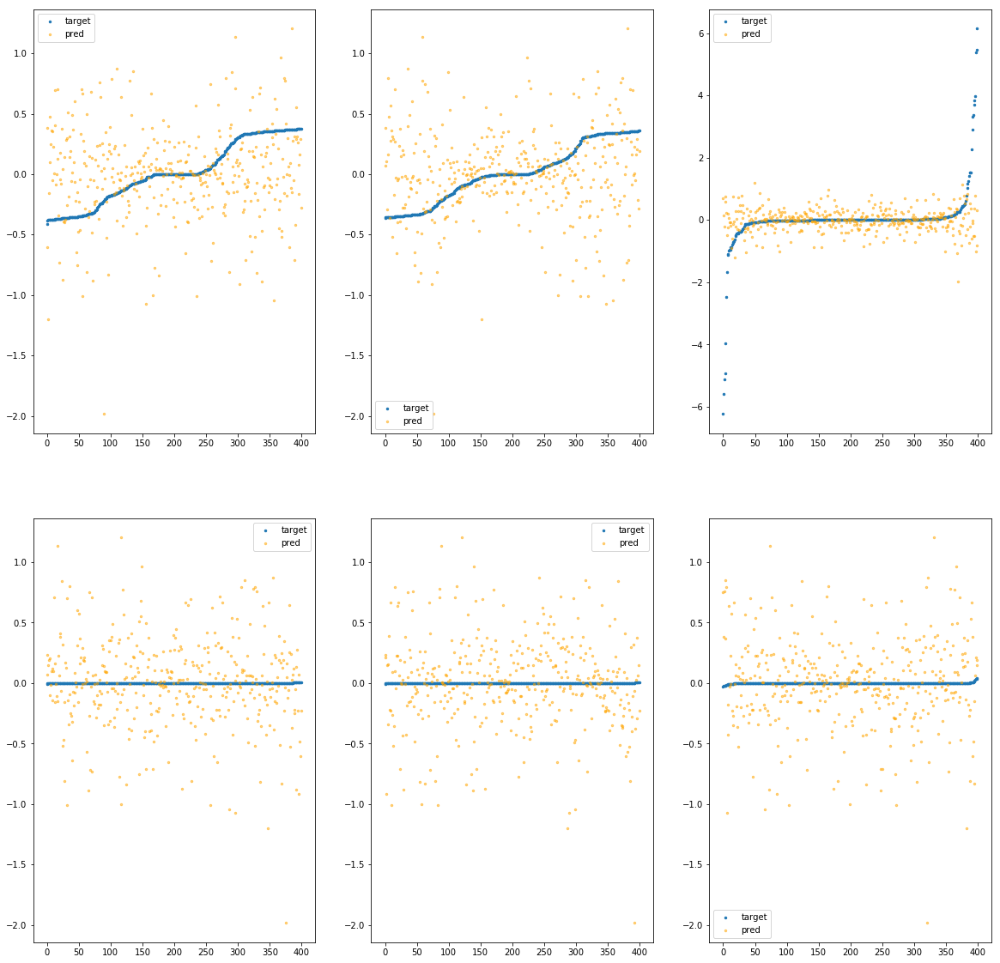

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20f40>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.95e+00	1.65e+00	3.74e-01	3.38e+04	2.53e-01	6.41e-02
y		-3.46e+00	1.61e+00	3.72e-01	7.02e+03	2.44e-01	5.97e-02
z		-2.75e-01	6.33e+00	5.21e-01	3.63e+03	1.12e+00	1.24e+00
phi		-1.10e+05	1.65e+00	3.28e-01	1.22e+07	2.05e-01	4.21e-02
theta		-1.62e+05	1.65e+00	3.28e-01	7.51e+06	2.05e-01	4.21e-02
psi		-8.35e+03	1.65e+00	3.28e-01	6.44e+06	2.05e-01	4.19e-02


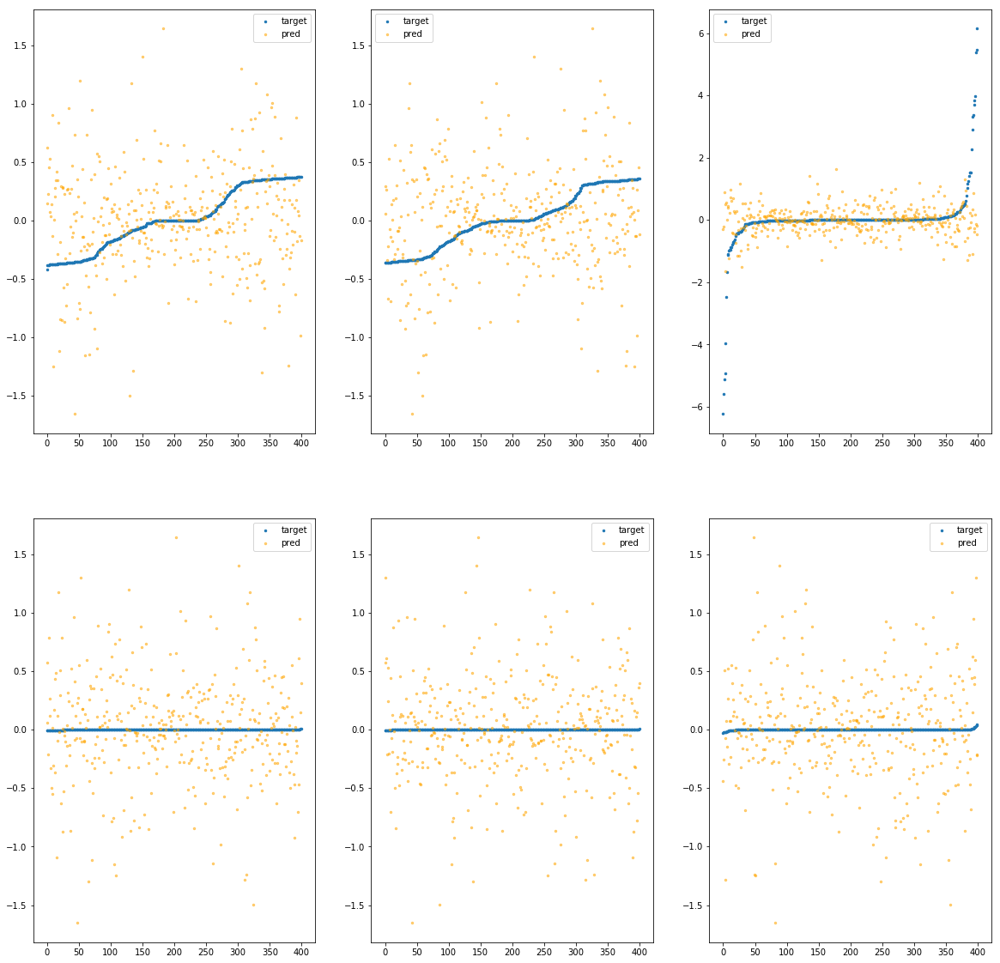

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fb253f20fa0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.63e+00	1.84e+00	3.58e-01	4.38e+04	2.33e-01	5.42e-02
y		-2.90e+00	1.83e+00	3.46e-01	9.64e+03	2.14e-01	4.57e-02
z		-2.32e-01	6.72e+00	5.07e-01	3.33e+03	1.08e+00	1.16e+00
phi		-8.87e+04	1.60e+00	3.03e-01	1.68e+07	1.65e-01	2.73e-02
theta		-1.30e+05	1.60e+00	3.03e-01	7.76e+06	1.65e-01	2.73e-02
psi		-6.71e+03	1.60e+00	3.02e-01	3.72e+06	1.65e-01	2.71e-02


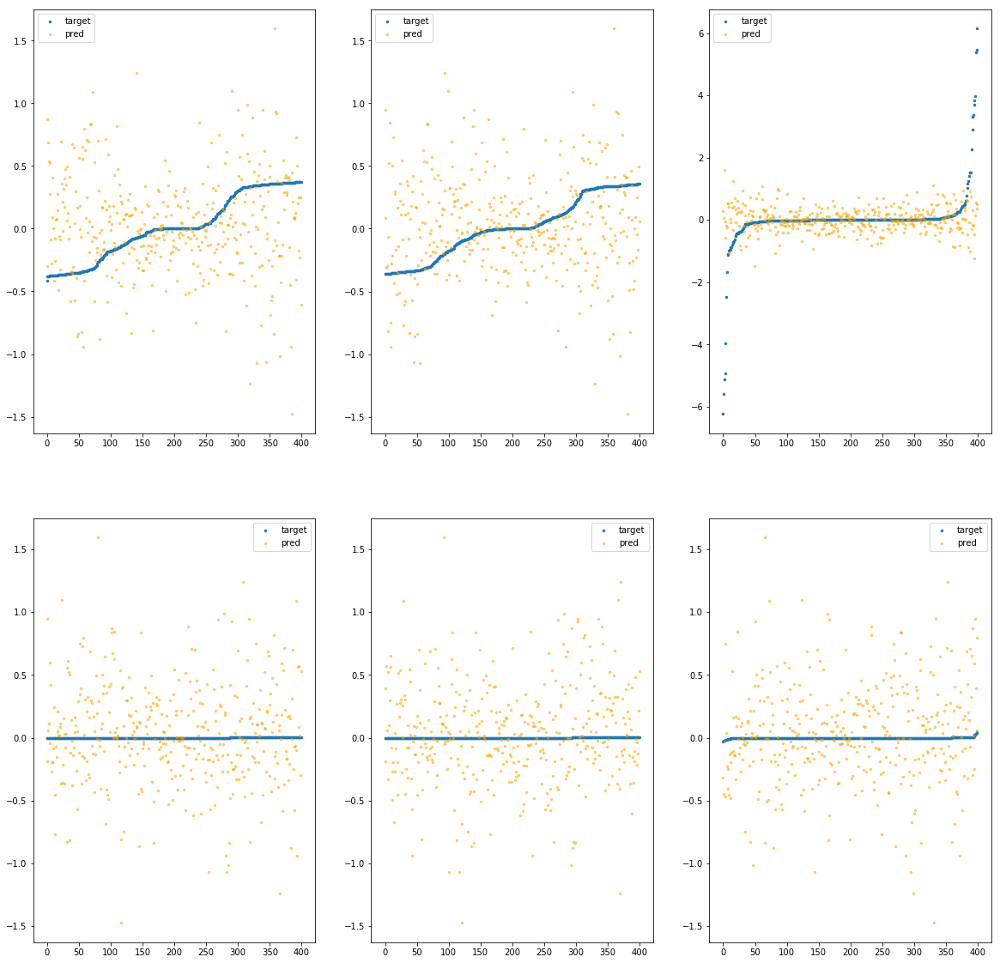

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b040>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.02e-01	8.83e-01	2.23e-01	9.55e+03	8.35e-02	6.97e-03
y		-5.15e-01	9.20e-01	2.21e-01	2.36e+03	8.31e-02	6.90e-03
z		3.49e-02	6.34e+00	3.22e-01	1.06e+03	8.44e-01	7.13e-01
phi		-1.31e+04	8.57e-01	1.03e-01	4.54e+06	2.45e-02	5.99e-04
theta		-1.93e+04	8.57e-01	1.03e-01	2.00e+06	2.45e-02	5.99e-04
psi		-9.93e+02	8.57e-01	1.03e-01	1.64e+06	2.44e-02	5.95e-04


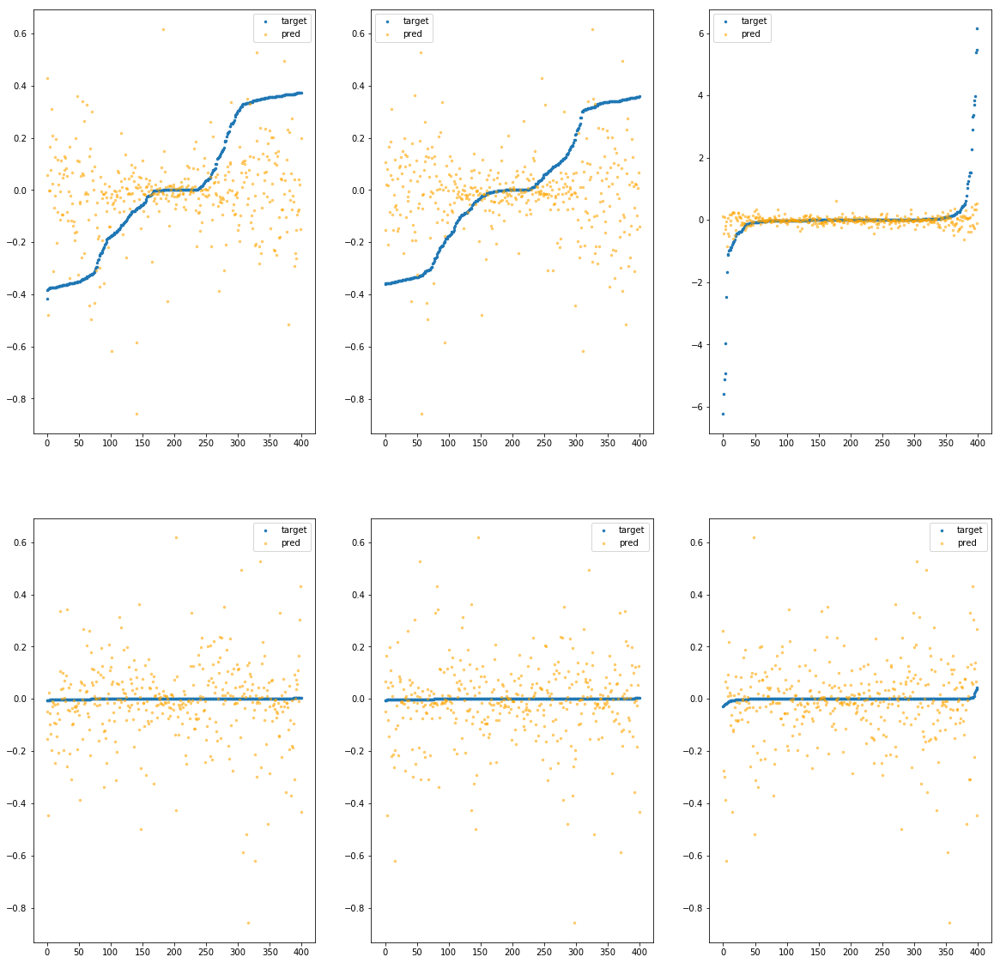

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b0a0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.32e-01	1.33e+00	2.54e-01	1.21e+04	1.11e-01	1.23e-02
y		-6.03e-01	1.31e+00	2.14e-01	1.52e+03	8.79e-02	7.73e-03
z		-1.34e-01	6.51e+00	3.48e-01	1.32e+03	9.92e-01	9.85e-01
phi		-1.84e+04	1.06e+00	1.19e-01	4.43e+06	3.42e-02	1.17e-03
theta		-2.69e+04	1.06e+00	1.19e-01	1.64e+06	3.42e-02	1.17e-03
psi		-1.39e+03	1.05e+00	1.19e-01	2.43e+06	3.40e-02	1.16e-03


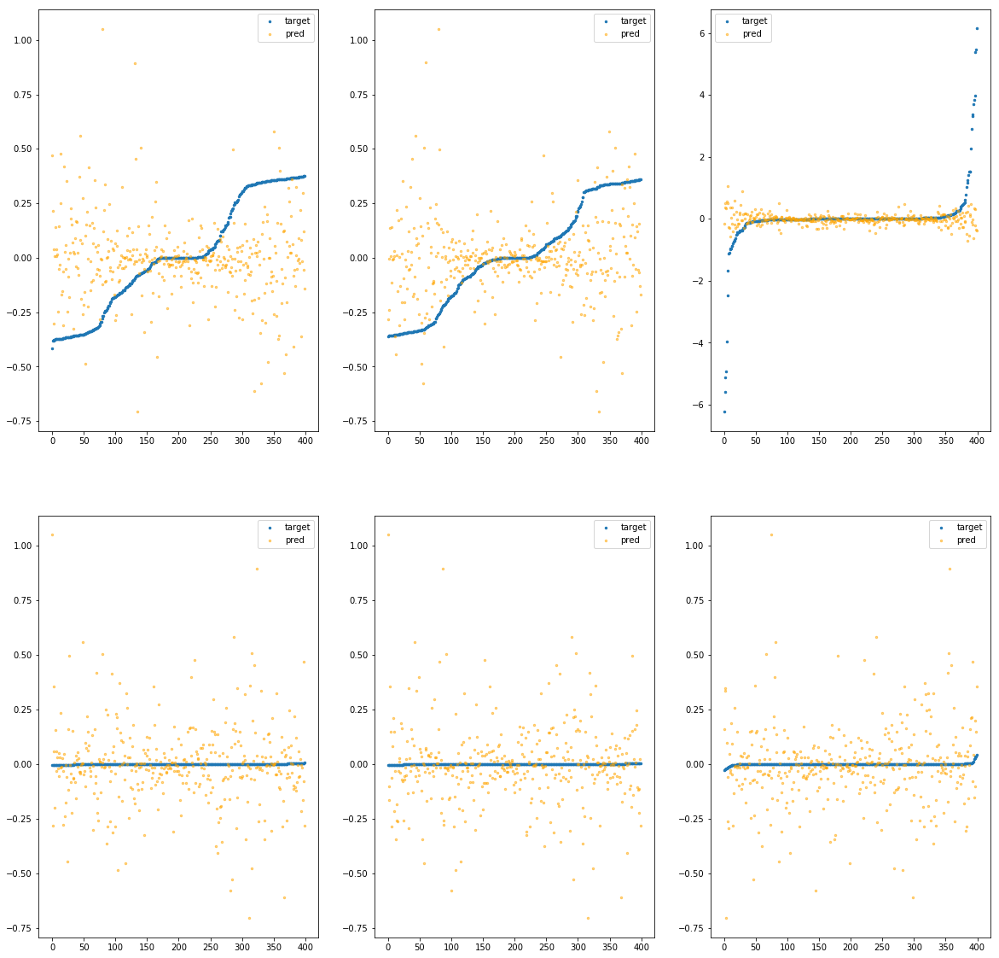

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b100>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.84e-01	1.69e+00	2.57e-01	1.08e+04	1.21e-01	1.46e-02
y		-1.11e+00	1.75e+00	2.36e-01	1.09e+03	1.16e-01	1.34e-02
z		-4.48e-02	6.57e+00	3.43e-01	1.67e+03	9.14e-01	8.36e-01
phi		-2.88e+04	1.47e+00	1.39e-01	5.65e+06	5.37e-02	2.88e-03
theta		-4.22e+04	1.47e+00	1.38e-01	1.28e+06	5.36e-02	2.88e-03
psi		-2.18e+03	1.47e+00	1.38e-01	2.79e+06	5.35e-02	2.86e-03


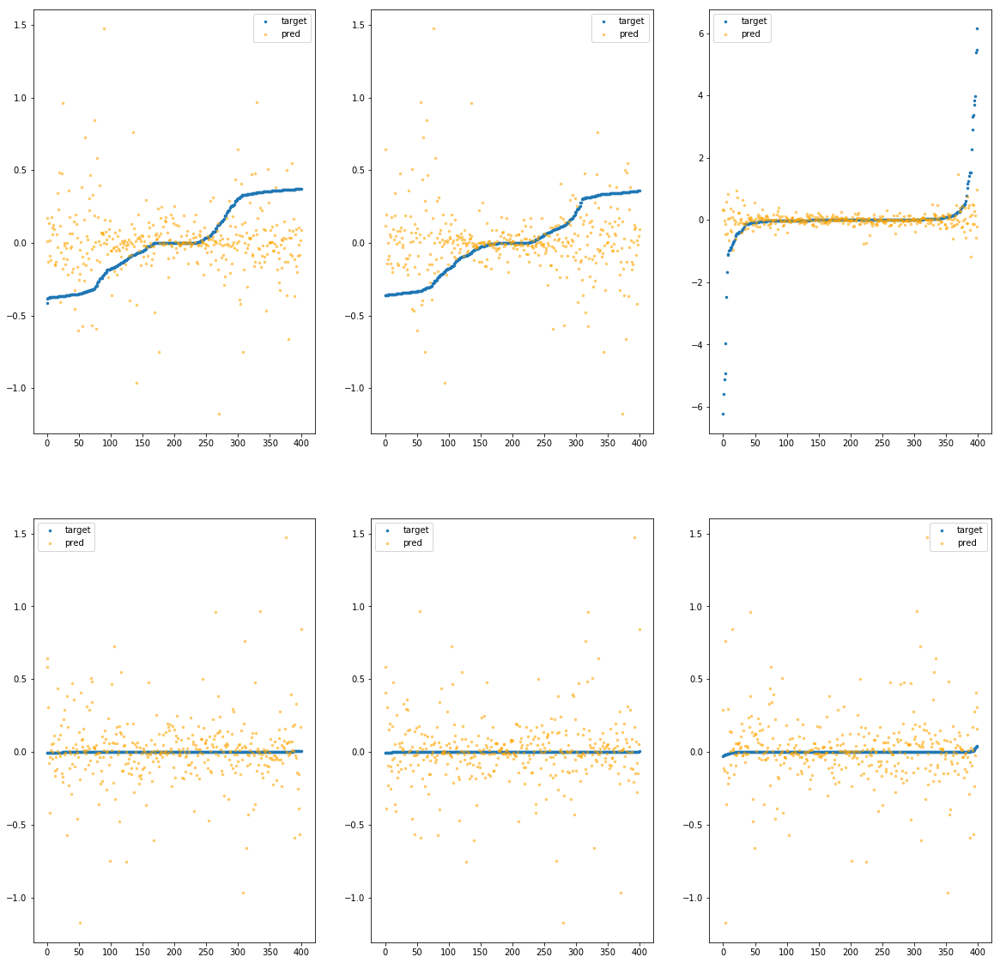

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b160>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.13e-01	1.39e+00	2.48e-01	1.05e+04	1.10e-01	1.21e-02
y		-9.57e-01	1.35e+00	2.34e-01	3.19e+03	1.07e-01	1.15e-02
z		-1.18e-02	6.15e+00	3.47e-01	2.11e+03	8.85e-01	7.83e-01
phi		-2.47e+04	1.01e+00	1.39e-01	3.58e+06	4.60e-02	2.12e-03
theta		-3.62e+04	1.01e+00	1.39e-01	3.30e+06	4.60e-02	2.12e-03
psi		-1.88e+03	9.88e-01	1.39e-01	2.16e+06	4.61e-02	2.13e-03


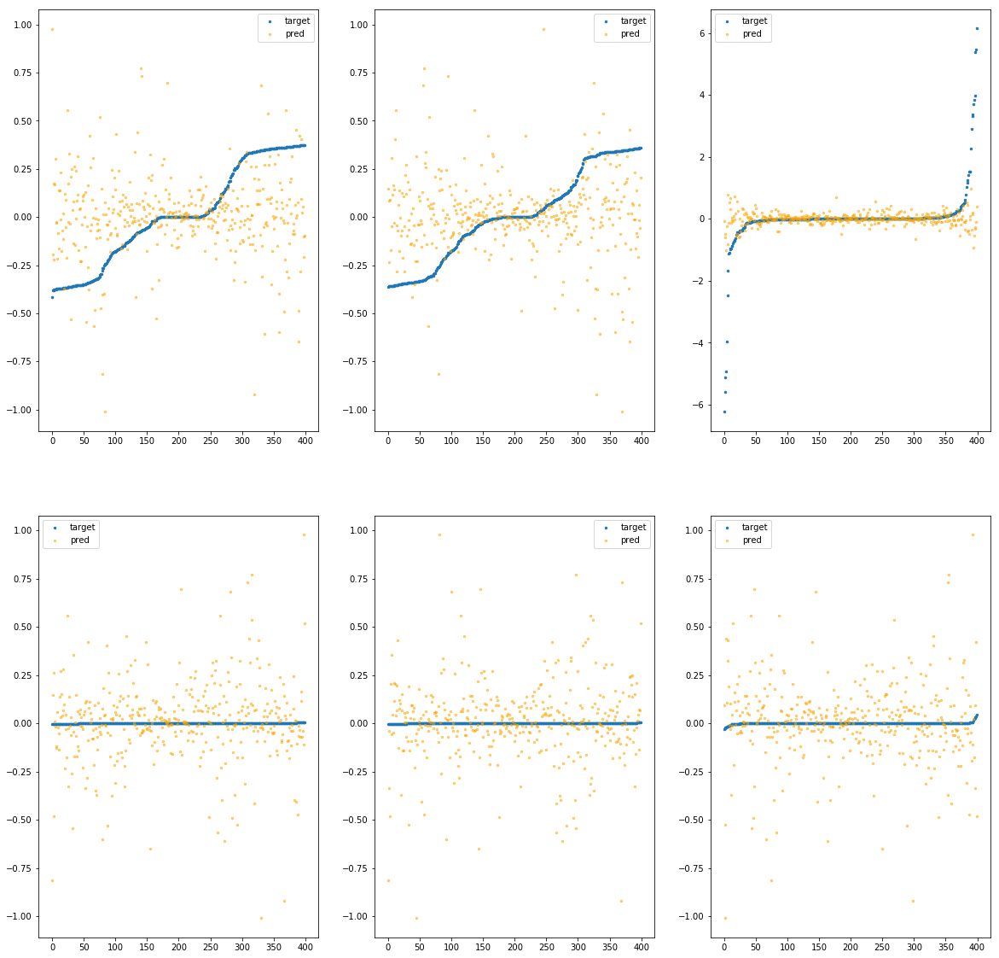

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b1c0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.77e-01	1.40e+00	2.62e-01	1.71e+04	1.20e-01	1.45e-02
y		-7.98e-01	1.23e+00	2.27e-01	9.87e+02	9.86e-02	9.71e-03
z		-4.35e-02	6.77e+00	3.57e-01	1.72e+03	9.13e-01	8.33e-01
phi		-2.46e+04	1.06e+00	1.44e-01	7.50e+06	4.58e-02	2.10e-03
theta		-3.61e+04	1.06e+00	1.44e-01	1.25e+06	4.58e-02	2.10e-03
psi		-1.86e+03	1.06e+00	1.43e-01	4.90e+06	4.57e-02	2.09e-03


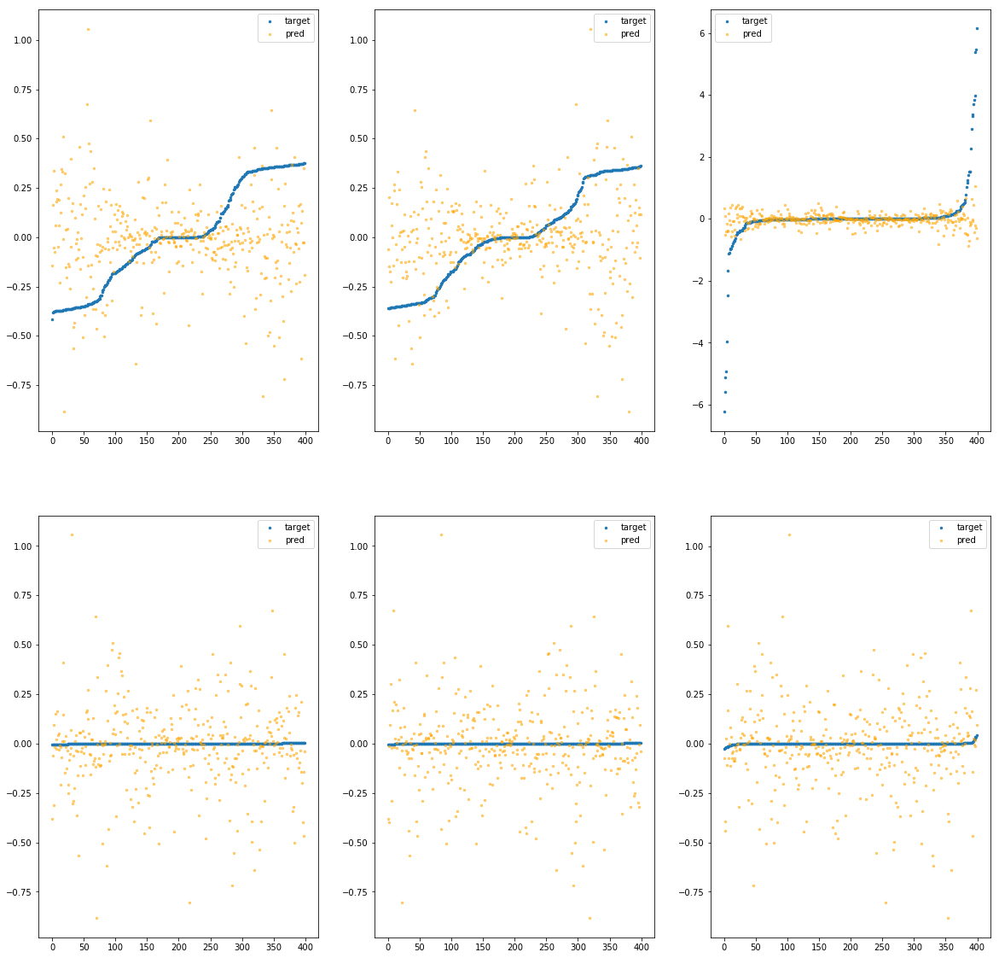

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b220>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.83e-01	1.26e+00	2.35e-01	1.01e+04	9.51e-02	9.04e-03
y		-4.63e-01	1.24e+00	2.10e-01	1.34e+03	8.02e-02	6.43e-03
z		-5.56e-02	6.23e+00	3.36e-01	1.13e+03	9.23e-01	8.53e-01
phi		-1.89e+04	1.11e+00	1.20e-01	4.84e+06	3.51e-02	1.23e-03
theta		-2.76e+04	1.11e+00	1.20e-01	1.05e+06	3.51e-02	1.23e-03
psi		-1.45e+03	1.11e+00	1.20e-01	2.21e+06	3.55e-02	1.26e-03


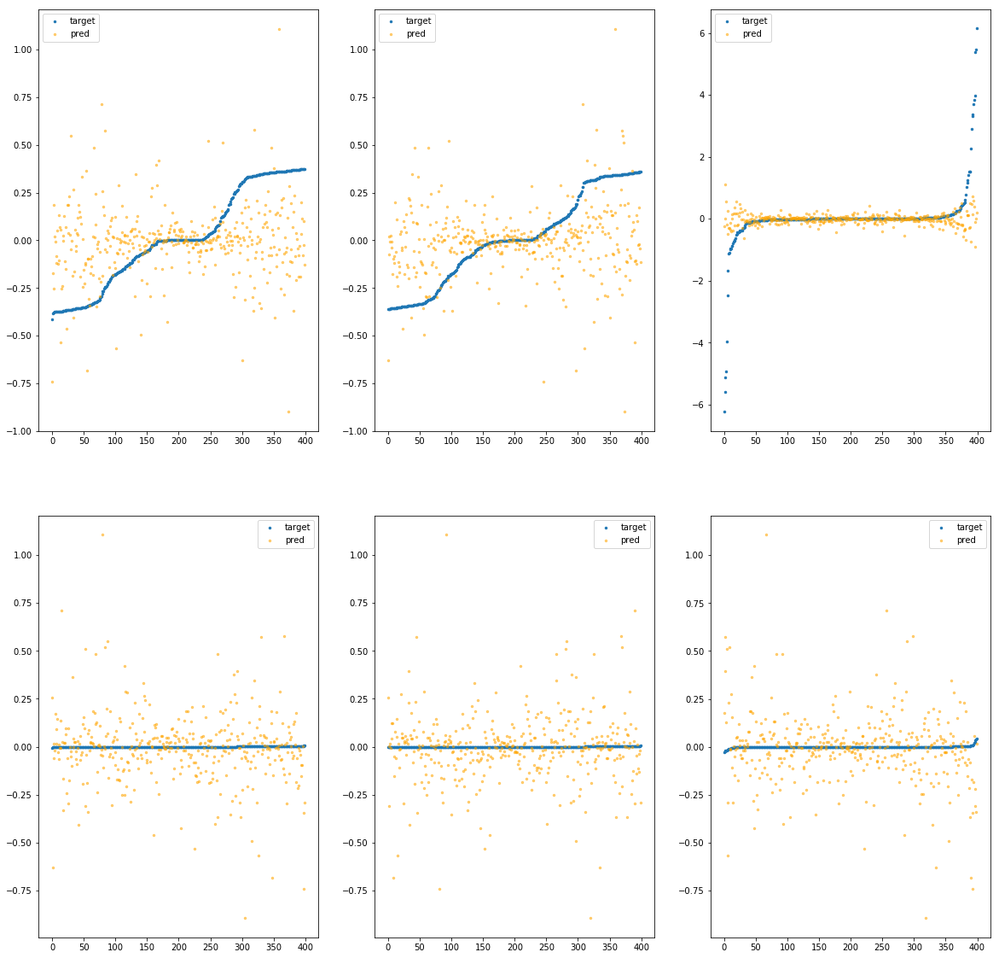

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b280>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.83e-01	1.19e+00	2.39e-01	6.96e+03	1.02e-01	1.03e-02
y		-7.99e-01	1.25e+00	2.30e-01	1.09e+03	9.86e-02	9.73e-03
z		-4.65e-02	6.61e+00	3.33e-01	1.02e+03	9.15e-01	8.38e-01
phi		-2.07e+04	9.71e-01	1.23e-01	2.59e+06	3.86e-02	1.49e-03
theta		-3.04e+04	9.70e-01	1.23e-01	6.91e+05	3.86e-02	1.49e-03
psi		-1.57e+03	9.73e-01	1.23e-01	1.40e+06	3.85e-02	1.48e-03


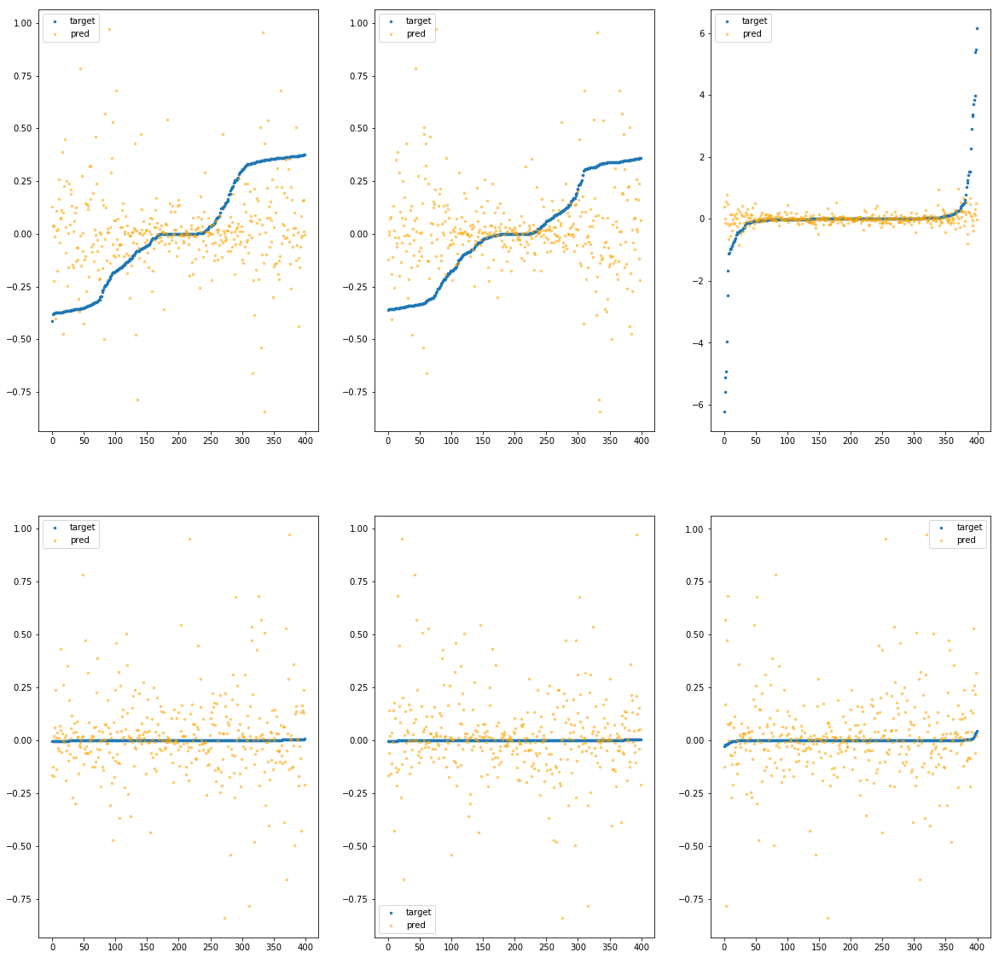

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b2e0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.76e-01	1.08e+00	2.24e-01	1.21e+04	8.82e-02	7.78e-03
y		-6.02e-01	1.17e+00	2.22e-01	2.72e+03	8.78e-02	7.71e-03
z		-4.22e-02	6.65e+00	3.37e-01	1.60e+03	9.12e-01	8.31e-01
phi		-1.71e+04	8.59e-01	1.15e-01	4.87e+06	3.18e-02	1.01e-03
theta		-2.51e+04	8.59e-01	1.15e-01	1.22e+06	3.18e-02	1.01e-03
psi		-1.30e+03	8.59e-01	1.15e-01	3.05e+06	3.19e-02	1.02e-03


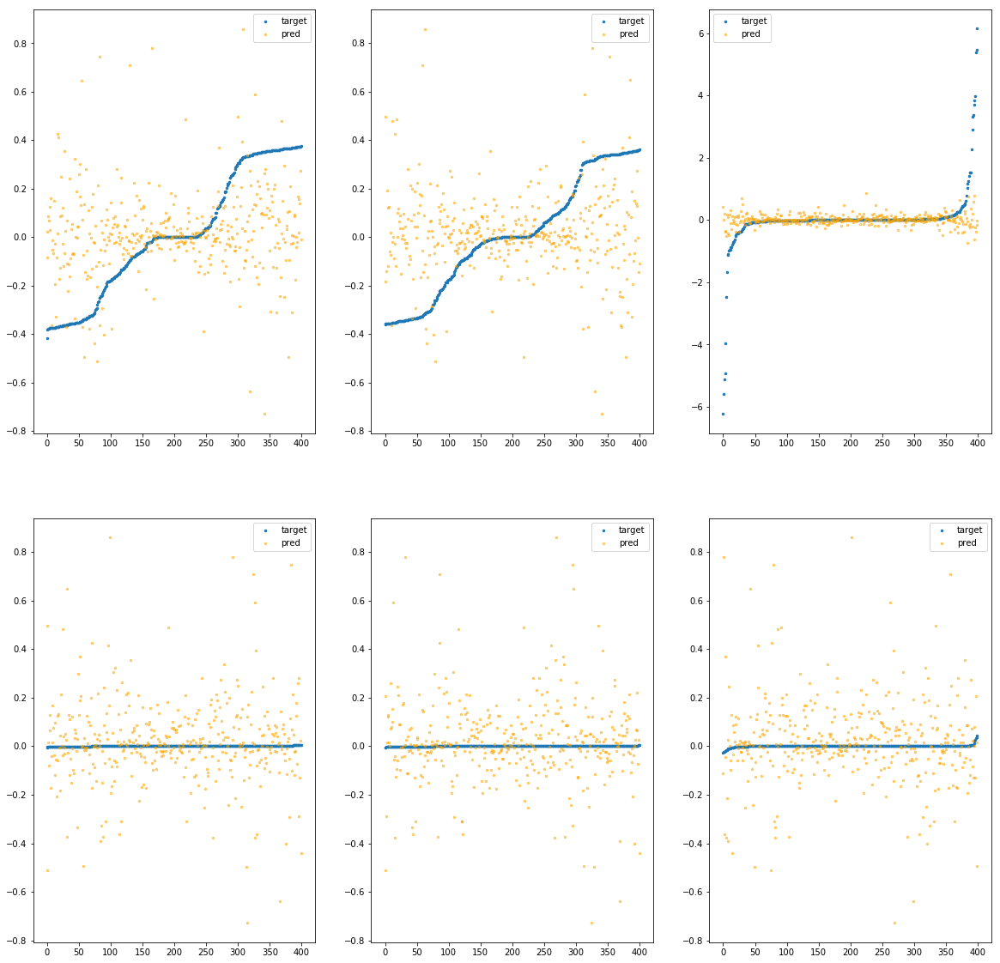

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b340>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.57e-01	1.30e+00	2.28e-01	8.31e+03	8.70e-02	7.57e-03
y		-4.83e-01	1.03e+00	2.16e-01	1.52e+03	8.13e-02	6.61e-03
z		-4.92e-02	6.41e+00	3.29e-01	9.58e+02	9.18e-01	8.43e-01
phi		-1.56e+04	9.53e-01	1.06e-01	3.08e+06	2.90e-02	8.42e-04
theta		-2.29e+04	9.51e-01	1.06e-01	1.47e+06	2.90e-02	8.42e-04
psi		-1.19e+03	9.52e-01	1.07e-01	2.47e+06	2.93e-02	8.58e-04


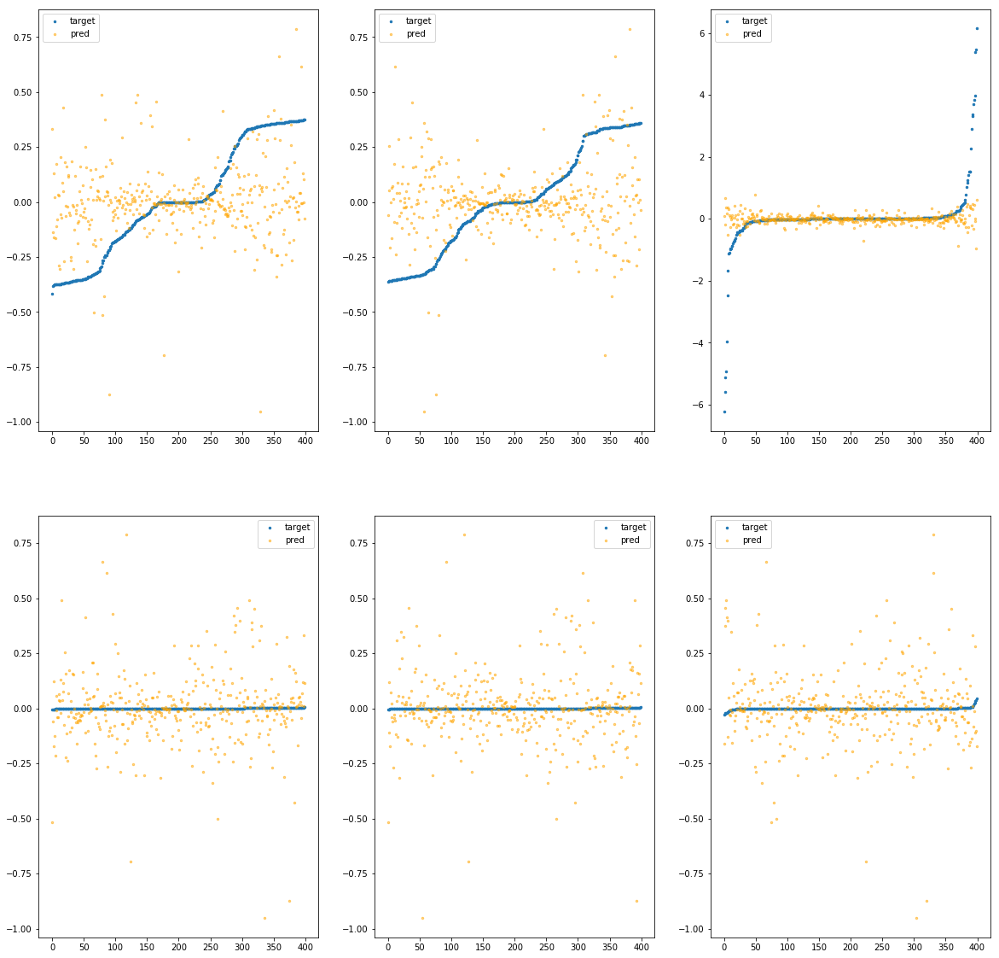

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b3a0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.69e-01	1.17e+00	2.68e-01	1.01e+04	1.26e-01	1.59e-02
y		-1.03e+00	1.34e+00	2.38e-01	3.02e+03	1.11e-01	1.24e-02
z		-7.49e-02	6.16e+00	3.55e-01	1.20e+03	9.40e-01	8.84e-01
phi		-2.88e+04	1.06e+00	1.45e-01	4.12e+06	5.37e-02	2.88e-03
theta		-4.22e+04	1.06e+00	1.45e-01	1.85e+06	5.36e-02	2.88e-03
psi		-2.18e+03	1.06e+00	1.45e-01	2.70e+06	5.36e-02	2.87e-03


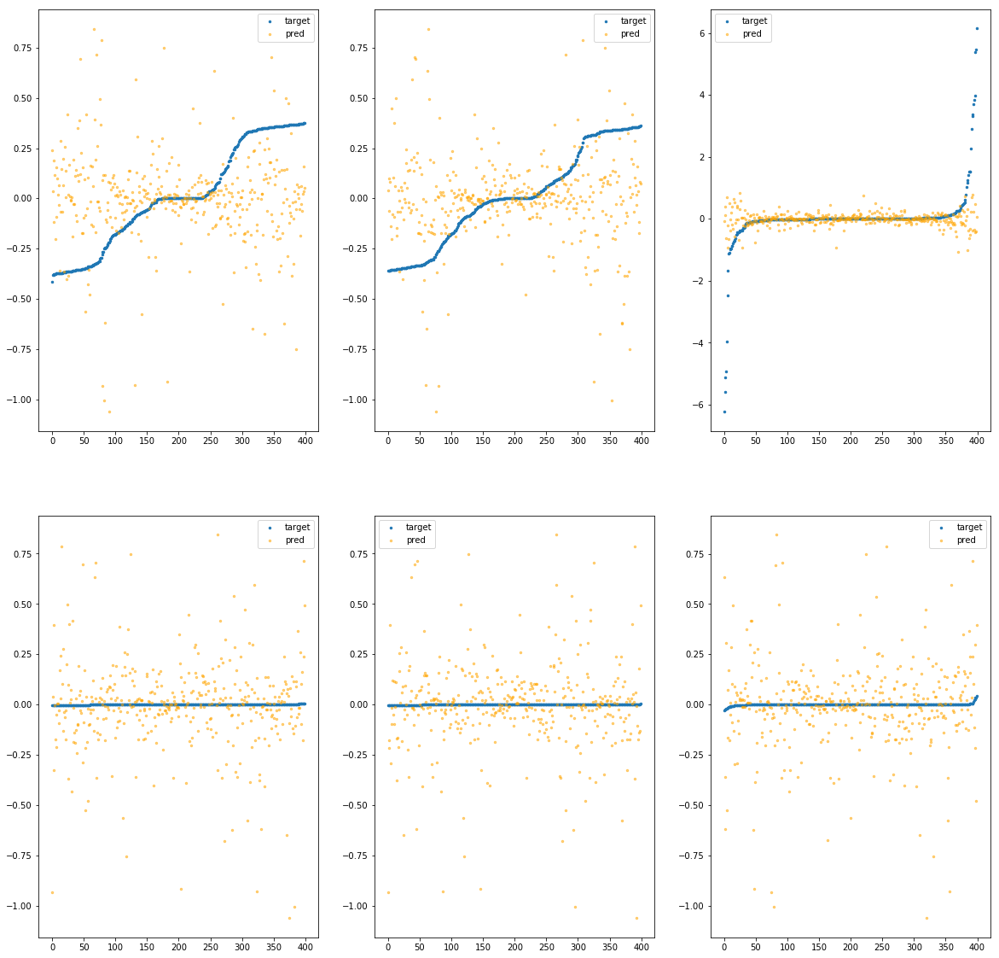

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b400>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.27e-01	1.33e+00	2.39e-01	7.11e+03	1.04e-01	1.09e-02
y		-8.83e-01	1.40e+00	2.35e-01	9.76e+02	1.03e-01	1.07e-02
z		2.15e-02	6.78e+00	3.24e-01	1.08e+03	8.56e-01	7.33e-01
phi		-2.17e+04	1.08e+00	1.21e-01	2.61e+06	4.04e-02	1.63e-03
theta		-3.18e+04	1.07e+00	1.21e-01	1.19e+06	4.04e-02	1.63e-03
psi		-1.65e+03	1.07e+00	1.21e-01	2.48e+06	4.06e-02	1.65e-03


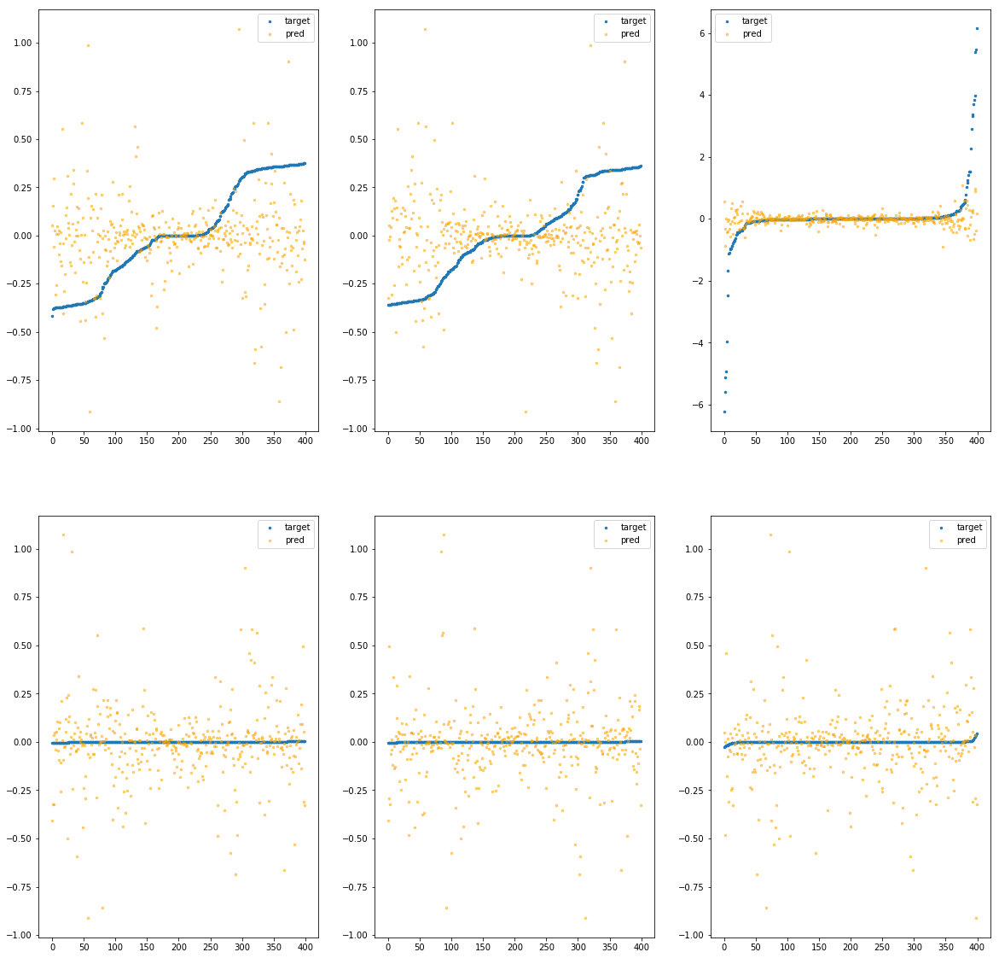

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b460>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.69e-01	1.02e+00	2.48e-01	1.26e+04	1.07e-01	1.14e-02
y		-8.52e-01	1.36e+00	2.37e-01	1.81e+03	1.02e-01	1.03e-02
z		-5.55e-02	6.11e+00	3.46e-01	1.21e+03	9.23e-01	8.53e-01
phi		-2.26e+04	1.03e+00	1.30e-01	4.61e+06	4.20e-02	1.76e-03
theta		-3.31e+04	1.03e+00	1.30e-01	2.02e+06	4.20e-02	1.76e-03
psi		-1.70e+03	1.03e+00	1.30e-01	1.81e+06	4.17e-02	1.74e-03


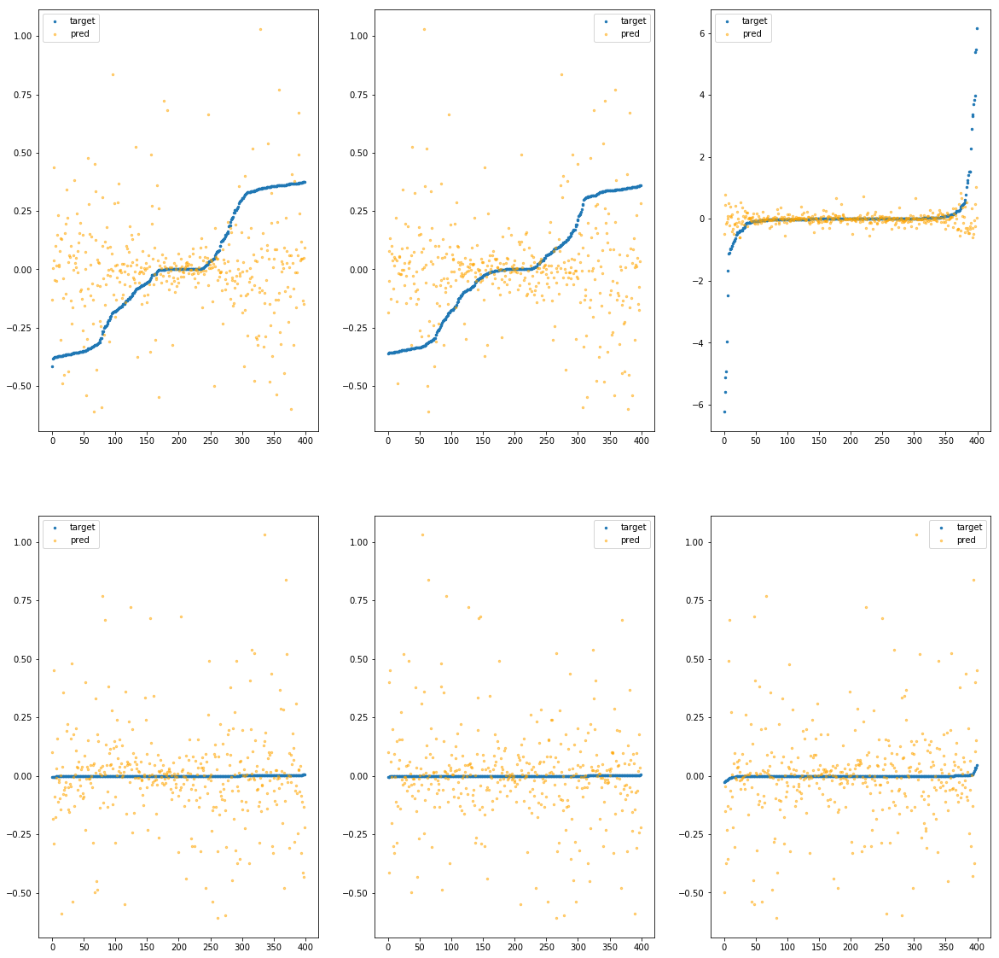

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b4c0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.57e-01	1.15e+00	2.37e-01	1.35e+04	9.34e-02	8.72e-03
y		-6.03e-01	1.14e+00	2.17e-01	1.64e+03	8.79e-02	7.72e-03
z		1.17e-01	6.12e+00	3.11e-01	1.17e+03	7.72e-01	5.96e-01
phi		-1.92e+04	7.95e-01	1.18e-01	4.87e+06	3.58e-02	1.28e-03
theta		-2.82e+04	7.95e-01	1.18e-01	1.17e+06	3.58e-02	1.28e-03
psi		-1.46e+03	7.95e-01	1.18e-01	2.22e+06	3.59e-02	1.29e-03


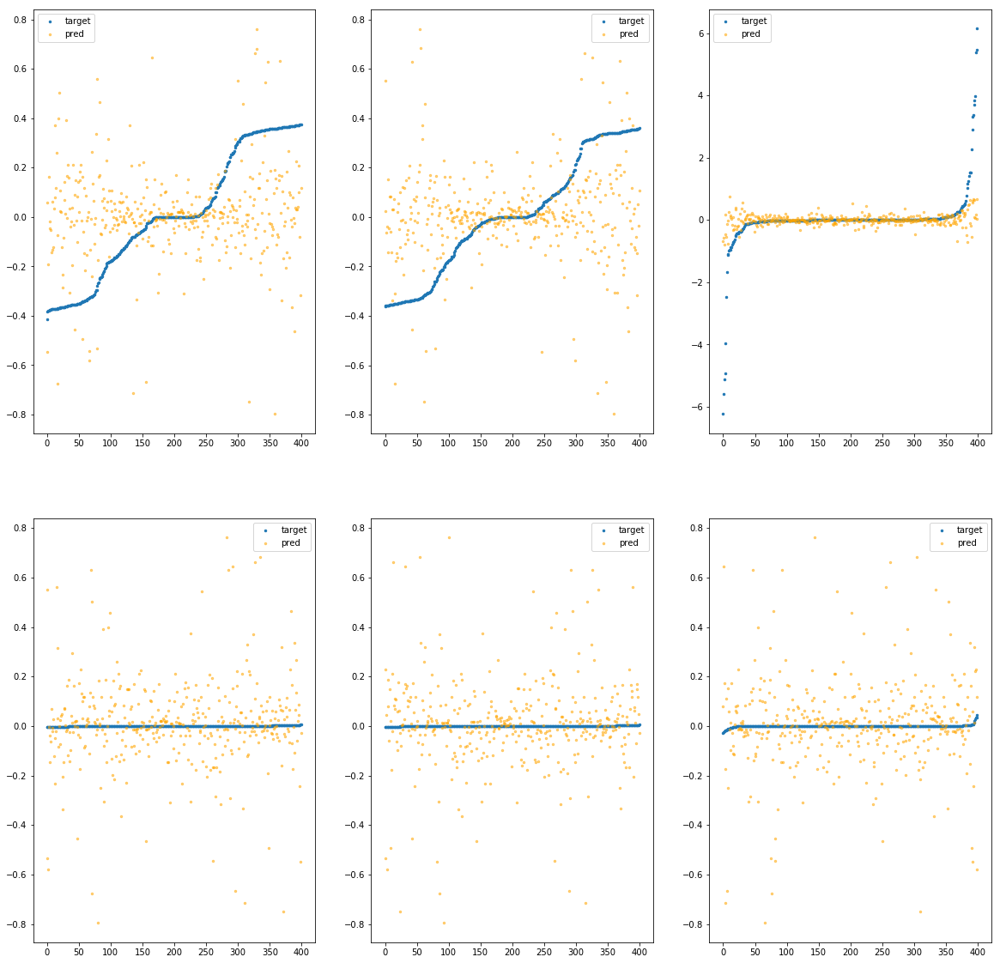

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b520>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.06e-01	1.32e+00	2.37e-01	1.05e+04	9.66e-02	9.33e-03
y		-4.42e-01	1.30e+00	2.10e-01	1.96e+03	7.91e-02	6.25e-03
z		-2.29e-02	6.90e+00	3.23e-01	1.28e+03	8.95e-01	8.01e-01
phi		-1.60e+04	9.90e-01	1.08e-01	3.53e+06	2.98e-02	8.89e-04
theta		-2.35e+04	9.90e-01	1.08e-01	1.76e+06	2.98e-02	8.87e-04
psi		-1.22e+03	9.91e-01	1.08e-01	1.79e+06	3.00e-02	8.98e-04


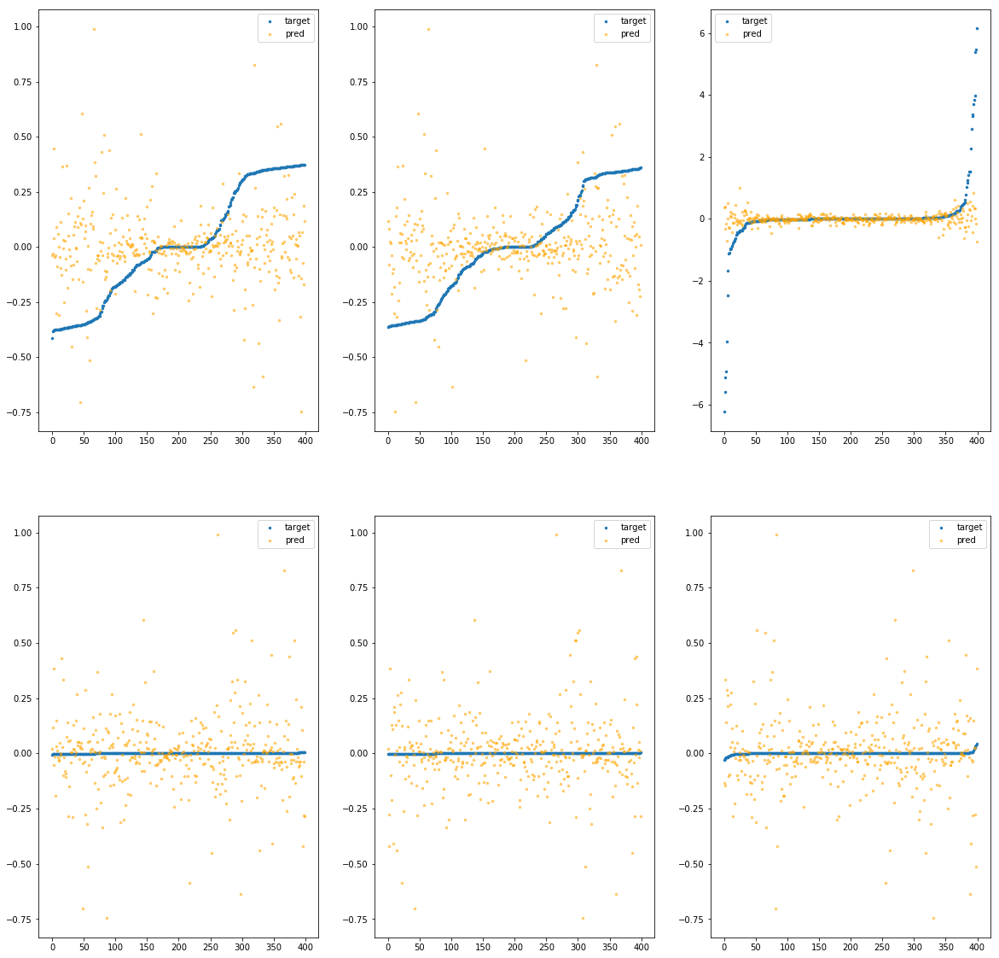

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b580>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.39e-01	1.28e+00	2.48e-01	8.25e+03	1.05e-01	1.10e-02
y		-7.42e-01	1.17e+00	2.25e-01	2.02e+03	9.55e-02	9.12e-03
z		-9.05e-03	6.10e+00	3.39e-01	1.34e+03	8.83e-01	7.79e-01
phi		-2.11e+04	9.29e-01	1.25e-01	3.82e+06	3.92e-02	1.54e-03
theta		-3.09e+04	9.29e-01	1.25e-01	6.99e+05	3.92e-02	1.54e-03
psi		-1.61e+03	9.29e-01	1.25e-01	1.69e+06	3.94e-02	1.55e-03


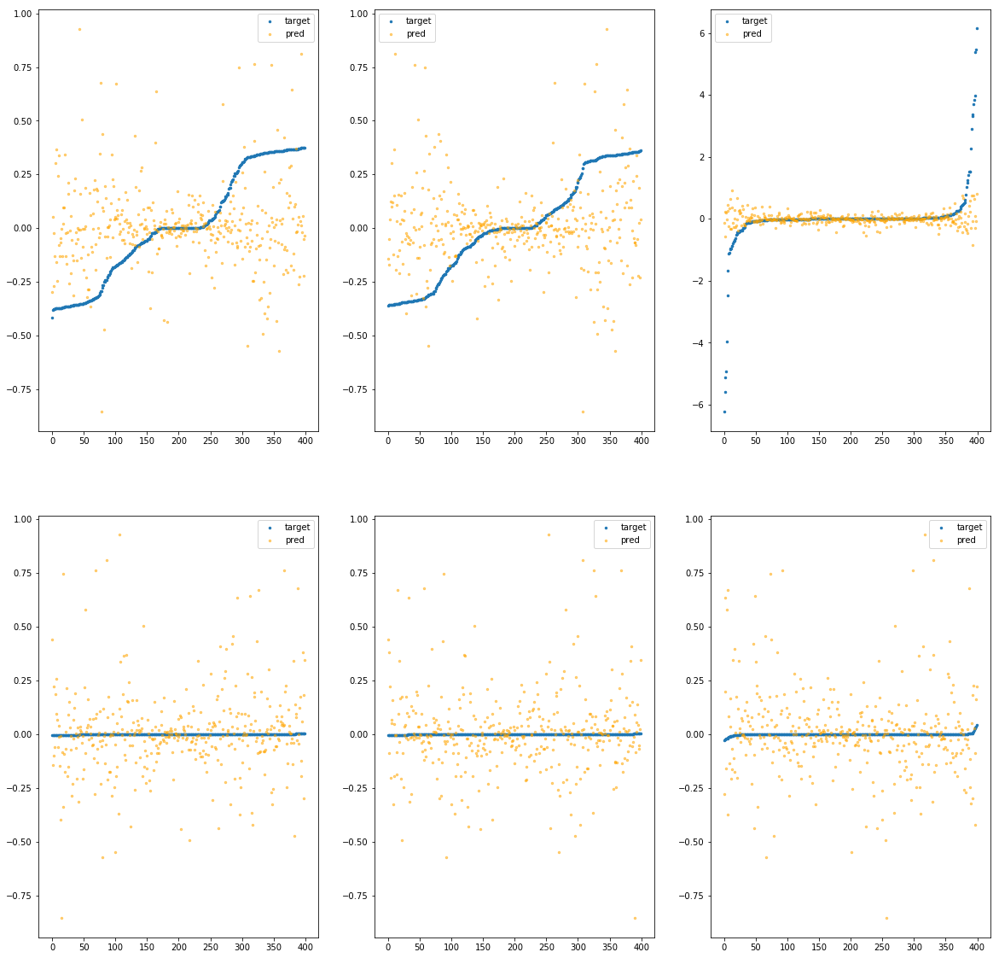

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b5e0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.25e-01	1.45e+00	2.48e-01	7.41e+03	1.11e-01	1.22e-02
y		-6.52e-01	1.43e+00	2.22e-01	1.47e+03	9.06e-02	8.21e-03
z		-5.46e-02	7.30e+00	3.16e-01	7.97e+02	9.23e-01	8.51e-01
phi		-1.72e+04	1.08e+00	1.03e-01	3.52e+06	3.19e-02	1.02e-03
theta		-2.51e+04	1.08e+00	1.02e-01	9.09e+05	3.19e-02	1.02e-03
psi		-1.30e+03	1.07e+00	1.02e-01	1.45e+06	3.20e-02	1.02e-03


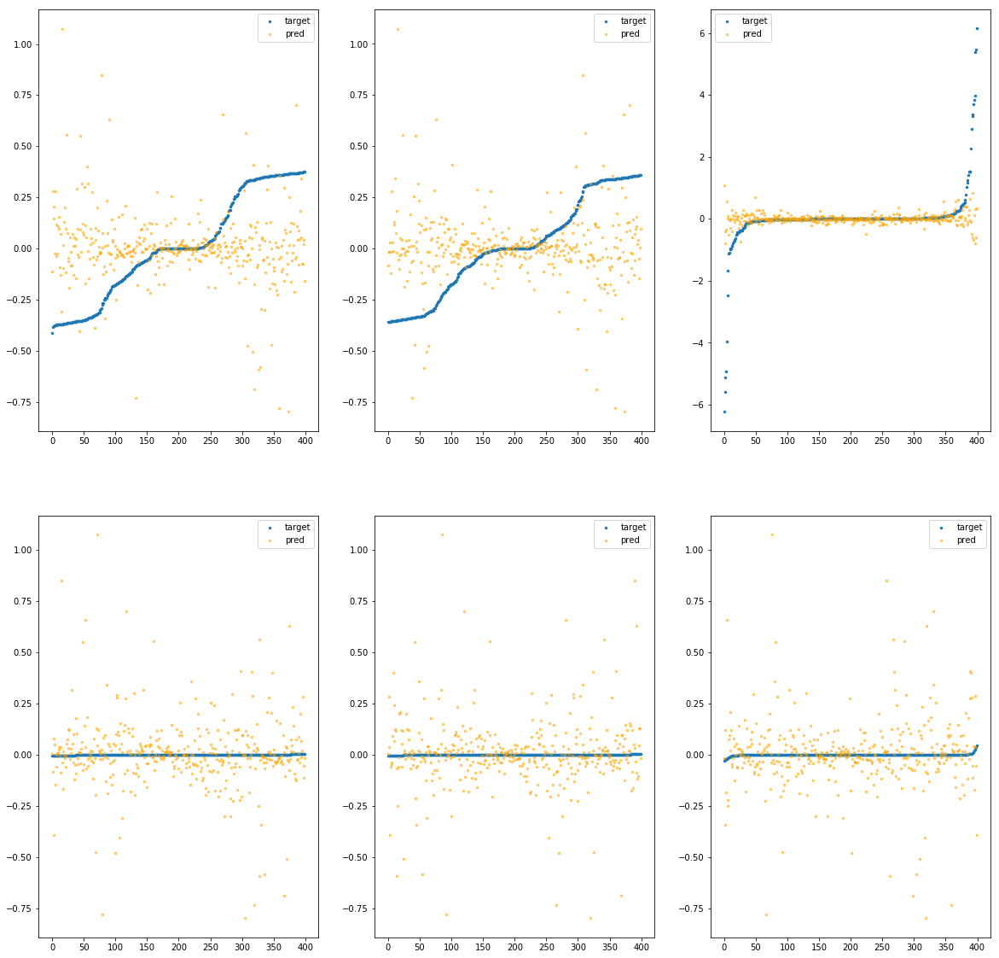

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b640>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.70e-01	1.53e+00	2.38e-01	1.03e+04	1.01e-01	1.01e-02
y		-9.05e-01	1.52e+00	2.34e-01	1.90e+03	1.04e-01	1.09e-02
z		-5.91e-02	6.08e+00	3.41e-01	1.21e+03	9.27e-01	8.59e-01
phi		-2.07e+04	1.26e+00	1.21e-01	4.01e+06	3.85e-02	1.48e-03
theta		-3.03e+04	1.26e+00	1.21e-01	1.52e+06	3.85e-02	1.48e-03
psi		-1.56e+03	1.25e+00	1.21e-01	2.68e+06	3.82e-02	1.46e-03


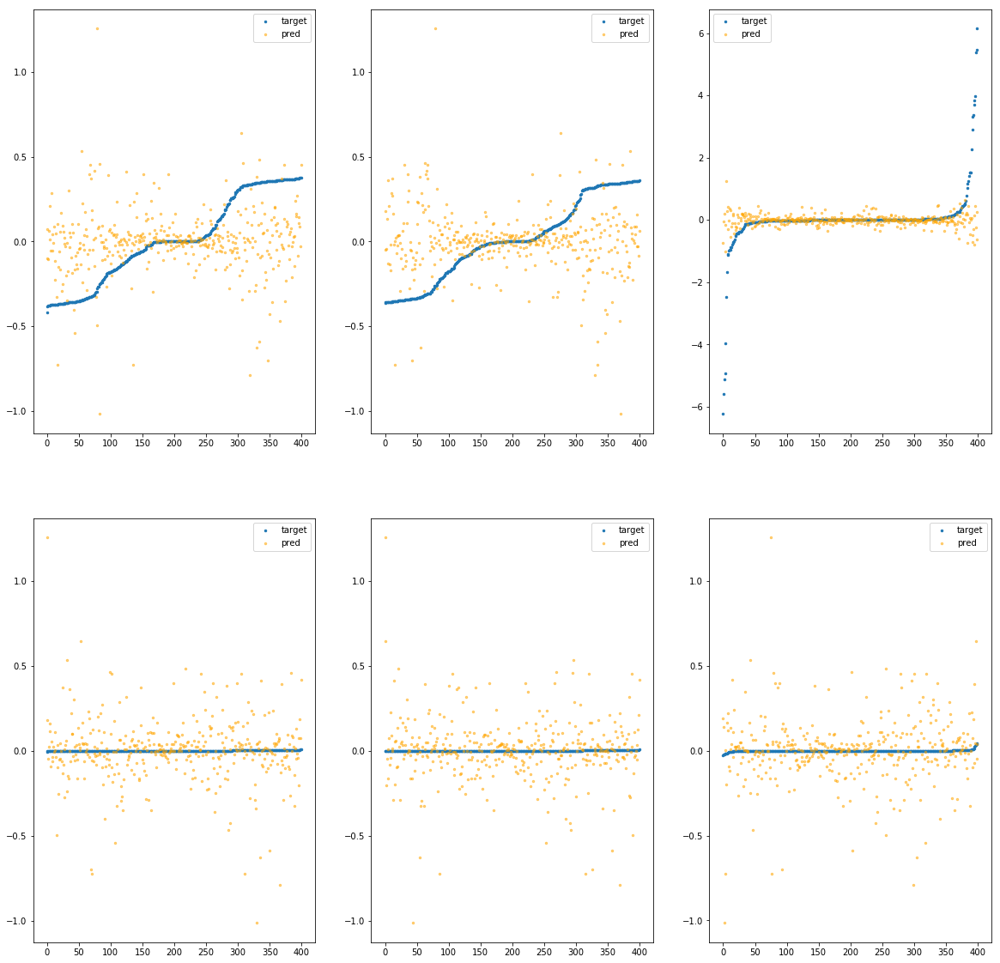

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b6a0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.42e-01	9.96e-01	2.28e-01	8.35e+03	9.24e-02	8.54e-03
y		-6.31e-01	9.69e-01	2.21e-01	1.32e+03	8.94e-02	8.00e-03
z		1.45e-02	5.82e+00	3.28e-01	1.50e+03	8.62e-01	7.43e-01
phi		-1.90e+04	8.89e-01	1.21e-01	3.69e+06	3.54e-02	1.25e-03
theta		-2.79e+04	8.90e-01	1.21e-01	1.07e+06	3.54e-02	1.25e-03
psi		-1.46e+03	9.26e-01	1.21e-01	2.33e+06	3.58e-02	1.28e-03


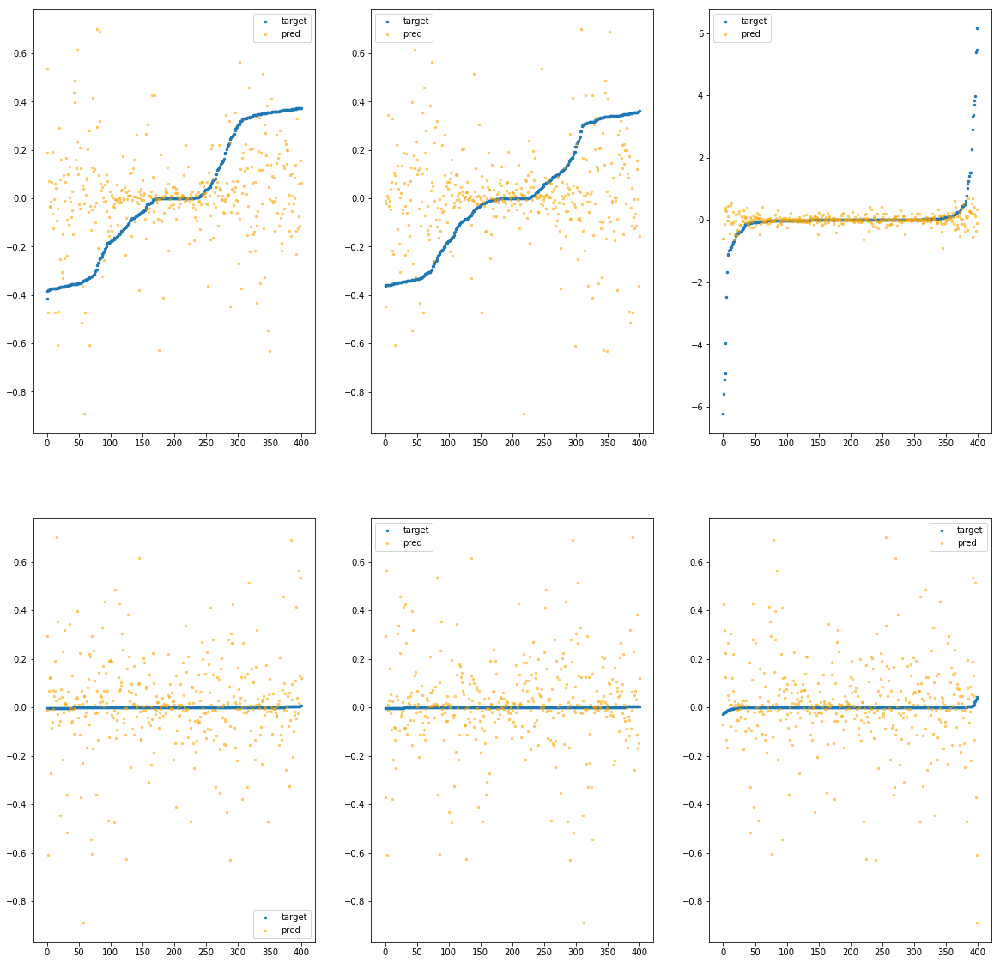

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b700>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.55e-01	1.09e+00	2.45e-01	1.04e+04	9.97e-02	9.95e-03
y		-6.59e-01	1.05e+00	2.27e-01	1.77e+03	9.09e-02	8.27e-03
z		-5.67e-02	6.58e+00	3.32e-01	1.35e+03	9.24e-01	8.55e-01
phi		-1.65e+04	8.74e-01	1.10e-01	4.39e+06	3.07e-02	9.41e-04
theta		-2.42e+04	8.74e-01	1.10e-01	2.22e+06	3.07e-02	9.45e-04
psi		-1.26e+03	8.74e-01	1.10e-01	1.57e+06	3.08e-02	9.51e-04


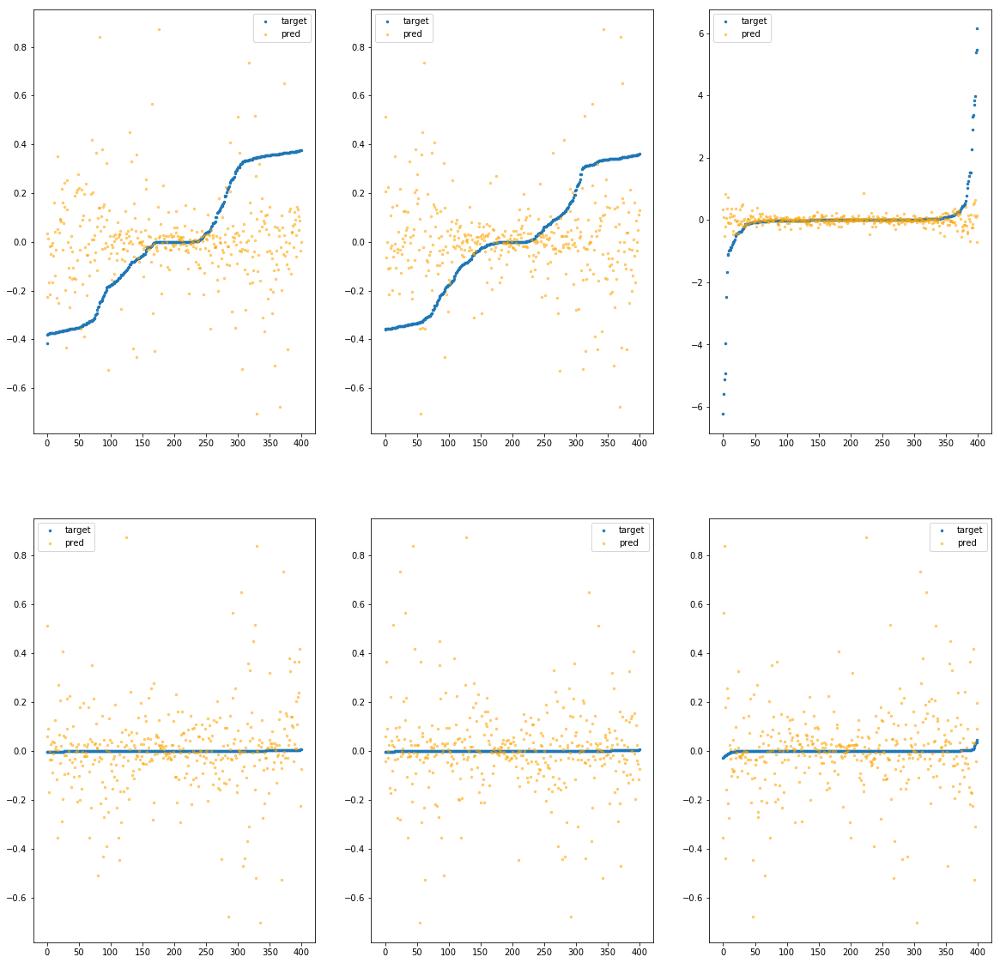

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fb253f2b760>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.19e-01	1.14e+00	2.51e-01	1.18e+04	1.10e-01	1.21e-02
y		-7.67e-01	1.12e+00	2.23e-01	2.13e+03	9.69e-02	9.38e-03
z		-2.31e-02	6.57e+00	3.40e-01	1.52e+03	8.95e-01	8.01e-01
phi		-2.80e+04	1.08e+00	1.40e-01	5.14e+06	5.21e-02	2.72e-03
theta		-4.10e+04	1.08e+00	1.40e-01	1.10e+06	5.21e-02	2.72e-03
psi		-2.12e+03	1.08e+00	1.40e-01	2.55e+06	5.21e-02	2.71e-03


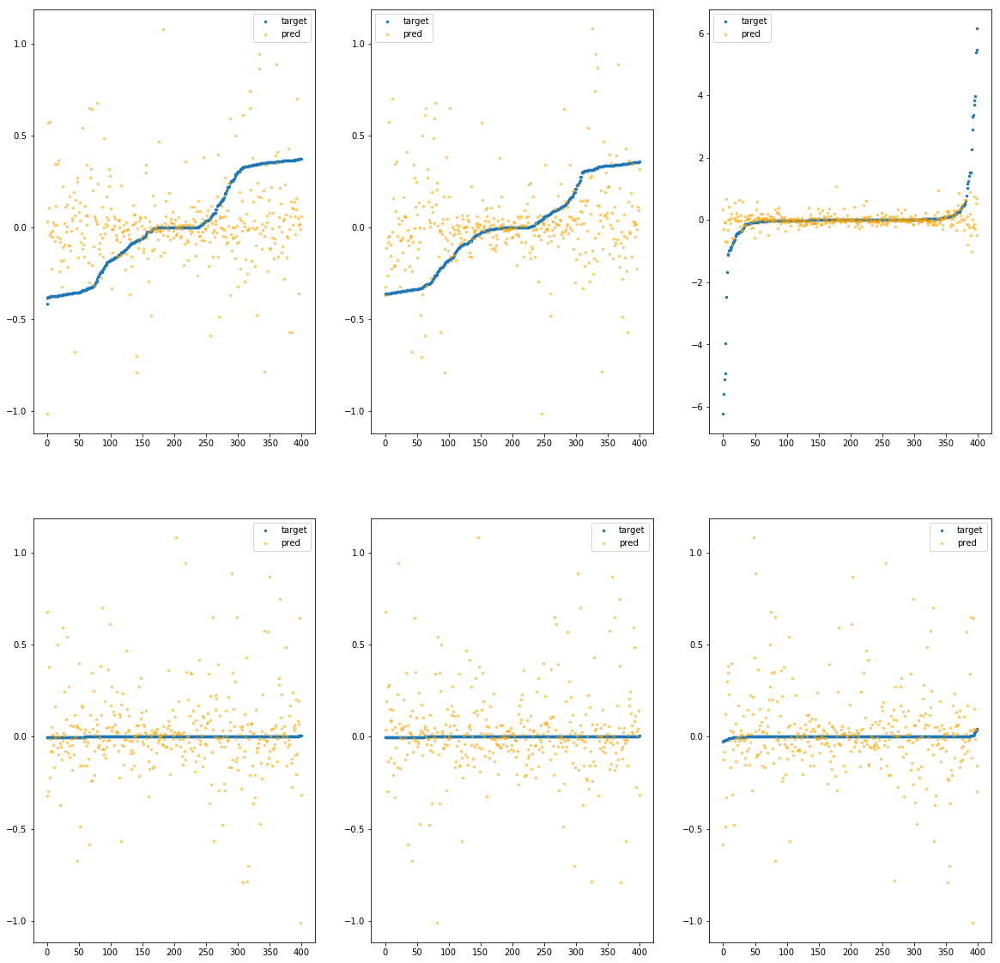

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2b7c0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.14e-01	7.40e-01	2.15e-01	3.38e+03	7.14e-02	5.10e-03
y		-1.57e-01	7.93e-01	1.98e-01	9.46e+02	6.34e-02	4.02e-03
z		3.95e-02	6.13e+00	2.95e-01	7.32e+02	8.40e-01	7.06e-01
phi		-4.19e+03	4.39e-01	5.44e-02	1.31e+06	7.81e-03	6.10e-05
theta		-6.12e+03	4.39e-01	5.42e-02	1.19e+06	7.77e-03	6.03e-05
psi		-3.18e+02	4.39e-01	5.45e-02	8.23e+05	7.82e-03	6.12e-05


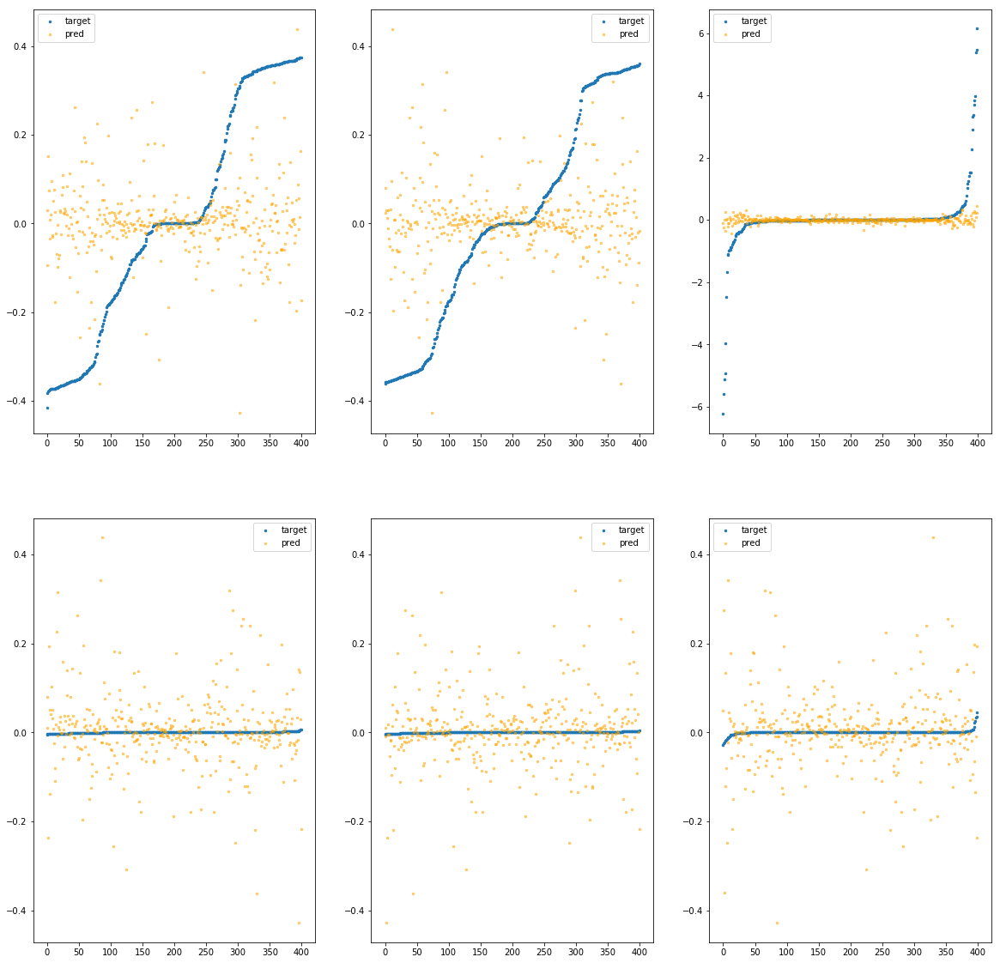

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2b820>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.02e-01	1.17e+00	2.31e-01	4.85e+03	8.99e-02	8.08e-03
y		-4.68e-01	1.15e+00	2.10e-01	2.48e+03	8.05e-02	6.48e-03
z		-4.53e-02	7.02e+00	3.14e-01	9.94e+02	9.15e-01	8.36e-01
phi		-1.25e+04	7.95e-01	8.91e-02	2.15e+06	2.32e-02	5.38e-04
theta		-1.83e+04	7.95e-01	8.91e-02	2.15e+06	2.32e-02	5.39e-04
psi		-9.41e+02	7.95e-01	8.88e-02	1.32e+06	2.31e-02	5.34e-04


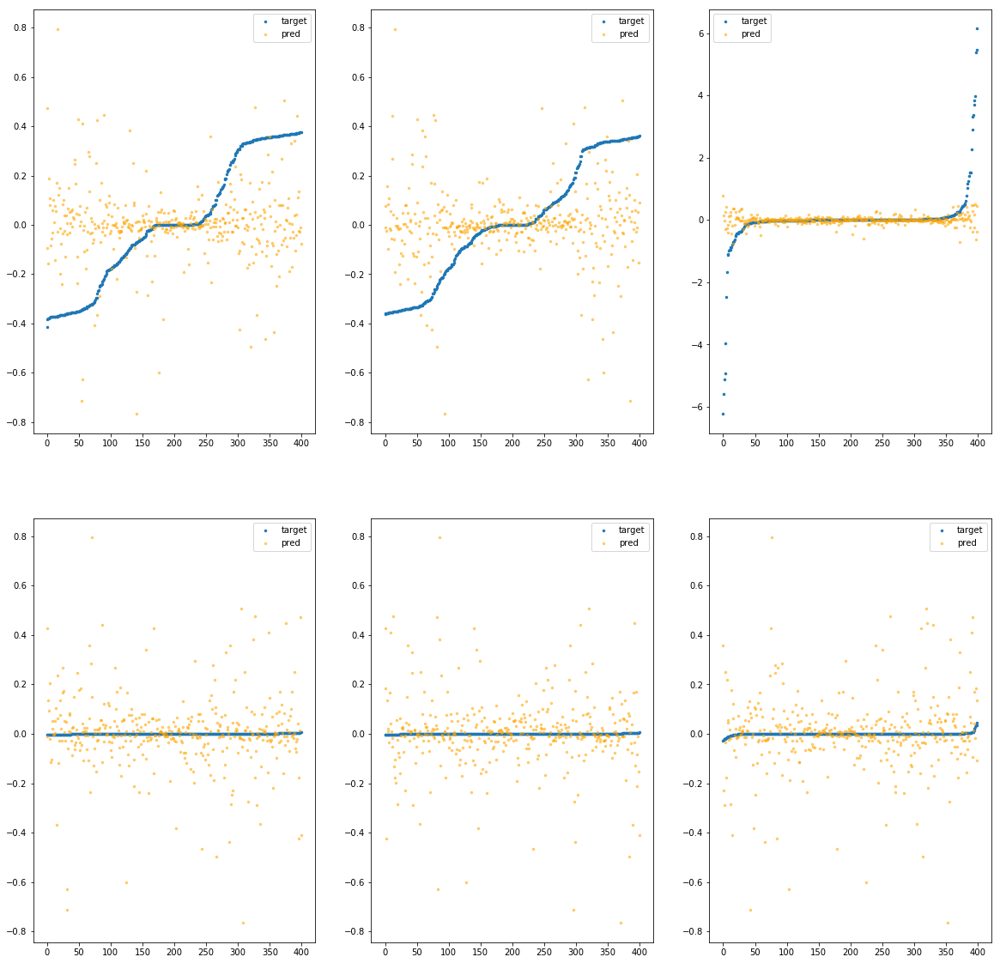

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2b880>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.10e-01	1.17e+00	2.43e-01	5.80e+03	1.03e-01	1.07e-02
y		-5.46e-01	1.15e+00	2.14e-01	1.07e+03	8.48e-02	7.19e-03
z		-7.77e-02	6.67e+00	3.25e-01	7.02e+02	9.43e-01	8.89e-01
phi		-1.44e+04	8.92e-01	9.34e-02	2.63e+06	2.68e-02	7.18e-04
theta		-2.11e+04	8.92e-01	9.35e-02	8.87e+05	2.68e-02	7.17e-04
psi		-1.09e+03	8.92e-01	9.33e-02	1.75e+06	2.68e-02	7.18e-04


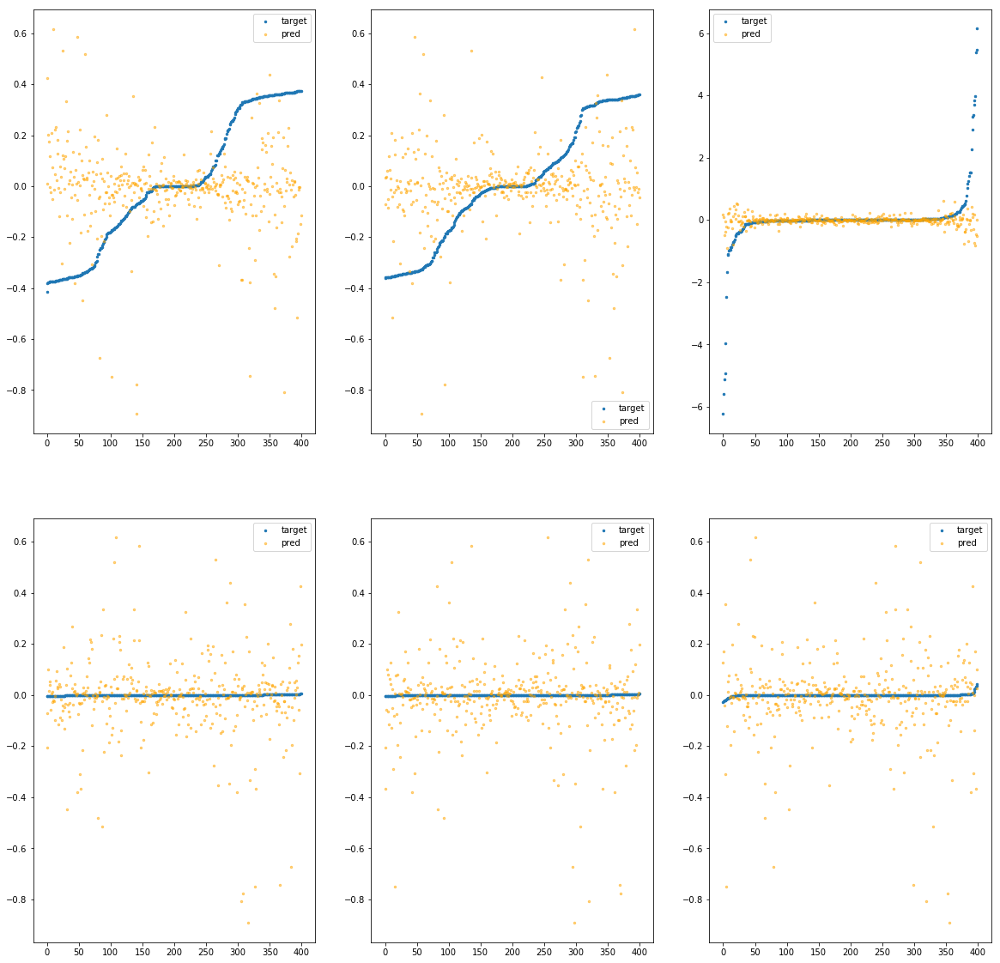

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2b8e0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.78e-01	9.04e-01	2.23e-01	3.74e+03	8.19e-02	6.71e-03
y		-2.74e-01	9.54e-01	2.02e-01	9.08e+02	6.98e-02	4.87e-03
z		-1.59e-02	6.25e+00	2.99e-01	7.92e+02	8.89e-01	7.90e-01
phi		-7.27e+03	6.25e-01	7.33e-02	1.65e+06	1.35e-02	1.83e-04
theta		-1.06e+04	6.25e-01	7.33e-02	5.92e+05	1.35e-02	1.83e-04
psi		-5.44e+02	6.26e-01	7.28e-02	1.08e+06	1.34e-02	1.79e-04


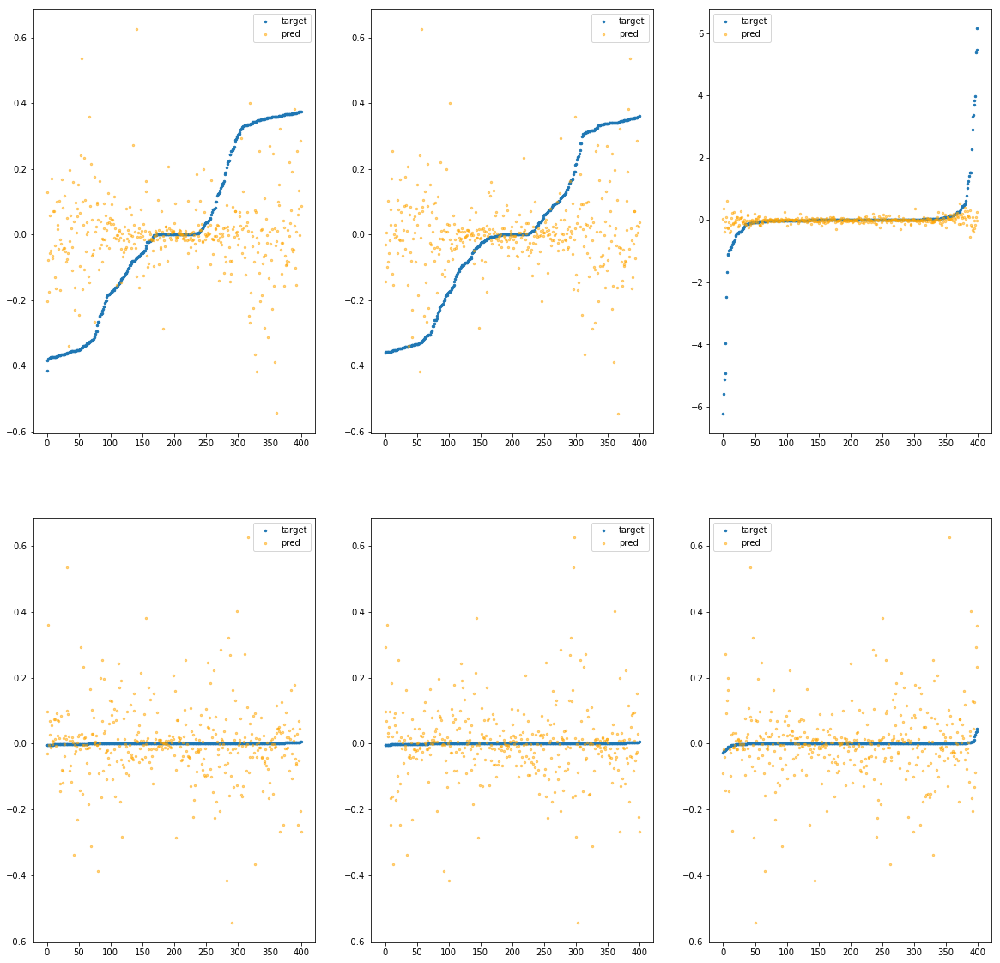

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2b940>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.13e-01	1.24e+00	2.32e-01	8.24e+03	9.70e-02	9.41e-03
y		-4.53e-01	1.24e+00	2.06e-01	7.83e+02	7.97e-02	6.35e-03
z		-1.58e-02	6.42e+00	3.27e-01	7.36e+02	8.89e-01	7.90e-01
phi		-1.50e+04	9.24e-01	9.86e-02	3.39e+06	2.79e-02	7.80e-04
theta		-2.20e+04	9.25e-01	9.86e-02	9.16e+05	2.79e-02	7.81e-04
psi		-1.15e+03	9.36e-01	9.91e-02	1.52e+06	2.82e-02	7.94e-04


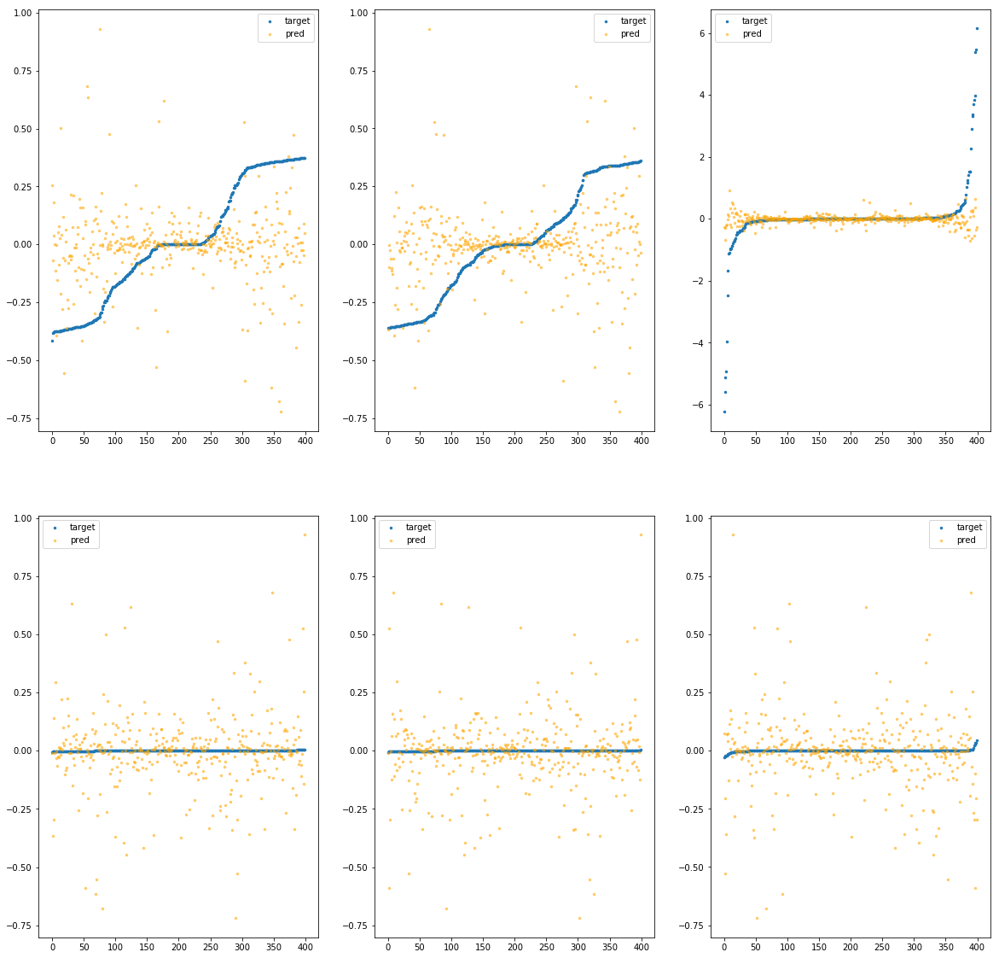

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2b9a0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.97e-02	6.84e-01	2.06e-01	3.72e+03	6.60e-02	4.36e-03
y		-2.18e-01	6.81e-01	2.03e-01	1.04e+03	6.68e-02	4.46e-03
z		-2.38e-02	6.43e+00	3.02e-01	4.89e+02	8.96e-01	8.02e-01
phi		-4.01e+03	4.05e-01	5.46e-02	1.71e+06	7.47e-03	5.57e-05
theta		-5.87e+03	3.99e-01	5.46e-02	1.01e+06	7.46e-03	5.56e-05
psi		-3.06e+02	4.07e-01	5.50e-02	9.89e+05	7.54e-03	5.69e-05


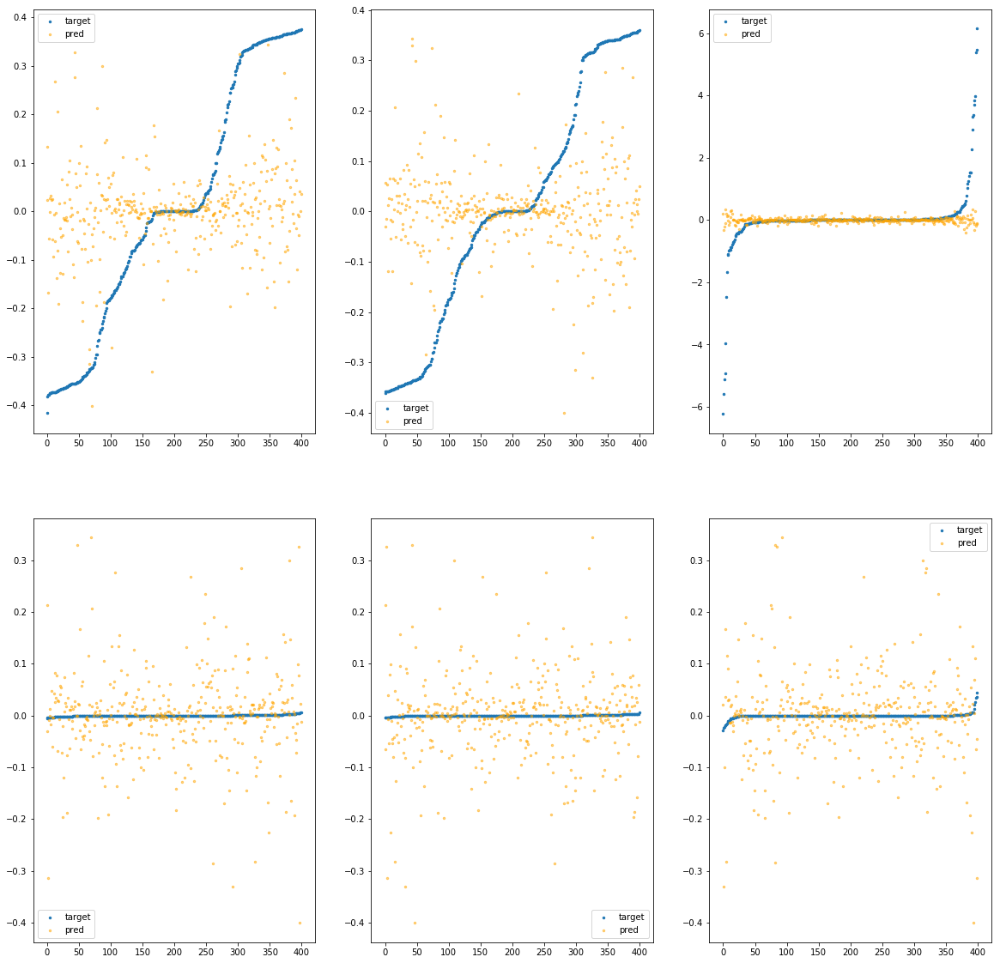

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2ba00>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.94e-02	7.67e-01	2.09e-01	5.56e+03	6.92e-02	4.79e-03
y		-1.63e-01	7.34e-01	1.98e-01	1.12e+03	6.38e-02	4.07e-03
z		-3.41e-02	6.16e+00	2.98e-01	4.71e+02	9.05e-01	8.18e-01
phi		-3.98e+03	4.23e-01	5.24e-02	1.94e+06	7.41e-03	5.49e-05
theta		-5.82e+03	4.23e-01	5.23e-02	9.37e+05	7.40e-03	5.47e-05
psi		-3.05e+02	4.22e-01	5.27e-02	7.66e+05	7.51e-03	5.64e-05


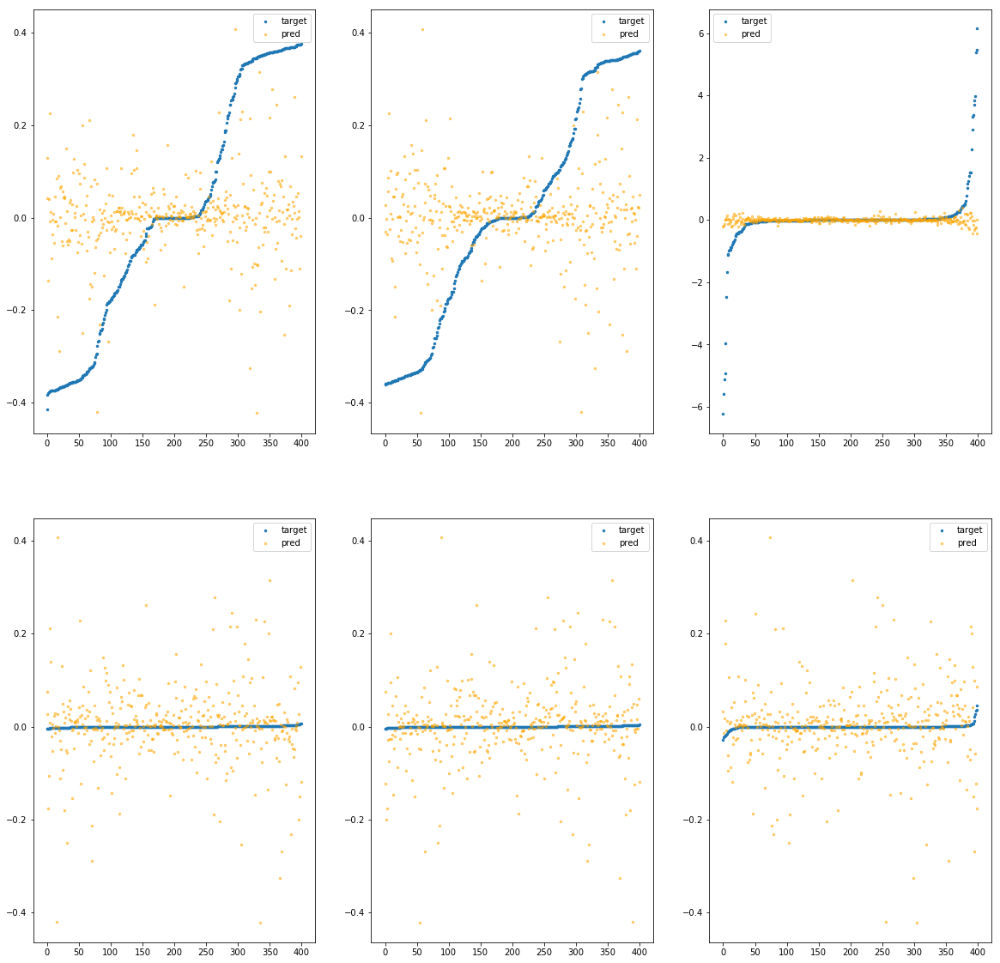

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2ba60>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.48e-01	8.03e-01	2.16e-01	3.95e+03	7.36e-02	5.42e-03
y		-2.30e-01	9.38e-01	1.99e-01	4.51e+02	6.74e-02	4.54e-03
z		-4.39e-02	6.45e+00	3.07e-01	4.58e+02	9.13e-01	8.34e-01
phi		-6.61e+03	6.05e-01	6.55e-02	1.71e+06	1.23e-02	1.52e-04
theta		-9.69e+03	6.08e-01	6.55e-02	4.20e+05	1.23e-02	1.51e-04
psi		-4.99e+02	6.07e-01	6.56e-02	1.12e+06	1.23e-02	1.51e-04


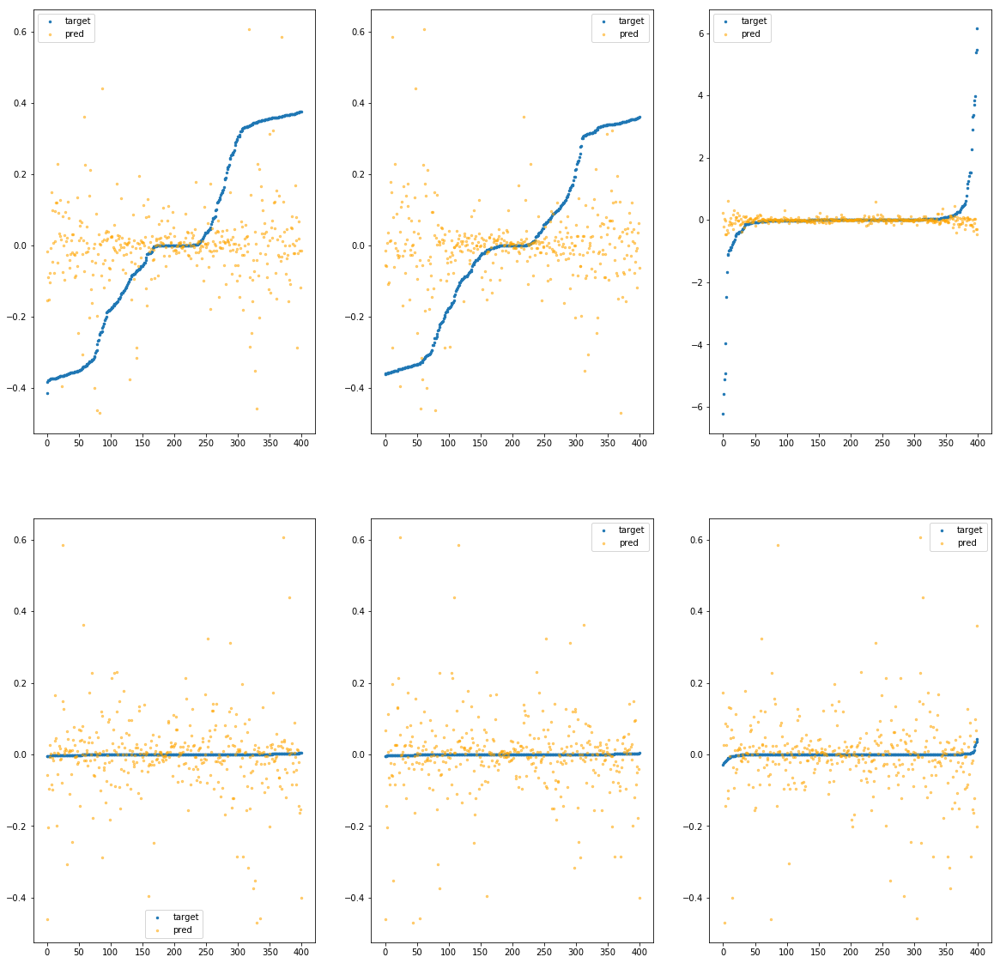

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bac0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.97e-01	9.22e-01	2.14e-01	5.88e+03	7.67e-02	5.89e-03
y		-3.81e-01	1.03e+00	2.07e-01	1.63e+03	7.57e-02	5.73e-03
z		-3.73e-02	6.12e+00	3.08e-01	9.17e+02	9.07e-01	8.24e-01
phi		-1.02e+04	8.57e-01	8.13e-02	2.46e+06	1.89e-02	3.57e-04
theta		-1.49e+04	8.57e-01	8.10e-02	6.10e+05	1.89e-02	3.56e-04
psi		-7.67e+02	8.58e-01	8.11e-02	1.23e+06	1.88e-02	3.55e-04


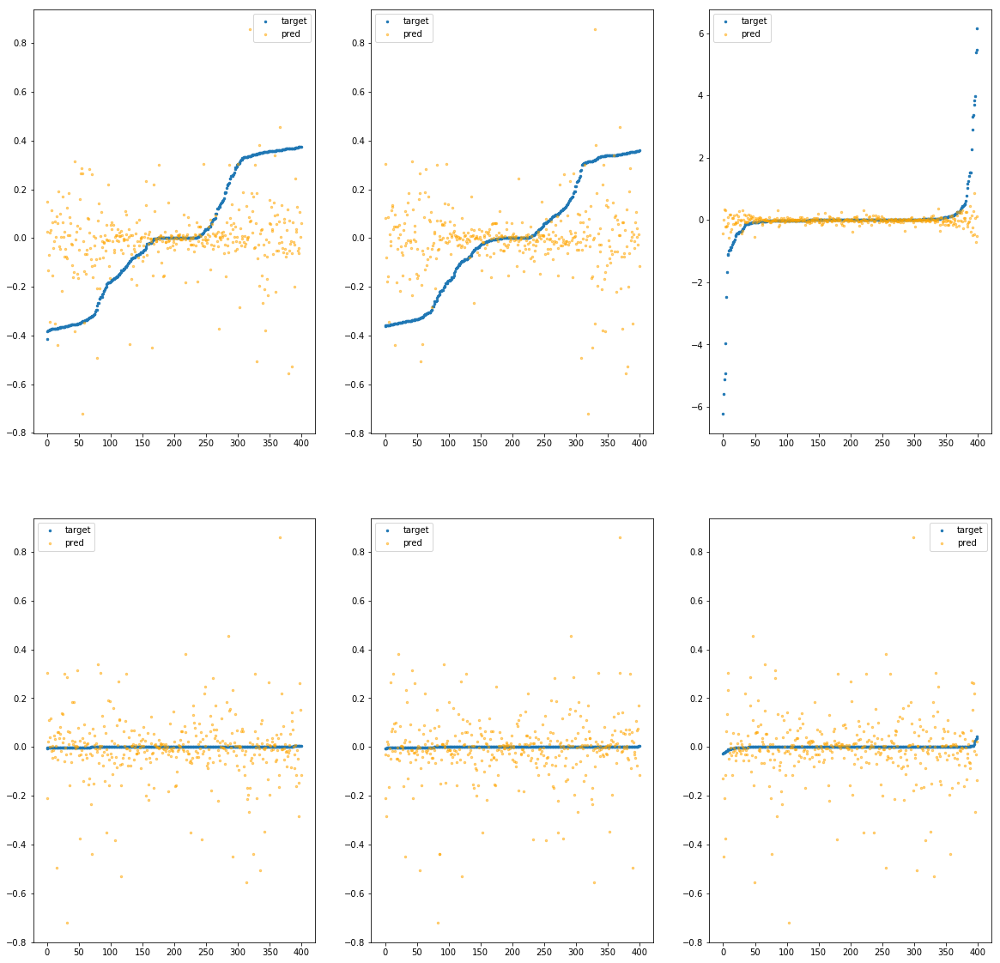

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bb20>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.45e-01	1.30e+00	2.23e-01	1.24e+04	9.26e-02	8.58e-03
y		-6.15e-01	1.17e+00	2.21e-01	1.47e+03	8.85e-02	7.84e-03
z		-1.20e-01	6.98e+00	3.27e-01	9.26e+02	9.80e-01	9.61e-01
phi		-1.63e+04	9.81e-01	1.04e-01	4.64e+06	3.04e-02	9.22e-04
theta		-2.39e+04	9.81e-01	1.04e-01	1.03e+06	3.03e-02	9.21e-04
psi		-1.23e+03	9.73e-01	1.04e-01	2.03e+06	3.03e-02	9.16e-04


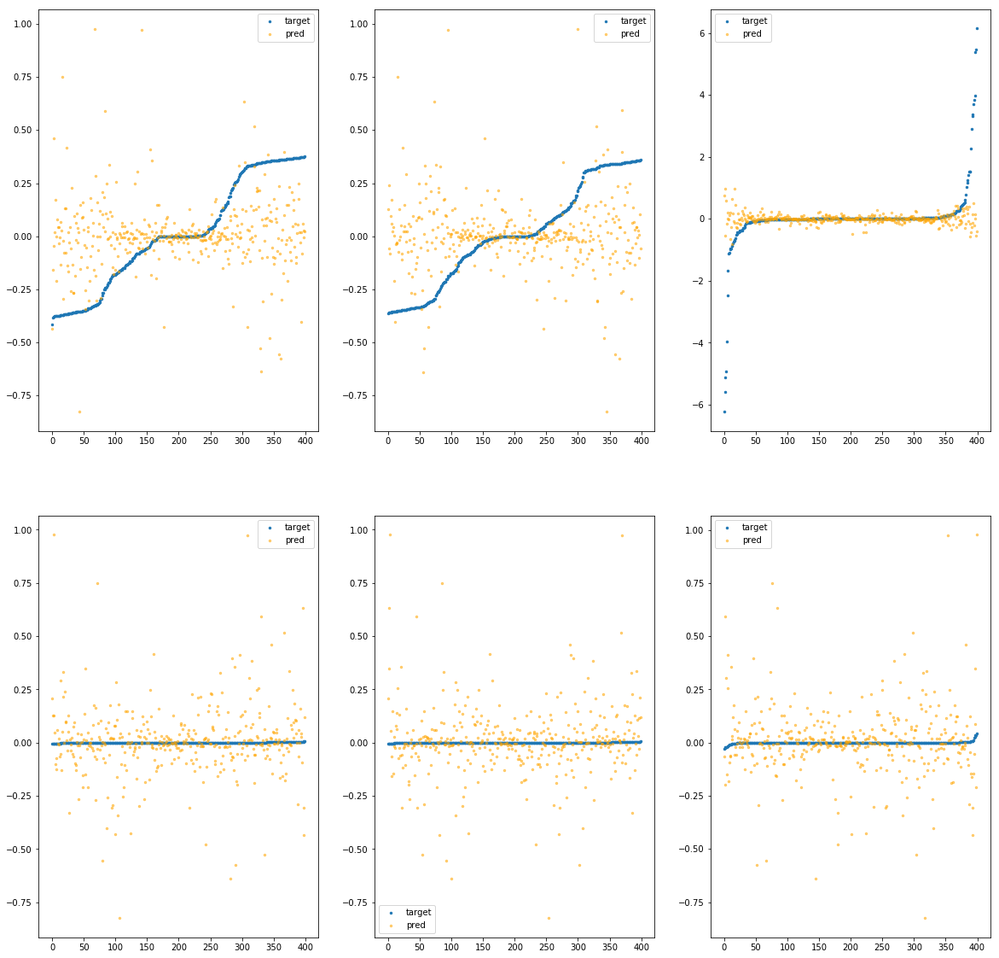

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bb80>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.62e-02	6.85e-01	2.12e-01	1.33e+03	6.96e-02	4.85e-03
y		-1.04e-01	8.86e-01	1.94e-01	2.90e+02	6.05e-02	3.67e-03
z		-2.05e-02	6.25e+00	2.95e-01	2.51e+02	8.93e-01	7.97e-01
phi		-2.37e+03	5.70e-01	3.70e-02	5.19e+05	4.40e-03	1.94e-05
theta		-3.46e+03	5.70e-01	3.69e-02	2.50e+05	4.39e-03	1.93e-05
psi		-1.79e+02	5.70e-01	3.70e-02	6.16e+05	4.41e-03	1.94e-05


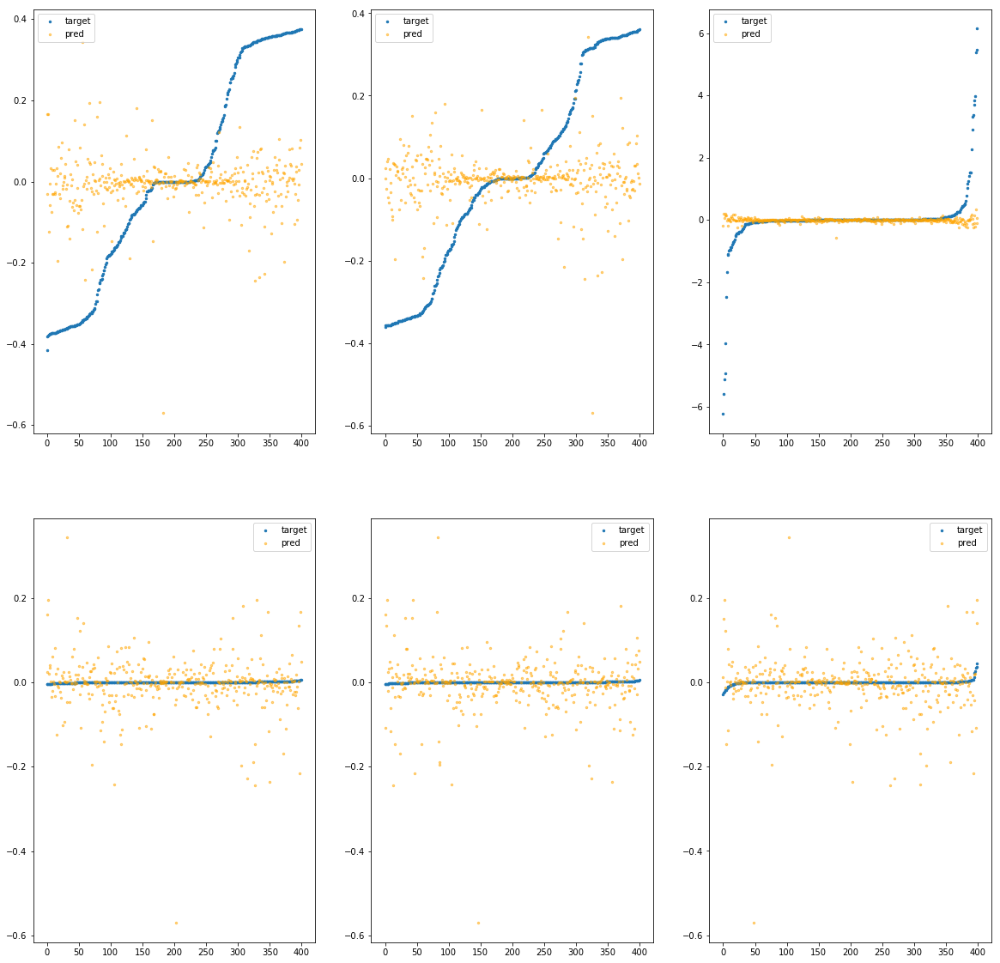

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bbe0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.42e-01	8.01e-01	2.16e-01	3.17e+03	7.32e-02	5.36e-03
y		-1.35e-01	7.83e-01	1.95e-01	7.03e+02	6.22e-02	3.87e-03
z		-1.85e-02	6.21e+00	2.94e-01	5.97e+02	8.91e-01	7.94e-01
phi		-3.91e+03	4.48e-01	5.07e-02	1.20e+06	7.27e-03	5.29e-05
theta		-5.71e+03	4.48e-01	5.05e-02	4.38e+05	7.26e-03	5.27e-05
psi		-2.96e+02	4.48e-01	5.06e-02	8.02e+05	7.27e-03	5.29e-05


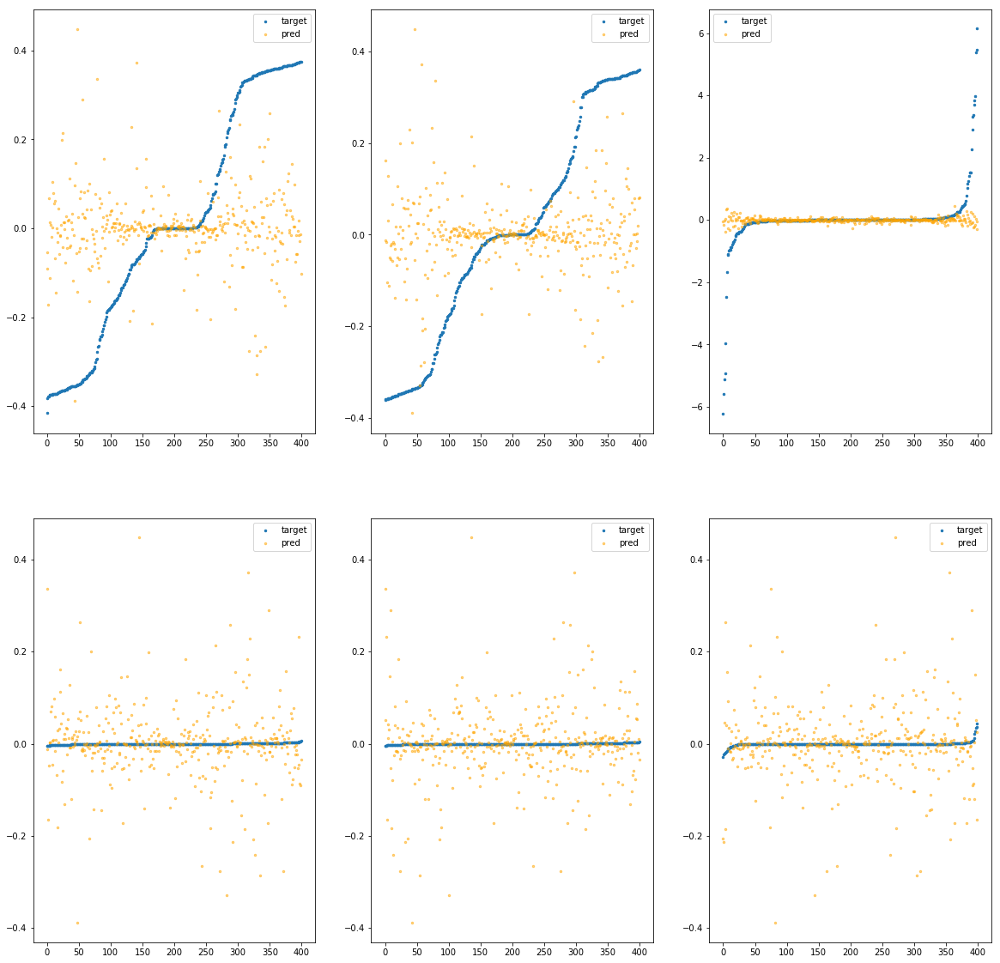

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bc40>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.40e-01	8.99e-01	2.23e-01	2.82e+03	7.95e-02	6.32e-03
y		-1.75e-01	7.77e-01	1.99e-01	6.86e+02	6.44e-02	4.15e-03
z		2.25e-03	6.22e+00	2.96e-01	4.71e+02	8.73e-01	7.62e-01
phi		-4.91e+03	4.81e-01	5.47e-02	1.30e+06	9.14e-03	8.36e-05
theta		-7.24e+03	4.84e-01	5.49e-02	6.19e+05	9.20e-03	8.46e-05
psi		-3.75e+02	5.04e-01	5.51e-02	7.28e+05	9.23e-03	8.51e-05


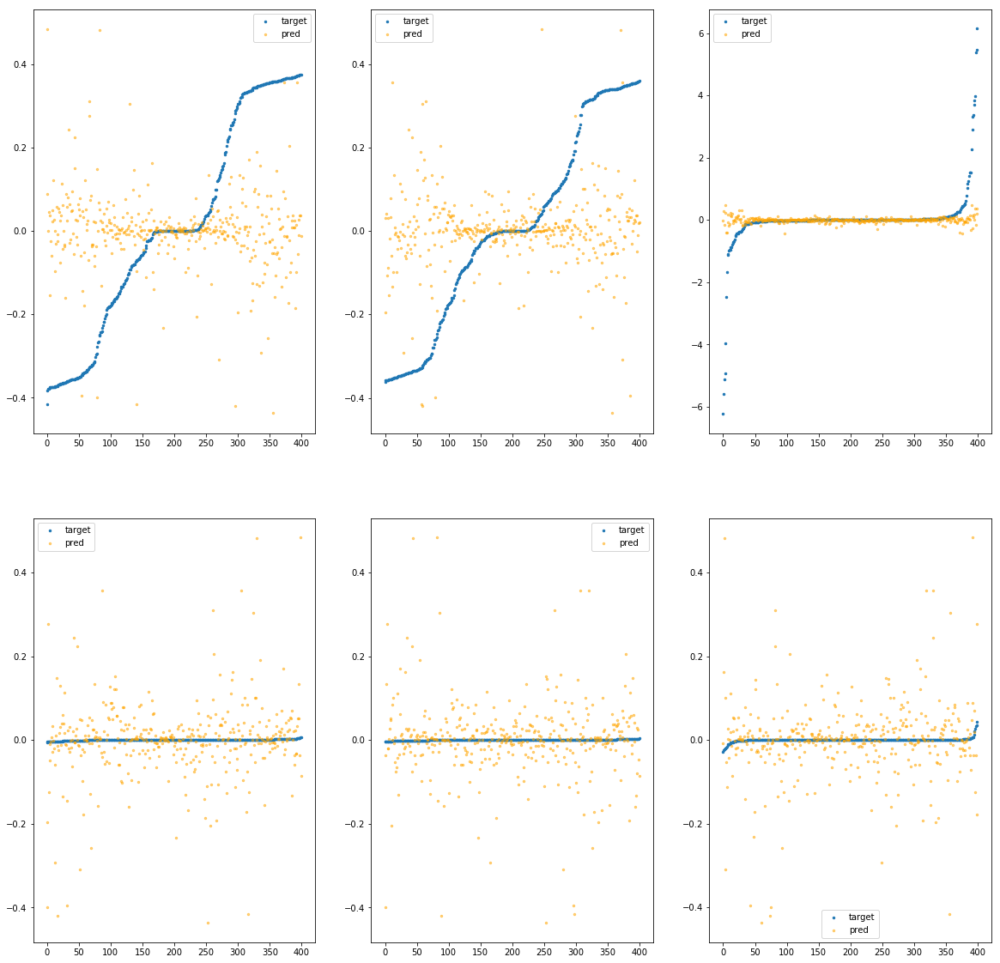

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bca0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.24e-01	6.32e-01	2.15e-01	3.17e+03	7.20e-02	5.19e-03
y		-1.11e-01	7.03e-01	1.92e-01	8.53e+02	6.09e-02	3.71e-03
z		-1.79e-02	6.28e+00	2.98e-01	5.14e+02	8.91e-01	7.93e-01
phi		-5.18e+03	4.47e-01	6.11e-02	1.63e+06	9.65e-03	9.31e-05
theta		-7.60e+03	4.48e-01	6.11e-02	1.11e+06	9.66e-03	9.33e-05
psi		-3.93e+02	4.52e-01	6.11e-02	1.16e+06	9.66e-03	9.33e-05


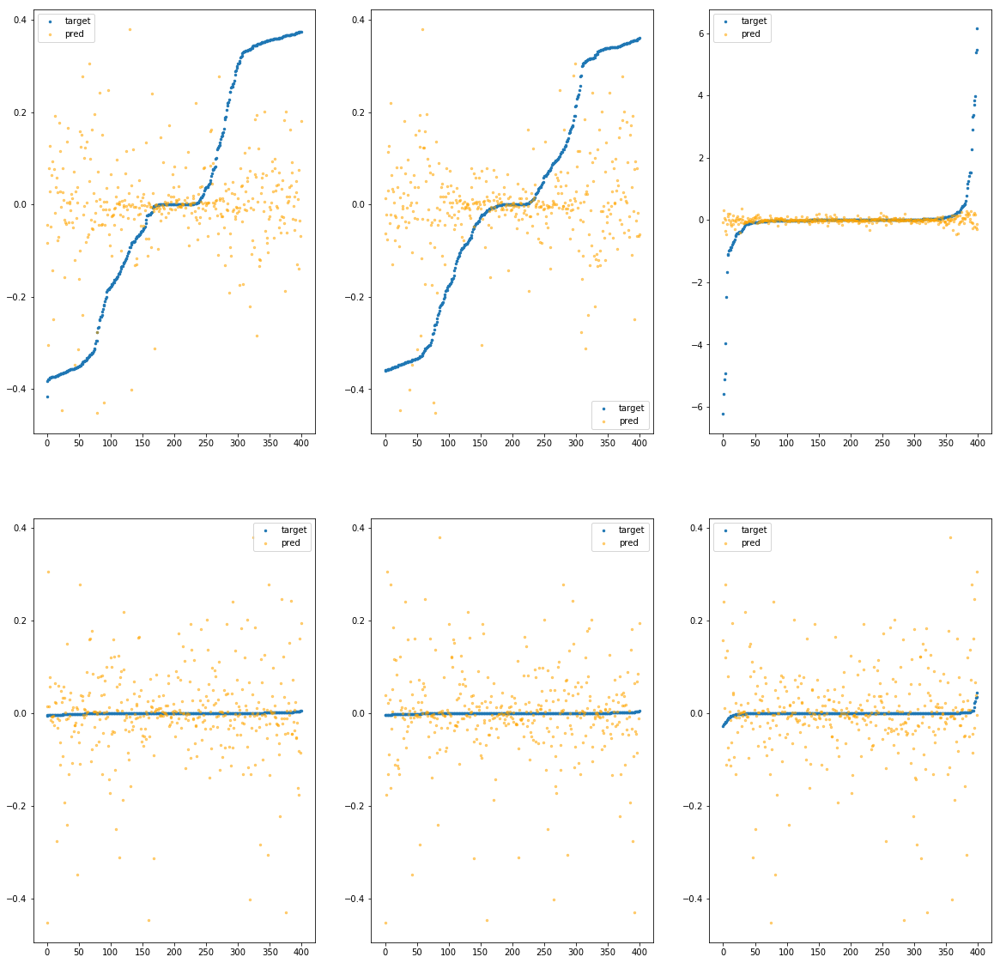

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bd00>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.05e-01	8.24e-01	2.25e-01	4.55e+03	8.37e-02	7.00e-03
y		-5.17e-01	9.75e-01	2.13e-01	1.24e+03	8.32e-02	6.92e-03
z		-5.46e-02	5.99e+00	3.29e-01	8.88e+02	9.23e-01	8.51e-01
phi		-1.31e+04	8.00e-01	9.42e-02	1.71e+06	2.44e-02	5.97e-04
theta		-1.93e+04	7.99e-01	9.43e-02	6.40e+05	2.45e-02	5.98e-04
psi		-9.94e+02	7.96e-01	9.44e-02	1.99e+06	2.44e-02	5.96e-04


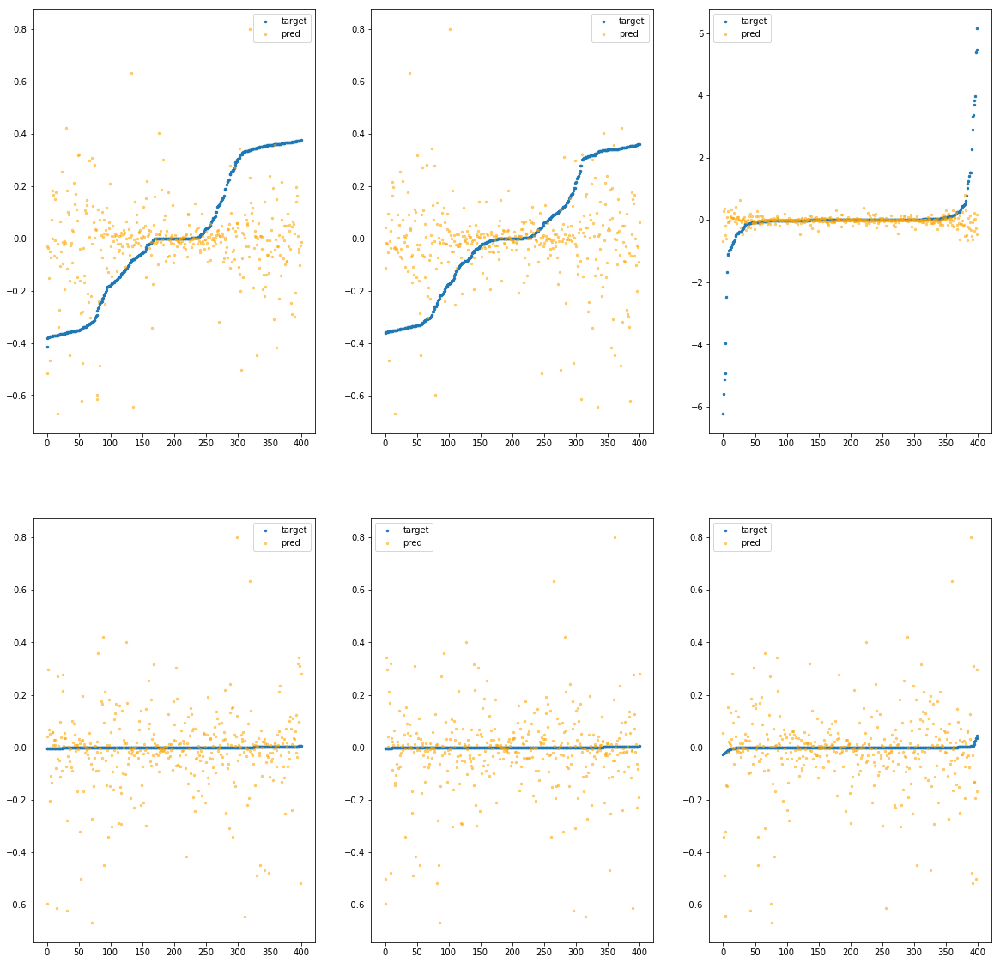

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bd60>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.38e-02	6.36e-01	2.13e-01	2.52e+03	6.95e-02	4.83e-03
y		-4.45e-02	6.19e-01	1.90e-01	3.89e+02	5.73e-02	3.28e-03
z		5.79e-03	6.46e+00	2.84e-01	3.75e+02	8.70e-01	7.57e-01
phi		-1.75e+03	3.02e-01	3.33e-02	1.11e+06	3.25e-03	1.06e-05
theta		-2.57e+03	3.02e-01	3.34e-02	5.35e+05	3.26e-03	1.06e-05
psi		-1.35e+02	3.00e-01	3.37e-02	4.74e+05	3.35e-03	1.12e-05


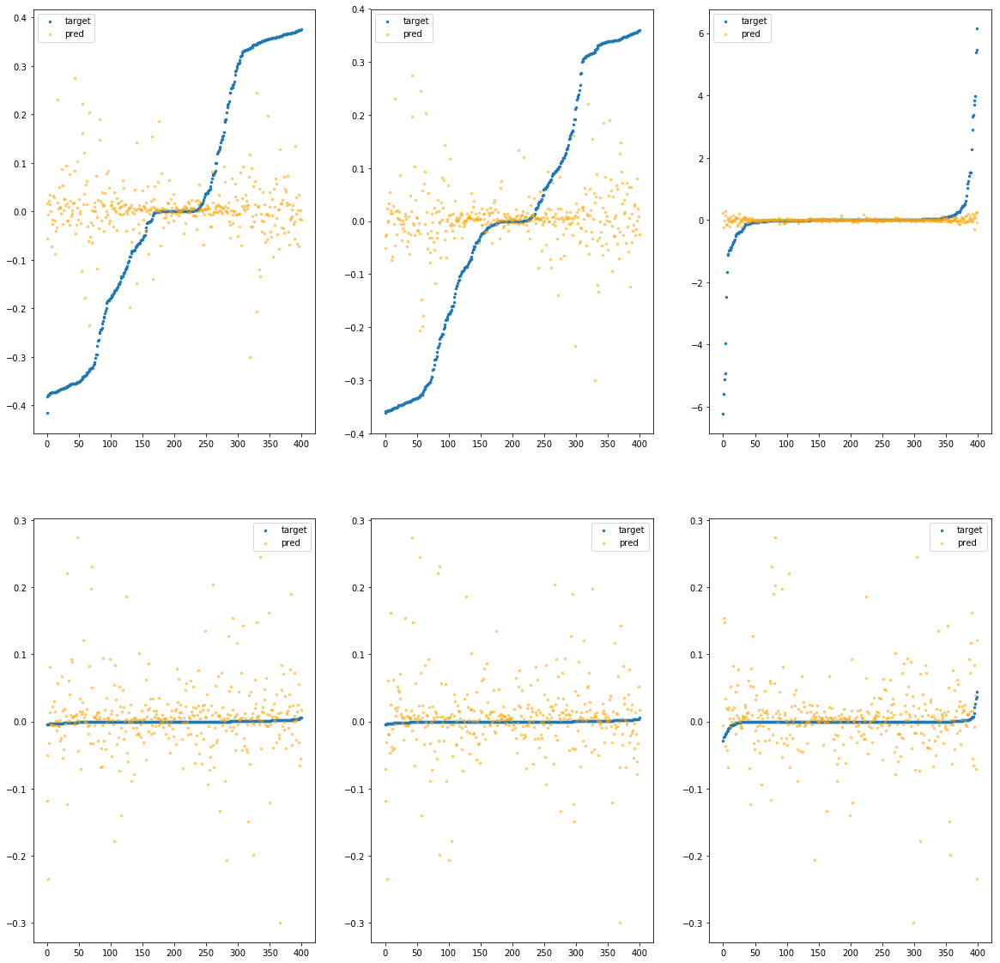

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bdc0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.21e-01	9.02e-01	2.13e-01	2.37e+03	7.19e-02	5.17e-03
y		-1.24e-01	8.84e-01	1.94e-01	4.90e+02	6.16e-02	3.80e-03
z		1.13e-02	6.26e+00	2.87e-01	2.55e+02	8.65e-01	7.48e-01
phi		-3.12e+03	5.44e-01	4.31e-02	1.03e+06	5.81e-03	3.38e-05
theta		-4.57e+03	5.44e-01	4.31e-02	3.05e+05	5.80e-03	3.36e-05
psi		-2.32e+02	5.44e-01	4.30e-02	6.81e+05	5.73e-03	3.28e-05


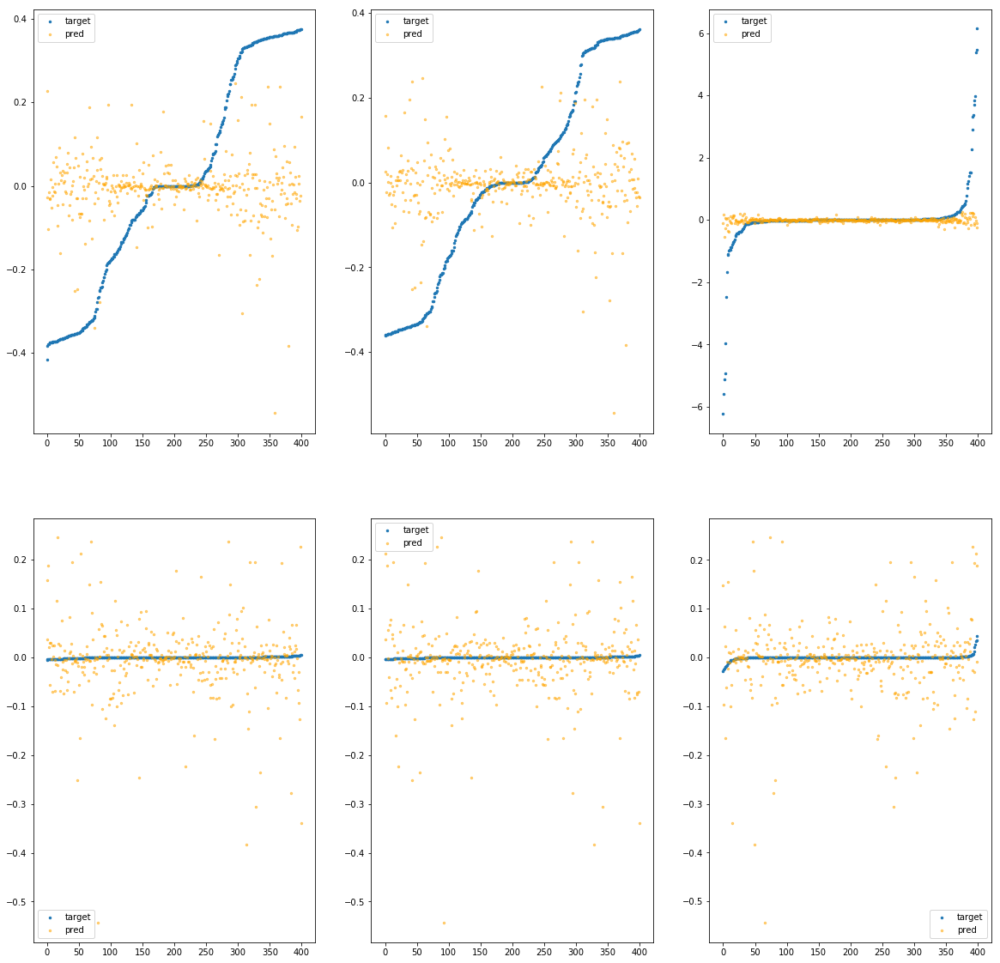

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2be20>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.76e-02	7.66e-01	2.07e-01	2.75e+03	6.72e-02	4.51e-03
y		-7.05e-02	7.49e-01	1.93e-01	3.54e+02	5.87e-02	3.44e-03
z		3.63e-04	6.17e+00	2.93e-01	4.32e+02	8.75e-01	7.65e-01
phi		-3.24e+03	5.38e-01	4.46e-02	1.11e+06	6.03e-03	3.64e-05
theta		-4.74e+03	5.38e-01	4.45e-02	3.93e+05	6.02e-03	3.63e-05
psi		-2.48e+02	5.39e-01	4.49e-02	9.33e+05	6.11e-03	3.74e-05


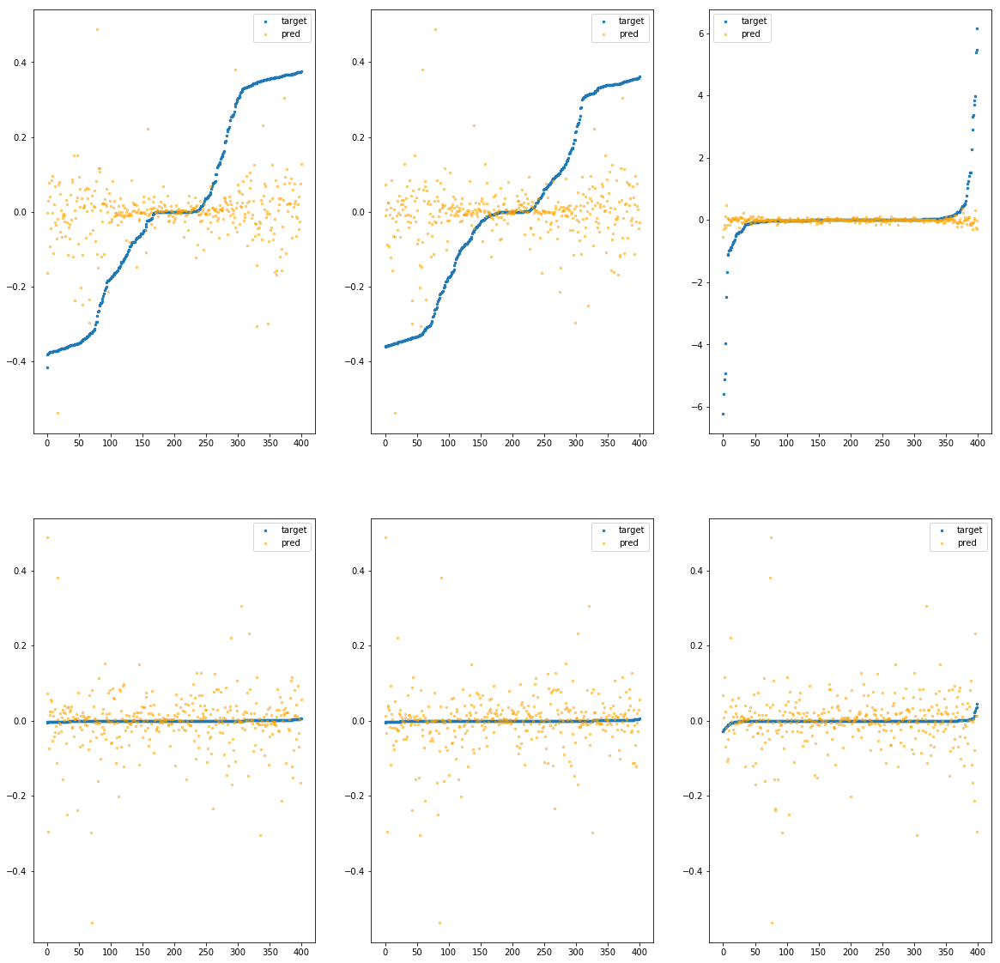

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2be80>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.91e-01	8.39e-01	2.18e-01	3.38e+03	7.64e-02	5.83e-03
y		-2.49e-01	7.68e-01	2.01e-01	6.83e+02	6.85e-02	4.69e-03
z		-1.91e-02	6.25e+00	3.01e-01	7.31e+02	8.92e-01	7.95e-01
phi		-5.46e+03	4.36e-01	6.19e-02	1.36e+06	1.02e-02	1.03e-04
theta		-8.03e+03	4.36e-01	6.19e-02	2.56e+05	1.02e-02	1.04e-04
psi		-4.10e+02	4.36e-01	6.17e-02	1.39e+06	1.01e-02	1.02e-04


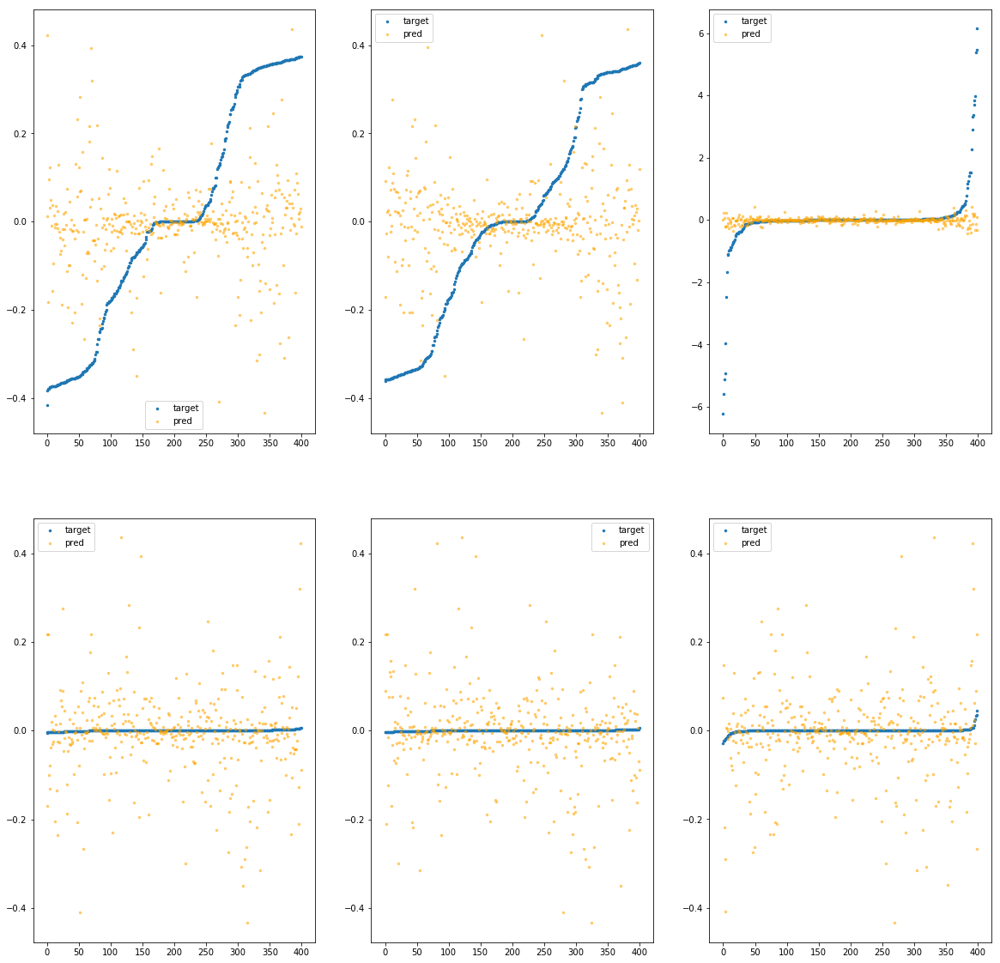

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fb253f2bee0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.03e-01	9.24e-01	2.32e-01	5.20e+03	8.99e-02	8.09e-03
y		-4.09e-01	1.03e+00	2.07e-01	7.38e+02	7.72e-02	5.96e-03
z		1.30e-02	6.46e+00	3.10e-01	6.22e+02	8.63e-01	7.46e-01
phi		-1.10e+04	7.50e-01	8.46e-02	2.54e+06	2.04e-02	4.16e-04
theta		-1.61e+04	7.50e-01	8.45e-02	1.06e+06	2.04e-02	4.16e-04
psi		-8.29e+02	7.50e-01	8.45e-02	1.56e+06	2.04e-02	4.15e-04


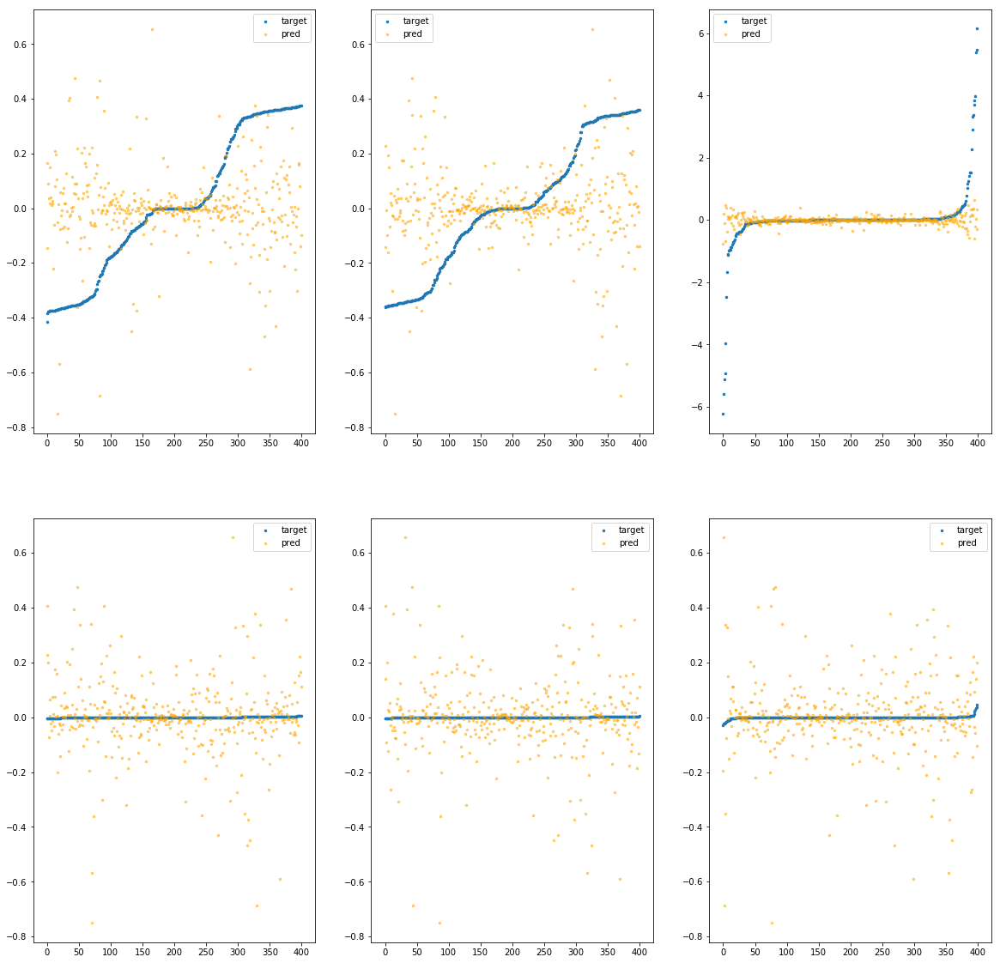

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f2bf40>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.14e-02	5.97e-01	2.06e-01	1.57e+03	6.55e-02	4.29e-03
y		-8.28e-02	5.81e-01	1.94e-01	6.17e+02	5.94e-02	3.52e-03
z		7.35e-03	6.17e+00	2.90e-01	4.93e+02	8.68e-01	7.54e-01
phi		-1.86e+03	3.13e-01	3.87e-02	6.87e+05	3.47e-03	1.20e-05
theta		-2.74e+03	3.13e-01	3.87e-02	3.22e+05	3.48e-03	1.21e-05
psi		-1.45e+02	3.13e-01	3.93e-02	5.96e+05	3.58e-03	1.28e-05


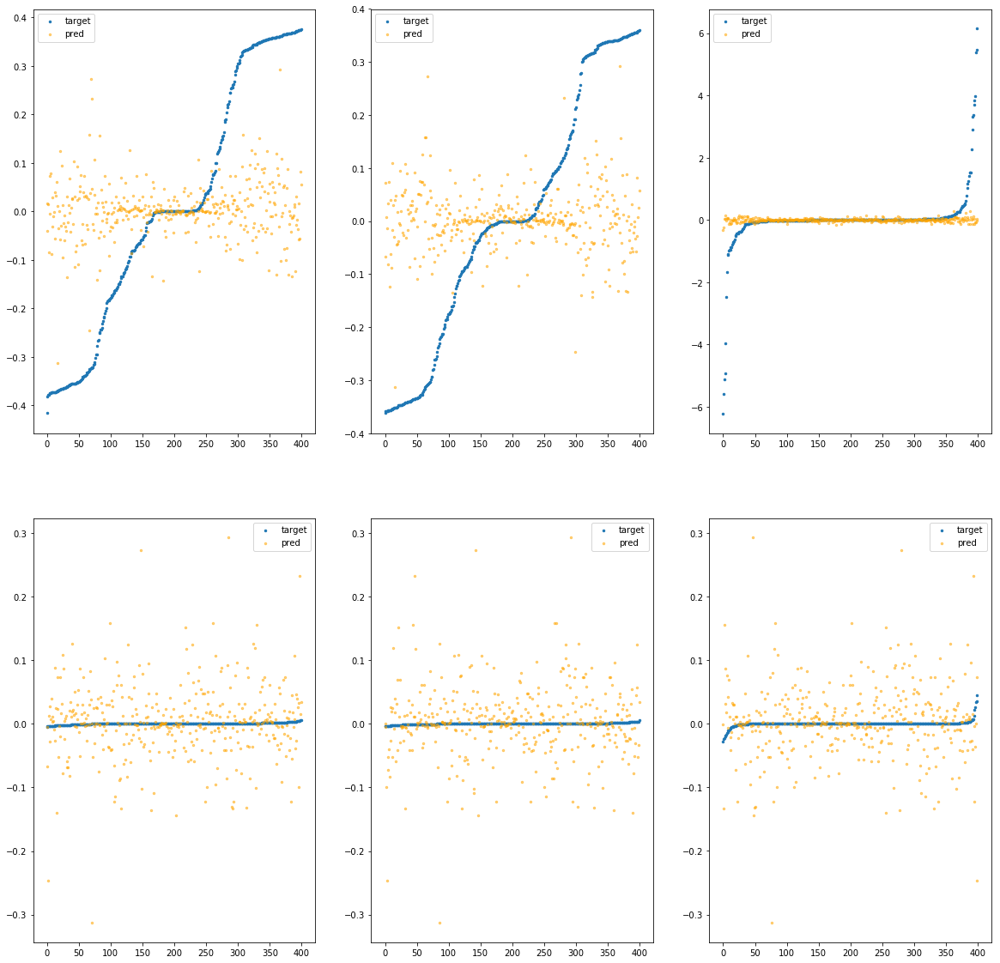

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f2bfa0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.15e-01	6.30e-01	2.16e-01	4.88e+03	7.15e-02	5.11e-03
y		-1.55e-01	6.29e-01	1.99e-01	1.07e+03	6.33e-02	4.01e-03
z		-6.00e-03	6.20e+00	2.97e-01	5.83e+02	8.80e-01	7.75e-01
phi		-3.77e+03	3.98e-01	5.62e-02	1.69e+06	7.02e-03	4.93e-05
theta		-5.53e+03	3.97e-01	5.62e-02	9.71e+05	7.03e-03	4.94e-05
psi		-2.83e+02	3.70e-01	5.60e-02	5.80e+05	6.96e-03	4.85e-05


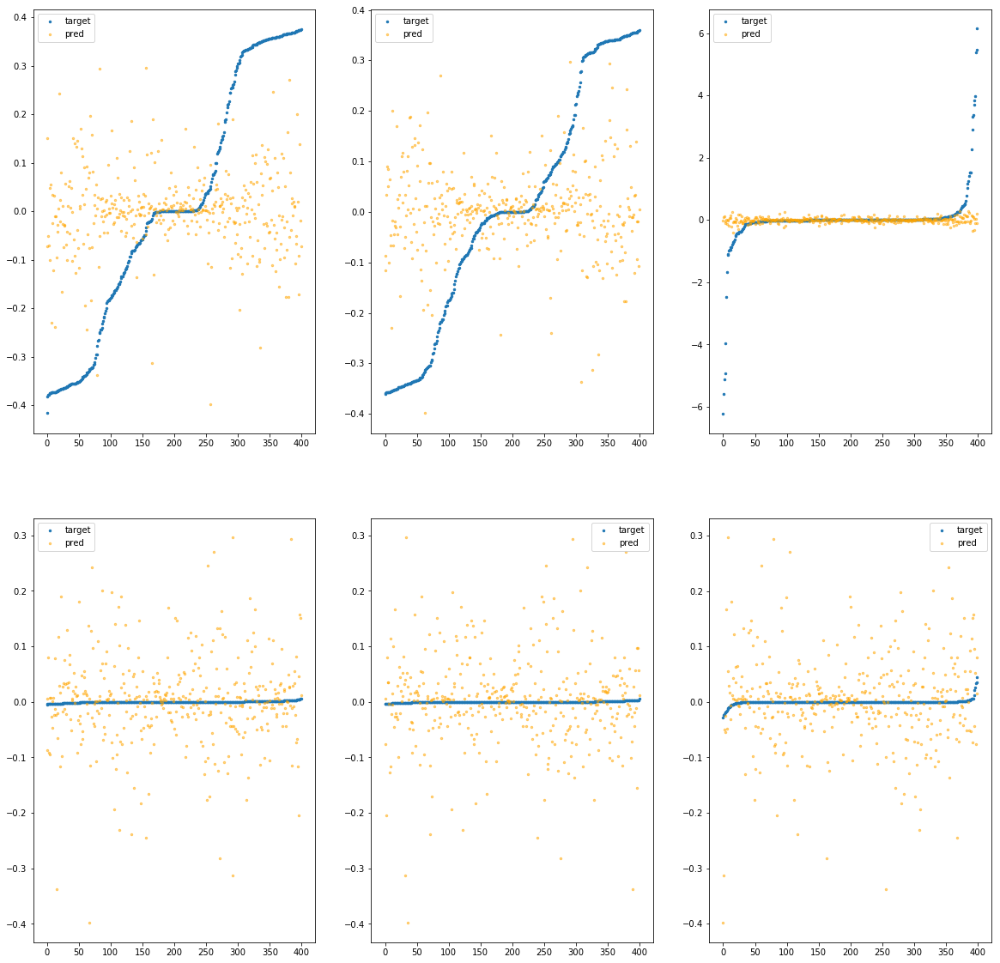

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34040>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.90e-02	6.07e-01	2.11e-01	2.33e+03	6.92e-02	4.79e-03
y		-7.17e-02	5.78e-01	1.94e-01	6.22e+02	5.88e-02	3.45e-03
z		5.09e-03	6.38e+00	2.92e-01	4.14e+02	8.70e-01	7.58e-01
phi		-2.65e+03	2.90e-01	4.65e-02	7.82e+05	4.94e-03	2.44e-05
theta		-3.89e+03	2.90e-01	4.65e-02	4.09e+05	4.94e-03	2.44e-05
psi		-2.06e+02	2.90e-01	4.71e-02	8.58e+05	5.09e-03	2.59e-05


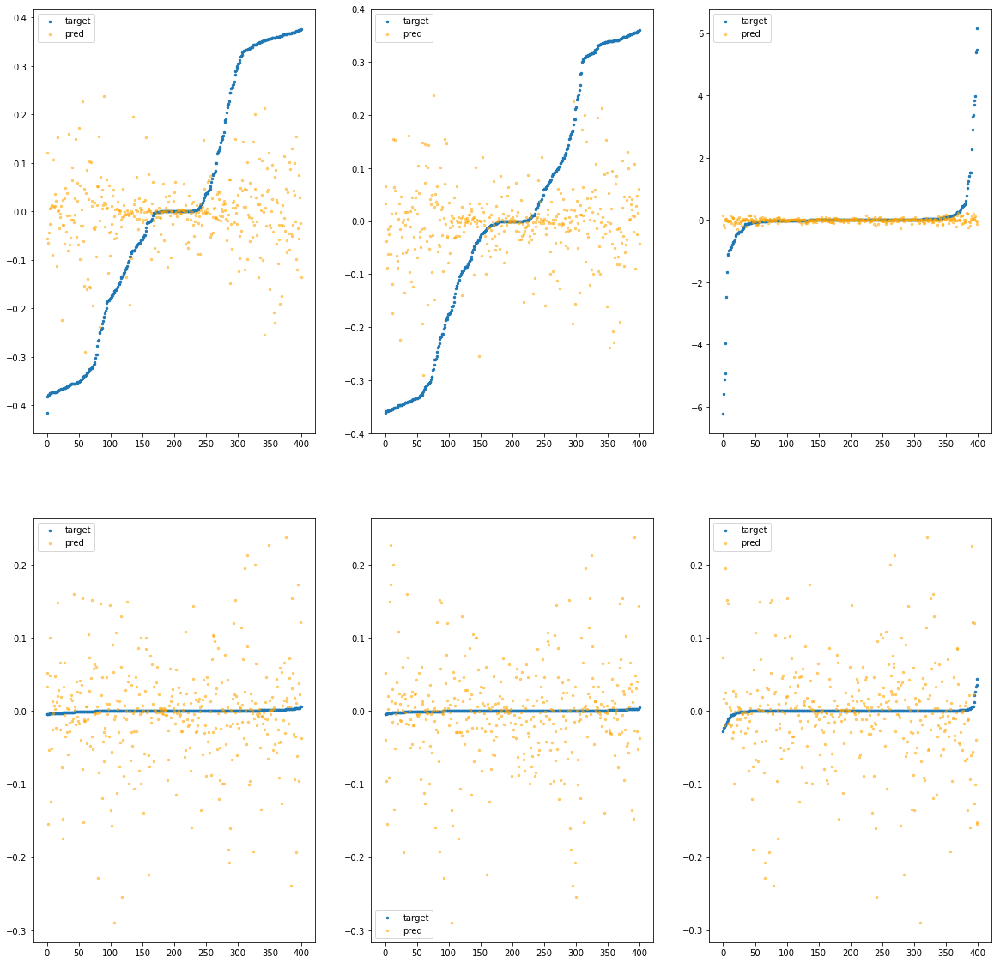

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f340a0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.03e-01	6.94e-01	2.12e-01	3.39e+03	7.07e-02	5.00e-03
y		-8.95e-02	6.61e-01	1.91e-01	2.60e+02	5.97e-02	3.57e-03
z		2.99e-02	5.99e+00	3.00e-01	5.65e+02	8.49e-01	7.20e-01
phi		-5.31e+03	3.59e-01	6.62e-02	1.58e+06	9.89e-03	9.78e-05
theta		-7.78e+03	3.60e-01	6.62e-02	4.35e+05	9.89e-03	9.78e-05
psi		-4.10e+02	3.83e-01	6.66e-02	1.13e+06	1.01e-02	1.02e-04


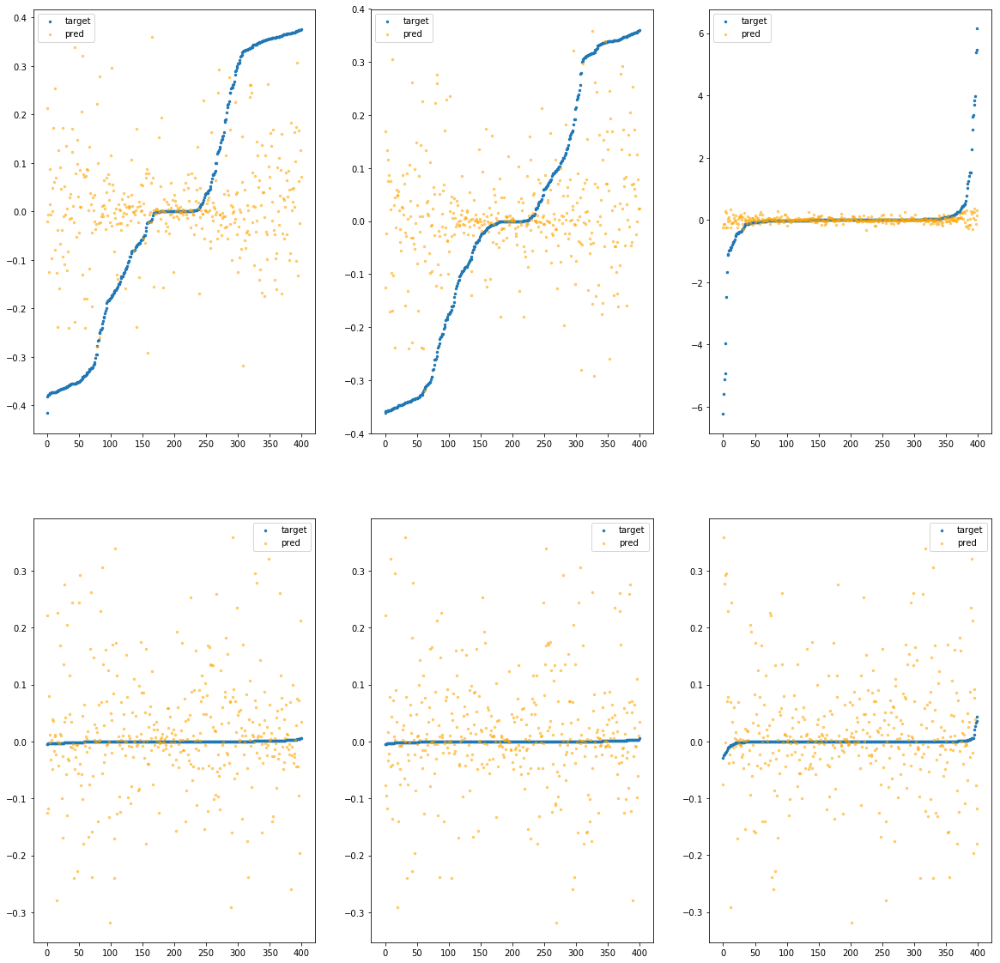

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34100>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.48e-02	6.61e-01	2.11e-01	2.40e+03	6.89e-02	4.75e-03
y		-1.46e-01	7.23e-01	1.95e-01	8.01e+02	6.28e-02	3.95e-03
z		2.16e-03	6.25e+00	3.00e-01	7.58e+02	8.73e-01	7.62e-01
phi		-4.44e+03	3.81e-01	6.08e-02	9.69e+05	8.27e-03	6.84e-05
theta		-6.51e+03	3.78e-01	6.08e-02	7.11e+05	8.26e-03	6.83e-05
psi		-3.37e+02	3.93e-01	6.09e-02	1.54e+06	8.29e-03	6.87e-05


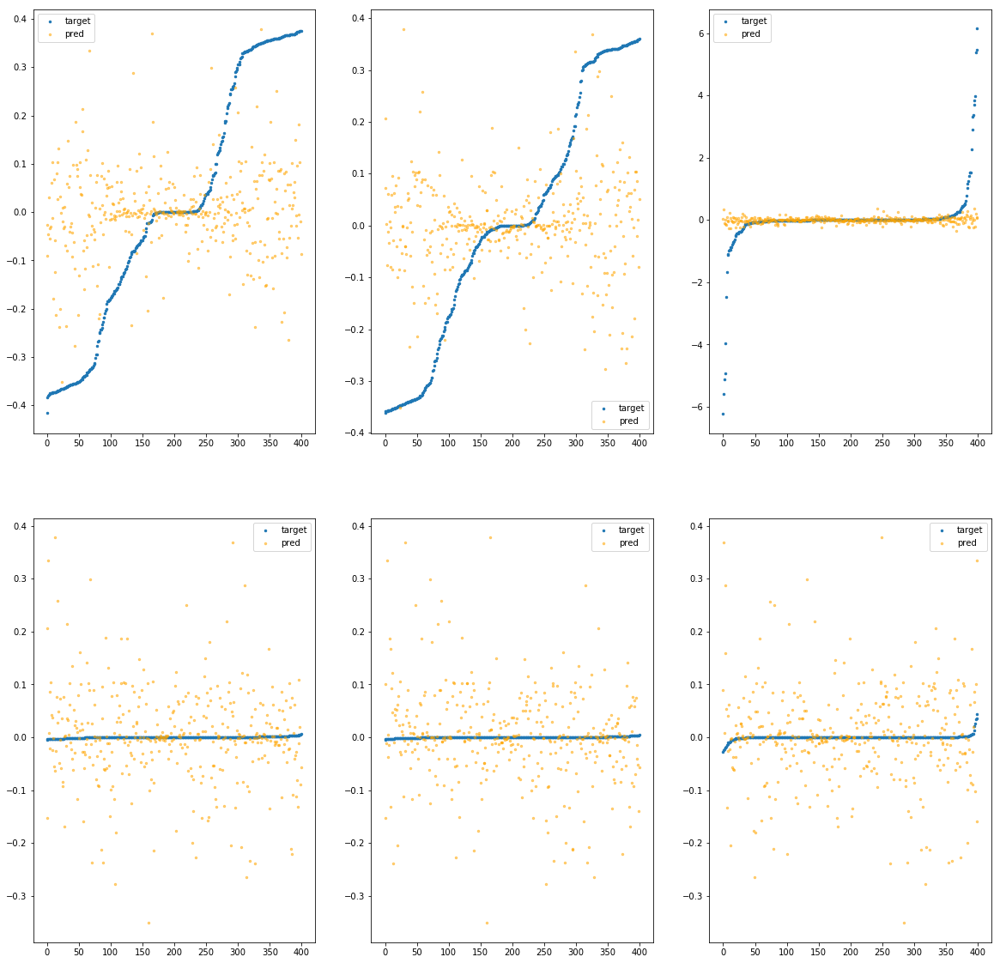

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34160>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		8.62e-03	4.61e-01	2.05e-01	1.66e+03	6.36e-02	4.04e-03
y		-3.60e-03	4.49e-01	1.89e-01	3.88e+02	5.50e-02	3.03e-03
z		2.80e-03	6.17e+00	2.82e-01	1.70e+02	8.72e-01	7.61e-01
phi		-4.36e+02	1.31e-01	1.91e-02	7.75e+05	8.13e-04	6.61e-07
theta		-6.29e+02	1.25e-01	1.89e-02	2.82e+05	8.00e-04	6.40e-07
psi		-3.29e+01	1.32e-01	1.91e-02	3.77e+05	8.33e-04	6.94e-07


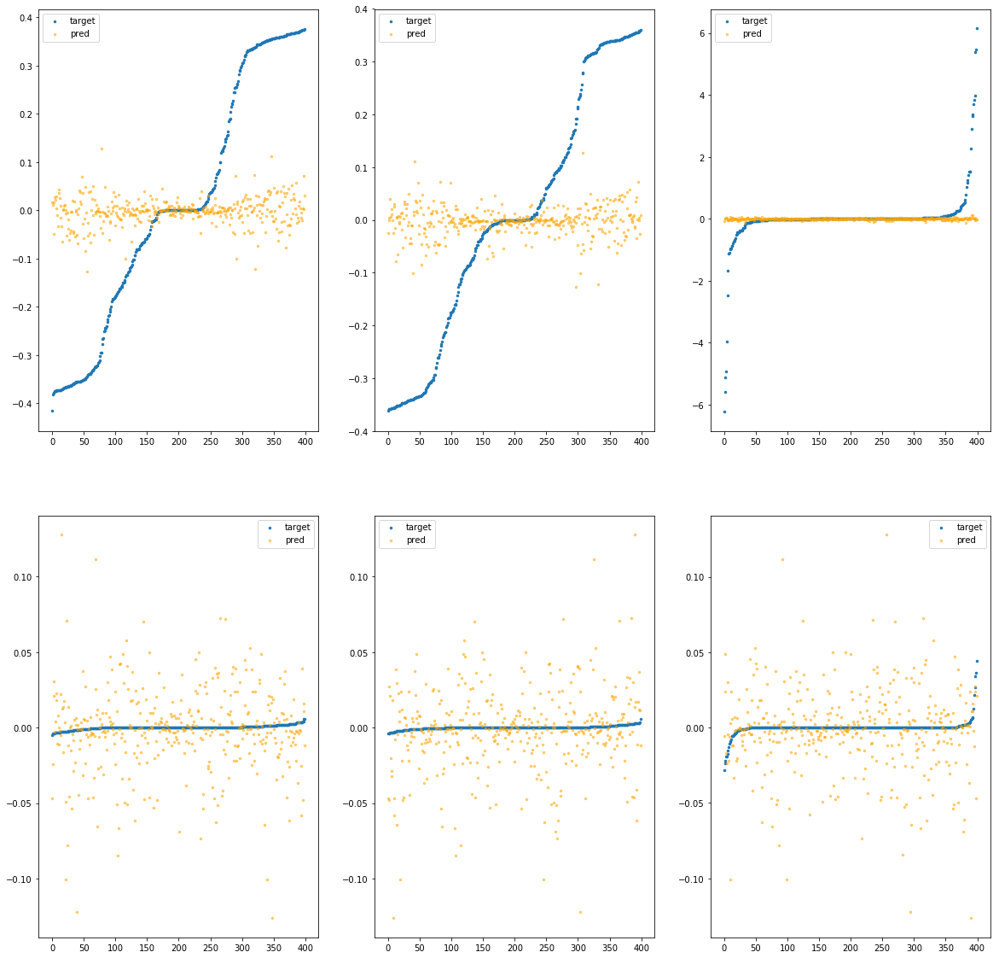

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f341c0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.99e-02	5.08e-01	2.08e-01	1.83e+03	6.60e-02	4.36e-03
y		7.49e-03	4.87e-01	1.88e-01	3.71e+02	5.44e-02	2.96e-03
z		9.48e-03	6.28e+00	2.83e-01	2.32e+02	8.67e-01	7.51e-01
phi		-9.40e+02	2.62e-01	2.67e-02	5.36e+05	1.75e-03	3.07e-06
theta		-1.38e+03	2.62e-01	2.67e-02	2.01e+05	1.76e-03	3.08e-06
psi		-7.07e+01	2.63e-01	2.67e-02	4.00e+05	1.76e-03	3.09e-06


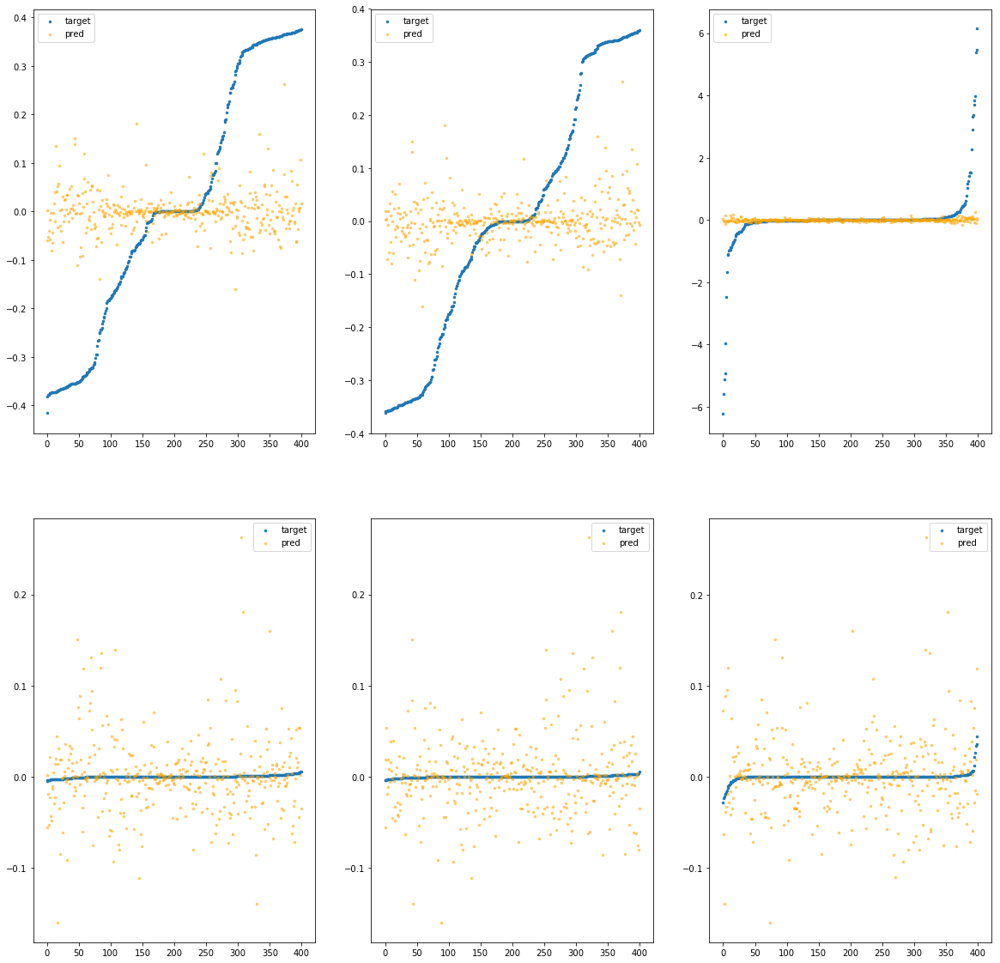

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34220>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.39e-02	5.55e-01	2.10e-01	1.87e+03	6.76e-02	4.57e-03
y		-9.20e-02	6.61e-01	1.94e-01	7.21e+02	5.99e-02	3.58e-03
z		-7.05e-03	6.24e+00	2.94e-01	3.09e+02	8.81e-01	7.76e-01
phi		-1.88e+03	3.51e-01	3.70e-02	7.28e+05	3.50e-03	1.22e-05
theta		-2.75e+03	3.46e-01	3.70e-02	3.00e+05	3.49e-03	1.22e-05
psi		-1.40e+02	3.53e-01	3.70e-02	8.76e+05	3.46e-03	1.19e-05


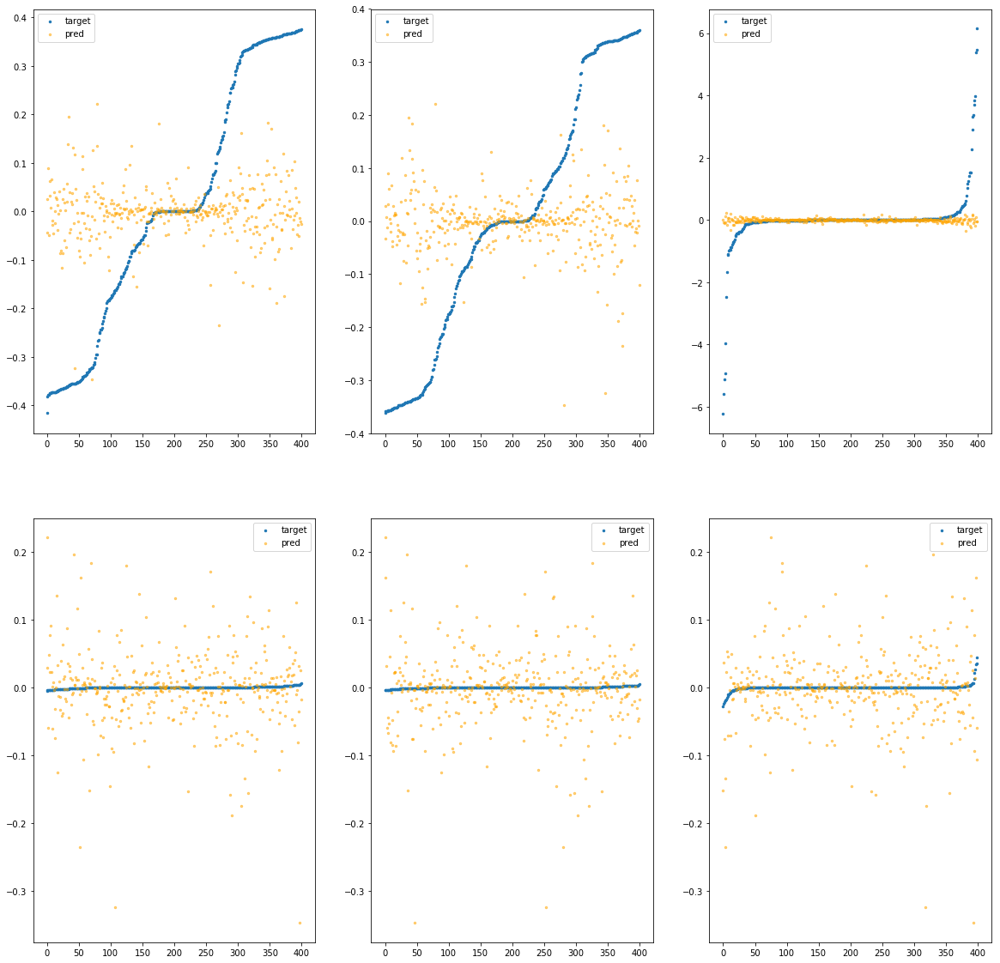

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34280>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.52e-02	5.90e-01	2.08e-01	2.19e+03	6.70e-02	4.49e-03
y		-1.46e-01	7.84e-01	1.98e-01	5.69e+02	6.28e-02	3.95e-03
z		2.76e-03	6.28e+00	2.97e-01	5.26e+02	8.72e-01	7.61e-01
phi		-3.02e+03	4.55e-01	4.86e-02	9.09e+05	5.62e-03	3.15e-05
theta		-4.40e+03	4.56e-01	4.84e-02	3.41e+05	5.59e-03	3.12e-05
psi		-2.31e+02	4.56e-01	4.89e-02	9.03e+05	5.69e-03	3.24e-05


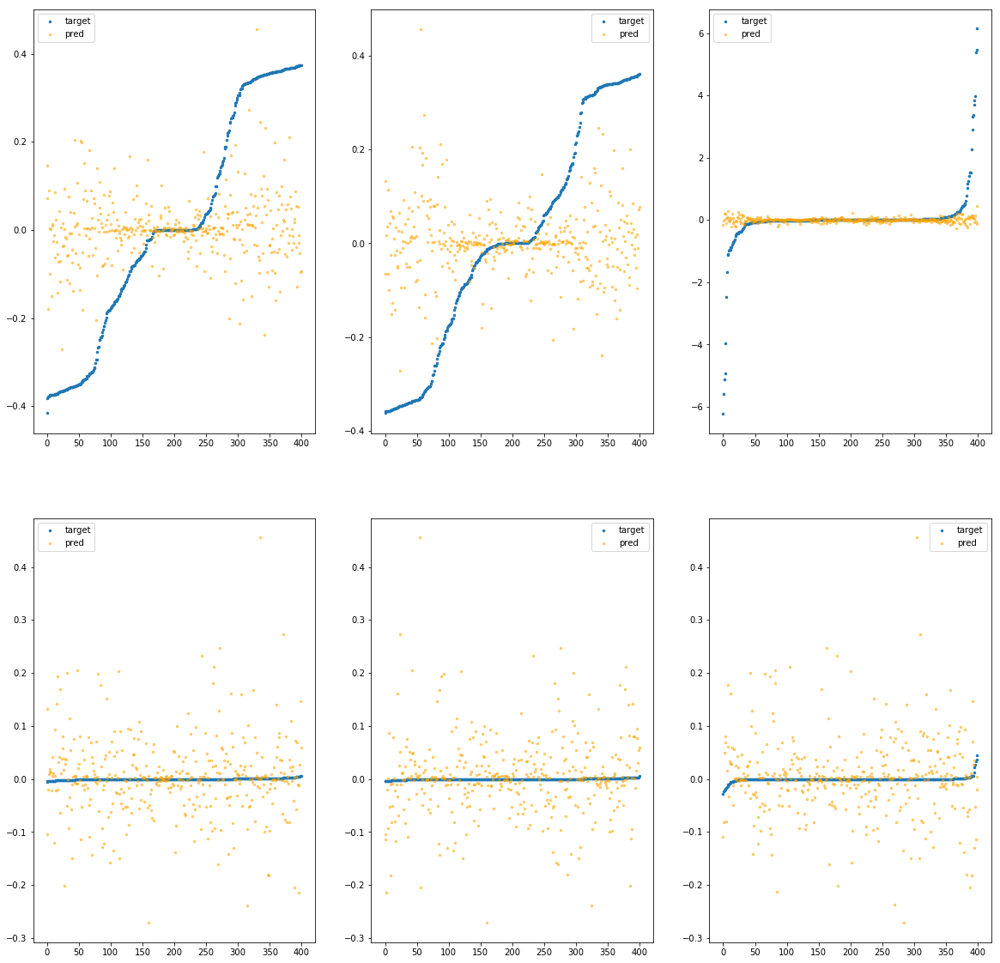

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f342e0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.44e-01	7.06e-01	2.18e-01	2.51e+03	7.33e-02	5.38e-03
y		-1.14e-01	7.03e-01	1.94e-01	1.16e+03	6.11e-02	3.73e-03
z		1.66e-03	6.29e+00	3.01e-01	4.78e+02	8.73e-01	7.63e-01
phi		-4.09e+03	4.58e-01	5.80e-02	1.02e+06	7.62e-03	5.80e-05
theta		-6.02e+03	4.59e-01	5.80e-02	3.05e+05	7.65e-03	5.85e-05
psi		-3.13e+02	5.06e-01	5.78e-02	8.10e+05	7.69e-03	5.92e-05


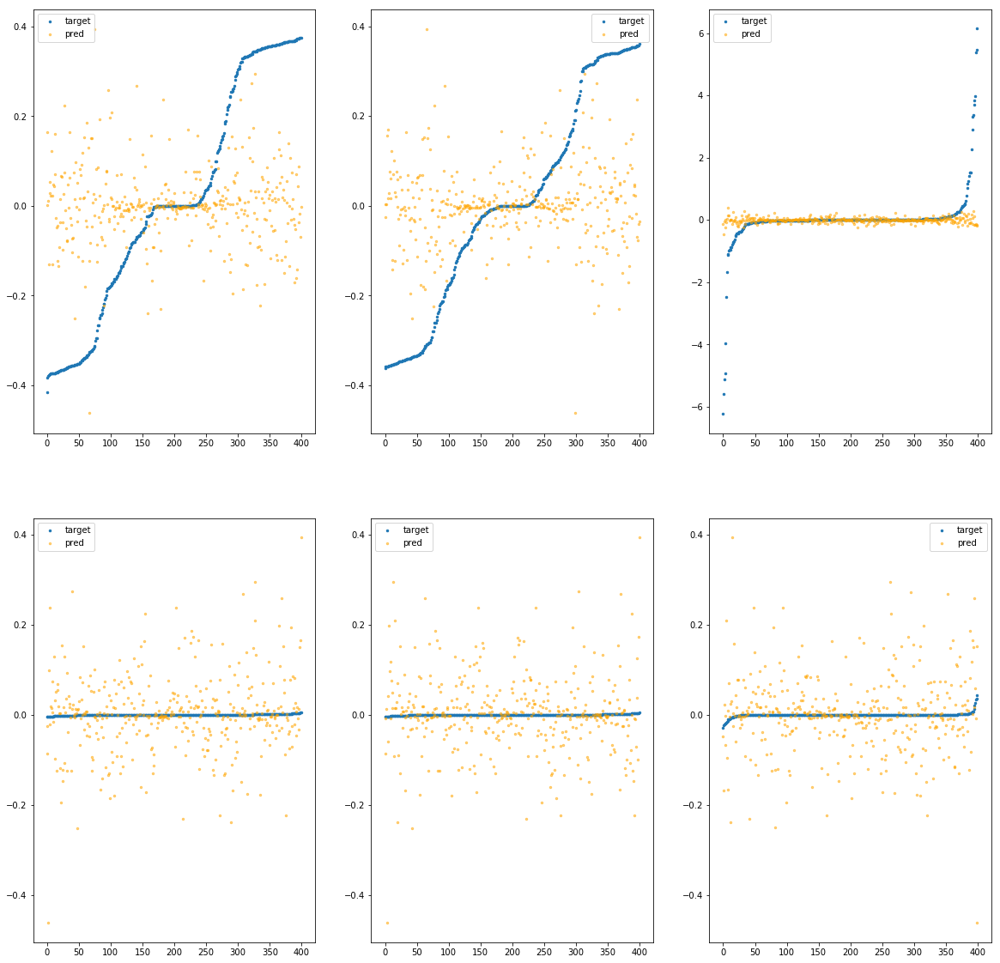

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34340>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.73e-03	4.43e-01	2.06e-01	2.98e+02	6.45e-02	4.17e-03
y		-5.43e-03	3.73e-01	1.88e-01	8.28e+01	5.51e-02	3.04e-03
z		-2.11e-03	6.23e+00	2.79e-01	4.68e+01	8.77e-01	7.69e-01
phi		-3.65e+01	4.19e-02	5.69e-03	7.91e+04	6.99e-05	4.88e-09
theta		-5.50e+01	4.29e-02	5.67e-03	5.42e+04	7.11e-05	5.05e-09
psi		-2.64e+00	5.94e-02	6.10e-03	9.34e+04	8.92e-05	7.96e-09


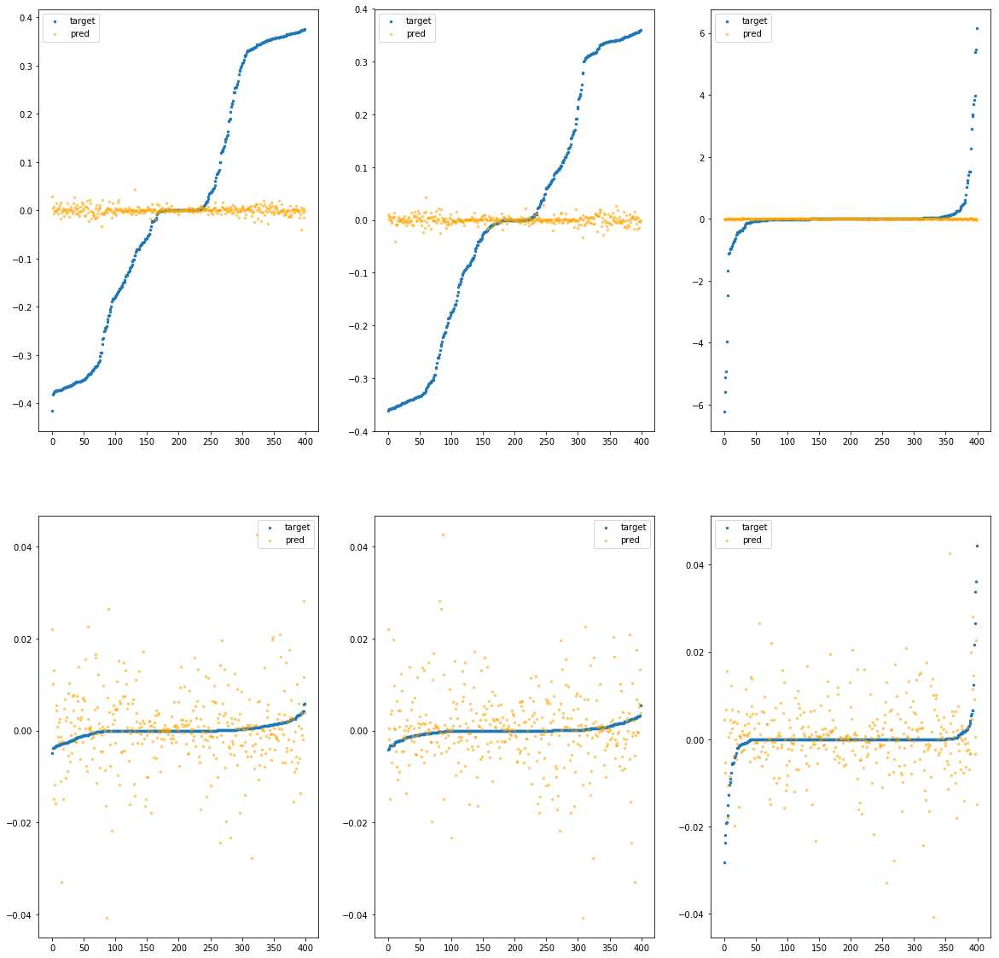

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f343a0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.09e-03	4.61e-01	2.06e-01	8.43e+02	6.46e-02	4.17e-03
y		-1.21e-02	4.22e-01	1.89e-01	2.78e+02	5.55e-02	3.08e-03
z		-4.15e-03	6.24e+00	2.83e-01	1.82e+02	8.78e-01	7.72e-01
phi		-4.00e+02	1.36e-01	1.82e-02	4.22e+05	7.47e-04	5.58e-07
theta		-5.91e+02	1.36e-01	1.81e-02	1.26e+05	7.52e-04	5.66e-07
psi		-3.12e+01	1.35e-01	1.85e-02	3.40e+05	7.89e-04	6.22e-07


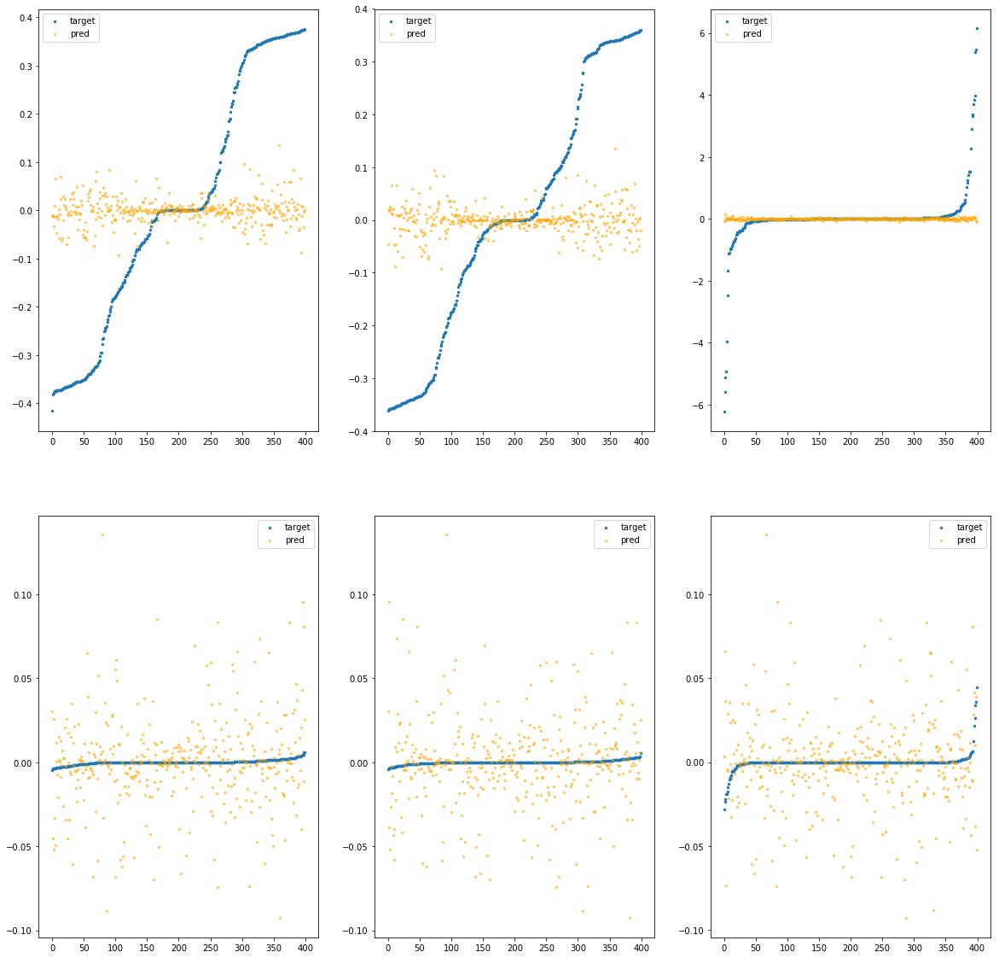

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34400>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.55e-02	8.27e-01	2.10e-01	1.72e+03	6.83e-02	4.67e-03
y		-4.07e-02	8.10e-01	1.91e-01	4.08e+02	5.71e-02	3.26e-03
z		-9.84e-03	6.27e+00	2.89e-01	3.81e+02	8.83e-01	7.81e-01
phi		-1.32e+03	4.93e-01	2.98e-02	7.57e+05	2.46e-03	6.03e-06
theta		-1.94e+03	4.93e-01	2.99e-02	3.88e+05	2.47e-03	6.09e-06
psi		-9.91e+01	4.91e-01	2.98e-02	7.23e+05	2.46e-03	6.03e-06


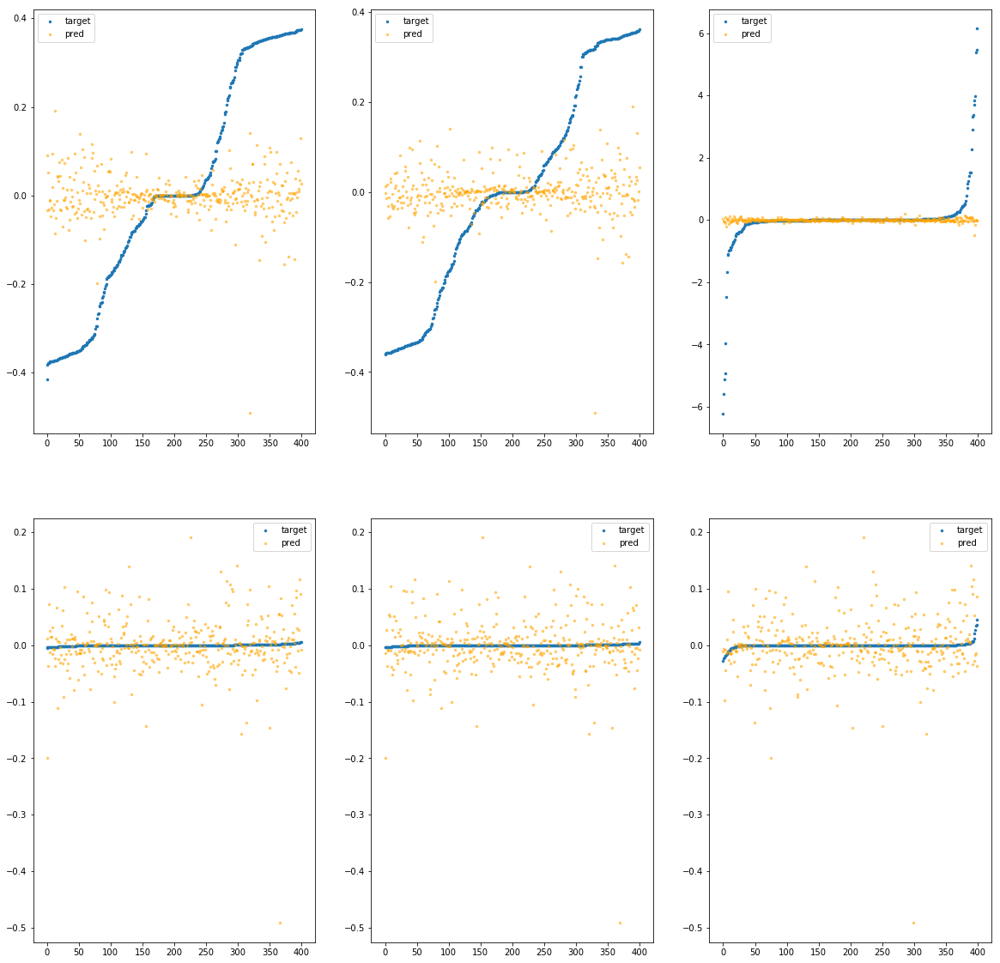

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34460>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.26e-02	6.49e-01	2.11e-01	1.71e+03	6.88e-02	4.73e-03
y		-7.07e-02	6.30e-01	1.93e-01	1.86e+02	5.87e-02	3.45e-03
z		-4.59e-03	6.50e+00	2.99e-01	2.93e+02	8.79e-01	7.72e-01
phi		-2.55e+03	2.78e-01	4.54e-02	5.51e+05	4.74e-03	2.25e-05
theta		-3.73e+03	2.78e-01	4.55e-02	2.94e+05	4.74e-03	2.25e-05
psi		-1.94e+02	2.97e-01	4.56e-02	6.34e+05	4.80e-03	2.30e-05


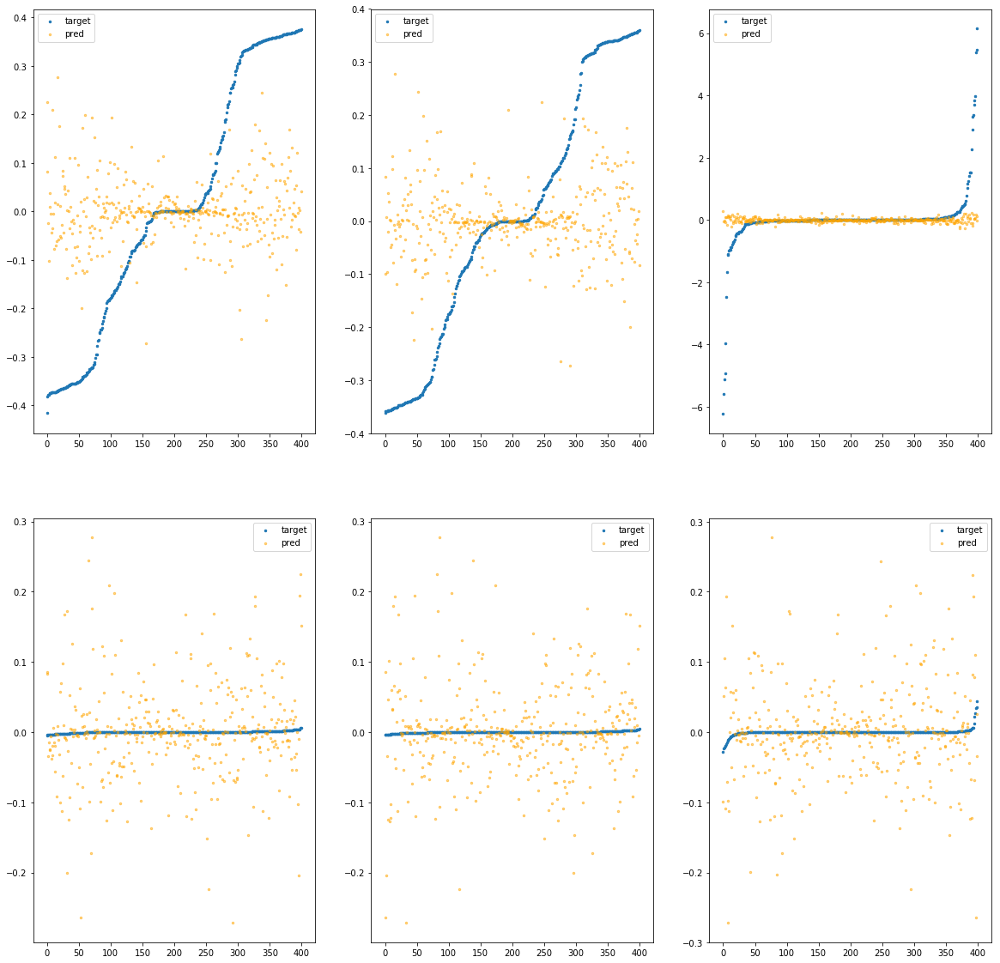

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f344c0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.69e-02	7.11e-01	2.09e-01	2.06e+03	6.84e-02	4.68e-03
y		-7.47e-02	6.97e-01	1.90e-01	6.16e+02	5.89e-02	3.47e-03
z		1.51e-02	6.26e+00	3.01e-01	4.87e+02	8.62e-01	7.42e-01
phi		-4.11e+03	3.84e-01	5.69e-02	7.37e+05	7.66e-03	5.86e-05
theta		-6.03e+03	3.84e-01	5.69e-02	2.20e+05	7.66e-03	5.86e-05
psi		-3.12e+02	3.85e-01	5.69e-02	7.46e+05	7.68e-03	5.90e-05


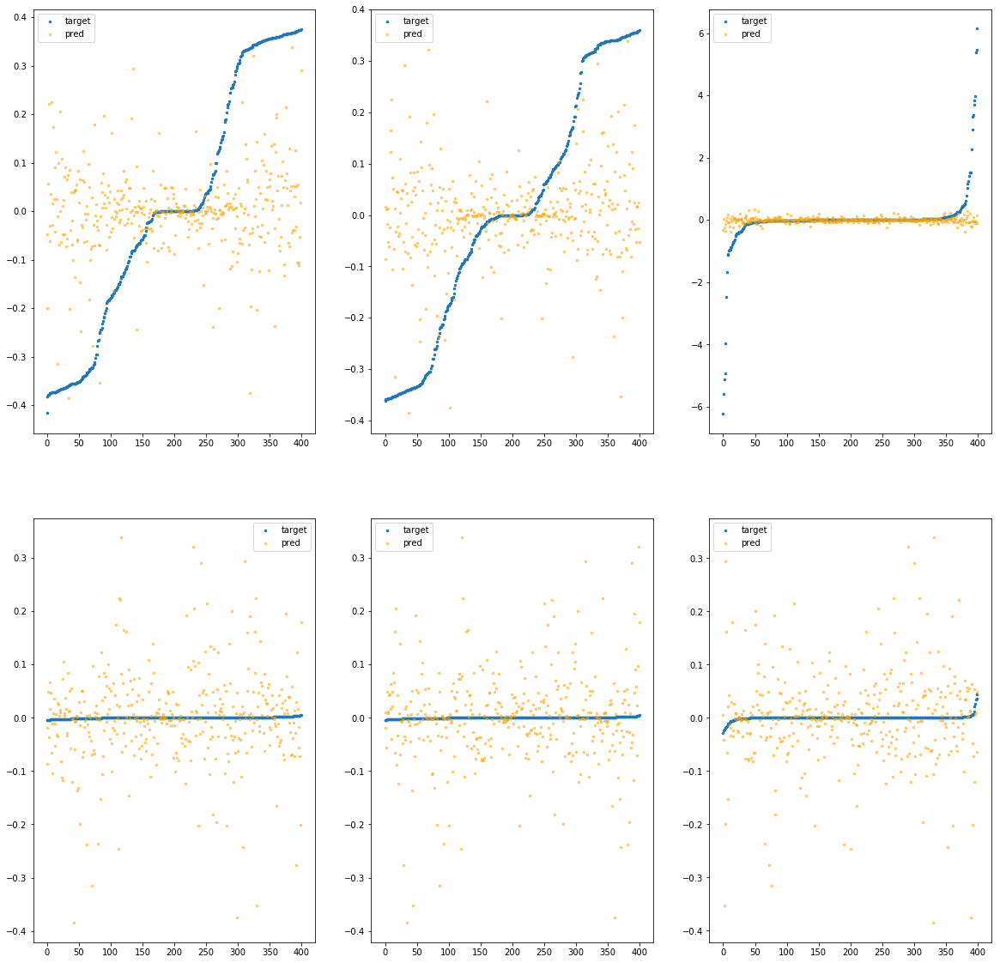

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34520>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.62e-03	4.07e-01	2.06e-01	6.05e+02	6.42e-02	4.12e-03
y		-1.78e-03	3.69e-01	1.88e-01	8.74e+01	5.49e-02	3.02e-03
z		-2.79e-03	6.24e+00	2.78e-01	4.52e+01	8.77e-01	7.70e-01
phi		-1.27e+01	2.12e-02	3.60e-03	2.60e+05	2.56e-05	6.53e-10
theta		-1.87e+01	2.20e-02	3.57e-03	4.33e+04	2.50e-05	6.24e-10
psi		-8.46e-01	4.33e-02	4.26e-03	8.63e+04	4.53e-05	2.05e-09


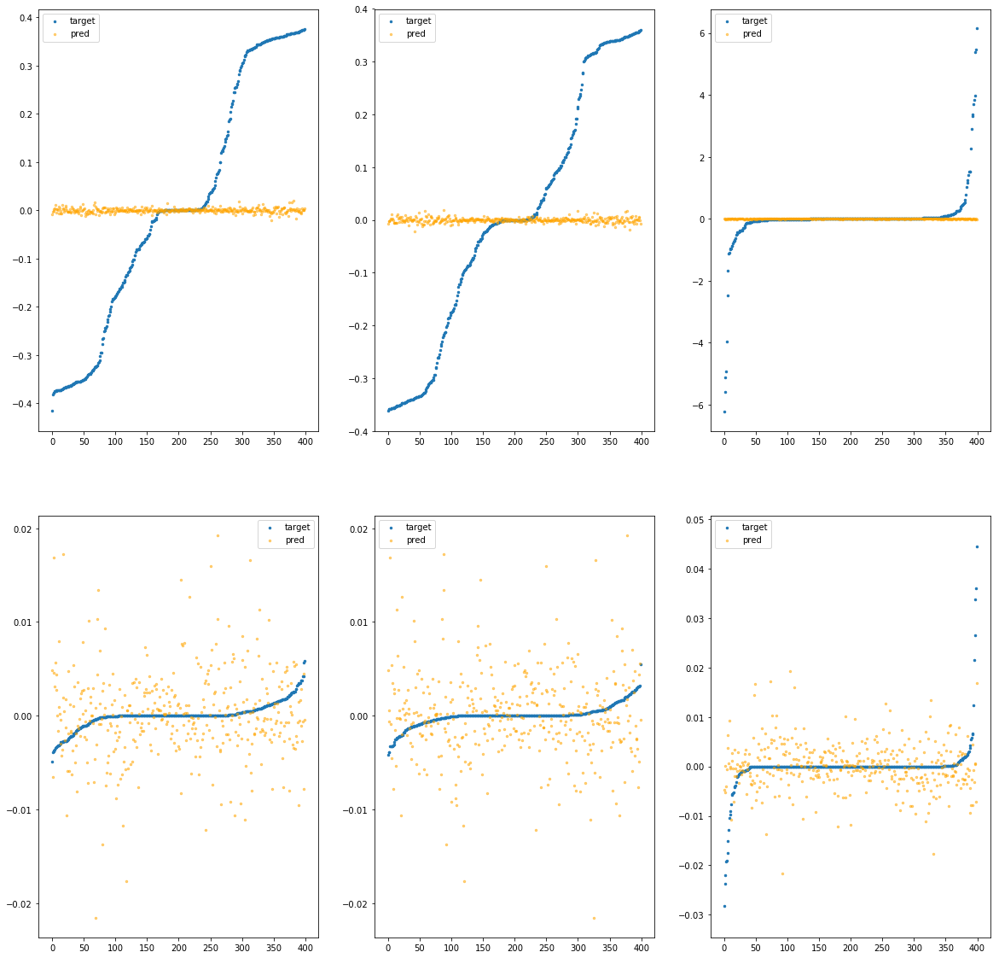

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34580>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.38e-03	4.28e-01	2.07e-01	6.50e+02	6.47e-02	4.19e-03
y		-1.87e-02	4.10e-01	1.90e-01	1.25e+02	5.58e-02	3.12e-03
z		-3.55e-03	6.19e+00	2.80e-01	8.01e+01	8.78e-01	7.71e-01
phi		-1.65e+02	8.48e-02	1.13e-02	3.59e+05	3.09e-04	9.54e-08
theta		-2.43e+02	8.41e-02	1.13e-02	1.16e+05	3.10e-04	9.58e-08
psi		-1.29e+01	8.00e-02	1.16e-02	1.88e+05	3.42e-04	1.17e-07


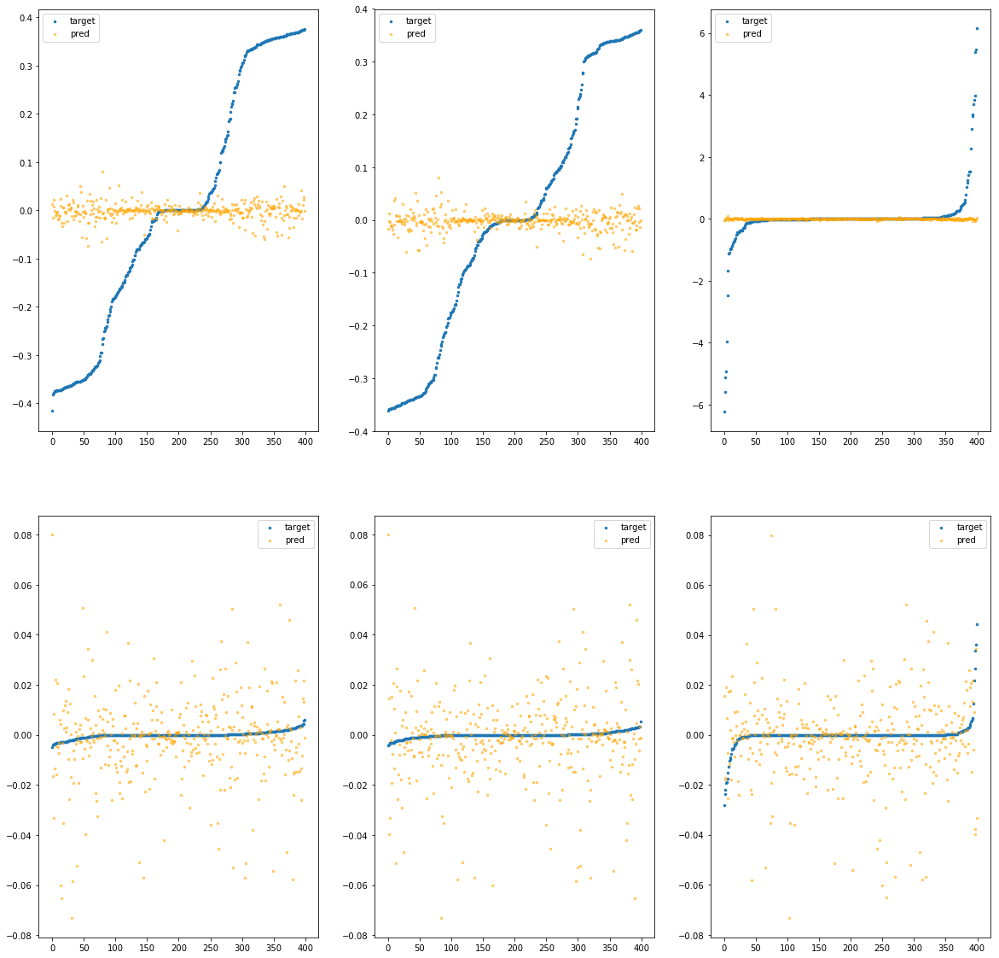

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f345e0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.05e-03	4.78e-01	2.06e-01	8.89e+02	6.46e-02	4.17e-03
y		1.15e-02	4.38e-01	1.87e-01	1.88e+02	5.42e-02	2.94e-03
z		5.33e-03	6.18e+00	2.80e-01	1.53e+02	8.70e-01	7.57e-01
phi		-3.61e+02	1.34e-01	1.67e-02	3.39e+05	6.74e-04	4.55e-07
theta		-5.31e+02	1.34e-01	1.66e-02	2.23e+05	6.76e-04	4.57e-07
psi		-2.88e+01	1.34e-01	1.74e-02	3.28e+05	7.31e-04	5.35e-07


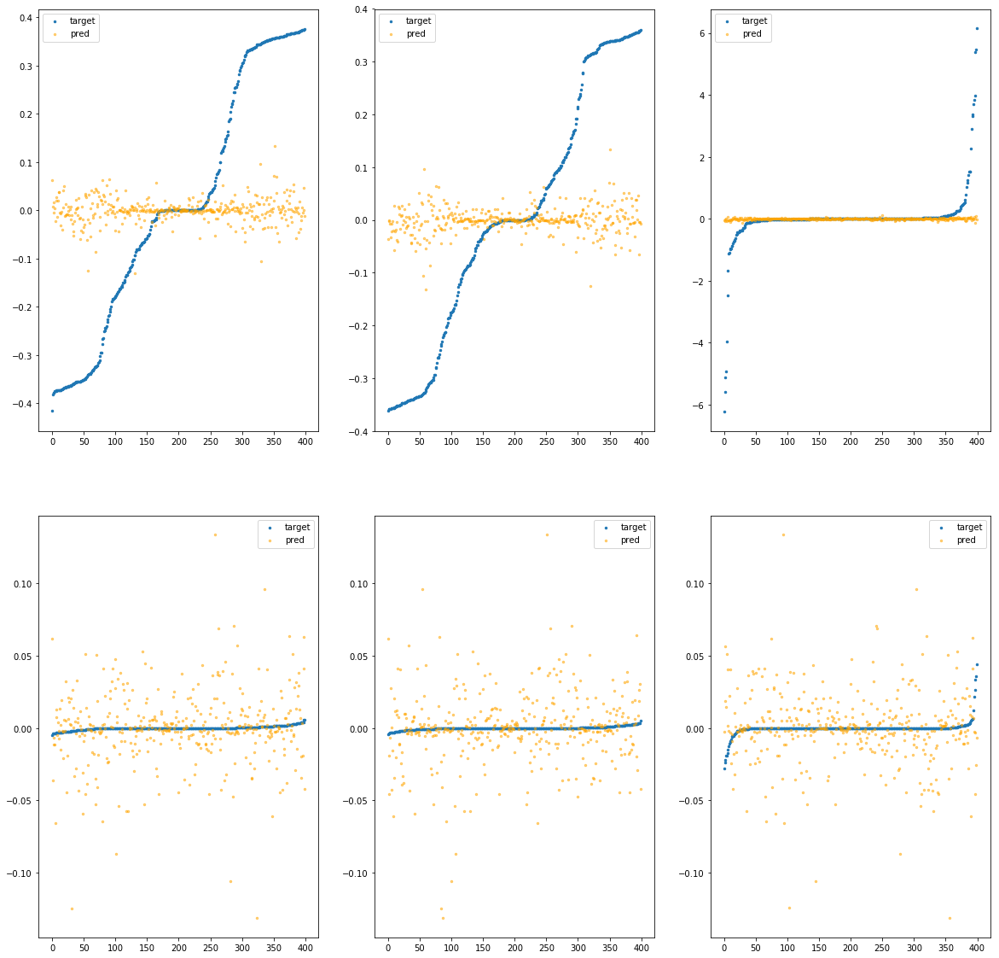

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f34640>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.95e-02	5.58e-01	2.10e-01	1.41e+03	6.66e-02	4.44e-03
y		-9.30e-02	5.45e-01	1.96e-01	6.52e+02	5.99e-02	3.59e-03
z		3.95e-03	6.21e+00	2.89e-01	4.12e+02	8.71e-01	7.59e-01
phi		-1.32e+03	2.08e-01	3.31e-02	5.48e+05	2.46e-03	6.06e-06
theta		-1.93e+03	2.08e-01	3.29e-02	4.84e+05	2.45e-03	5.99e-06
psi		-1.01e+02	2.08e-01	3.33e-02	6.12e+05	2.51e-03	6.30e-06


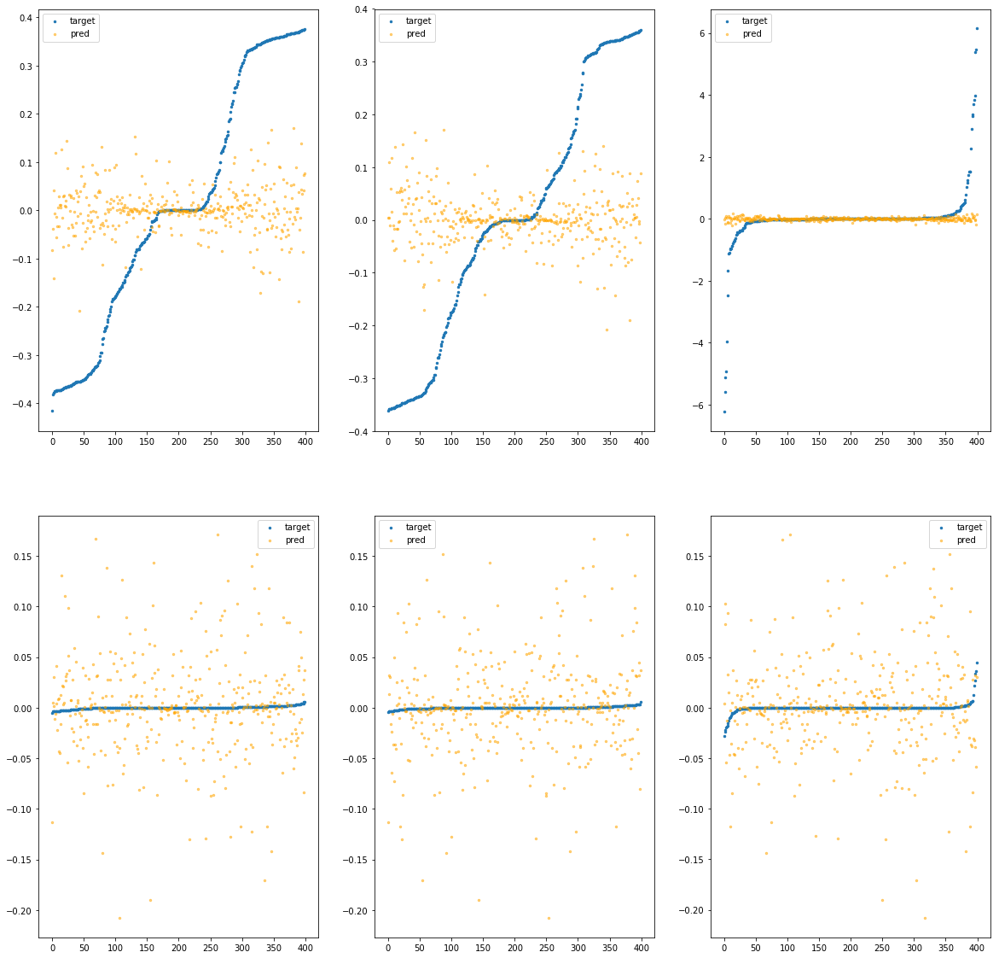

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f346a0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.78e-02	6.97e-01	2.12e-01	1.91e+03	6.91e-02	4.78e-03
y		-9.25e-02	7.65e-01	1.92e-01	4.24e+02	5.99e-02	3.59e-03
z		1.12e-04	6.19e+00	2.93e-01	4.03e+02	8.75e-01	7.65e-01
phi		-2.75e+03	4.16e-01	4.46e-02	5.81e+05	5.11e-03	2.61e-05
theta		-4.03e+03	4.16e-01	4.47e-02	2.98e+05	5.12e-03	2.62e-05
psi		-2.11e+02	4.16e-01	4.50e-02	1.03e+06	5.20e-03	2.70e-05


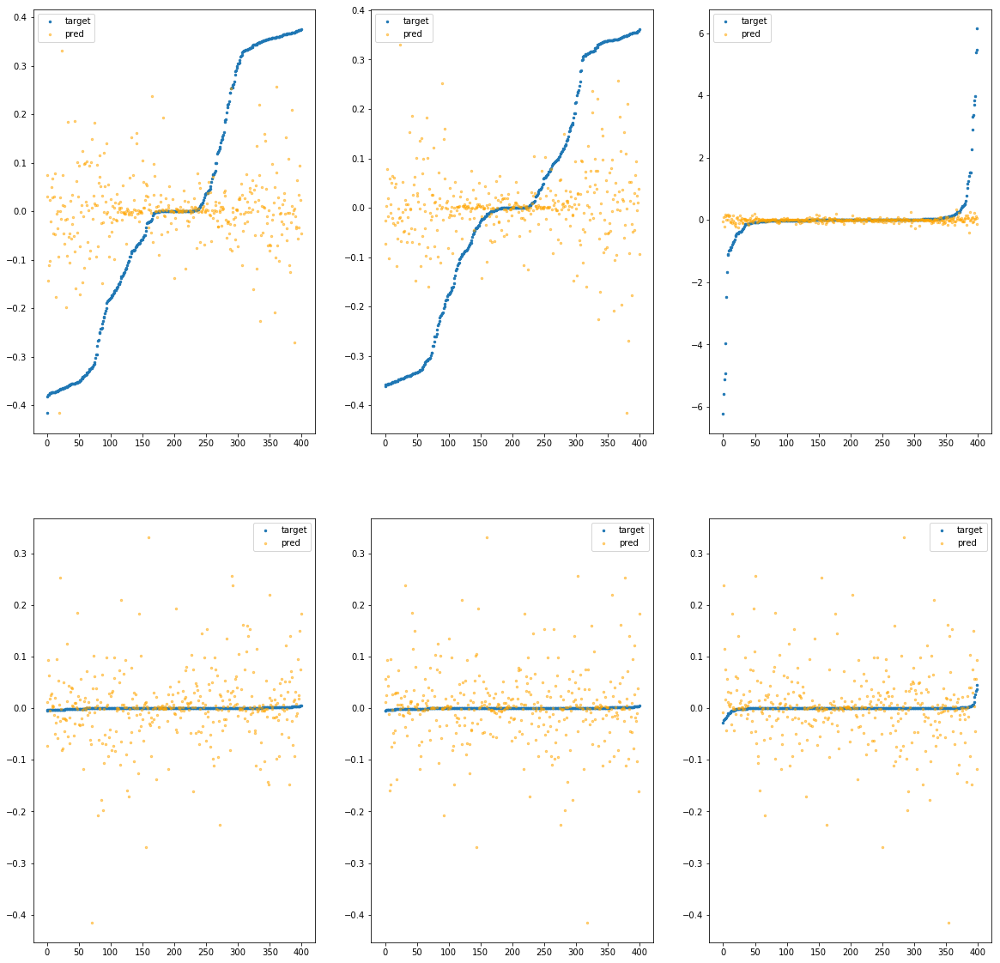

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34700>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.90e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.40e+01	5.49e-02	3.01e-03
z		-9.74e-04	6.23e+00	2.77e-01	7.62e+00	8.76e-01	7.67e-01
phi		-2.55e-02	6.06e-03	8.55e-04	3.75e+04	1.91e-06	3.64e-12
theta		-2.36e-02	5.62e-03	7.04e-04	1.35e+04	1.30e-06	1.69e-12
psi		-6.74e-04	4.46e-02	1.37e-03	4.37e+03	2.45e-05	6.03e-10


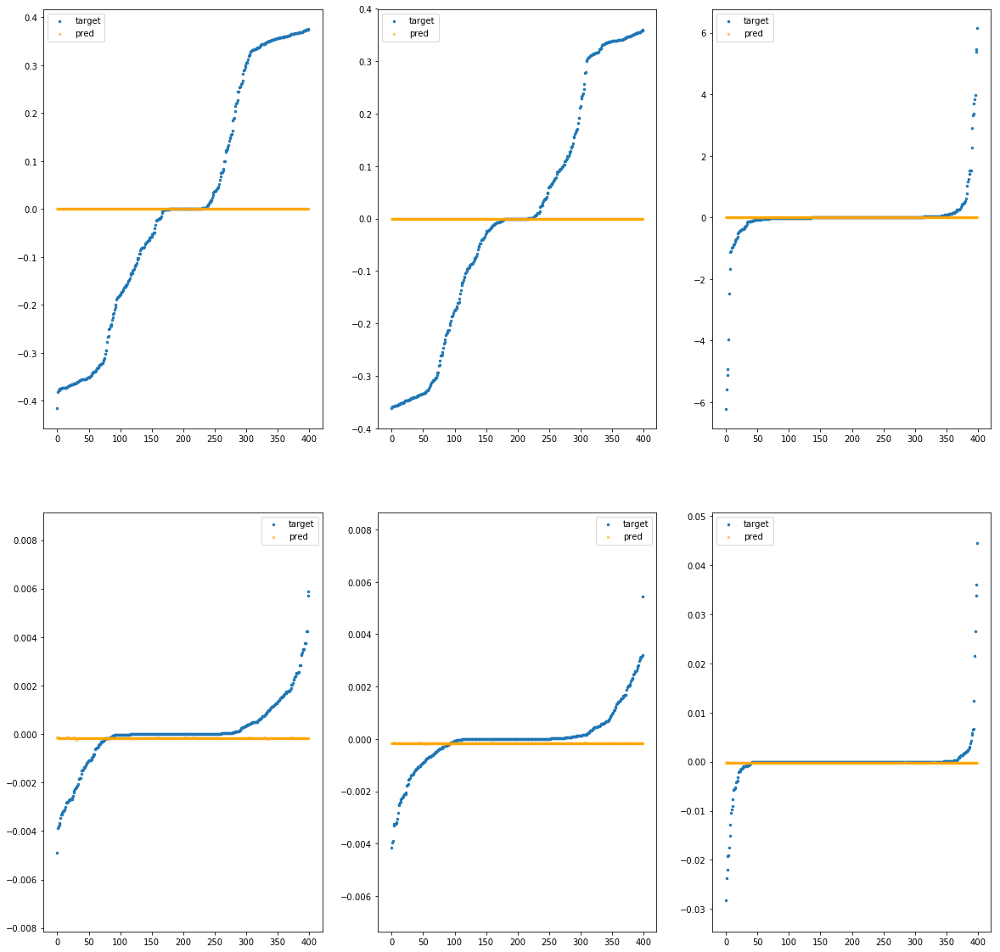

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34760>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.88e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.26e+01	5.49e-02	3.01e-03
z		-9.68e-04	6.23e+00	2.77e-01	6.92e+00	8.76e-01	7.67e-01
phi		-2.19e-02	6.02e-03	8.45e-04	3.36e+04	1.90e-06	3.62e-12
theta		-1.78e-02	5.59e-03	6.95e-04	1.21e+04	1.29e-06	1.67e-12
psi		-1.57e-03	4.47e-02	1.36e-03	3.90e+03	2.46e-05	6.04e-10


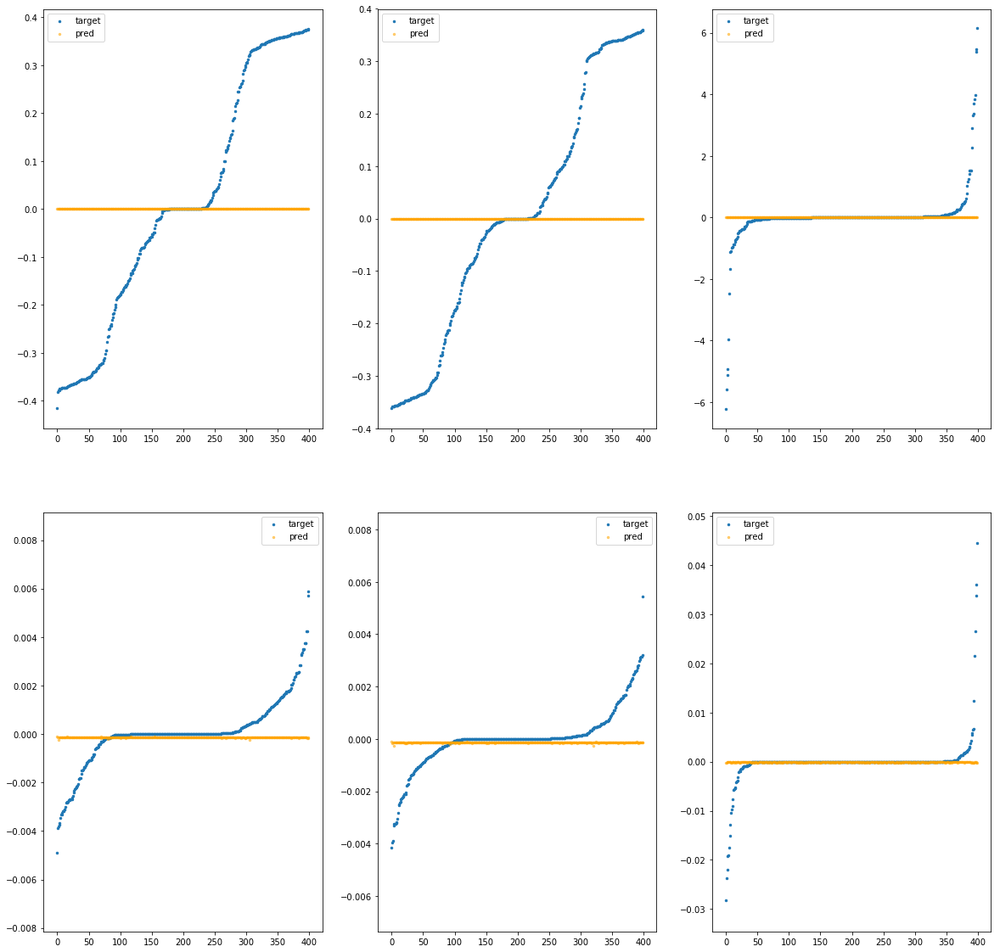

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f347c0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.11e-03	4.15e-01	2.05e-01	9.54e+01	6.43e-02	4.13e-03
y		-1.07e-03	3.61e-01	1.88e-01	1.35e+01	5.49e-02	3.01e-03
z		-9.85e-04	6.22e+00	2.77e-01	7.45e+00	8.76e-01	7.67e-01
phi		-6.35e-02	6.18e-03	8.71e-04	3.61e+04	1.98e-06	3.92e-12
theta		-5.41e-02	5.35e-03	7.15e-04	1.31e+04	1.34e-06	1.79e-12
psi		1.32e-02	4.31e-02	1.38e-03	4.35e+03	2.42e-05	5.86e-10


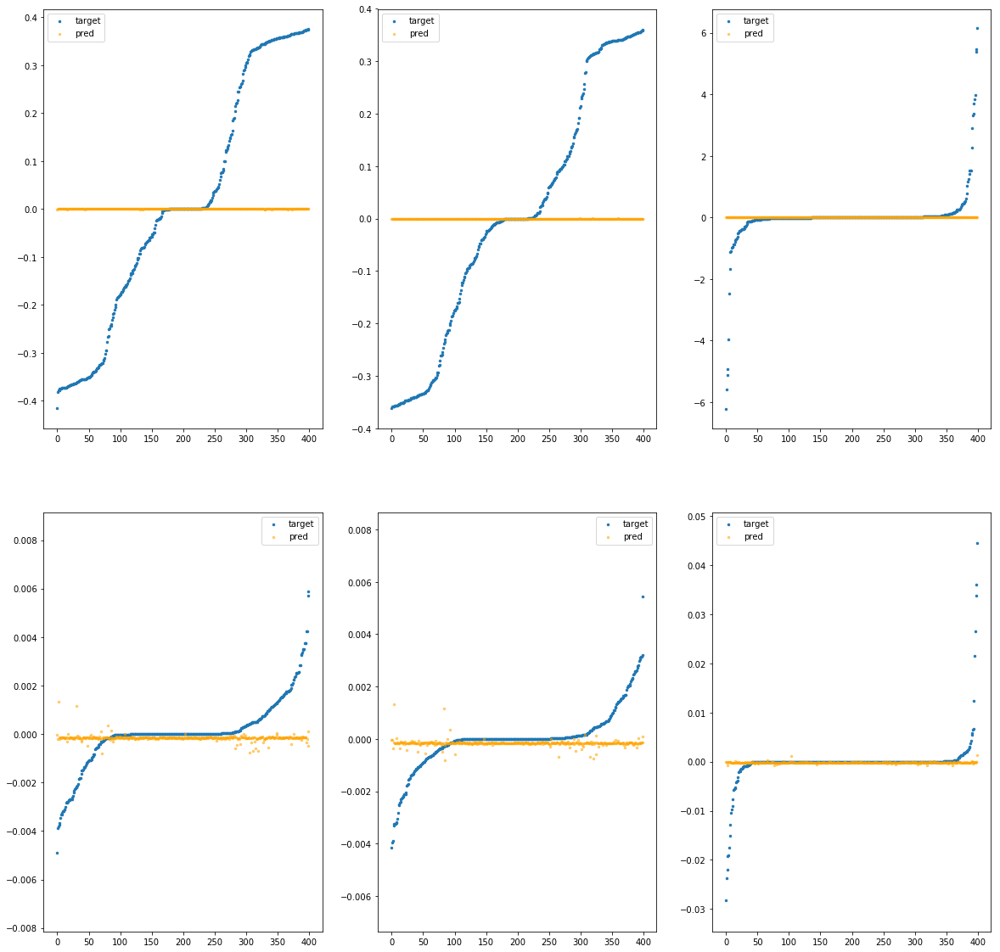

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34820>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.16e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.30e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.12e+00	8.76e-01	7.67e-01
phi		-2.27e-02	6.03e-03	8.48e-04	3.47e+04	1.90e-06	3.62e-12
theta		-2.03e-02	5.60e-03	6.98e-04	1.25e+04	1.30e-06	1.68e-12
psi		-6.04e-04	4.46e-02	1.36e-03	4.05e+03	2.45e-05	6.02e-10


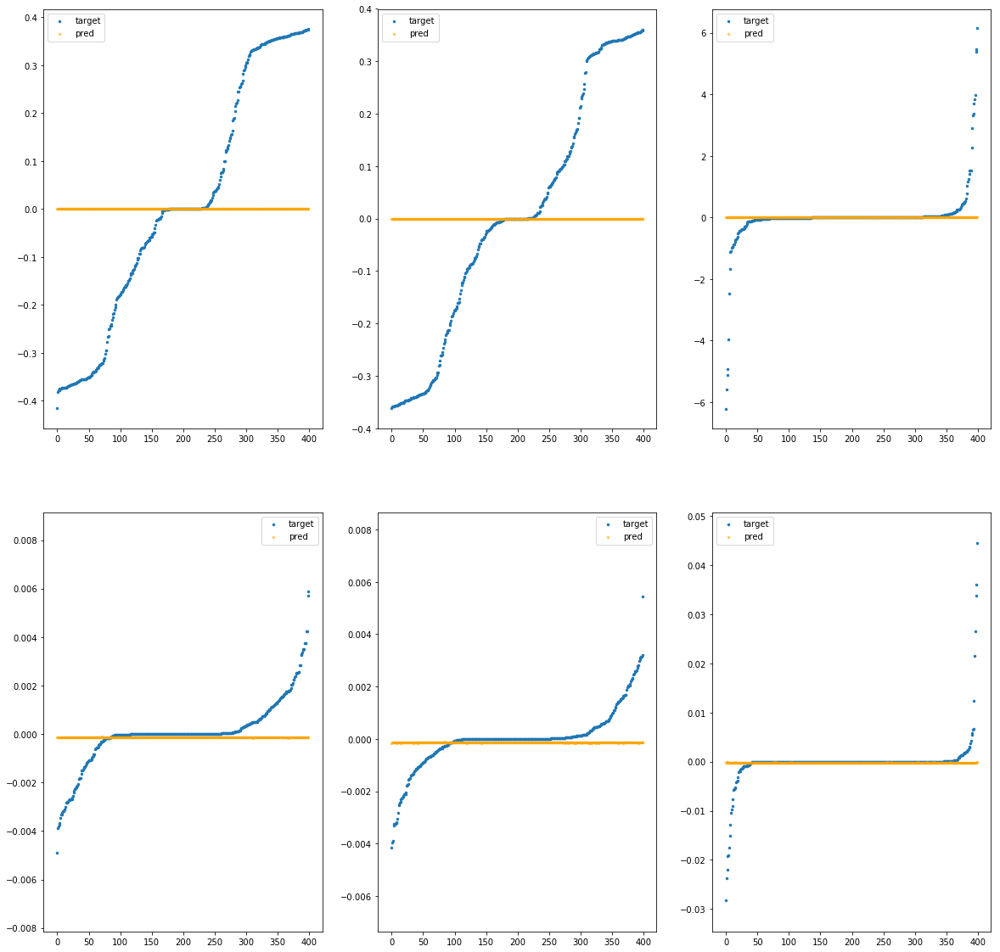

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34880>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.00e-03	4.15e-01	2.05e-01	9.30e+01	6.42e-02	4.13e-03
y		-1.19e-03	3.61e-01	1.88e-01	1.32e+01	5.49e-02	3.01e-03
z		-8.66e-04	6.23e+00	2.77e-01	7.21e+00	8.76e-01	7.67e-01
phi		-2.39e-02	6.04e-03	8.54e-04	3.53e+04	1.91e-06	3.63e-12
theta		-5.35e-04	5.60e-03	6.95e-04	1.27e+04	1.27e-06	1.61e-12
psi		-3.15e-03	4.51e-02	1.37e-03	4.14e+03	2.46e-05	6.06e-10


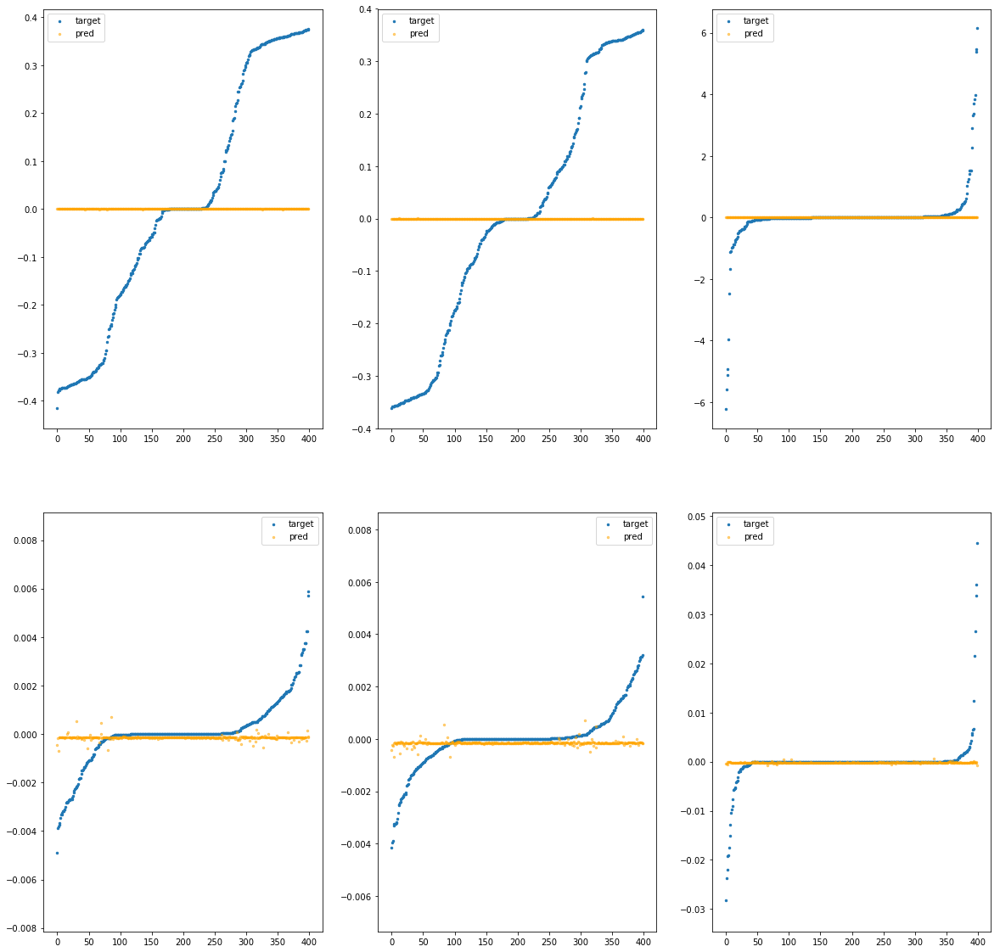

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f348e0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.06e-03	4.15e-01	2.05e-01	8.84e+01	6.42e-02	4.13e-03
y		-1.04e-03	3.61e-01	1.88e-01	1.21e+01	5.49e-02	3.01e-03
z		-1.03e-03	6.23e+00	2.77e-01	6.97e+00	8.76e-01	7.67e-01
phi		-1.98e-02	6.02e-03	8.44e-04	3.34e+04	1.90e-06	3.60e-12
theta		-4.30e-03	5.04e-03	6.93e-04	1.18e+04	1.28e-06	1.63e-12
psi		-1.75e-02	4.56e-02	1.37e-03	3.83e+03	2.50e-05	6.23e-10


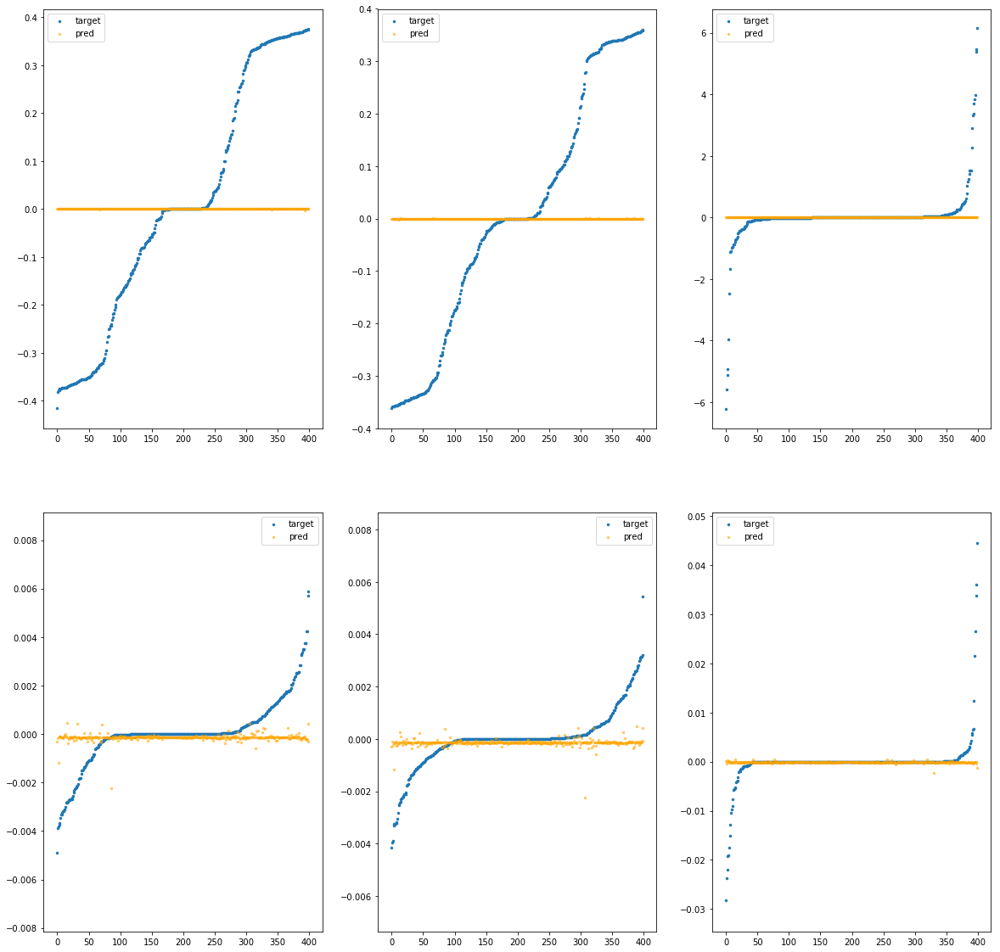

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34940>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.17e-03	4.15e-01	2.05e-01	8.87e+01	6.43e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.27e+01	5.49e-02	3.01e-03
z		-8.96e-04	6.23e+00	2.77e-01	6.87e+00	8.76e-01	7.67e-01
phi		-1.92e-02	5.93e-03	8.55e-04	3.38e+04	1.90e-06	3.60e-12
theta		-8.81e-03	5.29e-03	7.05e-04	1.22e+04	1.28e-06	1.64e-12
psi		-9.12e-03	4.57e-02	1.38e-03	4.16e+03	2.48e-05	6.13e-10


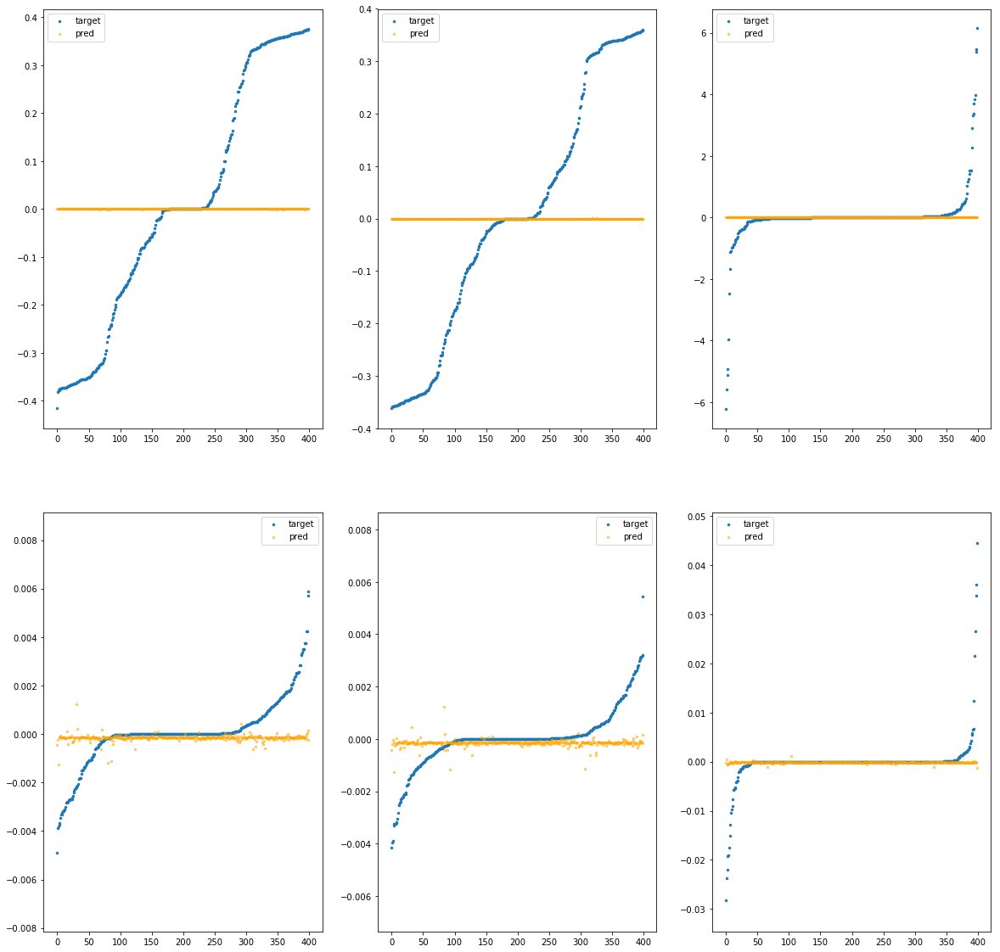

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f349a0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.46e-03	4.18e-01	2.05e-01	7.82e+01	6.43e-02	4.13e-03
y		-7.44e-04	3.61e-01	1.88e-01	1.22e+01	5.49e-02	3.01e-03
z		-9.90e-04	6.22e+00	2.77e-01	6.38e+00	8.76e-01	7.67e-01
phi		-1.42e-01	6.34e-03	8.98e-04	2.94e+04	2.12e-06	4.52e-12
theta		-2.43e-01	5.61e-03	7.70e-04	1.08e+04	1.58e-06	2.49e-12
psi		-1.09e-02	4.28e-02	1.44e-03	4.36e+03	2.48e-05	6.15e-10


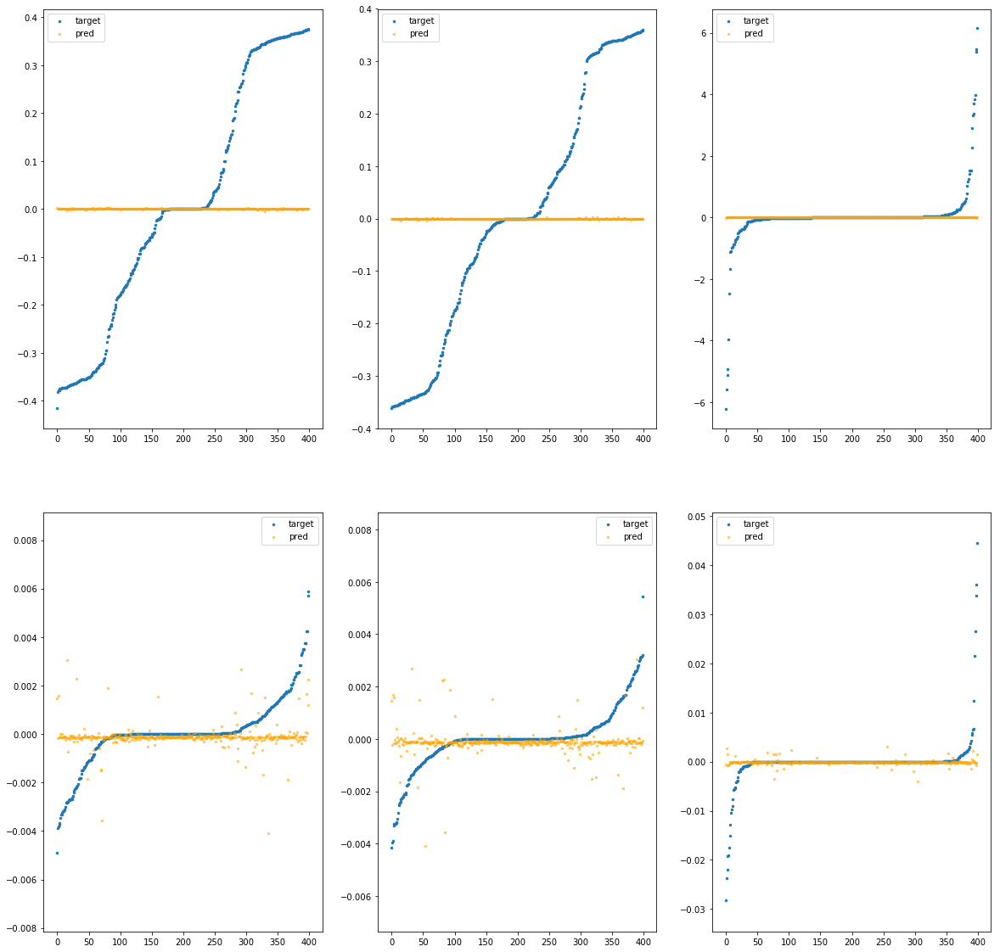

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34a00>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-03	4.15e-01	2.05e-01	9.52e+01	6.42e-02	4.13e-03
y		-1.18e-03	3.61e-01	1.88e-01	1.32e+01	5.49e-02	3.01e-03
z		-9.75e-04	6.23e+00	2.77e-01	7.30e+00	8.76e-01	7.67e-01
phi		-3.14e-02	5.94e-03	8.56e-04	3.60e+04	1.92e-06	3.69e-12
theta		-6.91e-02	5.51e-03	7.21e-04	1.29e+04	1.36e-06	1.84e-12
psi		-1.63e-02	4.60e-02	1.40e-03	4.09e+03	2.49e-05	6.22e-10


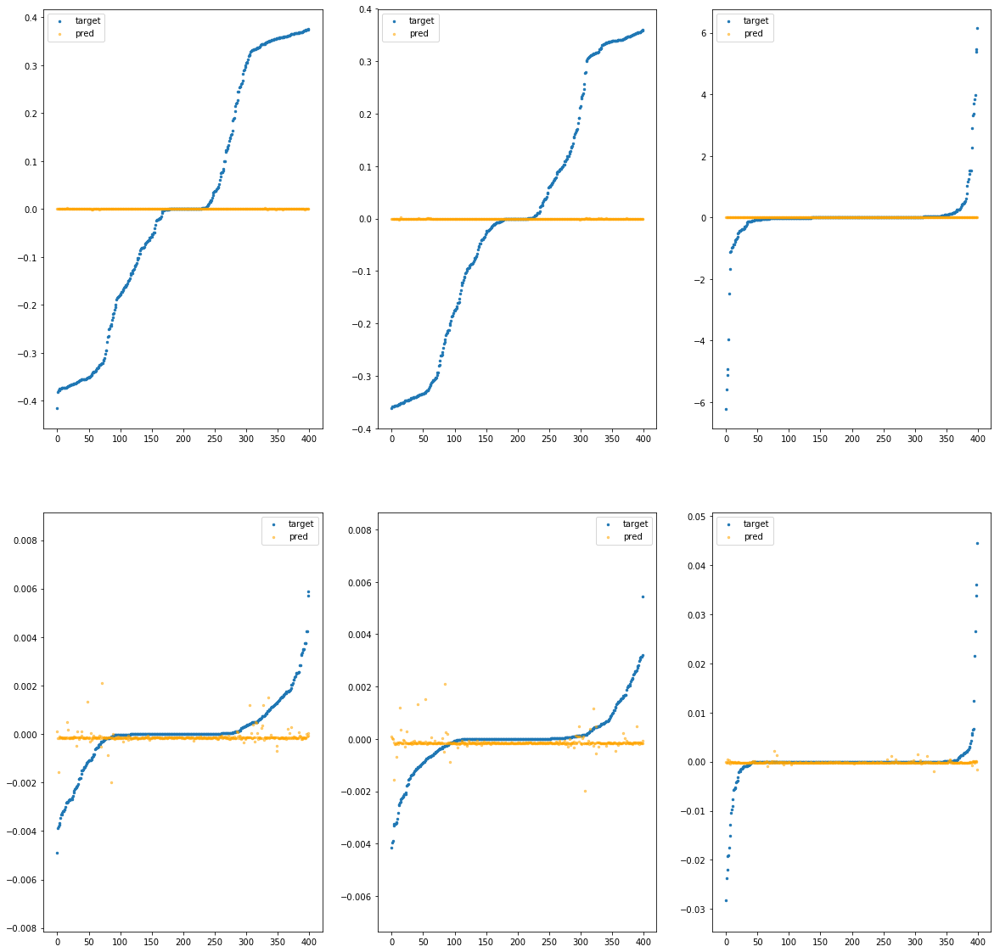

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34a60>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.25e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.31e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.16e+00	8.76e-01	7.67e-01
phi		-2.01e-02	6.01e-03	8.47e-04	3.50e+04	1.90e-06	3.61e-12
theta		-1.84e-02	5.57e-03	6.98e-04	1.26e+04	1.29e-06	1.67e-12
psi		-1.40e-03	4.46e-02	1.36e-03	4.10e+03	2.46e-05	6.03e-10


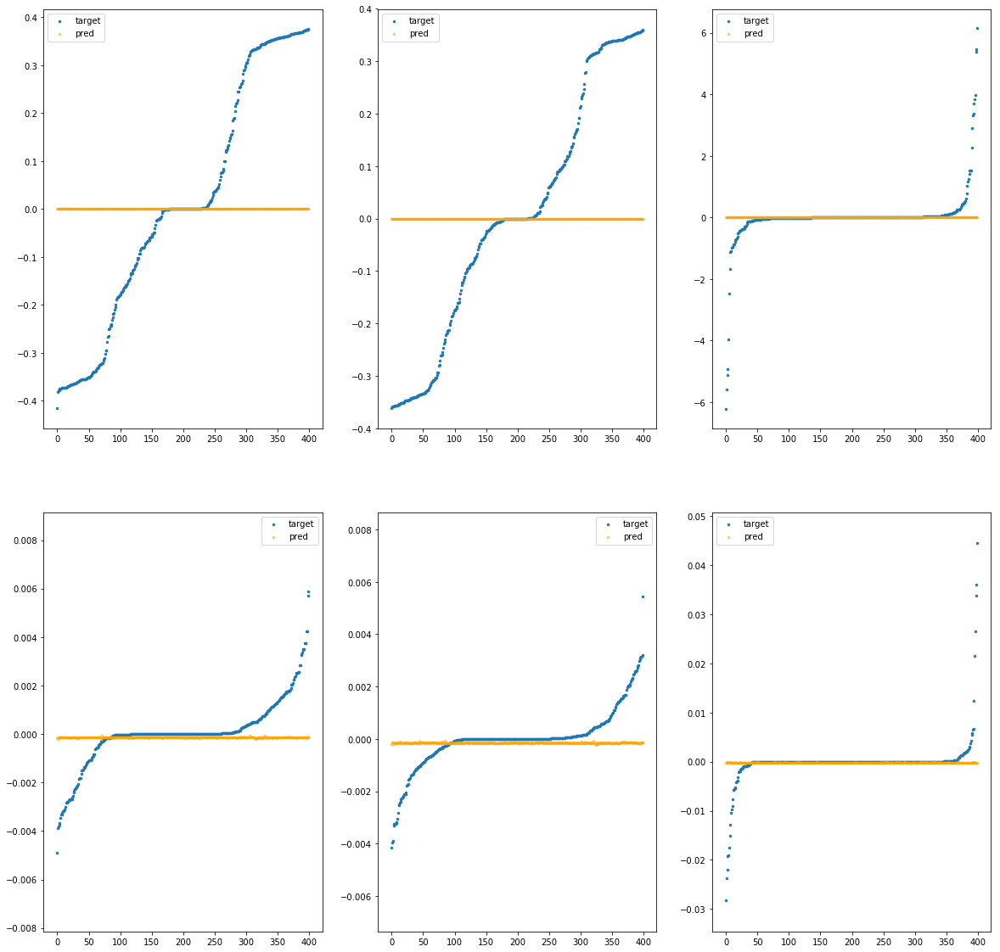

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34ac0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.12e-03	4.14e-01	2.05e-01	9.21e+01	6.43e-02	4.13e-03
y		-1.11e-03	3.61e-01	1.88e-01	1.23e+01	5.49e-02	3.01e-03
z		-1.06e-03	6.23e+00	2.77e-01	7.30e+00	8.76e-01	7.67e-01
phi		-3.77e-02	6.54e-03	8.65e-04	3.44e+04	1.93e-06	3.73e-12
theta		-7.09e-02	5.41e-03	7.35e-04	1.25e+04	1.36e-06	1.85e-12
psi		-2.46e-02	4.56e-02	1.41e-03	4.43e+03	2.51e-05	6.32e-10


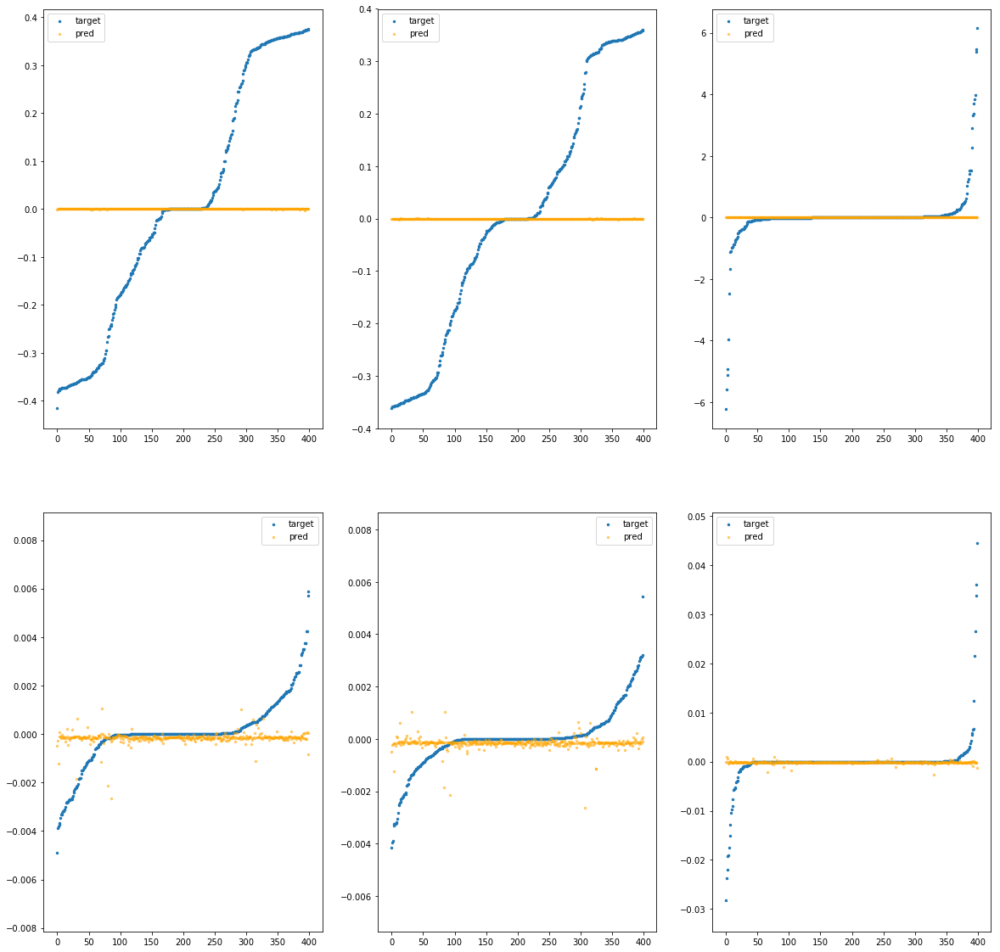

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34b20>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.00e-03	4.15e-01	2.05e-01	9.42e+01	6.42e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.35e+01	5.49e-02	3.01e-03
z		-9.13e-04	6.23e+00	2.77e-01	7.39e+00	8.76e-01	7.67e-01
phi		-1.44e-02	6.10e-03	8.46e-04	3.57e+04	1.89e-06	3.56e-12
theta		-2.22e-02	5.67e-03	7.01e-04	1.31e+04	1.30e-06	1.69e-12
psi		-8.55e-03	4.52e-02	1.37e-03	4.40e+03	2.47e-05	6.12e-10


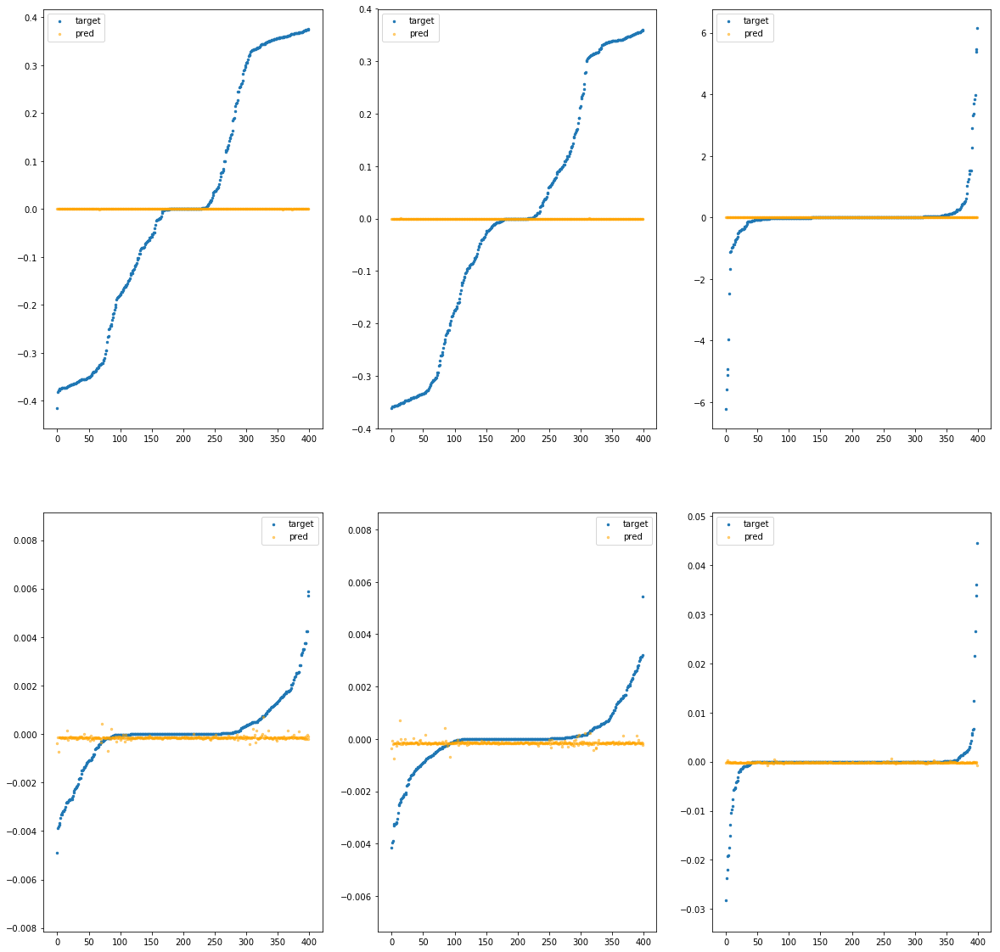

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34b80>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.96e-03	4.15e-01	2.05e-01	8.71e+01	6.42e-02	4.13e-03
y		-1.08e-03	3.61e-01	1.88e-01	1.26e+01	5.49e-02	3.01e-03
z		-9.97e-04	6.23e+00	2.77e-01	6.81e+00	8.76e-01	7.67e-01
phi		-1.24e-02	6.08e-03	8.42e-04	3.30e+04	1.88e-06	3.55e-12
theta		-3.64e-02	5.45e-03	7.03e-04	1.19e+04	1.32e-06	1.73e-12
psi		1.10e-02	4.38e-02	1.37e-03	3.95e+03	2.43e-05	5.89e-10


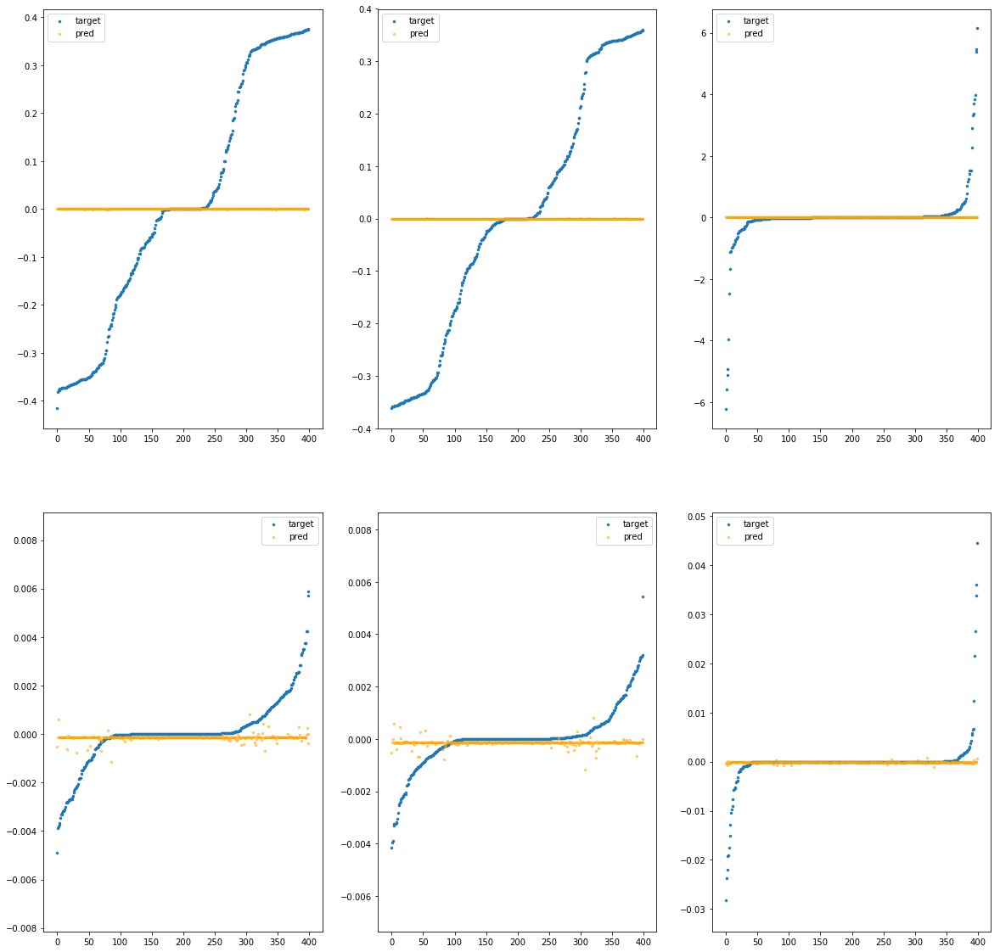

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34be0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.15e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.30e+01	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	7.11e+00	8.76e-01	7.67e-01
phi		-2.30e-02	6.04e-03	8.48e-04	3.46e+04	1.90e-06	3.63e-12
theta		-2.04e-02	5.60e-03	6.97e-04	1.25e+04	1.30e-06	1.68e-12
psi		-5.67e-04	4.46e-02	1.36e-03	4.04e+03	2.45e-05	6.02e-10


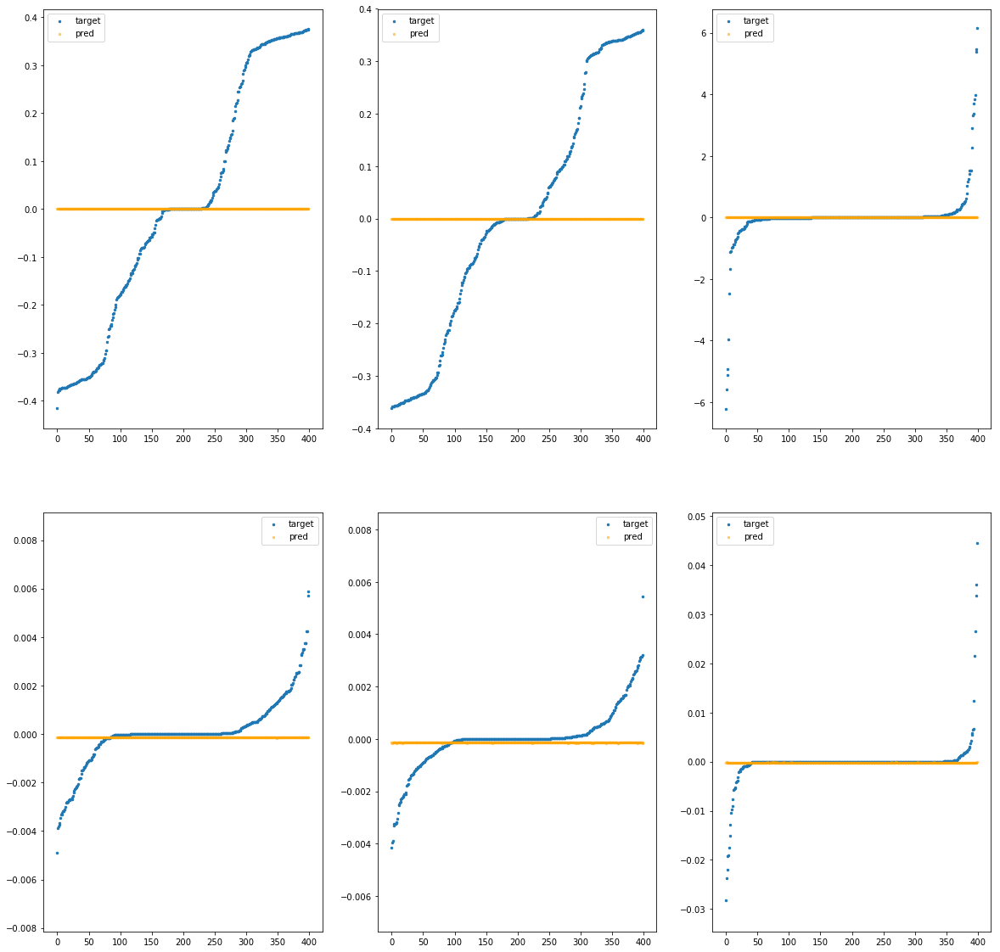

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34c40>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.18e+01	6.42e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.30e+01	5.49e-02	3.01e-03
z		-9.79e-04	6.23e+00	2.77e-01	7.11e+00	8.76e-01	7.67e-01
phi		-2.33e-02	6.04e-03	8.48e-04	3.48e+04	1.90e-06	3.63e-12
theta		-2.22e-02	5.61e-03	6.98e-04	1.25e+04	1.30e-06	1.69e-12
psi		-1.45e-04	4.45e-02	1.36e-03	4.02e+03	2.45e-05	6.02e-10


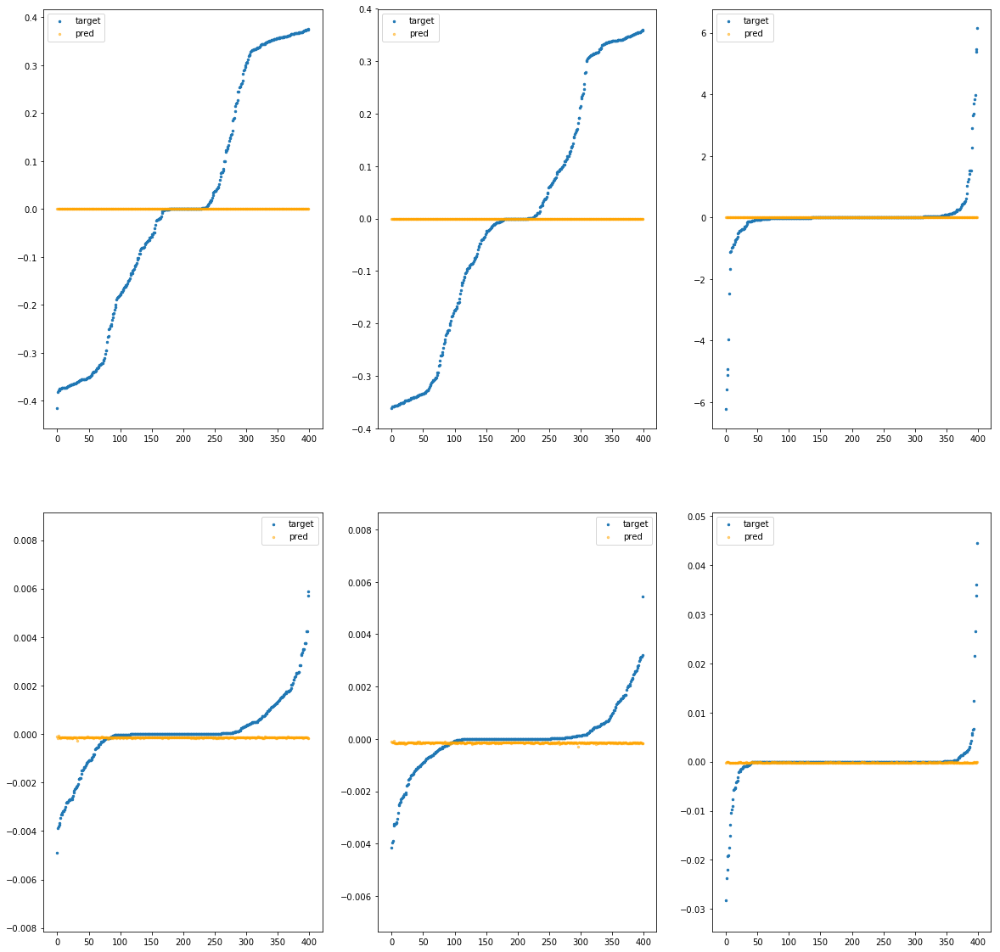

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34ca0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.64e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.37e+01	5.49e-02	3.01e-03
z		-9.64e-04	6.23e+00	2.77e-01	7.46e+00	8.76e-01	7.67e-01
phi		-2.25e-02	6.04e-03	8.50e-04	3.65e+04	1.90e-06	3.62e-12
theta		-2.19e-02	5.60e-03	7.02e-04	1.32e+04	1.30e-06	1.68e-12
psi		-2.94e-03	4.47e-02	1.37e-03	4.28e+03	2.46e-05	6.05e-10


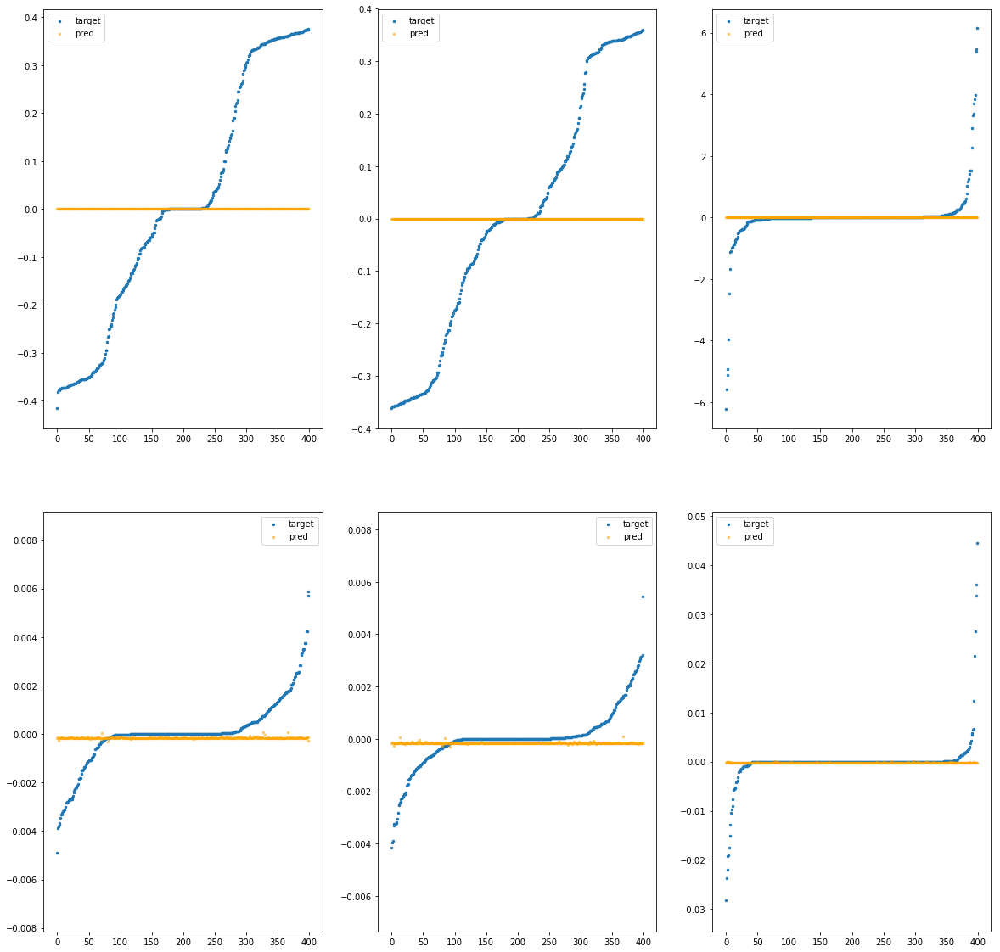

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34d00>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.51e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.21e+01	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	6.64e+00	8.76e-01	7.67e-01
phi		-2.13e-02	6.04e-03	8.42e-04	3.22e+04	1.90e-06	3.61e-12
theta		-1.84e-02	5.61e-03	6.92e-04	1.16e+04	1.29e-06	1.67e-12
psi		-1.07e-03	4.46e-02	1.35e-03	3.72e+03	2.46e-05	6.03e-10


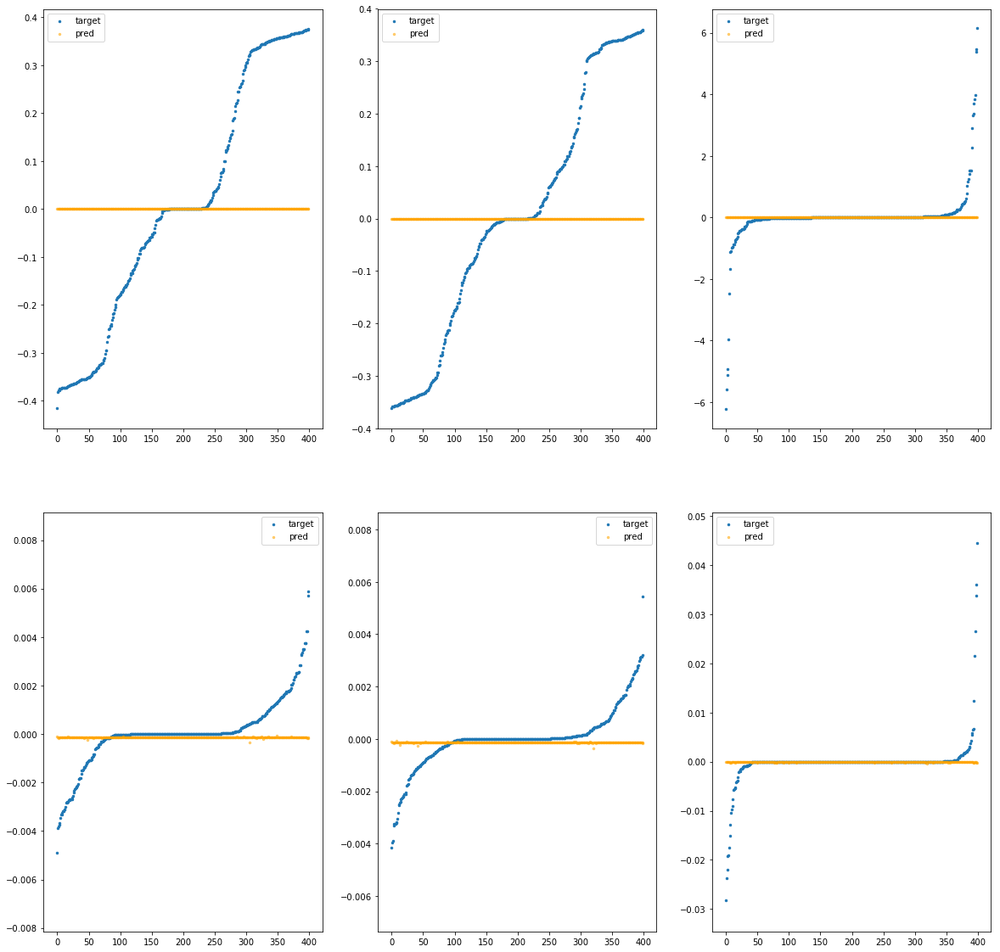

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34d60>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.07e-03	4.15e-01	2.05e-01	8.65e+01	6.42e-02	4.13e-03
y		-1.05e-03	3.61e-01	1.88e-01	1.28e+01	5.49e-02	3.01e-03
z		-9.79e-04	6.23e+00	2.77e-01	7.01e+00	8.76e-01	7.67e-01
phi		-3.57e-02	6.26e-03	8.57e-04	3.28e+04	1.93e-06	3.72e-12
theta		-4.53e-02	5.83e-03	7.05e-04	1.21e+04	1.33e-06	1.76e-12
psi		3.95e-04	4.38e-02	1.37e-03	4.16e+03	2.45e-05	6.01e-10


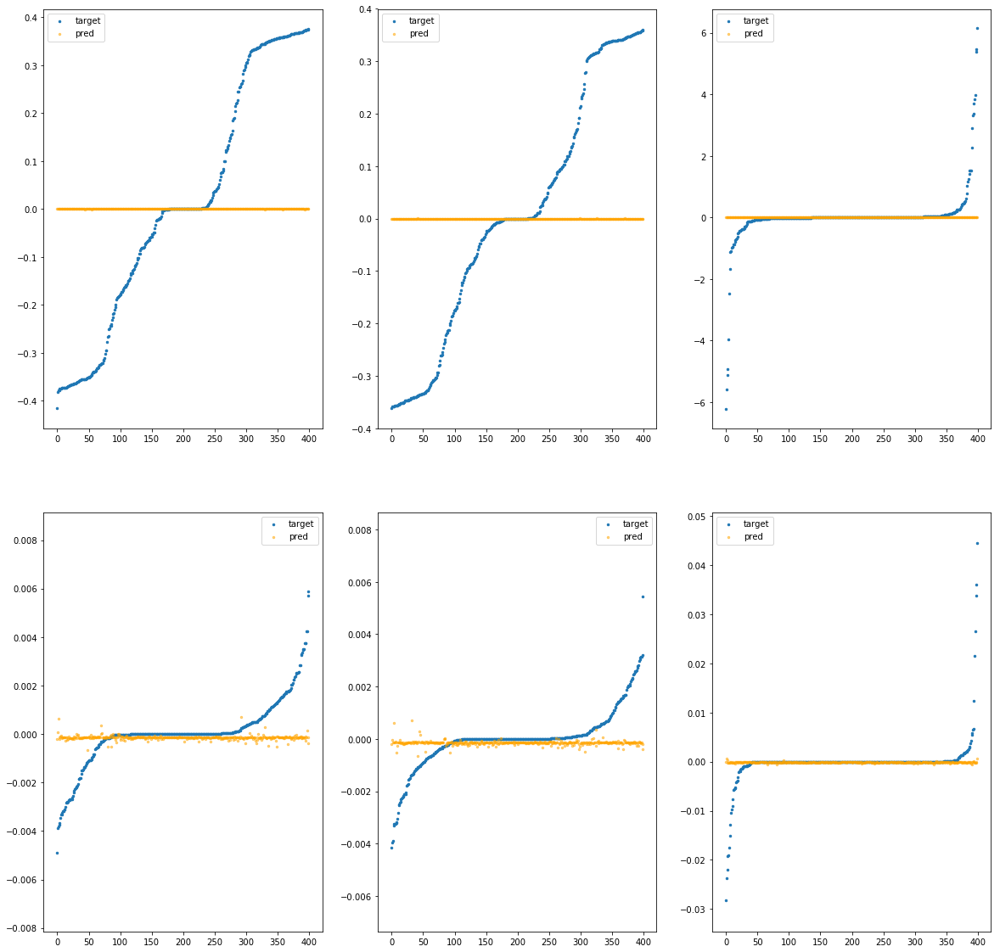

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34dc0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.95e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.27e+01	5.49e-02	3.01e-03
z		-9.72e-04	6.23e+00	2.77e-01	6.97e+00	8.76e-01	7.67e-01
phi		-2.12e-02	6.02e-03	8.46e-04	3.39e+04	1.90e-06	3.61e-12
theta		-1.89e-02	5.59e-03	6.96e-04	1.22e+04	1.29e-06	1.67e-12
psi		-7.17e-04	4.46e-02	1.36e-03	3.95e+03	2.45e-05	6.03e-10


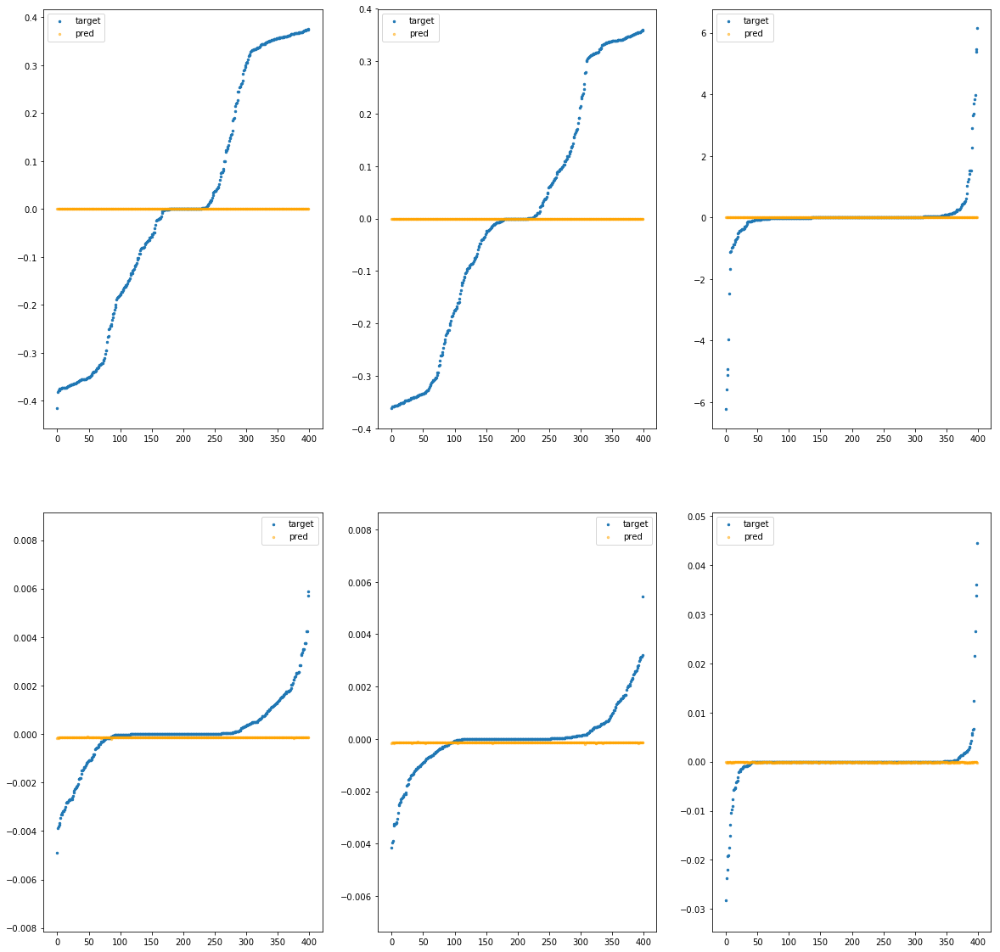

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fb253f34e20>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-03	4.15e-01	2.05e-01	9.21e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.31e+01	5.49e-02	3.01e-03
z		-9.96e-04	6.23e+00	2.77e-01	7.17e+00	8.76e-01	7.67e-01
phi		-3.11e-02	6.11e-03	8.50e-04	3.49e+04	1.92e-06	3.68e-12
theta		-3.36e-02	5.68e-03	7.01e-04	1.26e+04	1.31e-06	1.72e-12
psi		-2.01e-03	4.44e-02	1.36e-03	4.10e+03	2.46e-05	6.04e-10


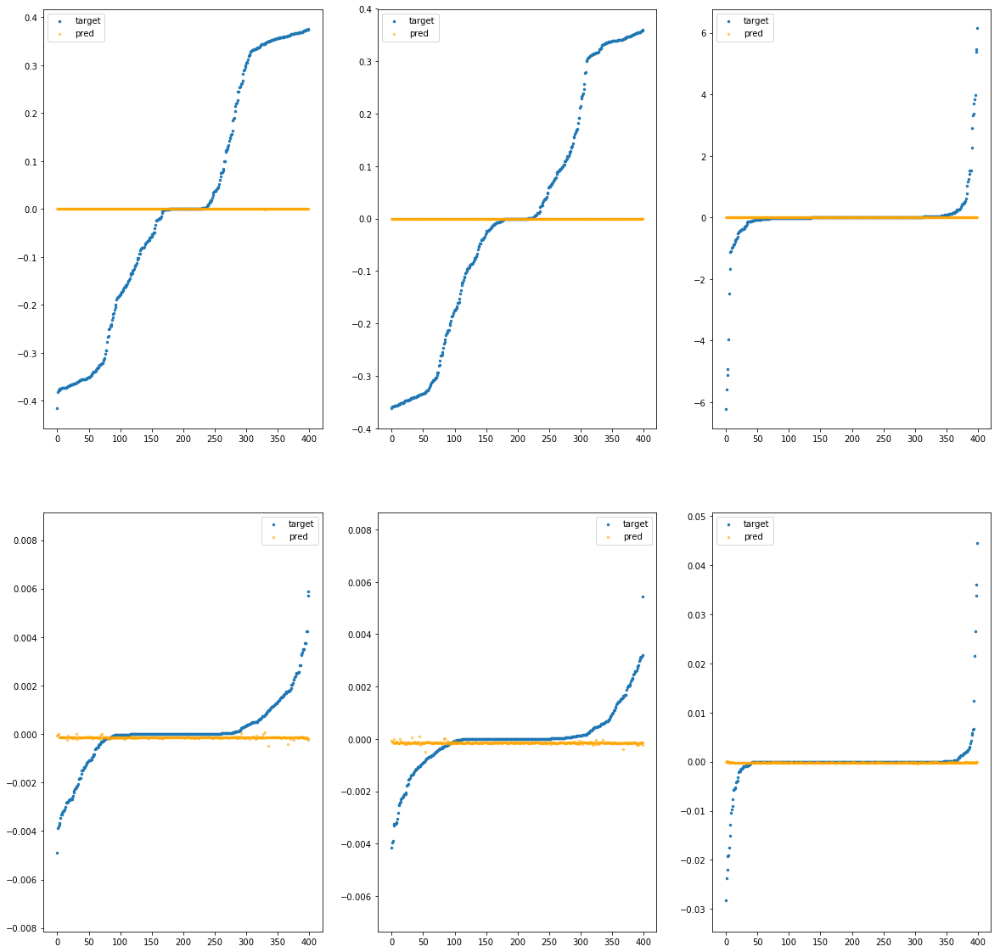

In [4]:
for key, result in search.results.items():
    print(key)
    result['estimator'].print_metrics();
    result['estimator'].plot()

In [5]:

search.print();

X:     1.6516646245008996e-05, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d310>, epochs=100, batch_size=32
Y:     1.461566330679599e-05, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fb270c9d0d0>, epochs=75, batch_size=24
Z:     0.006372550372740369, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(100, activation="tanh"), Dense(32, activation="tanh")], loss=<function mean_squared_error at 0x7fb26be67160>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fb253f0c9a0>, ep